In [ ]:
# ================================
# Import Library + Set Random Seed
# ================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error

import tensorflow as tf
from tensorflow.keras import layers, Sequential

# --- Set random seed (reproducibility) ---
SEED = 42
np.random.seed(SEED)
tf.keras.utils.set_random_seed(SEED)

print("Library berhasil di-import.")
print("TensorFlow version:", tf.__version__)


c:\laragon\bin\python\python-3.10\lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\laragon\bin\python\python-3.10\lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\laragon\bin\python\python-3.10\lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/resource_handle.proto. Please update the gencode to avoid co

Library berhasil di-import.
TensorFlow version: 2.20.0


In [ ]:
# ==============================
# LOAD MULTI-EXCEL & BUAT DATASET WIDE
# ==============================

import os
import pandas as pd

# 1. Menentukan folder dataset
folder_dataset = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\dataset"

# 2. Daftar tahun yang akan dibaca
tahun_list = [2020, 2021, 2022, 2023, 2024, 2025]

# 3. Membuat list file Excel per tahun
file_list = []
for tahun in tahun_list:
    nama_file = f"Harga Pangan_{tahun}.xlsx"   
    path_file = os.path.join(folder_dataset, nama_file)

    if os.path.exists(path_file):
        print(f"File ditemukan: {path_file}")
        file_list.append(path_file)
    else:
        print(f"*** PERINGATAN: File TIDAK ditemukan -> {path_file}")

if len(file_list) == 0:
    raise FileNotFoundError("Tidak ada file Excel yang ditemukan. Cek lagi nama file dan folder_dataset.")

# 4. Daftar komoditas utama
komoditas_utama = [
    "Beras",
    "Daging Ayam",
    "Daging Sapi",
    "Telur Ayam",
    "Bawang Merah",
    "Cabai Merah",
    "Cabai Rawit",
    "Minyak Goreng",
    "Gula Pasir"
]

data_long_all = []

# 6. Loop membaca setiap file Excel
for file in file_list:
    print("\nMembaca file:", os.path.basename(file))

    df_raw = pd.read_excel(file)

    df_raw.columns = (
        df_raw.columns.astype(str)
        .str.replace(" ", "", regex=False)
        .str.replace("\n", "", regex=False)
    )

    # Kolom kedua diasumsikan berisi nama komoditas
    col_komoditas = df_raw.columns[1]
    df_raw = df_raw.rename(columns={col_komoditas: "komoditas"})

    # Cari kolom yang berisi tanggal (dicoba di-parse sebagai datetime)
    date_cols = []
    for c in df_raw.columns:
        dt = pd.to_datetime(c, errors="coerce", dayfirst=True)
        if not pd.isna(dt):
            date_cols.append(c)

    # Ambil hanya kolom komoditas + kolom tanggal
    df_sub = df_raw[["komoditas"] + date_cols].copy()

    # Hapus baris dengan komoditas kosong
    df_sub = df_sub.dropna(subset=["komoditas"])

    # Filter hanya komoditas utama
    df_sub = df_sub[df_sub["komoditas"].isin(komoditas_utama)]

    # Ubah wide -> long (tanggal jadi baris)
    df_long = df_sub.melt(
        id_vars="komoditas",
        value_vars=date_cols,
        var_name="date",
        value_name="harga"
    )

    # Bersihkan kolom tanggal
    df_long["date"] = (
        df_long["date"].astype(str)
        .str.replace(" ", "", regex=False)
    )
    df_long["date"] = pd.to_datetime(df_long["date"], errors="coerce", dayfirst=True)

    # Bersihkan kolom harga (hapus titik/koma ribuan, lalu ubah ke numeric)
    df_long["harga"] = (
        df_long["harga"].astype(str)
        .str.replace(".", "", regex=False)
        .str.replace(",", "", regex=False)
    )
    df_long["harga"] = pd.to_numeric(df_long["harga"], errors="coerce")

    # Simpan ke list
    data_long_all.append(df_long)

# 7. Gabungkan semua tahun (format long)
data_long_all = pd.concat(data_long_all, ignore_index=True)

# 8. Ubah long -> wide (tanggal = baris, komoditas = kolom)
df_wide = data_long_all.pivot_table(
    index="date",
    columns="komoditas",
    values="harga",
    aggfunc="mean"
).reset_index()

# 9. Urutkan berdasarkan tanggal
df_wide = df_wide.sort_values("date").reset_index(drop=True)

# 10. Simpan ke CSV
output_csv = os.path.join(folder_dataset, "harga_pangan_wide.csv")
df_wide.to_csv(output_csv, index=False)
print("\nDataset wide berhasil disimpan ke:", output_csv)

# 11. Cek ulang dataset wide yang sudah disimpan
df = pd.read_csv(output_csv)
df["date"] = pd.to_datetime(df["date"])
df = df.sort_values("date").reset_index(drop=True)

print("\nDataset Wide (5 baris teratas):")
print(df.head())

print("\nInfo Dataset Wide:")
print(df.info())


File ditemukan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\dataset\Harga Pangan_2020.xlsx
File ditemukan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\dataset\Harga Pangan_2021.xlsx
File ditemukan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\dataset\Harga Pangan_2022.xlsx
File ditemukan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\dataset\Harga Pangan_2023.xlsx
File ditemukan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\dataset\Harga Pangan_2024.xlsx
File ditemukan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\dataset\Harga Pangan_2025.xlsx

Membaca file: Harga Pangan_2020.xlsx

Membaca file: Harga Pangan_2021.xlsx

Membaca file: Harga Pangan_2022.xlsx

Membaca file: Harga Pangan_2023.xlsx

Membaca file: Harga Pangan_2024.xlsx


Jumlah Missing Value Per Kolom


date             0
Bawang Merah     0
Beras            0
Cabai Merah      0
Cabai Rawit      0
Daging Ayam      0
Daging Sapi      0
Gula Pasir       1
Minyak Goreng    7
Telur Ayam       0
dtype: int64


Statistik Deskriptif


,count,mean,std,min,25%,50%,75%,max
Bawang Merah,1498.0,20563.150868,5391.288894,10150.0,16462.5,19500.0,22600.0,35300.0
Beras,1498.0,10698.264352,1630.230749,8550.0,9350.0,9750.0,12500.0,15100.0
Cabai Merah,1498.0,24413.985314,11867.807550,7050.0,17100.0,22500.0,29350.0,63400.0
Cabai Rawit,1498.0,26158.077437,13226.927007,8000.0,16750.0,23450.0,34400.0,62500.0
Daging Ayam,1498.0,29061.114820,3786.745812,20750.0,26400.0,29150.0,32300.0,36500.0
Daging Sapi,1498.0,113937.516689,6780.603775,101100.0,110200.0,117000.0,120000.0,123150.0
Gula Pasir,1497.0,12449.365397,1934.156274,9550.0,11150.0,11850.0,14700.0,15450.0
Minyak Goreng,1491.0,11636.519115,1532.354427,8350.0,10500.0,12000.0,13000.0,14000.0
Telur Ayam,1498.0,22402.202937,2672.828060,15750.0,20300.0,22950.0,24200.0,27300.0



Plot Time Series Seluruh Komoditas


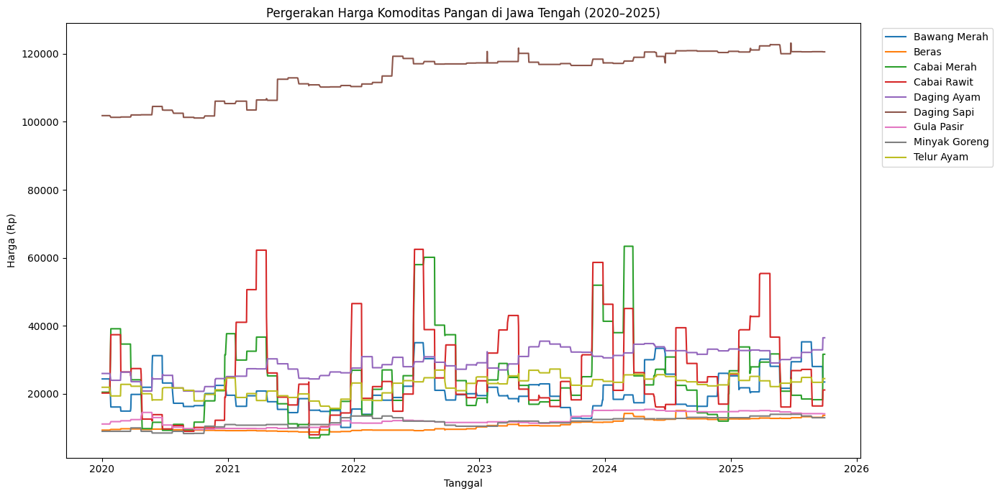

In [3]:
# Exploratory Data Analysis (EDA)

# Menampilkan jumlah missing value pada tiap kolom
print("Jumlah Missing Value Per Kolom")
missing_per_kolom = df.isna().sum()
display(missing_per_kolom)

# Menampilkan statistik deskriptif tiap komoditas
print("\nStatistik Deskriptif")
stat_desc = df.drop(columns=["date"]).describe().T
display(stat_desc)

# Menampilkan plot time series seluruh komoditas (sebelum preprocessing)
print("\nPlot Time Series Seluruh Komoditas")

plt.figure(figsize=(14, 7))

for col in df.columns:
    if col != "date":
        plt.plot(df["date"], df[col], label=col)

plt.title("Pergerakan Harga Komoditas Pangan di Jawa Tengah (2020–2025)")
plt.xlabel("Tanggal")
plt.ylabel("Harga (Rp)")
plt.legend(loc="upper left", bbox_to_anchor=(1.02, 1.0))
plt.tight_layout()
plt.show()


In [4]:
# Preprocessing Missing Value (LOCF)

# Menggandakan dataset agar aman
df_ffill = df.copy()

# Mengisi missing value menggunakan forward fill
df_ffill = df_ffill.ffill()

# Mengisi missing value sisa di bagian awal menggunakan backward fill
df_ffill = df_ffill.bfill()

print("Missing Value Setelah LOCF\n")
missing_after = df_ffill.isna().sum()

# Menampilkan hasil dengan format nama kolom menggunakan kapitalisasi tiap kata
for col, val in missing_after.items():
    print(f"{col.title():<20} : {val}")

# Menyimpan kembali hasil ke df utama
df = df_ffill.copy()


Missing Value Setelah LOCF

Date                 : 0
Bawang Merah         : 0
Beras                : 0
Cabai Merah          : 0
Cabai Rawit          : 0
Daging Ayam          : 0
Daging Sapi          : 0
Gula Pasir           : 0
Minyak Goreng        : 0
Telur Ayam           : 0


In [5]:
def split_data_time_series(df, train_ratio=0.70, valid_ratio=0.15):
    n = len(df)
    train_end = int(n * train_ratio)
    valid_end = int(n * (train_ratio + valid_ratio))

    df_train = df.iloc[:train_end]
    df_valid = df.iloc[train_end:valid_end]
    df_test  = df.iloc[valid_end:]

    print("Jumlah data:", n)
    print(f"Train: {len(df_train)} baris ({train_ratio*100:.0f}%)")
    print(f"Validasi: {len(df_valid)} baris ({valid_ratio*100:.0f}%)")
    print(f"Test: {len(df_test)} baris ({100 - (train_ratio+valid_ratio)*100:.0f}%)")

    return df_train, df_valid, df_test

df_train, df_valid, df_test = split_data_time_series(df)

Jumlah data: 1498
Train: 1048 baris (70%)
Validasi: 225 baris (15%)
Test: 225 baris (15%)


In [6]:
# Menentukan Komoditas dan Parameter Skenario

# Menentukan daftar komoditas yang akan diprediksi (univariate dan multivariate)
komoditas_list = [
    "Beras",
    "Daging Ayam",
    "Daging Sapi",
    "Telur Ayam",
    "Bawang Merah",
    "Cabai Merah",
    "Cabai Rawit",
    "Minyak Goreng",
    "Gula Pasir"
]

# Menentukan ukuran sliding window yang akan diuji
window_list = [7, 14, 30]

# Menentukan jumlah unit LSTM yang akan diuji
units_list = [32, 64]

# Menentukan parameter pelatihan
epochs = 150
batch_size = 32

# Menyediakan wadah untuk menyimpan seluruh hasil percobaan
hasil_semua = []

print("Daftar komoditas dan parameter skenario berhasil ditentukan.")


Daftar komoditas dan parameter skenario berhasil ditentukan.


In [7]:
# Scaling

from sklearn.preprocessing import MinMaxScaler

# ---------------------------
# 1) Scaling MULTIVARIATE
#    (fit hanya pada TRAIN)
# ---------------------------

scaler_X = MinMaxScaler()

# fit pada fitur multivariate TRAIN
scaler_X.fit(df_train[komoditas_list])

# transform data
X_train_scaled = scaler_X.transform(df_train[komoditas_list])
X_valid_scaled = scaler_X.transform(df_valid[komoditas_list])
X_test_scaled  = scaler_X.transform(df_test[komoditas_list])


# ---------------------------
# 2) Scaling UNIVARIATE
#    (satu komoditas = satu scaler)
# ---------------------------

scaler_y_dict = {}          # menyimpan scaler per komoditas
y_train_scaled_dict = {}    # menyimpan hasil scaling train per komoditas
y_valid_scaled_dict = {}    # menyimpan hasil scaling valid
y_test_scaled_dict  = {}    # menyimpan hasil scaling test

for kom in komoditas_list:
    
    scaler_y = MinMaxScaler()
    scaler_y.fit(df_train[[kom]])  # fit pada TRAIN saja
    
    # simpan scaler untuk dipakai nanti (inverse transform)
    scaler_y_dict[kom] = scaler_y
    
    # simpan hasil scaling
    y_train_scaled_dict[kom] = scaler_y.transform(df_train[[kom]])
    y_valid_scaled_dict[kom] = scaler_y.transform(df_valid[[kom]])
    y_test_scaled_dict[kom]  = scaler_y.transform(df_test[[kom]])

print("Scaling berhasil dilakukan (fit=TRAIN).")


Scaling berhasil dilakukan (fit=TRAIN).


In [8]:
# Membuat Fungsi Sliding Window + Demo Output

# Fungsi untuk membuat window pada skenario univariate 2d
def buat_window_univariate(data_scaled, window_size):

    X, y = [], [] 
    
    for i in range(len(data_scaled) - window_size):
        X.append(data_scaled[i : i + window_size])
        y.append(data_scaled[i + window_size])
    
    return np.array(X), np.array(y)


# Fungsi untuk membuat window pada skenario multivariate
def buat_window_multivariate(X_scaled, y_scaled, window_size):

    X, y = [], []

    for i in range(len(X_scaled) - window_size):
        X.append(X_scaled[i : i + window_size, :])
        y.append(y_scaled[i + window_size])
    
    return np.array(X), np.array(y)


print("Fungsi sliding window berhasil dibuat.")

Fungsi sliding window berhasil dibuat.


In [9]:
# PENERAPAN SLIDING WINDOW

import os
import pandas as pd
import numpy as np

# -------------------------------
# Folder output sliding window
# -------------------------------
base_output_folder = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\sliding_window"
os.makedirs(base_output_folder, exist_ok=True)

print("Membentuk sliding window (train/valid/test) ke dict + menyimpan CSV...\n")

# Menyiapkan dict penampung window di memori

X_train_uni, y_train_uni = {}, {}
X_valid_uni, y_valid_uni = {}, {}
X_test_uni,  y_test_uni  = {}, {}

X_train_multi, y_train_multi = {}, {}
X_valid_multi, y_valid_multi = {}, {}
X_test_multi,  y_test_multi  = {}, {}

# =====================================================
# 1) Loop tiap komoditas target
# =====================================================
for target in komoditas_list:
    
    # folder per komoditas
    komoditas_folder = os.path.join(base_output_folder, target.replace(" ", "_"))
    os.makedirs(komoditas_folder, exist_ok=True)

    print(f"=== Target: {target} ===")

    # inisialisasi dict level komoditas
    X_train_uni[target], y_train_uni[target] = {}, {}
    X_valid_uni[target], y_valid_uni[target] = {}, {}
    X_test_uni[target],  y_test_uni[target]  = {}, {}

    X_train_multi[target], y_train_multi[target] = {}, {}
    X_valid_multi[target], y_valid_multi[target] = {}, {}
    X_test_multi[target],  y_test_multi[target]  = {}, {}


    # ambil target scaled untuk train/valid/test
    ytr = y_train_scaled_dict[target]  # shape (n_train,1)
    yva = y_valid_scaled_dict[target]  # shape (n_valid,1)
    yte = y_test_scaled_dict[target]   # shape (n_test,1)

    # =====================================================
    # 2) Loop window size
    # =====================================================
    for W in window_list:

        # ---------------------------
        # A) UNIVARIATE
        # ---------------------------
        Xtr_u, ytr_u = buat_window_univariate(ytr, W)
        Xva_u, yva_u = buat_window_univariate(yva, W)
        Xte_u, yte_u = buat_window_univariate(yte, W)

        # simpan ke dict memori agar dipakai training loop
        X_train_uni[target][W], y_train_uni[target][W] = Xtr_u, ytr_u
        X_valid_uni[target][W], y_valid_uni[target][W] = Xva_u, yva_u
        X_test_uni[target][W],  y_test_uni[target][W]  = Xte_u, yte_u

        # simpan CSV univariate per subset
        def save_uni_csv(X_u, y_u, subset):
            rows = []
            for w in range(len(X_u)):
                row = {
                    "mode": "univariate",
                    "subset": subset,
                    "komoditas": target,
                    "window_size": W,
                    "window_ke": w
                }
                for h in range(W):
                    row[f"hari_{h+1}"] = X_u[w, h, 0]
                row[f"target_hari_{W+1}"] = y_u[w, 0]
                rows.append(row)

            df_out = pd.DataFrame(rows)
            nama_file = f"{subset}_univariate_W{W}_{target.replace(' ', '_')}.csv"
            path_save = os.path.join(komoditas_folder, nama_file)

            if os.path.exists(path_save):
                os.remove(path_save)

            df_out.to_csv(path_save, index=False)

        save_uni_csv(Xtr_u, ytr_u, "train")
        save_uni_csv(Xva_u, yva_u, "valid")
        save_uni_csv(Xte_u, yte_u, "test")


        # ---------------------------
        # B) MULTIVARIATE
        # ---------------------------
        Xtr_m, ytr_m = buat_window_multivariate(X_train_scaled, ytr, W)
        Xva_m, yva_m = buat_window_multivariate(X_valid_scaled, yva, W)
        Xte_m, yte_m = buat_window_multivariate(X_test_scaled,  yte, W)

        # simpan ke dict memori
        X_train_multi[target][W], y_train_multi[target][W] = Xtr_m, ytr_m
        X_valid_multi[target][W], y_valid_multi[target][W] = Xva_m, yva_m
        X_test_multi[target][W],  y_test_multi[target][W]  = Xte_m, yte_m

        # simpan CSV multivariate per subset
        def save_multi_csv(X_m, y_m, subset):
            rows = []
            for w in range(len(X_m)):
                row = {
                    "mode": "multivariate",
                    "subset": subset,
                    "target": target,
                    "window_size": W,
                    "window_ke": w
                }
                for h in range(W):
                    for f_idx, feat in enumerate(komoditas_list):
                        row[f"hari_{h+1}_{feat}"] = X_m[w, h, f_idx]
                row[f"target_hari_{W+1}"] = y_m[w, 0]
                rows.append(row)

            df_out = pd.DataFrame(rows)
            nama_file = f"{subset}_multivariate_W{W}_{target.replace(' ', '_')}.csv"
            path_save = os.path.join(komoditas_folder, nama_file)

            if os.path.exists(path_save):
                os.remove(path_save)

            df_out.to_csv(path_save, index=False)

        save_multi_csv(Xtr_m, ytr_m, "train")
        save_multi_csv(Xva_m, yva_m, "valid")
        save_multi_csv(Xte_m, yte_m, "test")


        # ringkas info shape
        print(f"  W={W} | Uni Train {Xtr_u.shape} | Multi Train {Xtr_m.shape}")

    print("")  # spasi antar komoditas


print("==== Sliding window selesai ====")
print("Dict yang siap dipakai training:")
print("- X_train_uni[target][W], y_train_uni[target][W]")
print("- X_valid_uni[target][W], y_valid_uni[target][W]")
print("- X_test_uni[target][W],  y_test_uni[target][W]")
print("- X_train_multi[target][W], y_train_multi[target][W], dst.")
print("\nCSV tersimpan di:", base_output_folder)


Membentuk sliding window (train/valid/test) ke dict + menyimpan CSV...

=== Target: Beras ===
  W=7 | Uni Train (1041, 7, 1) | Multi Train (1041, 7, 9)
  W=14 | Uni Train (1034, 14, 1) | Multi Train (1034, 14, 9)
  W=30 | Uni Train (1018, 30, 1) | Multi Train (1018, 30, 9)

=== Target: Daging Ayam ===
  W=7 | Uni Train (1041, 7, 1) | Multi Train (1041, 7, 9)
  W=14 | Uni Train (1034, 14, 1) | Multi Train (1034, 14, 9)
  W=30 | Uni Train (1018, 30, 1) | Multi Train (1018, 30, 9)

=== Target: Daging Sapi ===
  W=7 | Uni Train (1041, 7, 1) | Multi Train (1041, 7, 9)
  W=14 | Uni Train (1034, 14, 1) | Multi Train (1034, 14, 9)
  W=30 | Uni Train (1018, 30, 1) | Multi Train (1018, 30, 9)

=== Target: Telur Ayam ===
  W=7 | Uni Train (1041, 7, 1) | Multi Train (1041, 7, 9)
  W=14 | Uni Train (1034, 14, 1) | Multi Train (1034, 14, 9)
  W=30 | Uni Train (1018, 30, 1) | Multi Train (1018, 30, 9)

=== Target: Bawang Merah ===
  W=7 | Uni Train (1041, 7, 1) | Multi Train (1041, 7, 9)
  W=14 | Uni

In [10]:
#  Fungsi Build Model LSTM

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam

def build_lstm_model(input_shape, units):
    
    model = Sequential()
    
    # layer LSTM utama
    model.add(LSTM(units, input_shape=input_shape, return_sequences=False))
    
    # dropout biar tidak overfit 
    model.add(Dropout(0.2))
    
    # output layer (regresi 1 nilai harga)
    model.add(Dense(1))
    
    # compile model
    model.compile(
        optimizer=Adam(learning_rate=0.001),
        loss="mse"
    )
    
    return model


print("Fungsi build_lstm_model berhasil dibuat.")


Fungsi build_lstm_model berhasil dibuat.


In [11]:
# Fungsi Evaluasi (MAE, RMSE, MAPE)

import numpy as np
from math import sqrt

def hitung_mape(y_true, y_pred):
    
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    epsilon = 1e-8    # epsilon untuk mencegah pembagian dengan nol
    
    return np.mean( np.abs((y_true - y_pred) / (y_true + epsilon)) ) * 100


def hitung_metric(y_true, y_pred):
    
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)

    mae  = np.mean(np.abs(y_true - y_pred))
    rmse = sqrt(np.mean((y_true - y_pred)**2))
    mape = hitung_mape(y_true, y_pred)

    return mae, rmse, mape


print("Fungsi evaluasi MAE, RMSE, MAPE berhasil dibuat.")


Fungsi evaluasi MAE, RMSE, MAPE berhasil dibuat.


In [12]:
# Fungsi Plotting 

import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.ticker import FuncFormatter

# formatter rupiah
rupiah = FuncFormatter(lambda x, pos: f"{x:,.0f}".replace(",", "."))

def plot_training_loss(history, title="Training Loss"):
  
    plt.figure(figsize=(8,4))
    plt.plot(history.history["loss"], label="Train Loss")
    if "val_loss" in history.history:
        plt.plot(history.history["val_loss"], label="Val Loss")
    plt.title(title)
    plt.xlabel("Epoch")
    plt.ylabel("Loss (MSE)")
    plt.legend()
    plt.grid(True)
    plt.show()


def plot_actual_vs_predicted(dates_test, y_true, y_pred, title="Actual vs Predicted (Test)"):
    
    plt.figure(figsize=(10,4))
    plt.plot(dates_test, y_true, label="Actual")
    plt.plot(dates_test, y_pred, label="Predicted")
    plt.title(title)
    plt.xlabel("Date")
    plt.ylabel("Price (Rp)")
    plt.gca().yaxis.set_major_formatter(rupiah)
    plt.gca().xaxis.set_major_locator(mdates.AutoDateLocator())
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))
    plt.legend()
    plt.grid(True)
    plt.show()

print("Fungsi plotting berhasil dibuat.")


Fungsi plotting berhasil dibuat.


In [13]:
# Fungsi Forecasting 30 Hari (Weekdays)

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.ticker import FuncFormatter

# formatter rupiah
rupiah = FuncFormatter(lambda x, pos: f"{x:,.0f}".replace(",", "."))

def forecast_30_hari_weekdays(model, last_window, scaler_y, horizon_bdays=22, start_date=None, target_index=0):

    window = np.array(last_window).copy()

    # pastikan window berbentuk (1, W, F)
    if window.ndim == 2:
        window = window.reshape(1, window.shape[0], window.shape[1])
    elif window.ndim == 1:
        window = window.reshape(1, window.shape[0], 1)

    preds_scaled = []

    for _ in range(horizon_bdays):

        y_next_scaled = model.predict(window, verbose=0)[0, 0]
        preds_scaled.append(y_next_scaled)

        # bentuk input baru
        if window.shape[2] == 1:
            new_row = np.array([[[y_next_scaled]]])        # univariate
        else:
            new_row = window[:, -1, :].copy()              # multivariate
            new_row[0, target_index] = y_next_scaled
            new_row = new_row.reshape(1,1,-1)

        # shift window
        window = np.concatenate([window[:, 1:, :], new_row], axis=1)

    # inverse transform ke rupiah
    preds_scaled = np.array(preds_scaled).reshape(-1, 1)
    y_forecast_inv = scaler_y.inverse_transform(preds_scaled).reshape(-1)

    # buat tanggal weekdays
    if start_date is not None:
        start_date = pd.to_datetime(start_date)
        dates_forecast = pd.bdate_range(
            start_date + pd.Timedelta(days=1),
            periods=horizon_bdays
        )
        return dates_forecast, y_forecast_inv

    return None, y_forecast_inv


# Fungsi Plot Forecasting 

def plot_forecasting(dates_hist, y_hist, dates_fore, y_fore, title="Forecasting 30 Hari"):

    plt.figure(figsize=(10,4))
    plt.plot(dates_hist, y_hist, label="Historical")
    plt.plot(dates_fore, y_fore, marker="o", label="Forecast")
    plt.title(title)
    plt.xlabel("Date")
    plt.ylabel("Price (Rp)")
    plt.gca().yaxis.set_major_formatter(rupiah)
    plt.gca().xaxis.set_major_locator(mdates.AutoDateLocator())
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m-%d"))
    plt.xticks(rotation=45)
    plt.legend()
    plt.grid(True)
    plt.show()

print("Fungsi forecast_30_hari_weekdays dan plot_forecasting siap digunakan.")


Fungsi forecast_30_hari_weekdays dan plot_forecasting siap digunakan.


Mulai percobaan skenario UNIVARIATE...

Data aktual Oktober 2025 siap dipakai untuk perbandingan.


==================== UNIVARIATE: Beras ====================

[UNIVARIATE] Target=Beras | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 0.2449 - val_loss: 0.7052
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0304 - val_loss: 0.1890
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0106 - val_loss: 0.0342
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0048 - val_loss: 0.0353
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0050 - val_loss: 0.0323
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0038 - val_loss: 0.0322
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0040 - val_loss: 0.0322
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0042 - val_loss: 0.0320
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0033 - val_loss: 0.0297
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0035 - val_loss: 0.0299
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0031 - val_loss: 0.0329
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0031 - val_l

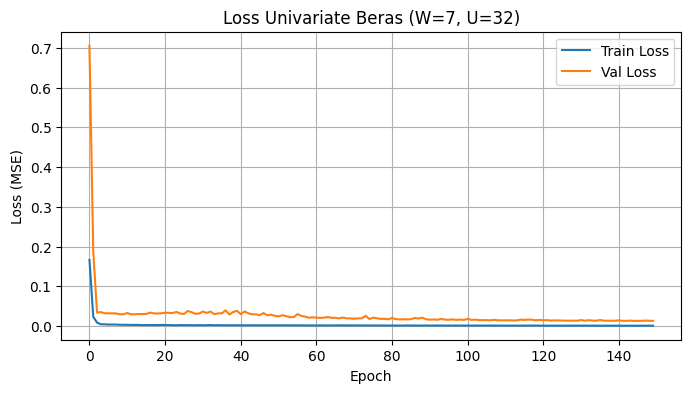

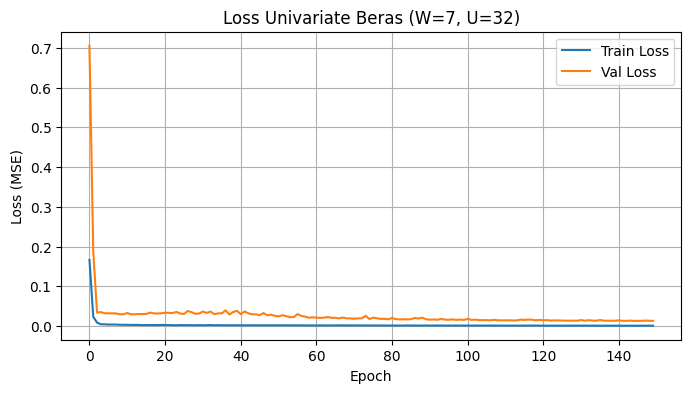

Test MAE  : 56.20
Test RMSE : 74.27
Test MAPE : 0.4342%


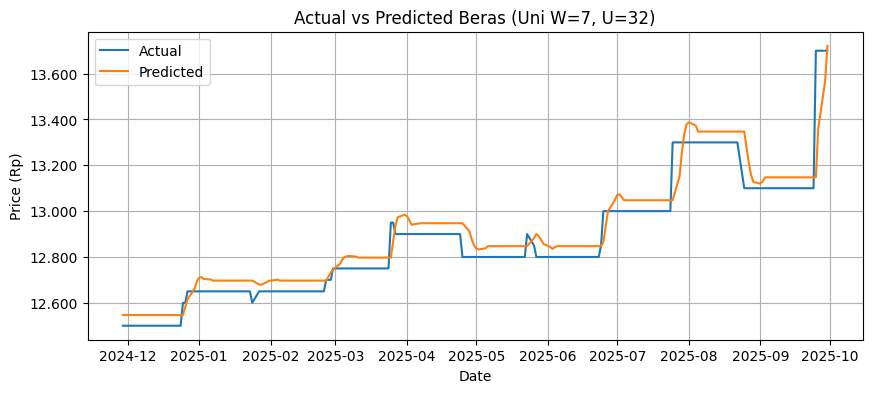

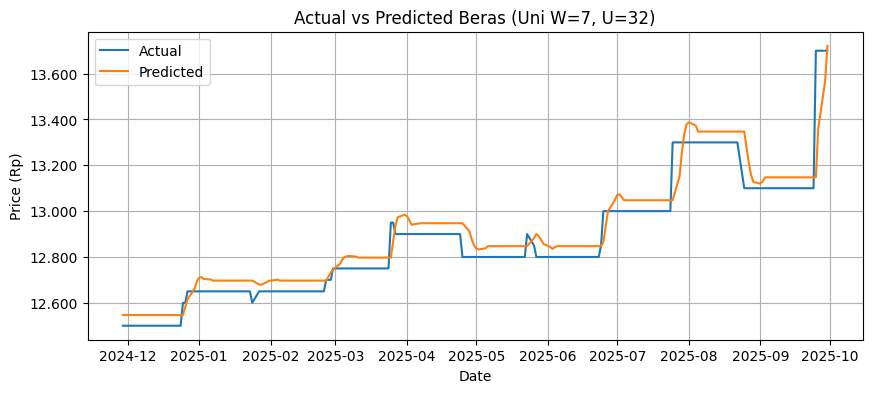


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13700,13721.853516
1,2025-10-02,13700,13811.167969
2,2025-10-03,13700,13868.049805
3,2025-10-06,13700,13897.787109
4,2025-10-07,13700,13903.933594
5,2025-10-08,13700,13942.824219
6,2025-10-09,13700,13975.710938
7,2025-10-10,13700,14002.707031
8,2025-10-13,13700,14025.594727
9,2025-10-14,13700,14050.669922


Forecast MAPE Okt 2025 : 2.7449%
Compare CSV disimpan: compare_Okt2025_uni_W7_U32.csv


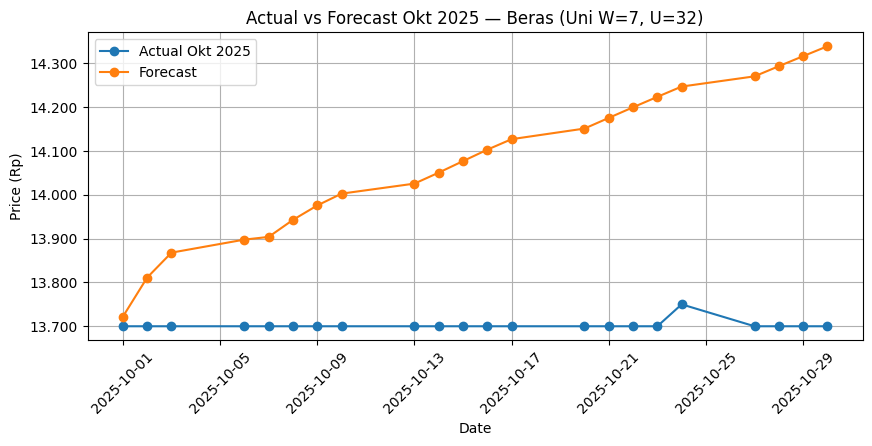

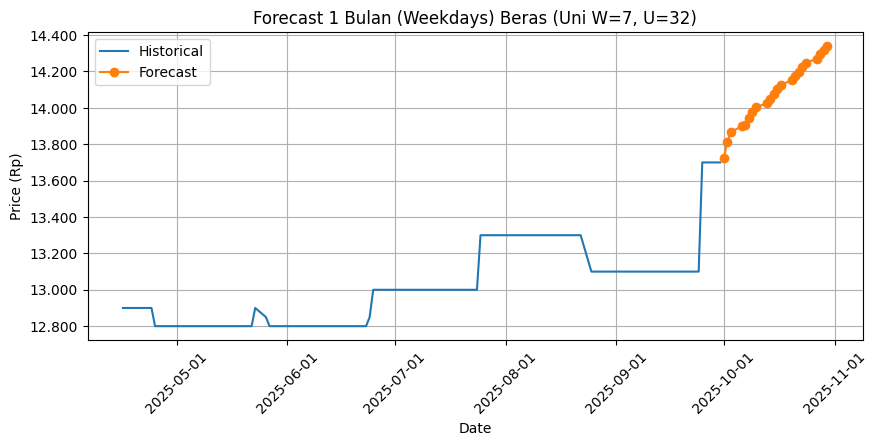

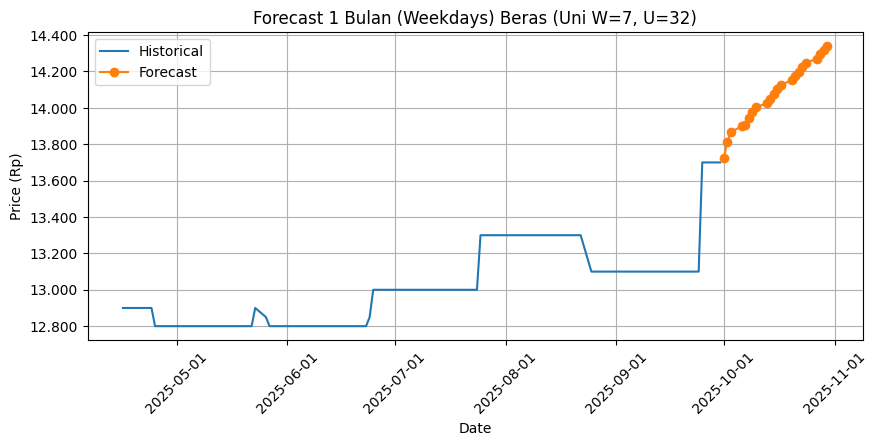


[UNIVARIATE] Target=Beras | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - loss: 0.1284 - val_loss: 0.0593
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0060 - val_loss: 0.0349
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0028 - val_loss: 0.0510
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0025 - val_loss: 0.0418
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0025 - val_loss: 0.0417
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0027 - val_loss: 0.0303
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0023 - val_loss: 0.0320
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0022 - val_loss: 0.0301
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0021 - val_loss: 0.0296
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0020 - val_loss: 0.0256
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0020 - val_loss: 0.0262
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0017 - v

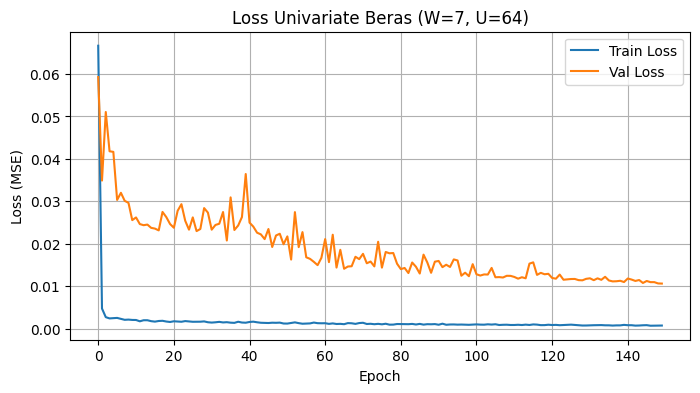

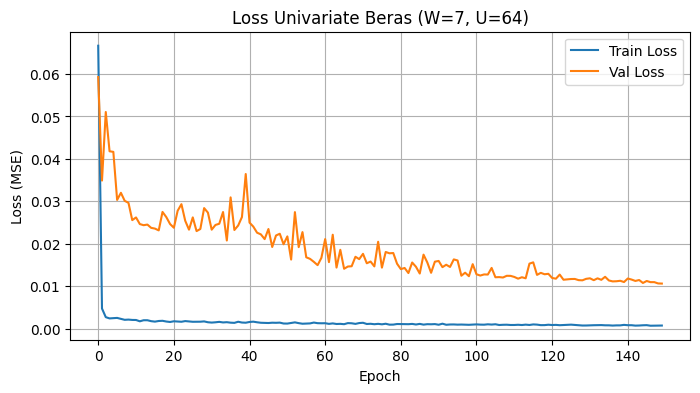

Test MAE  : 19.63
Test RMSE : 60.43
Test MAPE : 0.1494%


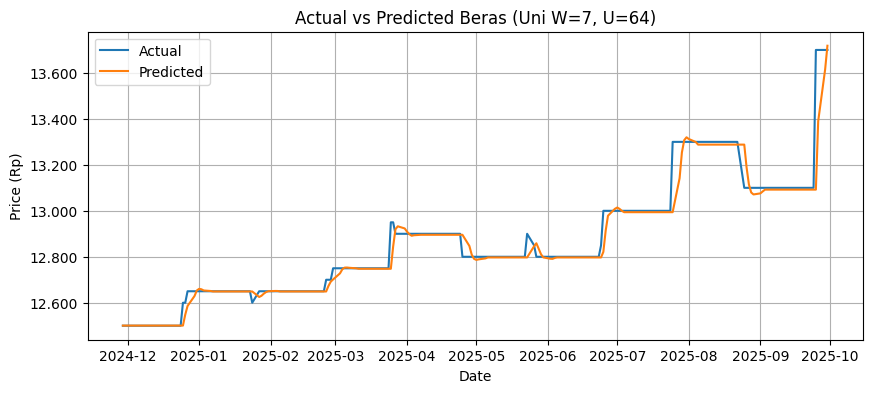

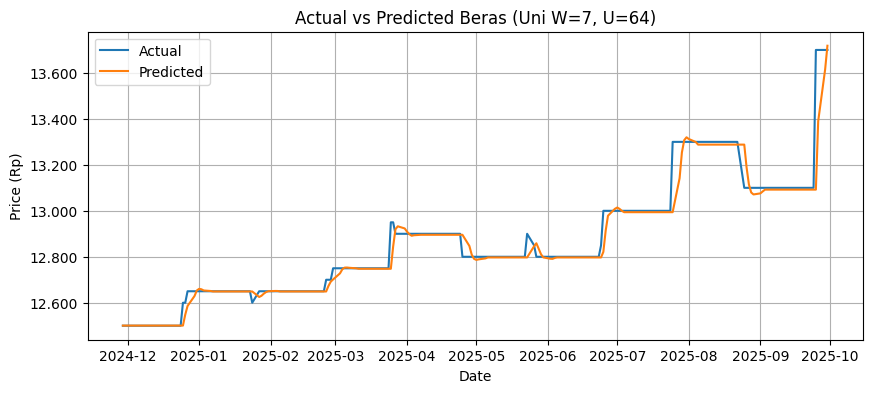


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13700,13718.385742
1,2025-10-02,13700,13749.563477
2,2025-10-03,13700,13756.025391
3,2025-10-06,13700,13748.586914
4,2025-10-07,13700,13731.393555
5,2025-10-08,13700,13721.609375
6,2025-10-09,13700,13707.829102
7,2025-10-10,13700,13692.129883
8,2025-10-13,13700,13675.773438
9,2025-10-14,13700,13659.666016


Forecast MAPE Okt 2025 : 0.6711%
Compare CSV disimpan: compare_Okt2025_uni_W7_U64.csv


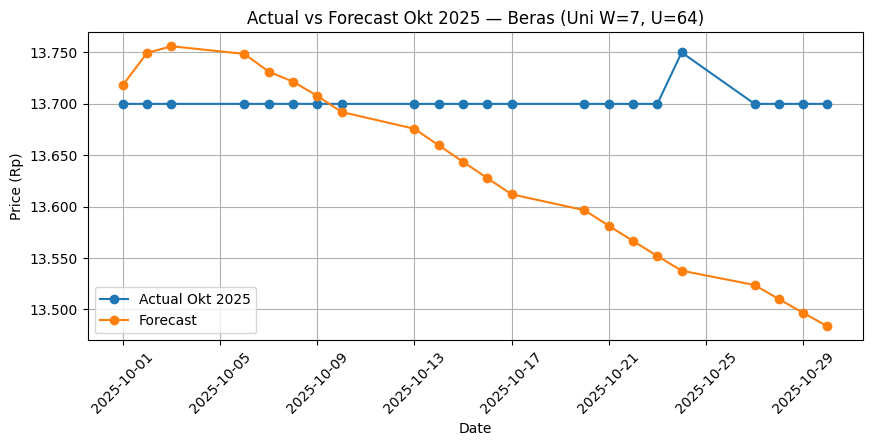

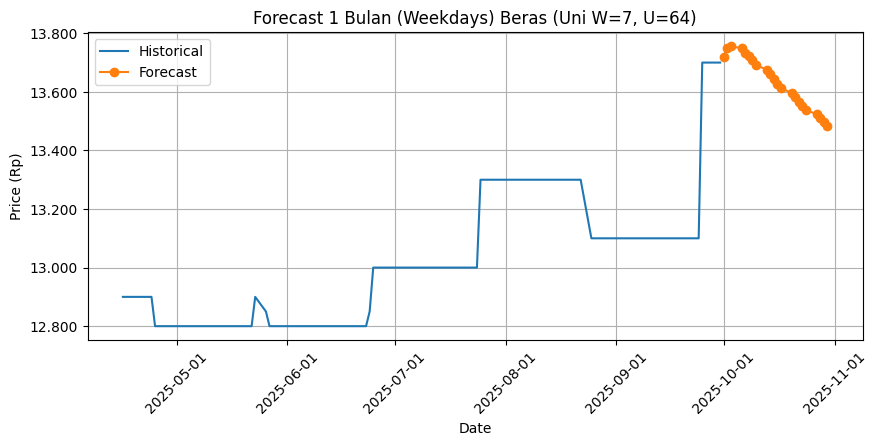

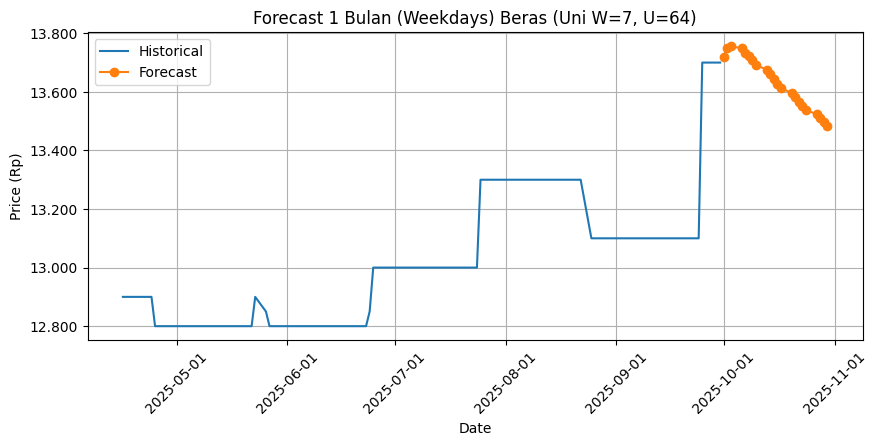


[UNIVARIATE] Target=Beras | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.1525 - val_loss: 0.0690
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0128 - val_loss: 0.0492
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0058 - val_loss: 0.0397
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0042 - val_loss: 0.0390
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0045 - val_loss: 0.0405
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0040 - val_loss: 0.0371
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0034 - val_loss: 0.0361
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0036 - val_loss: 0.0352
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0035 - val_loss: 0.0343
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0030 - val_loss: 0.0352
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0027 - val_loss: 0.0335
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0027 - val_l

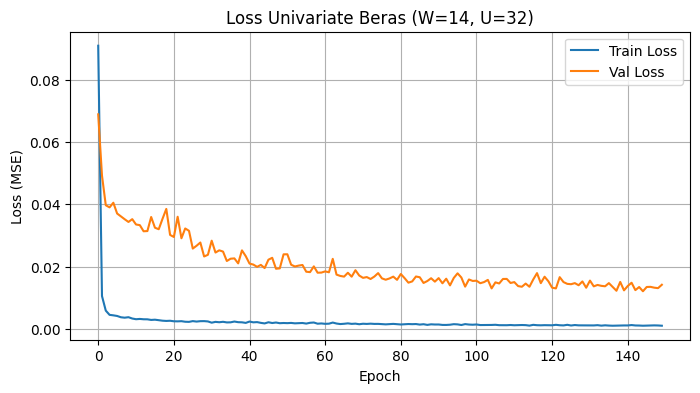

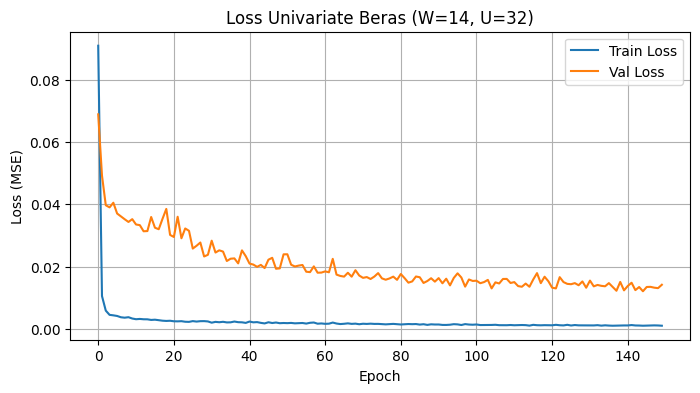

Test MAE  : 150.87
Test RMSE : 164.53
Test MAPE : 1.1658%


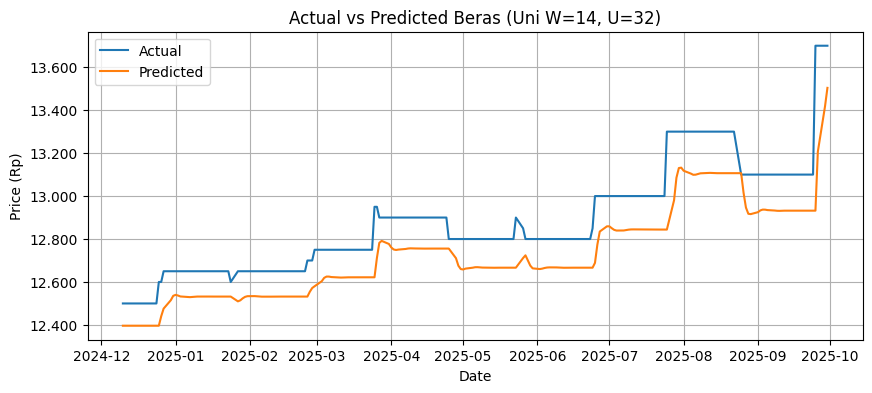

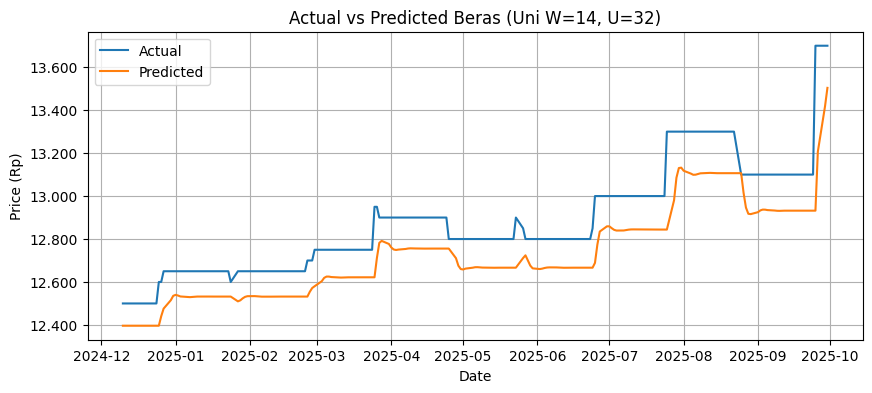


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13700,13503.756836
1,2025-10-02,13700,13411.689453
2,2025-10-03,13700,13269.916016
3,2025-10-06,13700,13121.435547
4,2025-10-07,13700,12983.679688
5,2025-10-08,13700,12862.301758
6,2025-10-09,13700,12757.102539
7,2025-10-10,13700,12665.439453
8,2025-10-13,13700,12584.142578
9,2025-10-14,13700,12510.419922


Forecast MAPE Okt 2025 : 8.6384%
Compare CSV disimpan: compare_Okt2025_uni_W14_U32.csv


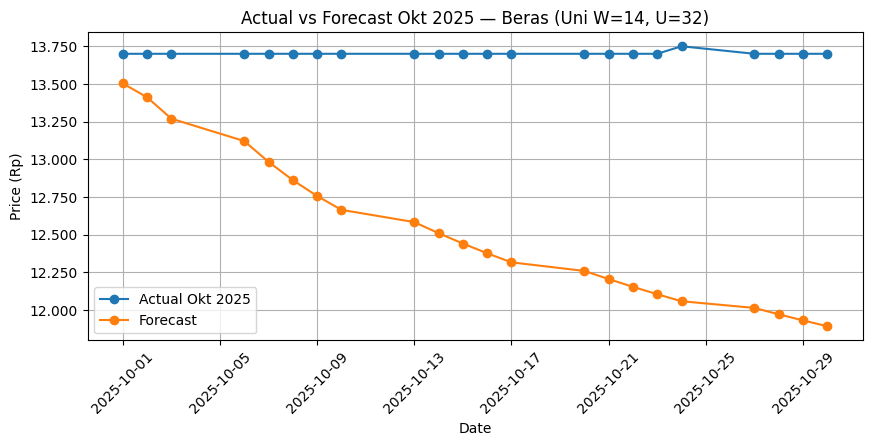

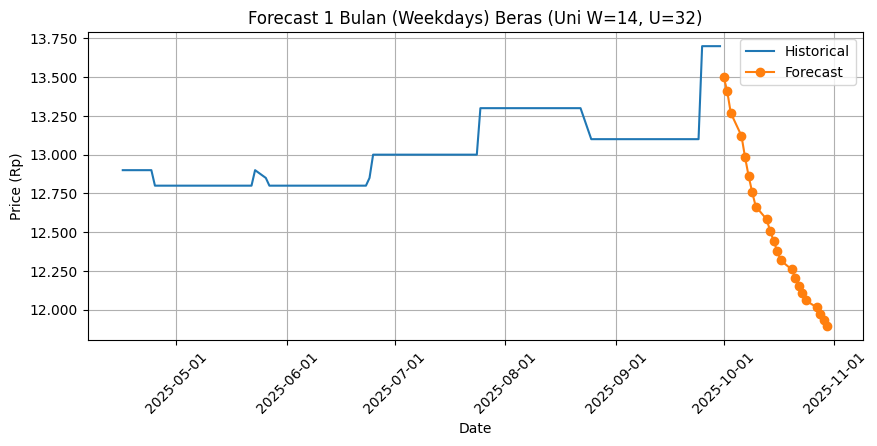

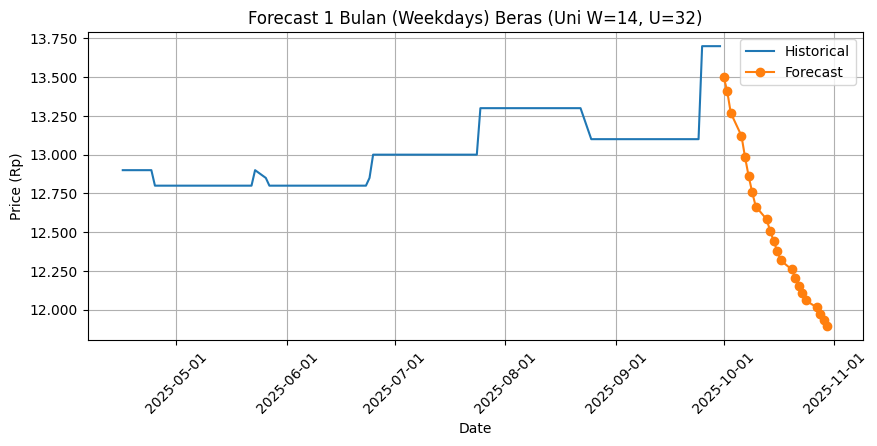


[UNIVARIATE] Target=Beras | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - loss: 0.0746 - val_loss: 0.1565
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0048 - val_loss: 0.0365
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0030 - val_loss: 0.0360
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0027 - val_loss: 0.0351
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0023 - val_loss: 0.0346
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0023 - val_loss: 0.0338
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0020 - val_loss: 0.0321
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0023 - val_loss: 0.0312
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0019 - val_loss: 0.0300
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0024 - val_loss: 0.0291
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0020 - val_loss: 0.0285
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0017

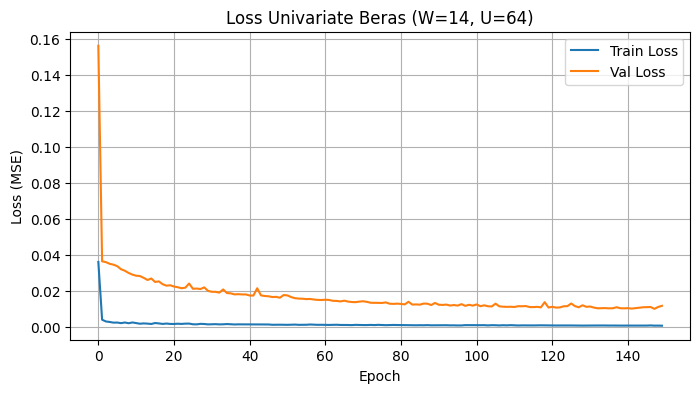

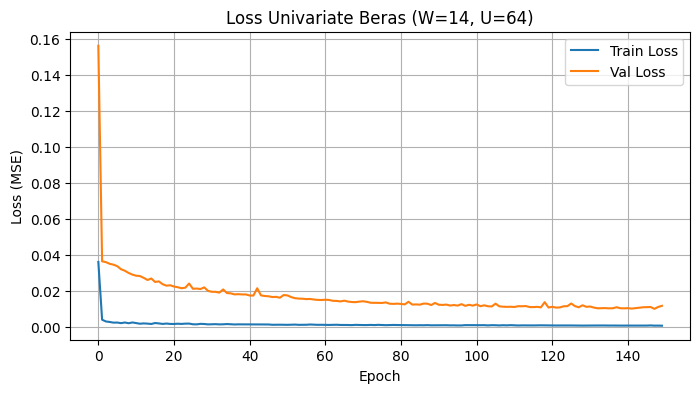

Test MAE  : 124.35
Test RMSE : 137.46
Test MAPE : 0.9615%


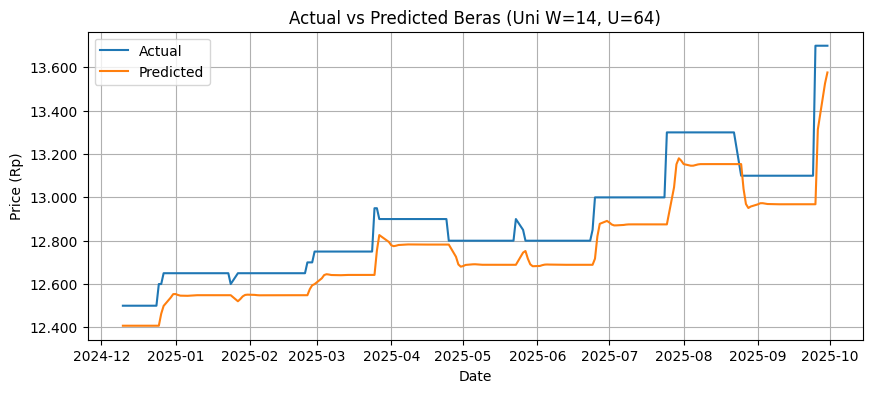

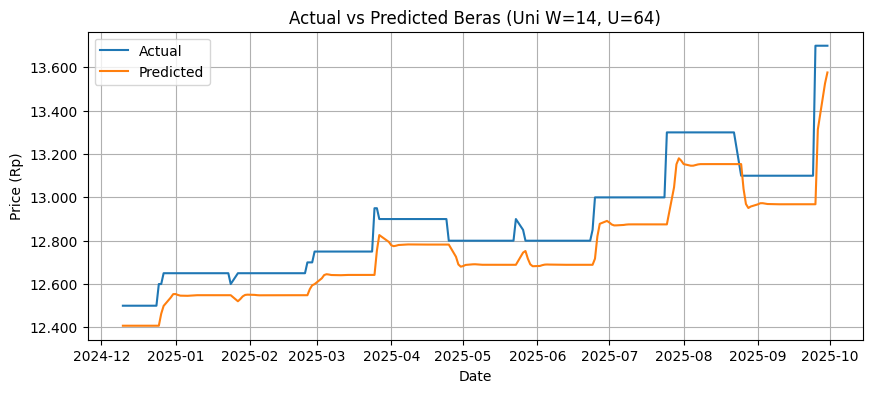


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13700,13576.560547
1,2025-10-02,13700,13478.613281
2,2025-10-03,13700,13347.791992
3,2025-10-06,13700,13215.915039
4,2025-10-07,13700,13093.559570
5,2025-10-08,13700,12982.902344
6,2025-10-09,13700,12882.937500
7,2025-10-10,13700,12791.767578
8,2025-10-13,13700,12707.574219
9,2025-10-14,13700,12628.921875


Forecast MAPE Okt 2025 : 8.0032%
Compare CSV disimpan: compare_Okt2025_uni_W14_U64.csv


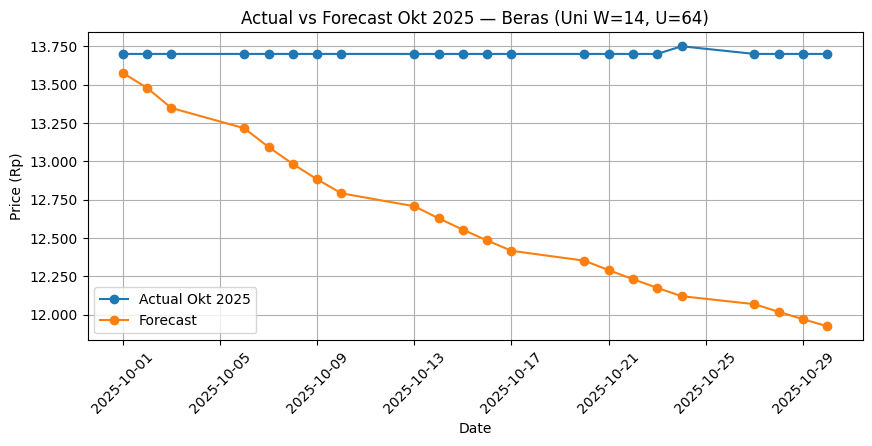

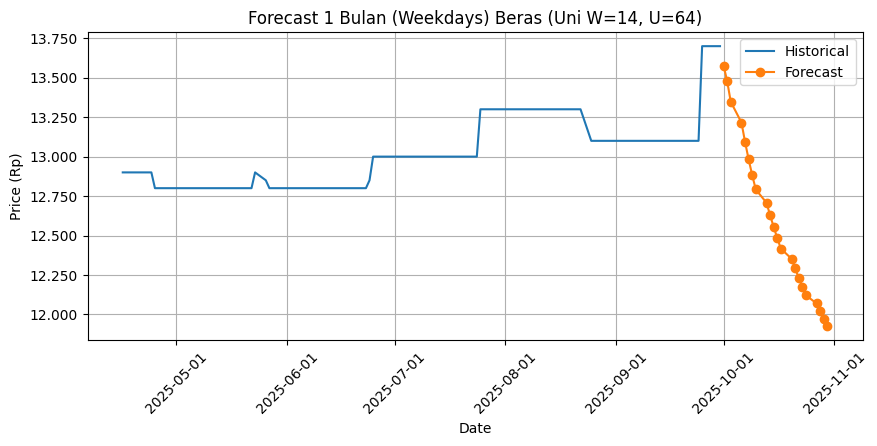

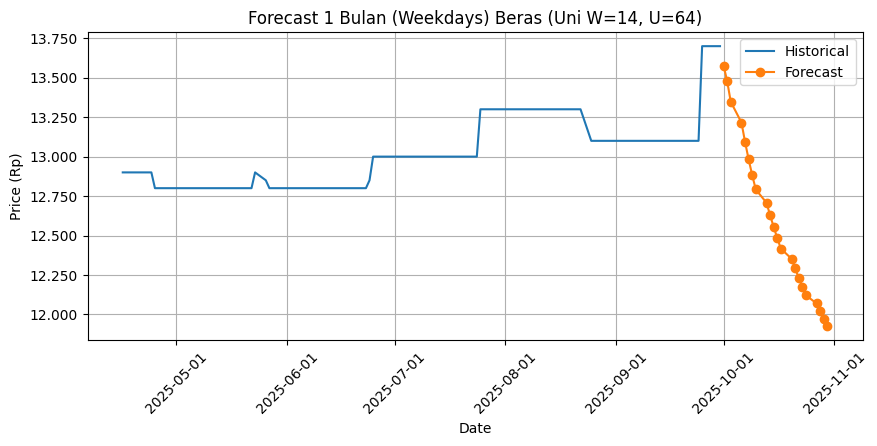


[UNIVARIATE] Target=Beras | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 24ms/step - loss: 0.1339 - val_loss: 0.2026
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0107 - val_loss: 0.0843
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0055 - val_loss: 0.0661
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0047 - val_loss: 0.0710
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0045 - val_loss: 0.0569
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0036 - val_loss: 0.0524
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0040 - val_loss: 0.0527
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 0.0041 - val_loss: 0.0460
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0031 - val_loss: 0.0470
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0032 - val_loss: 0.0423
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0029 - val_loss: 0.0481
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0

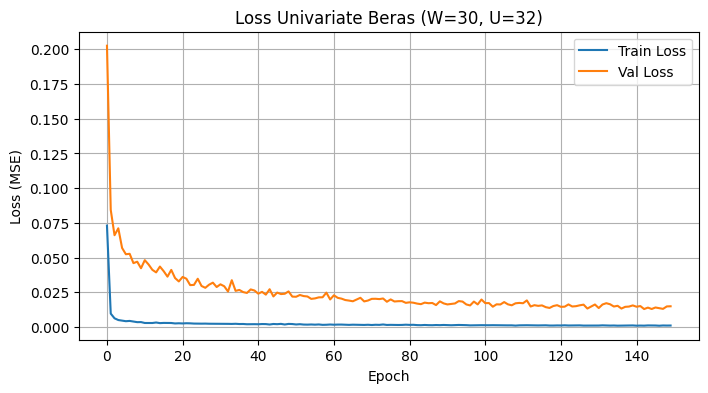

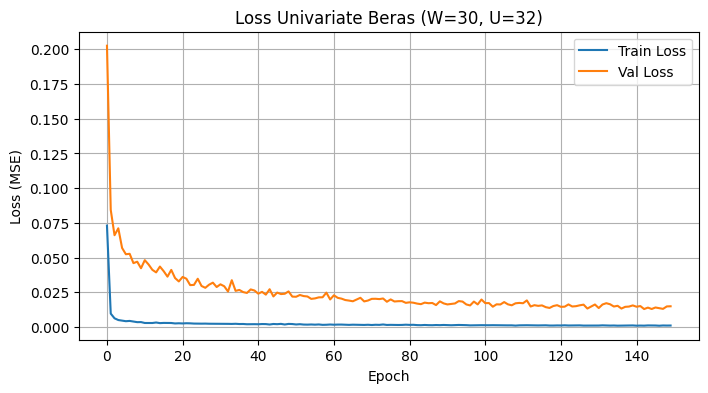

Test MAE  : 141.52
Test RMSE : 155.96
Test MAPE : 1.0914%


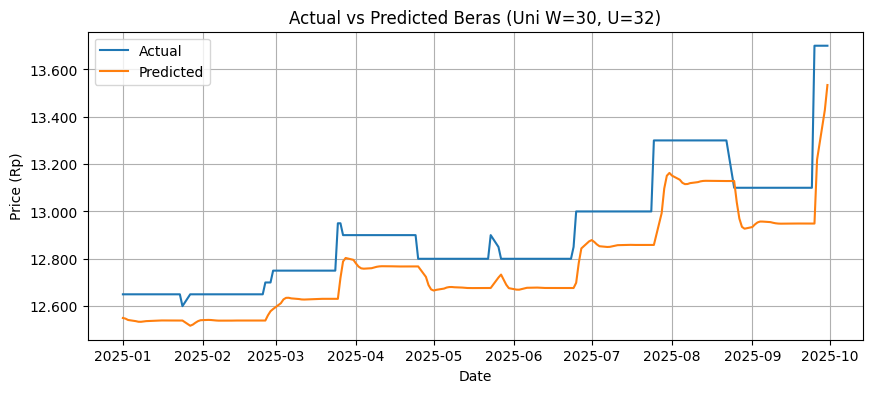

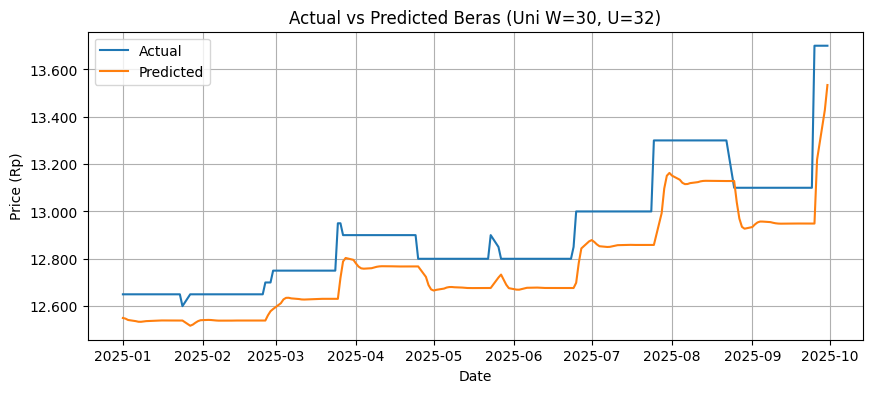


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13700,13533.995117
1,2025-10-02,13700,13477.941406
2,2025-10-03,13700,13369.134766
3,2025-10-06,13700,13237.002930
4,2025-10-07,13700,13100.585938
5,2025-10-08,13700,12971.039062
6,2025-10-09,13700,12853.694336
7,2025-10-10,13700,12750.053711
8,2025-10-13,13700,12659.390625
9,2025-10-14,13700,12579.901367


Forecast MAPE Okt 2025 : 8.0474%
Compare CSV disimpan: compare_Okt2025_uni_W30_U32.csv


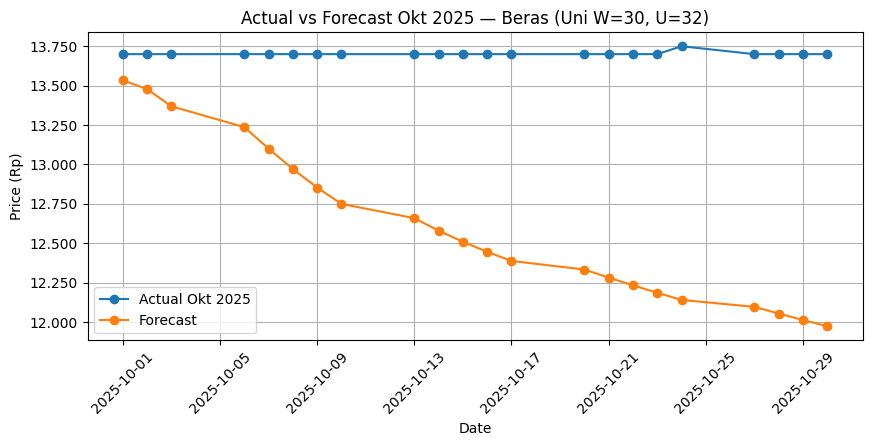

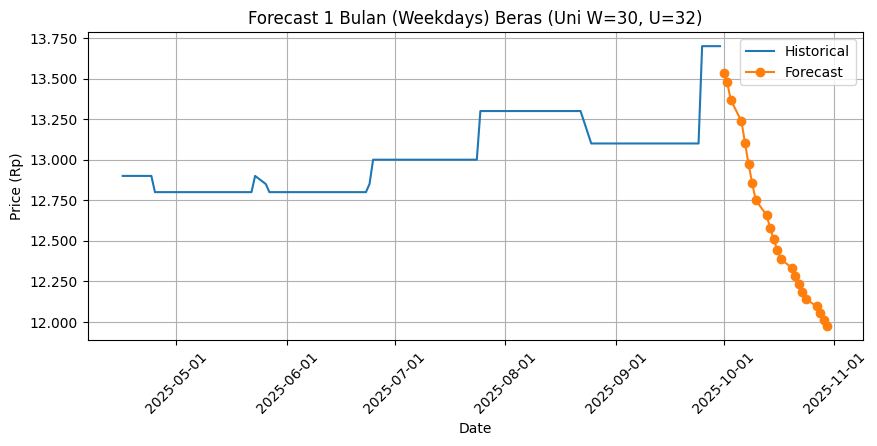

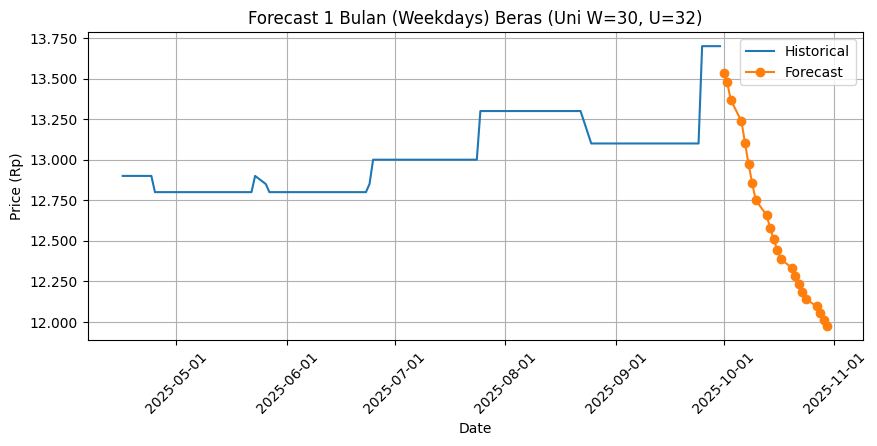


[UNIVARIATE] Target=Beras | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 28ms/step - loss: 0.0903 - val_loss: 0.0663
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0051 - val_loss: 0.0444
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0033 - val_loss: 0.0430
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0028 - val_loss: 0.0410
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0028 - val_loss: 0.0394
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0025 - val_loss: 0.0426
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0029 - val_loss: 0.0364
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0020 - val_loss: 0.0347
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - loss: 0.0021 - val_loss: 0.0368
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0018 - val_loss: 0.0343
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0021 - val_loss: 0.0335
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0

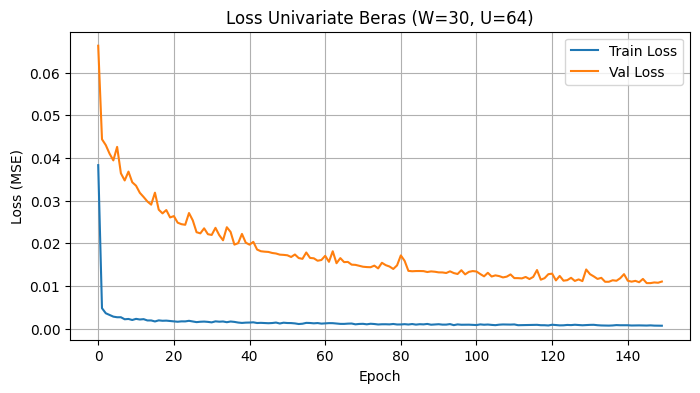

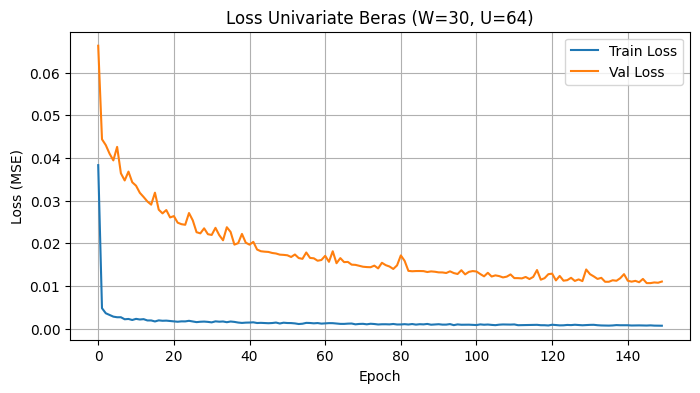

Test MAE  : 73.17
Test RMSE : 92.62
Test MAPE : 0.5637%


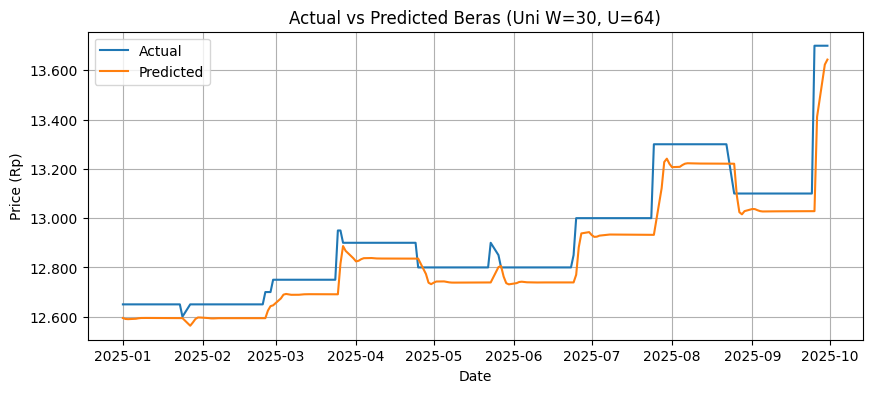

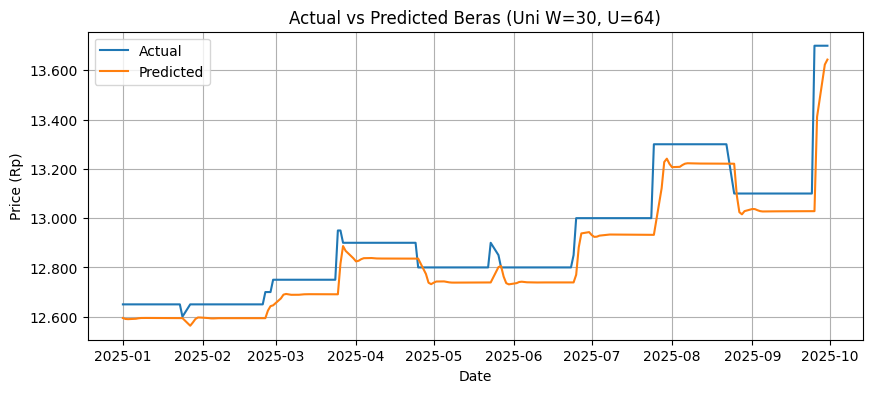


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13700,13643.711914
1,2025-10-02,13700,13561.053711
2,2025-10-03,13700,13463.546875
3,2025-10-06,13700,13377.488281
4,2025-10-07,13700,13306.433594
5,2025-10-08,13700,13246.362305
6,2025-10-09,13700,13192.501953
7,2025-10-10,13700,13141.500977
8,2025-10-13,13700,13091.585938
9,2025-10-14,13700,13042.089844


Forecast MAPE Okt 2025 : 5.1389%
Compare CSV disimpan: compare_Okt2025_uni_W30_U64.csv


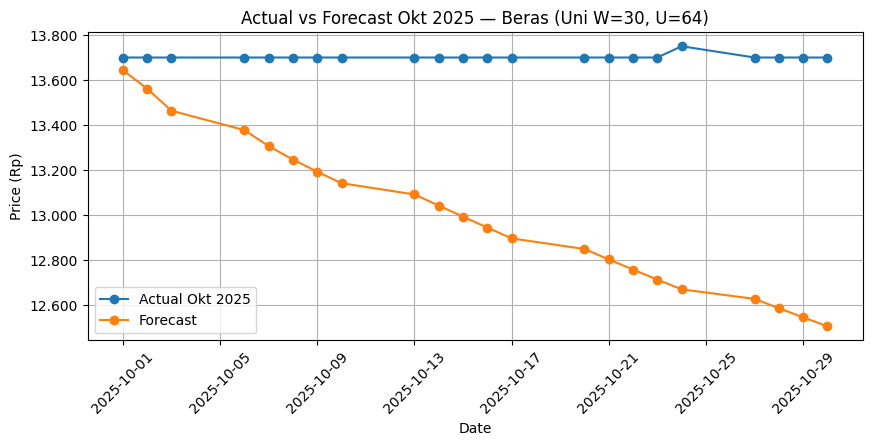

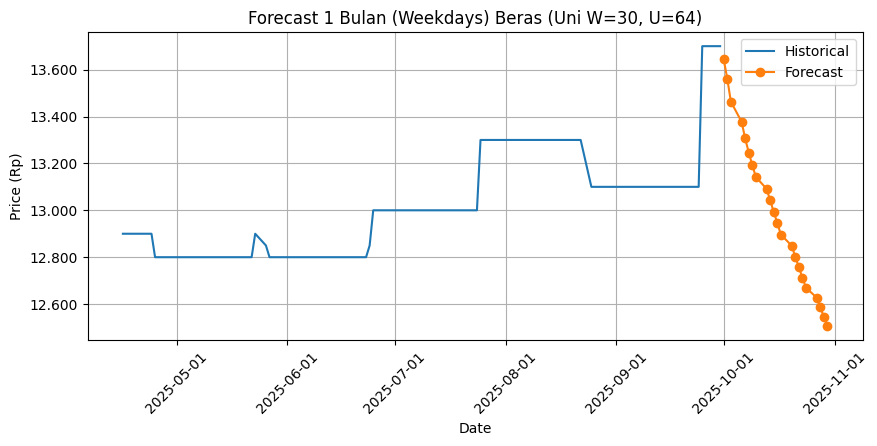

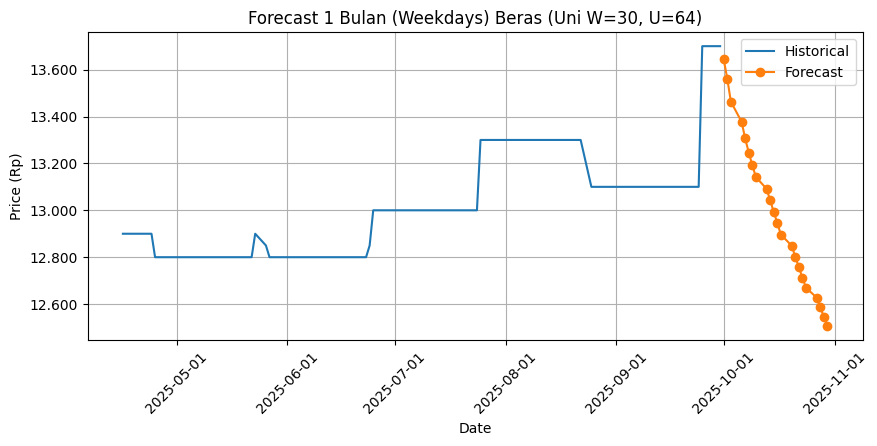


Rekap univariate Beras disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate\Beras\hasil_univariate_Beras.csv

==================== UNIVARIATE: Daging Ayam ====================

[UNIVARIATE] Target=Daging Ayam | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.1740 - val_loss: 0.0013
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0166 - val_loss: 0.0132
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0097 - val_loss: 0.0035
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0083 - val_loss: 0.0012
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0067 - val_loss: 0.0013
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0066 - val_loss: 0.0011
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0054 - val_loss: 0.0013
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0056 - val_loss: 9.0765e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0049 - val_loss: 8.5376e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0052 - val_loss: 8.2179e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0051 - val_loss: 0.0012
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.

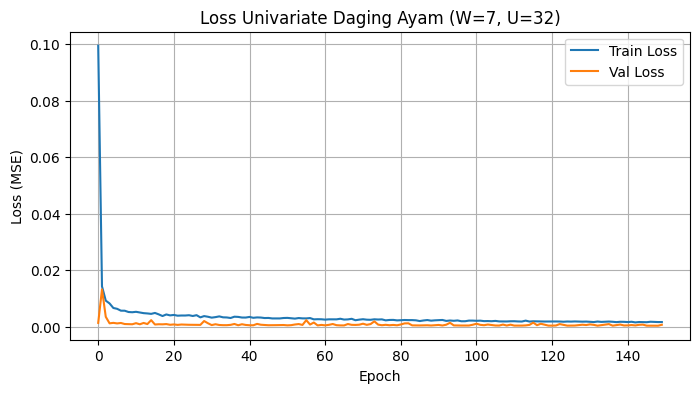

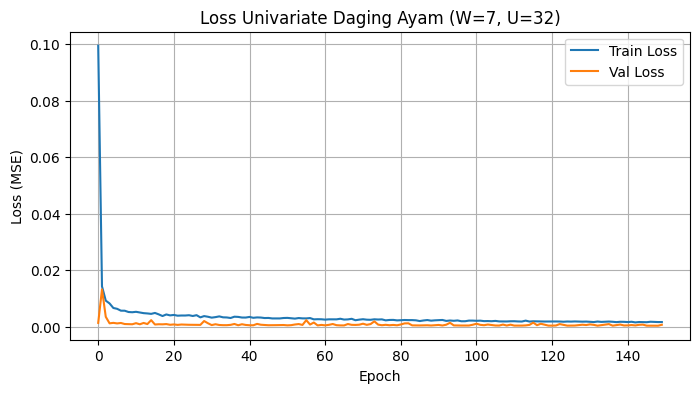

Test MAE  : 302.02
Test RMSE : 482.68
Test MAPE : 0.9387%


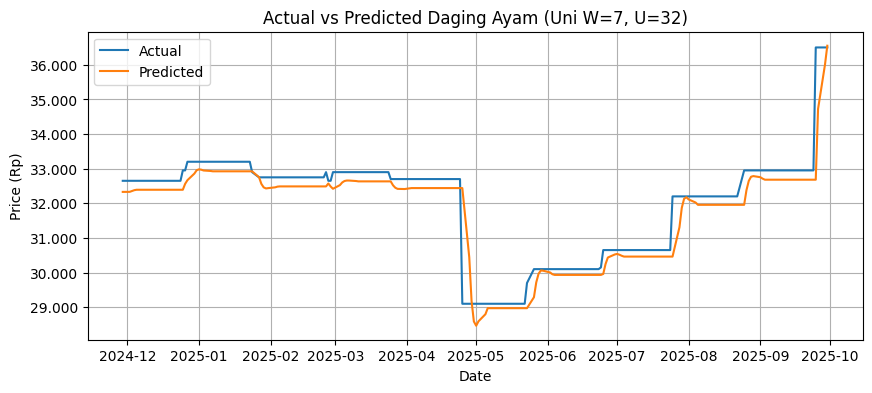

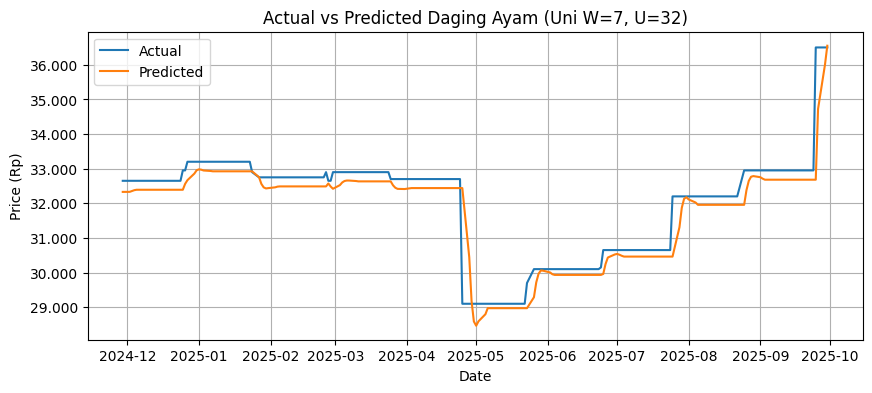


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,36500,36549.839844
1,2025-10-02,36500,36629.597656
2,2025-10-03,36500,36532.113281
3,2025-10-06,36500,36327.425781
4,2025-10-07,36500,36067.988281
5,2025-10-08,36500,35825.437500
6,2025-10-09,36500,35553.742188
7,2025-10-10,36500,35266.480469
8,2025-10-13,36500,34973.667969
9,2025-10-14,36500,34681.312500


Forecast MAPE Okt 2025 : 5.3750%
Compare CSV disimpan: compare_Okt2025_uni_W7_U32.csv


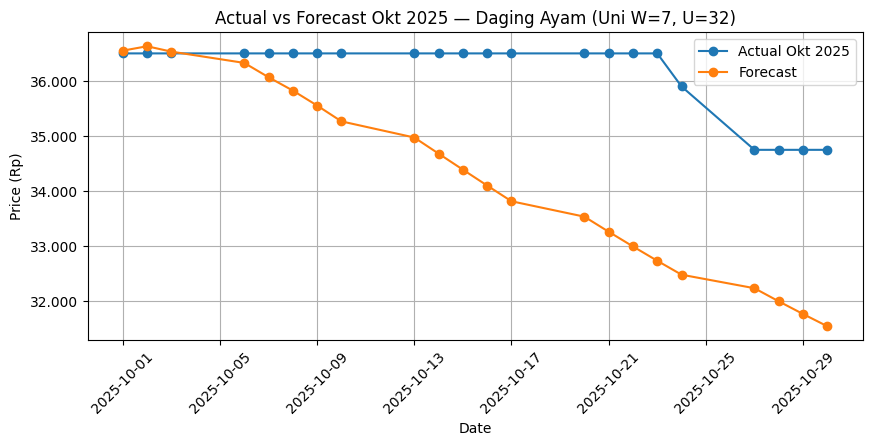

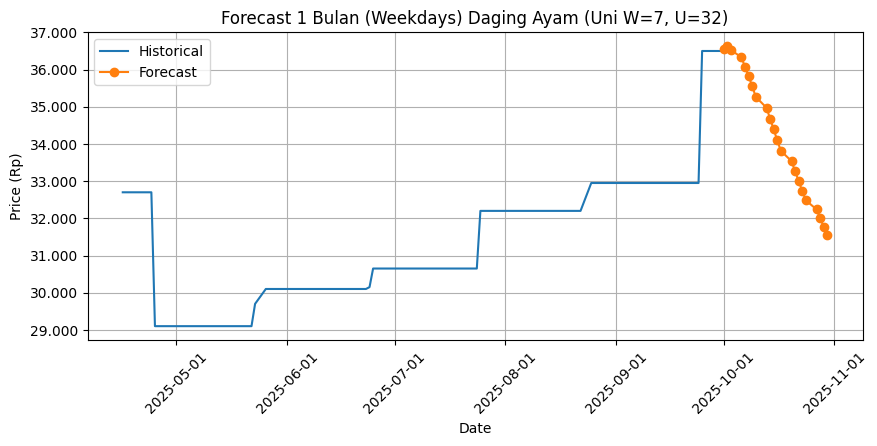

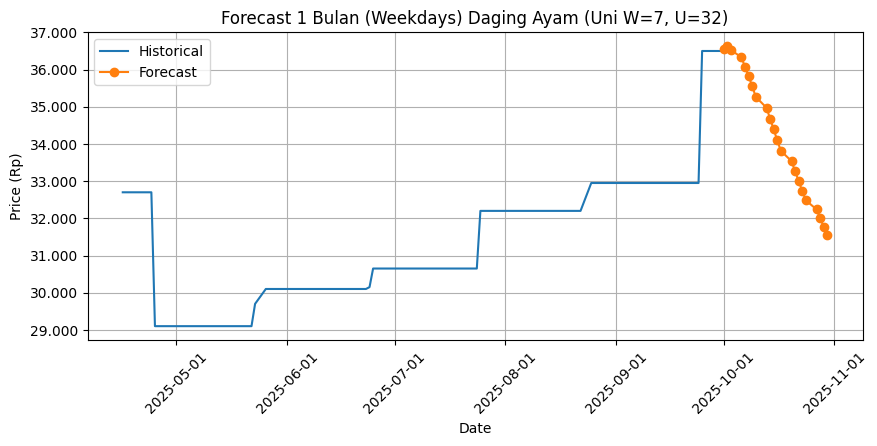


[UNIVARIATE] Target=Daging Ayam | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step - loss: 0.1084 - val_loss: 0.0095
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0077 - val_loss: 0.0029
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0054 - val_loss: 8.9465e-04
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0045 - val_loss: 9.3007e-04
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0048 - val_loss: 8.0799e-04
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0039 - val_loss: 8.7024e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0041 - val_loss: 7.9292e-04
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0038 - val_loss: 7.2959e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0041 - val_loss: 8.8244e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0032 - val_loss: 6.8625e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0034 - val_loss: 0.0012
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 

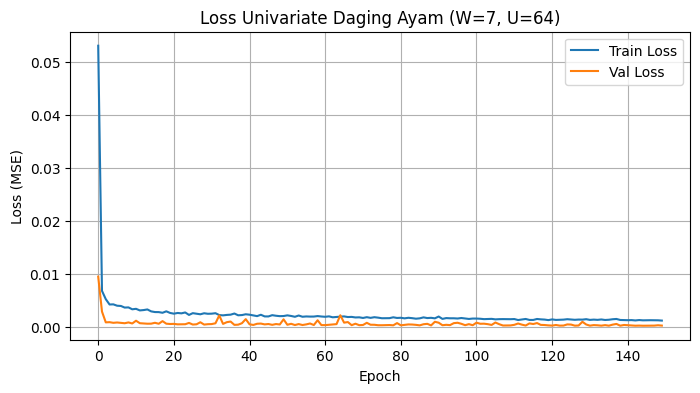

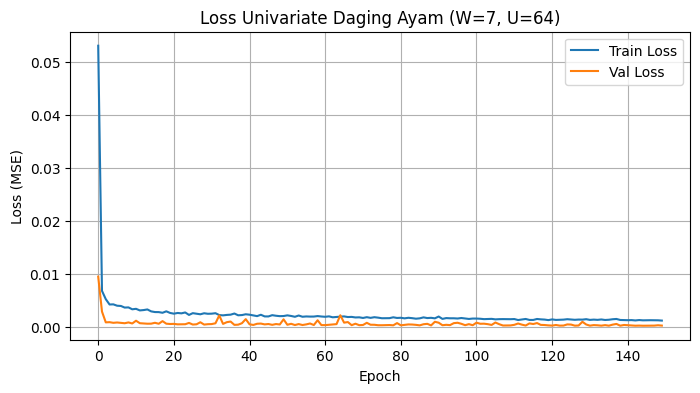

Test MAE  : 144.76
Test RMSE : 385.11
Test MAPE : 0.4525%


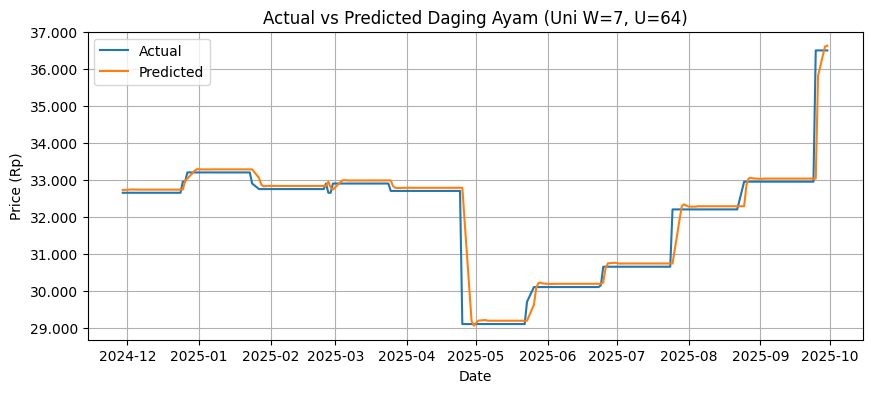

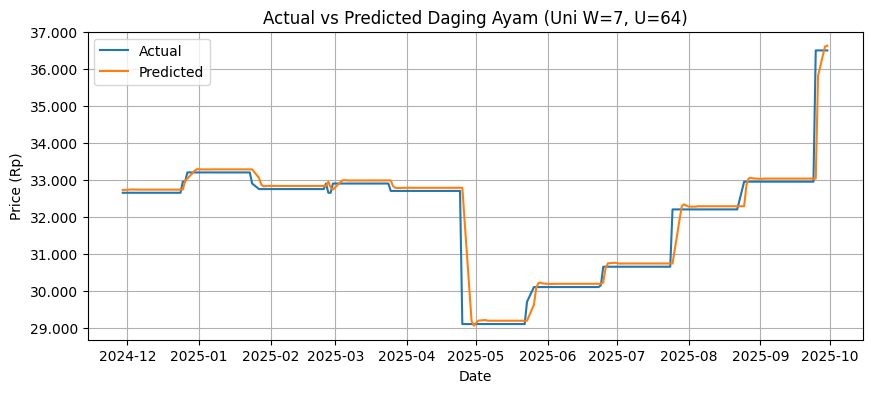


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,36500,36626.960938
1,2025-10-02,36500,36647.957031
2,2025-10-03,36500,36664.636719
3,2025-10-06,36500,36700.398438
4,2025-10-07,36500,36759.972656
5,2025-10-08,36500,36814.472656
6,2025-10-09,36500,36870.378906
7,2025-10-10,36500,36926.503906
8,2025-10-13,36500,36981.621094
9,2025-10-14,36500,37036.039062


Forecast MAPE Okt 2025 : 2.7099%
Compare CSV disimpan: compare_Okt2025_uni_W7_U64.csv


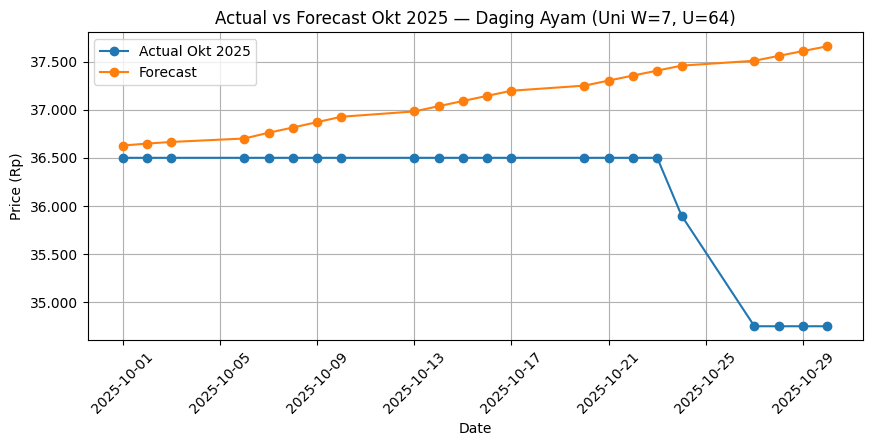

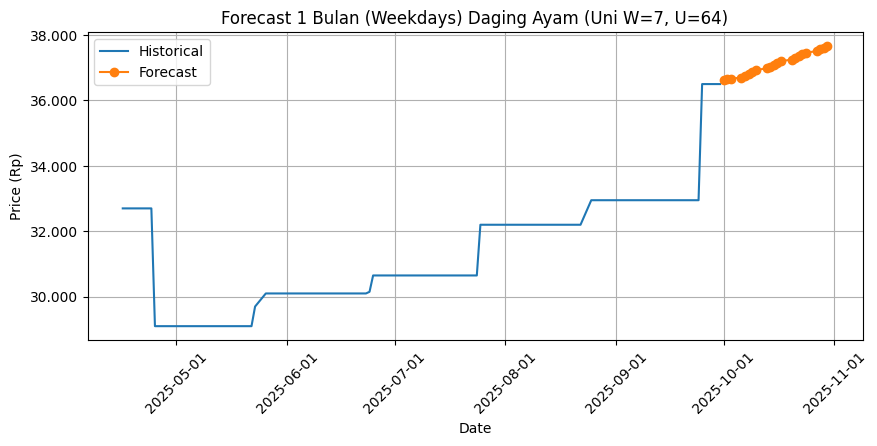

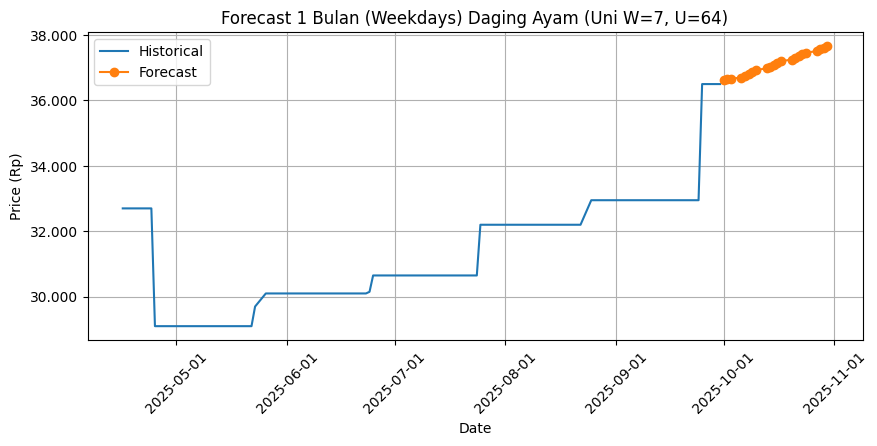


[UNIVARIATE] Target=Daging Ayam | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - loss: 0.1511 - val_loss: 0.0130
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0125 - val_loss: 0.0013
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0086 - val_loss: 0.0014
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0076 - val_loss: 0.0012
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0068 - val_loss: 0.0012
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0071 - val_loss: 0.0012
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0057 - val_loss: 0.0018
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0054 - val_loss: 0.0011
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0062 - val_loss: 0.0011
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0061 - val_loss: 9.8958e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0052 - val_loss: 0.0011
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0

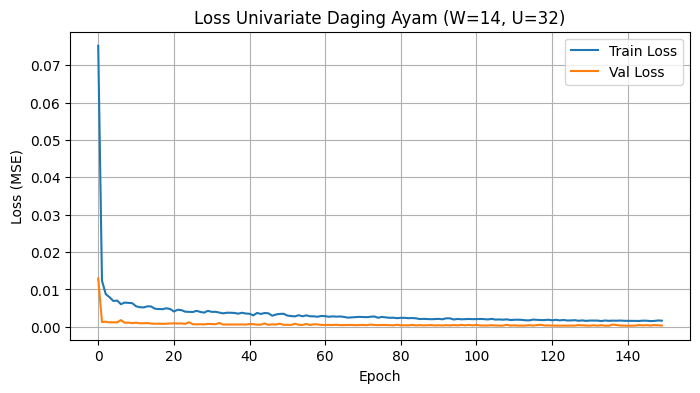

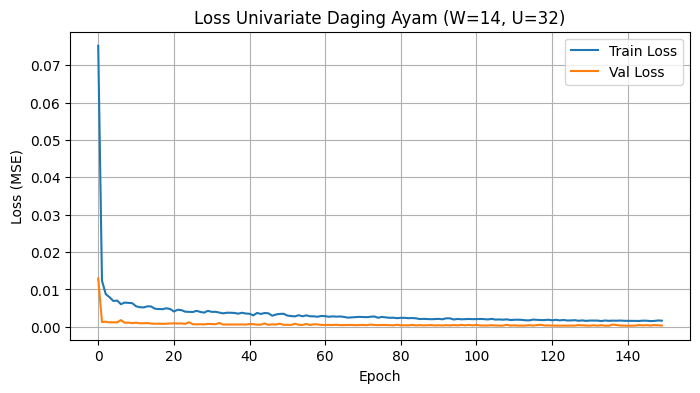

Test MAE  : 162.69
Test RMSE : 415.49
Test MAPE : 0.5049%


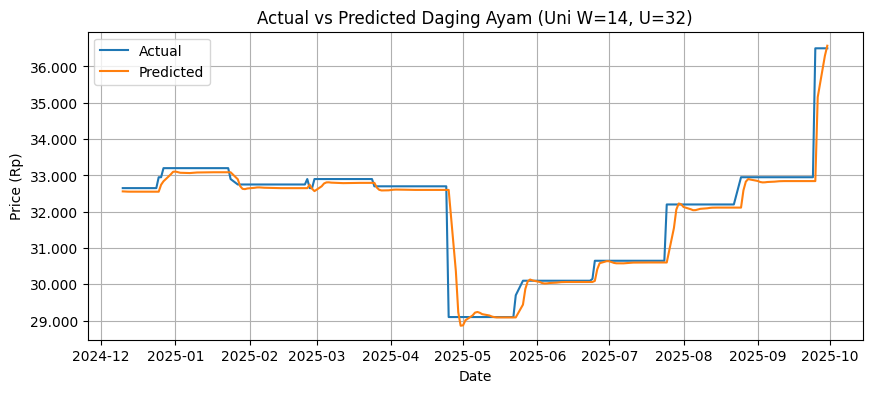

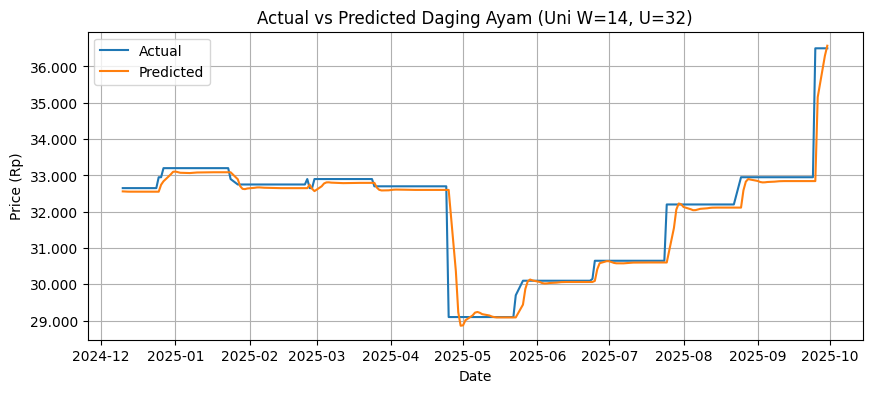


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,36500,36570.980469
1,2025-10-02,36500,36486.281250
2,2025-10-03,36500,36251.039062
3,2025-10-06,36500,35951.945312
4,2025-10-07,36500,35647.234375
5,2025-10-08,36500,35369.847656
6,2025-10-09,36500,35133.781250
7,2025-10-10,36500,34940.750000
8,2025-10-13,36500,34785.742188
9,2025-10-14,36500,34660.824219


Forecast MAPE Okt 2025 : 3.8742%
Compare CSV disimpan: compare_Okt2025_uni_W14_U32.csv


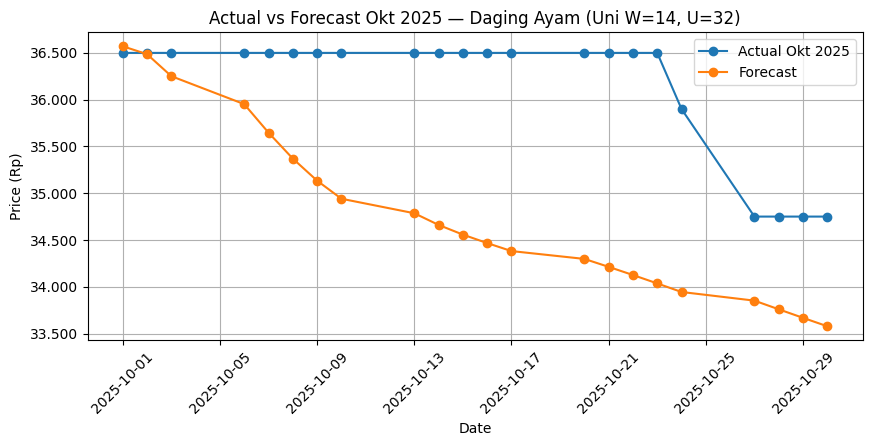

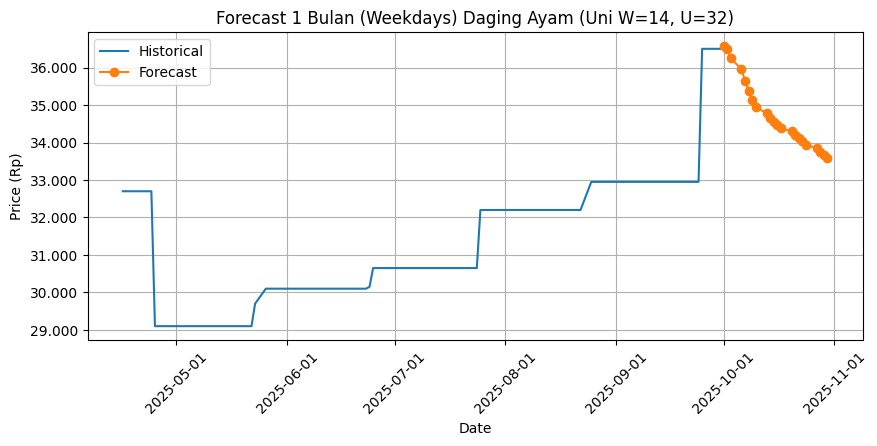

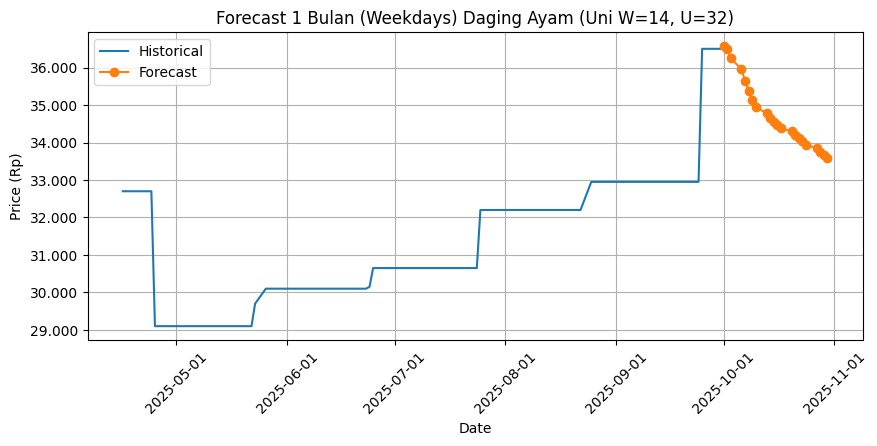


[UNIVARIATE] Target=Daging Ayam | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - loss: 0.1041 - val_loss: 0.0203
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0070 - val_loss: 0.0028
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0050 - val_loss: 0.0015
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0047 - val_loss: 0.0012
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0049 - val_loss: 0.0011
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0040 - val_loss: 0.0010
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0040 - val_loss: 8.6405e-04
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0042 - val_loss: 0.0012
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0037 - val_loss: 9.0893e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0036 - val_loss: 8.9878e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0031 - val_loss: 9.7689e-04
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/s

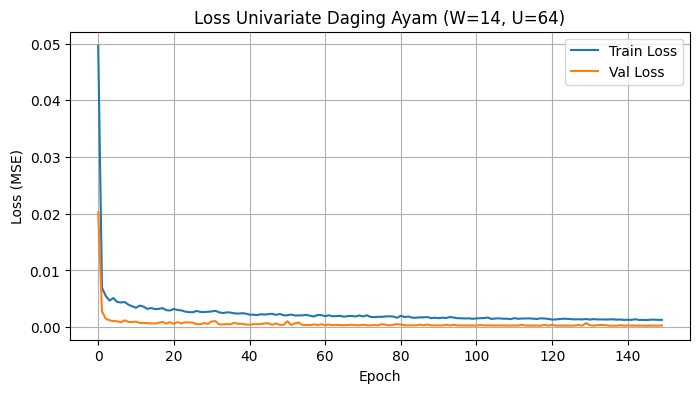

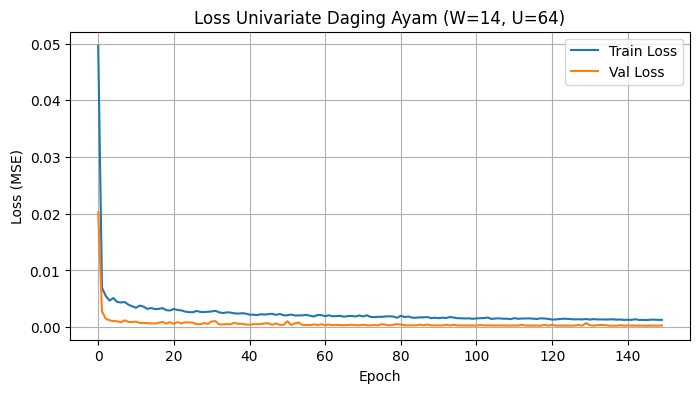

Test MAE  : 142.95
Test RMSE : 393.71
Test MAPE : 0.4425%


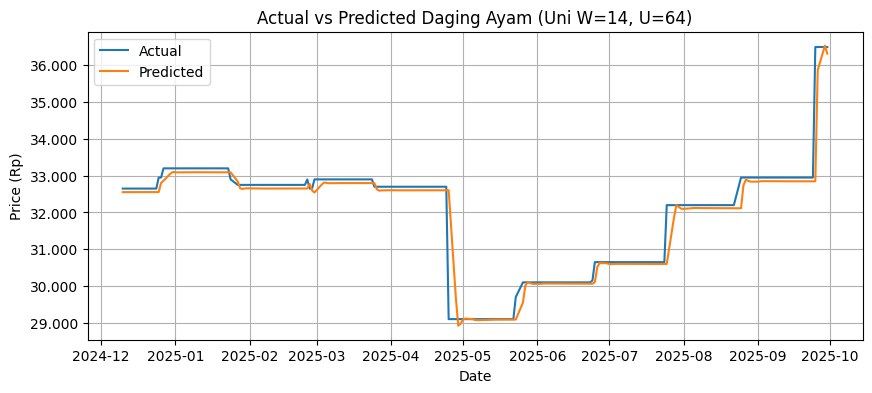

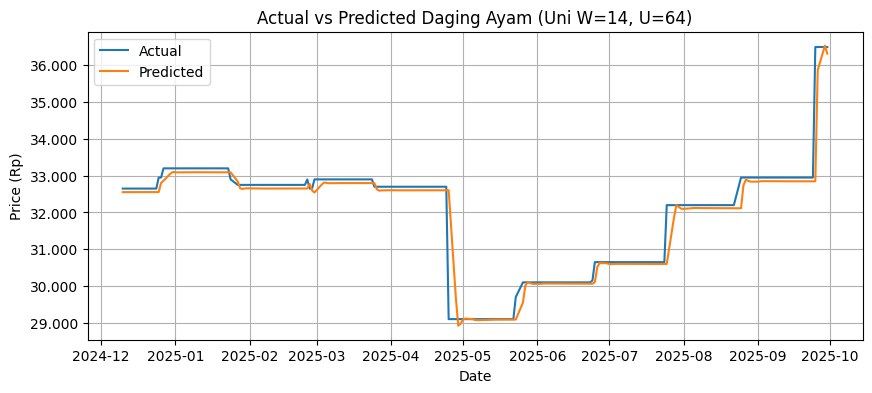


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,36500,36320.917969
1,2025-10-02,36500,36080.281250
2,2025-10-03,36500,35891.347656
3,2025-10-06,36500,35739.972656
4,2025-10-07,36500,35604.675781
5,2025-10-08,36500,35473.140625
6,2025-10-09,36500,35340.707031
7,2025-10-10,36500,35206.574219
8,2025-10-13,36500,35071.339844
9,2025-10-14,36500,34935.828125


Forecast MAPE Okt 2025 : 3.8145%
Compare CSV disimpan: compare_Okt2025_uni_W14_U64.csv


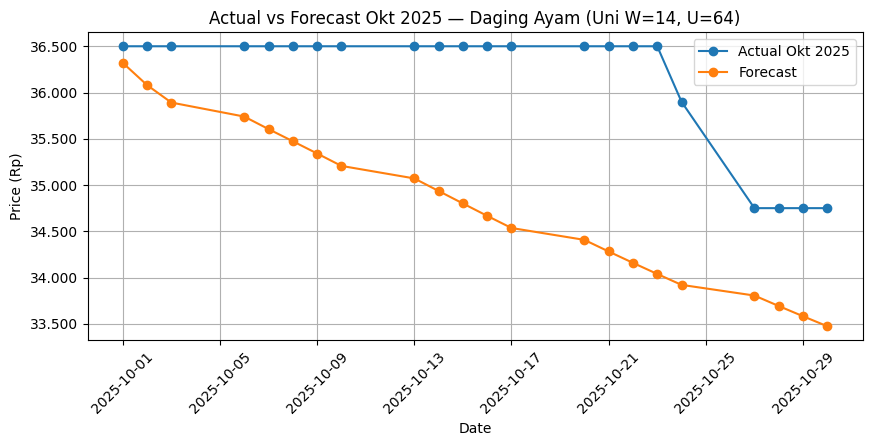

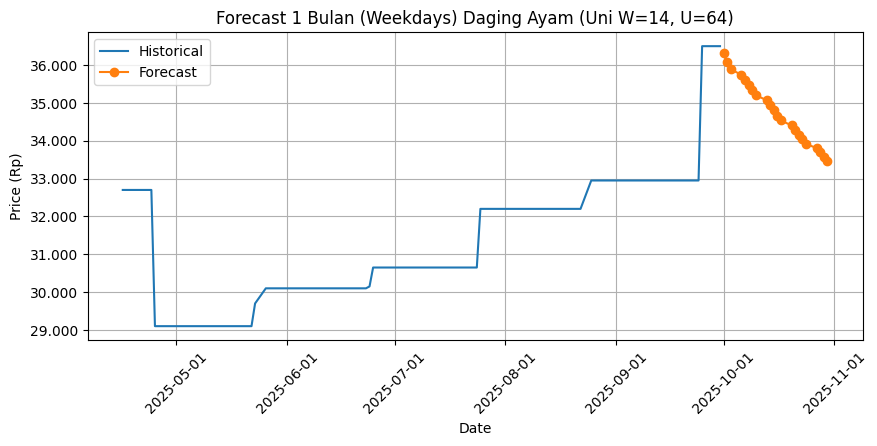

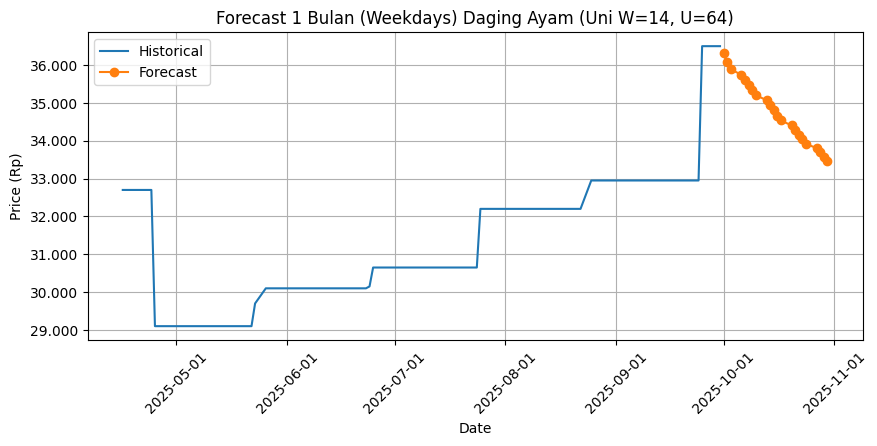


[UNIVARIATE] Target=Daging Ayam | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - loss: 0.0640 - val_loss: 0.0148
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0085 - val_loss: 0.0014
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0074 - val_loss: 0.0012
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0062 - val_loss: 0.0017
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0067 - val_loss: 0.0016
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0054 - val_loss: 0.0016
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0054 - val_loss: 0.0011
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0047 - val_loss: 0.0013
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0050 - val_loss: 8.5414e-04
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0047 - val_loss: 0.0011
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0049 - val_loss: 7.5253e-04
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - l

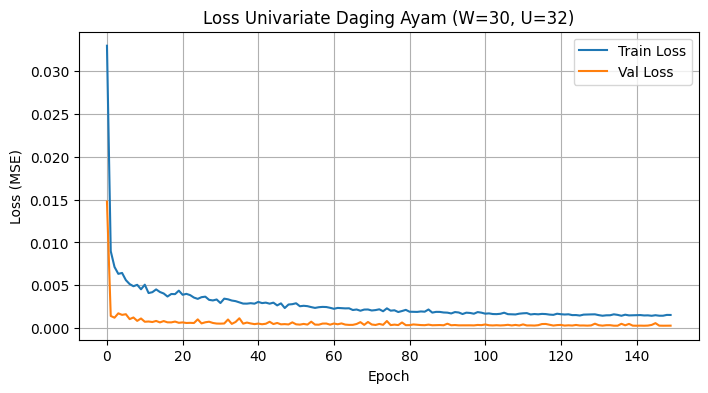

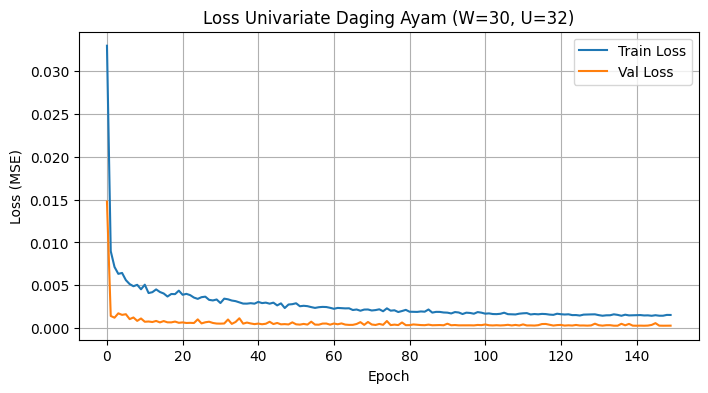

Test MAE  : 158.33
Test RMSE : 410.99
Test MAPE : 0.4980%


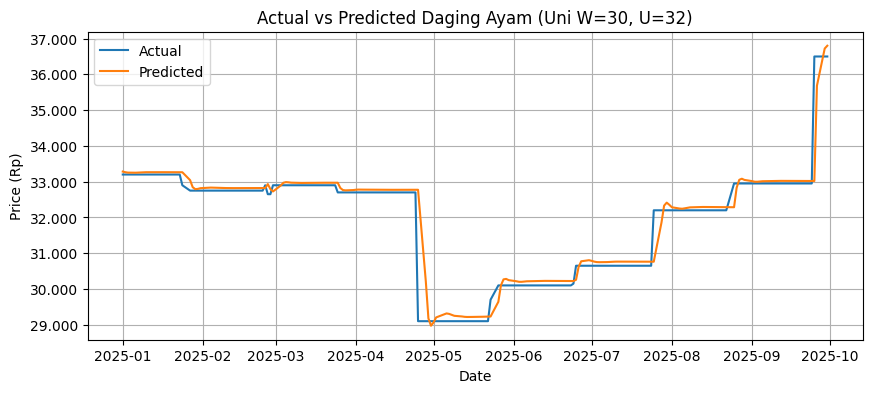

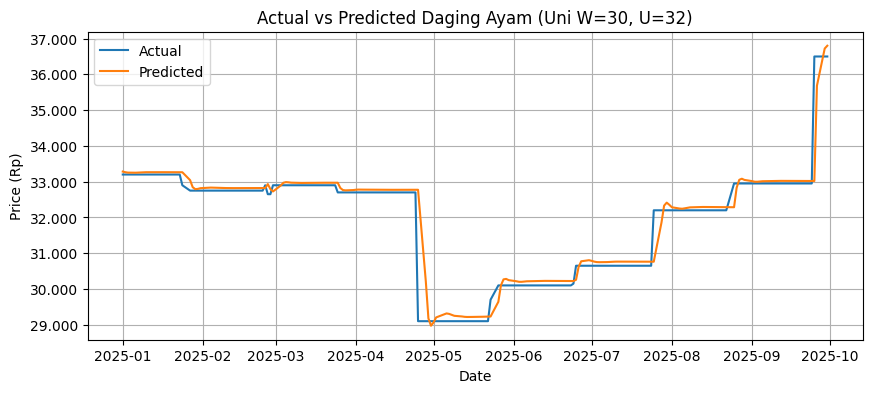


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,36500,36800.996094
1,2025-10-02,36500,36819.750000
2,2025-10-03,36500,36745.078125
3,2025-10-06,36500,36637.753906
4,2025-10-07,36500,36535.128906
5,2025-10-08,36500,36455.125000
6,2025-10-09,36500,36402.445312
7,2025-10-10,36500,36374.175781
8,2025-10-13,36500,36364.003906
9,2025-10-14,36500,36364.933594


Forecast MAPE Okt 2025 : 1.1793%
Compare CSV disimpan: compare_Okt2025_uni_W30_U32.csv


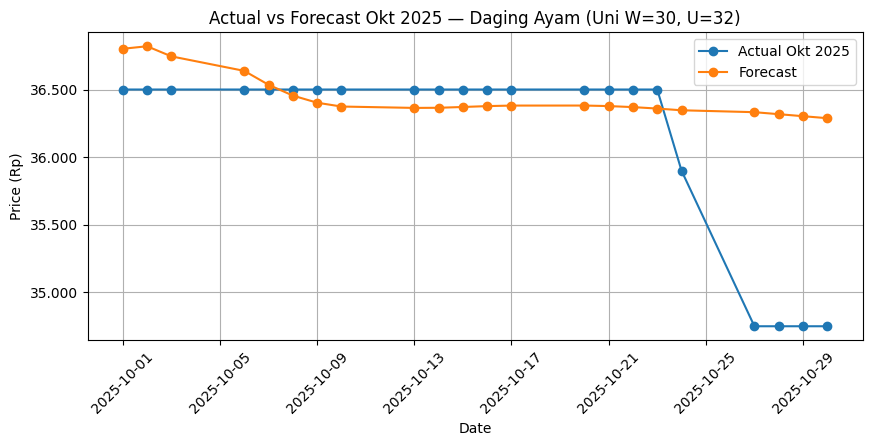

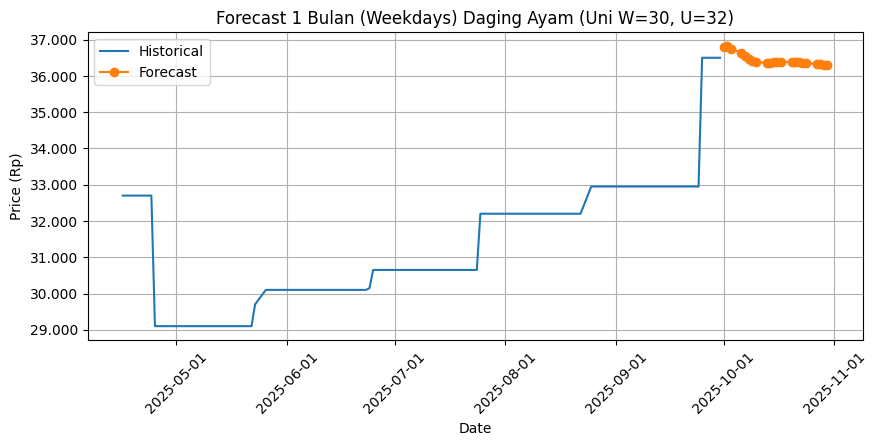

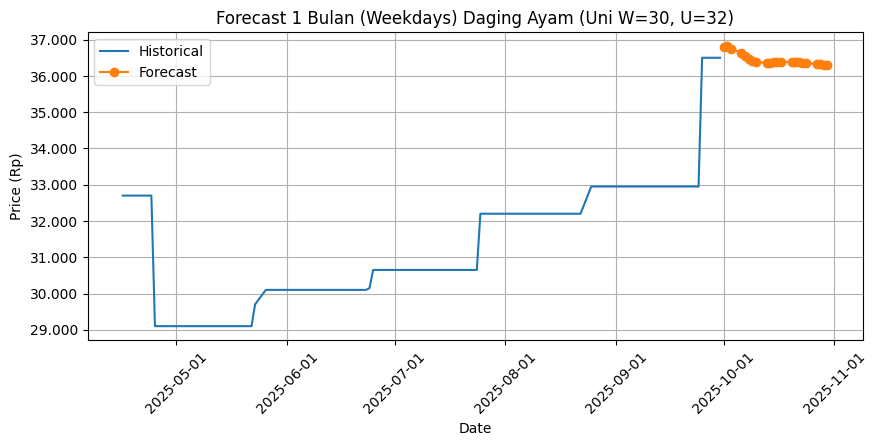


[UNIVARIATE] Target=Daging Ayam | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - loss: 0.1640 - val_loss: 0.0182
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0096 - val_loss: 0.0014
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0068 - val_loss: 0.0021
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0056 - val_loss: 0.0013
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 0.0054 - val_loss: 0.0012
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 0.0055 - val_loss: 0.0021
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0049 - val_loss: 0.0011
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0044 - val_loss: 0.0018
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 0.0045 - val_loss: 0.0012
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - loss: 0.0039 - val_loss: 0.0014
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0042 - val_loss: 9.9295e-04
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss:

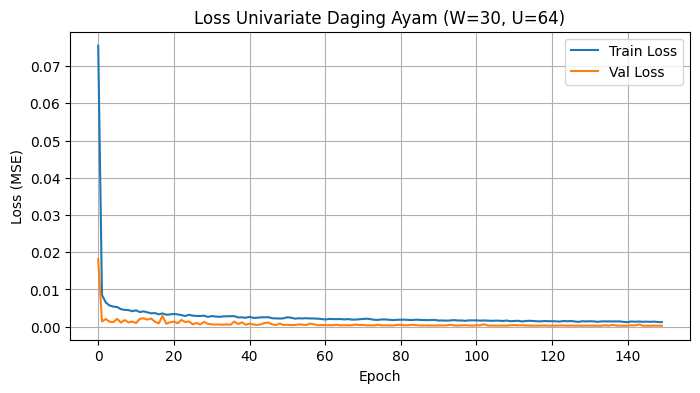

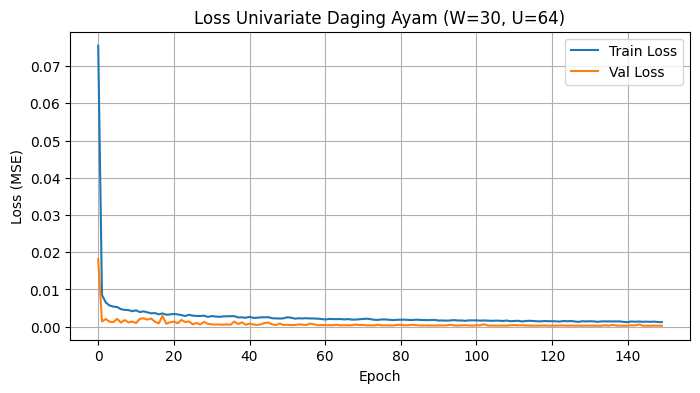

Test MAE  : 127.72
Test RMSE : 397.11
Test MAPE : 0.4008%


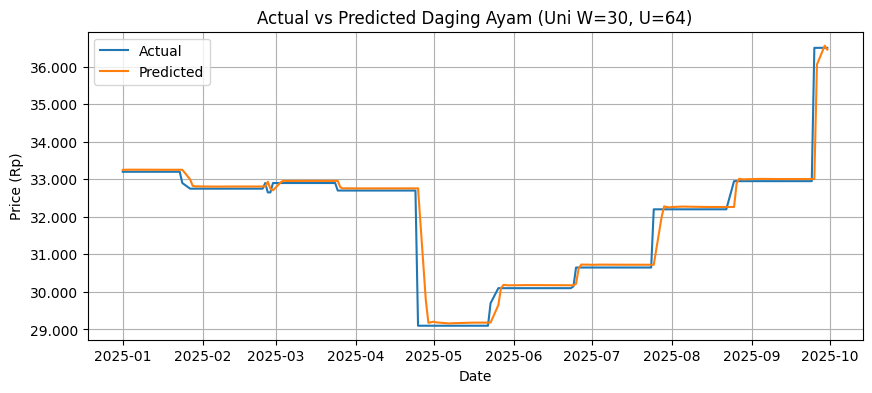

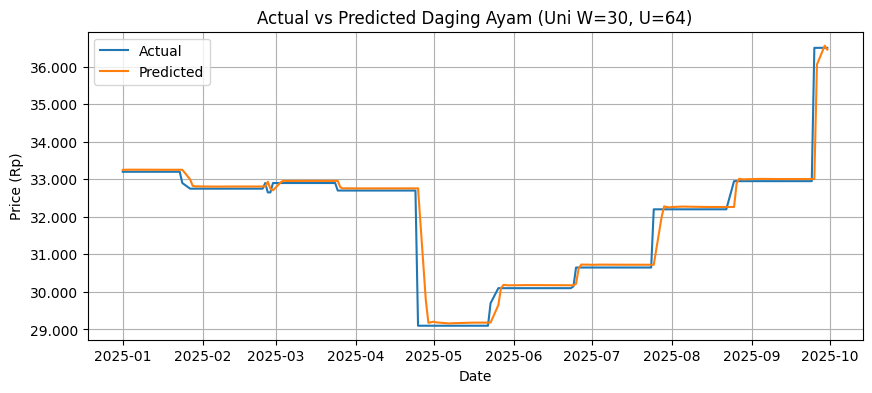


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,36500,36453.742188
1,2025-10-02,36500,36434.691406
2,2025-10-03,36500,36456.121094
3,2025-10-06,36500,36488.285156
4,2025-10-07,36500,36519.308594
5,2025-10-08,36500,36545.183594
6,2025-10-09,36500,36565.421875
7,2025-10-10,36500,36580.937500
8,2025-10-13,36500,36592.992188
9,2025-10-14,36500,36602.687500


Forecast MAPE Okt 2025 : 1.2861%
Compare CSV disimpan: compare_Okt2025_uni_W30_U64.csv


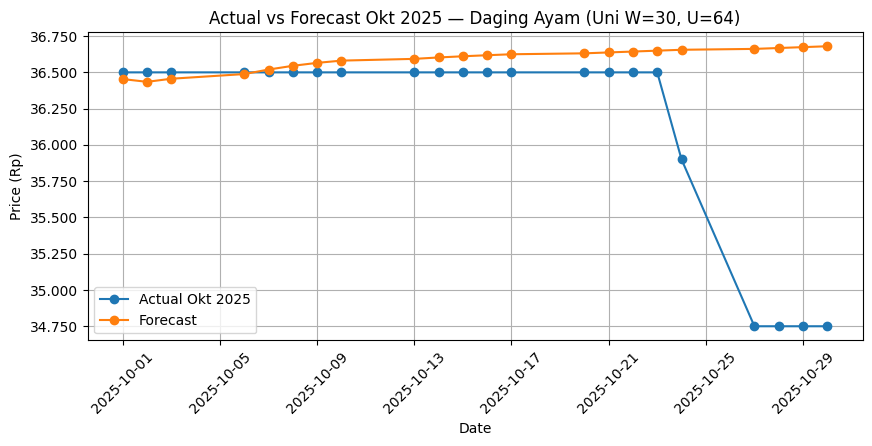

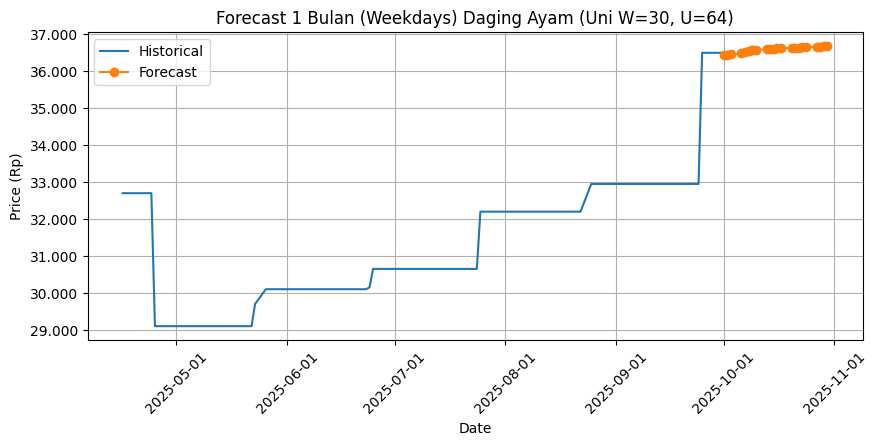

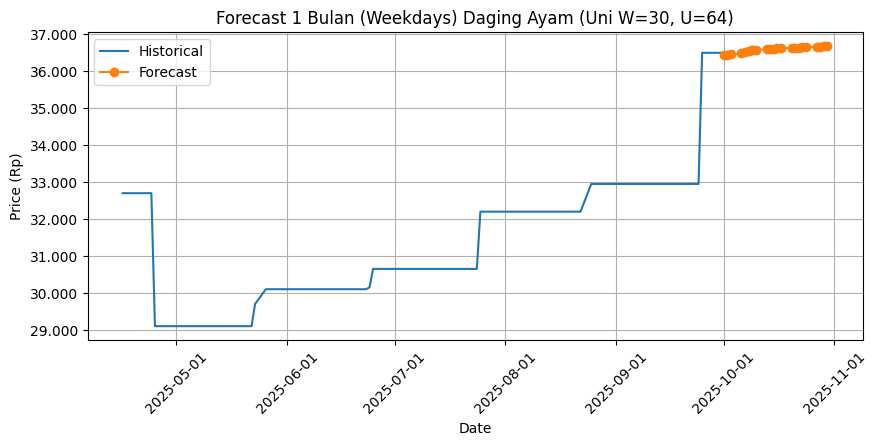


Rekap univariate Daging Ayam disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate\Daging_Ayam\hasil_univariate_Daging_Ayam.csv

==================== UNIVARIATE: Daging Sapi ====================

[UNIVARIATE] Target=Daging Sapi | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - loss: 0.3426 - val_loss: 0.0609
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0237 - val_loss: 0.0170
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0179 - val_loss: 0.0022
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0098 - val_loss: 0.0011
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0080 - val_loss: 6.1637e-04
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0080 - val_loss: 0.0010
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0064 - val_loss: 0.0017
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0061 - val_loss: 0.0014
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0063 - val_loss: 4.7420e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0059 - val_loss: 6.6957e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0058 - val_loss: 6.0558e-04
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss

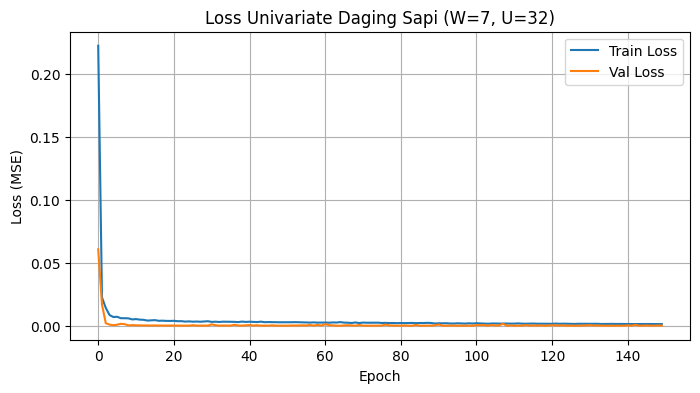

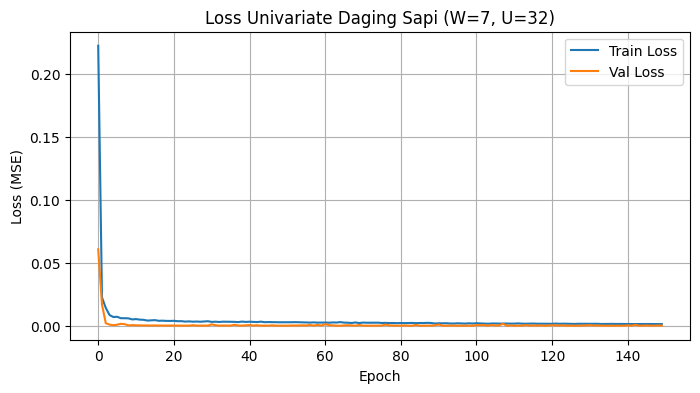

Test MAE  : 318.65
Test RMSE : 440.40
Test MAPE : 0.2630%


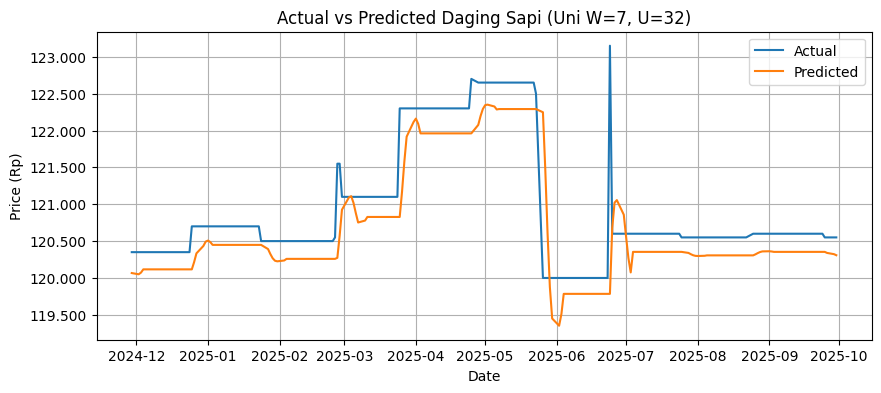

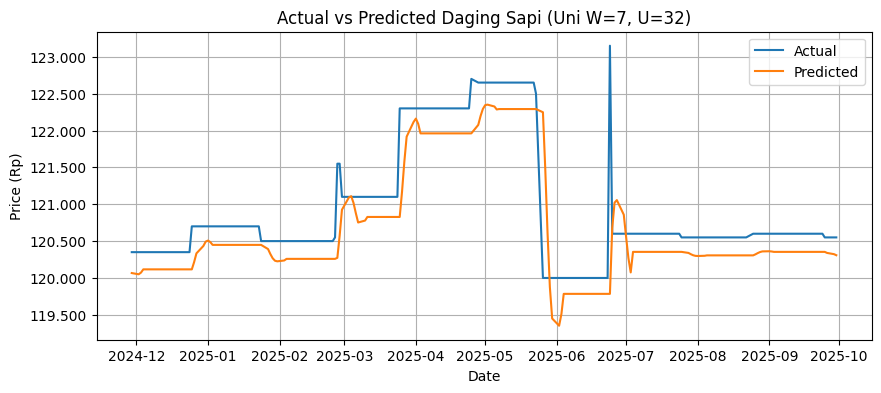


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,120550,120308.492188
1,2025-10-02,120550,120231.875000
2,2025-10-03,120550,120126.789062
3,2025-10-06,120550,120005.335938
4,2025-10-07,120550,119878.453125
5,2025-10-08,120550,119748.765625
6,2025-10-09,120550,119627.664062
7,2025-10-10,120550,119519.437500
8,2025-10-13,120550,119398.843750
9,2025-10-14,120550,119284.859375


Forecast MAPE Okt 2025 : 1.1321%
Compare CSV disimpan: compare_Okt2025_uni_W7_U32.csv


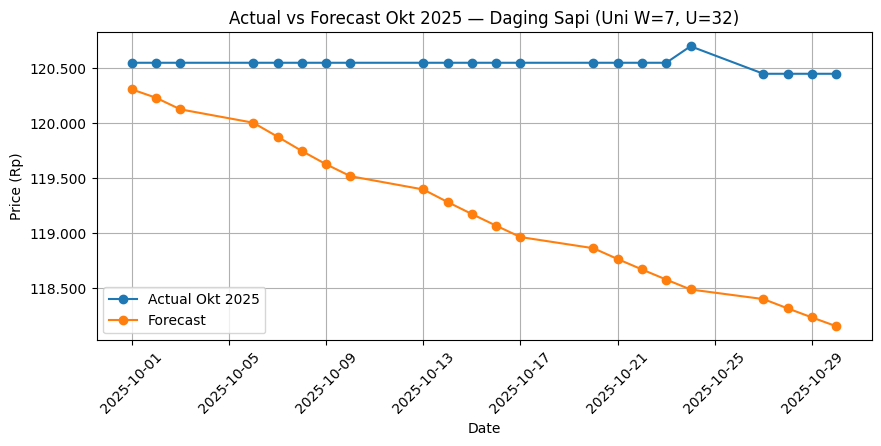

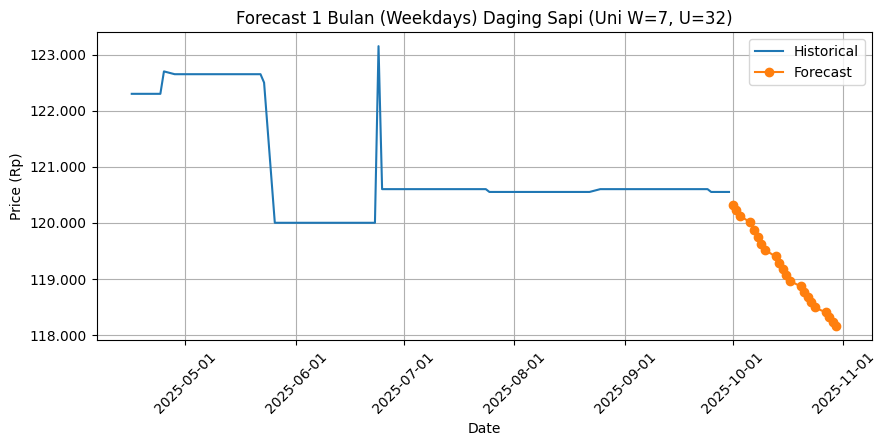

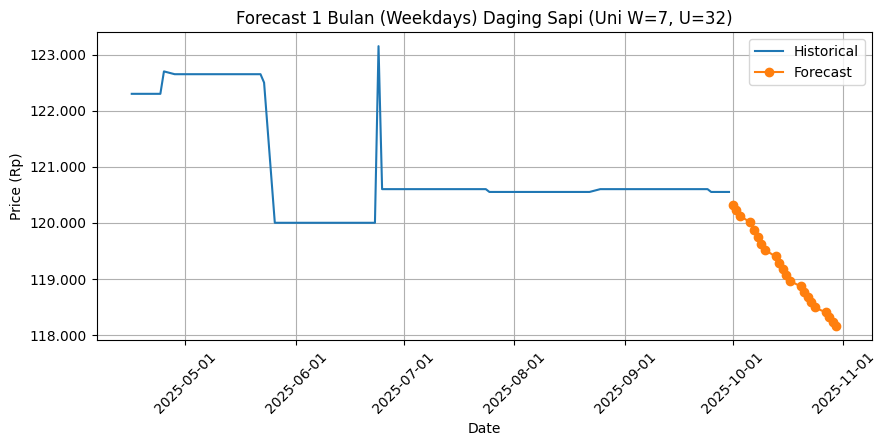


[UNIVARIATE] Target=Daging Sapi | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - loss: 0.1677 - val_loss: 0.0047
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0084 - val_loss: 0.0014
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0049 - val_loss: 4.5702e-04
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0042 - val_loss: 3.1134e-04
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0039 - val_loss: 4.4170e-04
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0040 - val_loss: 3.0524e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0036 - val_loss: 7.5333e-04
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0038 - val_loss: 3.5558e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0032 - val_loss: 4.3356e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0032 - val_loss: 2.8503e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0029 - val_loss: 3.6801e-04
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━

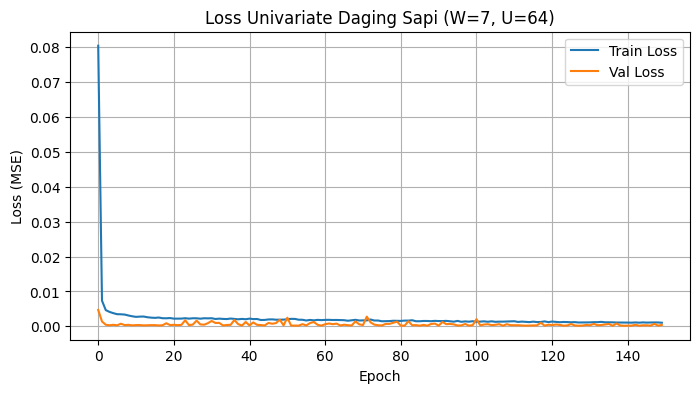

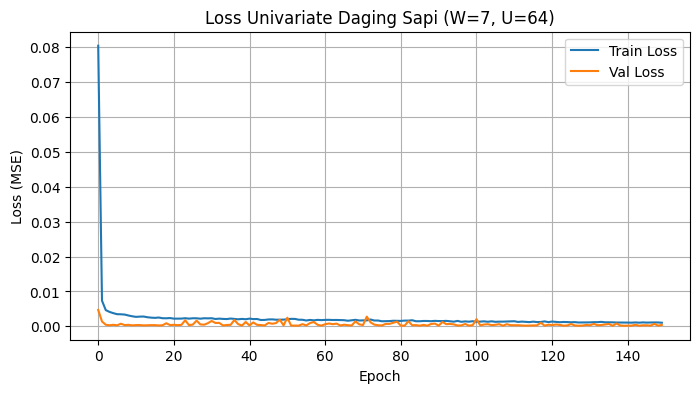

Test MAE  : 381.62
Test RMSE : 476.66
Test MAPE : 0.3151%


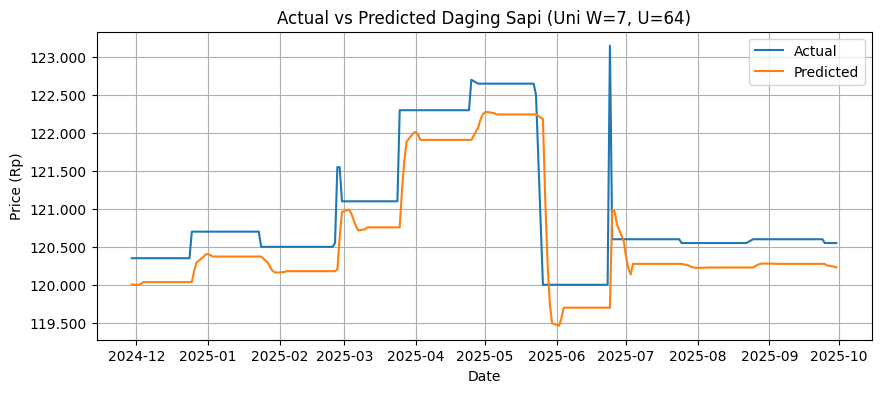

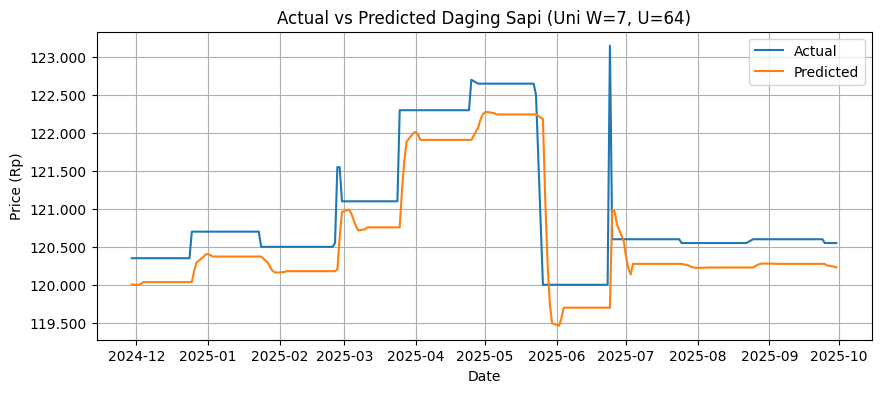


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,120550,120228.437500
1,2025-10-02,120550,120092.601562
2,2025-10-03,120550,119932.046875
3,2025-10-06,120550,119756.343750
4,2025-10-07,120550,119574.929688
5,2025-10-08,120550,119392.156250
6,2025-10-09,120550,119215.507812
7,2025-10-10,120550,119048.835938
8,2025-10-13,120550,118877.632812
9,2025-10-14,120550,118710.820312


Forecast MAPE Okt 2025 : 1.6703%
Compare CSV disimpan: compare_Okt2025_uni_W7_U64.csv


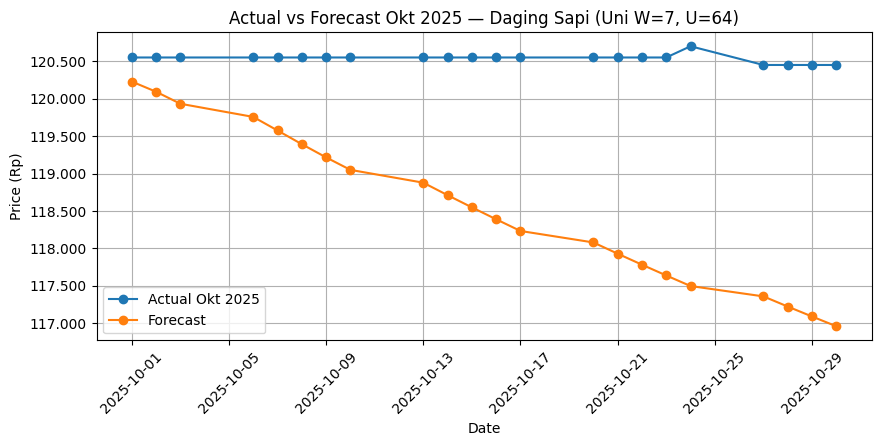

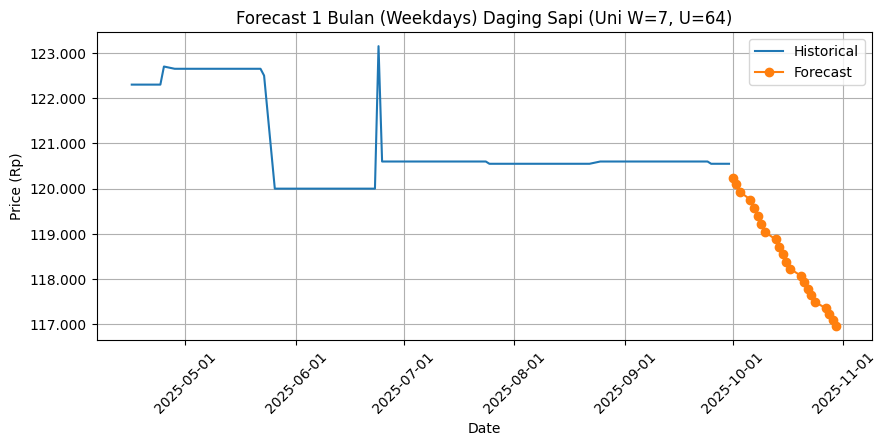

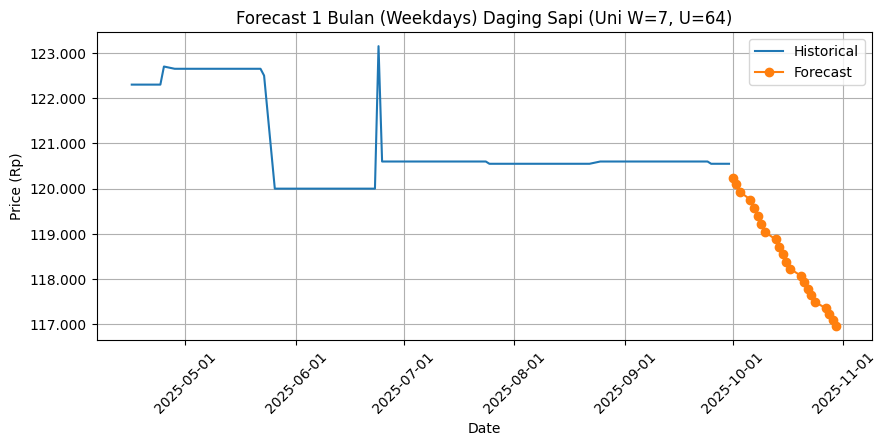


[UNIVARIATE] Target=Daging Sapi | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 0.1593 - val_loss: 5.2606e-04
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0128 - val_loss: 0.0011
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0079 - val_loss: 8.8413e-04
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0064 - val_loss: 5.9616e-04
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0056 - val_loss: 5.4470e-04
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0059 - val_loss: 3.5361e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0050 - val_loss: 3.7969e-04
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0050 - val_loss: 5.4305e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0049 - val_loss: 3.7677e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0048 - val_loss: 5.5739e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0040 - val_loss: 6.4993e-04
Epoch 12/150
33/33 ━━━━━━━━━━

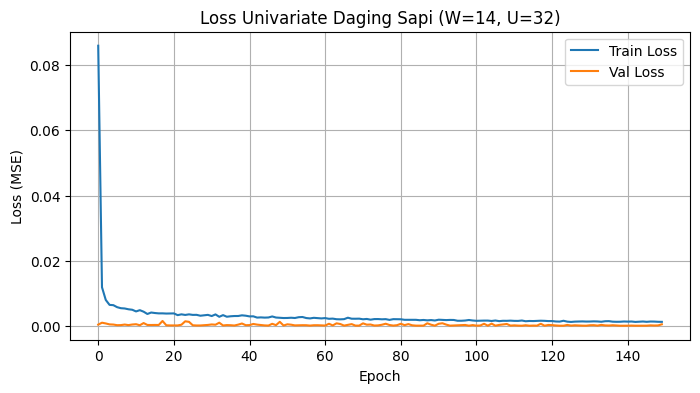

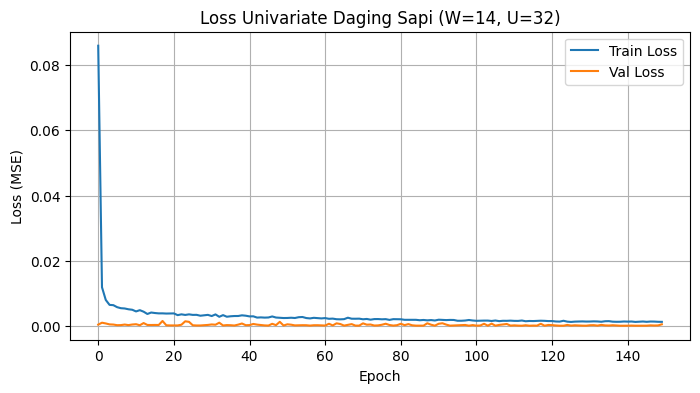

Test MAE  : 512.16
Test RMSE : 585.85
Test MAPE : 0.4228%


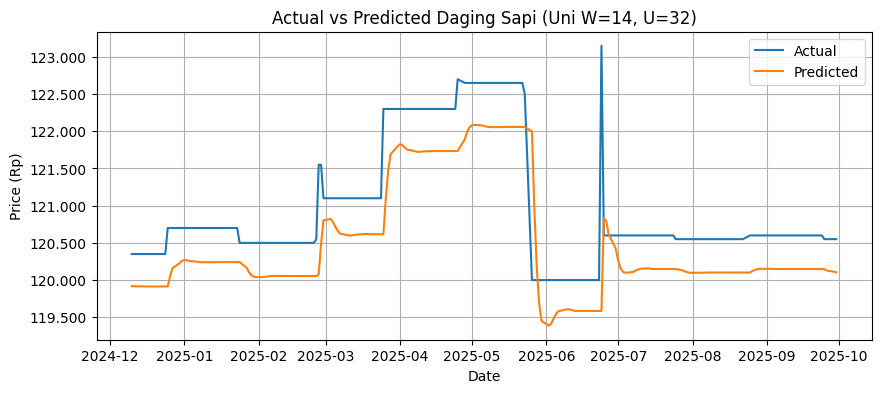

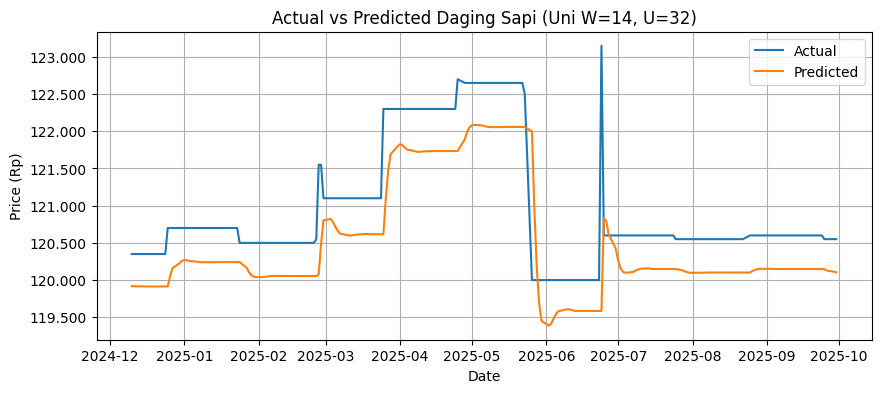


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,120550,120103.601562
1,2025-10-02,120550,119922.656250
2,2025-10-03,120550,119713.156250
3,2025-10-06,120550,119489.273438
4,2025-10-07,120550,119260.648438
5,2025-10-08,120550,119033.257812
6,2025-10-09,120550,118810.539062
7,2025-10-10,120550,118594.210938
8,2025-10-13,120550,118384.968750
9,2025-10-14,120550,118182.843750


Forecast MAPE Okt 2025 : 2.1034%
Compare CSV disimpan: compare_Okt2025_uni_W14_U32.csv


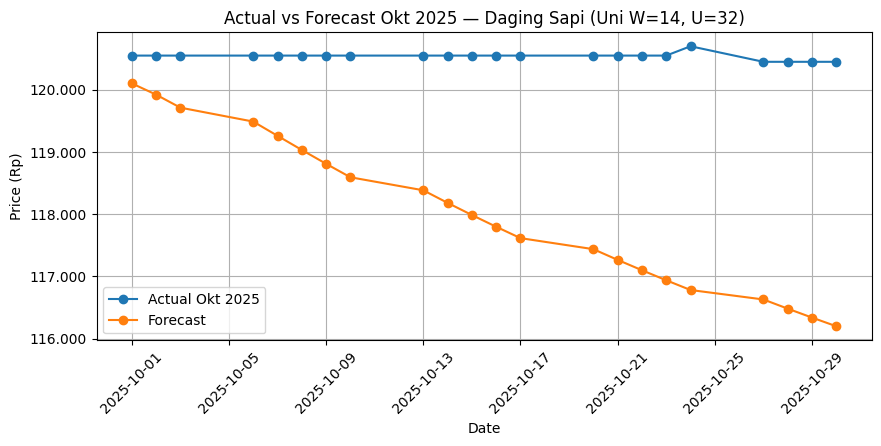

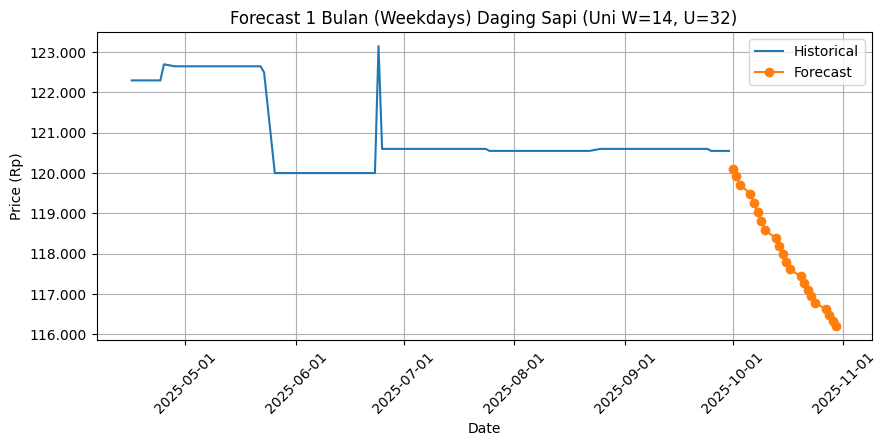

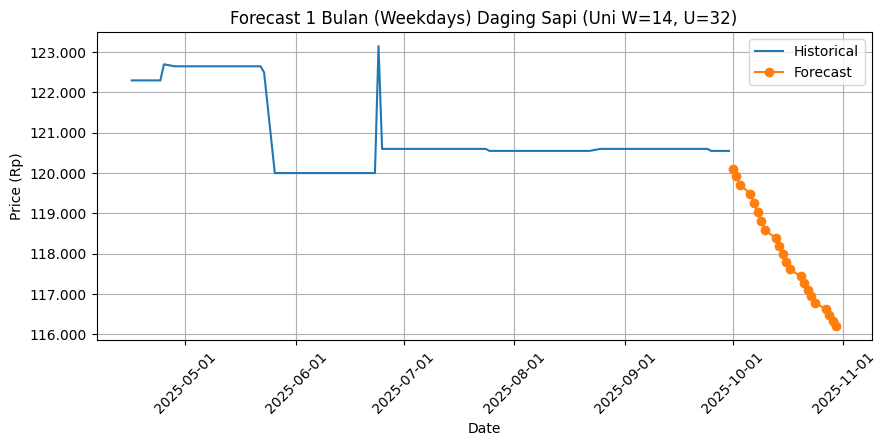


[UNIVARIATE] Target=Daging Sapi | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.0868 - val_loss: 0.0096
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0059 - val_loss: 3.5036e-04
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0046 - val_loss: 6.1772e-04
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0039 - val_loss: 4.0459e-04
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0034 - val_loss: 7.0637e-04
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0030 - val_loss: 3.3620e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0033 - val_loss: 4.7048e-04
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0030 - val_loss: 3.1488e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0029 - val_loss: 4.0887e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0027 - val_loss: 0.0010
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0027 - val_loss: 0.0011
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━

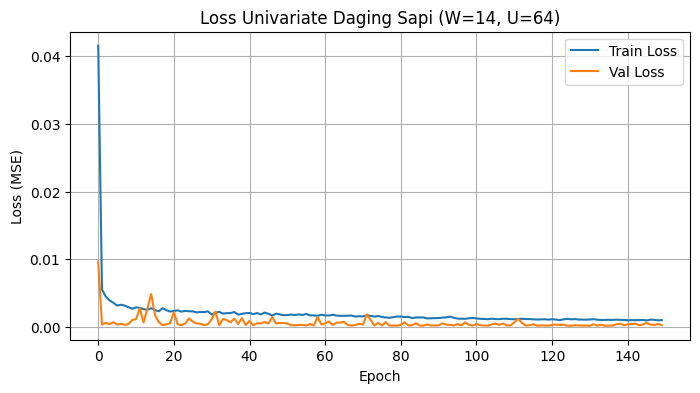

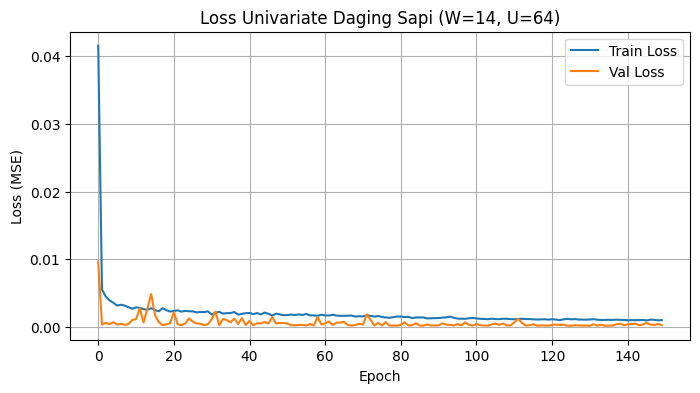

Test MAE  : 265.69
Test RMSE : 397.15
Test MAPE : 0.2192%


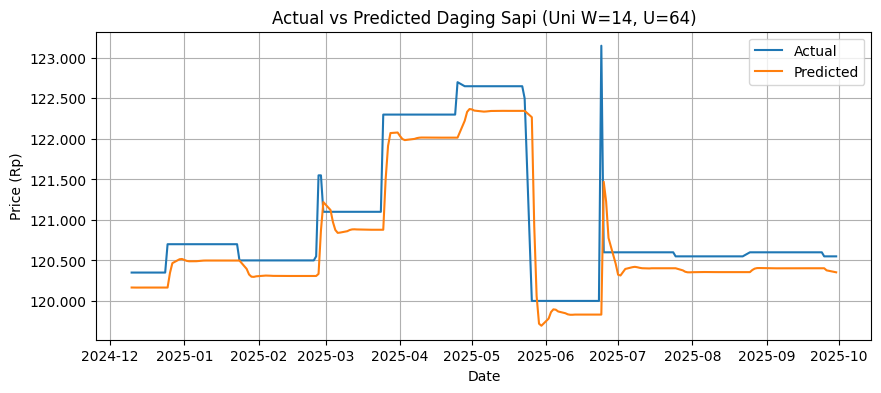

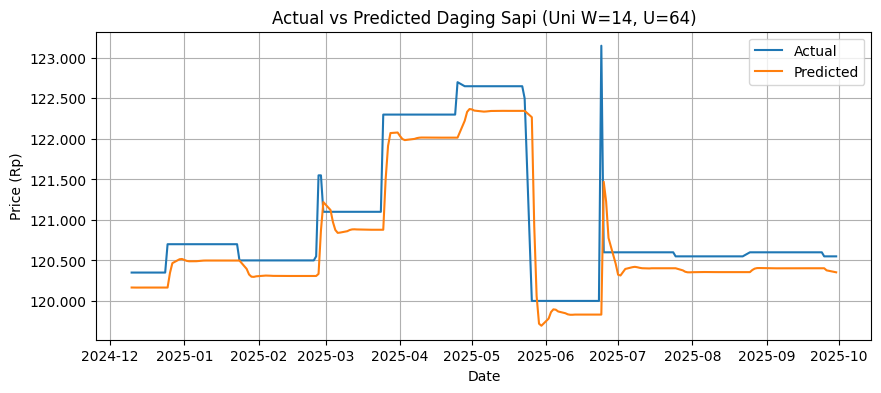


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,120550,120353.203125
1,2025-10-02,120550,120251.218750
2,2025-10-03,120550,120132.765625
3,2025-10-06,120550,120011.109375
4,2025-10-07,120550,119892.132812
5,2025-10-08,120550,119778.179688
6,2025-10-09,120550,119669.695312
7,2025-10-10,120550,119566.265625
8,2025-10-13,120550,119467.179688
9,2025-10-14,120550,119371.765625


Forecast MAPE Okt 2025 : 1.0334%
Compare CSV disimpan: compare_Okt2025_uni_W14_U64.csv


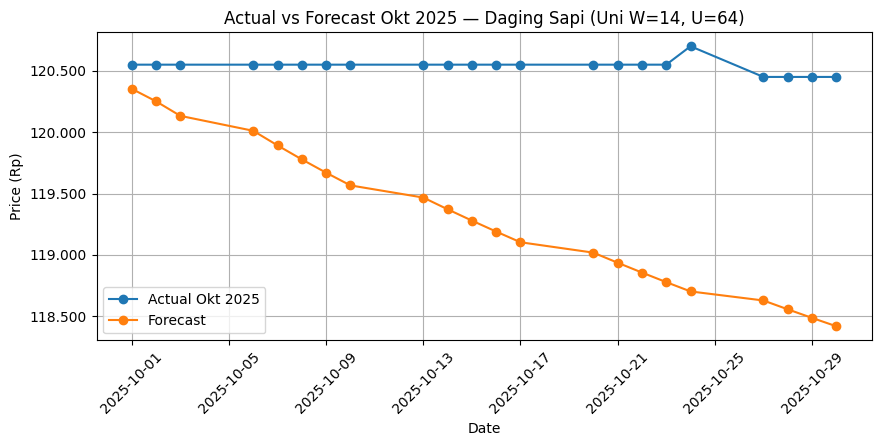

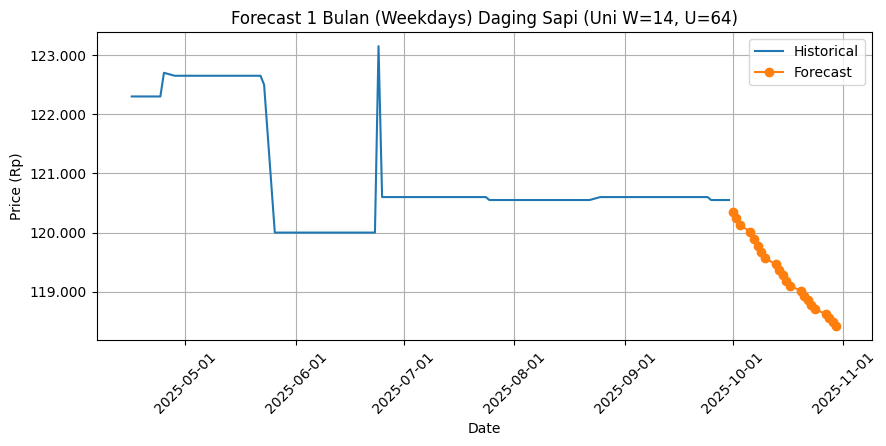

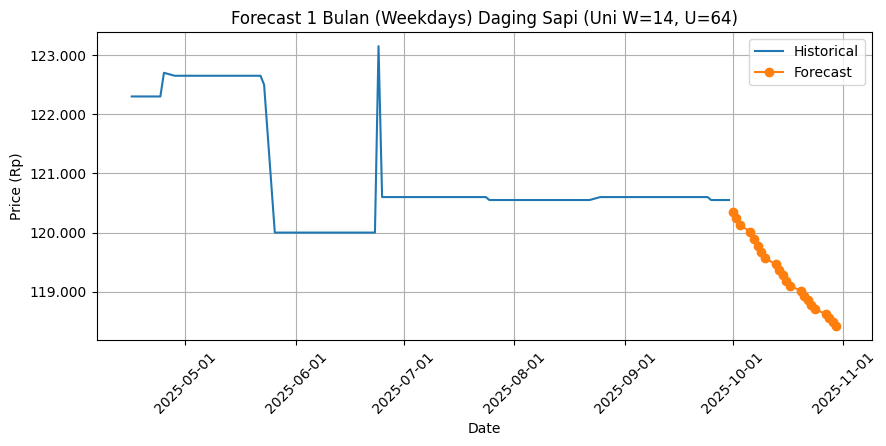


[UNIVARIATE] Target=Daging Sapi | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - loss: 0.1849 - val_loss: 0.0031
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0142 - val_loss: 0.0025
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0086 - val_loss: 5.8870e-04
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0078 - val_loss: 4.2300e-04
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0071 - val_loss: 7.2226e-04
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0055 - val_loss: 0.0020
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0064 - val_loss: 0.0036
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0057 - val_loss: 4.2527e-04
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0051 - val_loss: 3.7766e-04
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0056 - val_loss: 7.5254e-04
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0049 - val_loss: 6.7661e-04
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━

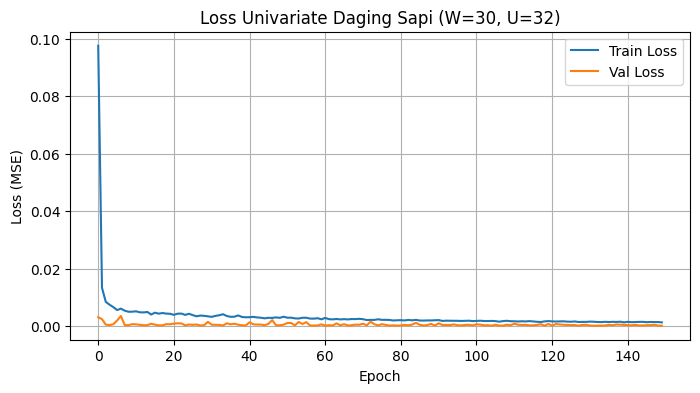

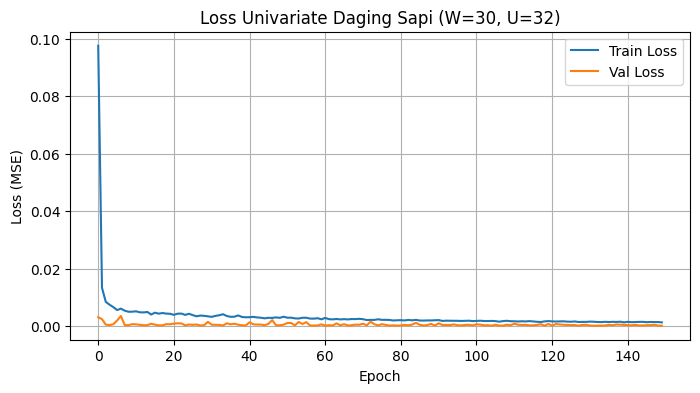

Test MAE  : 127.27
Test RMSE : 356.81
Test MAPE : 0.1048%


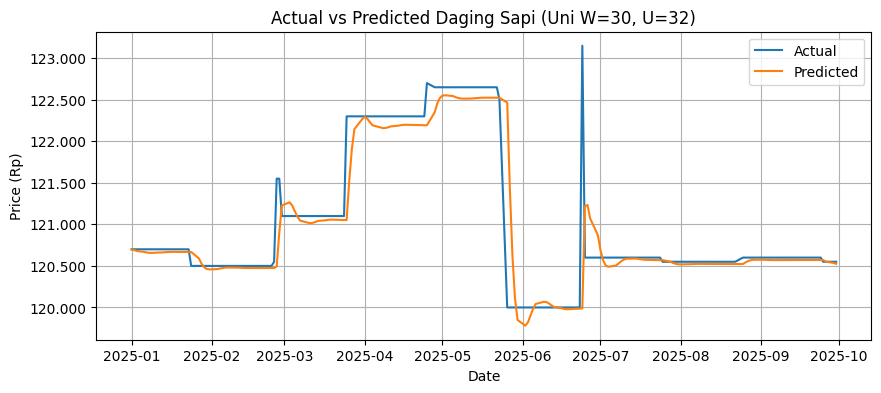

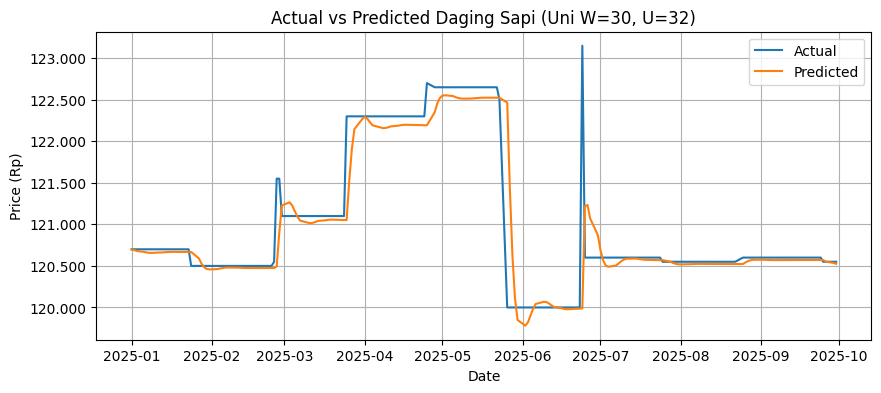


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,120550,120525.335938
1,2025-10-02,120550,120510.609375
2,2025-10-03,120550,120495.664062
3,2025-10-06,120550,120480.898438
4,2025-10-07,120550,120466.468750
5,2025-10-08,120550,120452.476562
6,2025-10-09,120550,120438.945312
7,2025-10-10,120550,120425.851562
8,2025-10-13,120550,120413.171875
9,2025-10-14,120550,120400.859375


Forecast MAPE Okt 2025 : 0.1242%
Compare CSV disimpan: compare_Okt2025_uni_W30_U32.csv


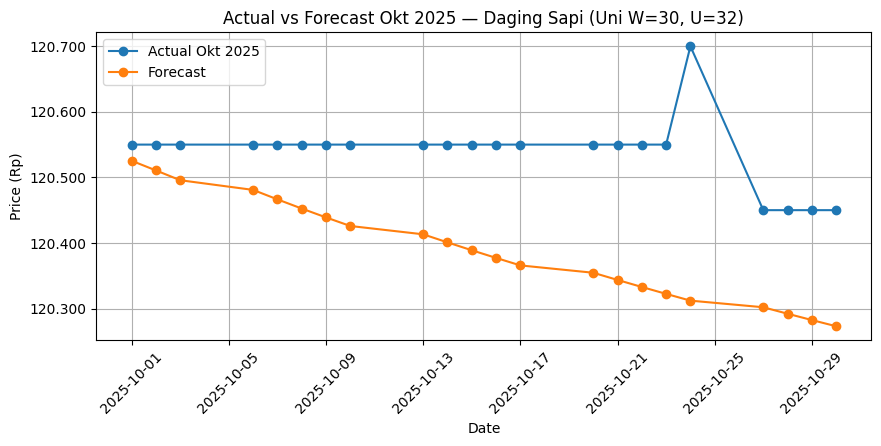

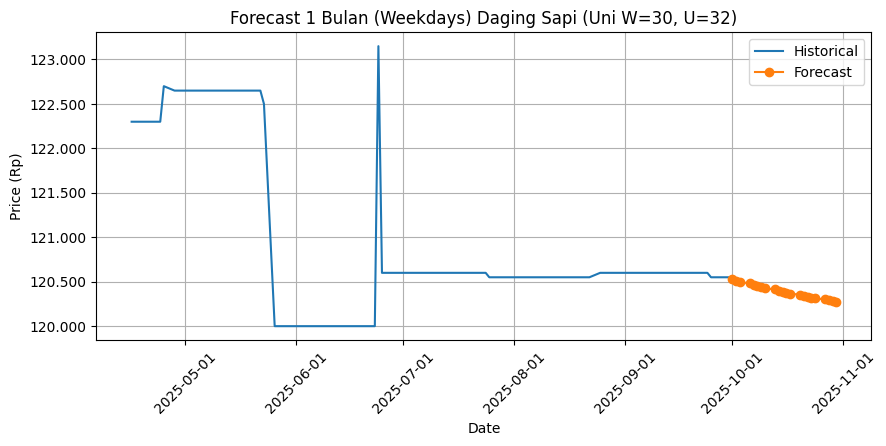

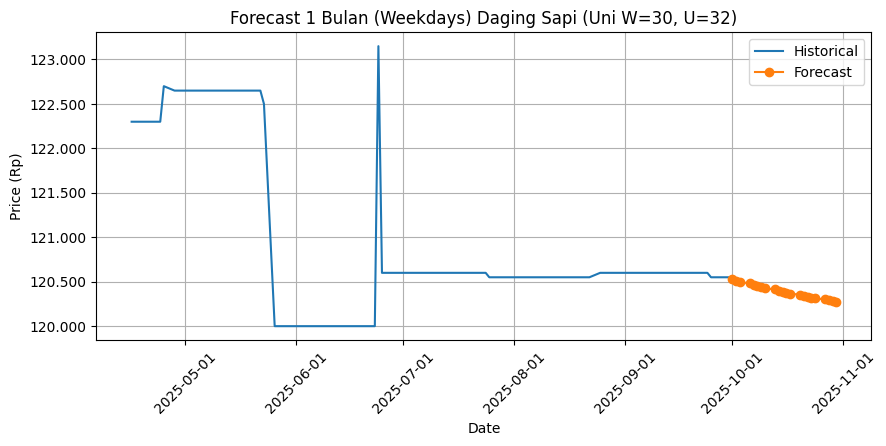


[UNIVARIATE] Target=Daging Sapi | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - loss: 0.1015 - val_loss: 0.0050
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0072 - val_loss: 5.3398e-04
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0049 - val_loss: 0.0011
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0045 - val_loss: 0.0013
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0040 - val_loss: 3.6849e-04
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - loss: 0.0037 - val_loss: 0.0013
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 0.0033 - val_loss: 3.6804e-04
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - loss: 0.0032 - val_loss: 3.5582e-04
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 0.0032 - val_loss: 3.3378e-04
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0031 - val_loss: 3.3348e-04
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0030 - val_loss: 3.5303e-04
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━

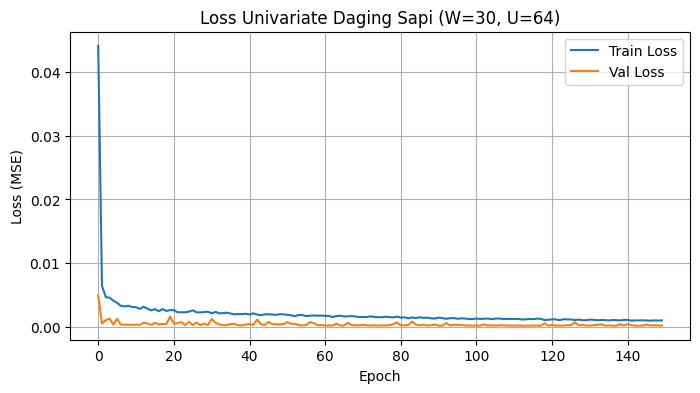

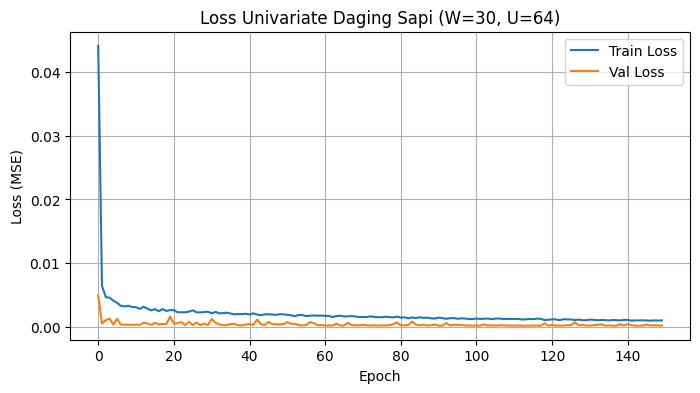

Test MAE  : 129.10
Test RMSE : 350.20
Test MAPE : 0.1063%


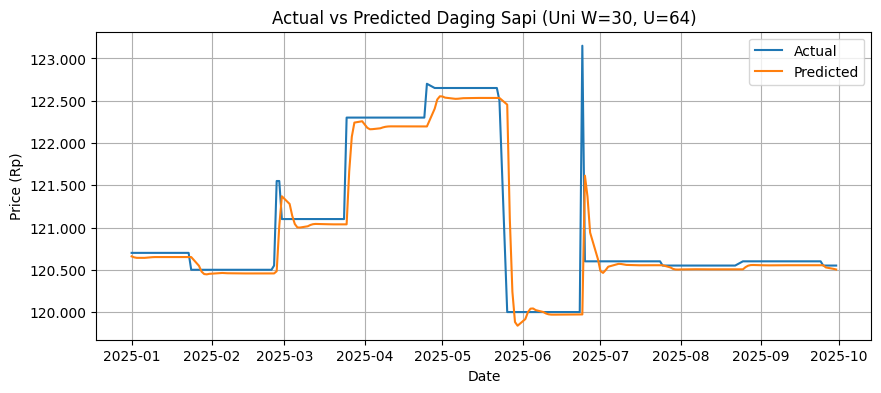

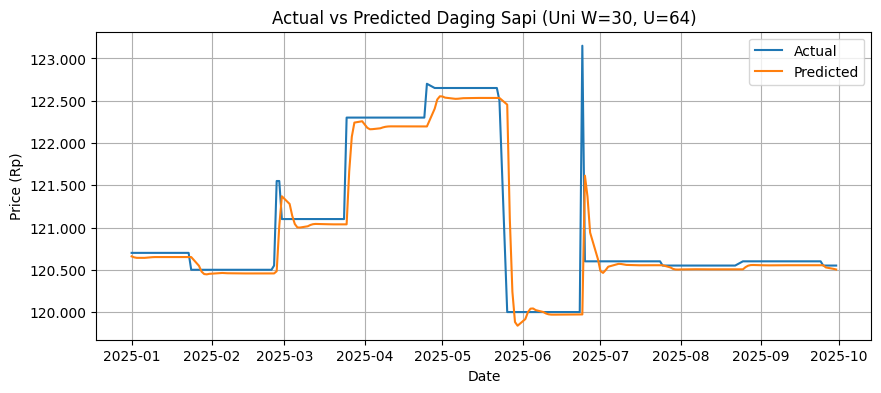


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,120550,120503.492188
1,2025-10-02,120550,120478.523438
2,2025-10-03,120550,120451.265625
3,2025-10-06,120550,120423.531250
4,2025-10-07,120550,120396.203125
5,2025-10-08,120550,120369.664062
6,2025-10-09,120550,120344.015625
7,2025-10-10,120550,120319.179688
8,2025-10-13,120550,120295.093750
9,2025-10-14,120550,120271.625000


Forecast MAPE Okt 2025 : 0.2414%
Compare CSV disimpan: compare_Okt2025_uni_W30_U64.csv


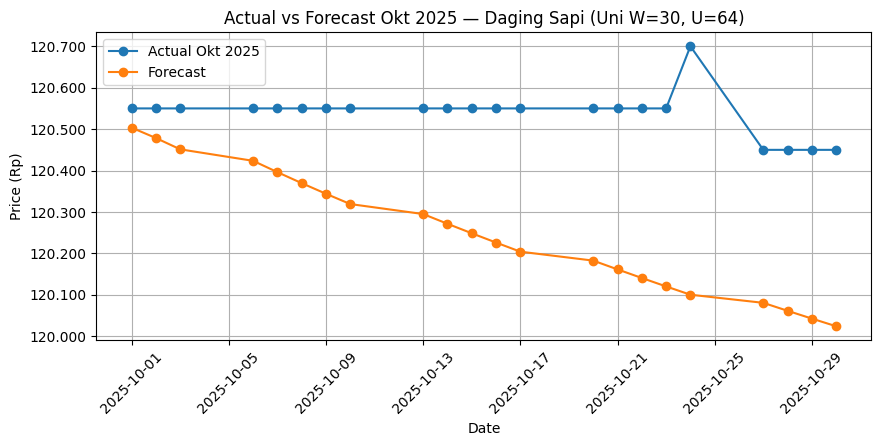

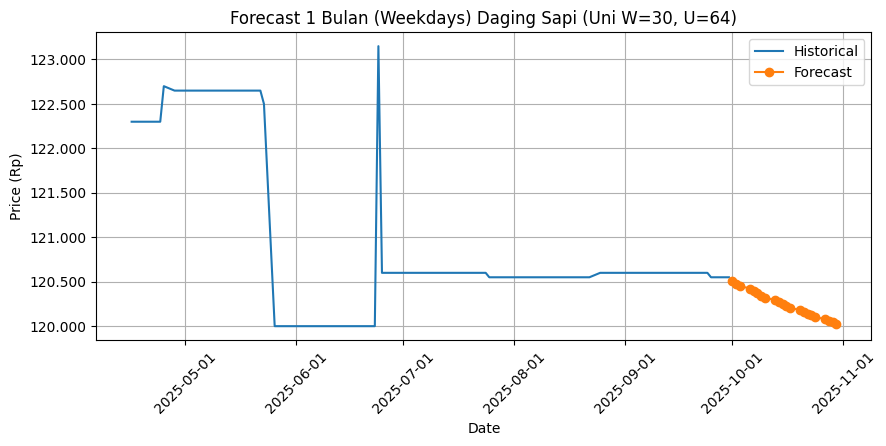

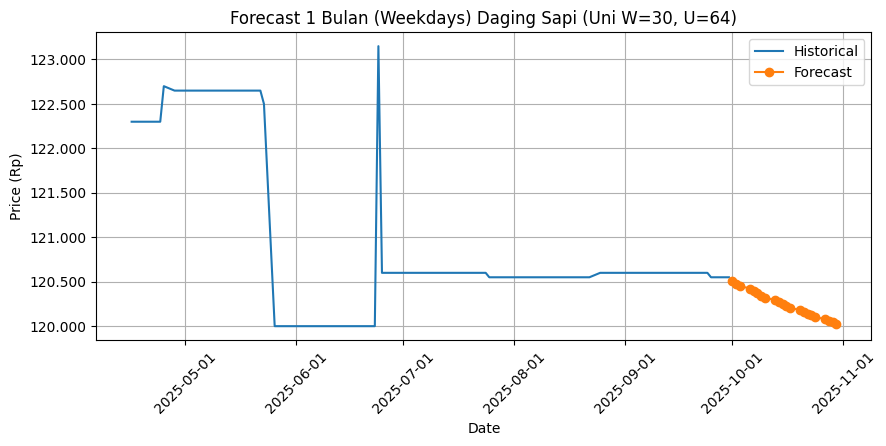


Rekap univariate Daging Sapi disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate\Daging_Sapi\hasil_univariate_Daging_Sapi.csv

==================== UNIVARIATE: Telur Ayam ====================

[UNIVARIATE] Target=Telur Ayam | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 0.1379 - val_loss: 0.0027
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0182 - val_loss: 0.0038
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0133 - val_loss: 0.0023
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0120 - val_loss: 0.0012
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0122 - val_loss: 0.0013
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0112 - val_loss: 0.0018
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0097 - val_loss: 0.0012
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0093 - val_loss: 0.0011
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0105 - val_loss: 0.0011
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0086 - val_loss: 8.6289e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0093 - val_loss: 9.2212e-04
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0086

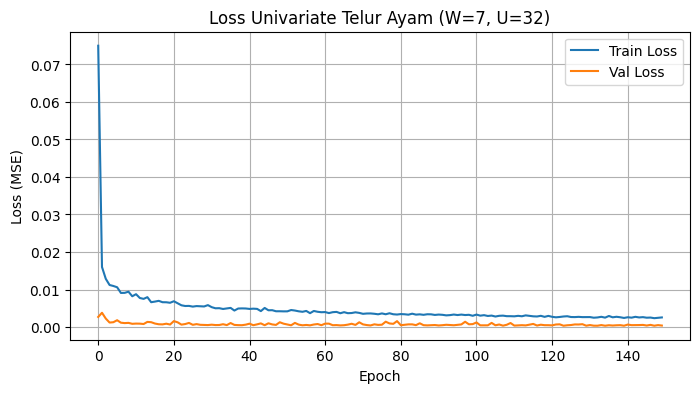

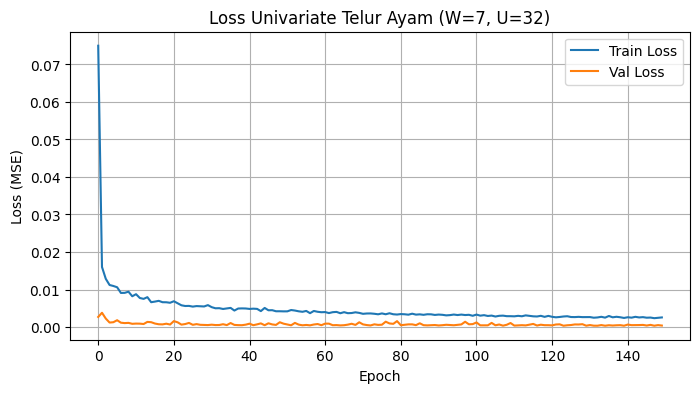

Test MAE  : 160.34
Test RMSE : 344.08
Test MAPE : 0.6665%


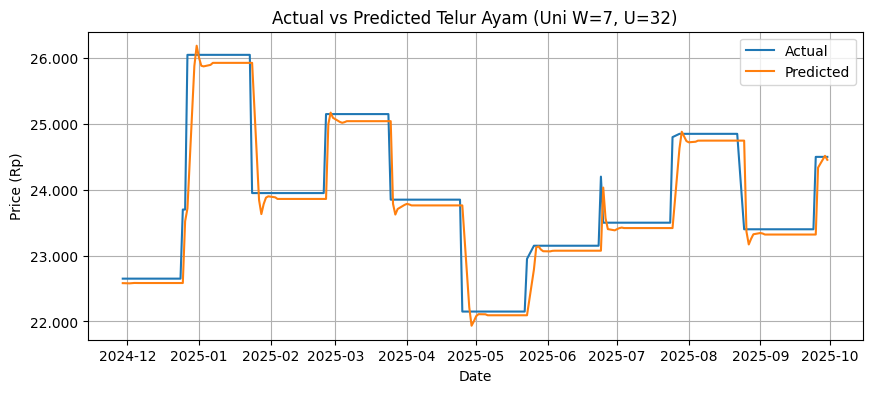

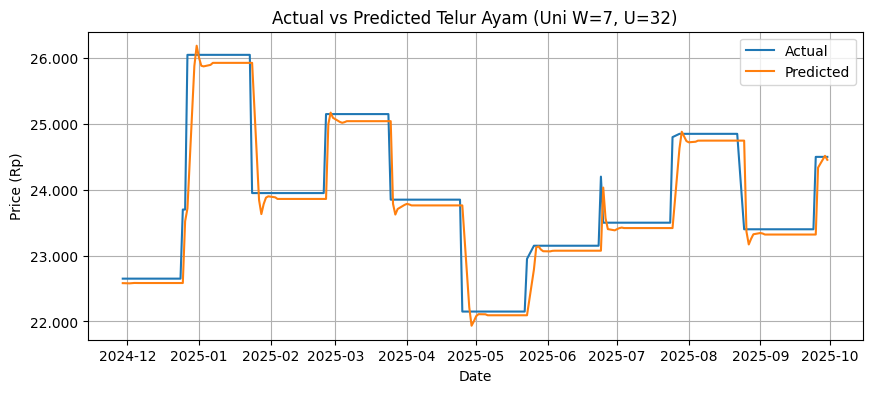


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,24500,24455.328125
1,2025-10-02,24500,24355.253906
2,2025-10-03,24500,24238.443359
3,2025-10-06,24500,24123.300781
4,2025-10-07,24500,24019.421875
5,2025-10-08,24500,23917.779297
6,2025-10-09,24500,23820.833984
7,2025-10-10,24500,23727.130859
8,2025-10-13,24500,23635.683594
9,2025-10-14,24500,23546.138672


Forecast MAPE Okt 2025 : 5.2466%
Compare CSV disimpan: compare_Okt2025_uni_W7_U32.csv


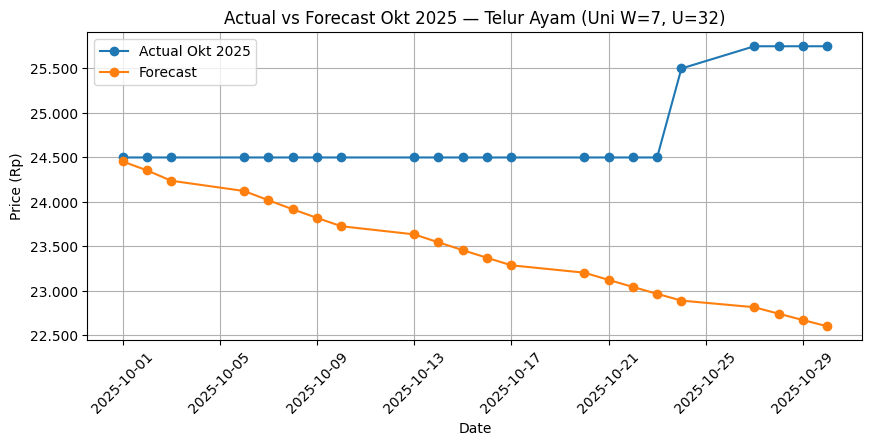

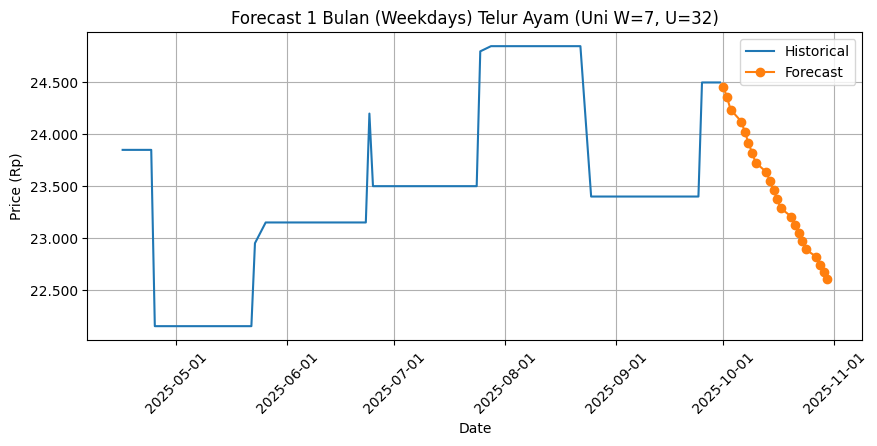

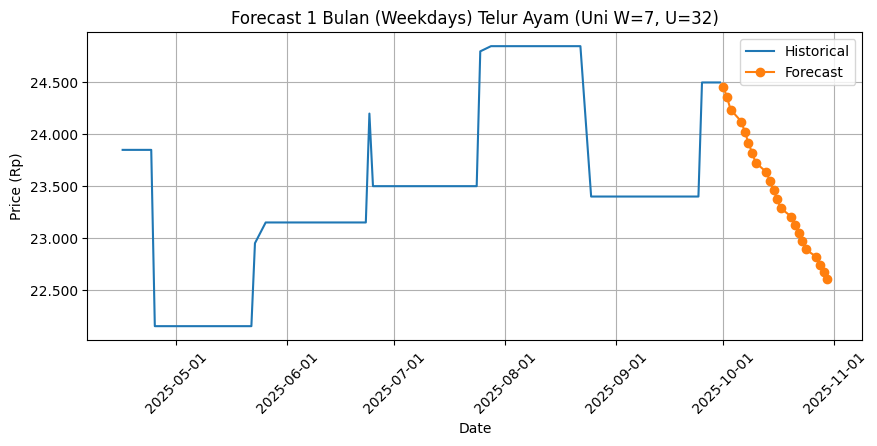


[UNIVARIATE] Target=Telur Ayam | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.1915 - val_loss: 0.0025
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0131 - val_loss: 0.0020
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0104 - val_loss: 0.0015
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0091 - val_loss: 0.0013
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0088 - val_loss: 0.0020
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0091 - val_loss: 0.0011
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0086 - val_loss: 0.0013
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0074 - val_loss: 0.0010
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0076 - val_loss: 0.0011
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0075 - val_loss: 9.8592e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0071 - val_loss: 0.0010
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0072 - v

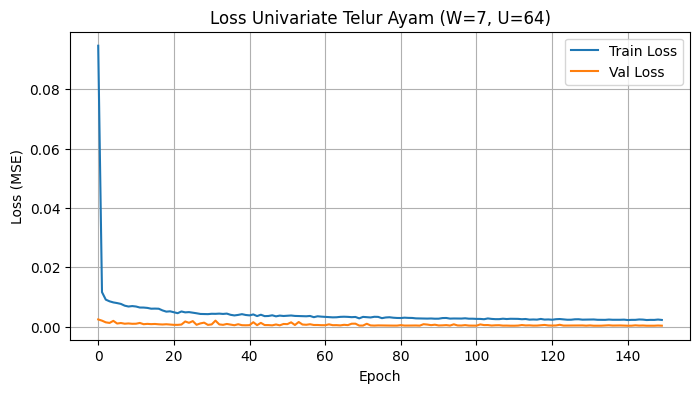

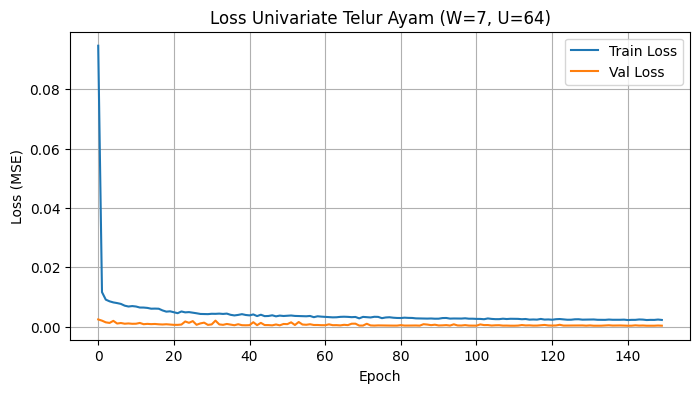

Test MAE  : 112.66
Test RMSE : 334.57
Test MAPE : 0.4659%


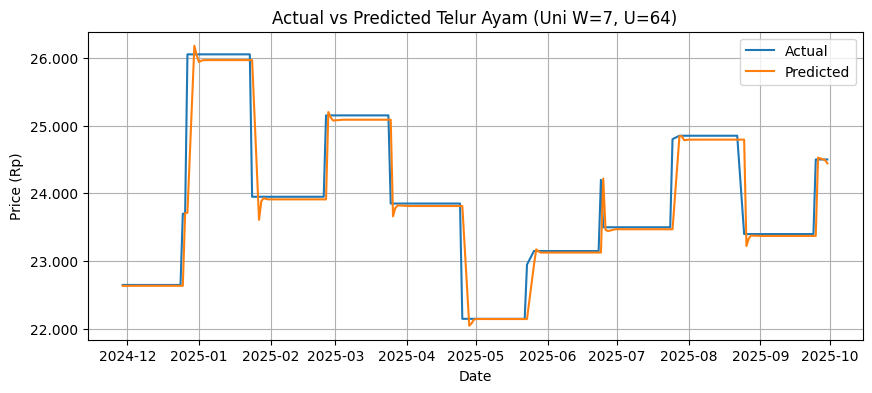

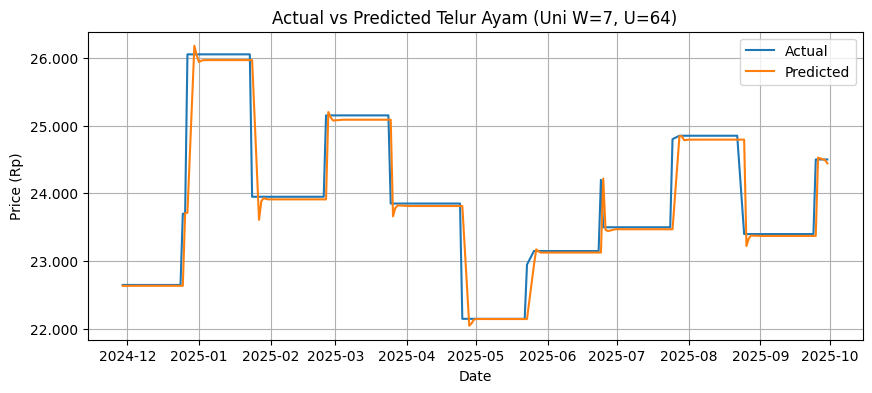


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,24500,24444.539062
1,2025-10-02,24500,24386.349609
2,2025-10-03,24500,24330.947266
3,2025-10-06,24500,24278.261719
4,2025-10-07,24500,24226.902344
5,2025-10-08,24500,24176.873047
6,2025-10-09,24500,24128.046875
7,2025-10-10,24500,24080.410156
8,2025-10-13,24500,24033.935547
9,2025-10-14,24500,23988.585938


Forecast MAPE Okt 2025 : 3.2903%
Compare CSV disimpan: compare_Okt2025_uni_W7_U64.csv


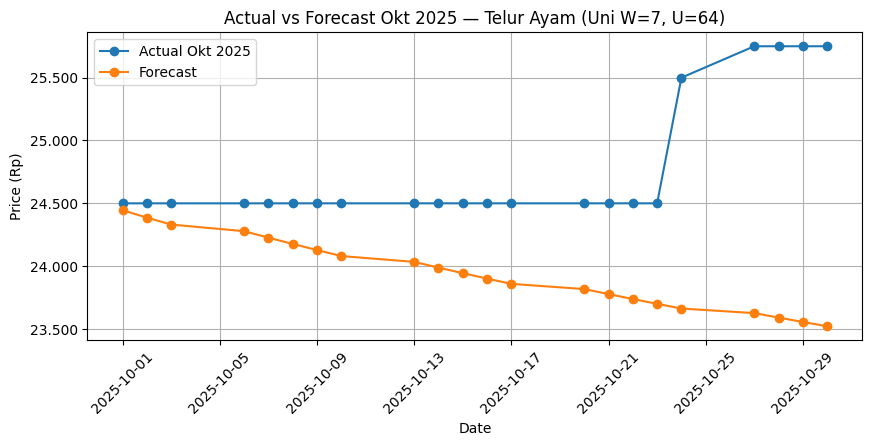

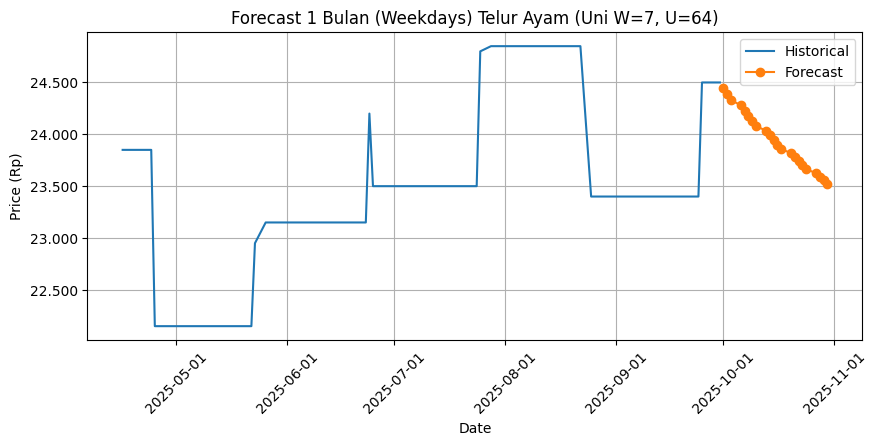

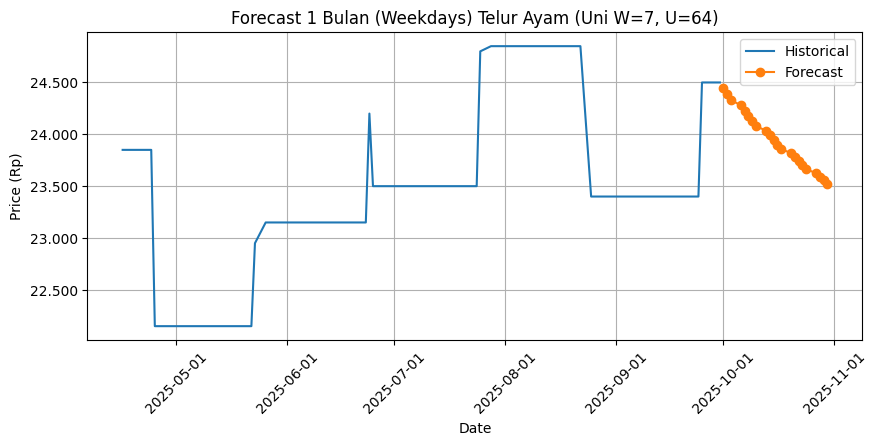


[UNIVARIATE] Target=Telur Ayam | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.1032 - val_loss: 0.0049
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0150 - val_loss: 0.0017
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0115 - val_loss: 0.0015
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0115 - val_loss: 0.0012
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0101 - val_loss: 0.0015
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0098 - val_loss: 0.0015
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0089 - val_loss: 9.7797e-04
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0084 - val_loss: 9.0728e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0074 - val_loss: 9.9608e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0069 - val_loss: 0.0011
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0067 - val_loss: 0.0011
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 

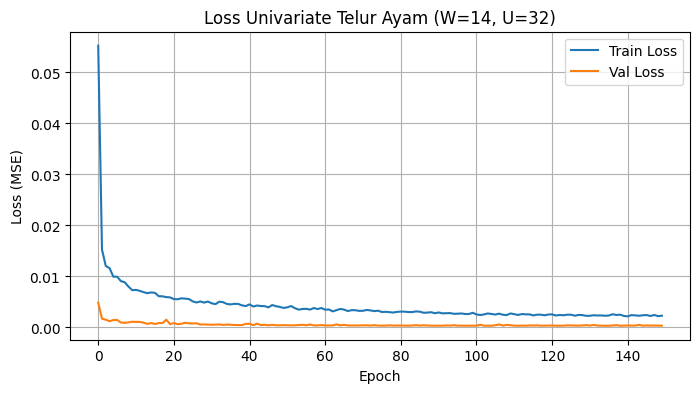

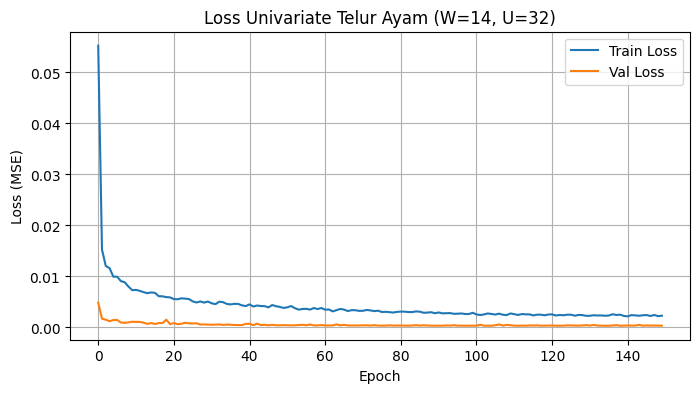

Test MAE  : 110.44
Test RMSE : 337.60
Test MAPE : 0.4571%


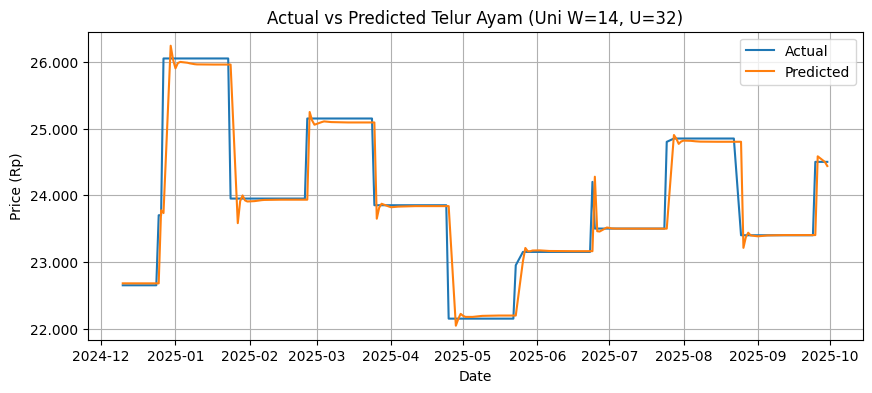

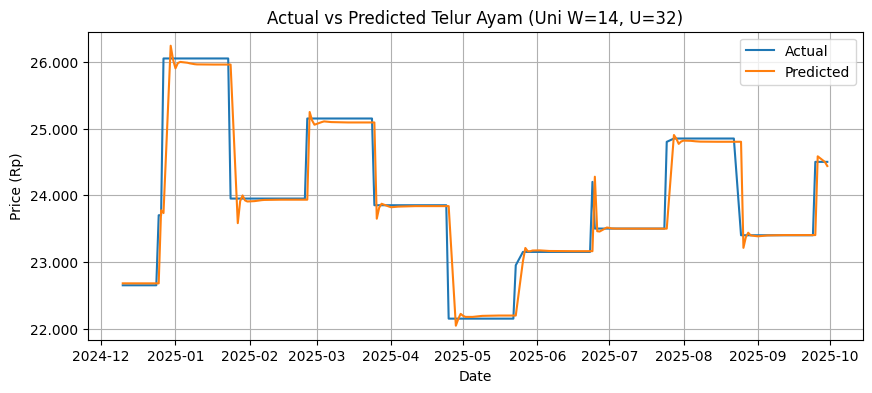


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,24500,24437.775391
1,2025-10-02,24500,24398.812500
2,2025-10-03,24500,24373.666016
3,2025-10-06,24500,24351.099609
4,2025-10-07,24500,24325.978516
5,2025-10-08,24500,24297.615234
6,2025-10-09,24500,24267.074219
7,2025-10-10,24500,24235.628906
8,2025-10-13,24500,24204.240234
9,2025-10-14,24500,24173.466797


Forecast MAPE Okt 2025 : 2.4971%
Compare CSV disimpan: compare_Okt2025_uni_W14_U32.csv


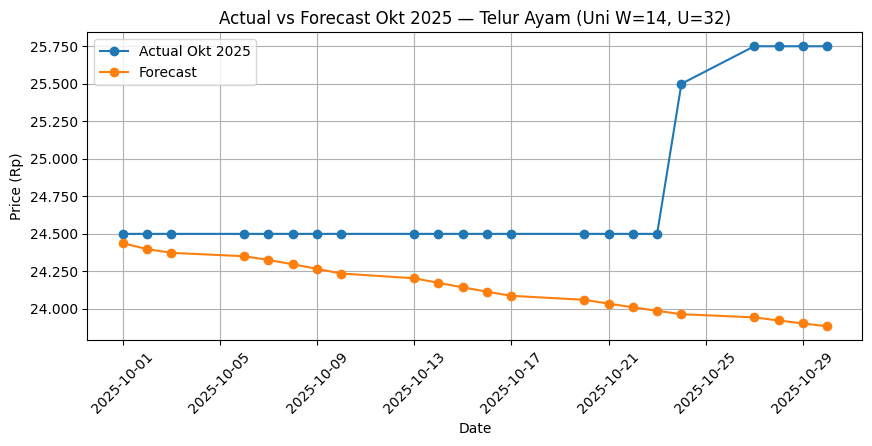

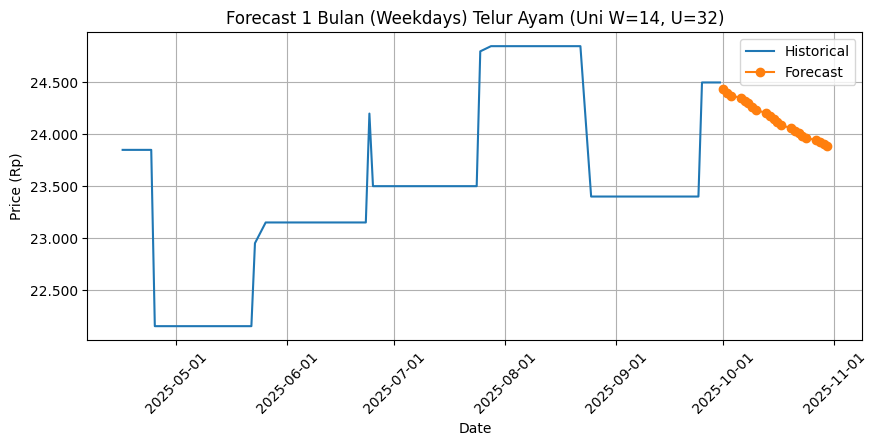

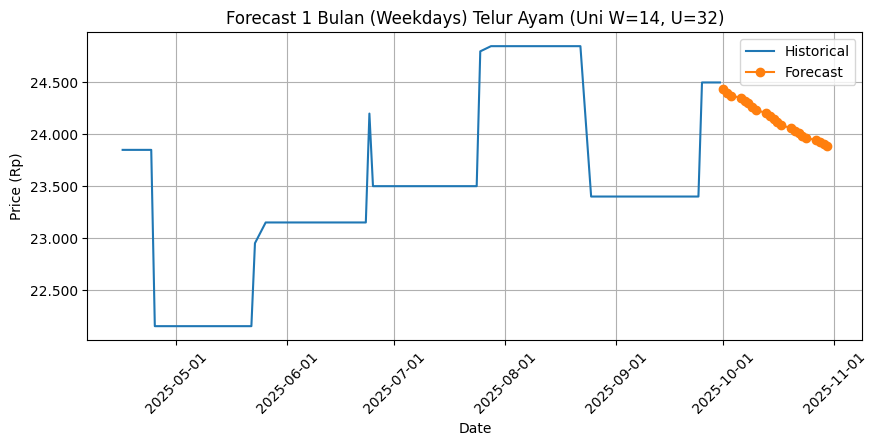


[UNIVARIATE] Target=Telur Ayam | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - loss: 0.1275 - val_loss: 0.0108
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0120 - val_loss: 0.0016
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0107 - val_loss: 0.0017
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0097 - val_loss: 0.0015
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0092 - val_loss: 0.0013
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0083 - val_loss: 0.0018
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0076 - val_loss: 0.0014
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0071 - val_loss: 0.0018
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0063 - val_loss: 9.9338e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0065 - val_loss: 0.0021
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0062 - val_loss: 0.0016
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 

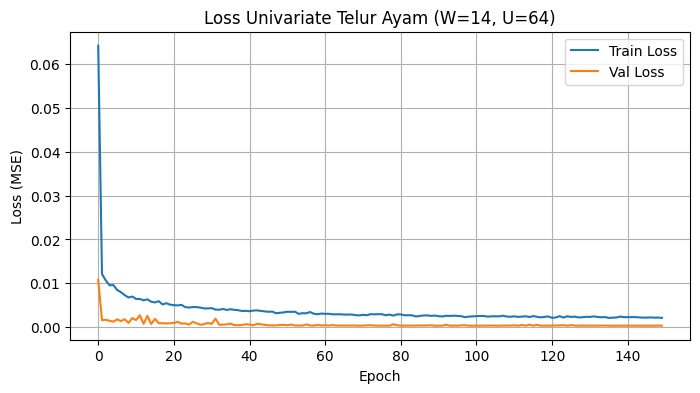

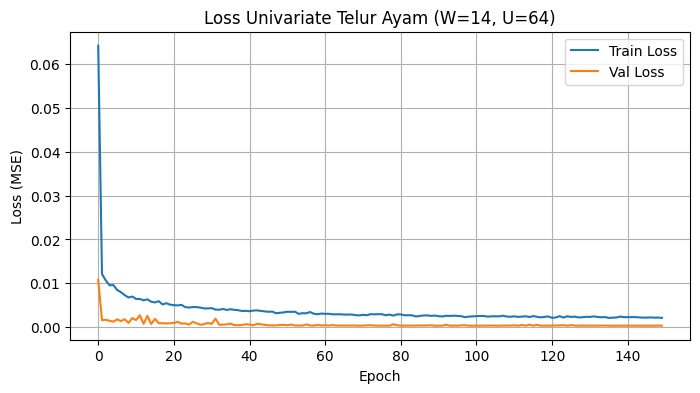

Test MAE  : 108.25
Test RMSE : 339.44
Test MAPE : 0.4478%


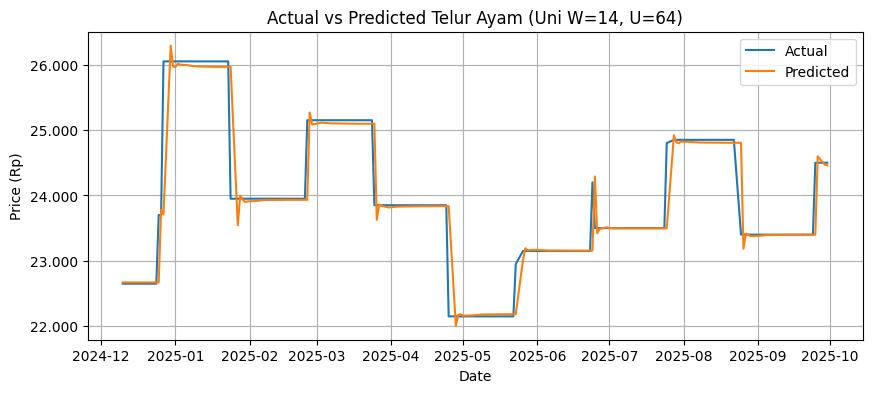

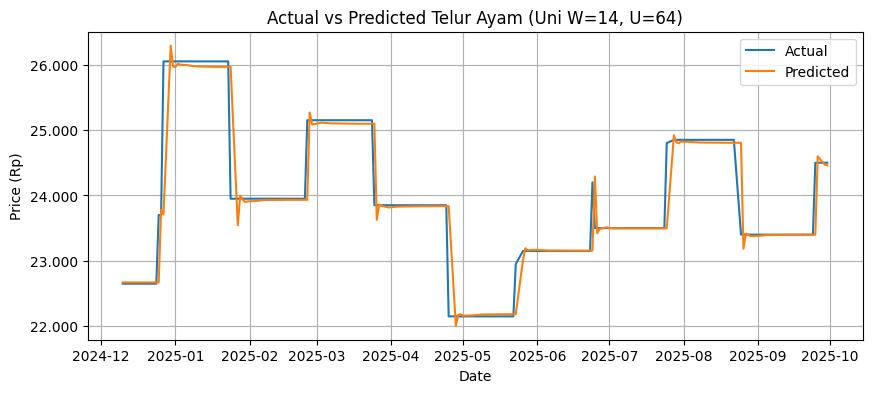


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,24500,24461.207031
1,2025-10-02,24500,24438.589844
2,2025-10-03,24500,24416.898438
3,2025-10-06,24500,24393.054688
4,2025-10-07,24500,24366.601562
5,2025-10-08,24500,24338.130859
6,2025-10-09,24500,24308.324219
7,2025-10-10,24500,24277.777344
8,2025-10-13,24500,24246.960938
9,2025-10-14,24500,24216.234375


Forecast MAPE Okt 2025 : 2.3481%
Compare CSV disimpan: compare_Okt2025_uni_W14_U64.csv


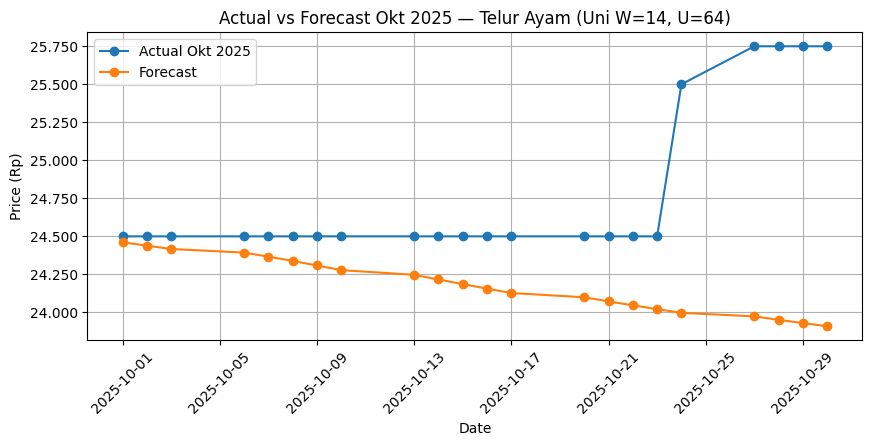

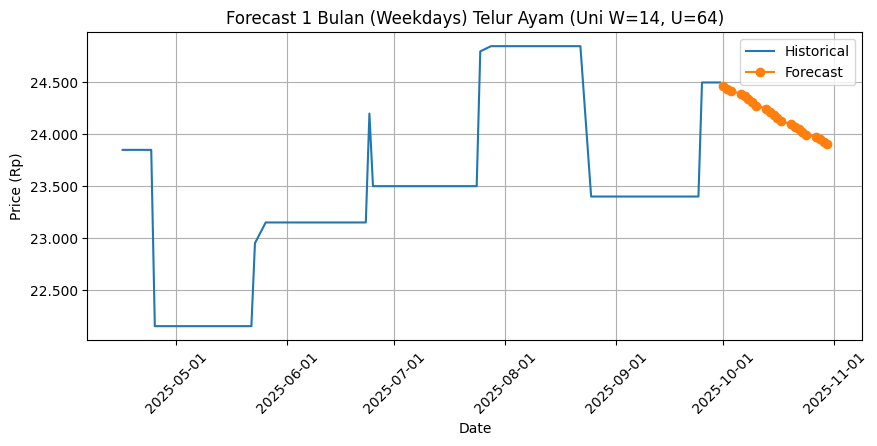

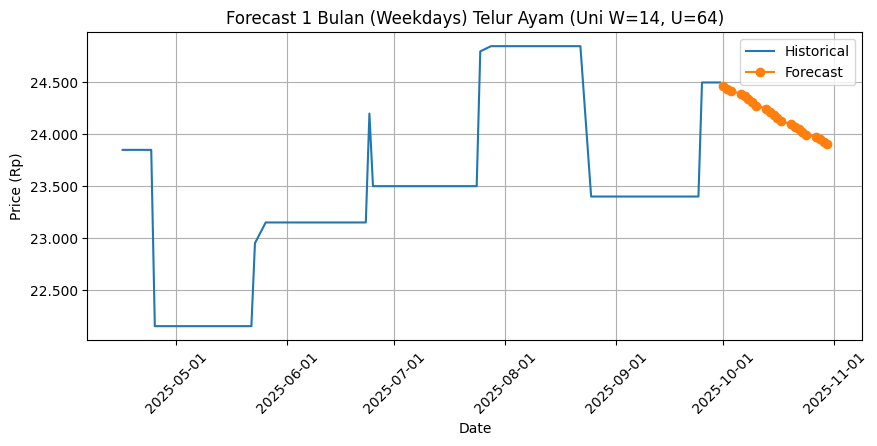


[UNIVARIATE] Target=Telur Ayam | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 21ms/step - loss: 0.1129 - val_loss: 0.0086
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0180 - val_loss: 0.0023
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0120 - val_loss: 0.0015
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0126 - val_loss: 0.0016
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0103 - val_loss: 0.0013
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0108 - val_loss: 0.0013
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0097 - val_loss: 0.0015
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0091 - val_loss: 0.0011
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0085 - val_loss: 0.0025
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0086 - val_loss: 0.0021
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0081 - val_loss: 0.0012
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.00

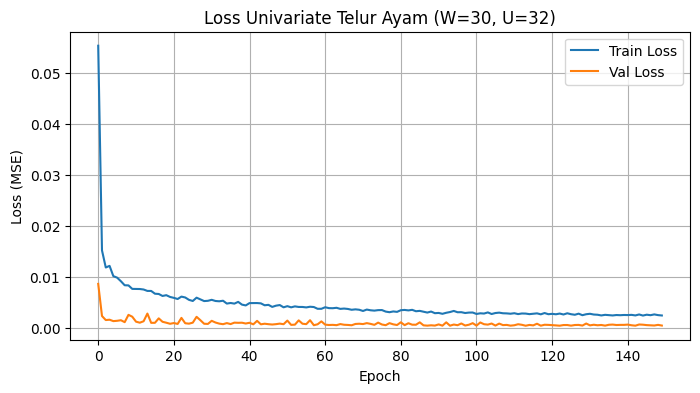

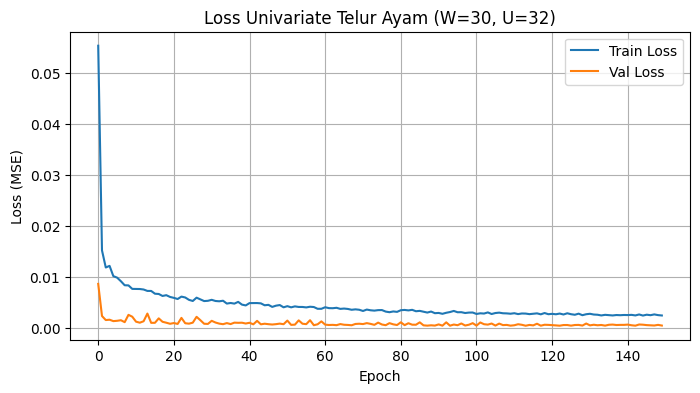

Test MAE  : 127.61
Test RMSE : 304.02
Test MAPE : 0.5323%


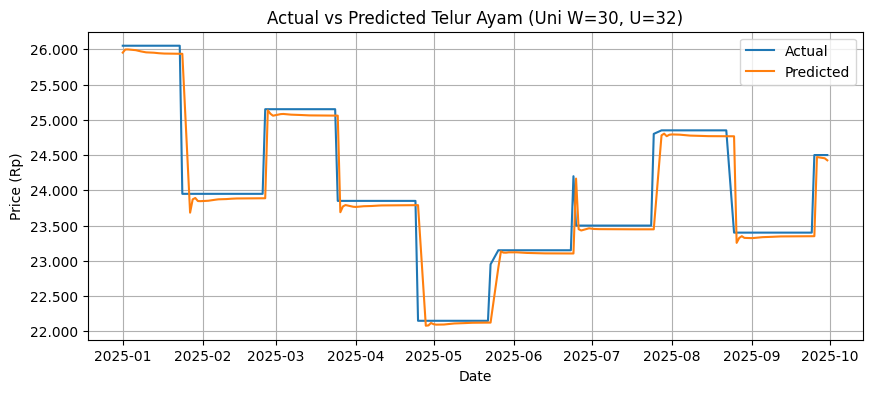

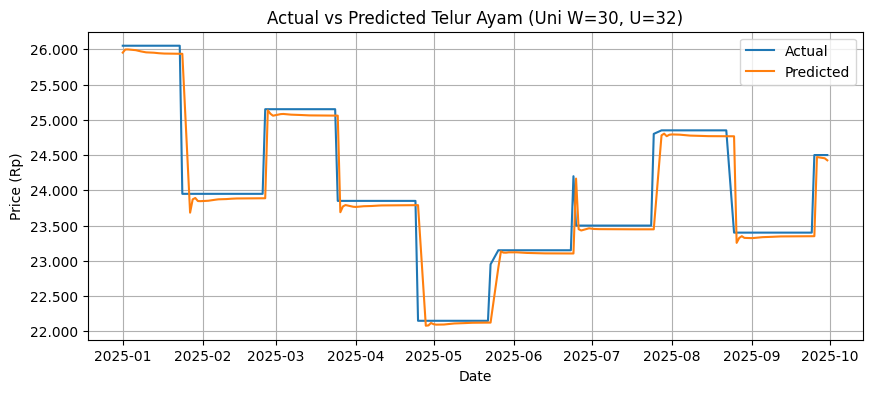


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,24500,24425.300781
1,2025-10-02,24500,24364.328125
2,2025-10-03,24500,24307.535156
3,2025-10-06,24500,24250.244141
4,2025-10-07,24500,24190.250000
5,2025-10-08,24500,24127.476562
6,2025-10-09,24500,24062.460938
7,2025-10-10,24500,23995.826172
8,2025-10-13,24500,23928.136719
9,2025-10-14,24500,23859.884766


Forecast MAPE Okt 2025 : 4.0251%
Compare CSV disimpan: compare_Okt2025_uni_W30_U32.csv


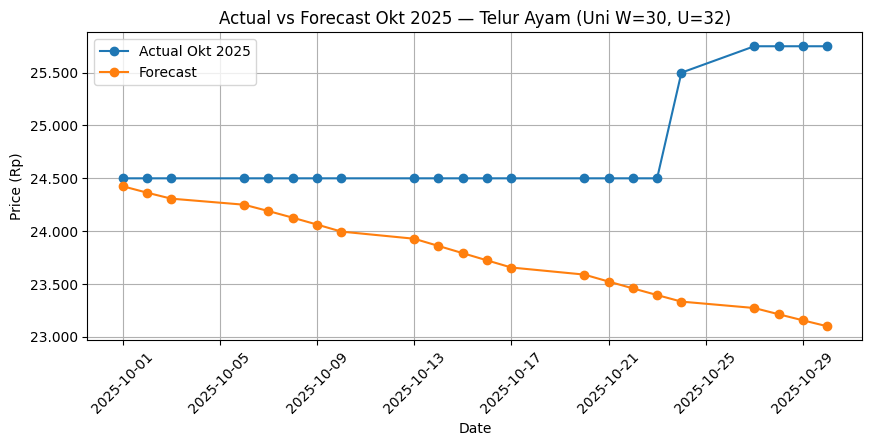

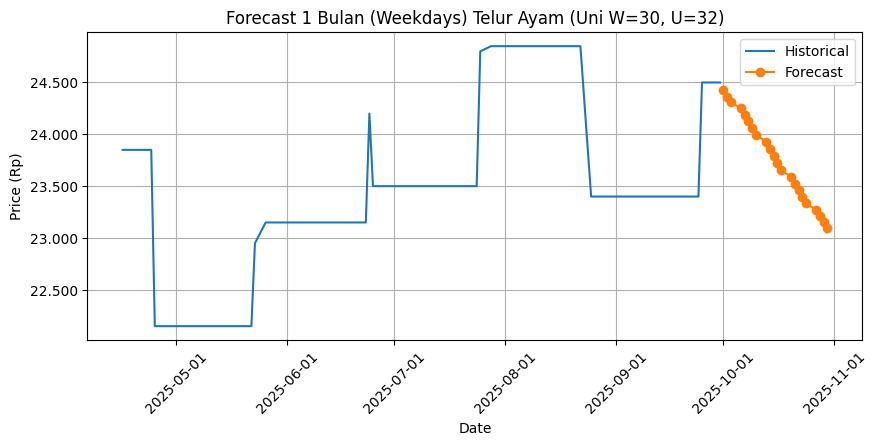

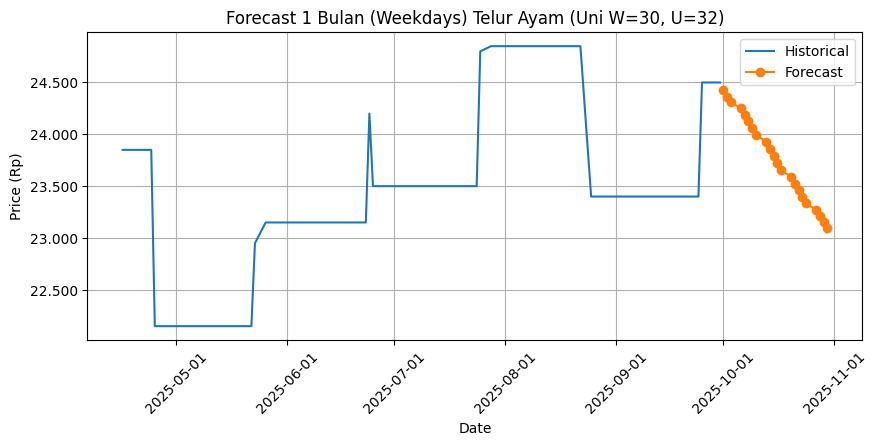


[UNIVARIATE] Target=Telur Ayam | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - loss: 0.1059 - val_loss: 0.0025
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0125 - val_loss: 0.0015
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0105 - val_loss: 0.0017
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0101 - val_loss: 0.0013
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0088 - val_loss: 0.0017
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0092 - val_loss: 0.0016
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0076 - val_loss: 0.0015
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0078 - val_loss: 0.0016
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0073 - val_loss: 0.0021
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0070 - val_loss: 0.0014
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0063 - val_loss: 9.4522e-04
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss:

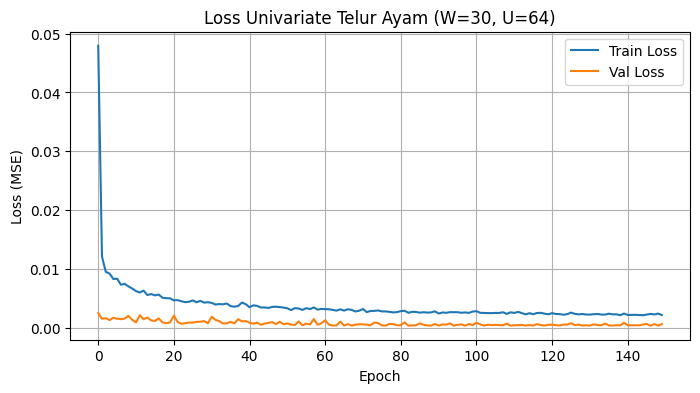

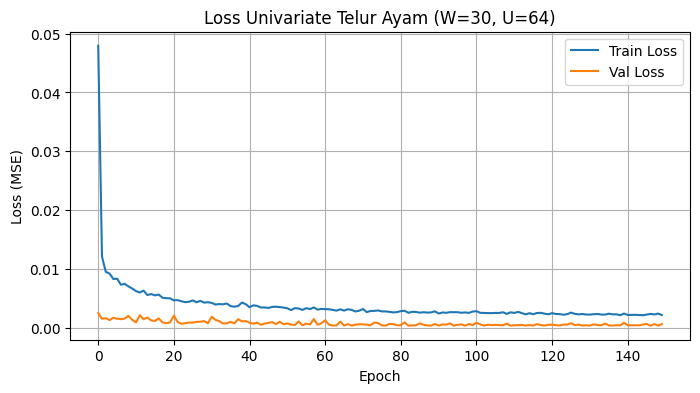

Test MAE  : 232.62
Test RMSE : 342.52
Test MAPE : 0.9665%


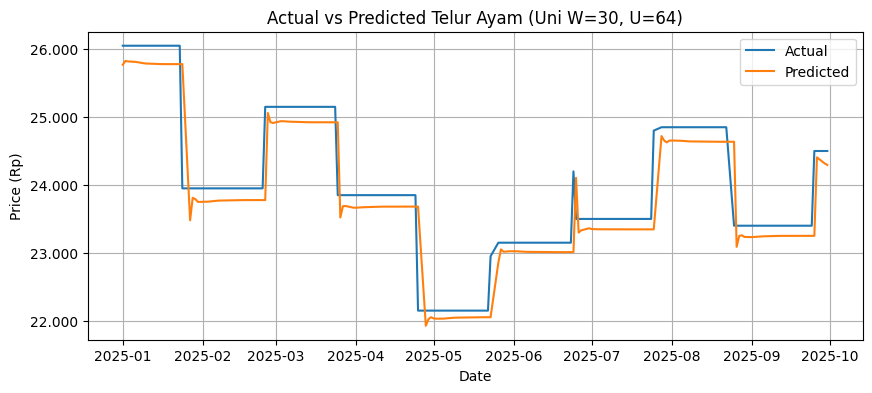

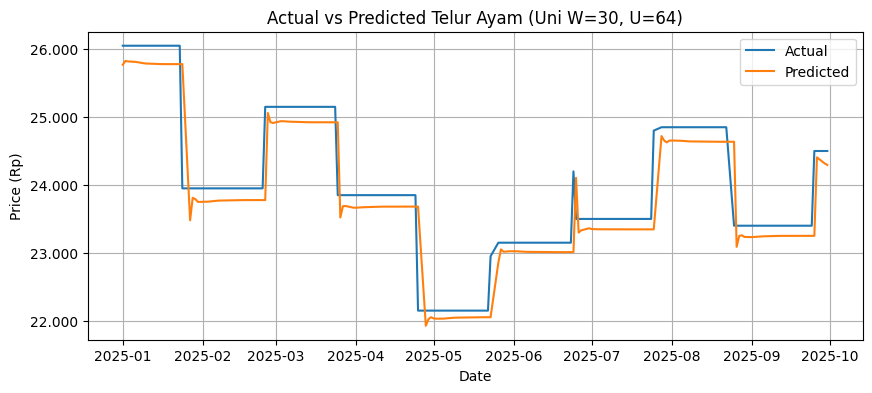


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,24500,24294.917969
1,2025-10-02,24500,24096.291016
2,2025-10-03,24500,23909.138672
3,2025-10-06,24500,23731.642578
4,2025-10-07,24500,23558.710938
5,2025-10-08,24500,23389.189453
6,2025-10-09,24500,23223.414062
7,2025-10-10,24500,23062.089844
8,2025-10-13,24500,22905.875000
9,2025-10-14,24500,22755.271484


Forecast MAPE Okt 2025 : 8.4679%
Compare CSV disimpan: compare_Okt2025_uni_W30_U64.csv


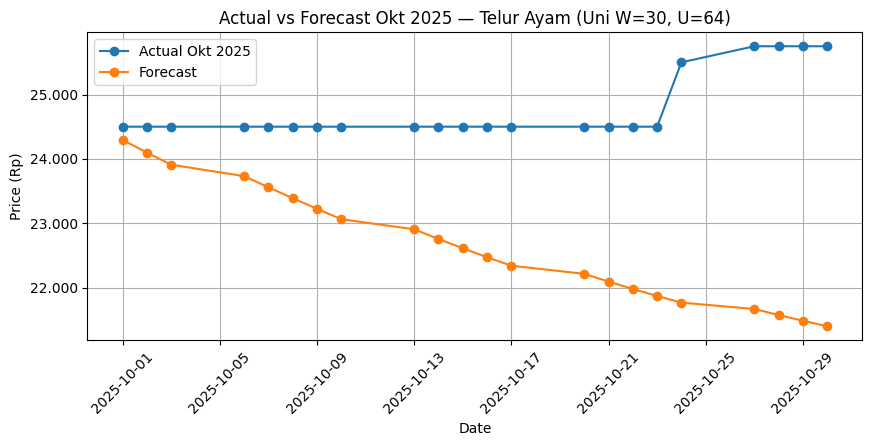

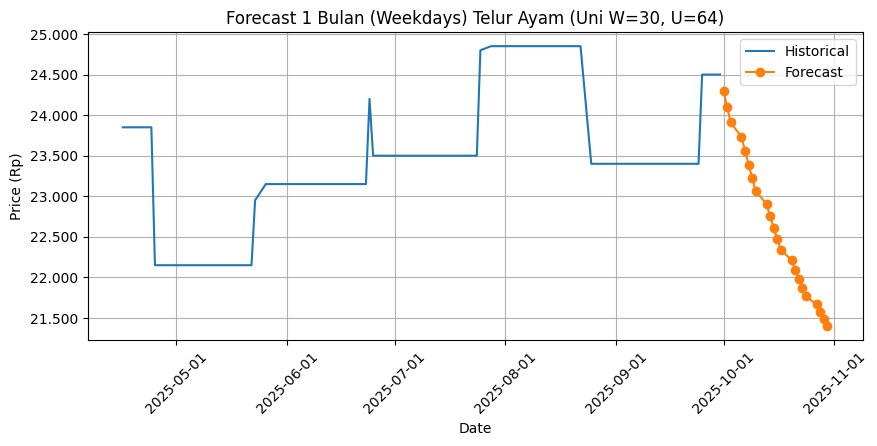

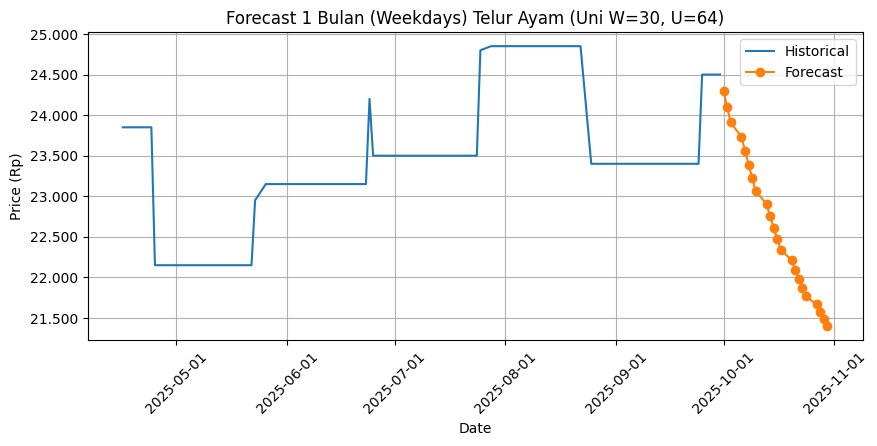


Rekap univariate Telur Ayam disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate\Telur_Ayam\hasil_univariate_Telur_Ayam.csv

==================== UNIVARIATE: Bawang Merah ====================

[UNIVARIATE] Target=Bawang Merah | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.1556 - val_loss: 0.0172
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0153 - val_loss: 0.0158
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0105 - val_loss: 0.0102
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0087 - val_loss: 0.0088
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0078 - val_loss: 0.0085
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0068 - val_loss: 0.0083
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0079 - val_loss: 0.0082
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0065 - val_loss: 0.0083
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0064 - val_loss: 0.0079
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0068 - val_loss: 0.0078
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0061 - val_loss: 0.0076
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0056 - val_l

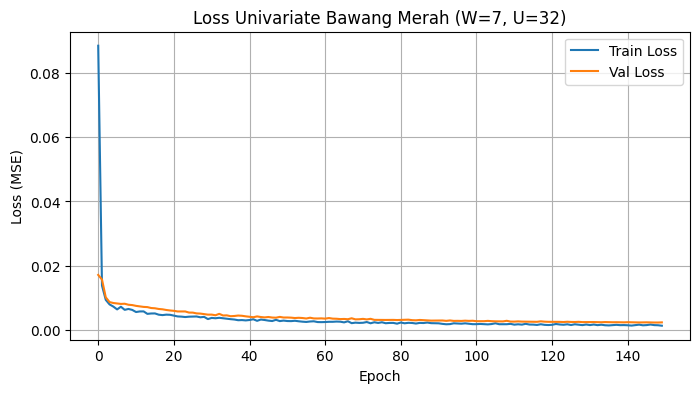

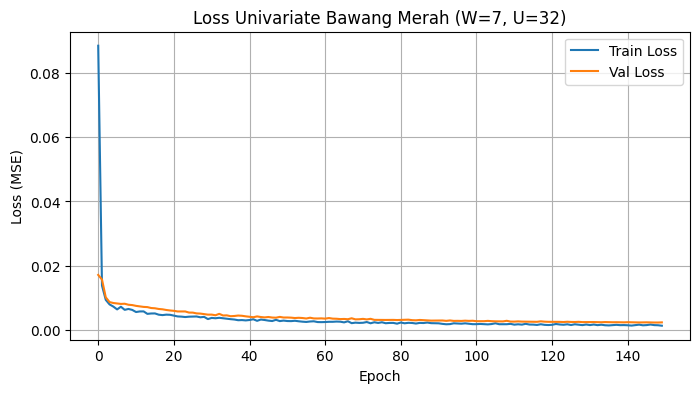

Test MAE  : 618.50
Test RMSE : 1,220.84
Test MAPE : 2.2728%


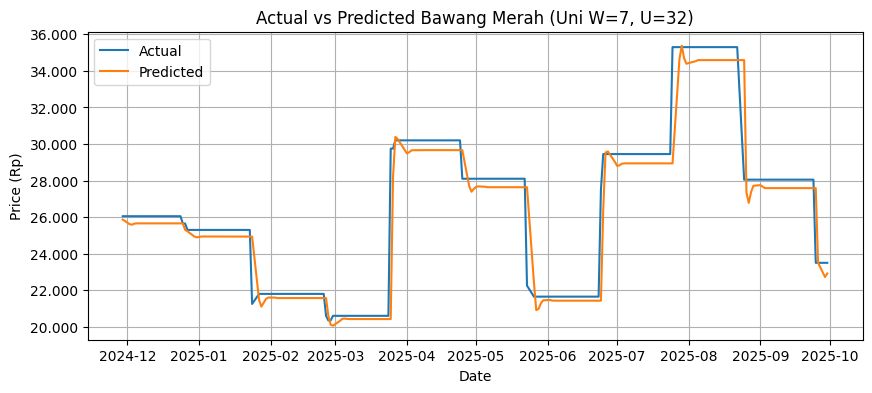

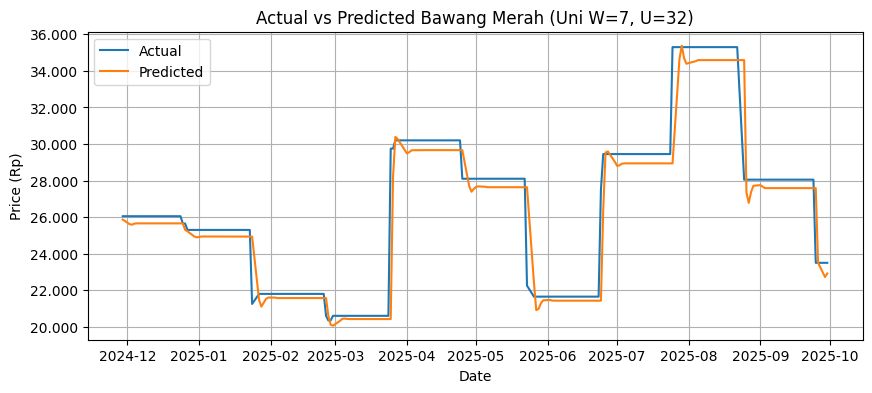


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,23500,22916.189453
1,2025-10-02,23500,22664.271484
2,2025-10-03,23500,22417.781250
3,2025-10-06,23500,22162.533203
4,2025-10-07,23500,21896.300781
5,2025-10-08,23500,21652.626953
6,2025-10-09,23500,21417.126953
7,2025-10-10,23500,21189.330078
8,2025-10-13,23500,20972.564453
9,2025-10-14,23500,20765.662109


Forecast MAPE Okt 2025 : 14.2854%
Compare CSV disimpan: compare_Okt2025_uni_W7_U32.csv


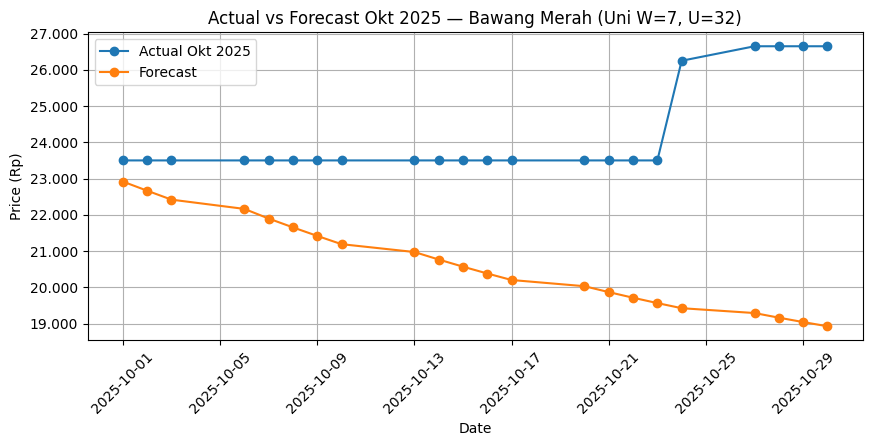

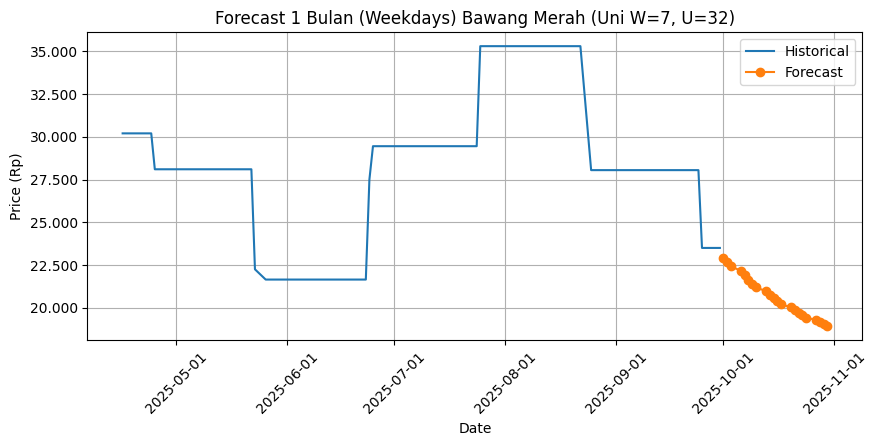

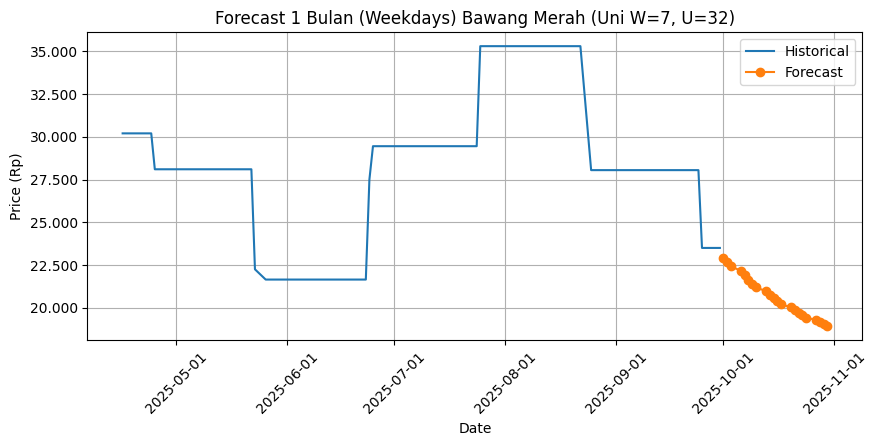


[UNIVARIATE] Target=Bawang Merah | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.0964 - val_loss: 0.0119
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0079 - val_loss: 0.0086
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0066 - val_loss: 0.0081
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0060 - val_loss: 0.0079
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0060 - val_loss: 0.0078
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0054 - val_loss: 0.0075
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0056 - val_loss: 0.0073
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0050 - val_loss: 0.0071
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0052 - val_loss: 0.0069
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0046 - val_loss: 0.0067
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0045 - val_loss: 0.0064
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0047 - val_l

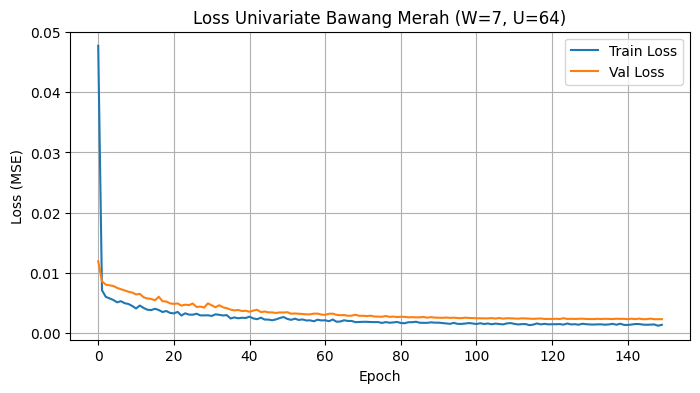

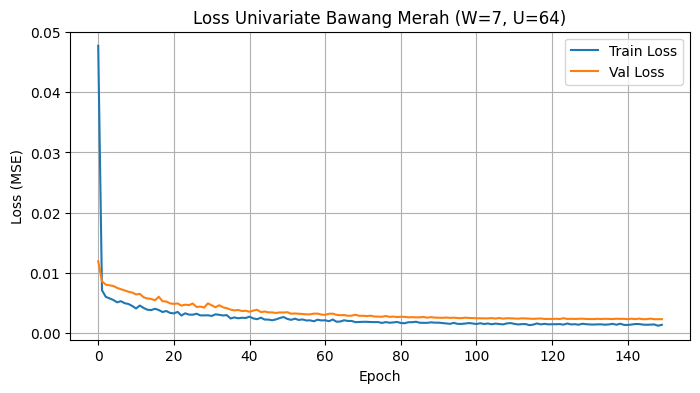

Test MAE  : 467.05
Test RMSE : 1,168.57
Test MAPE : 1.6845%


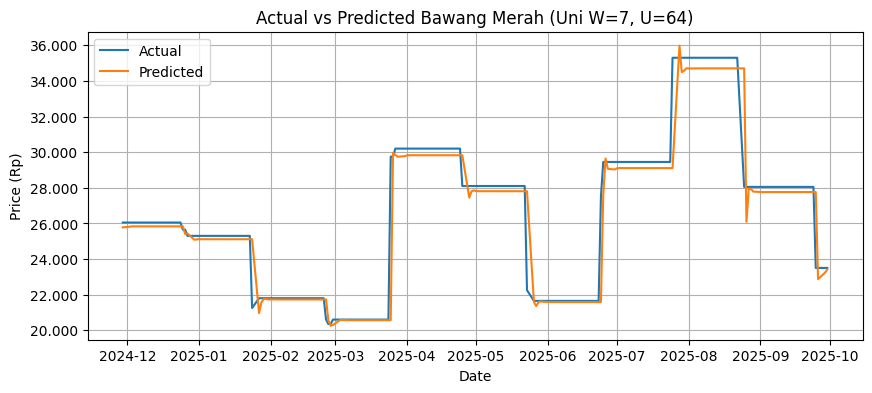

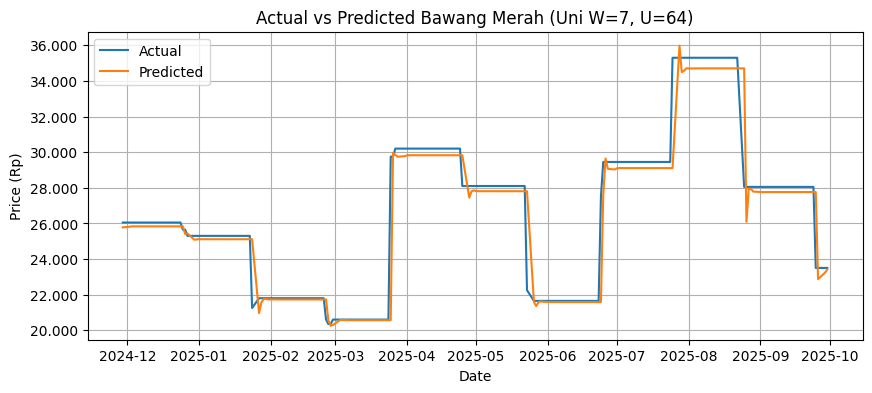


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,23500,23416.246094
1,2025-10-02,23500,23317.679688
2,2025-10-03,23500,23195.390625
3,2025-10-06,23500,23067.091797
4,2025-10-07,23500,22943.068359
5,2025-10-08,23500,22823.531250
6,2025-10-09,23500,22708.683594
7,2025-10-10,23500,22598.242188
8,2025-10-13,23500,22491.931641
9,2025-10-14,23500,22389.539062


Forecast MAPE Okt 2025 : 7.4631%
Compare CSV disimpan: compare_Okt2025_uni_W7_U64.csv


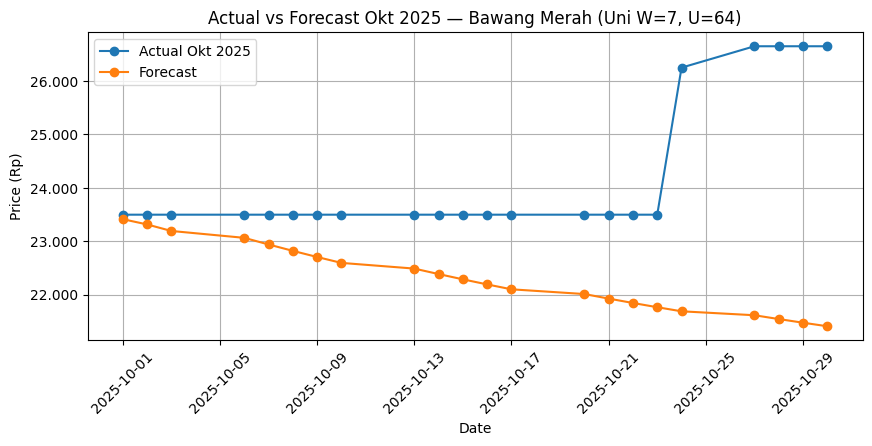

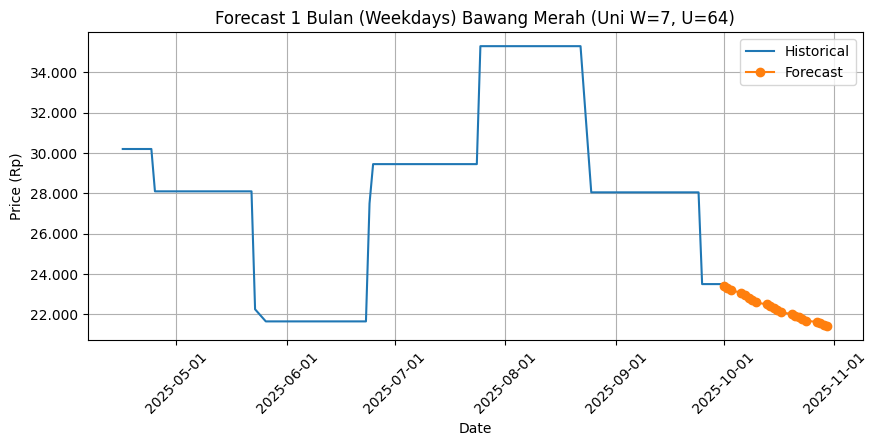

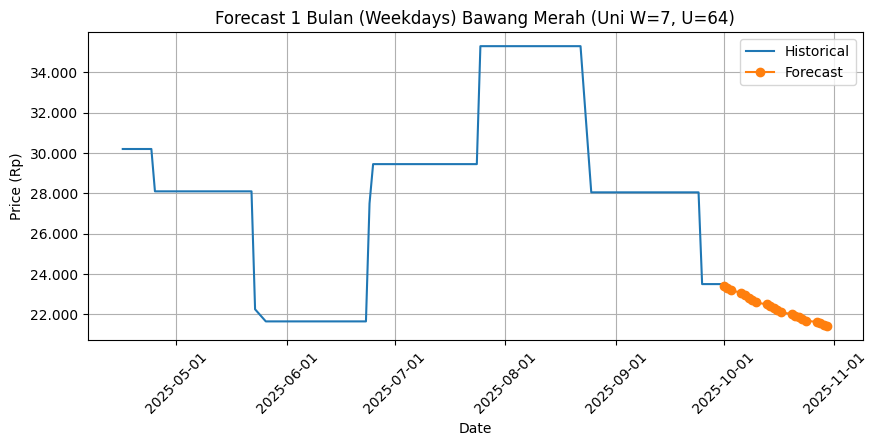


[UNIVARIATE] Target=Bawang Merah | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.0433 - val_loss: 0.0158
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0091 - val_loss: 0.0100
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0066 - val_loss: 0.0086
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0064 - val_loss: 0.0081
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0065 - val_loss: 0.0075
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0053 - val_loss: 0.0070
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0053 - val_loss: 0.0066
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0050 - val_loss: 0.0063
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0045 - val_loss: 0.0058
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0046 - val_loss: 0.0058
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0040 - val_loss: 0.0058
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0043 - val

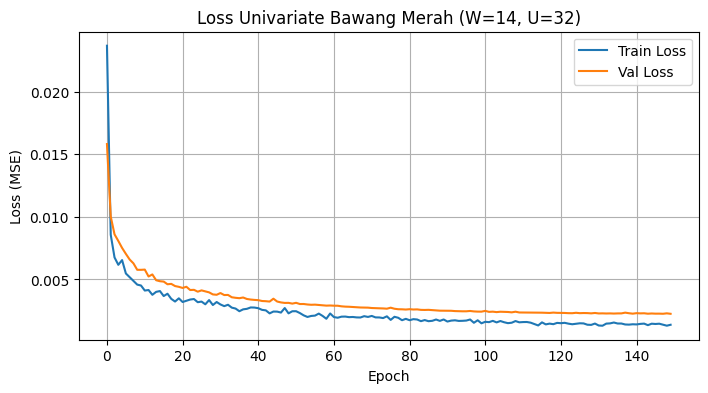

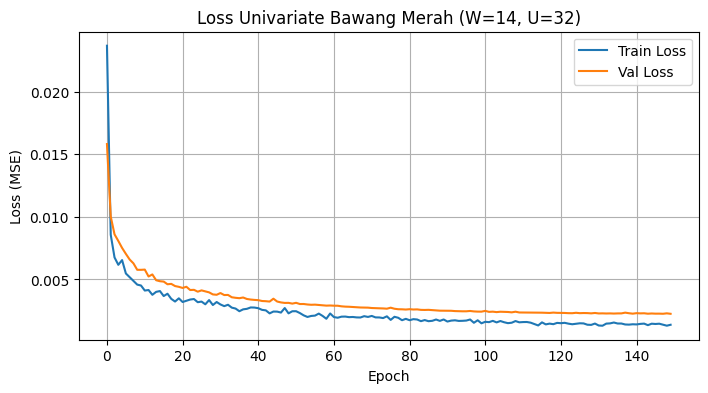

Test MAE  : 326.30
Test RMSE : 1,163.11
Test MAPE : 1.2047%


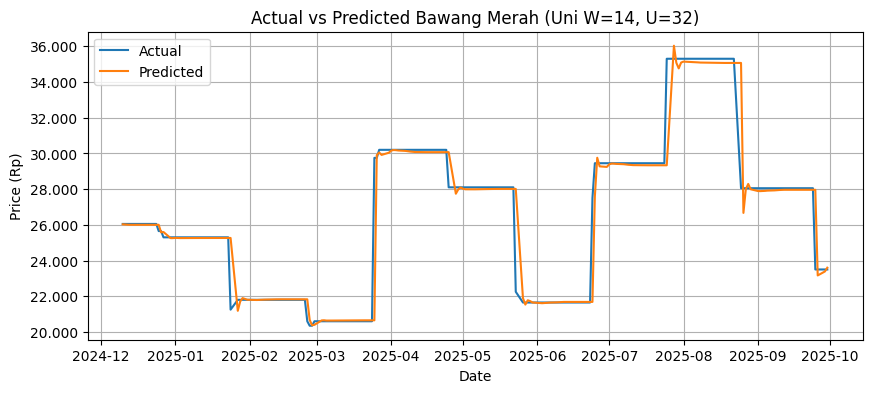

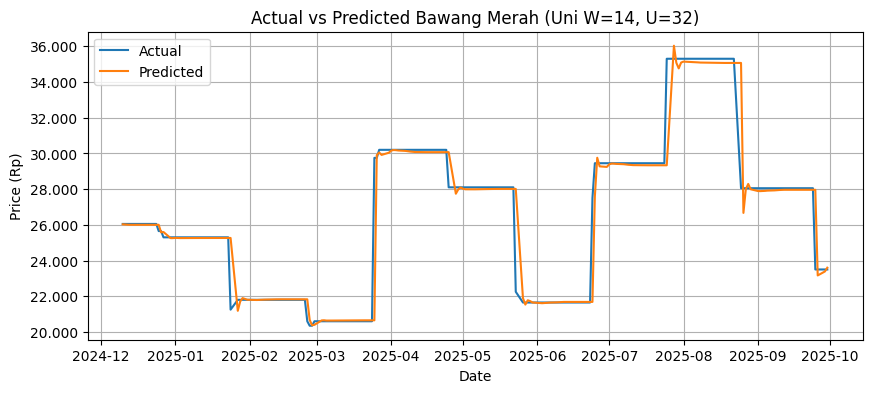


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,23500,23600.187500
1,2025-10-02,23500,23630.095703
2,2025-10-03,23500,23598.716797
3,2025-10-06,23500,23543.394531
4,2025-10-07,23500,23486.996094
5,2025-10-08,23500,23439.750000
6,2025-10-09,23500,23404.160156
7,2025-10-10,23500,23379.271484
8,2025-10-13,23500,23363.101562
9,2025-10-14,23500,23353.662109


Forecast MAPE Okt 2025 : 3.1423%
Compare CSV disimpan: compare_Okt2025_uni_W14_U32.csv


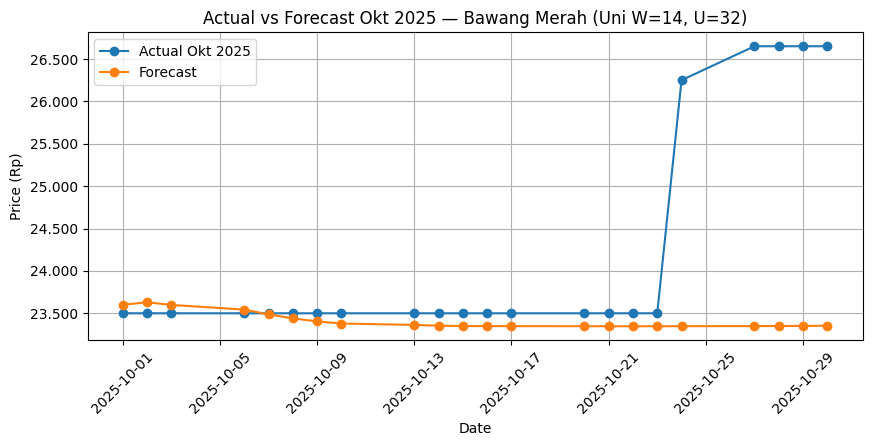

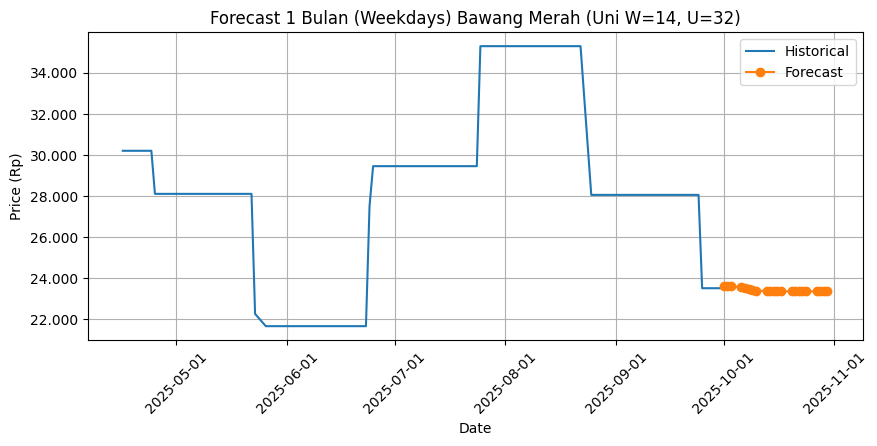

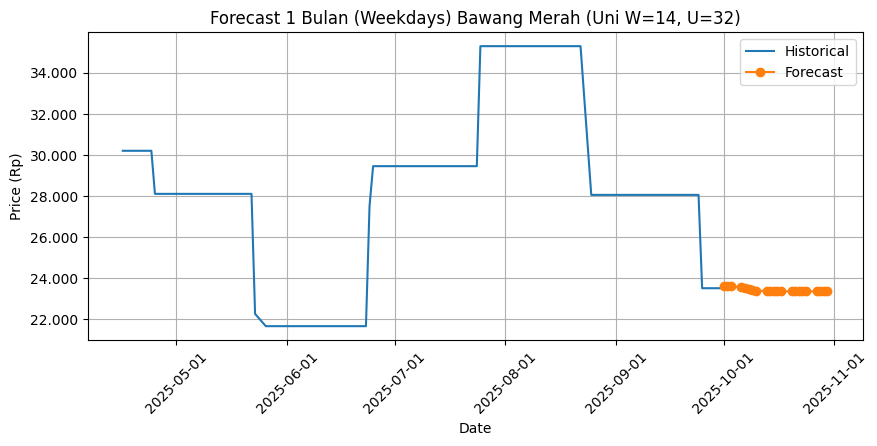


[UNIVARIATE] Target=Bawang Merah | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 21ms/step - loss: 0.0469 - val_loss: 0.0116
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0070 - val_loss: 0.0087
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0059 - val_loss: 0.0081
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0053 - val_loss: 0.0075
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0051 - val_loss: 0.0069
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0045 - val_loss: 0.0064
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0044 - val_loss: 0.0060
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0043 - val_loss: 0.0056
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0040 - val_loss: 0.0052
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0035 - val_loss: 0.0050
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0036 - val_loss: 0.0049
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0

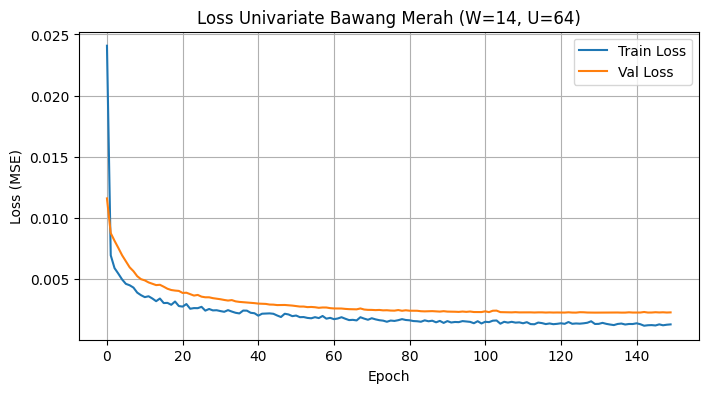

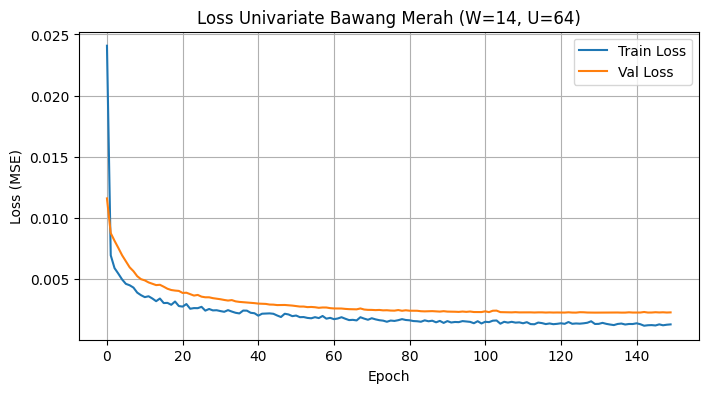

Test MAE  : 306.62
Test RMSE : 1,172.93
Test MAPE : 1.1507%


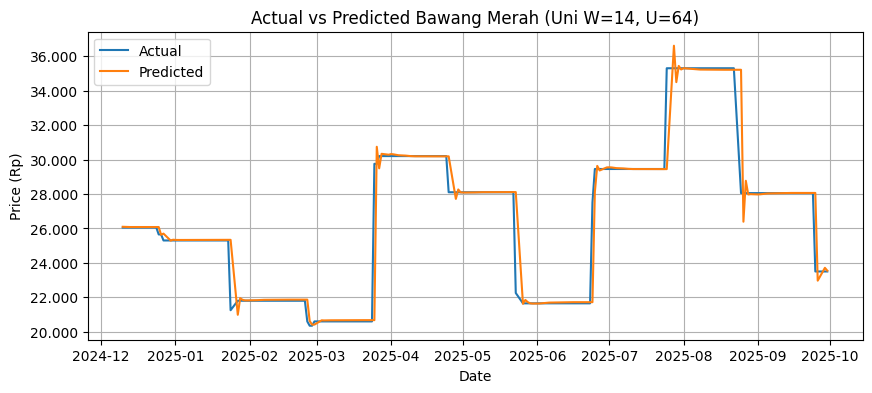

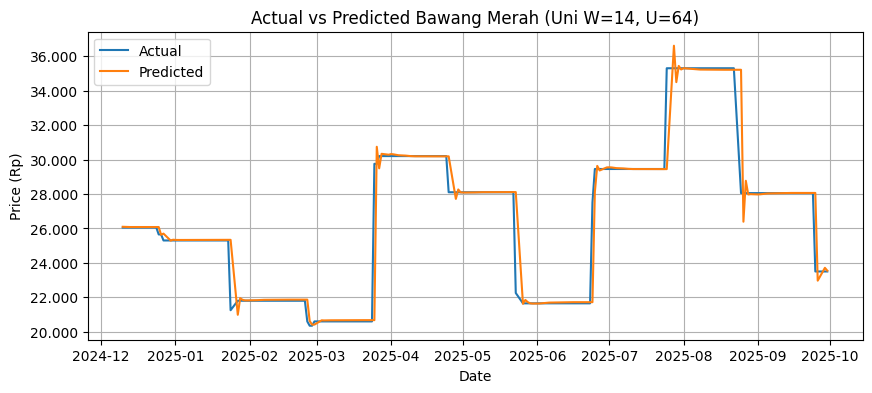


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,23500,23547.796875
1,2025-10-02,23500,23551.845703
2,2025-10-03,23500,23545.863281
3,2025-10-06,23500,23544.361328
4,2025-10-07,23500,23553.453125
5,2025-10-08,23500,23573.988281
6,2025-10-09,23500,23604.740234
7,2025-10-10,23500,23643.794922
8,2025-10-13,23500,23689.183594
9,2025-10-14,23500,23739.207031


Forecast MAPE Okt 2025 : 2.7641%
Compare CSV disimpan: compare_Okt2025_uni_W14_U64.csv


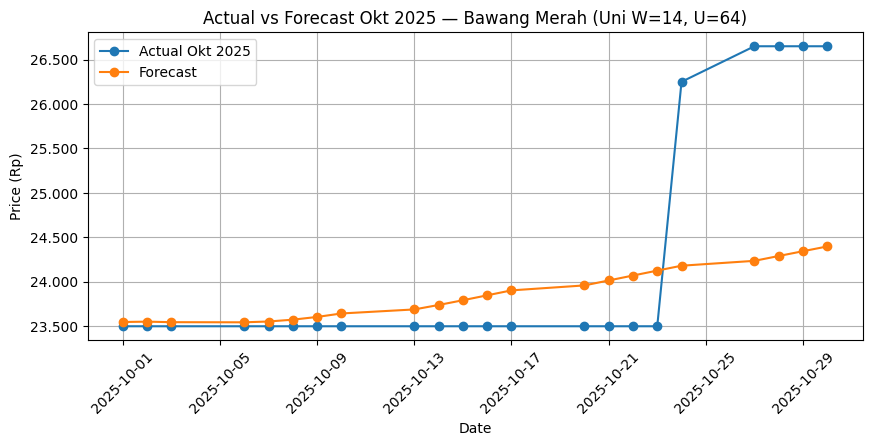

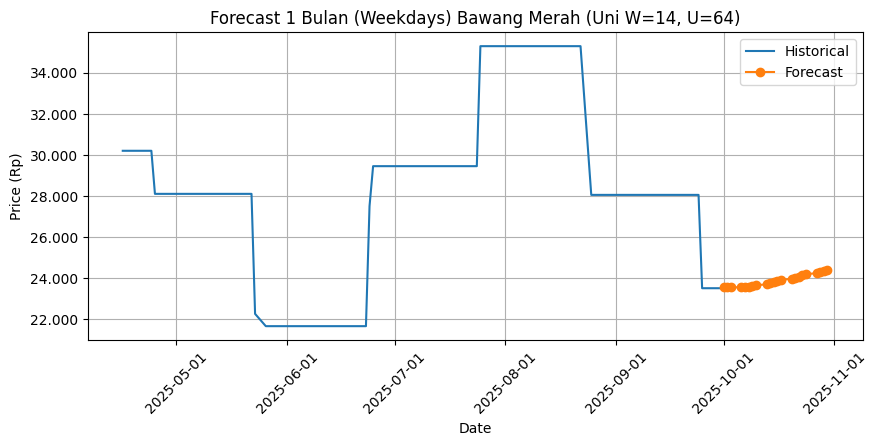

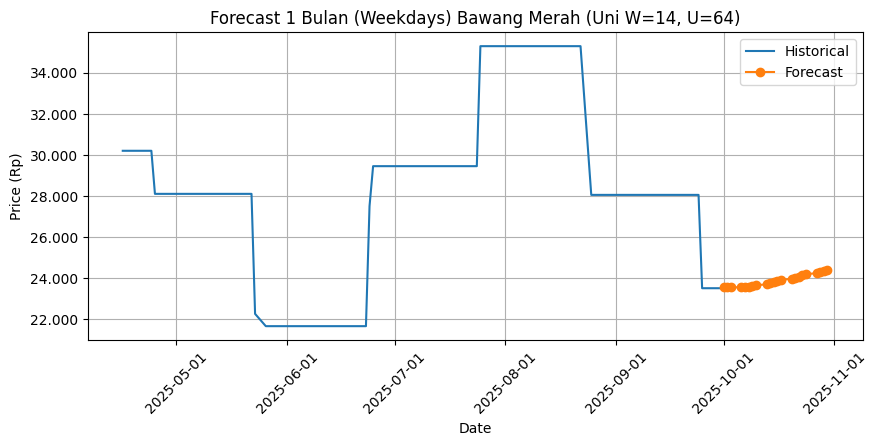


[UNIVARIATE] Target=Bawang Merah | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 25ms/step - loss: 0.1311 - val_loss: 0.0215
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0152 - val_loss: 0.0168
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0121 - val_loss: 0.0140
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0099 - val_loss: 0.0127
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0088 - val_loss: 0.0120
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0075 - val_loss: 0.0104
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0066 - val_loss: 0.0095
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0067 - val_loss: 0.0089
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0065 - val_loss: 0.0088
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0062 - val_loss: 0.0083
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0061 - val_loss: 0.0082
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0

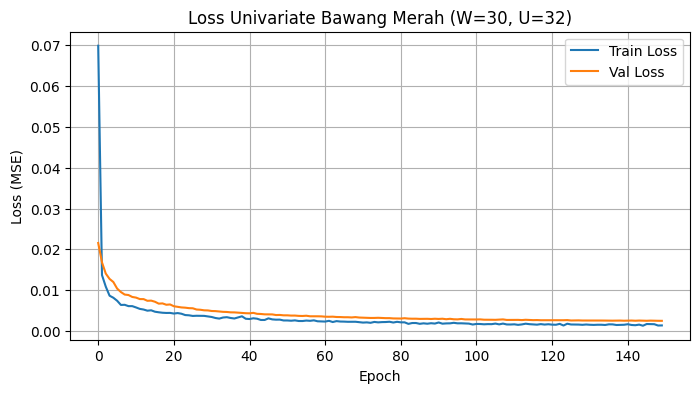

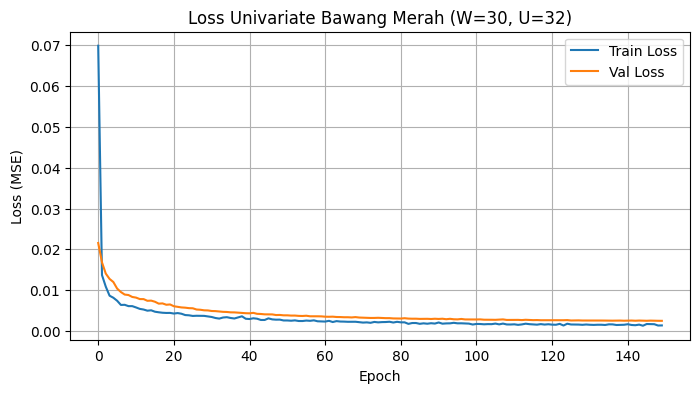

Test MAE  : 344.98
Test RMSE : 1,206.18
Test MAPE : 1.2793%


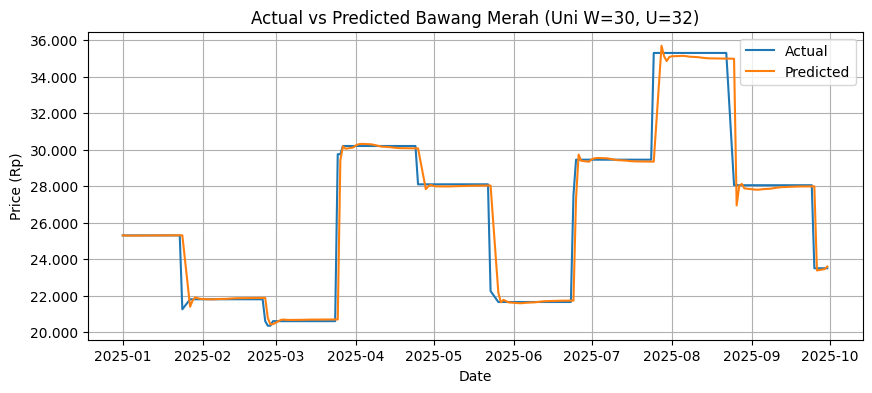

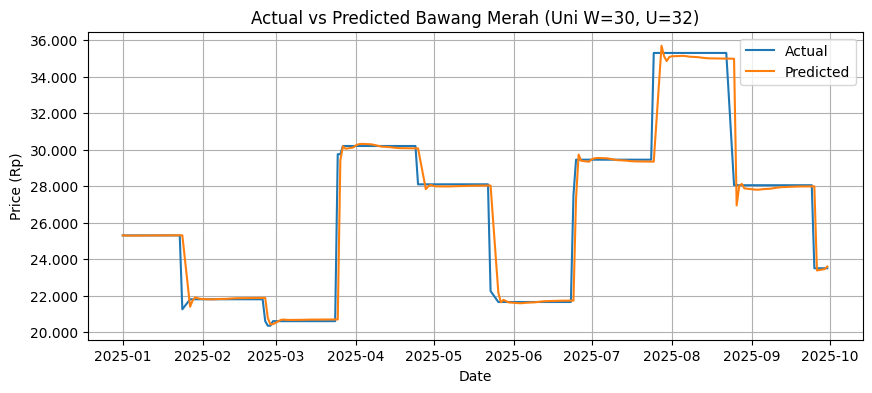


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,23500,23595.138672
1,2025-10-02,23500,23608.148438
2,2025-10-03,23500,23573.683594
3,2025-10-06,23500,23516.890625
4,2025-10-07,23500,23453.306641
5,2025-10-08,23500,23394.177734
6,2025-10-09,23500,23346.021484
7,2025-10-10,23500,23311.652344
8,2025-10-13,23500,23291.306641
9,2025-10-14,23500,23283.802734


Forecast MAPE Okt 2025 : 2.9906%
Compare CSV disimpan: compare_Okt2025_uni_W30_U32.csv


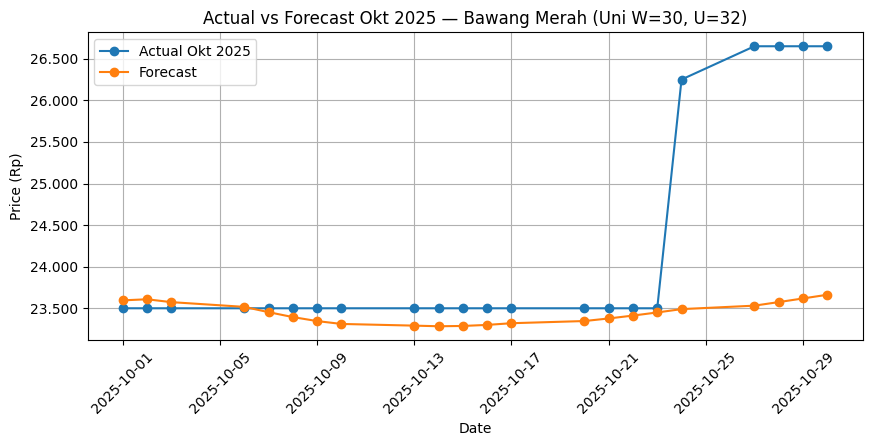

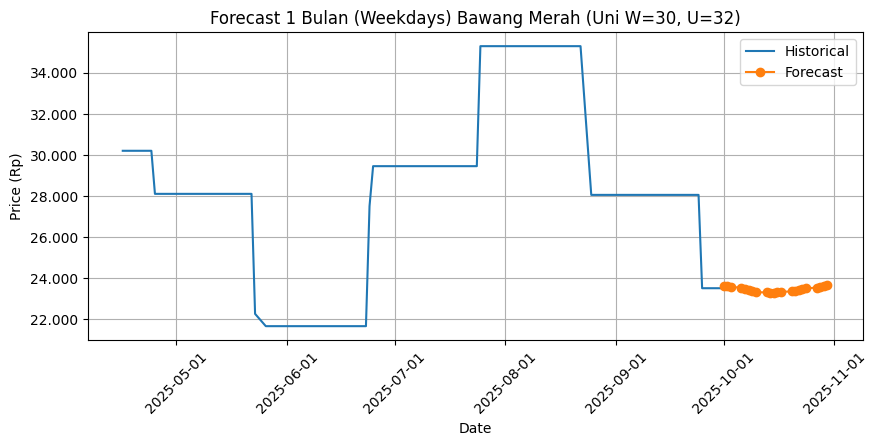

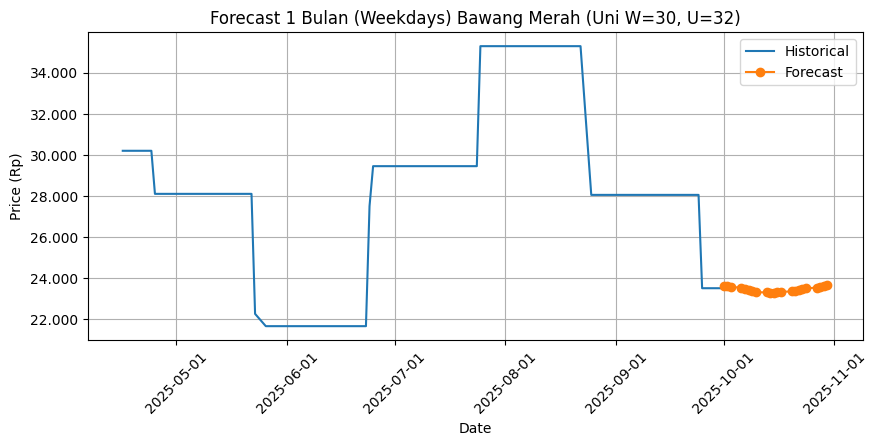


[UNIVARIATE] Target=Bawang Merah | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step - loss: 0.1150 - val_loss: 0.0298
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0109 - val_loss: 0.0157
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0082 - val_loss: 0.0126
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0071 - val_loss: 0.0108
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0065 - val_loss: 0.0096
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0058 - val_loss: 0.0089
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - loss: 0.0056 - val_loss: 0.0084
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0056 - val_loss: 0.0080
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0050 - val_loss: 0.0077
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0047 - val_loss: 0.0074
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0046 - val_loss: 0.0071
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - loss: 0.0

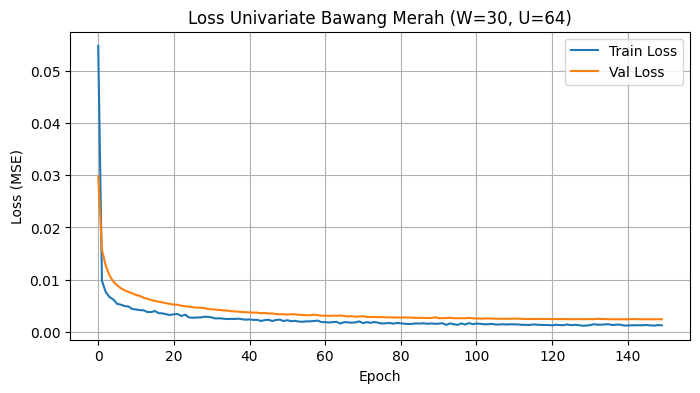

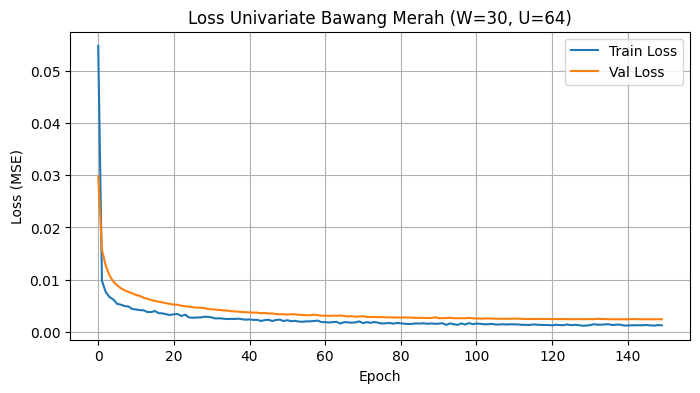

Test MAE  : 353.54
Test RMSE : 1,215.82
Test MAPE : 1.3033%


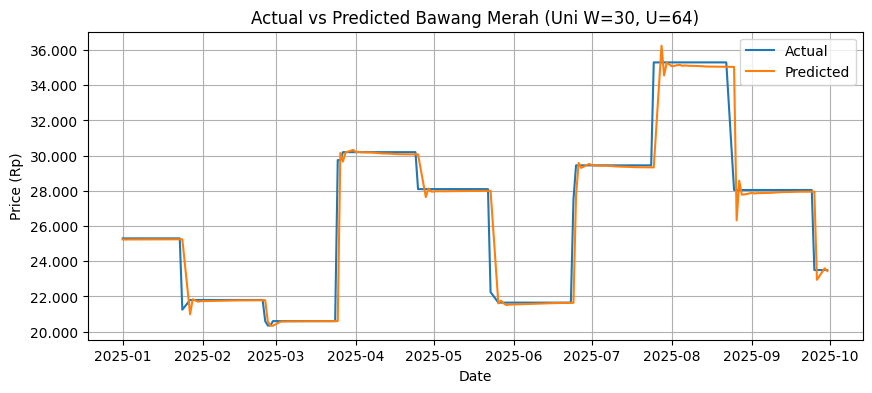

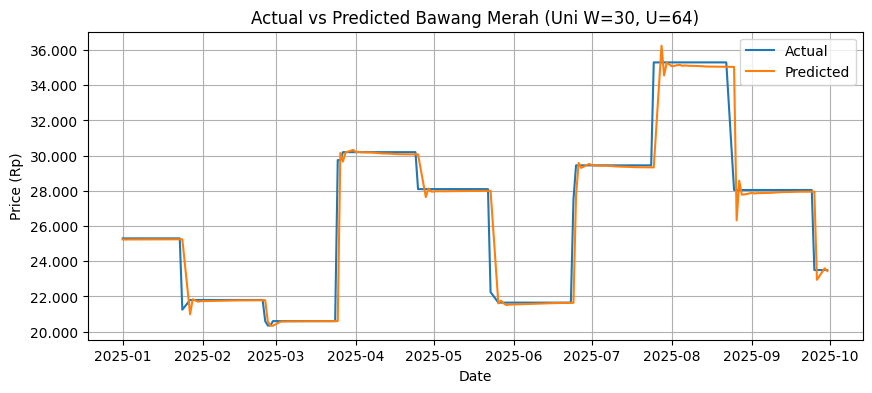


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,23500,23444.300781
1,2025-10-02,23500,23310.343750
2,2025-10-03,23500,23208.830078
3,2025-10-06,23500,23117.210938
4,2025-10-07,23500,23030.095703
5,2025-10-08,23500,22946.140625
6,2025-10-09,23500,22865.757812
7,2025-10-10,23500,22789.890625
8,2025-10-13,23500,22719.333984
9,2025-10-14,23500,22654.515625


Forecast MAPE Okt 2025 : 6.0528%
Compare CSV disimpan: compare_Okt2025_uni_W30_U64.csv


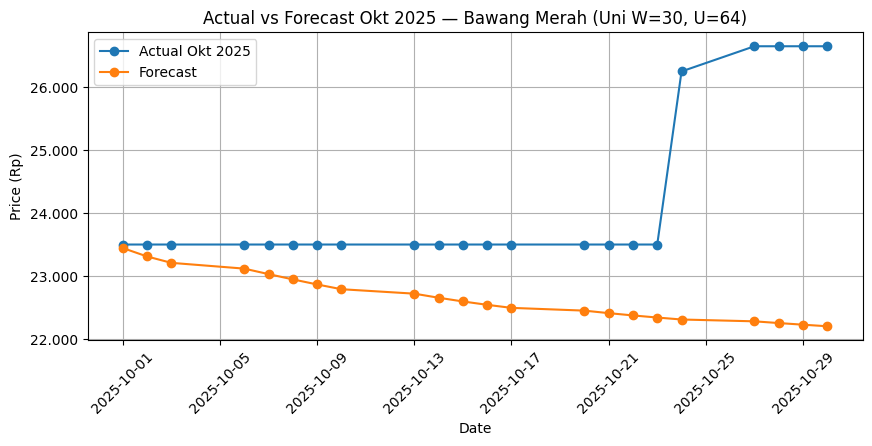

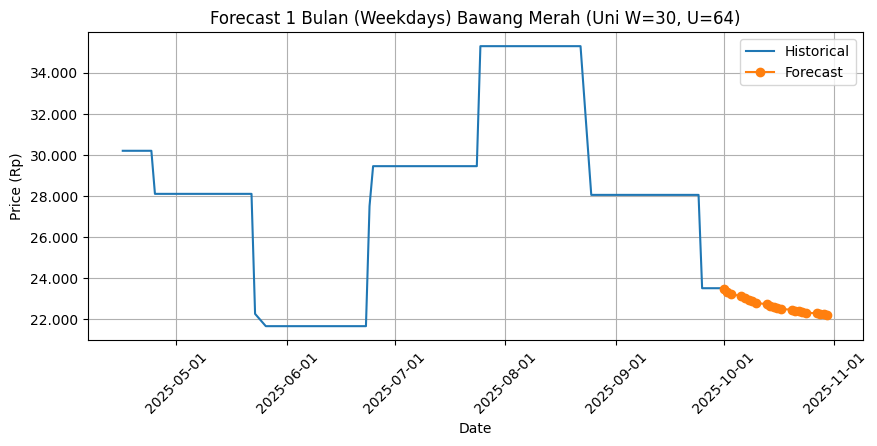

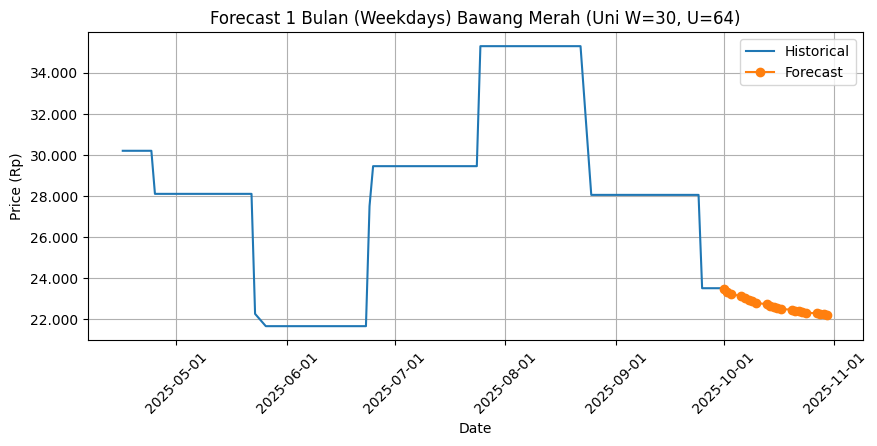


Rekap univariate Bawang Merah disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate\Bawang_Merah\hasil_univariate_Bawang_Merah.csv

==================== UNIVARIATE: Cabai Merah ====================

[UNIVARIATE] Target=Cabai Merah | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 0.0512 - val_loss: 0.0127
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0096 - val_loss: 0.0102
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0070 - val_loss: 0.0095
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0065 - val_loss: 0.0094
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0069 - val_loss: 0.0091
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0064 - val_loss: 0.0088
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0061 - val_loss: 0.0086
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0060 - val_loss: 0.0083
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0052 - val_loss: 0.0082
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0053 - val_loss: 0.0079
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0050 - val_loss: 0.0076
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0055 - val_l

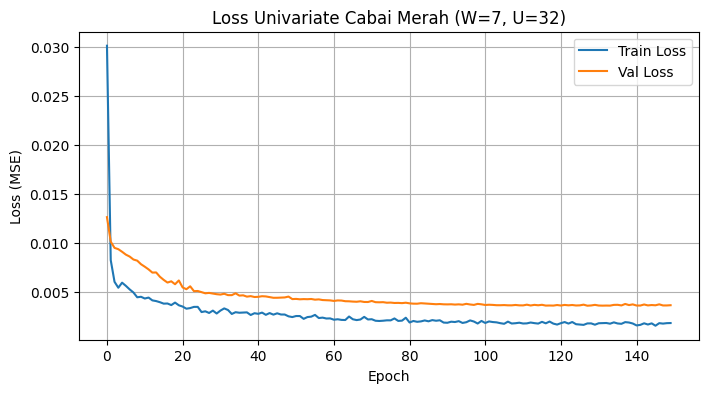

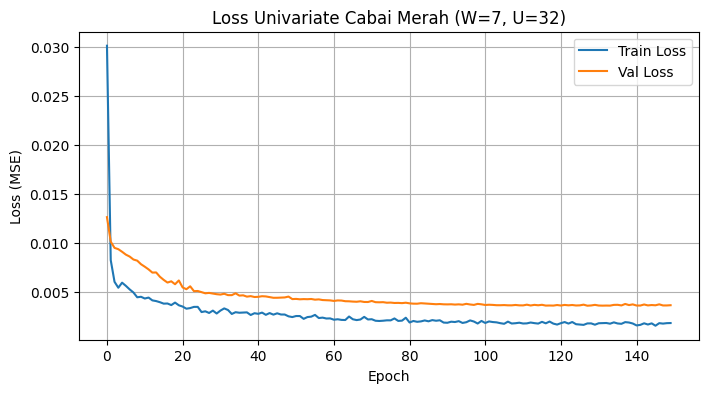

Test MAE  : 562.89
Test RMSE : 1,542.37
Test MAPE : 2.1747%


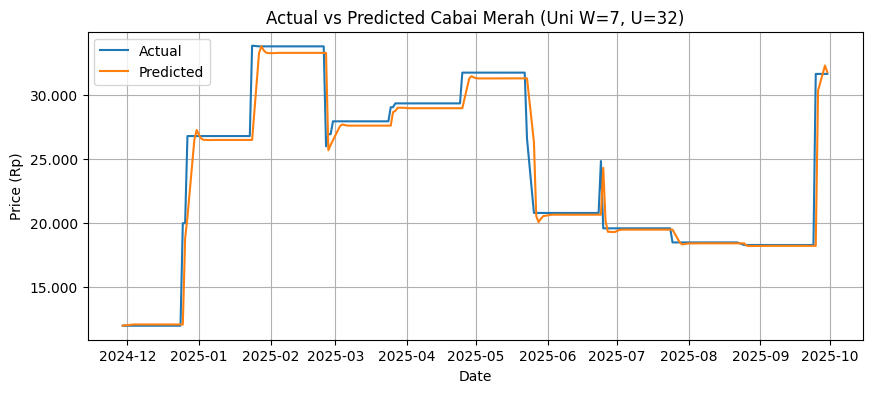

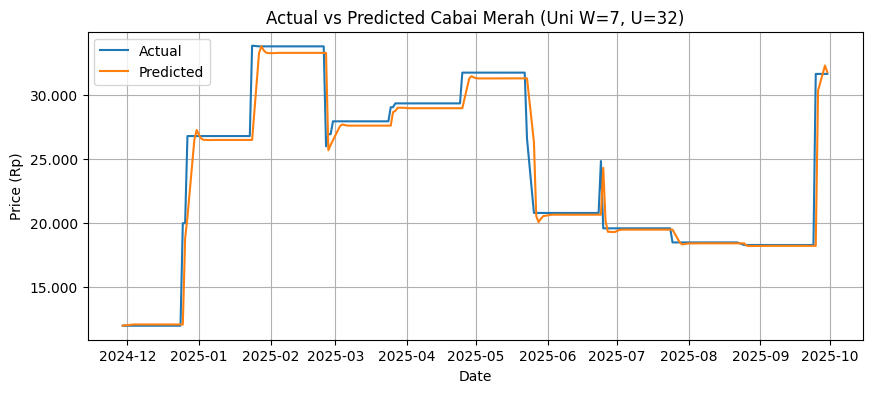


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,31650,31790.212891
1,2025-10-02,31650,31478.658203
2,2025-10-03,31650,31031.744141
3,2025-10-06,31650,30557.326172
4,2025-10-07,31650,30106.332031
5,2025-10-08,31650,29662.031250
6,2025-10-09,31650,29232.349609
7,2025-10-10,31650,28817.832031
8,2025-10-13,31650,28417.195312
9,2025-10-14,31650,28029.792969


Forecast MAPE Okt 2025 : 12.9343%
Compare CSV disimpan: compare_Okt2025_uni_W7_U32.csv


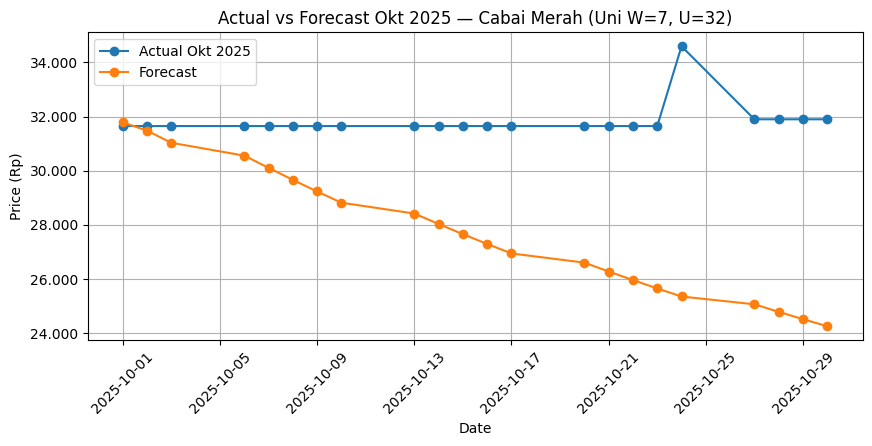

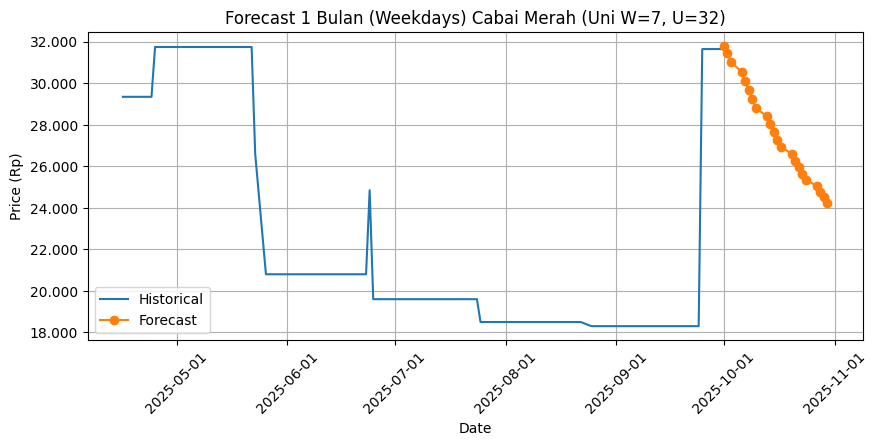

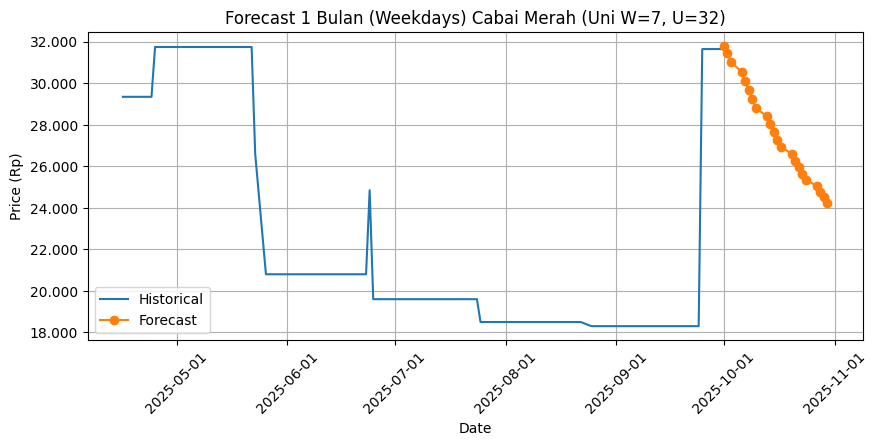


[UNIVARIATE] Target=Cabai Merah | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.0667 - val_loss: 0.0143
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0087 - val_loss: 0.0110
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0064 - val_loss: 0.0110
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0064 - val_loss: 0.0104
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0059 - val_loss: 0.0100
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0059 - val_loss: 0.0097
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0054 - val_loss: 0.0093
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0056 - val_loss: 0.0092
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0052 - val_loss: 0.0086
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0053 - val_loss: 0.0080
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0048 - val_loss: 0.0076
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0050 - val_l

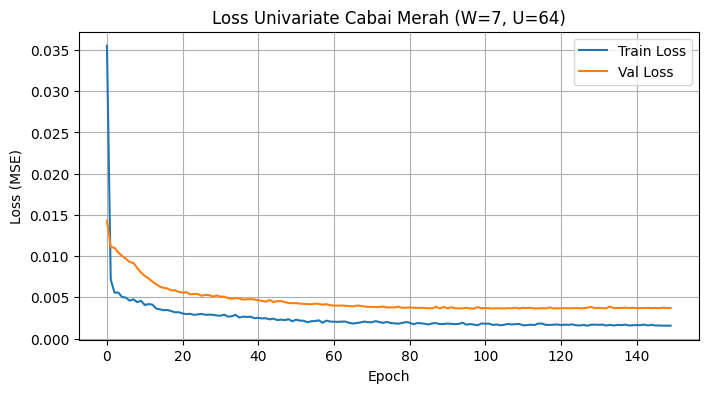

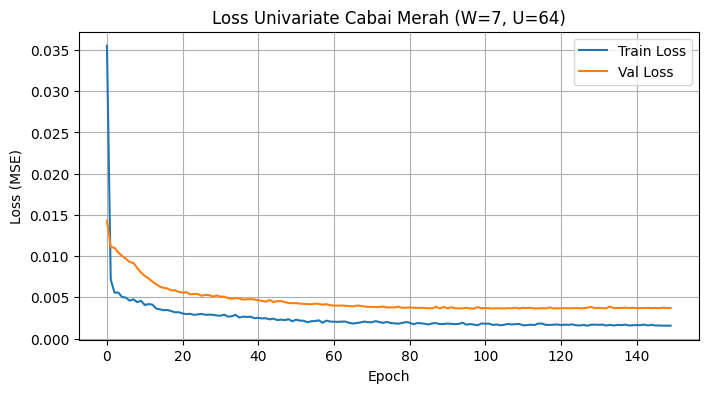

Test MAE  : 422.43
Test RMSE : 1,534.28
Test MAPE : 1.7227%


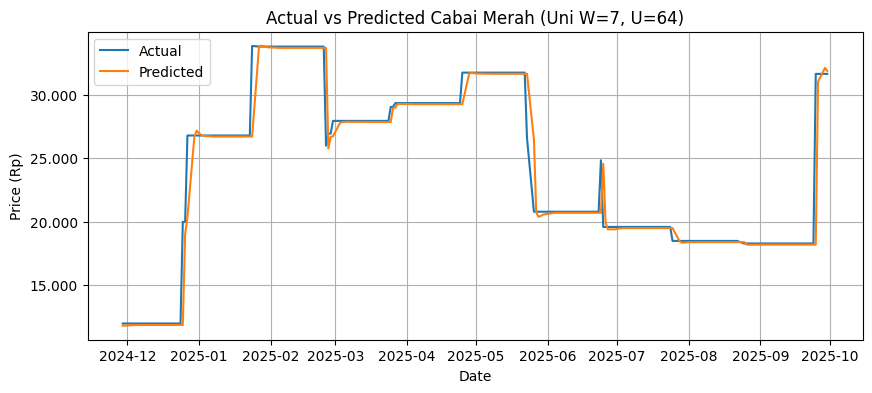

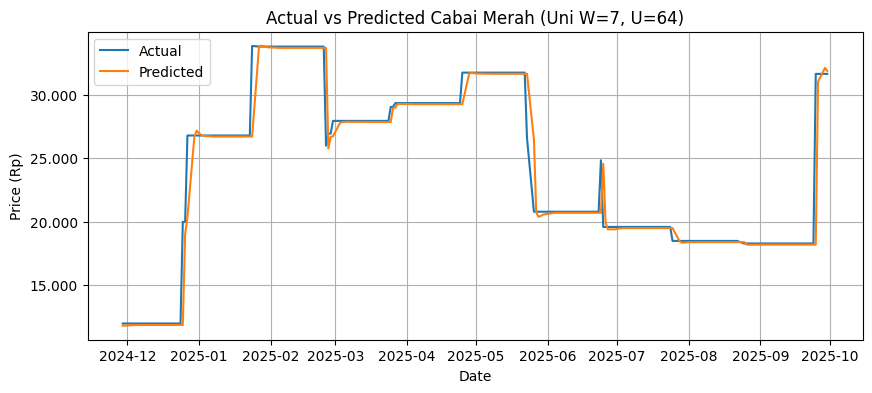


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,31650,31873.898438
1,2025-10-02,31650,31953.537109
2,2025-10-03,31650,31953.363281
3,2025-10-06,31650,31899.849609
4,2025-10-07,31650,31807.617188
5,2025-10-08,31650,31712.250000
6,2025-10-09,31650,31614.412109
7,2025-10-10,31650,31514.679688
8,2025-10-13,31650,31414.171875
9,2025-10-14,31650,31313.515625


Forecast MAPE Okt 2025 : 2.4946%
Compare CSV disimpan: compare_Okt2025_uni_W7_U64.csv


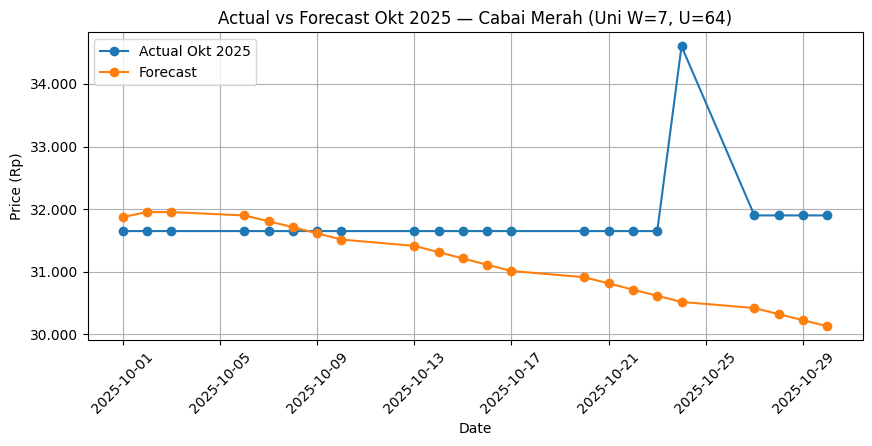

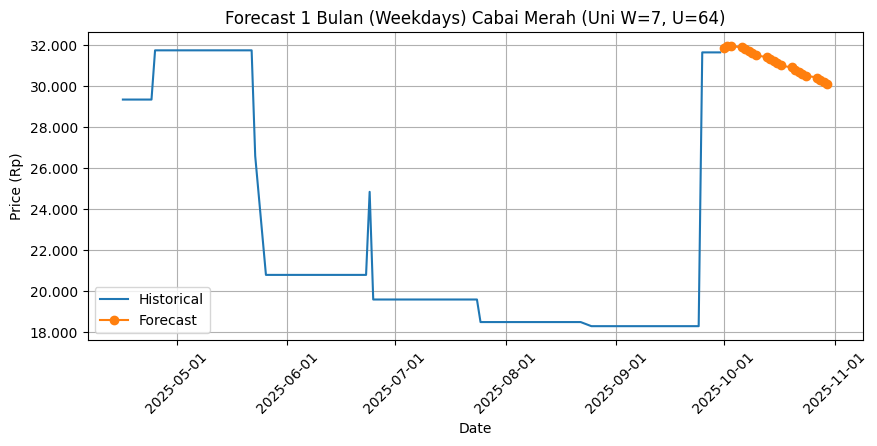

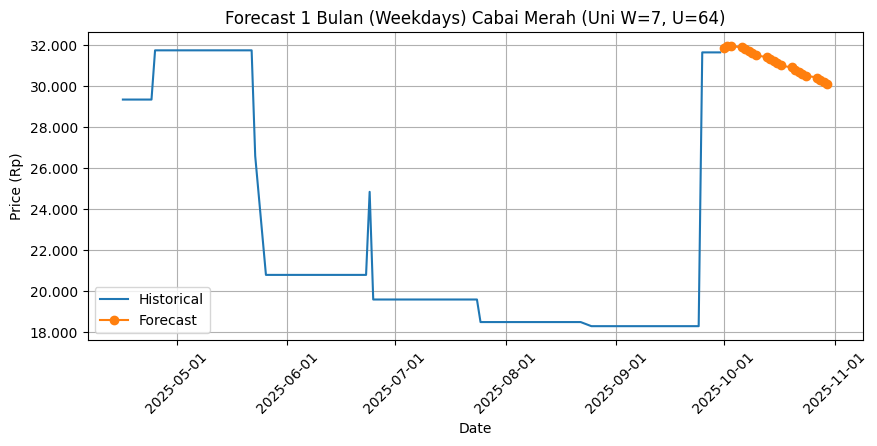


[UNIVARIATE] Target=Cabai Merah | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - loss: 0.0793 - val_loss: 0.0179
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0118 - val_loss: 0.0157
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0087 - val_loss: 0.0145
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0073 - val_loss: 0.0136
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0075 - val_loss: 0.0124
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0068 - val_loss: 0.0119
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0065 - val_loss: 0.0106
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0054 - val_loss: 0.0098
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0053 - val_loss: 0.0090
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0051 - val_loss: 0.0086
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0044 - val_loss: 0.0082
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0051 - val

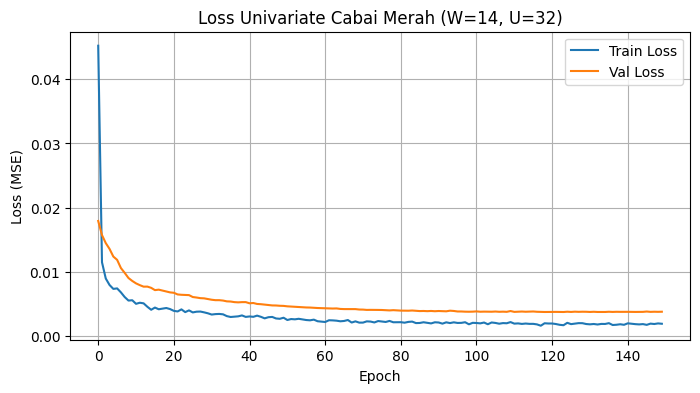

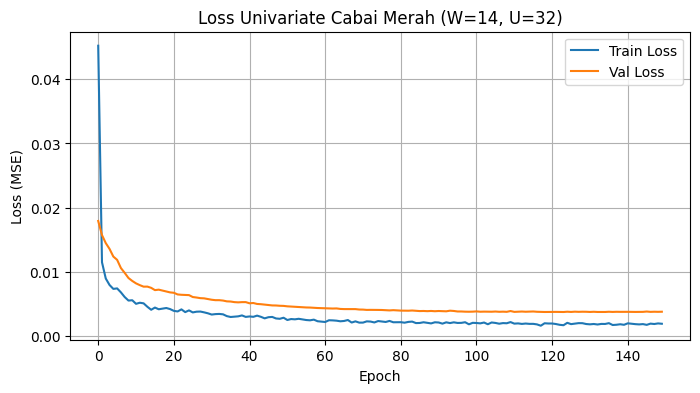

Test MAE  : 546.30
Test RMSE : 1,567.91
Test MAPE : 2.1168%


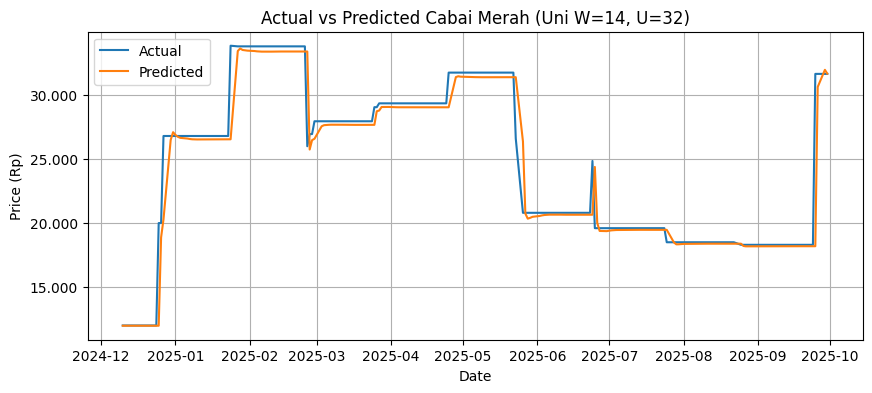

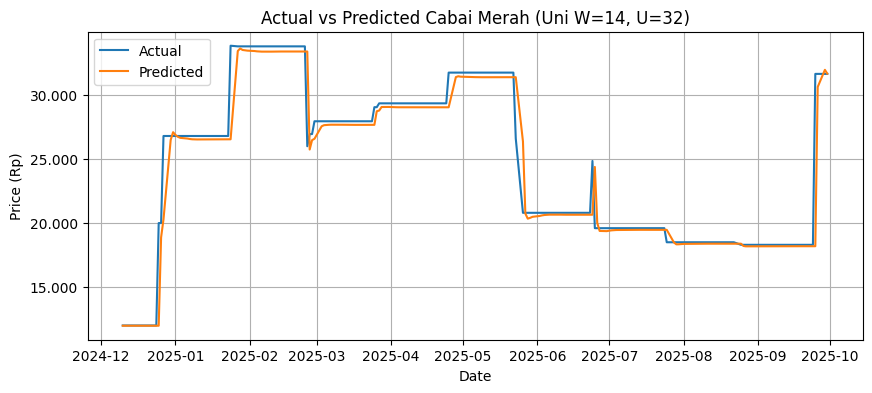


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,31650,31666.818359
1,2025-10-02,31650,31537.917969
2,2025-10-03,31650,31333.302734
3,2025-10-06,31650,31064.074219
4,2025-10-07,31650,30747.390625
5,2025-10-08,31650,30401.392578
6,2025-10-09,31650,30041.691406
7,2025-10-10,31650,29679.970703
8,2025-10-13,31650,29324.048828
9,2025-10-14,31650,28978.585938


Forecast MAPE Okt 2025 : 10.1147%
Compare CSV disimpan: compare_Okt2025_uni_W14_U32.csv


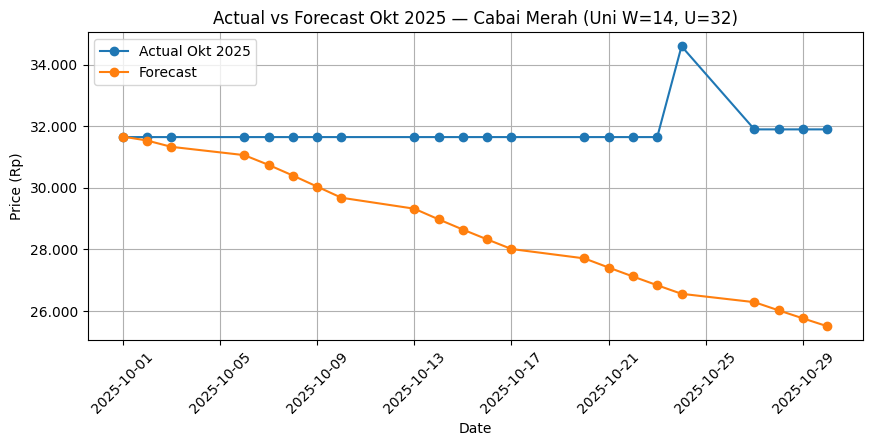

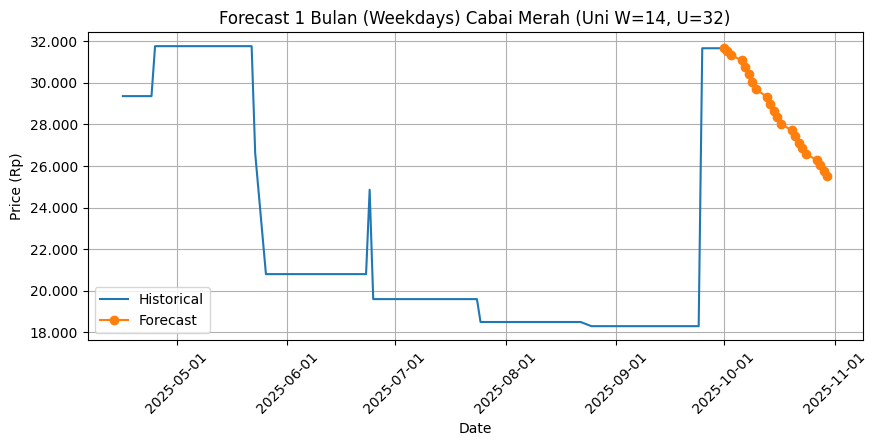

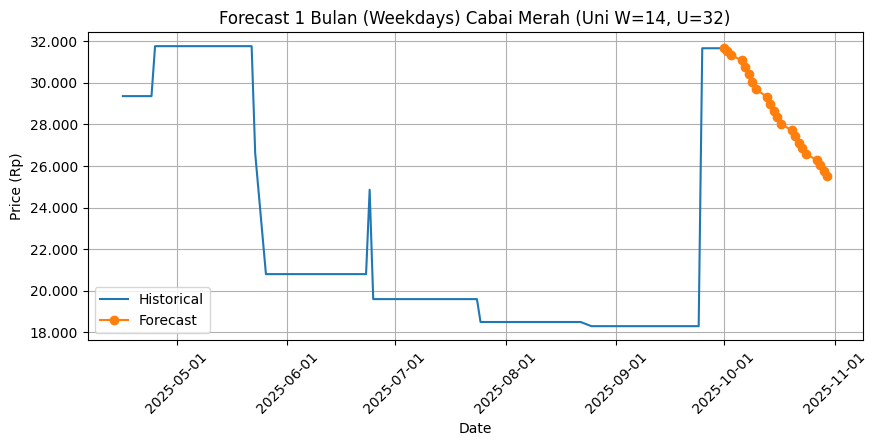


[UNIVARIATE] Target=Cabai Merah | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - loss: 0.0491 - val_loss: 0.0156
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0074 - val_loss: 0.0145
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0059 - val_loss: 0.0128
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0057 - val_loss: 0.0116
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0054 - val_loss: 0.0107
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0043 - val_loss: 0.0095
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0045 - val_loss: 0.0087
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0045 - val_loss: 0.0085
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0044 - val_loss: 0.0080
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0038 - val_loss: 0.0077
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0039 - val_loss: 0.0078
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.004

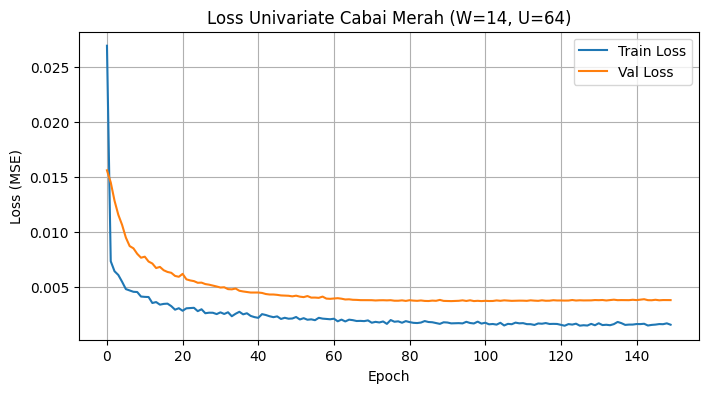

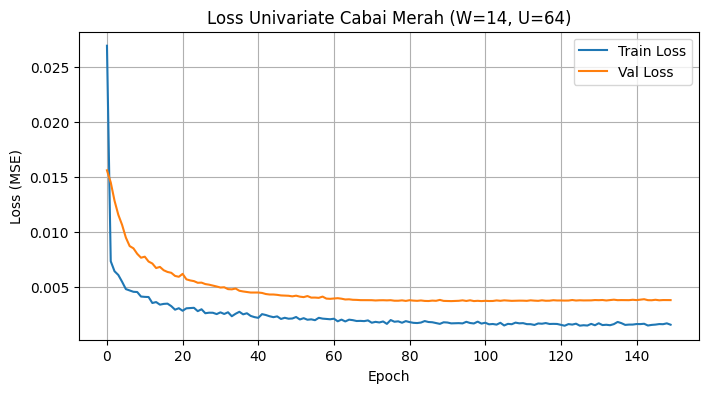

Test MAE  : 504.13
Test RMSE : 1,556.61
Test MAPE : 1.9449%


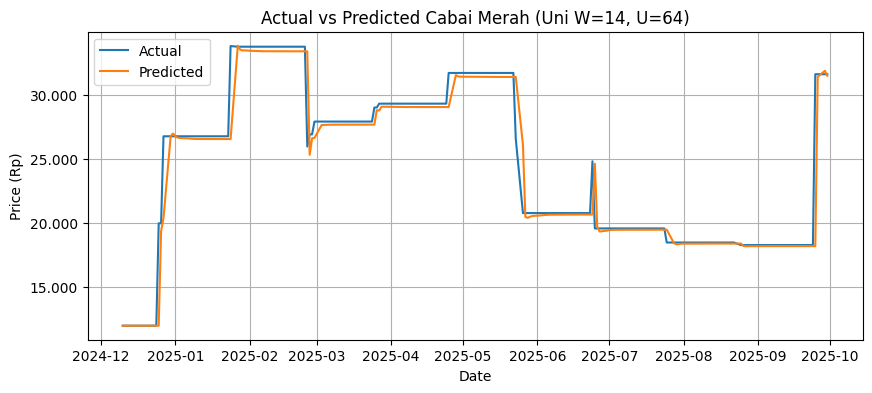

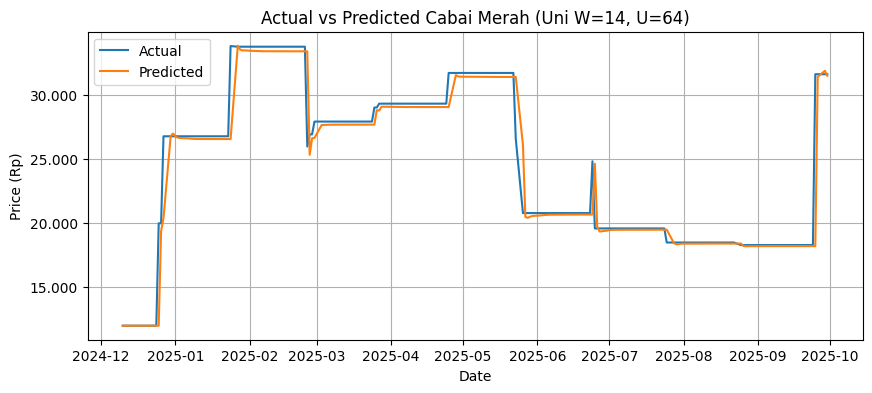


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,31650,31531.023438
1,2025-10-02,31650,31346.957031
2,2025-10-03,31650,31129.431641
3,2025-10-06,31650,30881.070312
4,2025-10-07,31650,30608.625000
5,2025-10-08,31650,30319.867188
6,2025-10-09,31650,30021.863281
7,2025-10-10,31650,29720.218750
8,2025-10-13,31650,29419.041016
9,2025-10-14,31650,29121.128906


Forecast MAPE Okt 2025 : 9.6268%
Compare CSV disimpan: compare_Okt2025_uni_W14_U64.csv


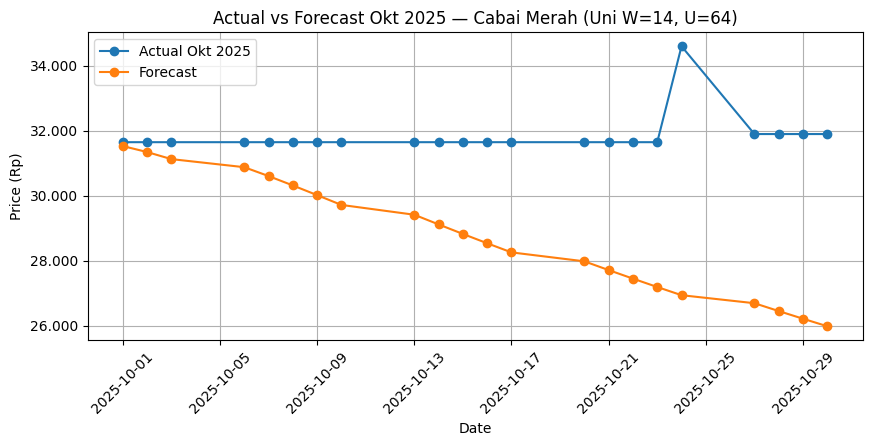

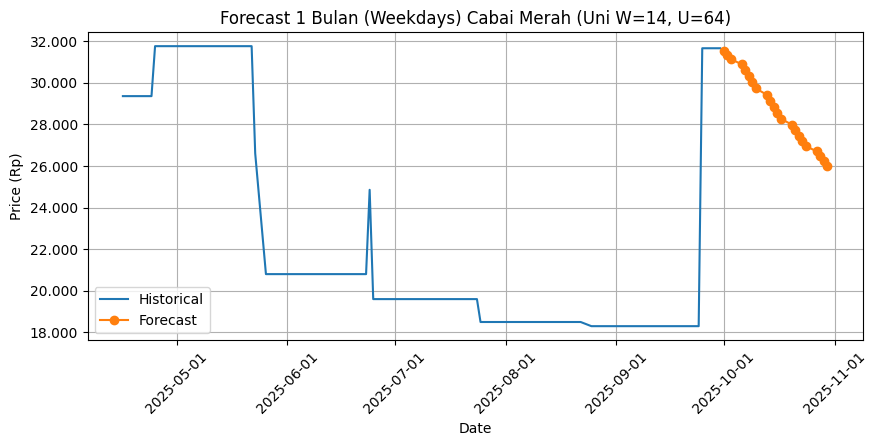

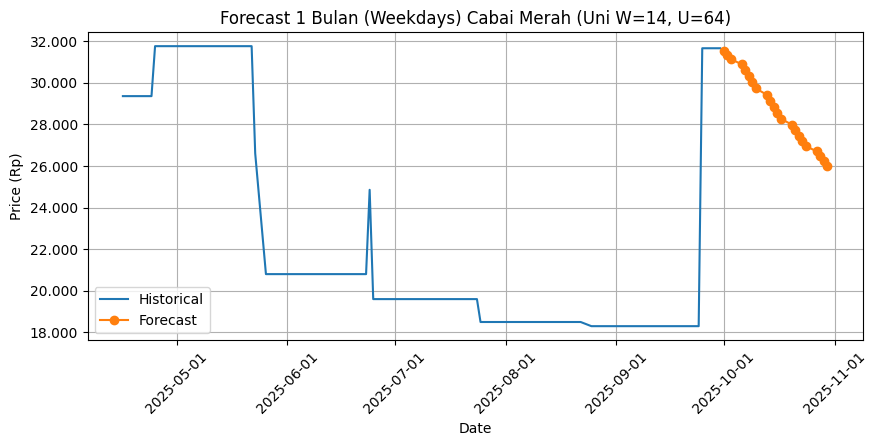


[UNIVARIATE] Target=Cabai Merah | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - loss: 0.0498 - val_loss: 0.0199
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0114 - val_loss: 0.0163
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0097 - val_loss: 0.0139
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0074 - val_loss: 0.0126
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0075 - val_loss: 0.0114
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0069 - val_loss: 0.0112
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0065 - val_loss: 0.0100
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0064 - val_loss: 0.0093
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0058 - val_loss: 0.0093
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0061 - val_loss: 0.0086
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0064 - val_loss: 0.0085
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0

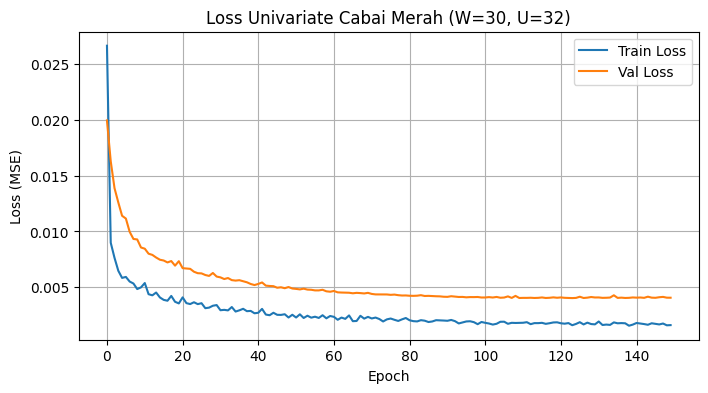

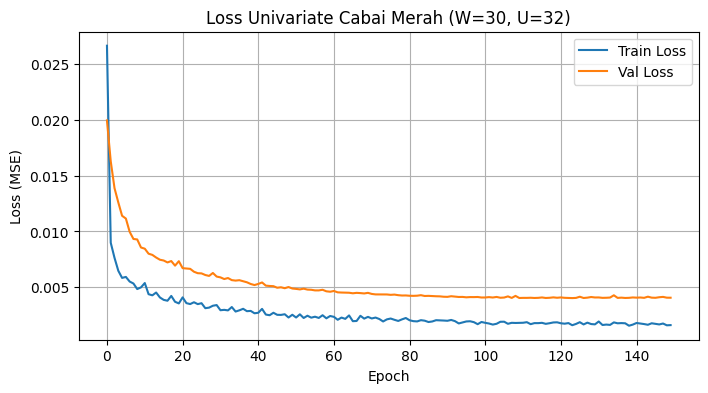

Test MAE  : 353.98
Test RMSE : 1,430.00
Test MAPE : 1.3482%


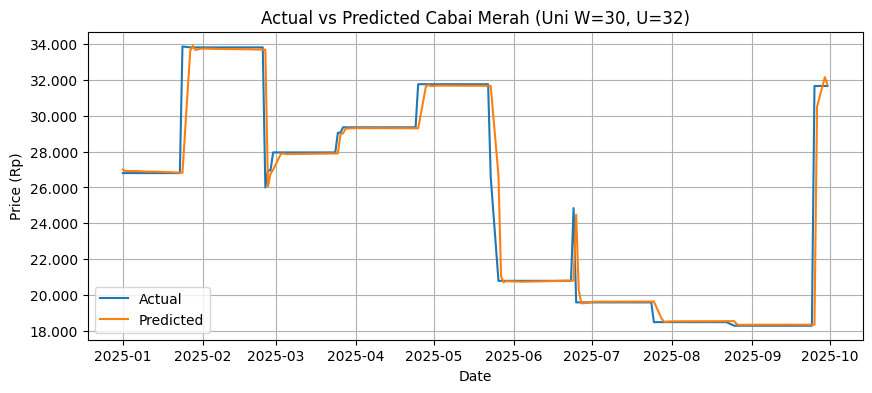

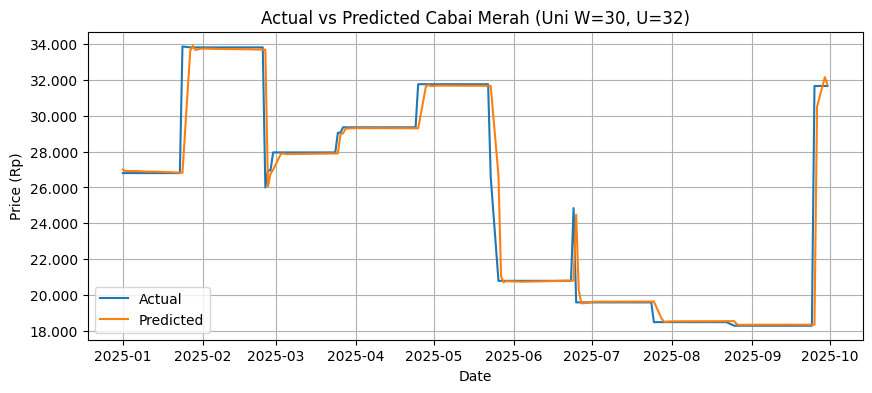


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,31650,31728.363281
1,2025-10-02,31650,31699.345703
2,2025-10-03,31650,31716.978516
3,2025-10-06,31650,31745.656250
4,2025-10-07,31650,31768.158203
5,2025-10-08,31650,31780.765625
6,2025-10-09,31650,31786.000000
7,2025-10-10,31650,31787.285156
8,2025-10-13,31650,31786.658203
9,2025-10-14,31650,31784.408203


Forecast MAPE Okt 2025 : 0.9220%
Compare CSV disimpan: compare_Okt2025_uni_W30_U32.csv


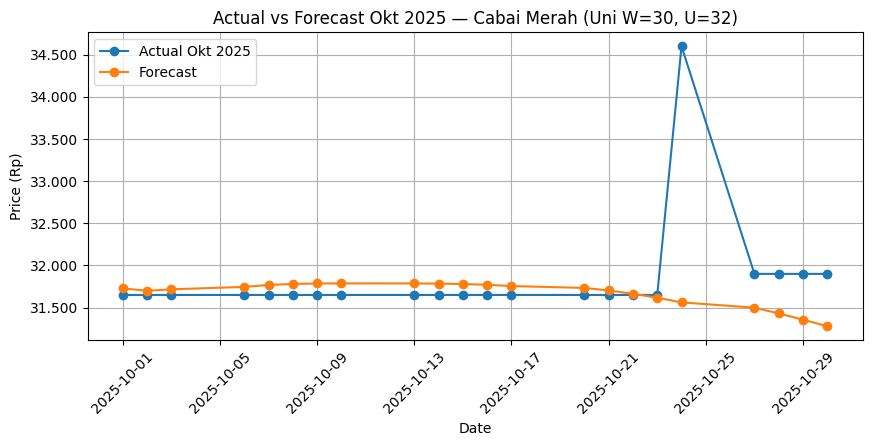

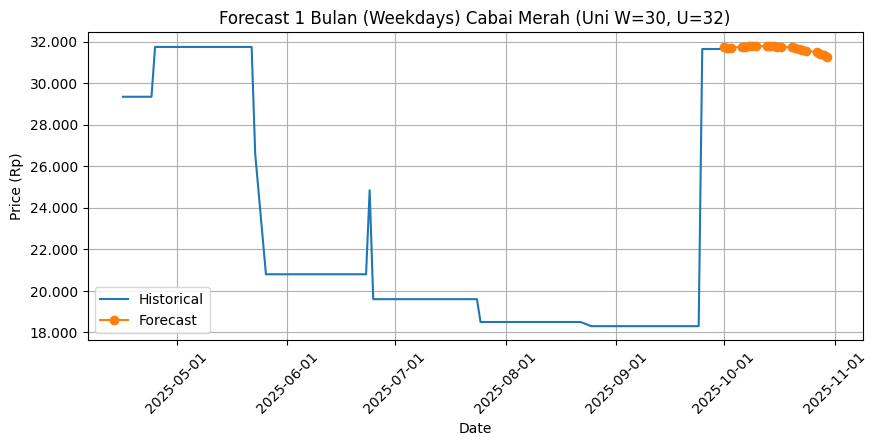

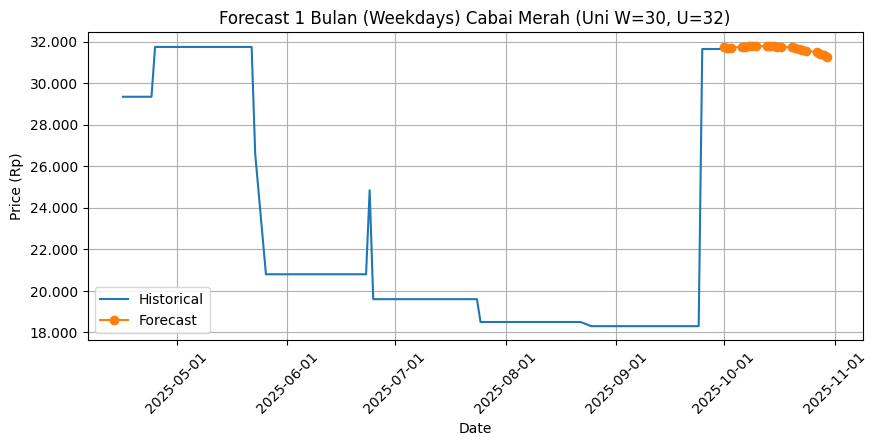


[UNIVARIATE] Target=Cabai Merah | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 25ms/step - loss: 0.0553 - val_loss: 0.0176
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0112 - val_loss: 0.0156
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0087 - val_loss: 0.0135
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0074 - val_loss: 0.0118
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0074 - val_loss: 0.0117
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 0.0063 - val_loss: 0.0105
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0056 - val_loss: 0.0096
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0053 - val_loss: 0.0091
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0049 - val_loss: 0.0094
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0055 - val_loss: 0.0086
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0050 - val_loss: 0.0082
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0

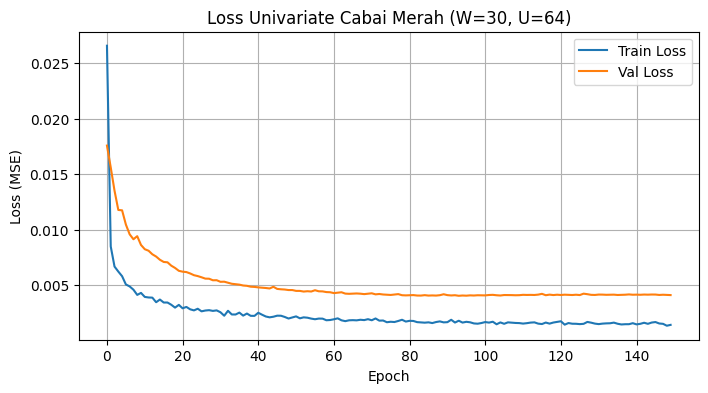

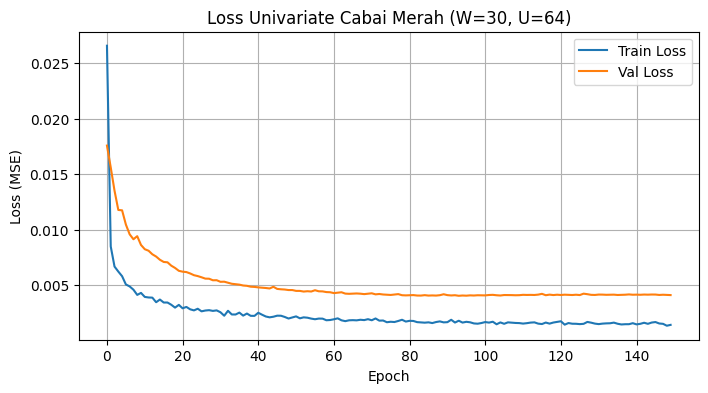

Test MAE  : 388.55
Test RMSE : 1,429.46
Test MAPE : 1.4497%


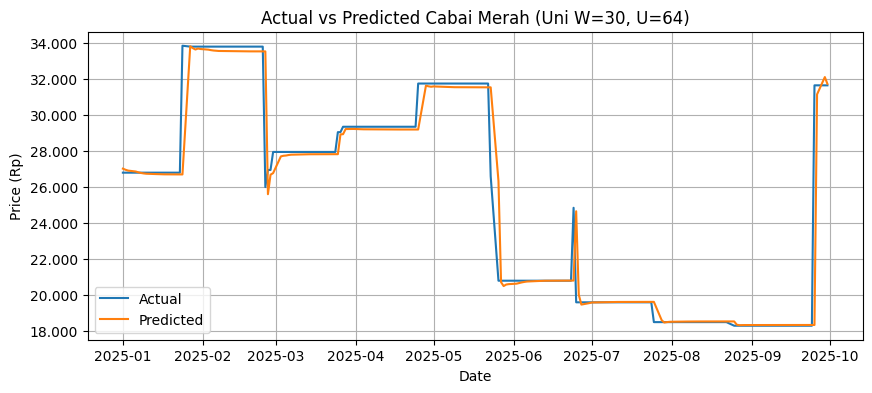

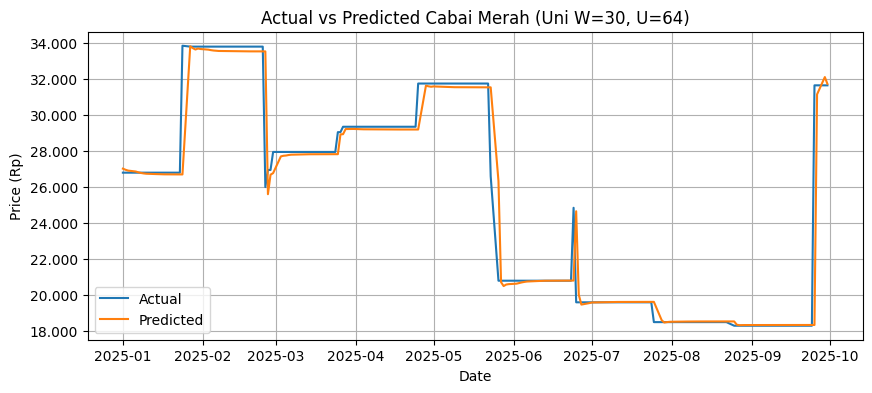


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,31650,31729.119141
1,2025-10-02,31650,31820.027344
2,2025-10-03,31650,31873.408203
3,2025-10-06,31650,31857.677734
4,2025-10-07,31650,31784.035156
5,2025-10-08,31650,31667.445312
6,2025-10-09,31650,31520.732422
7,2025-10-10,31650,31353.455078
8,2025-10-13,31650,31172.400391
9,2025-10-14,31650,30982.341797


Forecast MAPE Okt 2025 : 4.1680%
Compare CSV disimpan: compare_Okt2025_uni_W30_U64.csv


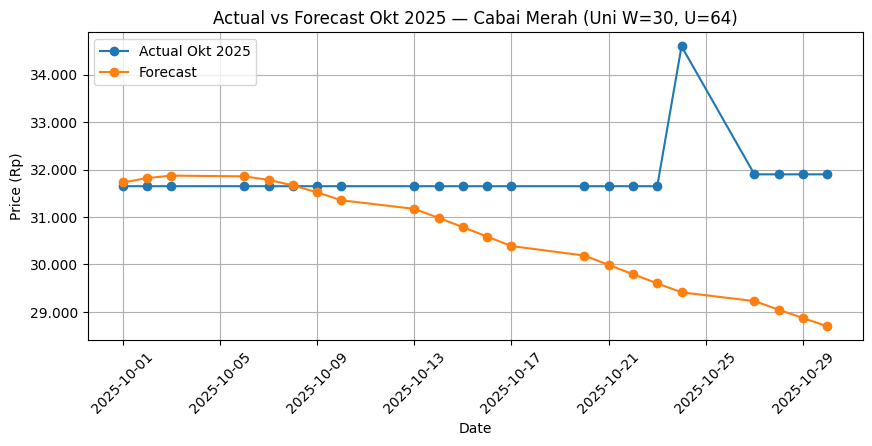

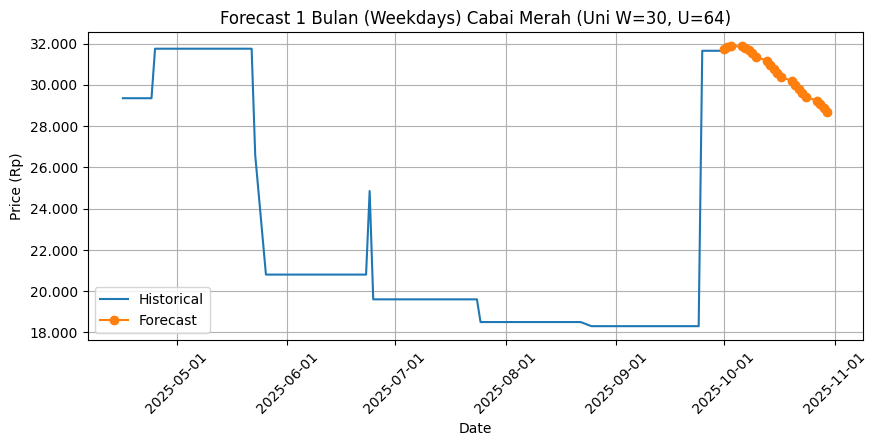

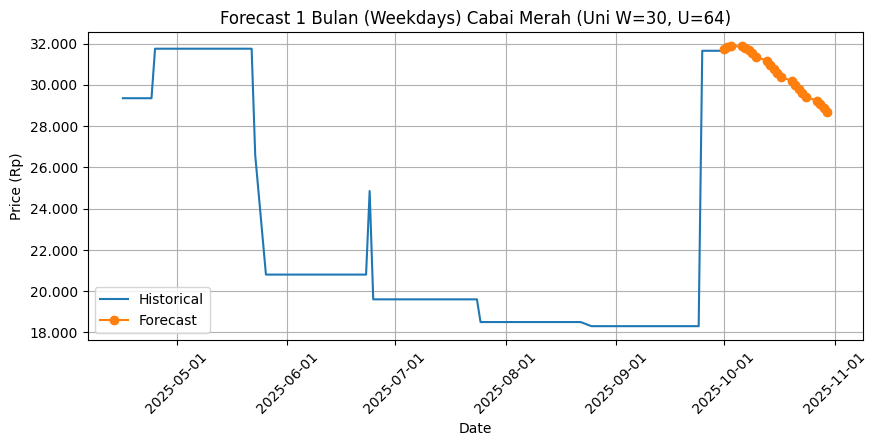


Rekap univariate Cabai Merah disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate\Cabai_Merah\hasil_univariate_Cabai_Merah.csv

==================== UNIVARIATE: Cabai Rawit ====================

[UNIVARIATE] Target=Cabai Rawit | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - loss: 0.1186 - val_loss: 0.0154
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0229 - val_loss: 0.0102
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0131 - val_loss: 0.0102
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0117 - val_loss: 0.0100
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0118 - val_loss: 0.0097
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0113 - val_loss: 0.0094
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0110 - val_loss: 0.0091
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0102 - val_loss: 0.0091
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0099 - val_loss: 0.0087
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0096 - val_loss: 0.0080
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0091 - val_loss: 0.0077
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0089 - val_l

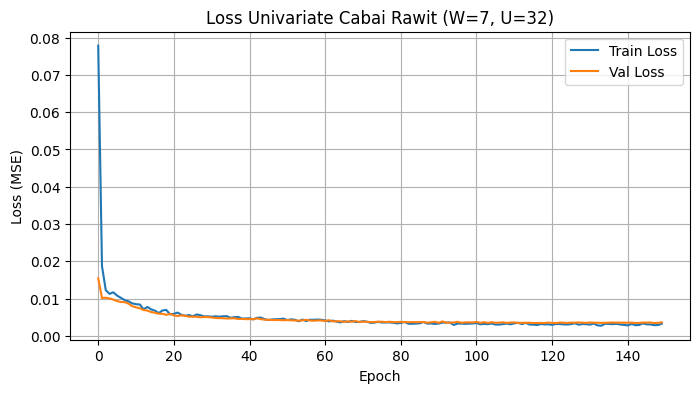

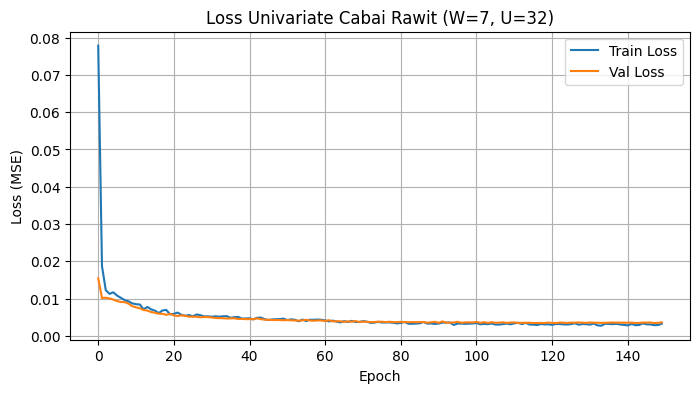

Test MAE  : 968.00
Test RMSE : 2,355.89
Test MAPE : 3.8067%


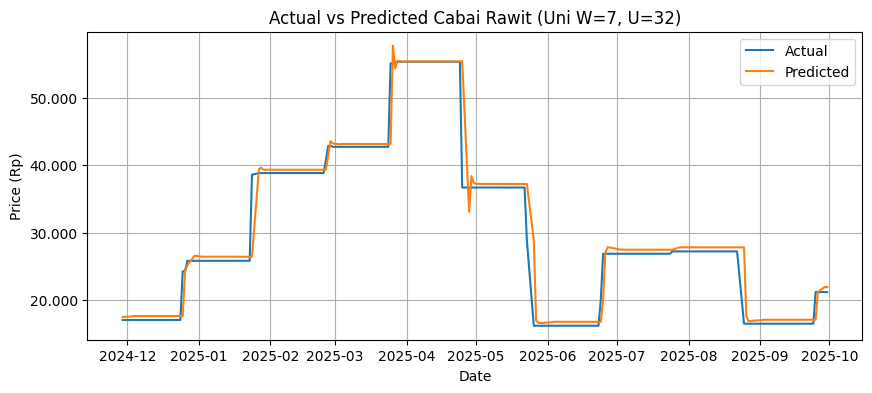

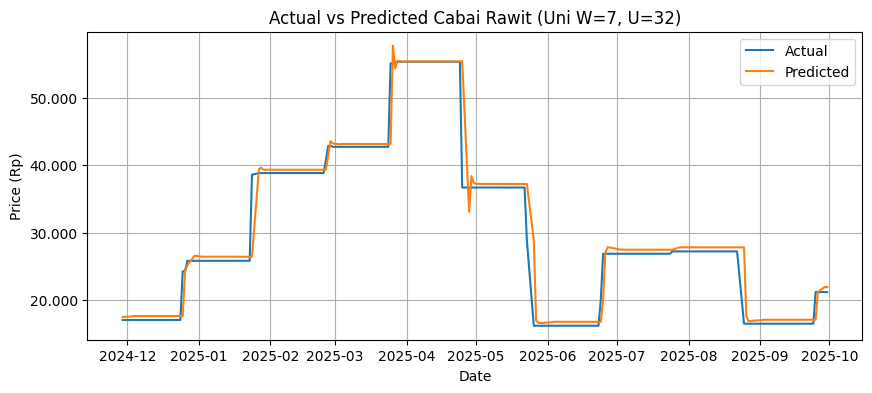


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,21150,21895.599609
1,2025-10-02,21150,22515.548828
2,2025-10-03,21150,23134.531250
3,2025-10-06,21150,23749.984375
4,2025-10-07,21150,24364.306641
5,2025-10-08,21150,24983.548828
6,2025-10-09,21150,25605.056641
7,2025-10-10,21150,26227.814453
8,2025-10-13,21150,26851.753906
9,2025-10-14,21150,27476.472656


Forecast MAPE Okt 2025 : 48.0147%
Compare CSV disimpan: compare_Okt2025_uni_W7_U32.csv


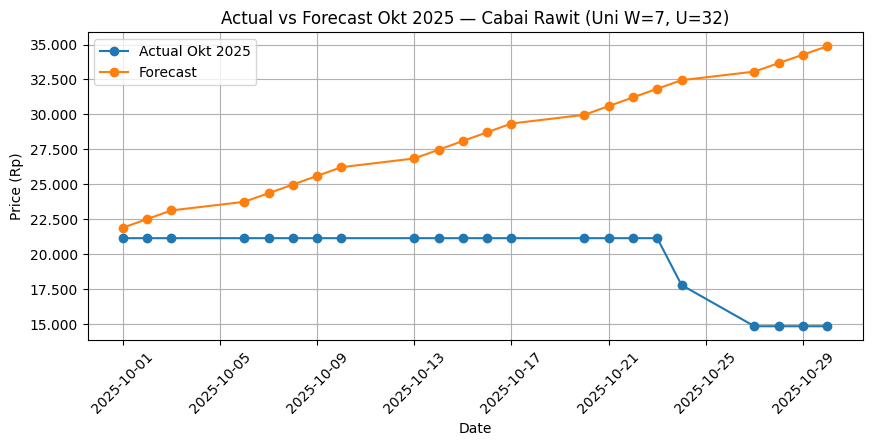

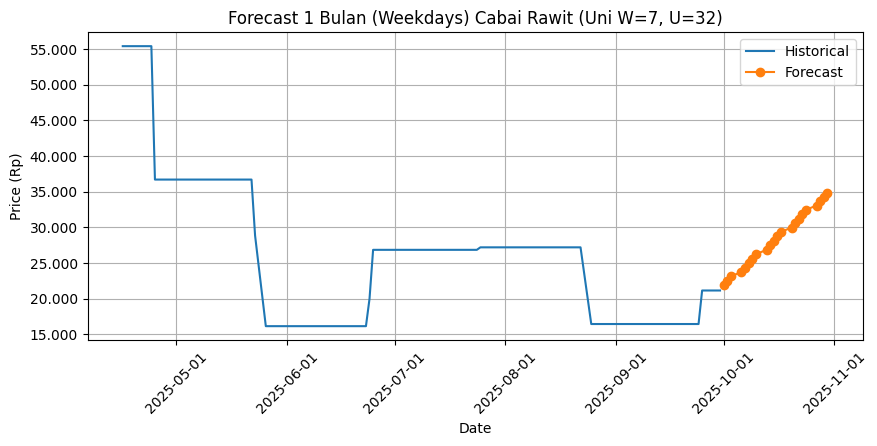

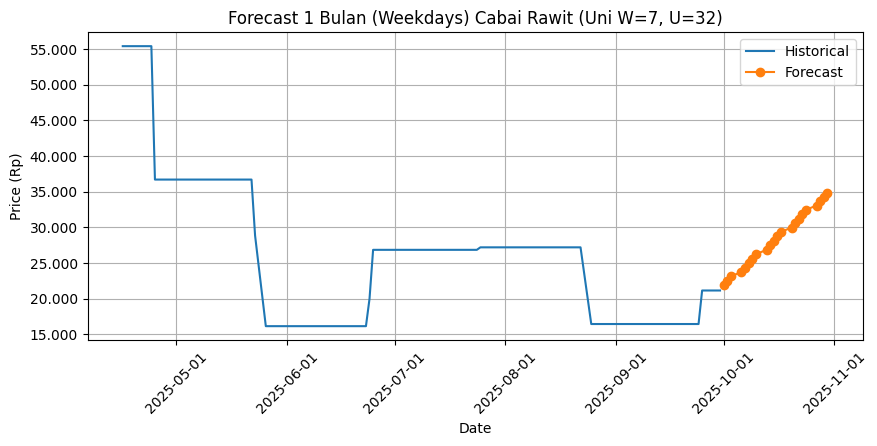


[UNIVARIATE] Target=Cabai Rawit | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - loss: 0.1047 - val_loss: 0.0123
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0147 - val_loss: 0.0105
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0108 - val_loss: 0.0103
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0107 - val_loss: 0.0098
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0100 - val_loss: 0.0095
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0101 - val_loss: 0.0091
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0093 - val_loss: 0.0085
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0093 - val_loss: 0.0081
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0083 - val_loss: 0.0076
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0079 - val_loss: 0.0070
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0078 - val_loss: 0.0067
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0071 - val_l

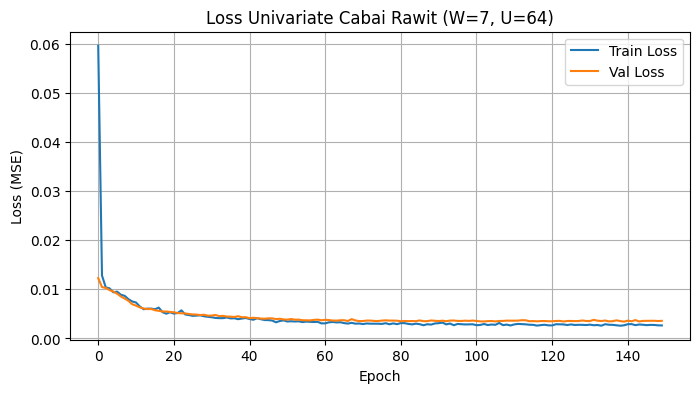

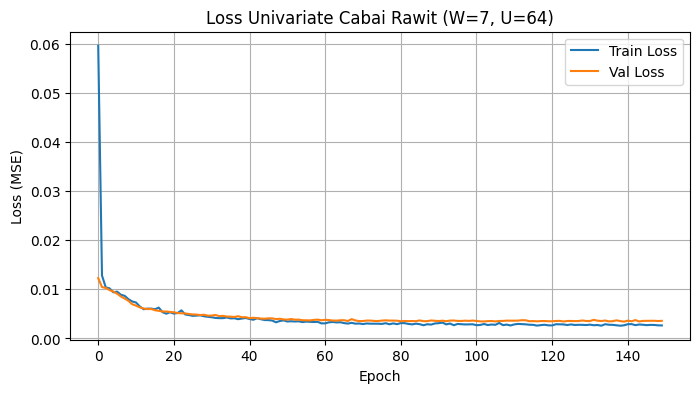

Test MAE  : 889.03
Test RMSE : 2,322.05
Test MAPE : 3.4424%


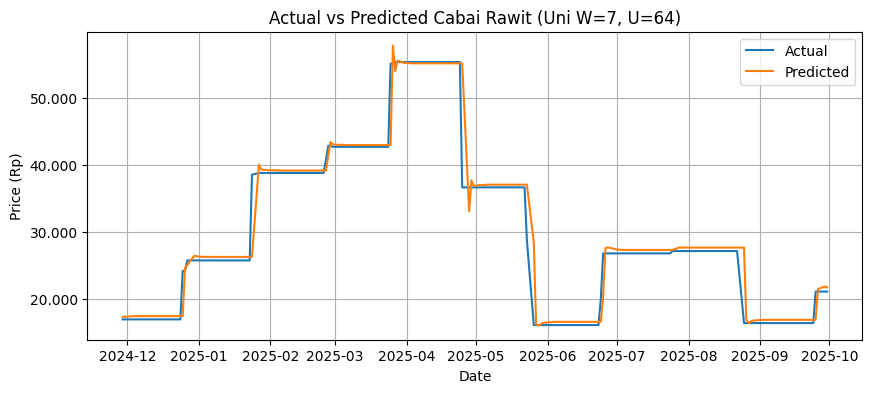

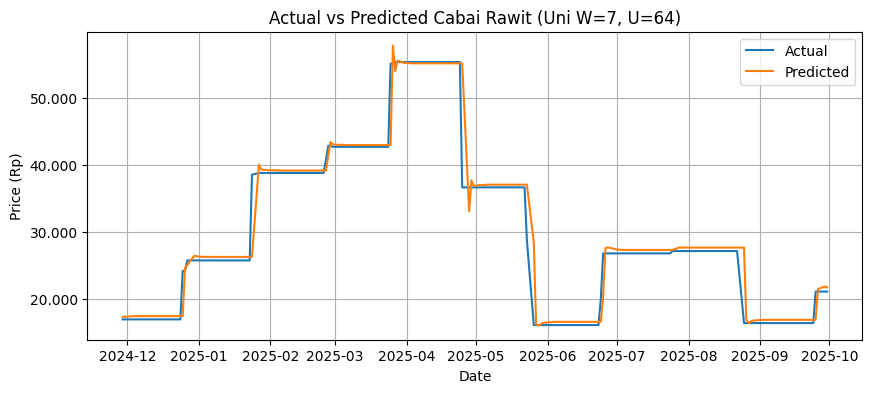


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,21150,21777.990234
1,2025-10-02,21150,22334.470703
2,2025-10-03,21150,22899.064453
3,2025-10-06,21150,23465.292969
4,2025-10-07,21150,24032.320312
5,2025-10-08,21150,24602.787109
6,2025-10-09,21150,25175.169922
7,2025-10-10,21150,25748.468750
8,2025-10-13,21150,26322.259766
9,2025-10-14,21150,26896.019531


Forecast MAPE Okt 2025 : 44.3335%
Compare CSV disimpan: compare_Okt2025_uni_W7_U64.csv


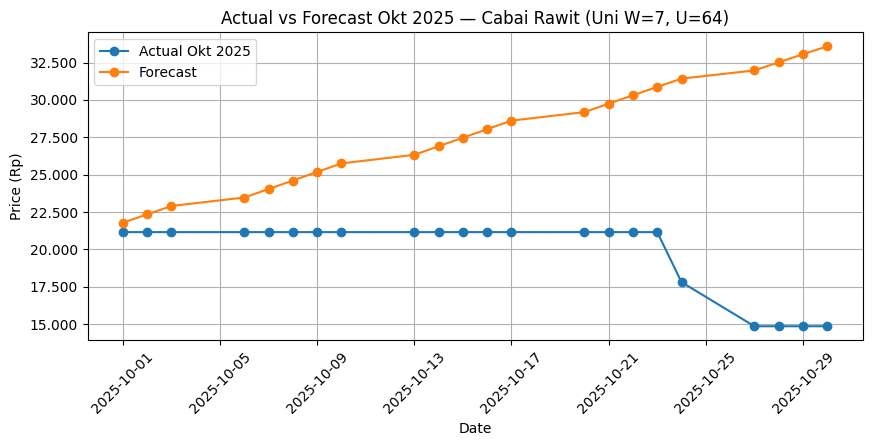

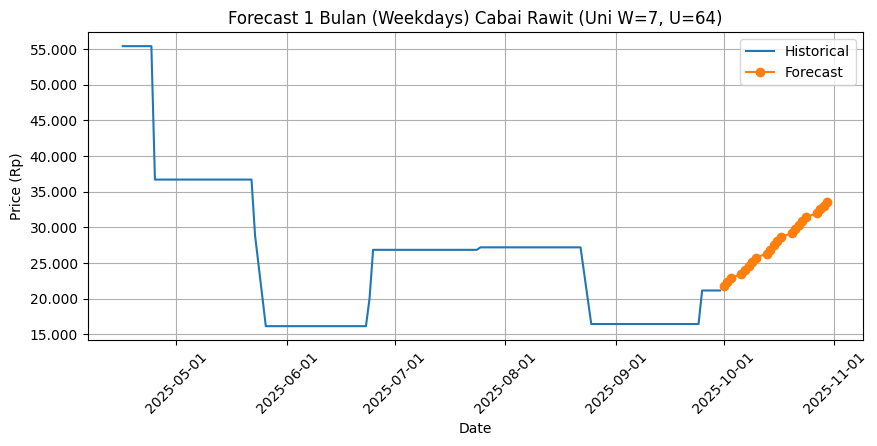

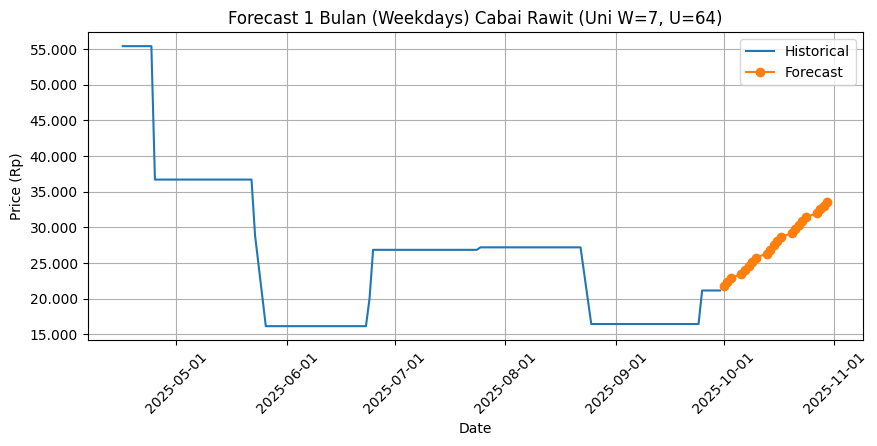


[UNIVARIATE] Target=Cabai Rawit | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.0883 - val_loss: 0.0127
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0157 - val_loss: 0.0103
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0127 - val_loss: 0.0094
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0113 - val_loss: 0.0087
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0106 - val_loss: 0.0076
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0095 - val_loss: 0.0069
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0084 - val_loss: 0.0063
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0070 - val_loss: 0.0059
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0078 - val_loss: 0.0055
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0078 - val_loss: 0.0055
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0070 - val_loss: 0.0054
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0074 - val_l

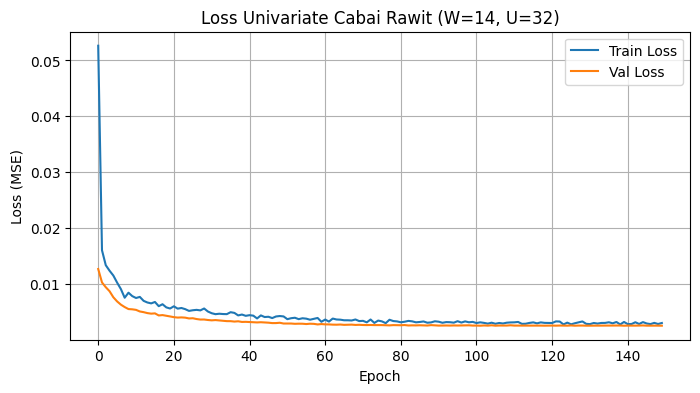

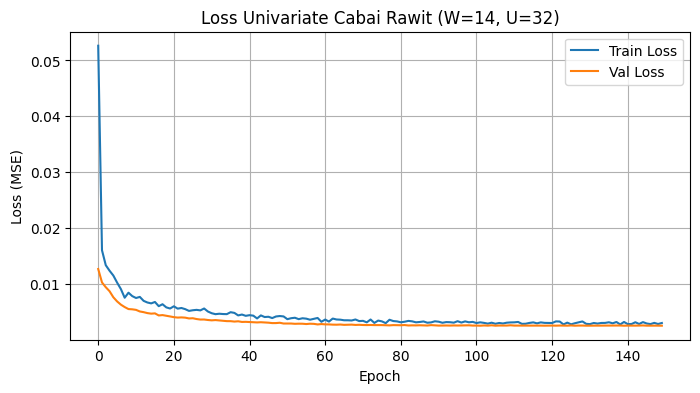

Test MAE  : 937.58
Test RMSE : 2,379.70
Test MAPE : 3.0627%


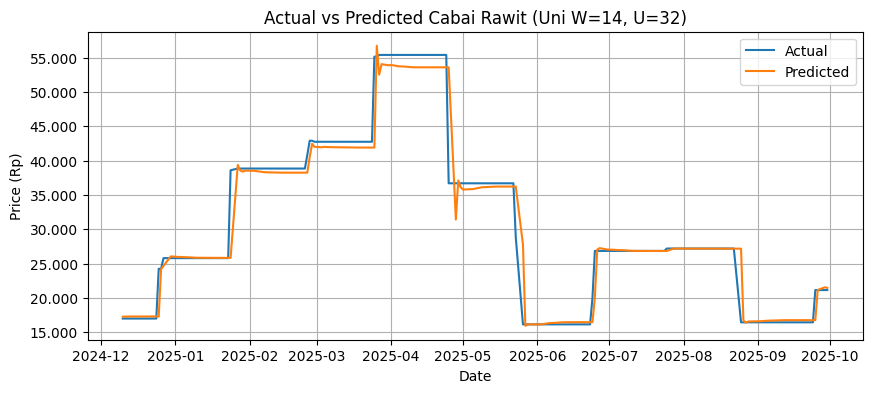

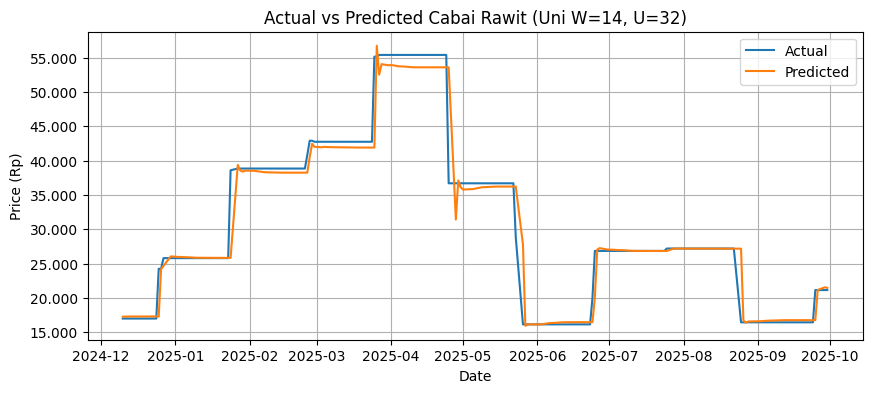


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,21150,21467.169922
1,2025-10-02,21150,21735.953125
2,2025-10-03,21150,22002.541016
3,2025-10-06,21150,22259.228516
4,2025-10-07,21150,22502.074219
5,2025-10-08,21150,22728.710938
6,2025-10-09,21150,22938.619141
7,2025-10-10,21150,23132.626953
8,2025-10-13,21150,23312.281250
9,2025-10-14,21150,23479.328125


Forecast MAPE Okt 2025 : 21.2511%
Compare CSV disimpan: compare_Okt2025_uni_W14_U32.csv


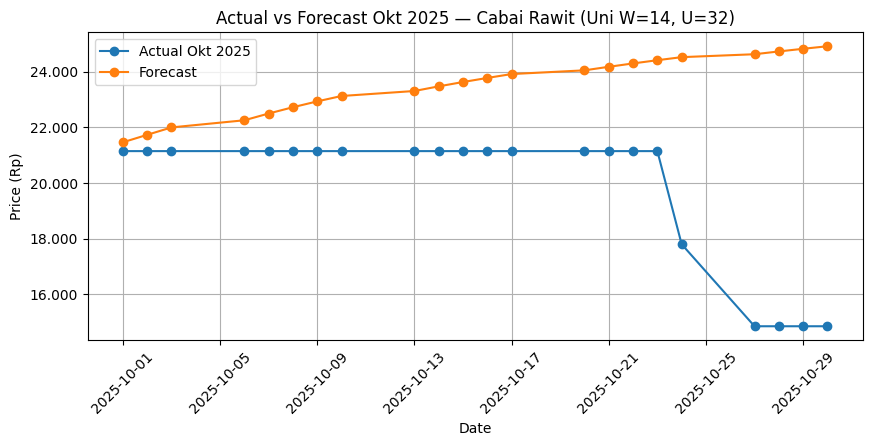

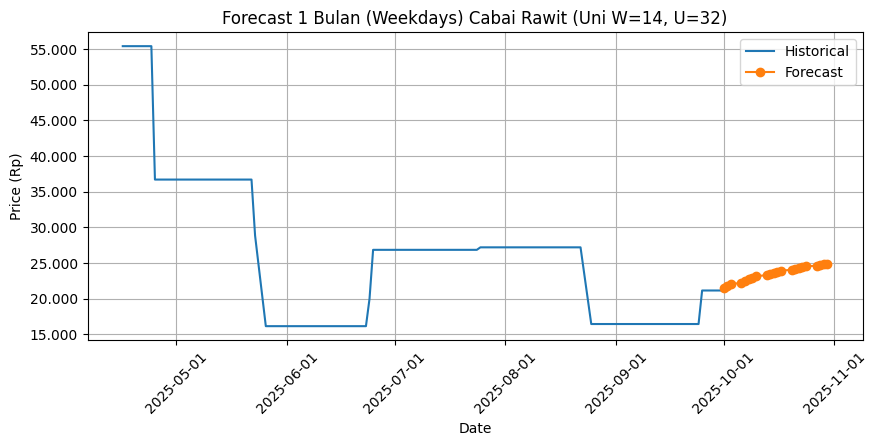

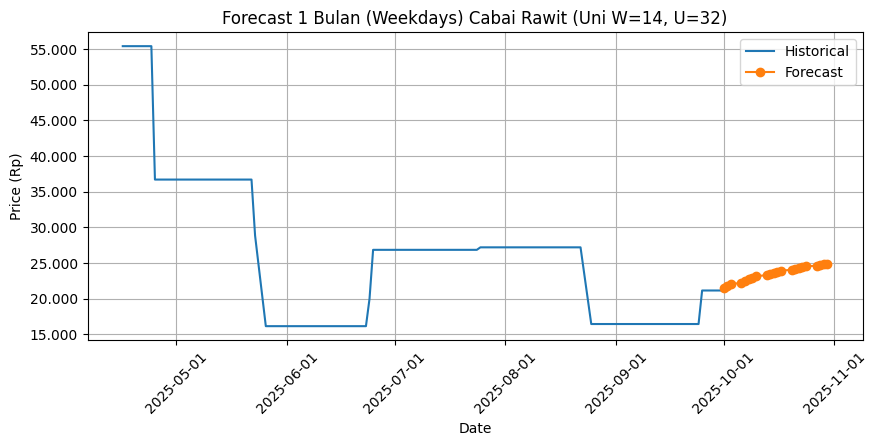


[UNIVARIATE] Target=Cabai Rawit | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.0543 - val_loss: 0.0112
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0123 - val_loss: 0.0097
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0097 - val_loss: 0.0082
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0089 - val_loss: 0.0070
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0077 - val_loss: 0.0061
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0071 - val_loss: 0.0062
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0070 - val_loss: 0.0058
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0068 - val_loss: 0.0056
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0063 - val_loss: 0.0050
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0064 - val_loss: 0.0048
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0052 - val_loss: 0.0048
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0055 - va

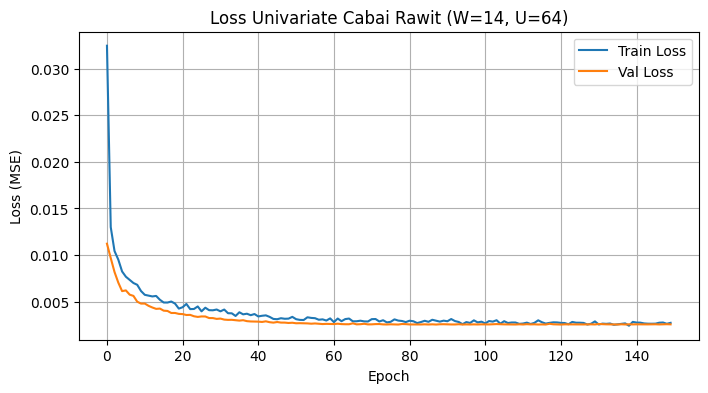

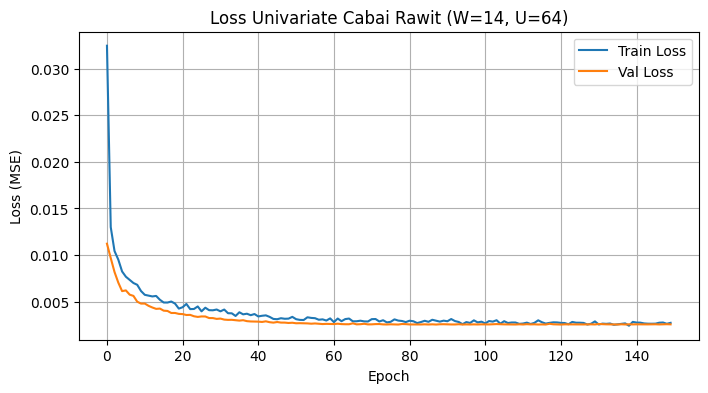

Test MAE  : 835.80
Test RMSE : 2,334.22
Test MAPE : 2.8668%


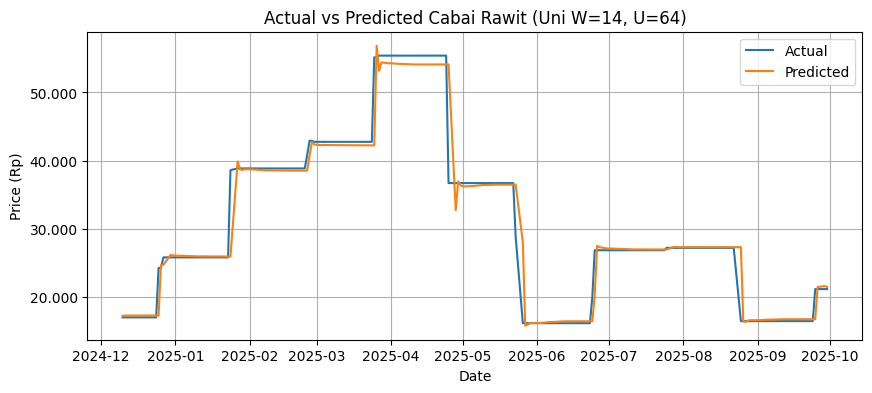

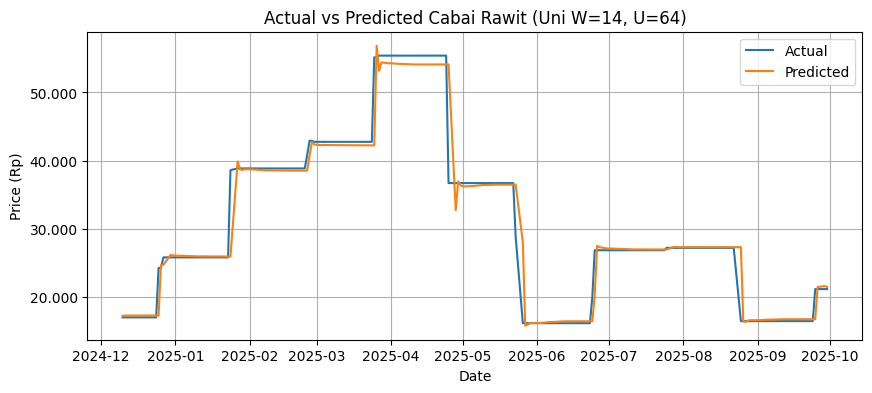


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,21150,21468.865234
1,2025-10-02,21150,21767.824219
2,2025-10-03,21150,22072.896484
3,2025-10-06,21150,22373.636719
4,2025-10-07,21150,22664.753906
5,2025-10-08,21150,22943.984375
6,2025-10-09,21150,23210.896484
7,2025-10-10,21150,23465.992188
8,2025-10-13,21150,23710.181641
9,2025-10-14,21150,23944.460938


Forecast MAPE Okt 2025 : 24.5900%
Compare CSV disimpan: compare_Okt2025_uni_W14_U64.csv


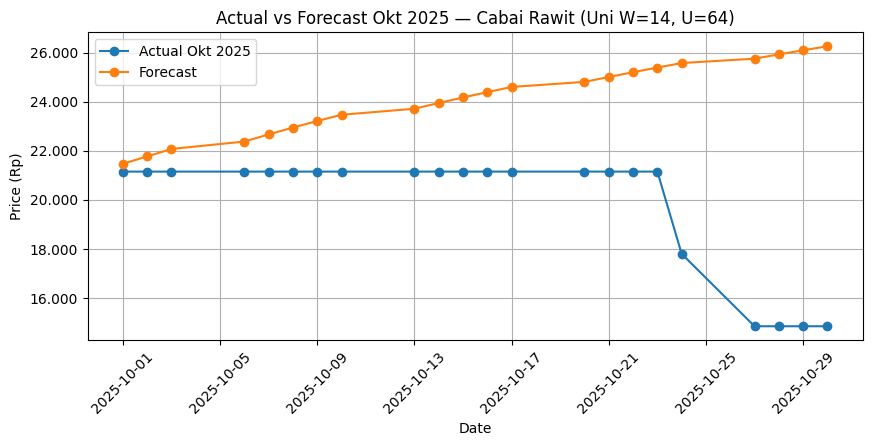

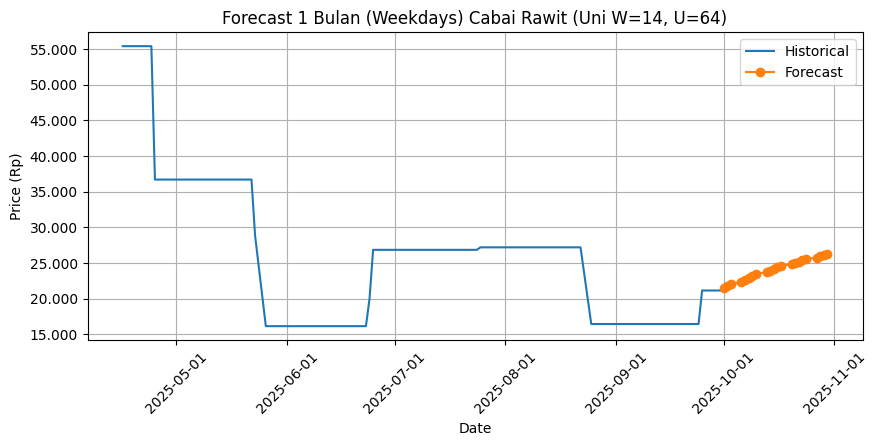

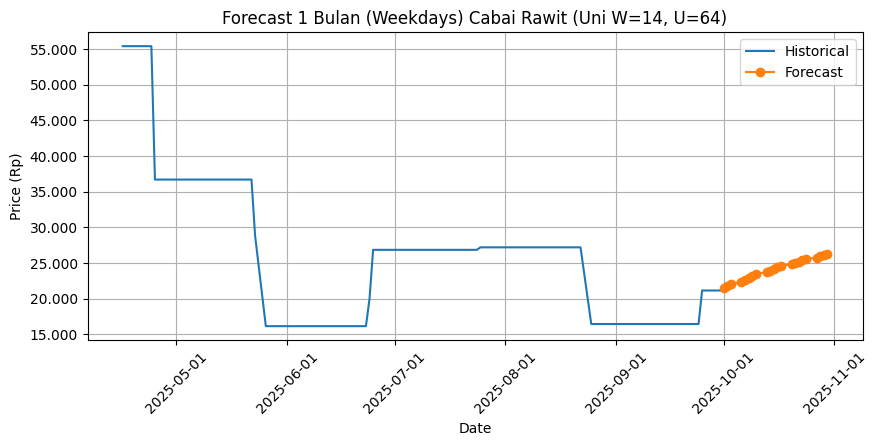

c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)



[UNIVARIATE] Target=Cabai Rawit | W=30 | Units=32
Training mulai...
Epoch 1/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - loss: 0.1173 - val_loss: 0.0128
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0184 - val_loss: 0.0104
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0154 - val_loss: 0.0097
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0129 - val_loss: 0.0086
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0124 - val_loss: 0.0077
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0116 - val_loss: 0.0072
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0110 - val_loss: 0.0067
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0095 - val_loss: 0.0066
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0099 - val_loss: 0.0061
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0091 - val_loss: 0.0060
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0093 - 

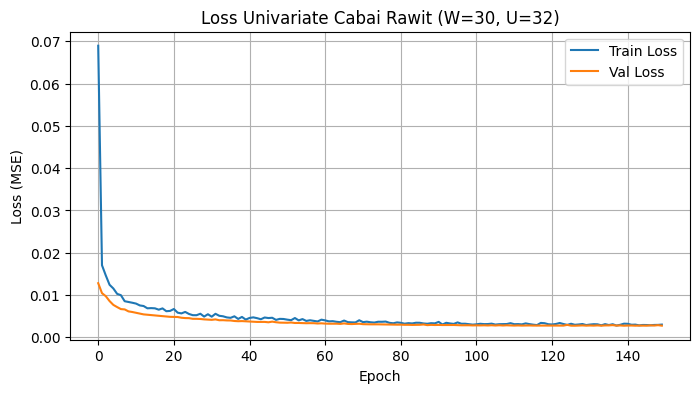

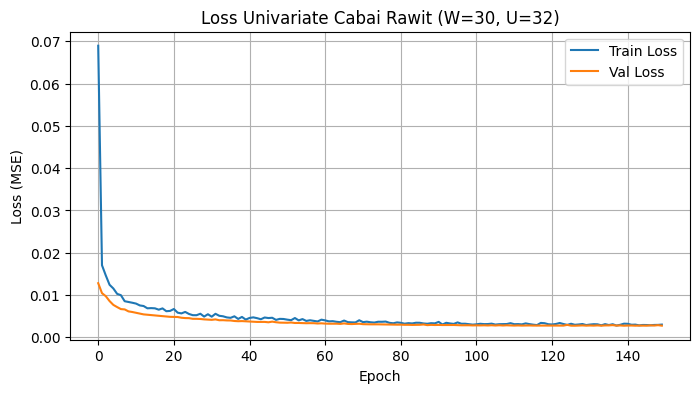

Test MAE  : 835.13
Test RMSE : 2,399.92
Test MAPE : 2.6720%


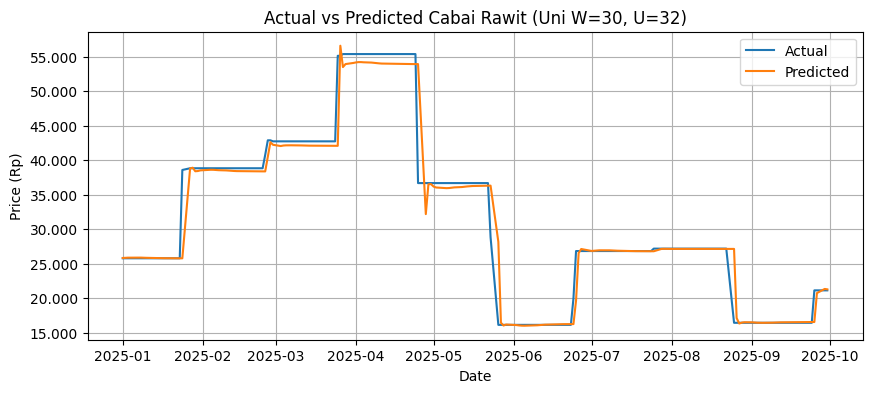

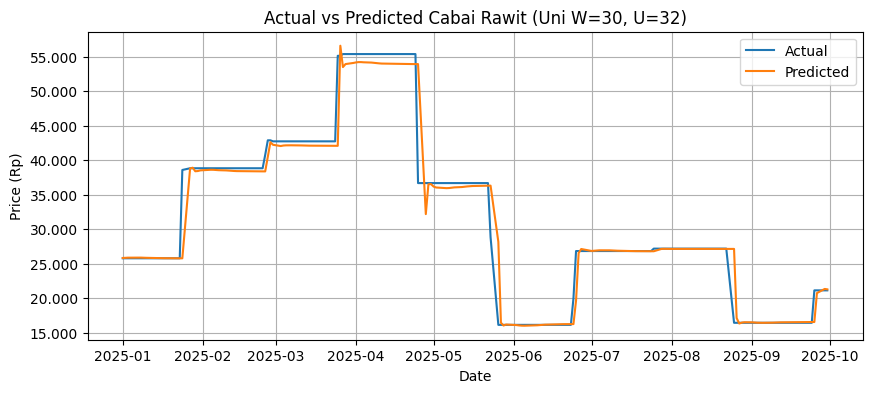


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,21150,21297.671875
1,2025-10-02,21150,21383.933594
2,2025-10-03,21150,21475.353516
3,2025-10-06,21150,21579.041016
4,2025-10-07,21150,21693.396484
5,2025-10-08,21150,21813.085938
6,2025-10-09,21150,21932.593750
7,2025-10-10,21150,22047.824219
8,2025-10-13,21150,22156.416016
9,2025-10-14,21150,22257.472656


Forecast MAPE Okt 2025 : 14.7647%
Compare CSV disimpan: compare_Okt2025_uni_W30_U32.csv


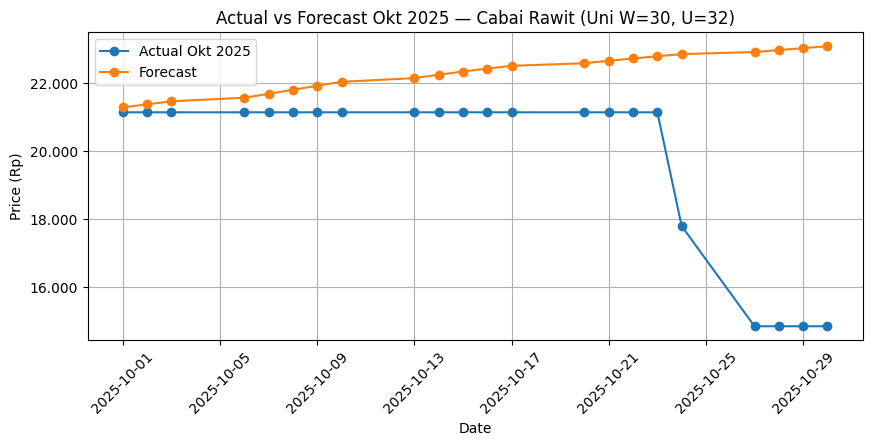

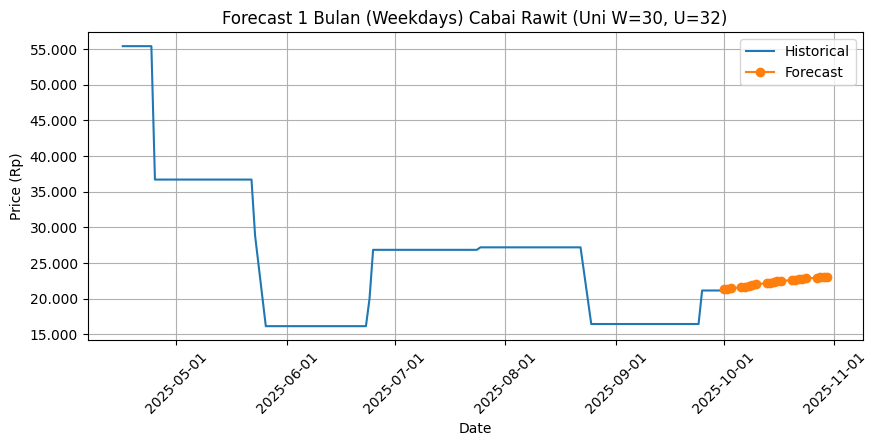

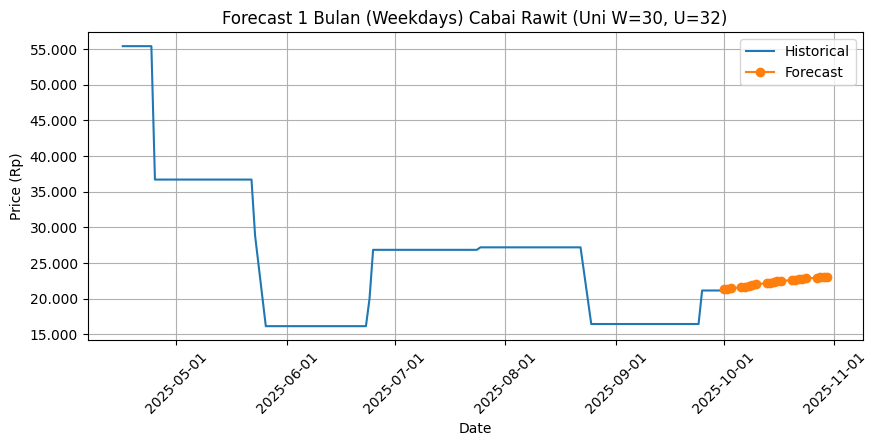


[UNIVARIATE] Target=Cabai Rawit | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - loss: 0.0827 - val_loss: 0.0134
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0168 - val_loss: 0.0101
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0124 - val_loss: 0.0086
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0107 - val_loss: 0.0077
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0104 - val_loss: 0.0070
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0092 - val_loss: 0.0065
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0087 - val_loss: 0.0062
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0085 - val_loss: 0.0060
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0085 - val_loss: 0.0057
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0080 - val_loss: 0.0056
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0070 - val_loss: 0.0057
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0

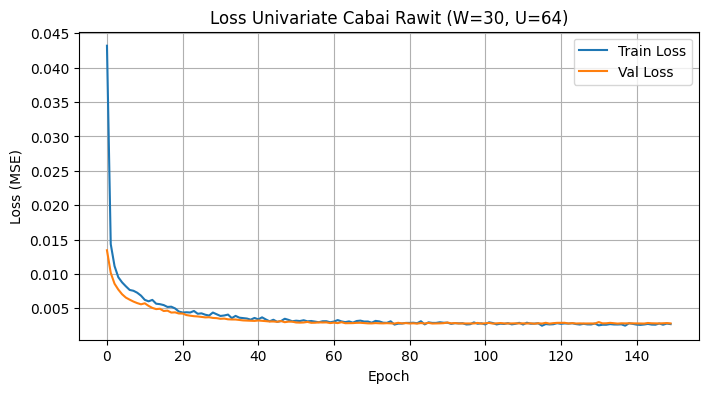

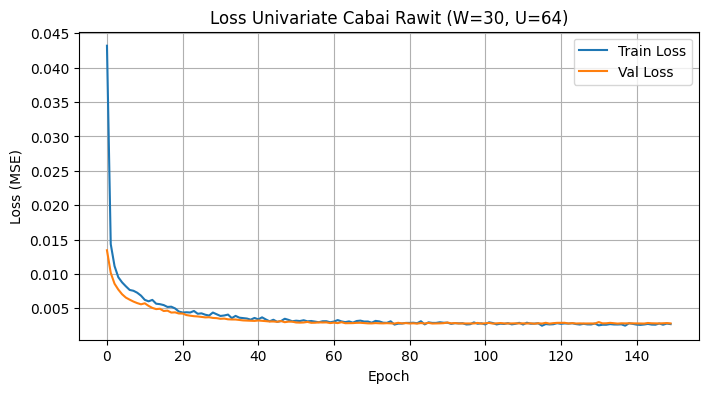

Test MAE  : 774.46
Test RMSE : 2,376.28
Test MAPE : 2.5628%


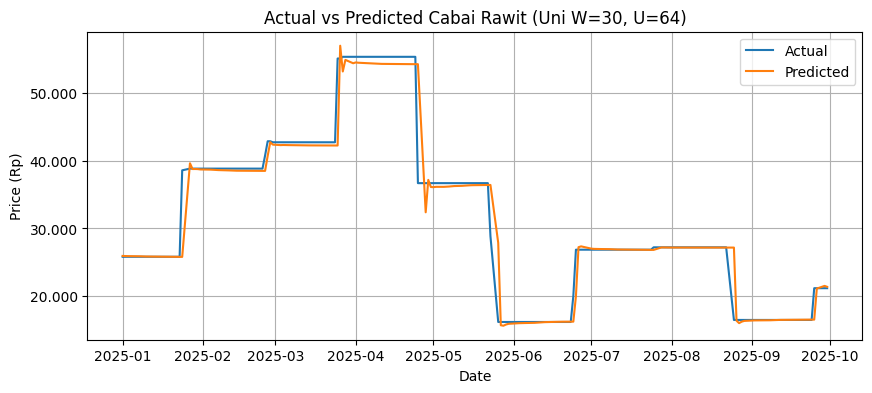

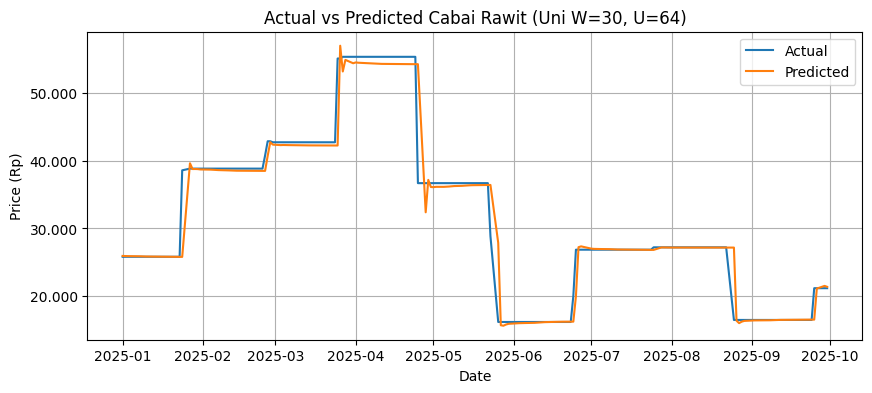


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,21150,21352.240234
1,2025-10-02,21150,21476.832031
2,2025-10-03,21150,21584.632812
3,2025-10-06,21150,21686.375000
4,2025-10-07,21150,21786.576172
5,2025-10-08,21150,21884.798828
6,2025-10-09,21150,21978.984375
7,2025-10-10,21150,22067.263672
8,2025-10-13,21150,22148.521484
9,2025-10-14,21150,22222.421875


Forecast MAPE Okt 2025 : 14.2307%
Compare CSV disimpan: compare_Okt2025_uni_W30_U64.csv


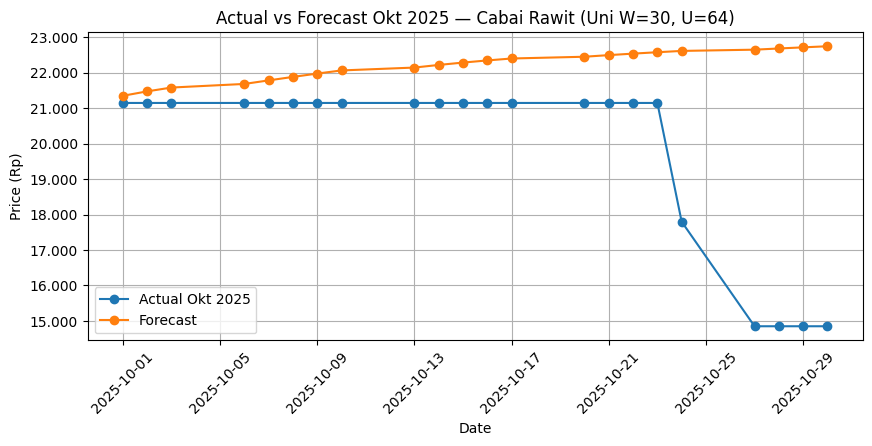

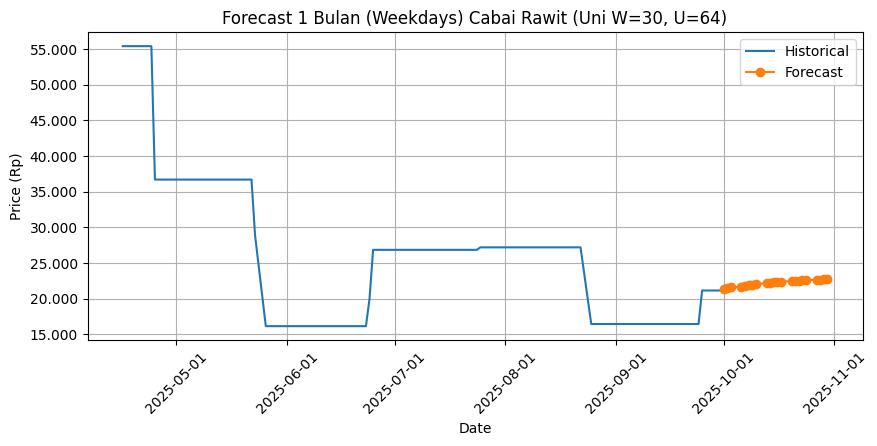

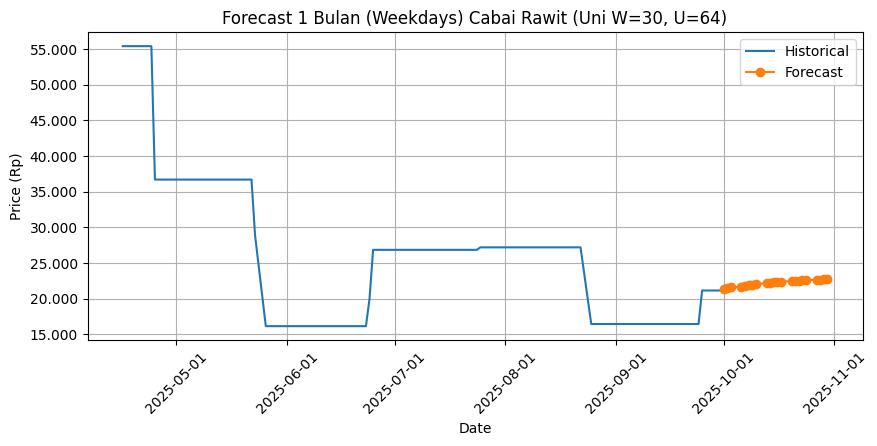


Rekap univariate Cabai Rawit disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate\Cabai_Rawit\hasil_univariate_Cabai_Rawit.csv

==================== UNIVARIATE: Minyak Goreng ====================

[UNIVARIATE] Target=Minyak Goreng | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 0.1813 - val_loss: 8.8327e-04
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0160 - val_loss: 0.0057
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0099 - val_loss: 0.0013
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0083 - val_loss: 2.1051e-04
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0074 - val_loss: 1.8376e-04
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0068 - val_loss: 1.4091e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0064 - val_loss: 8.8994e-05
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0060 - val_loss: 1.0009e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0065 - val_loss: 1.6371e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0052 - val_loss: 4.5402e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0052 - val_loss: 2.0155e-04
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━

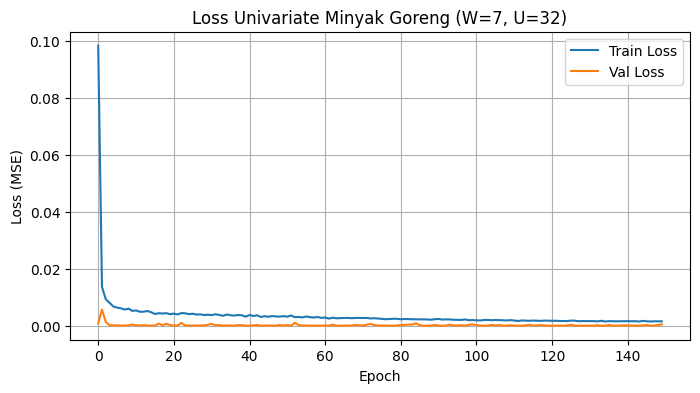

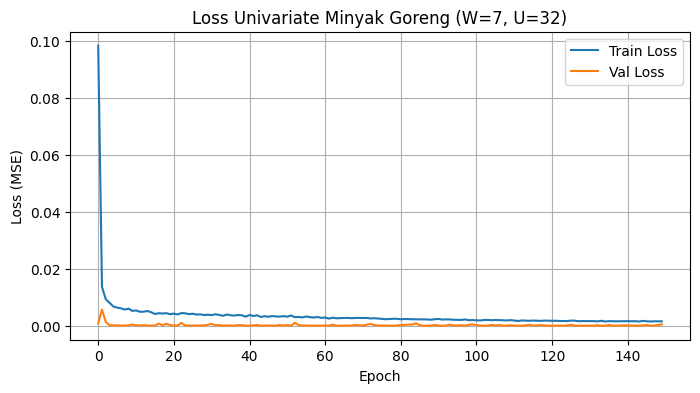

Test MAE  : 145.06
Test RMSE : 156.56
Test MAPE : 1.0760%


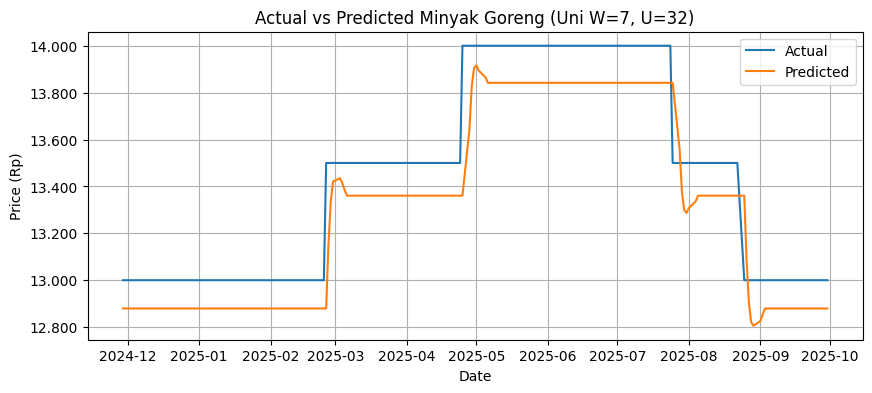

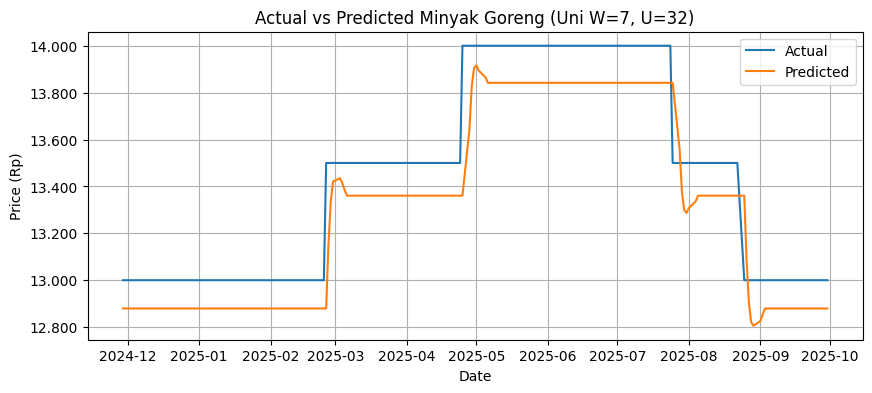


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13000,12879.491211
1,2025-10-02,13000,12813.959961
2,2025-10-03,13000,12734.551758
3,2025-10-06,13000,12647.423828
4,2025-10-07,13000,12556.676758
5,2025-10-08,13000,12465.301758
6,2025-10-09,13000,12375.425781
7,2025-10-10,13000,12288.582031
8,2025-10-13,13000,12202.025391
9,2025-10-14,13000,12118.220703


Forecast MAPE Okt 2025 : 7.3626%
Compare CSV disimpan: compare_Okt2025_uni_W7_U32.csv


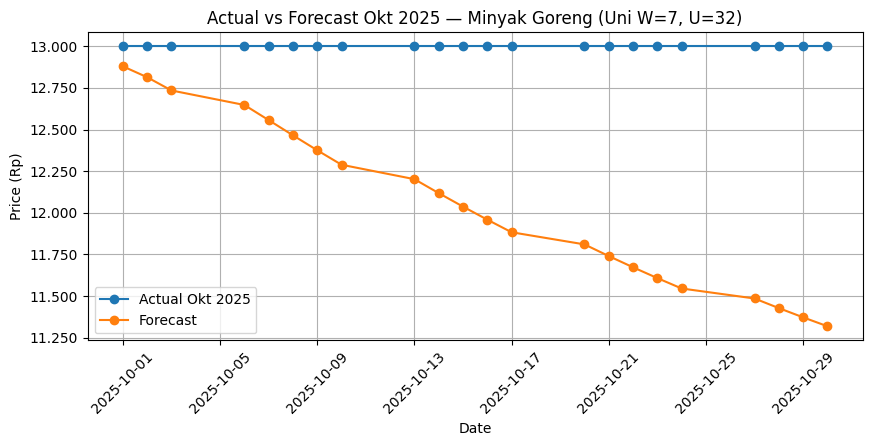

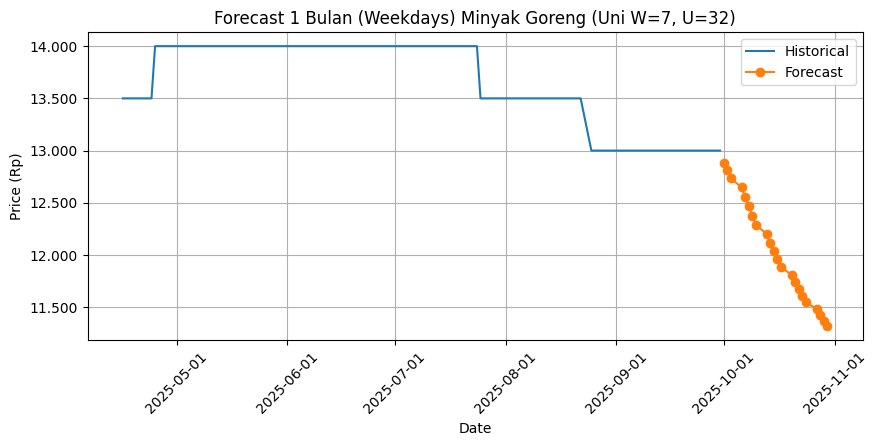

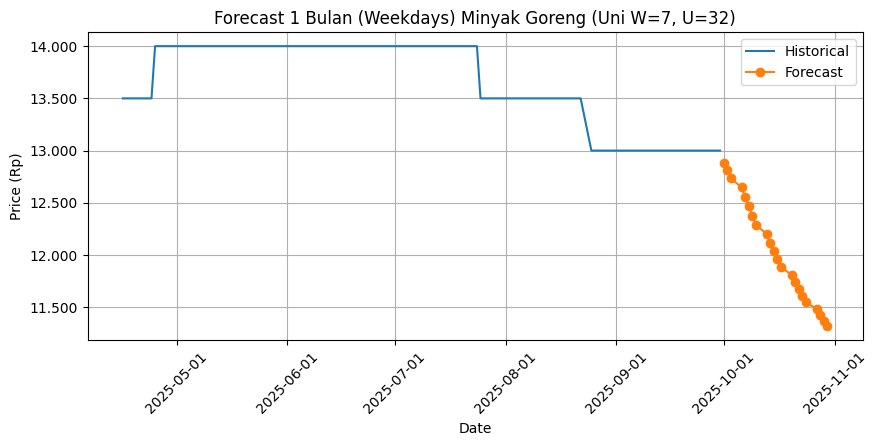


[UNIVARIATE] Target=Minyak Goreng | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - loss: 0.2059 - val_loss: 6.5358e-04
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0096 - val_loss: 4.0062e-04
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0071 - val_loss: 8.5961e-05
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0053 - val_loss: 2.0095e-04
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0052 - val_loss: 1.3516e-04
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0055 - val_loss: 1.3975e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0050 - val_loss: 8.6028e-05
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0047 - val_loss: 8.2664e-05
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0046 - val_loss: 8.7465e-05
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0046 - val_loss: 9.6859e-05
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0041 - val_loss: 1.1481e-04
Epoch 12/150
33/33 ━━━━━━━━━━

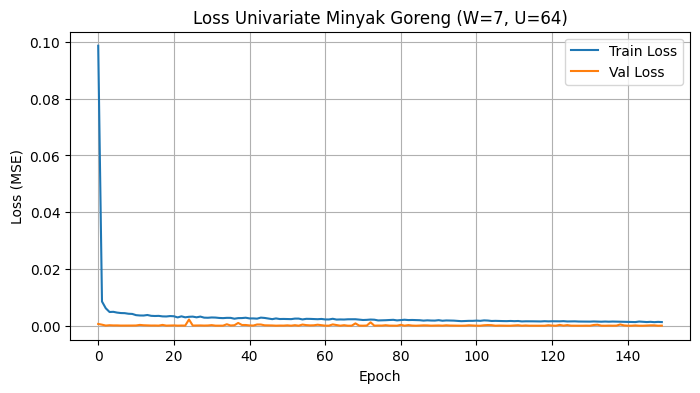

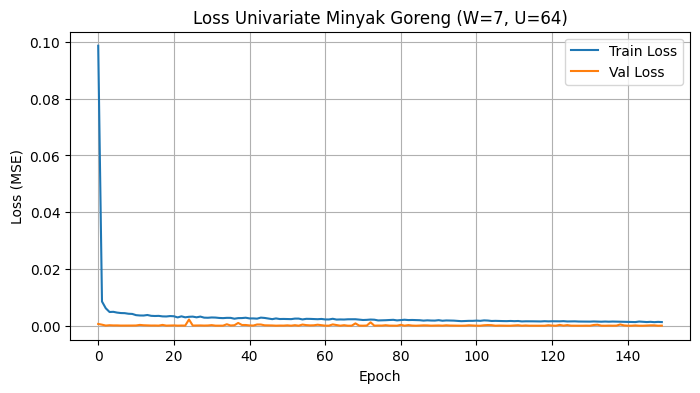

Test MAE  : 46.61
Test RMSE : 80.54
Test MAPE : 0.3455%


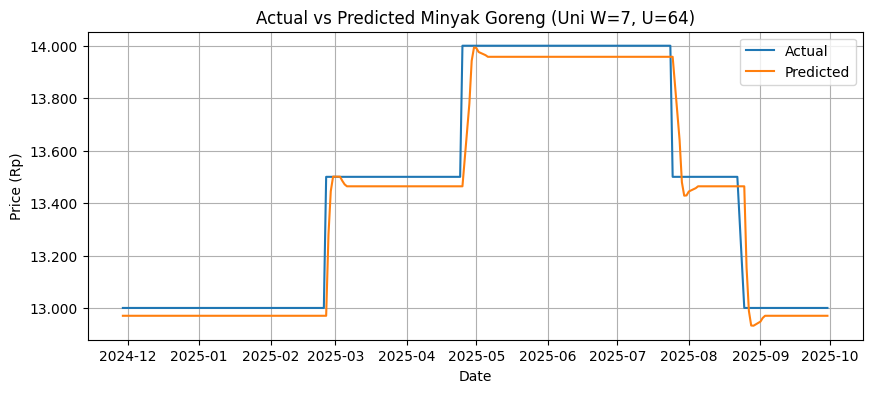

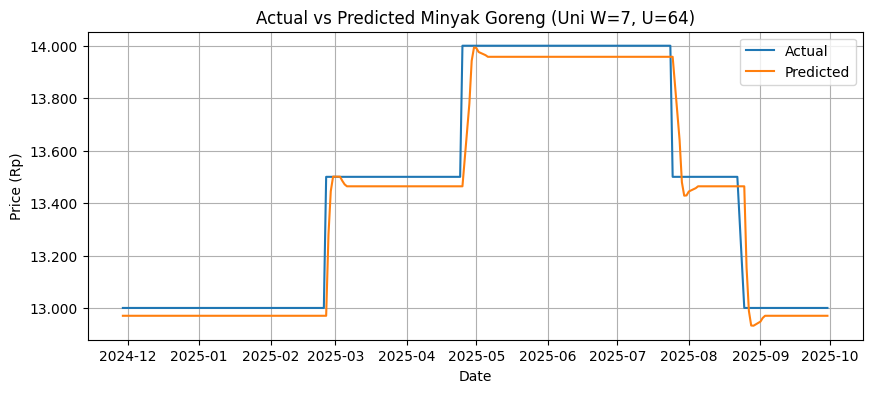


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13000,12970.139648
1,2025-10-02,13000,12951.869141
2,2025-10-03,13000,12930.696289
3,2025-10-06,13000,12908.182617
4,2025-10-07,13000,12885.139648
5,2025-10-08,13000,12861.972656
6,2025-10-09,13000,12838.882812
7,2025-10-10,13000,12815.989258
8,2025-10-13,13000,12793.157227
9,2025-10-14,13000,12770.543945


Forecast MAPE Okt 2025 : 1.9957%
Compare CSV disimpan: compare_Okt2025_uni_W7_U64.csv


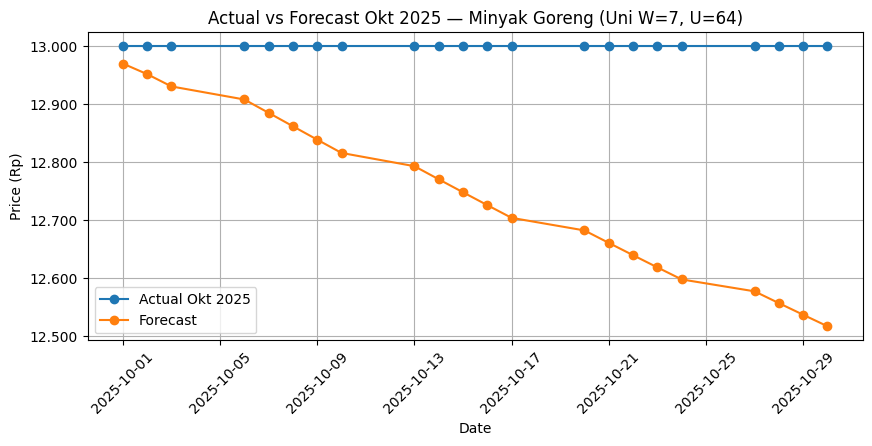

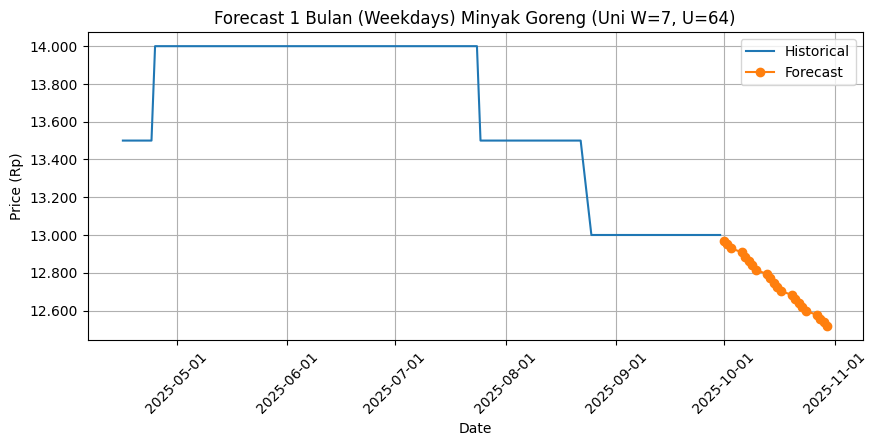

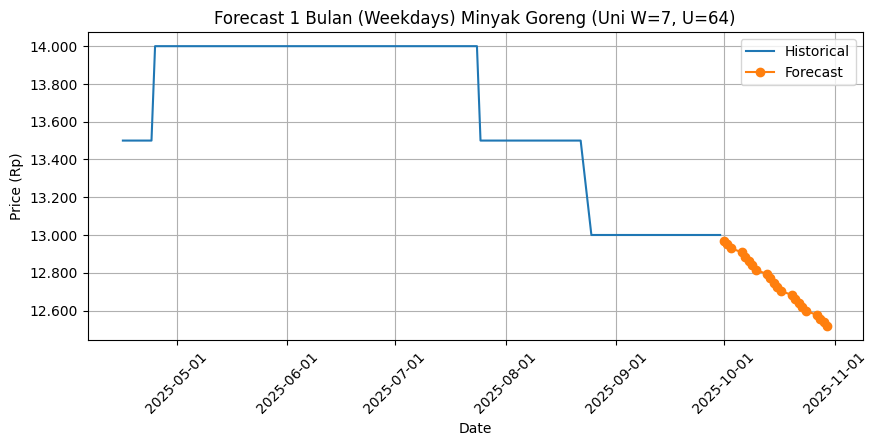


[UNIVARIATE] Target=Minyak Goreng | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.4294 - val_loss: 0.0028
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0257 - val_loss: 0.0110
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0140 - val_loss: 0.0021
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0109 - val_loss: 1.4378e-04
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0096 - val_loss: 3.8153e-04
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0084 - val_loss: 1.2065e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0083 - val_loss: 2.5373e-04
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0071 - val_loss: 1.6811e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0058 - val_loss: 3.9657e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0064 - val_loss: 7.3478e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0064 - val_loss: 0.0013
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7

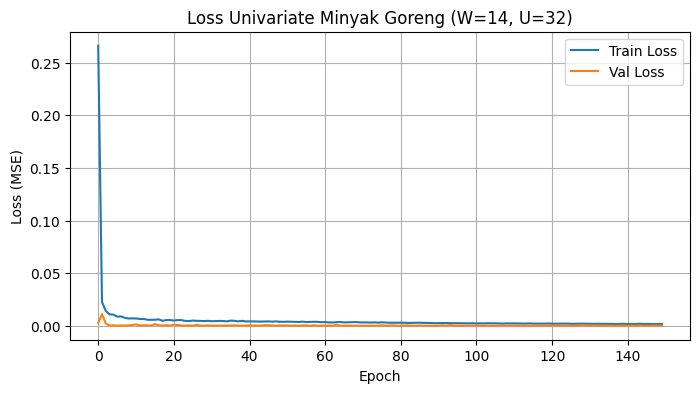

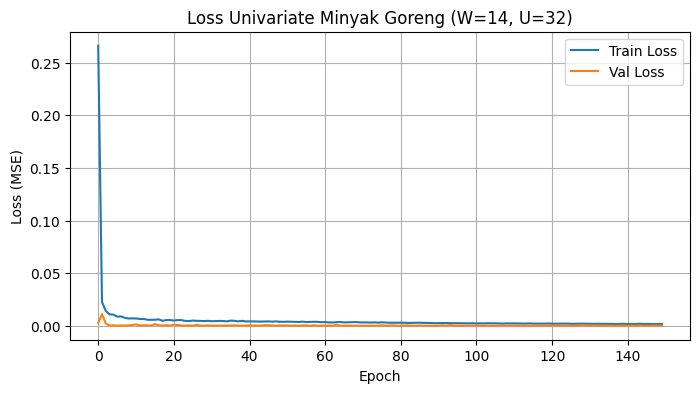

Test MAE  : 85.71
Test RMSE : 106.57
Test MAPE : 0.6325%


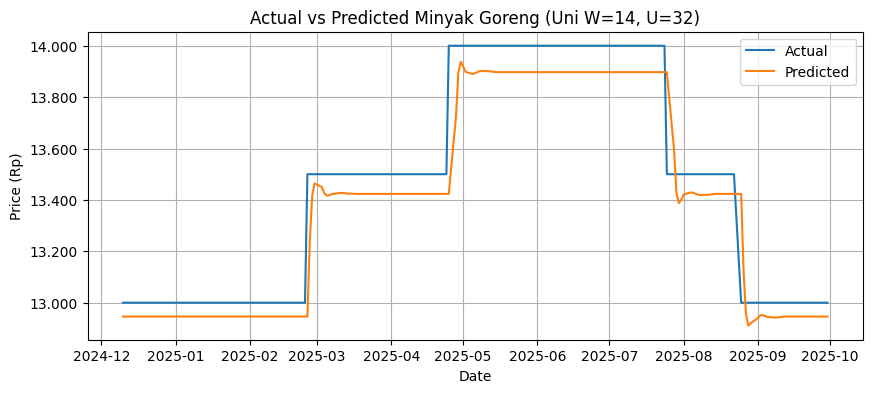

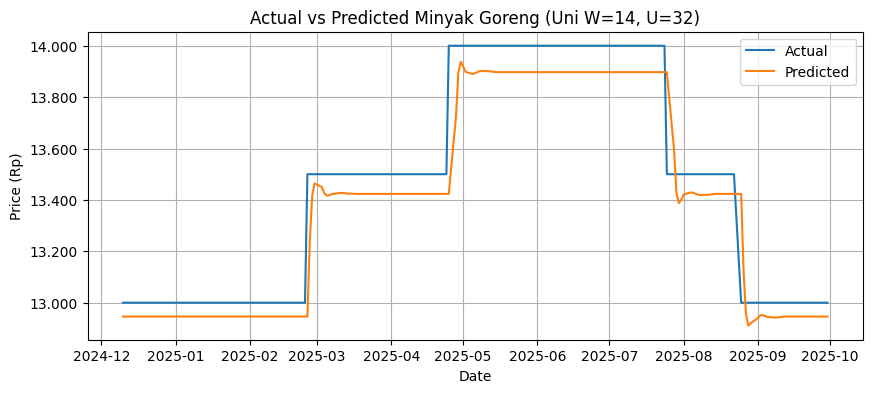


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13000,12946.024414
1,2025-10-02,13000,12914.551758
2,2025-10-03,13000,12877.420898
3,2025-10-06,13000,12839.385742
4,2025-10-07,13000,12802.174805
5,2025-10-08,13000,12766.348633
6,2025-10-09,13000,12731.918945
7,2025-10-10,13000,12698.710938
8,2025-10-13,13000,12666.527344
9,2025-10-14,13000,12635.229492


Forecast MAPE Okt 2025 : 3.0241%
Compare CSV disimpan: compare_Okt2025_uni_W14_U32.csv


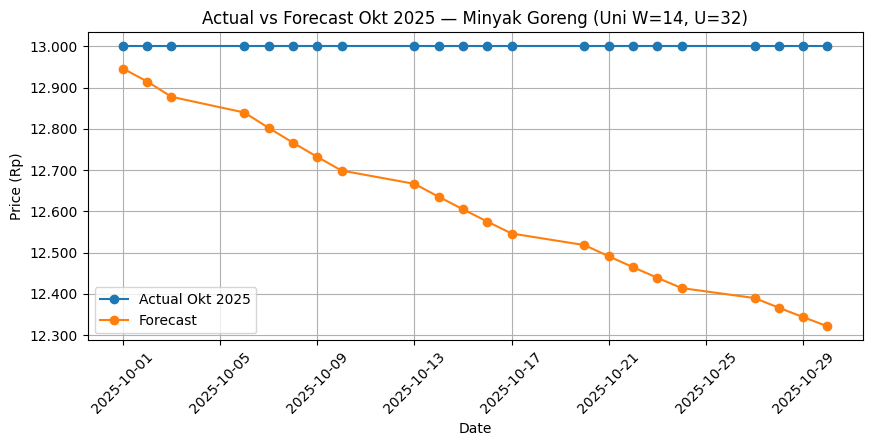

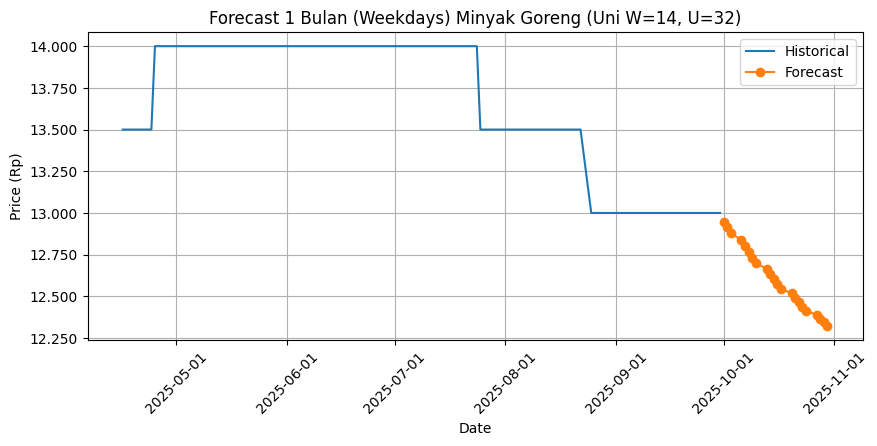

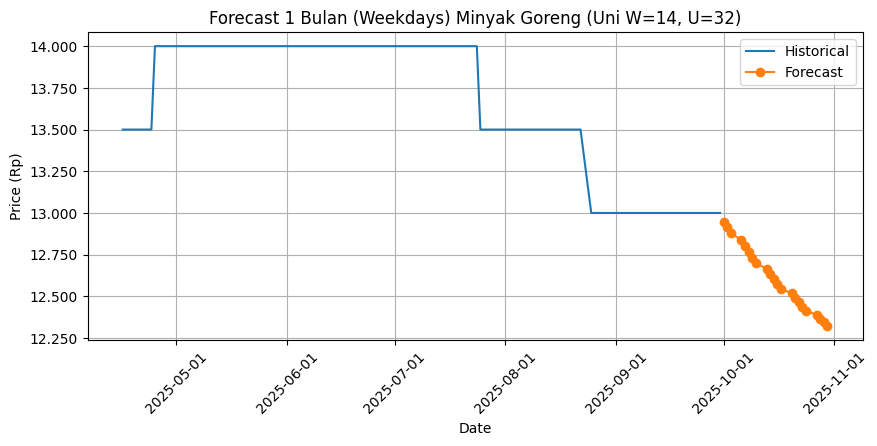


[UNIVARIATE] Target=Minyak Goreng | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.1096 - val_loss: 0.0148
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0071 - val_loss: 5.6963e-04
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0049 - val_loss: 2.2363e-04
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0041 - val_loss: 1.3025e-04
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0045 - val_loss: 8.2068e-05
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0037 - val_loss: 1.0187e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0038 - val_loss: 3.6344e-04
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0038 - val_loss: 2.4516e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0034 - val_loss: 1.7427e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0030 - val_loss: 9.1850e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0031 - val_loss: 4.0053e-04
Epoch 12/150
33/33 ━━━━━━━━━━━

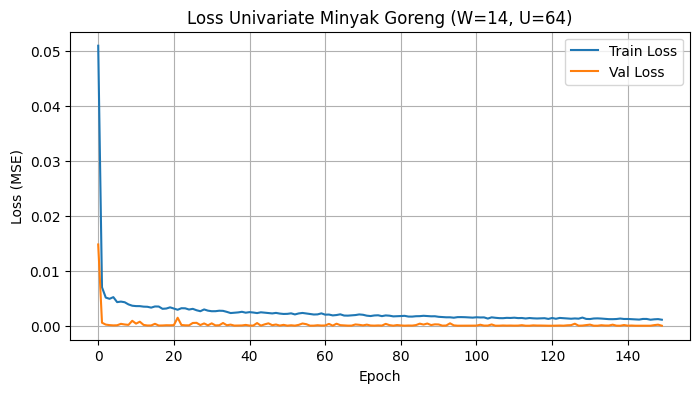

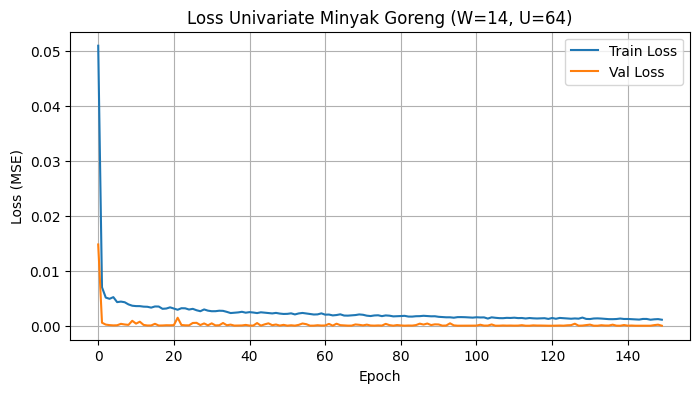

Test MAE  : 19.95
Test RMSE : 70.16
Test MAPE : 0.1464%


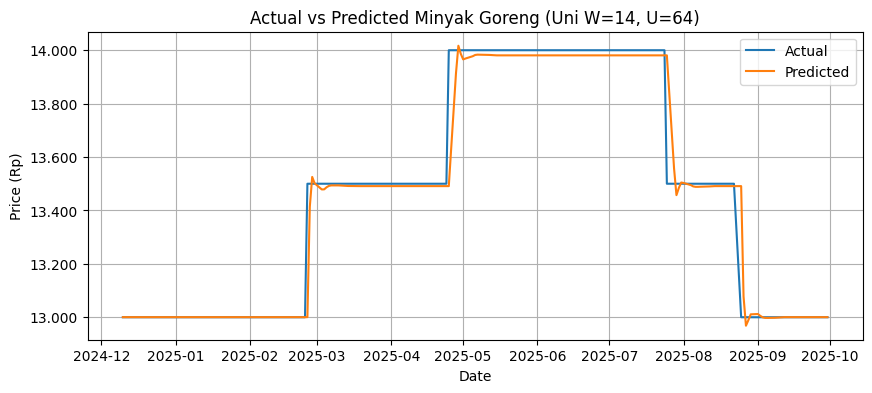

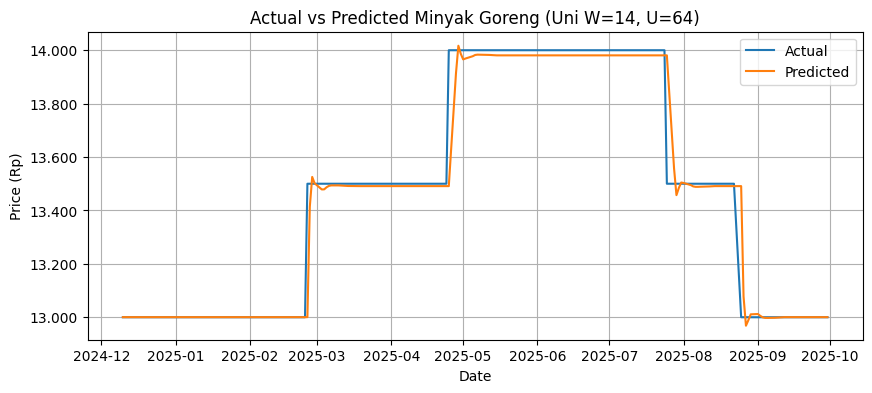


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13000,13000.280273
1,2025-10-02,13000,13000.509766
2,2025-10-03,13000,13000.761719
3,2025-10-06,13000,13001.009766
4,2025-10-07,13000,13001.249023
5,2025-10-08,13000,13001.480469
6,2025-10-09,13000,13001.706055
7,2025-10-10,13000,13001.928711
8,2025-10-13,13000,13002.148438
9,2025-10-14,13000,13002.365234


Forecast MAPE Okt 2025 : 0.0202%
Compare CSV disimpan: compare_Okt2025_uni_W14_U64.csv


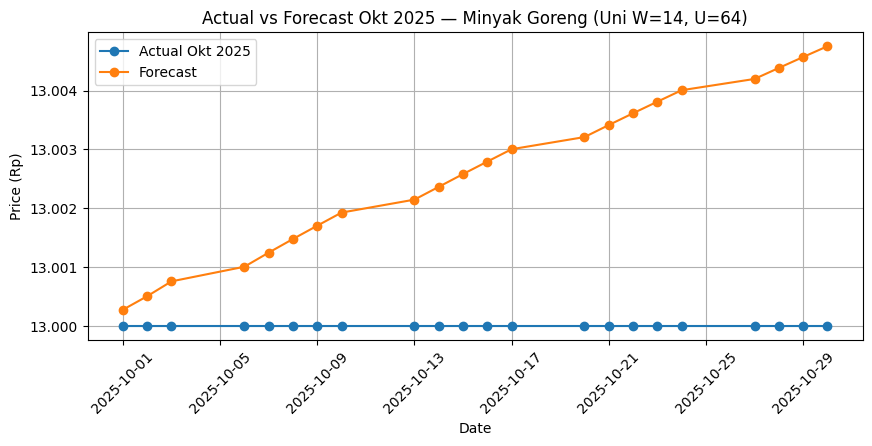

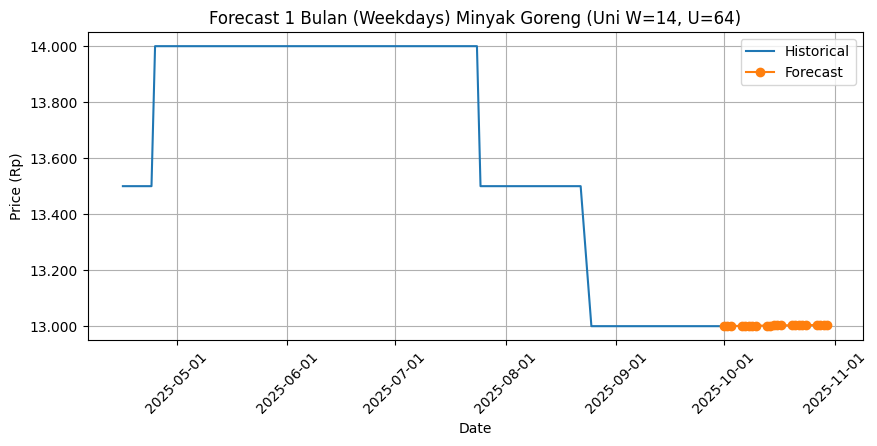

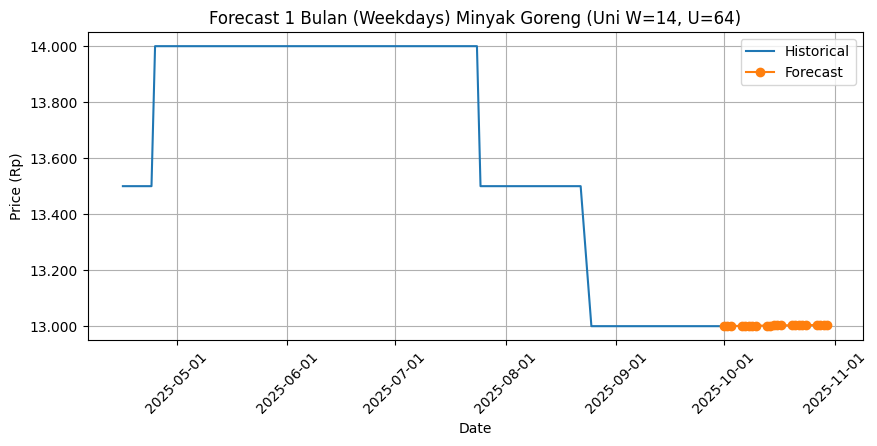


[UNIVARIATE] Target=Minyak Goreng | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - loss: 0.2054 - val_loss: 0.0145
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0168 - val_loss: 0.0042
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0124 - val_loss: 7.2544e-04
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0110 - val_loss: 4.1266e-04
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0093 - val_loss: 2.5376e-04
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0084 - val_loss: 1.0088e-04
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0086 - val_loss: 9.4076e-05
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0081 - val_loss: 1.1698e-04
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0071 - val_loss: 4.6008e-04
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0076 - val_loss: 4.4639e-04
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0058 - val_loss: 8.6219e-05
Epoch 12/150
32/32 ━━━━━━━━━

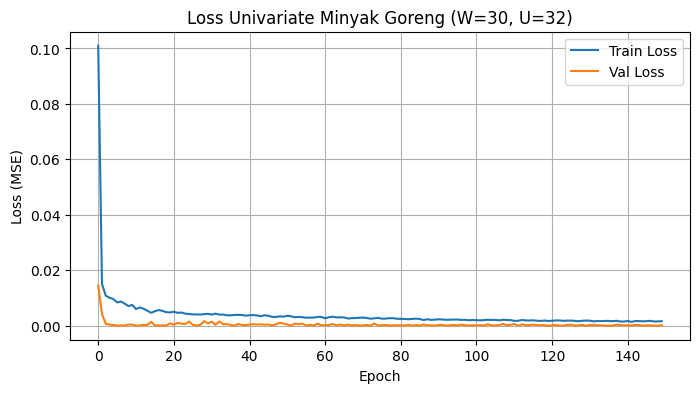

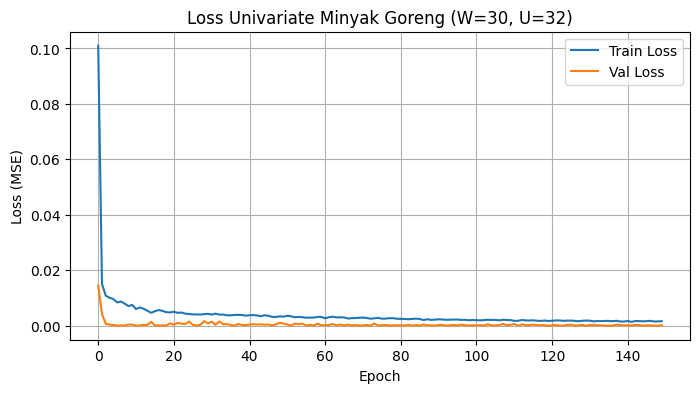

Test MAE  : 87.40
Test RMSE : 108.20
Test MAPE : 0.6456%


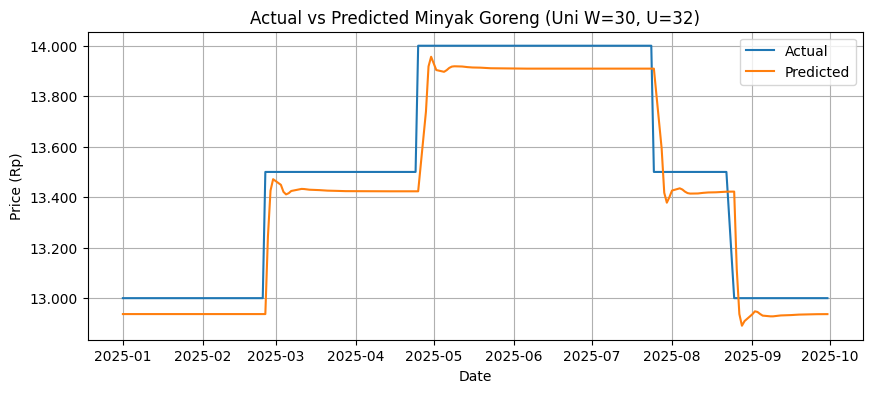

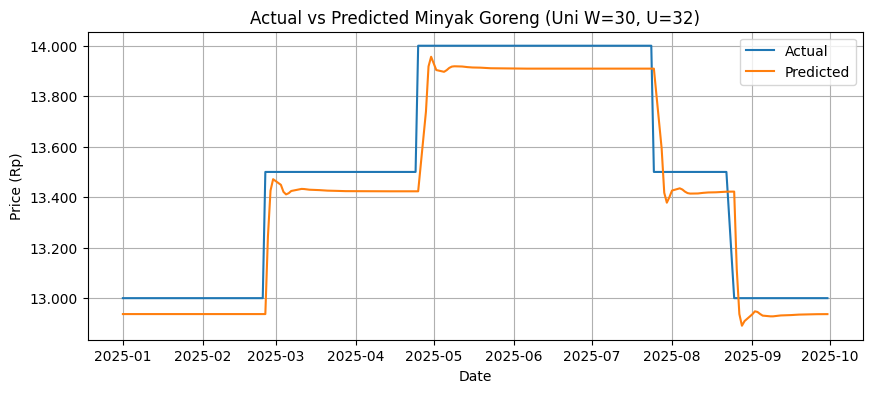


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13000,12936.746094
1,2025-10-02,13000,12898.437500
2,2025-10-03,13000,12852.515625
3,2025-10-06,13000,12804.739258
4,2025-10-07,13000,12757.770508
5,2025-10-08,13000,12712.387695
6,2025-10-09,13000,12668.523438
7,2025-10-10,13000,12625.809570
8,2025-10-13,13000,12583.878906
9,2025-10-14,13000,12542.470703


Forecast MAPE Okt 2025 : 3.9071%
Compare CSV disimpan: compare_Okt2025_uni_W30_U32.csv


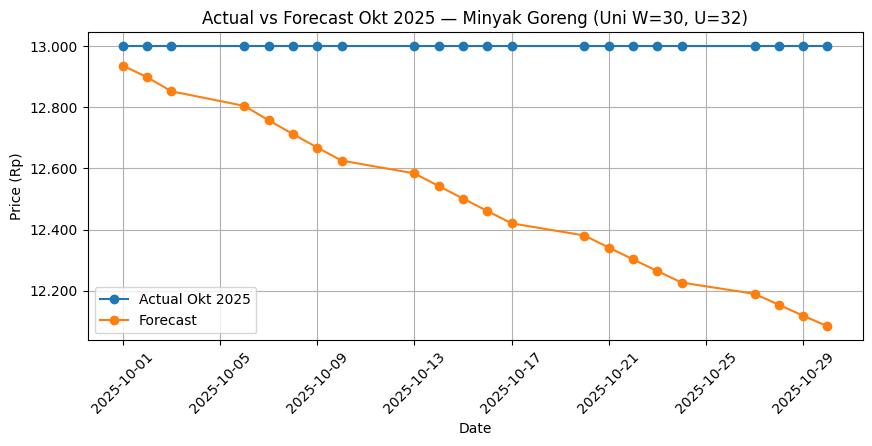

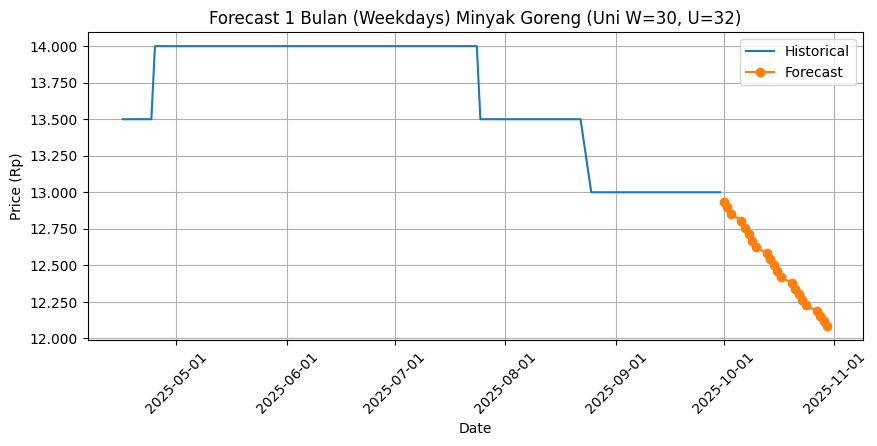

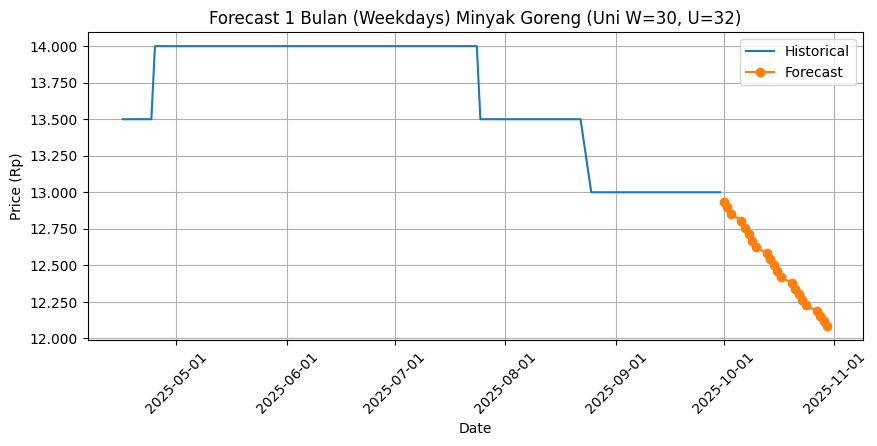


[UNIVARIATE] Target=Minyak Goreng | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - loss: 0.1153 - val_loss: 0.0047
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0080 - val_loss: 1.5525e-04
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0054 - val_loss: 9.6316e-05
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0051 - val_loss: 1.2036e-04
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0041 - val_loss: 7.5980e-05
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0044 - val_loss: 8.7552e-05
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0045 - val_loss: 1.2905e-04
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0040 - val_loss: 1.9499e-04
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0040 - val_loss: 1.5007e-04
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0043 - val_loss: 1.6333e-04
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0037 - val_loss: 2.2356e-04
Epoch 12/150
32/32 ━━━━━

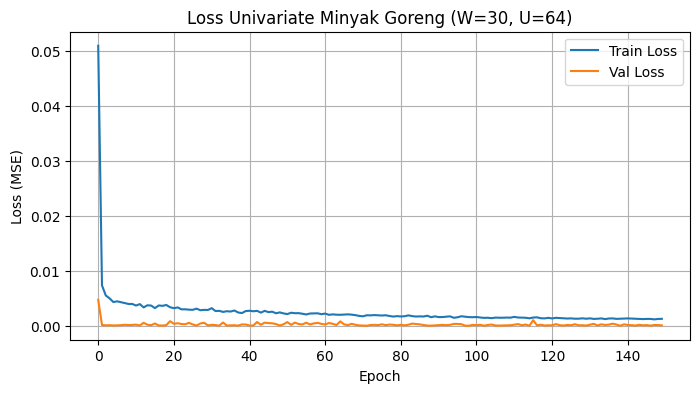

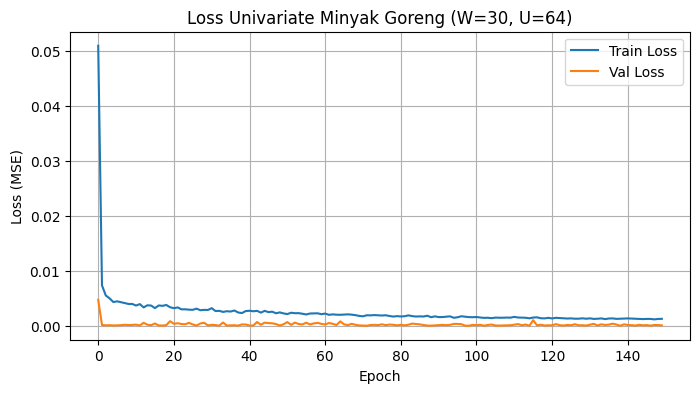

Test MAE  : 61.77
Test RMSE : 89.16
Test MAPE : 0.4559%


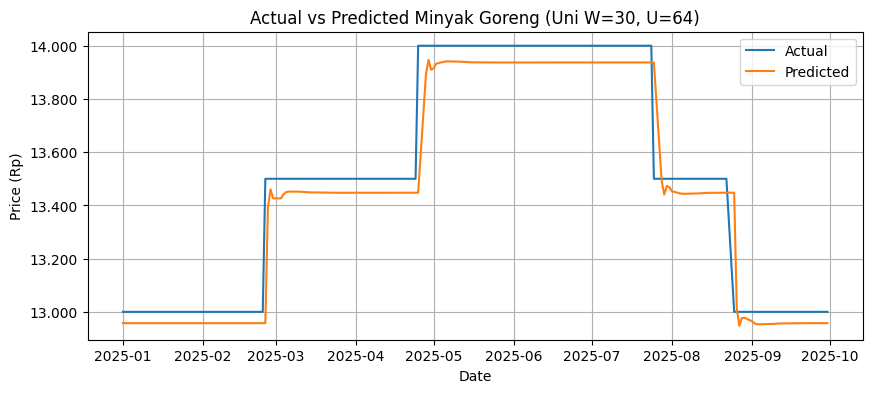

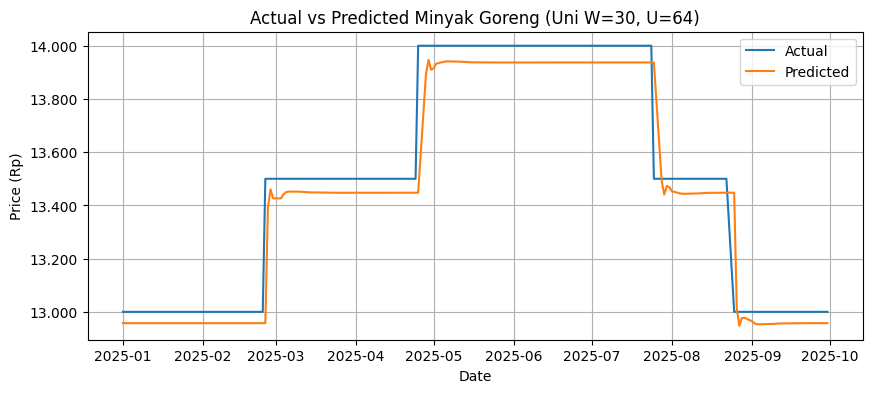


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13000,12957.467773
1,2025-10-02,13000,12920.893555
2,2025-10-03,13000,12883.264648
3,2025-10-06,13000,12848.082031
4,2025-10-07,13000,12814.724609
5,2025-10-08,13000,12782.244141
6,2025-10-09,13000,12750.078125
7,2025-10-10,13000,12718.039062
8,2025-10-13,13000,12686.138672
9,2025-10-14,13000,12654.456055


Forecast MAPE Okt 2025 : 2.9578%
Compare CSV disimpan: compare_Okt2025_uni_W30_U64.csv


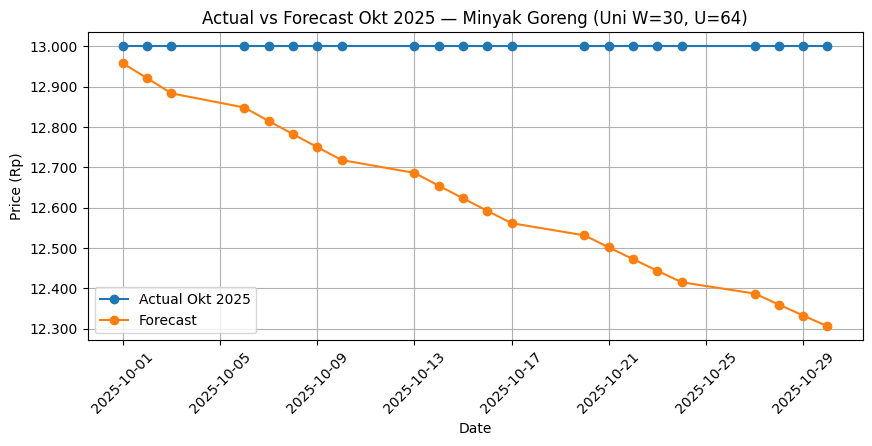

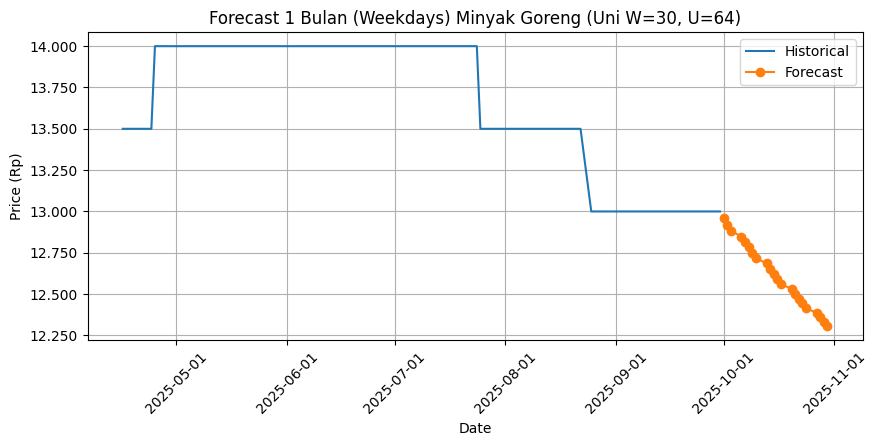

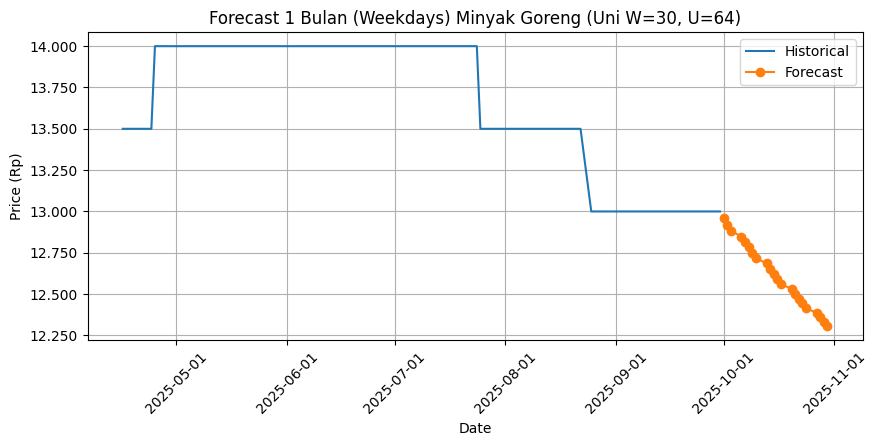


Rekap univariate Minyak Goreng disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate\Minyak_Goreng\hasil_univariate_Minyak_Goreng.csv

==================== UNIVARIATE: Gula Pasir ====================

[UNIVARIATE] Target=Gula Pasir | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - loss: 0.1648 - val_loss: 0.0866
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0185 - val_loss: 0.0275
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0087 - val_loss: 9.5818e-05
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0062 - val_loss: 0.0012
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0060 - val_loss: 0.0023
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0054 - val_loss: 6.0307e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0044 - val_loss: 8.9502e-05
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0045 - val_loss: 5.0132e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0040 - val_loss: 1.0489e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0044 - val_loss: 2.3136e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0044 - val_loss: 6.7900e-04
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms

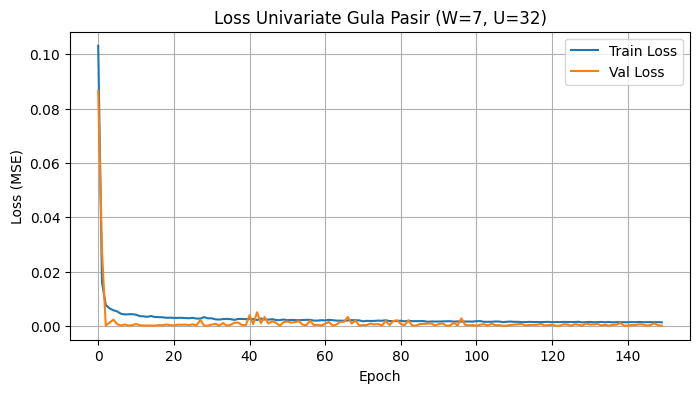

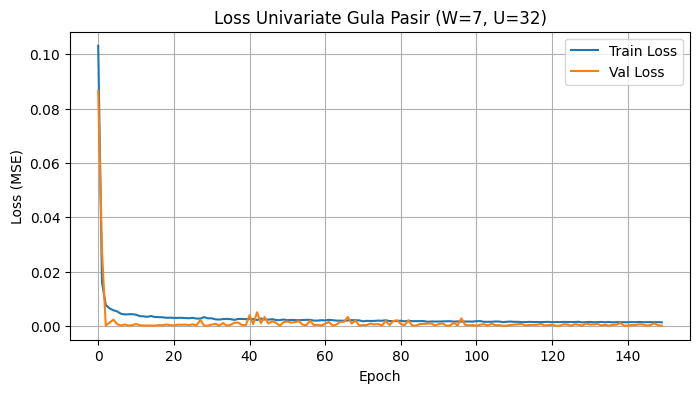

Test MAE  : 42.53
Test RMSE : 52.51
Test MAPE : 0.2889%


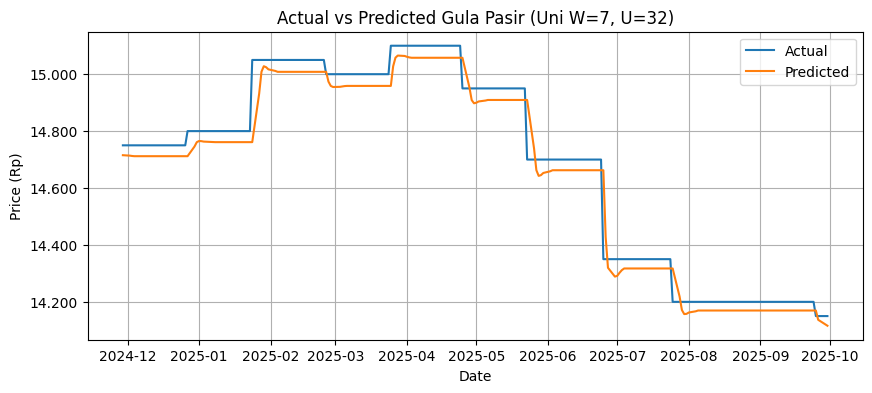

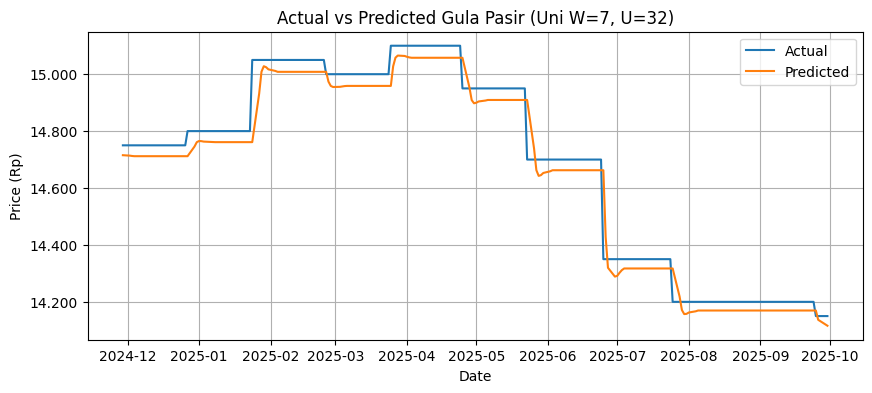


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,14150,14116.104492
1,2025-10-02,14150,14094.286133
2,2025-10-03,14150,14070.911133
3,2025-10-06,14150,14046.858398
4,2025-10-07,14150,14022.699219
5,2025-10-08,14150,13998.205078
6,2025-10-09,14150,13973.990234
7,2025-10-10,14150,13950.184570
8,2025-10-13,14150,13926.534180
9,2025-10-14,14150,13903.199219


Forecast MAPE Okt 2025 : 2.1007%
Compare CSV disimpan: compare_Okt2025_uni_W7_U32.csv


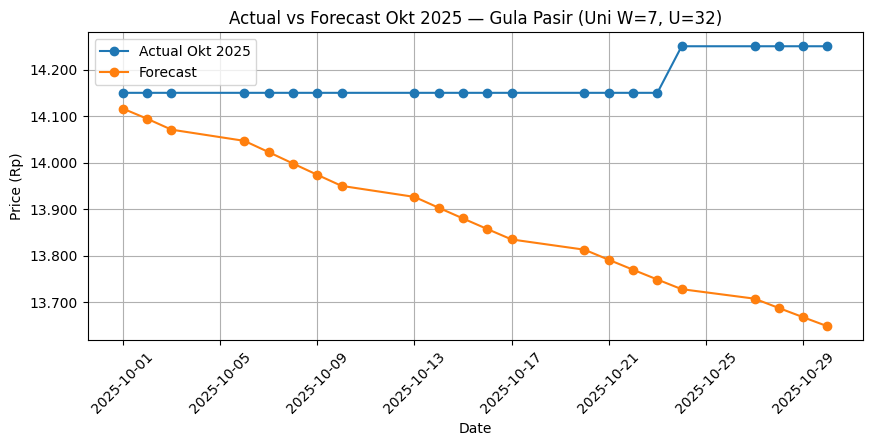

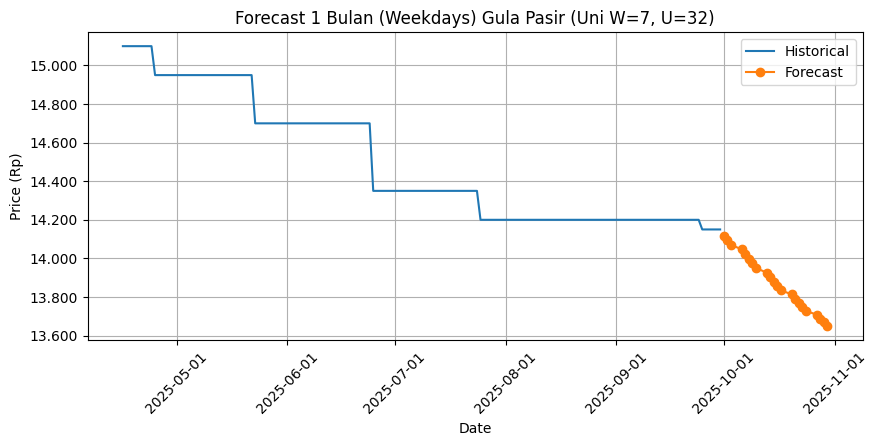

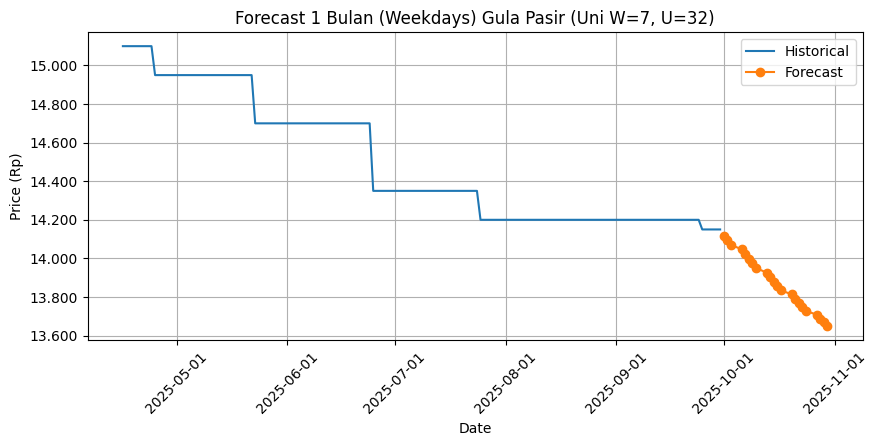


[UNIVARIATE] Target=Gula Pasir | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - loss: 0.0529 - val_loss: 0.0269
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0054 - val_loss: 7.0464e-04
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0039 - val_loss: 1.2927e-04
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0033 - val_loss: 7.4480e-05
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0031 - val_loss: 7.1581e-05
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0030 - val_loss: 2.6189e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0033 - val_loss: 6.9049e-05
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0034 - val_loss: 1.1783e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0031 - val_loss: 6.2875e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0032 - val_loss: 3.2771e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0028 - val_loss: 3.7114e-04
Epoch 12/150
33/33 ━━━━━━━━

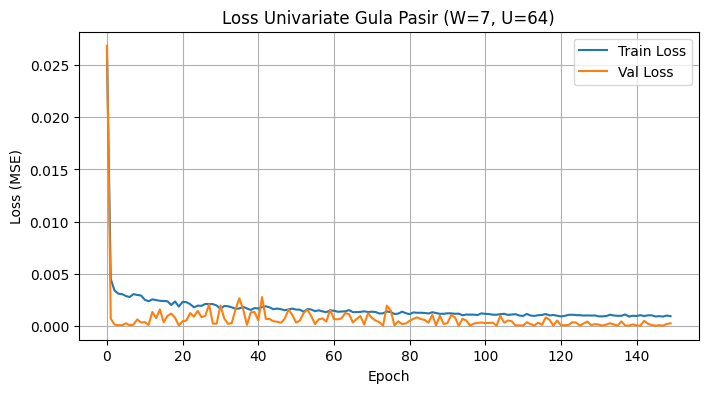

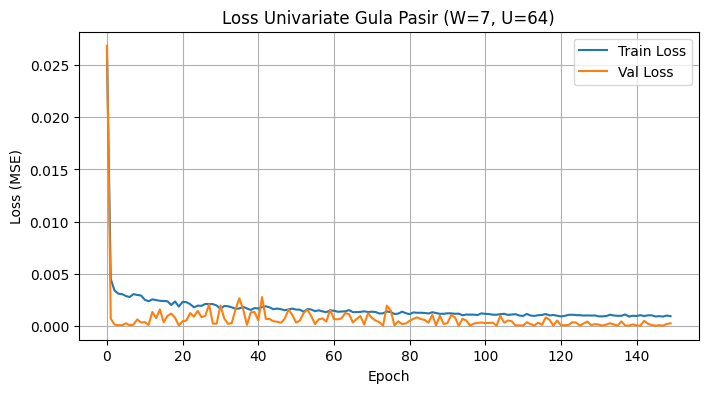

Test MAE  : 80.61
Test RMSE : 84.57
Test MAPE : 0.5474%


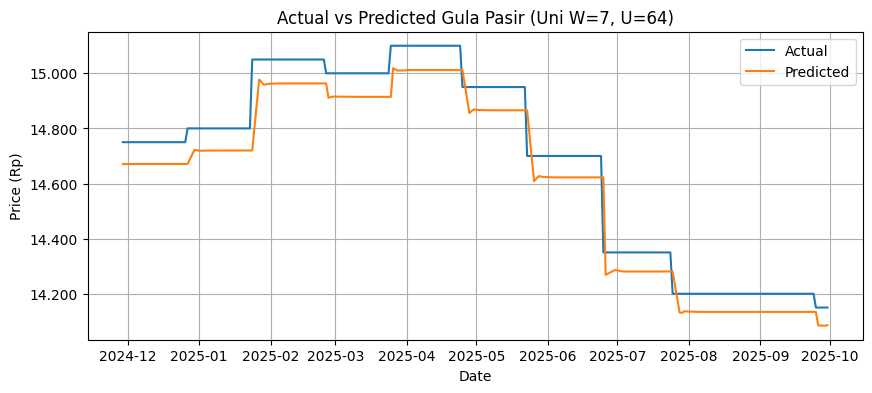

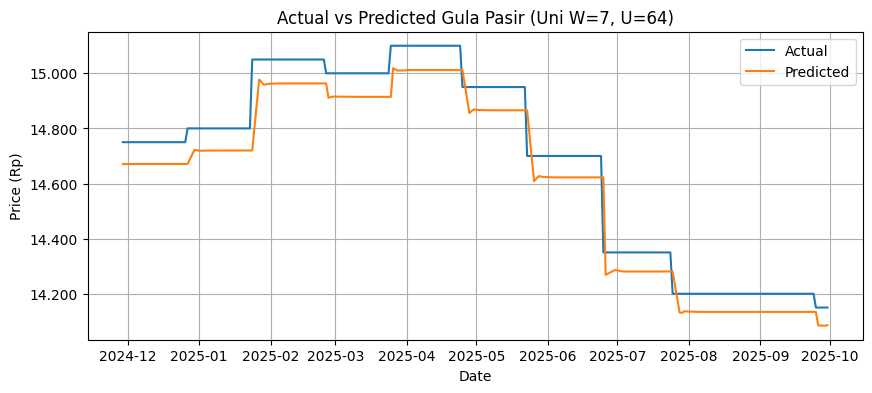


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,14150,14085.860352
1,2025-10-02,14150,14023.238281
2,2025-10-03,14150,13960.303711
3,2025-10-06,14150,13899.441406
4,2025-10-07,14150,13840.748047
5,2025-10-08,14150,13783.941406
6,2025-10-09,14150,13728.663086
7,2025-10-10,14150,13674.688477
8,2025-10-13,14150,13621.951172
9,2025-10-14,14150,13570.404297


Forecast MAPE Okt 2025 : 4.6136%
Compare CSV disimpan: compare_Okt2025_uni_W7_U64.csv


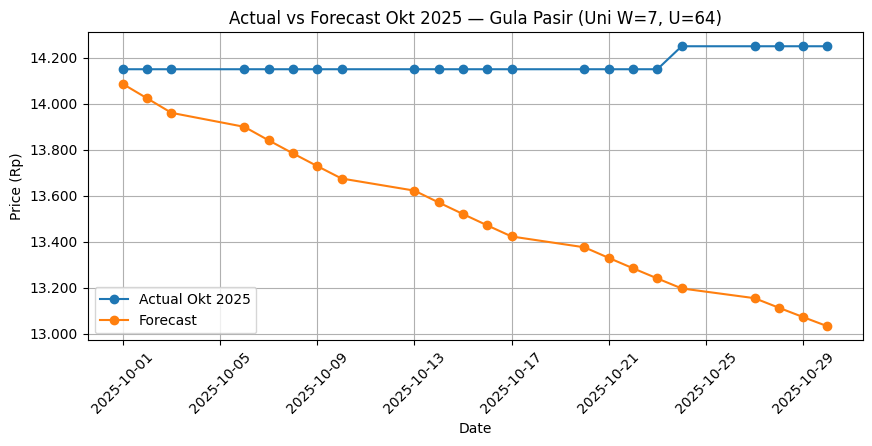

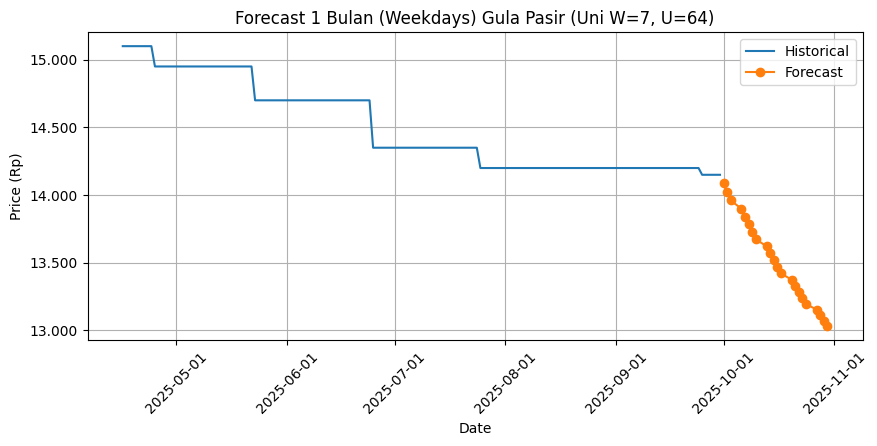

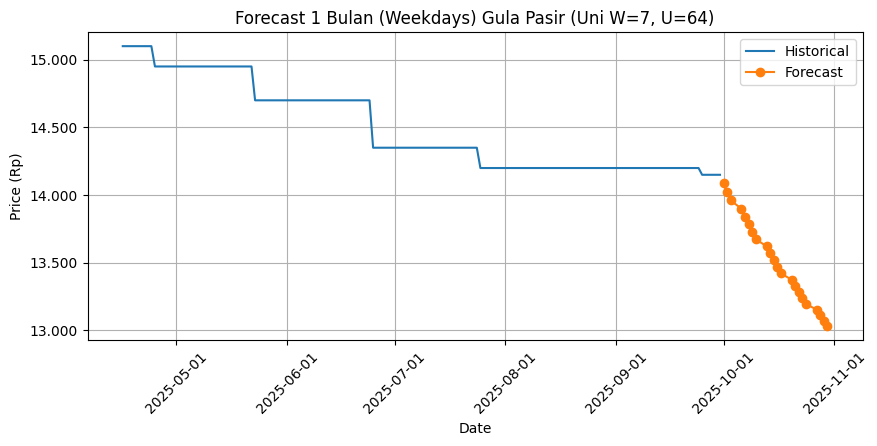


[UNIVARIATE] Target=Gula Pasir | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.0647 - val_loss: 0.0228
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0083 - val_loss: 0.0012
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0048 - val_loss: 0.0025
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0049 - val_loss: 0.0010
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0037 - val_loss: 0.0016
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0035 - val_loss: 0.0041
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0039 - val_loss: 0.0013
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0034 - val_loss: 9.2290e-05
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0029 - val_loss: 0.0030
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0031 - val_loss: 0.0026
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0031 - val_loss: 0.0038
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0033 -

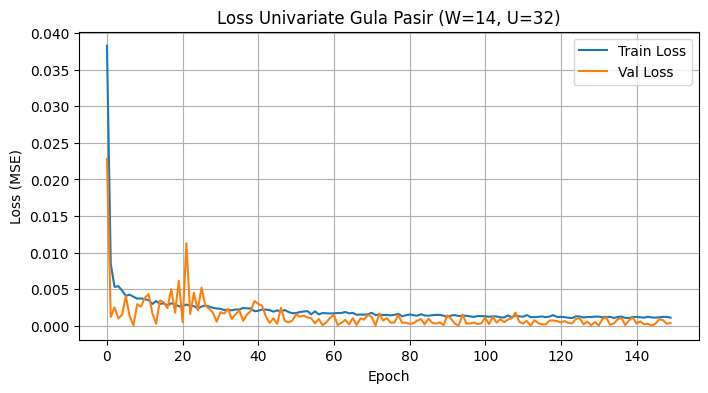

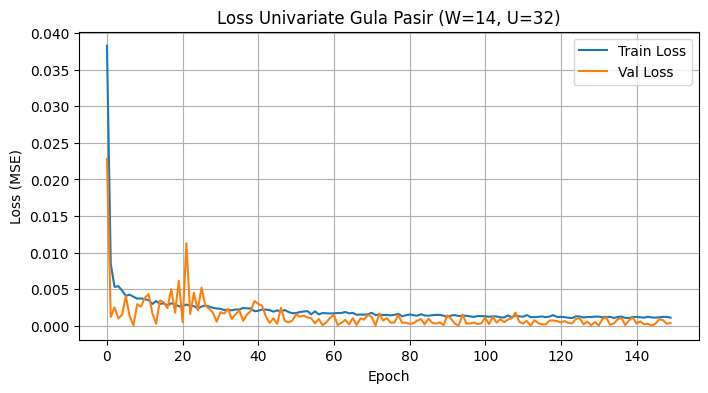

Test MAE  : 101.05
Test RMSE : 104.66
Test MAPE : 0.6857%


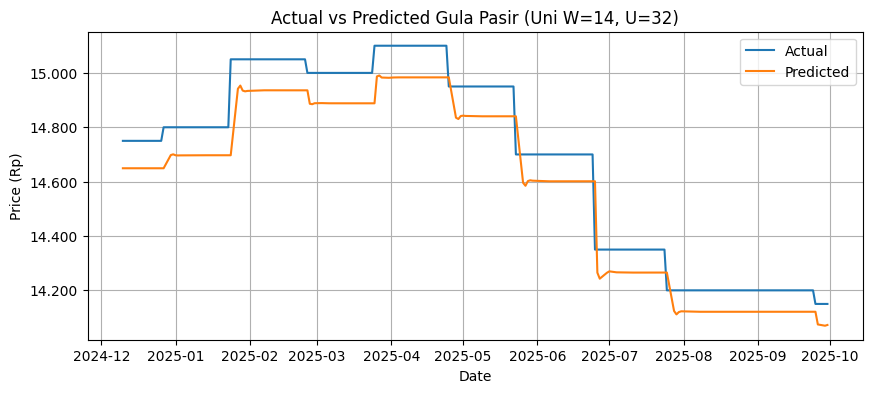

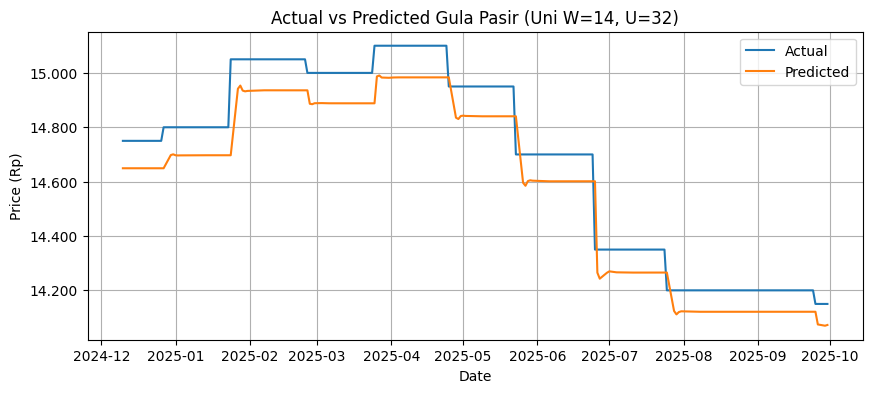


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,14150,14072.594727
1,2025-10-02,14150,14001.615234
2,2025-10-03,14150,13928.327148
3,2025-10-06,14150,13857.550781
4,2025-10-07,14150,13790.031250
5,2025-10-08,14150,13725.683594
6,2025-10-09,14150,13664.180664
7,2025-10-10,14150,13605.184570
8,2025-10-13,14150,13548.414062
9,2025-10-14,14150,13493.665039


Forecast MAPE Okt 2025 : 5.0823%
Compare CSV disimpan: compare_Okt2025_uni_W14_U32.csv


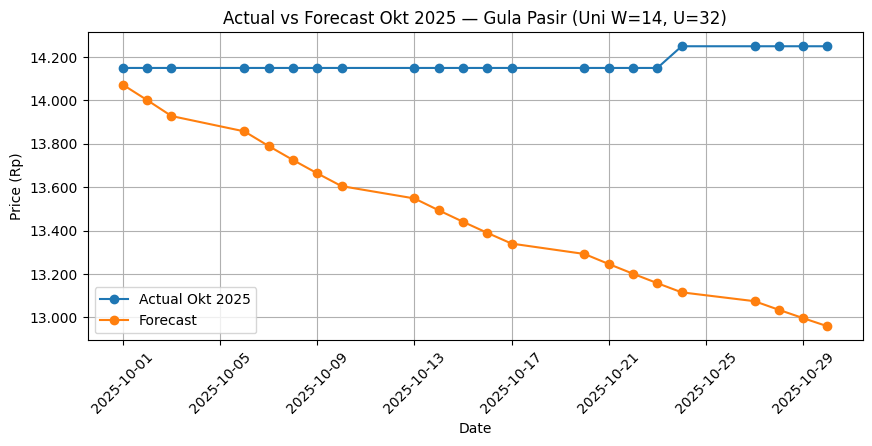

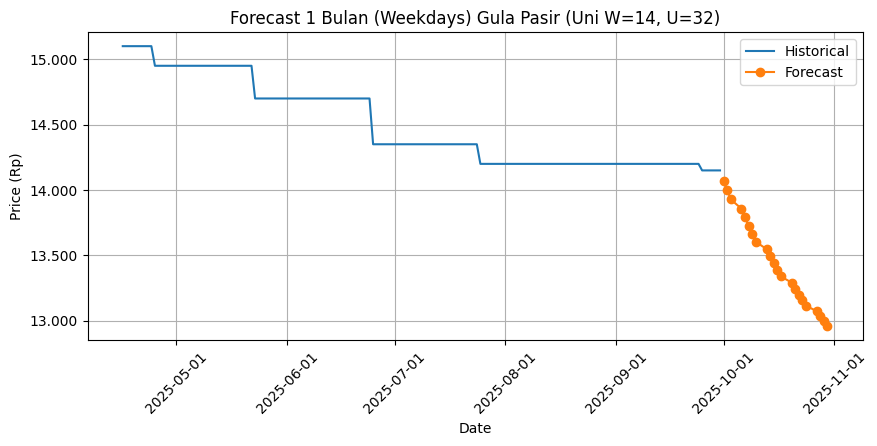

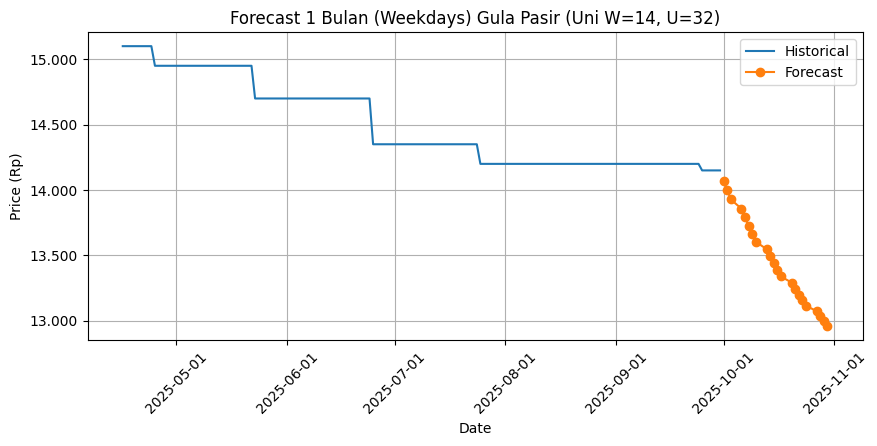


[UNIVARIATE] Target=Gula Pasir | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 54ms/step - loss: 0.0526 - val_loss: 0.0251
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0047 - val_loss: 3.7994e-04
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0038 - val_loss: 3.5306e-04
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0034 - val_loss: 8.2484e-04
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0032 - val_loss: 0.0027
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0028 - val_loss: 1.2531e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0026 - val_loss: 0.0012
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0023 - val_loss: 3.3136e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0024 - val_loss: 0.0050
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0023 - val_loss: 0.0082
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0020 - val_loss: 0.0015
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13

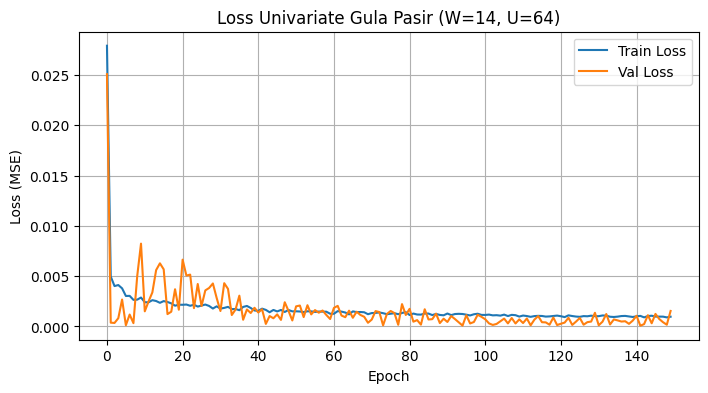

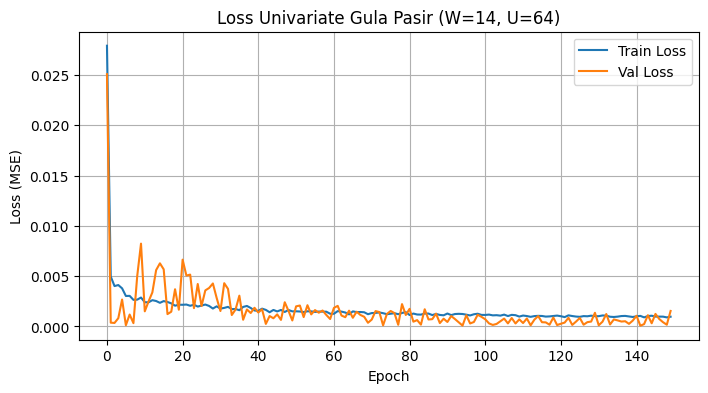

Test MAE  : 198.99
Test RMSE : 201.81
Test MAPE : 1.3516%


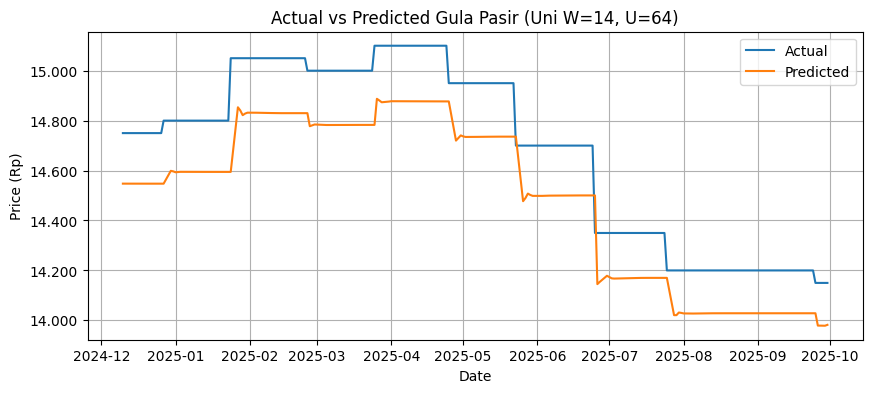

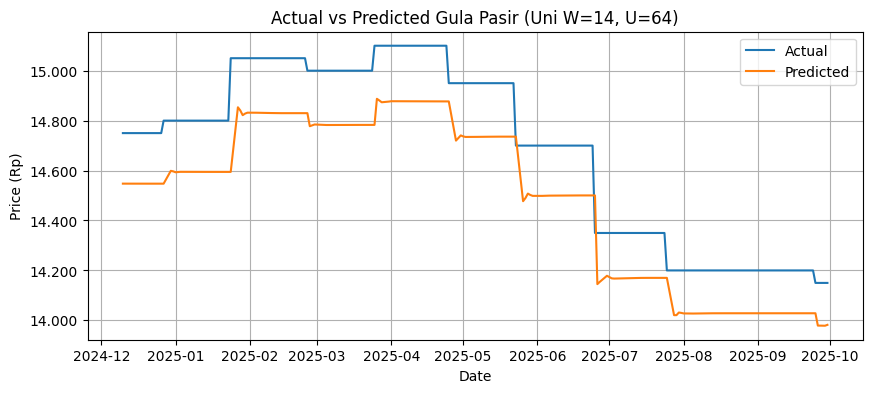


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,14150,13982.060547
1,2025-10-02,14150,13816.985352
2,2025-10-03,14150,13653.015625
3,2025-10-06,14150,13501.823242
4,2025-10-07,14150,13361.516602
5,2025-10-08,14150,13229.586914
6,2025-10-09,14150,13104.514648
7,2025-10-10,14150,12985.569336
8,2025-10-13,14150,12872.427734
9,2025-10-14,14150,12764.909180


Forecast MAPE Okt 2025 : 10.2442%
Compare CSV disimpan: compare_Okt2025_uni_W14_U64.csv


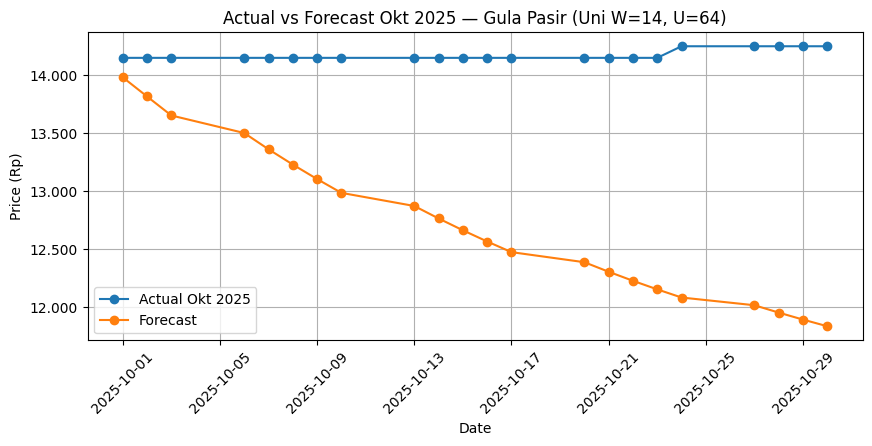

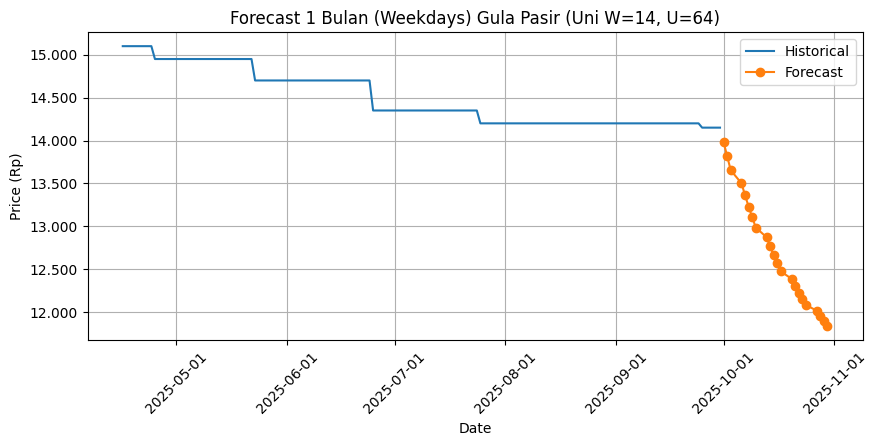

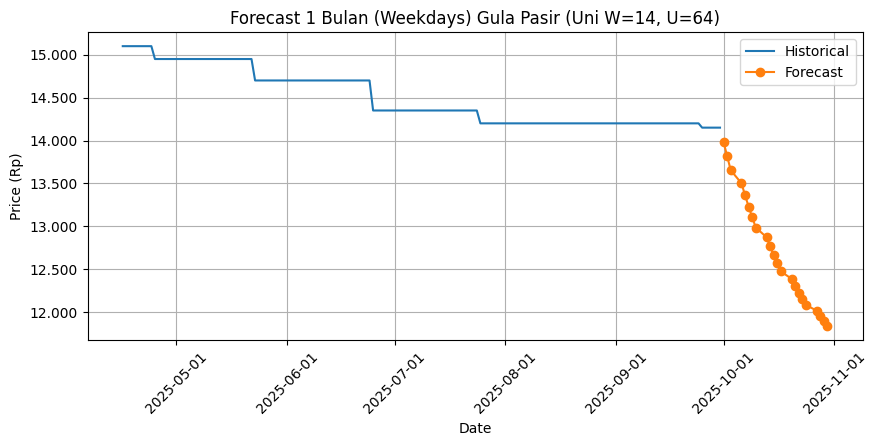


[UNIVARIATE] Target=Gula Pasir | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 24ms/step - loss: 0.0591 - val_loss: 0.0437
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0081 - val_loss: 0.0021
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0059 - val_loss: 6.2495e-04
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0050 - val_loss: 0.0017
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0047 - val_loss: 0.0014
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0045 - val_loss: 2.4078e-04
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0042 - val_loss: 8.6100e-04
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0044 - val_loss: 5.2588e-04
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0042 - val_loss: 0.0015
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0035 - val_loss: 0.0025
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0034 - val_loss: 0.0017
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/

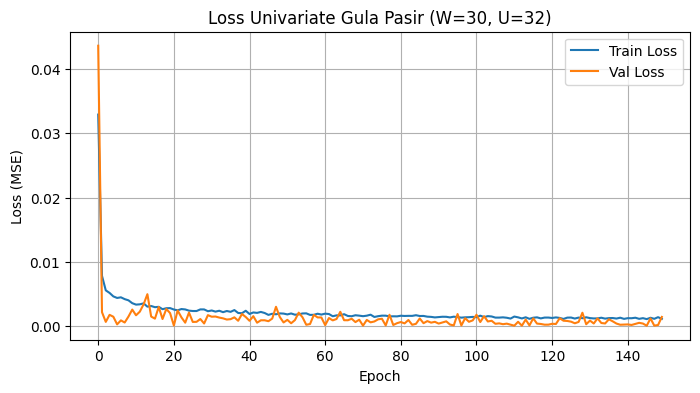

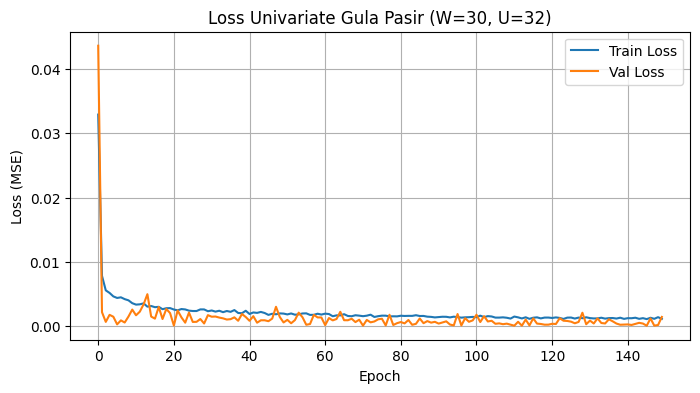

Test MAE  : 189.99
Test RMSE : 192.93
Test MAPE : 1.2908%


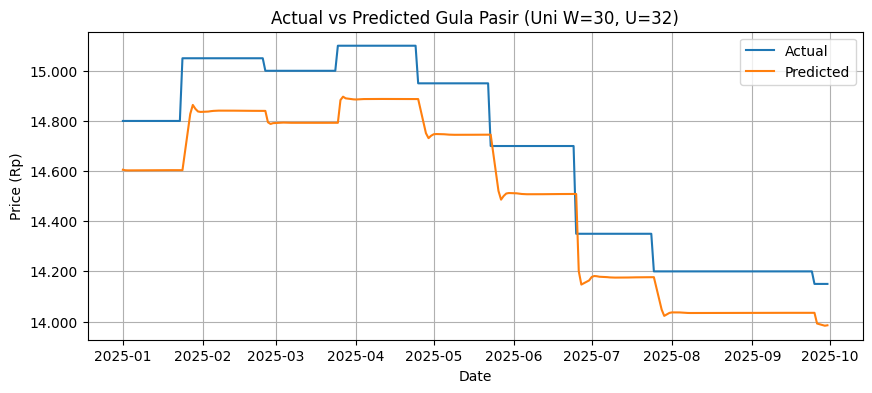

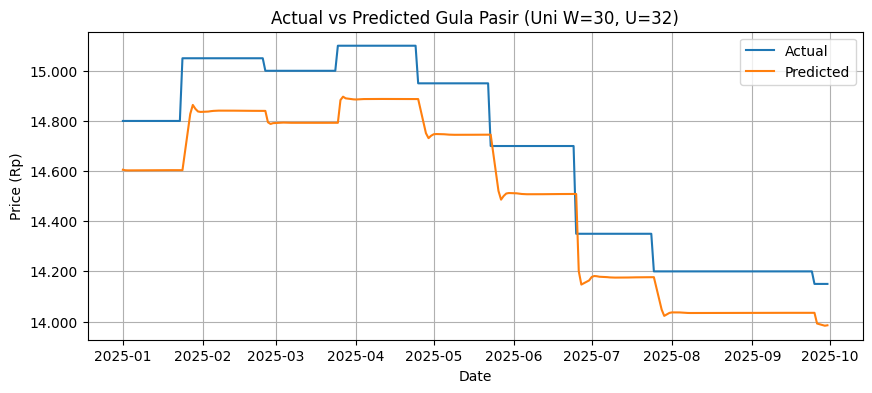


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,14150,13985.043945
1,2025-10-02,14150,13847.017578
2,2025-10-03,14150,13702.381836
3,2025-10-06,14150,13561.902344
4,2025-10-07,14150,13428.835938
5,2025-10-08,14150,13303.771484
6,2025-10-09,14150,13186.130859
7,2025-10-10,14150,13074.953125
8,2025-10-13,14150,12969.283203
9,2025-10-14,14150,12868.332031


Forecast MAPE Okt 2025 : 9.6316%
Compare CSV disimpan: compare_Okt2025_uni_W30_U32.csv


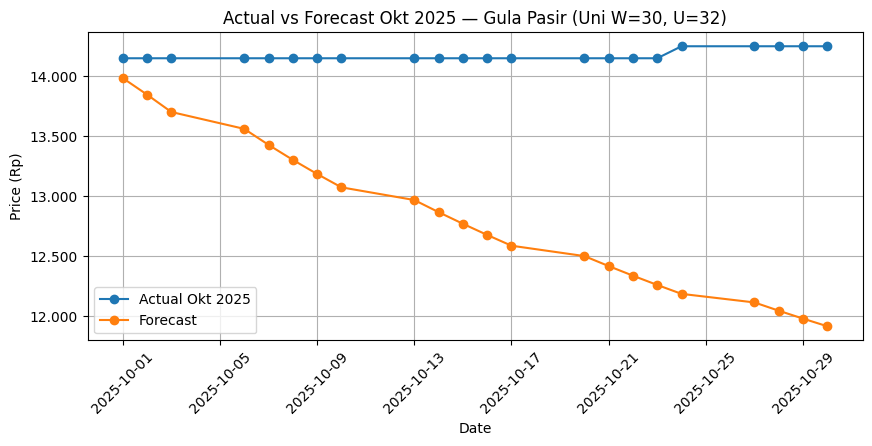

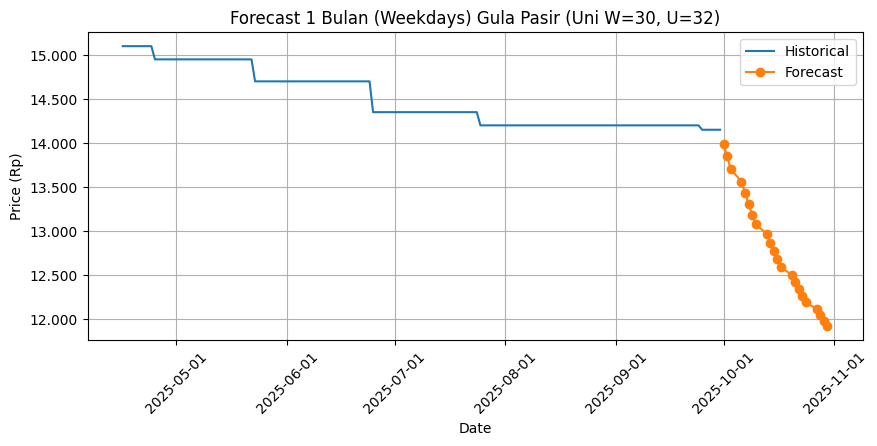

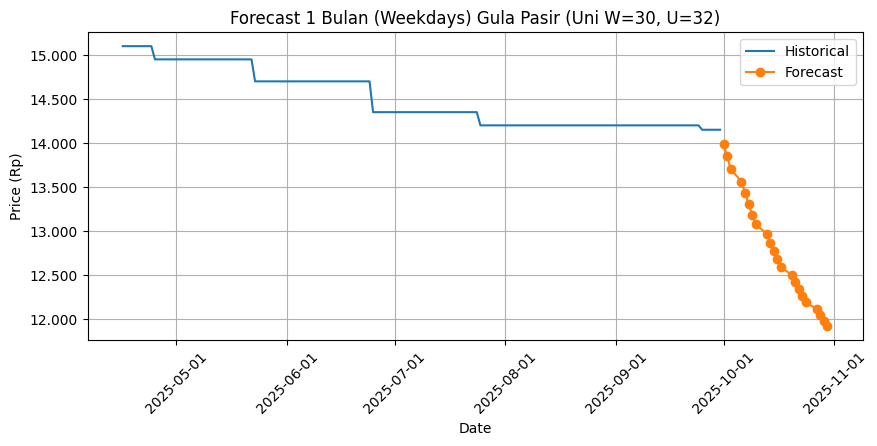


[UNIVARIATE] Target=Gula Pasir | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 0.0639 - val_loss: 0.0023
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0068 - val_loss: 0.0032
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0046 - val_loss: 8.1941e-04
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0048 - val_loss: 1.2327e-04
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0039 - val_loss: 0.0029
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0041 - val_loss: 1.0201e-04
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0039 - val_loss: 3.8179e-04
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0033 - val_loss: 7.6957e-04
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0030 - val_loss: 1.0163e-04
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0031 - val_loss: 8.0083e-05
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0035 - val_loss: 4.0876e-04
Epoch 12/150
32/32 ━━━━━━━━━━━━━

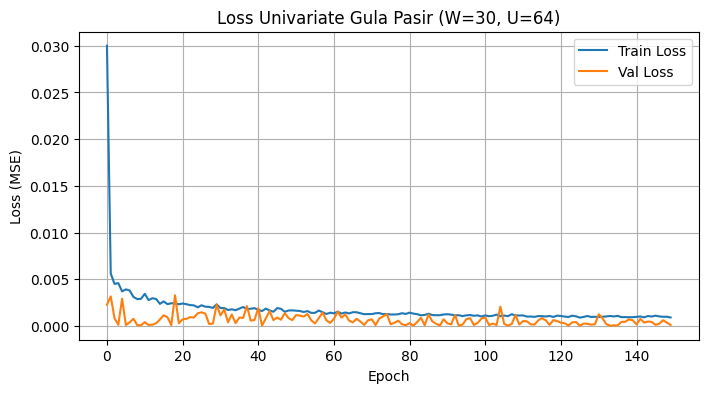

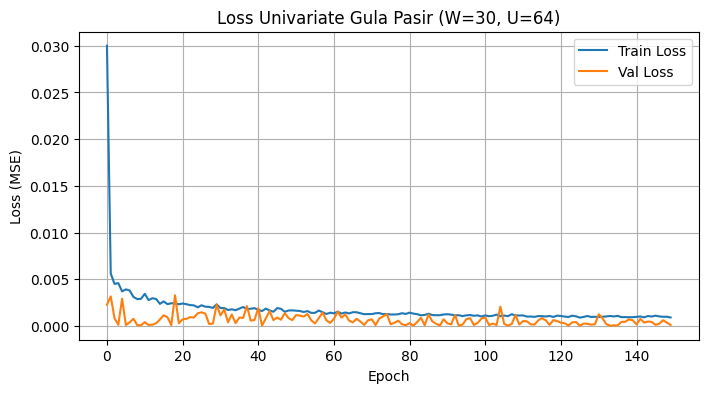

Test MAE  : 47.27
Test RMSE : 56.87
Test MAPE : 0.3204%


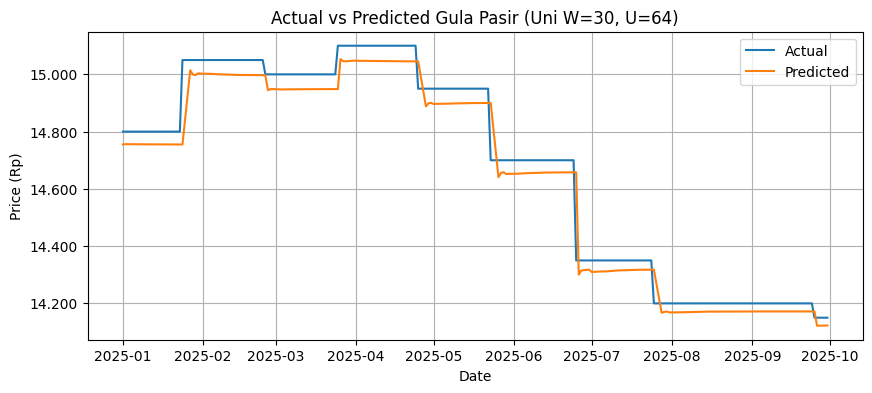

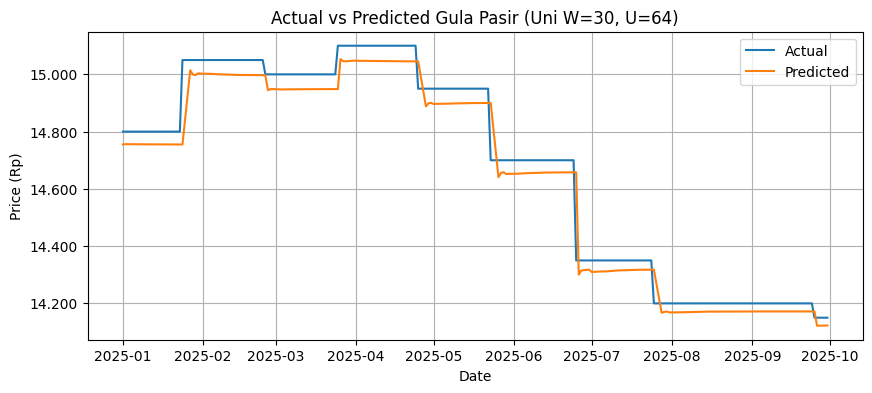


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,14150,14122.977539
1,2025-10-02,14150,14095.095703
2,2025-10-03,14150,14067.537109
3,2025-10-06,14150,14040.752930
4,2025-10-07,14150,14014.164062
5,2025-10-08,14150,13987.743164
6,2025-10-09,14150,13961.546875
7,2025-10-10,14150,13935.625000
8,2025-10-13,14150,13910.020508
9,2025-10-14,14150,13884.774414


Forecast MAPE Okt 2025 : 2.2305%
Compare CSV disimpan: compare_Okt2025_uni_W30_U64.csv


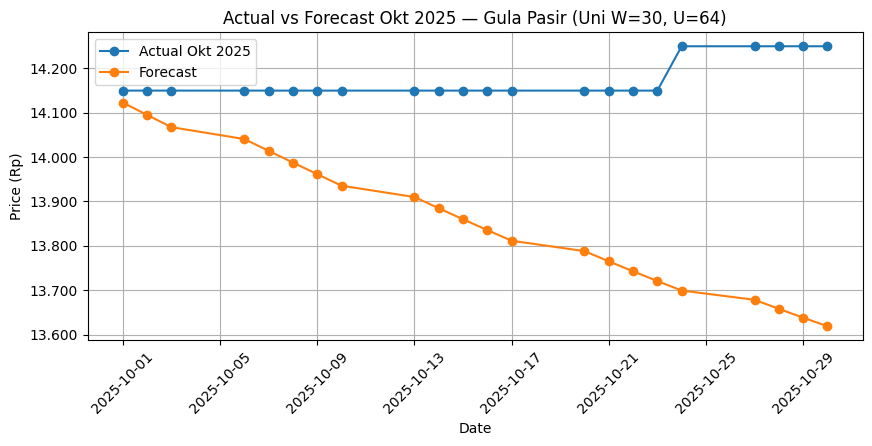

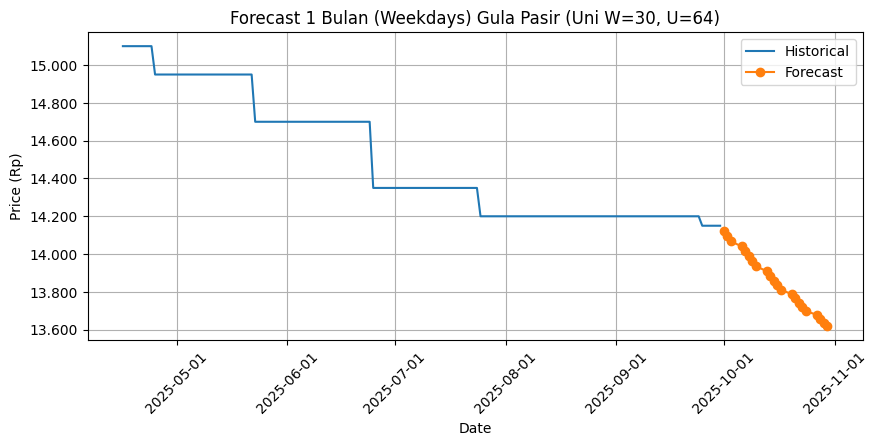

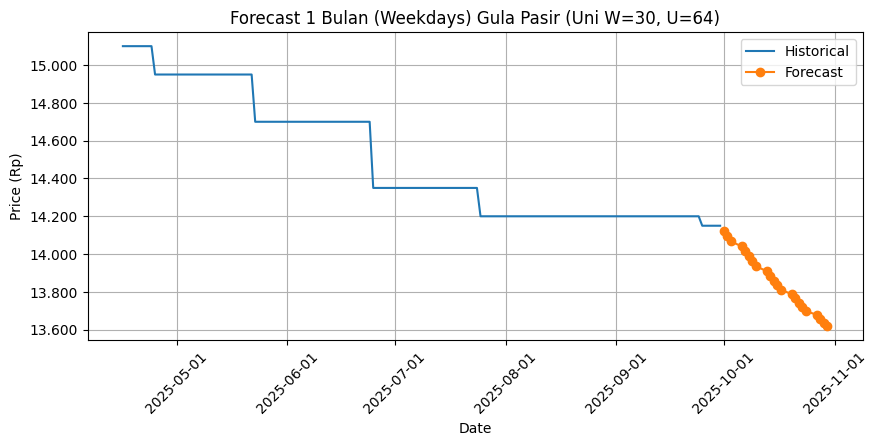


Rekap univariate Gula Pasir disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate\Gula_Pasir\hasil_univariate_Gula_Pasir.csv

===== Semua skenario UNIVARIATE selesai dijalankan =====
Hasil lengkap ada di folder: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate


In [14]:
# LOOP SKENARIO UNIVARIATE


import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.ticker import FuncFormatter
from IPython.display import display

rupiah = FuncFormatter(lambda x, pos: f"{x:,.0f}".replace(",", "."))

# ----------------------------------------------------------
# Folder hasil khusus univariate
# ----------------------------------------------------------
base_result_folder = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate"
os.makedirs(base_result_folder, exist_ok=True)

print("Mulai percobaan skenario UNIVARIATE...\n")

# ----------------------------------------------------------
# (A) Load data aktual Oktober 2025 sekali saja (untuk compare)
# ----------------------------------------------------------
path_okt = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\dataset\Harga_Pangan_Oktober_2025.xlsx"
df_okt_raw = pd.read_excel(path_okt)

# merapikan nama kolom
df_okt_raw.columns = (
    df_okt_raw.columns.astype(str)
    .str.replace(" ", "", regex=False)
    .str.replace("\n", "", regex=False)
)

# rename kolom komoditas
col_komoditas_okt = df_okt_raw.columns[1]
df_okt_raw = df_okt_raw.rename(columns={col_komoditas_okt: "komoditas"})

# mendeteksi kolom tanggal
date_cols_okt = []
for c in df_okt_raw.columns:
    dt = pd.to_datetime(c, errors="coerce", dayfirst=True)
    if not pd.isna(dt):
        date_cols_okt.append(c)

# subset komoditas utama + tanggal
df_okt_sub = df_okt_raw[["komoditas"] + date_cols_okt].copy()
df_okt_sub = df_okt_sub.dropna(subset=["komoditas"])
df_okt_sub = df_okt_sub[df_okt_sub["komoditas"].isin(komoditas_list)]

# wide -> long
df_okt_long = df_okt_sub.melt(
    id_vars="komoditas",
    value_vars=date_cols_okt,
    var_name="date",
    value_name="harga"
)

# rapikan date dan harga
df_okt_long["date"] = df_okt_long["date"].astype(str).str.replace(" ", "", regex=False)
df_okt_long["date"] = pd.to_datetime(df_okt_long["date"], errors="coerce", dayfirst=True)

df_okt_long["harga"] = (
    df_okt_long["harga"].astype(str)
    .str.replace(".", "", regex=False)
    .str.replace(",", "", regex=False)
)
df_okt_long["harga"] = pd.to_numeric(df_okt_long["harga"], errors="coerce")

# simpan aktual okt ke dict per komoditas
actual_okt_dict = {}
for kmd in komoditas_list:
    s = (df_okt_long[df_okt_long["komoditas"] == kmd]
         .set_index("date")["harga"]
         .sort_index())
    actual_okt_dict[kmd] = s

print("Data aktual Oktober 2025 siap dipakai untuk perbandingan.\n")


# ----------------------------------------------------------
# (B) Loop semua skenario univariate
# ----------------------------------------------------------
HORIZON_BDAYS = 22  # 1 bulan kerja ≈ 22 hari Senin–Jumat

for target in komoditas_list:

    target_folder = os.path.join(base_result_folder, target.replace(" ", "_"))
    os.makedirs(target_folder, exist_ok=True)

    print(f"\n==================== UNIVARIATE: {target} ====================")

    for W in window_list:
        for units in units_list:

            # --------------------------------------------------
            # 1) mengambil window train/valid/test yang sudah jadi
            # --------------------------------------------------
            Xtr_u = X_train_uni[target][W]
            ytr_u = y_train_uni[target][W]

            Xva_u = X_valid_uni[target][W]
            yva_u = y_valid_uni[target][W]

            Xte_u = X_test_uni[target][W]
            yte_u = y_test_uni[target][W]

            # --------------------------------------------------
            # 2) build model
            # --------------------------------------------------
            input_shape = (W, 1)
            model = build_lstm_model(input_shape, units)

            print(f"\n[UNIVARIATE] Target={target} | W={W} | Units={units}")
            print("Training mulai...")

            # --------------------------------------------------
            # 3) training
            # --------------------------------------------------
            history = model.fit(
                Xtr_u, ytr_u,
                validation_data=(Xva_u, yva_u),
                epochs=epochs,
                batch_size=batch_size,
                verbose=1
            )

            print("Training selesai.")

            # --------------------------------------------------
            # 4) plot loss
            # --------------------------------------------------
            plot_training_loss(history, title=f"Loss Univariate {target} (W={W}, U={units})")

            plt.figure(figsize=(8,4))
            plt.plot(history.history["loss"], label="Train Loss")
            plt.plot(history.history["val_loss"], label="Val Loss")
            plt.title(f"Loss Univariate {target} (W={W}, U={units})")
            plt.xlabel("Epoch"); plt.ylabel("Loss (MSE)")
            plt.legend(); plt.grid(True)
            path_loss = os.path.join(target_folder, f"loss_uni_W{W}_U{units}.png")
            plt.savefig(path_loss, dpi=150, bbox_inches="tight")
            plt.show(); plt.close()

            # --------------------------------------------------
            # 5) prediksi test
            # --------------------------------------------------
            y_pred_scaled = model.predict(Xte_u, verbose=0)

            scaler_y = scaler_y_dict[target]
            y_true_inv = scaler_y.inverse_transform(yte_u).reshape(-1)
            y_pred_inv = scaler_y.inverse_transform(y_pred_scaled).reshape(-1)

            dates_test = df_test["date"].iloc[W:].reset_index(drop=True)

            # --------------------------------------------------
            # 6) evaluasi test (MAE, RMSE, MAPE)
            # --------------------------------------------------
            mae, rmse, mape = hitung_metric(y_true_inv, y_pred_inv)

            print(f"Test MAE  : {mae:,.2f}")
            print(f"Test RMSE : {rmse:,.2f}")
            print(f"Test MAPE : {mape:.4f}%")

            # --------------------------------------------------
            # 7) plot actual vs predicted test (show + save)
            # --------------------------------------------------
            plot_actual_vs_predicted(
                dates_test, y_true_inv, y_pred_inv,
                title=f"Actual vs Predicted {target} (Uni W={W}, U={units})"
            )

            plt.figure(figsize=(10,4))
            plt.plot(dates_test, y_true_inv, label="Actual")
            plt.plot(dates_test, y_pred_inv, label="Predicted")
            plt.title(f"Actual vs Predicted {target} (Uni W={W}, U={units})")
            plt.xlabel("Date"); plt.ylabel("Price (Rp)")
            plt.gca().yaxis.set_major_formatter(rupiah)
            plt.gca().xaxis.set_major_locator(mdates.AutoDateLocator())
            plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))
            plt.legend(); plt.grid(True)
            path_avp = os.path.join(target_folder, f"avp_uni_W{W}_U{units}.png")
            plt.savefig(path_avp, dpi=150, bbox_inches="tight")
            plt.show(); plt.close()

            # --------------------------------------------------
            # 8) Forecasting 1 bulan ke depan (Weekdays only)
            # --------------------------------------------------
            last_window = Xte_u[-1]           # scaled (W,1)
            start_date = dates_test.iloc[-1] # tanggal terakhir test

            dates_fore, y_fore_inv = forecast_30_hari_weekdays(
                model=model,
                last_window=last_window,
                scaler_y=scaler_y,
                horizon_bdays=HORIZON_BDAYS,
                start_date=start_date
            )

            # --------------------------------------------------
            # 9) bandingkan dengan aktual Oktober 2025 + hitung MAPE forecast
            # --------------------------------------------------
            actual_series = actual_okt_dict[target]
            overlap_dates = dates_fore.intersection(actual_series.index)

            forecast_mape_okt = np.nan  # default kalau tidak ada overlap

            if len(overlap_dates) > 0:
                y_actual_overlap = actual_series.loc[overlap_dates].values
                y_fore_overlap = pd.Series(y_fore_inv, index=dates_fore).loc[overlap_dates].values

                df_compare = pd.DataFrame({
                    "date": overlap_dates,
                    "actual_price": y_actual_overlap,
                    "forecast_price": y_fore_overlap
                })

                # hitung MAPE forecast vs aktual Okt 2025
                forecast_mape_okt = hitung_mape(y_actual_overlap, y_fore_overlap)

                print("\nTabel Actual vs Forecast (Okt 2025):")
                display(df_compare)

                print(f"Forecast MAPE Okt 2025 : {forecast_mape_okt:.4f}%")

                nama_csv_cmp = f"compare_Okt2025_uni_W{W}_U{units}.csv"
                path_csv_cmp = os.path.join(target_folder, nama_csv_cmp)
                df_compare.to_csv(path_csv_cmp, index=False)
                print(f"Compare CSV disimpan: {nama_csv_cmp}")

                # plot actual vs forecast overlap
                plt.figure(figsize=(10,4))
                plt.plot(overlap_dates, y_actual_overlap, marker="o", label="Actual Okt 2025")
                plt.plot(overlap_dates, y_fore_overlap, marker="o", label="Forecast")
                plt.title(f"Actual vs Forecast Okt 2025 — {target} (Uni W={W}, U={units})")
                plt.xlabel("Date"); plt.ylabel("Price (Rp)")
                plt.gca().yaxis.set_major_formatter(rupiah)
                plt.gca().xaxis.set_major_locator(mdates.AutoDateLocator())
                plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m-%d"))
                plt.xticks(rotation=45)
                plt.legend(); plt.grid(True)
                path_cmp_plot = os.path.join(target_folder, f"actual_vs_forecast_Okt2025_uni_W{W}_U{units}.png")
                plt.savefig(path_cmp_plot, dpi=150, bbox_inches="tight")
                plt.show(); plt.close()

            else:
                print("Tidak ada tanggal overlap dengan data aktual Okt 2025, jadi skip compare & forecast MAPE.")

            # --------------------------------------------------
            # 10) plot forecasting (historis tail + forecast) show + save
            # --------------------------------------------------
            tail_hist = min(120, len(y_true_inv))
            dates_hist = dates_test.iloc[-tail_hist:]
            y_hist_inv = y_true_inv[-tail_hist:]

            plot_forecasting(
                dates_hist, y_hist_inv,
                dates_fore, y_fore_inv,
                title=f"Forecast 1 Bulan (Weekdays) {target} (Uni W={W}, U={units})"
            )

            plt.figure(figsize=(10,4))
            plt.plot(dates_hist, y_hist_inv, label="Historical")
            plt.plot(dates_fore, y_fore_inv, marker="o", label="Forecast")
            plt.title(f"Forecast 1 Bulan (Weekdays) {target} (Uni W={W}, U={units})")
            plt.xlabel("Date"); plt.ylabel("Price (Rp)")
            plt.gca().yaxis.set_major_formatter(rupiah)
            plt.gca().xaxis.set_major_locator(mdates.AutoDateLocator())
            plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m-%d"))
            plt.xticks(rotation=45)
            plt.legend(); plt.grid(True)
            path_fc = os.path.join(target_folder, f"forecast_uni_W{W}_U{units}.png")
            plt.savefig(path_fc, dpi=150, bbox_inches="tight")
            plt.show(); plt.close()

            # --------------------------------------------------
            # 11) simpan hasil skenario ke hasil_semua
            # --------------------------------------------------
            hasil_semua.append({
                "mode": "univariate",
                "komoditas": target,
                "window": W,
                "units": units,
                "epochs": epochs,
                "batch_size": batch_size,
                "test_MAE": mae,
                "test_RMSE": rmse,
                "test_MAPE": mape,
                "forecast_MAPE_Okt2025": forecast_mape_okt  # <- tambahan penting
            })

    # ------------------------------------------------------
    # setelah selesai 1 komoditas → simpan rekap univariate komoditas ini
    # ------------------------------------------------------
    df_target_result = pd.DataFrame(
        [h for h in hasil_semua if h["mode"]=="univariate" and h["komoditas"]==target]
    )

    path_csv_target = os.path.join(
        target_folder,
        f"hasil_univariate_{target.replace(' ', '_')}.csv"
    )
    df_target_result.to_csv(path_csv_target, index=False)
    print(f"\nRekap univariate {target} disimpan ke: {path_csv_target}")

print("\n===== Semua skenario UNIVARIATE selesai dijalankan =====")
print(f"Hasil lengkap ada di folder: {base_result_folder}")


Mulai percobaan skenario MULTIVARIATE...

Data aktual Oktober 2025 siap dipakai untuk perbandingan.


==================== MULTIVARIATE: Beras ====================

[MULTIVARIATE] Target=Beras | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.0942 - val_loss: 0.4539
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0284 - val_loss: 0.1169
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0141 - val_loss: 0.0465
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0107 - val_loss: 0.0461
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0092 - val_loss: 0.0386
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0073 - val_loss: 0.0355
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0066 - val_loss: 0.0328
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0050 - val_loss: 0.0292
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0056 - val_loss: 0.0393
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0047 - val_loss: 0.0310
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0040 - val_loss: 0.0378
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0043 - val_l

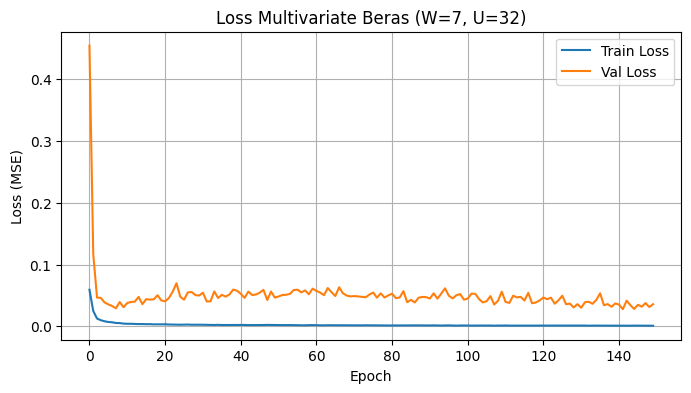

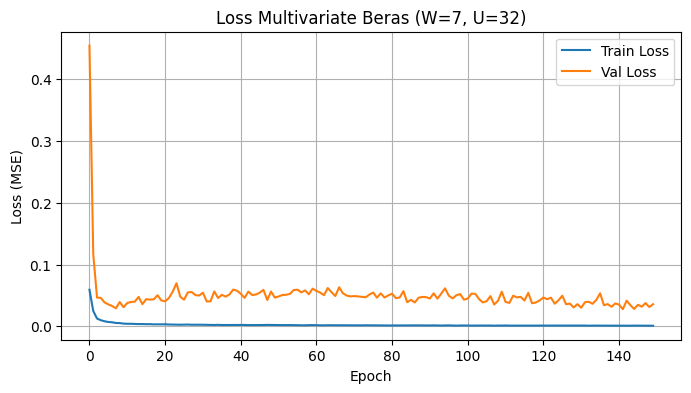

Test MAE  : 409.71
Test RMSE : 431.45
Test MAPE : 3.1668%


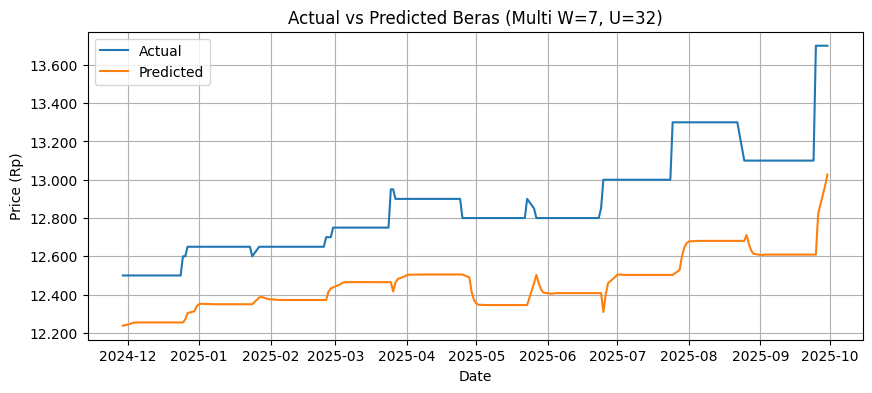

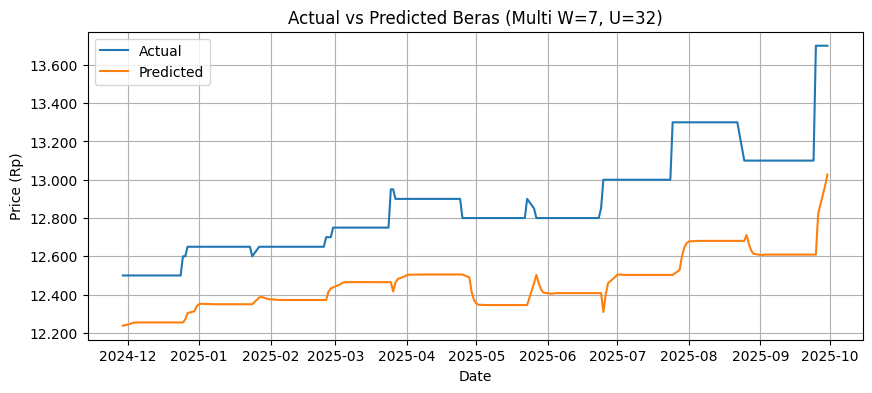


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13700,13026.826172
1,2025-10-02,13700,12817.399414
2,2025-10-03,13700,12624.728516
3,2025-10-06,13700,12461.650391
4,2025-10-07,13700,12326.274414
5,2025-10-08,13700,12217.039062
6,2025-10-09,13700,12127.585938
7,2025-10-10,13700,12055.096680
8,2025-10-13,13700,11992.665039
9,2025-10-14,13700,11939.581055


Forecast MAPE Okt 2025 : 12.2498%
Compare CSV disimpan: compare_Okt2025_multi_W7_U32.csv


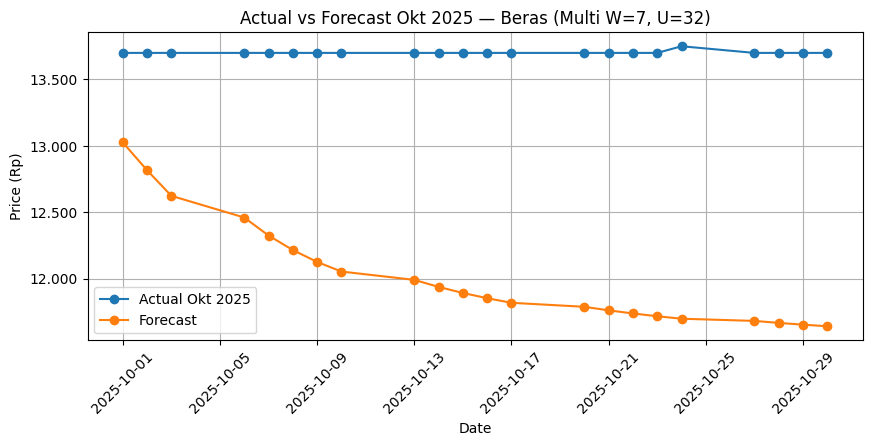

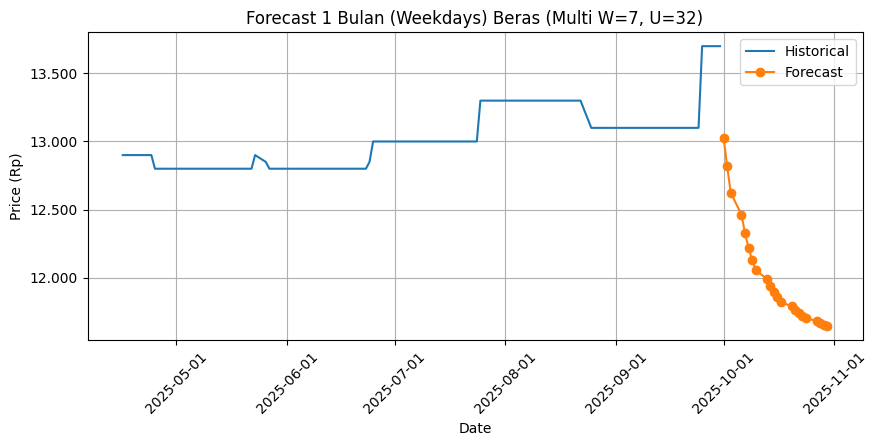

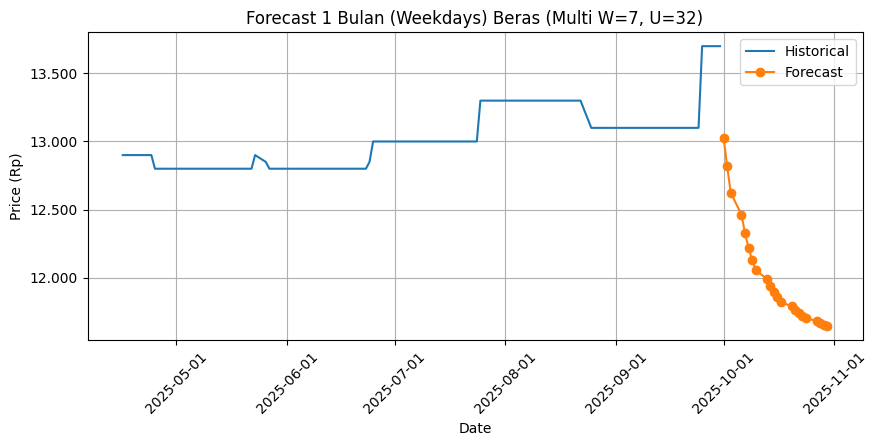


[MULTIVARIATE] Target=Beras | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.0987 - val_loss: 0.2571
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0110 - val_loss: 0.0393
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0069 - val_loss: 0.0487
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0057 - val_loss: 0.0401
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0050 - val_loss: 0.0353
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0041 - val_loss: 0.0294
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0037 - val_loss: 0.0292
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0031 - val_loss: 0.0320
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0033 - val_loss: 0.0277
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0032 - val_loss: 0.0251
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0023 - val_loss: 0.0305
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0028 - val_

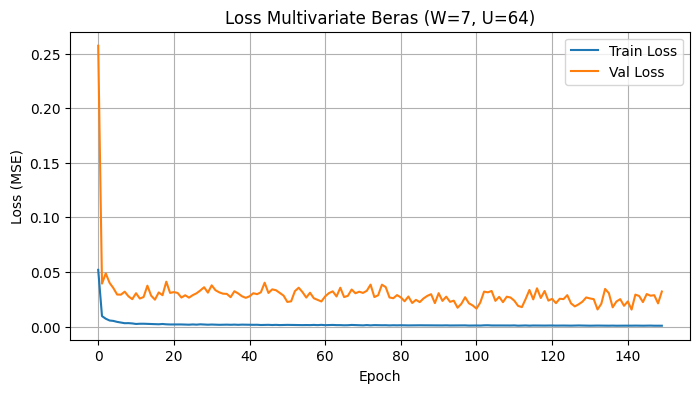

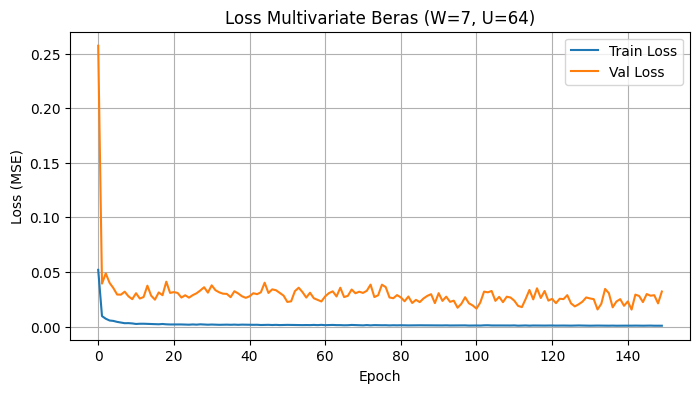

Test MAE  : 429.89
Test RMSE : 446.52
Test MAPE : 3.3258%


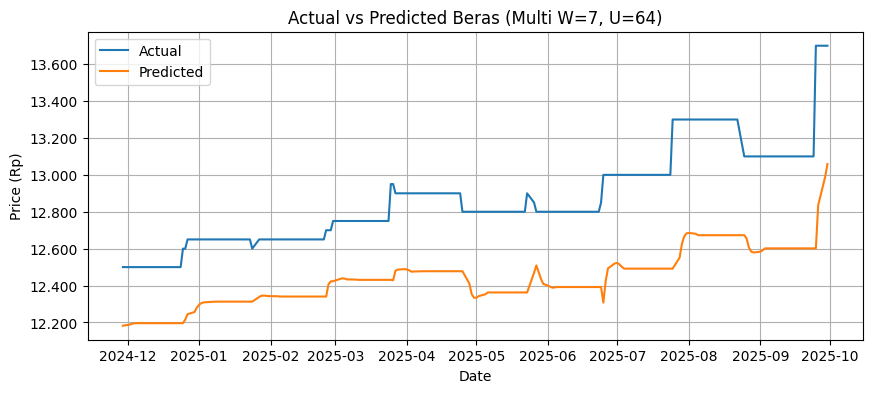

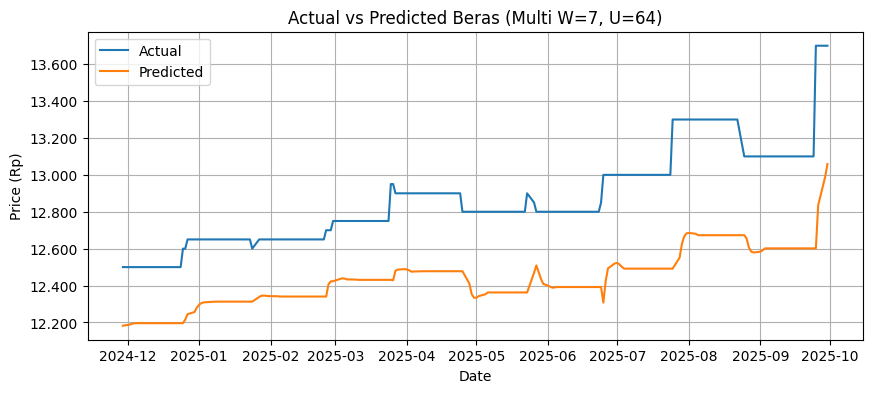


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13700,13058.465820
1,2025-10-02,13700,12819.061523
2,2025-10-03,13700,12579.110352
3,2025-10-06,13700,12359.507812
4,2025-10-07,13700,12163.518555
5,2025-10-08,13700,12004.183594
6,2025-10-09,13700,11874.182617
7,2025-10-10,13700,11773.271484
8,2025-10-13,13700,11683.378906
9,2025-10-14,13700,11607.925781


Forecast MAPE Okt 2025 : 14.4740%
Compare CSV disimpan: compare_Okt2025_multi_W7_U64.csv


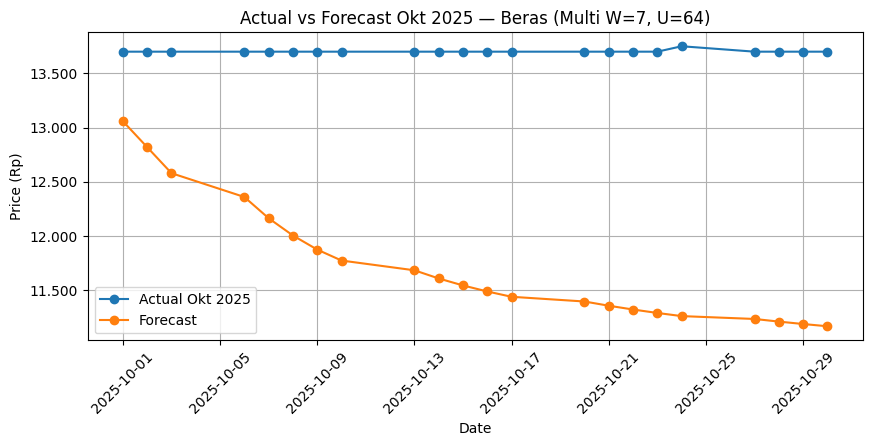

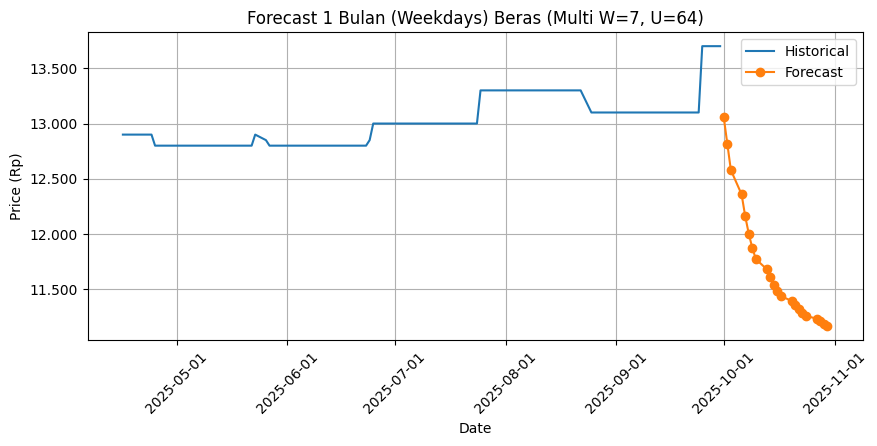

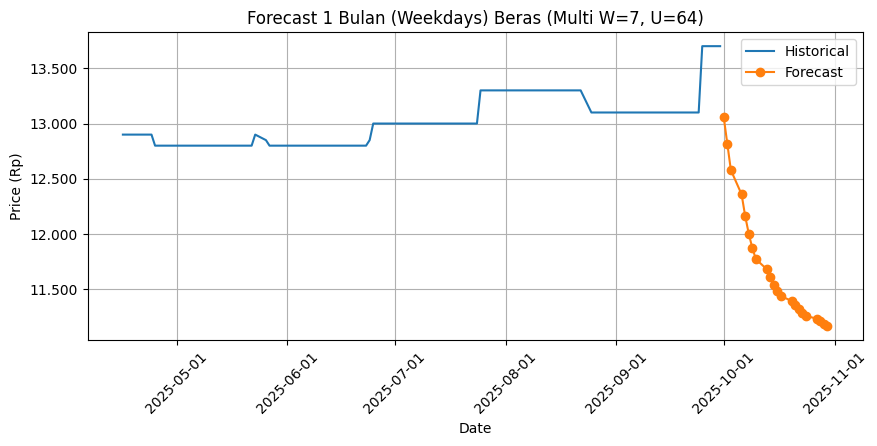


[MULTIVARIATE] Target=Beras | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.0742 - val_loss: 0.1384
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0135 - val_loss: 0.1058
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0083 - val_loss: 0.0626
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0069 - val_loss: 0.0602
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0056 - val_loss: 0.0529
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0051 - val_loss: 0.0404
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0062 - val_loss: 0.0378
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0041 - val_loss: 0.0559
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0036 - val_loss: 0.0525
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0041 - val_loss: 0.0383
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0041 - val_loss: 0.0509
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0033 - 

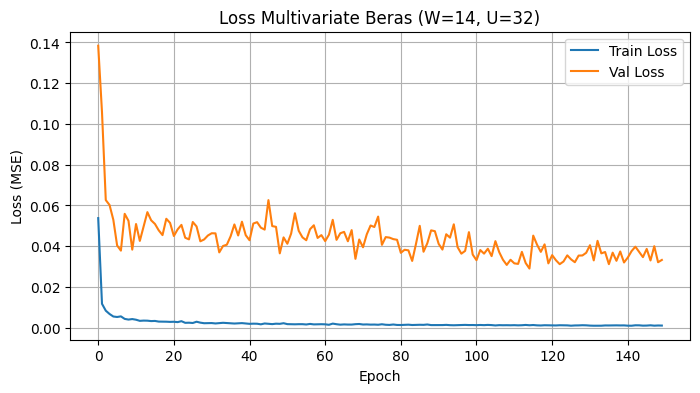

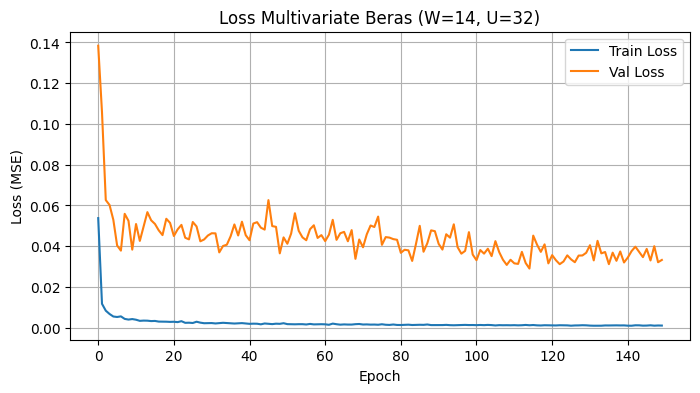

Test MAE  : 346.94
Test RMSE : 369.26
Test MAPE : 2.6774%


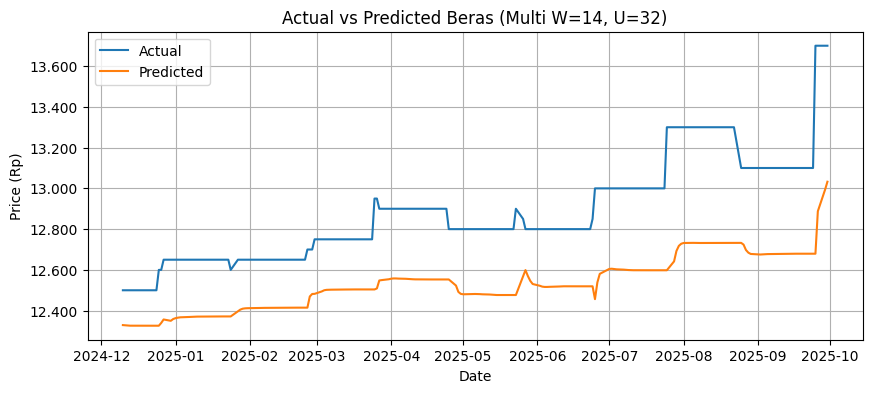

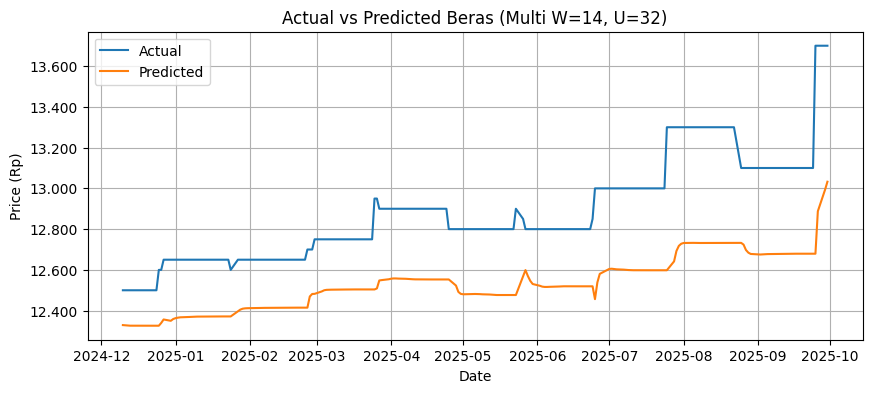


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13700,13032.641602
1,2025-10-02,13700,12795.421875
2,2025-10-03,13700,12591.131836
3,2025-10-06,13700,12424.530273
4,2025-10-07,13700,12289.648438
5,2025-10-08,13700,12180.641602
6,2025-10-09,13700,12092.242188
7,2025-10-10,13700,12019.980469
8,2025-10-13,13700,11960.218750
9,2025-10-14,13700,11910.075195


Forecast MAPE Okt 2025 : 12.4694%
Compare CSV disimpan: compare_Okt2025_multi_W14_U32.csv


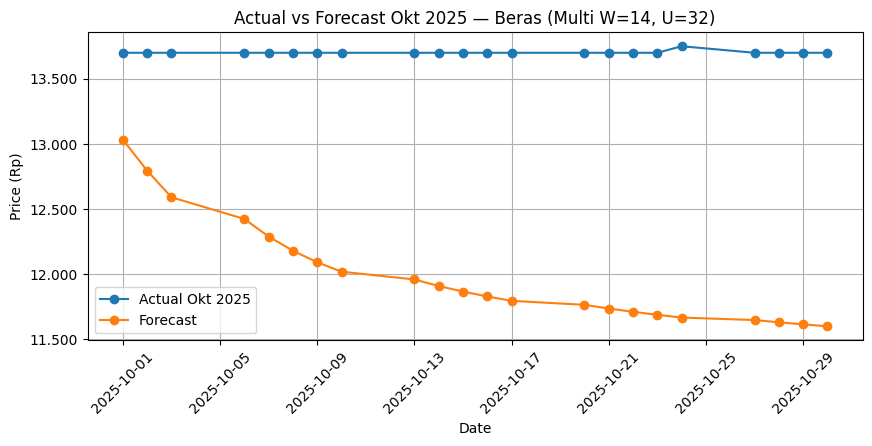

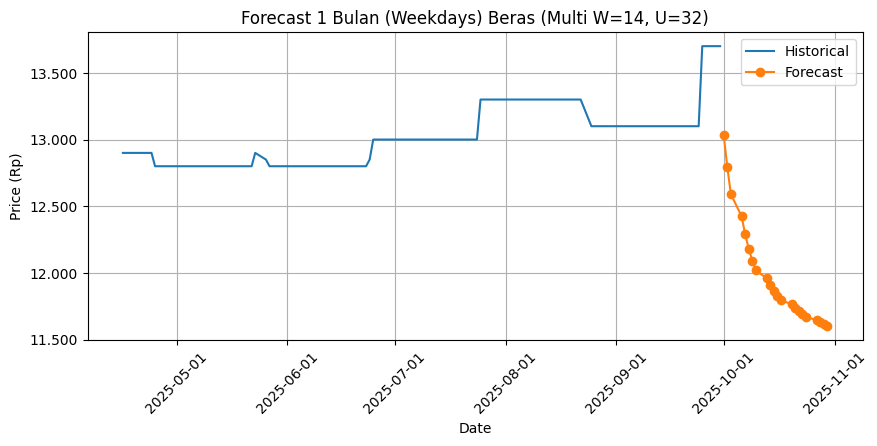

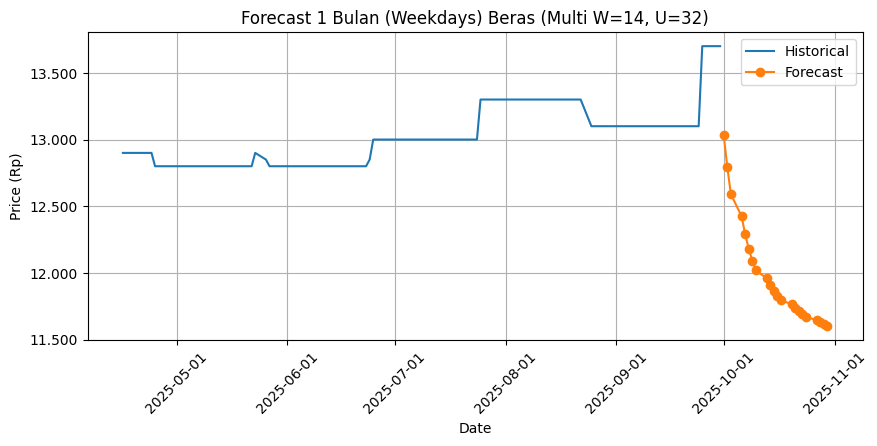


[MULTIVARIATE] Target=Beras | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.0451 - val_loss: 0.0382
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0089 - val_loss: 0.0407
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0055 - val_loss: 0.0406
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0042 - val_loss: 0.0365
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0038 - val_loss: 0.0374
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0036 - val_loss: 0.0324
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0032 - val_loss: 0.0361
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0031 - val_loss: 0.0344
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0029 - val_loss: 0.0316
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0029 - val_loss: 0.0304
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0035 - val_loss: 0.0293
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0031 - v

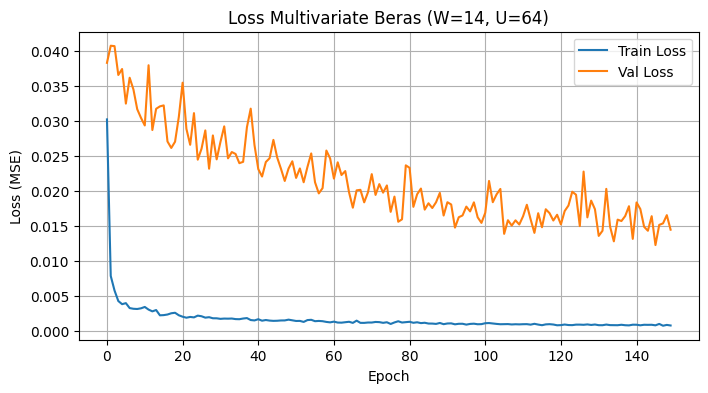

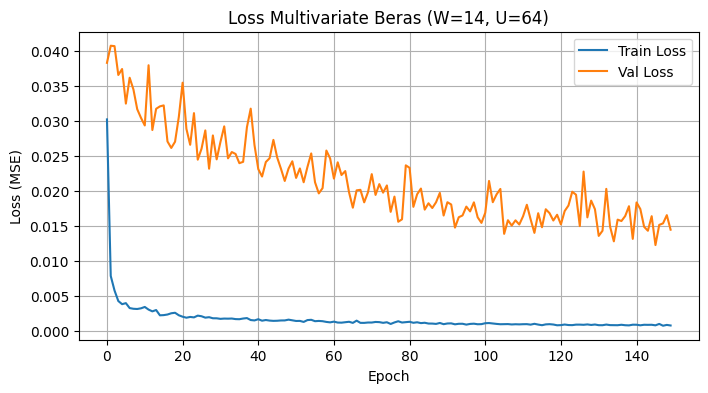

Test MAE  : 172.04
Test RMSE : 196.52
Test MAPE : 1.3249%


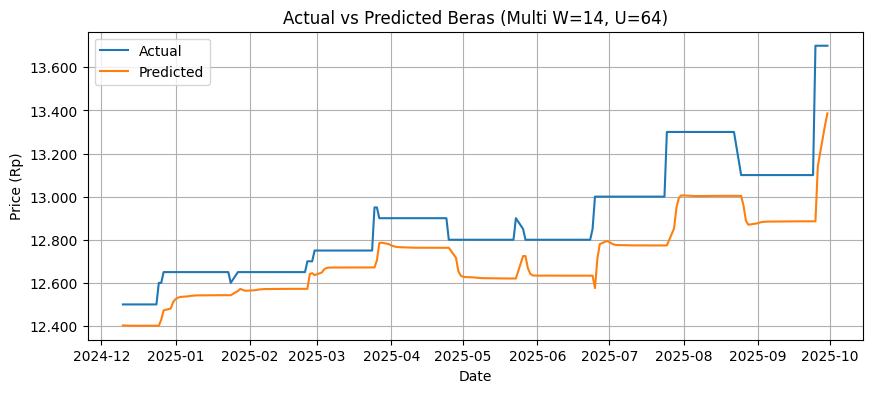

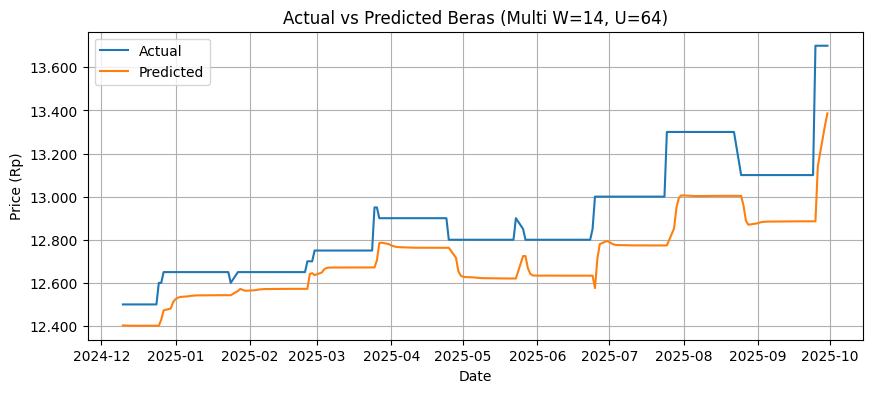


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13700,13386.365234
1,2025-10-02,13700,13240.902344
2,2025-10-03,13700,13093.717773
3,2025-10-06,13700,12968.826172
4,2025-10-07,13700,12863.869141
5,2025-10-08,13700,12774.638672
6,2025-10-09,13700,12697.478516
7,2025-10-10,13700,12629.678711
8,2025-10-13,13700,12569.316406
9,2025-10-14,13700,12515.033203


Forecast MAPE Okt 2025 : 8.4407%
Compare CSV disimpan: compare_Okt2025_multi_W14_U64.csv


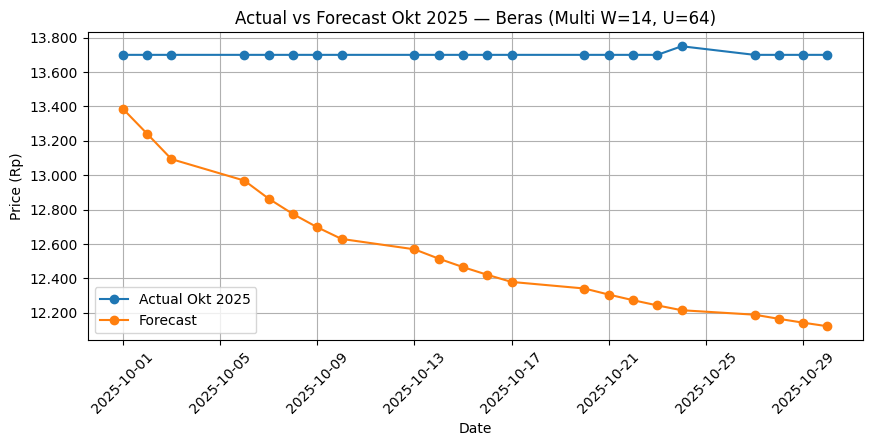

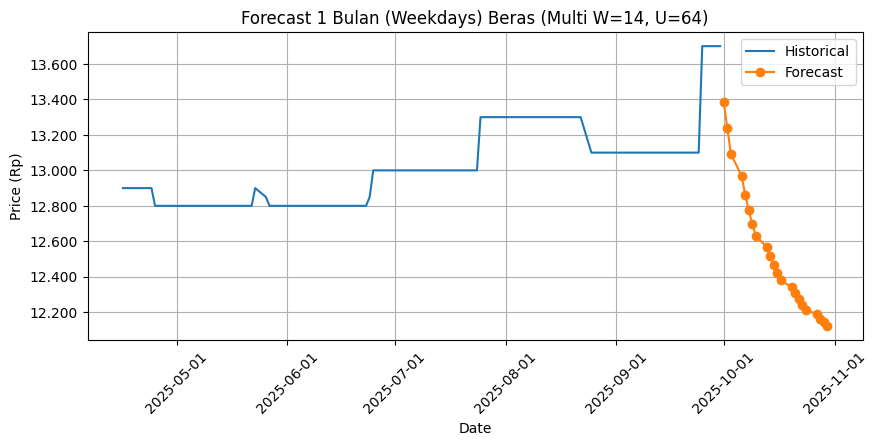

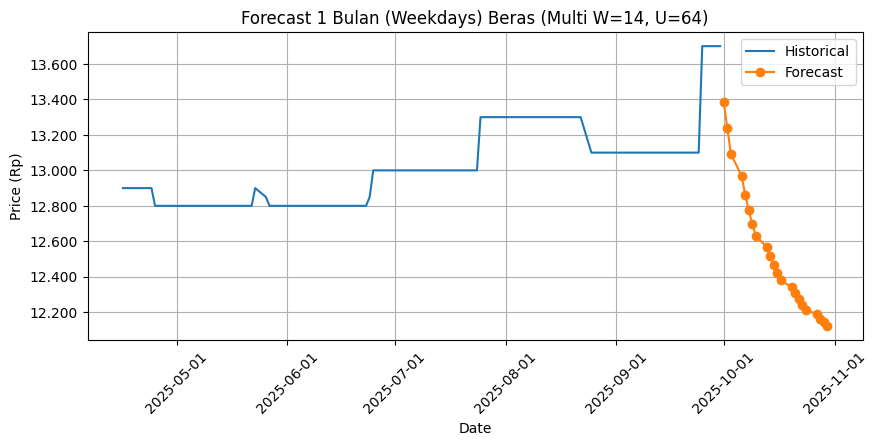


[MULTIVARIATE] Target=Beras | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - loss: 0.0527 - val_loss: 0.1015
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0151 - val_loss: 0.0606
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0102 - val_loss: 0.0572
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0075 - val_loss: 0.0533
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0062 - val_loss: 0.0486
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0052 - val_loss: 0.0541
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0050 - val_loss: 0.0504
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0048 - val_loss: 0.0472
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0044 - val_loss: 0.0499
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0036 - val_loss: 0.0466
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0038 - val_loss: 0.0442
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0

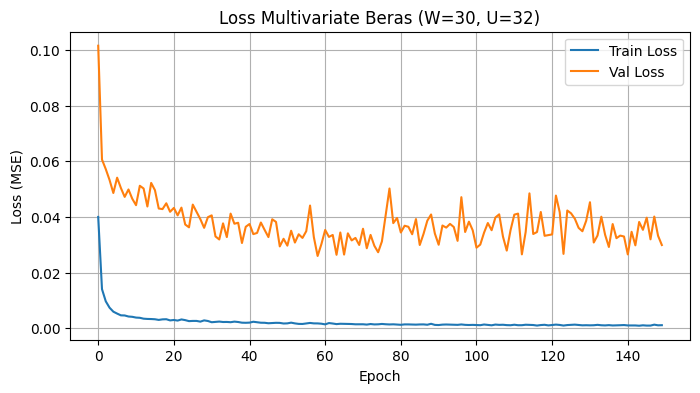

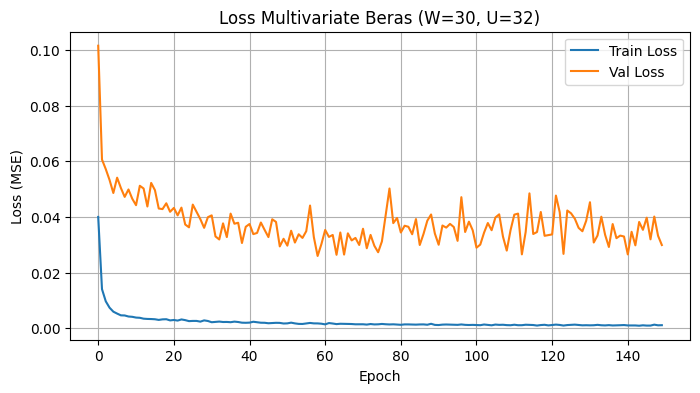

Test MAE  : 393.81
Test RMSE : 410.10
Test MAPE : 3.0375%


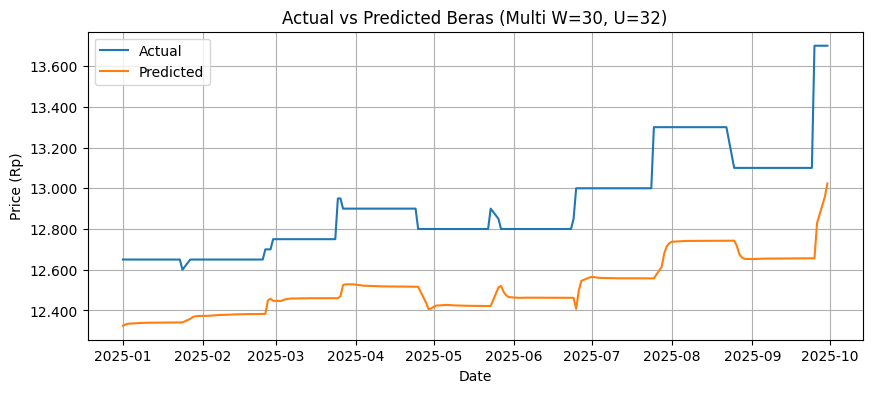

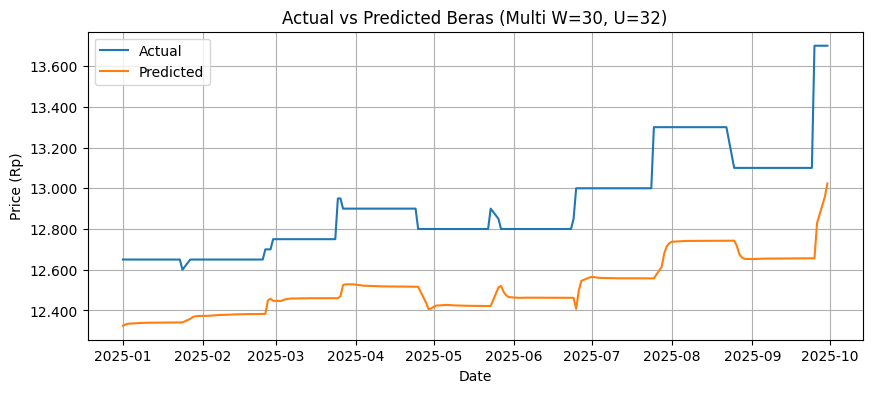


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13700,13023.318359
1,2025-10-02,13700,12818.408203
2,2025-10-03,13700,12617.182617
3,2025-10-06,13700,12438.821289
4,2025-10-07,13700,12283.266602
5,2025-10-08,13700,12147.891602
6,2025-10-09,13700,12029.535156
7,2025-10-10,13700,11925.217773
8,2025-10-13,13700,11832.411133
9,2025-10-14,13700,11749.074219


Forecast MAPE Okt 2025 : 13.9408%
Compare CSV disimpan: compare_Okt2025_multi_W30_U32.csv


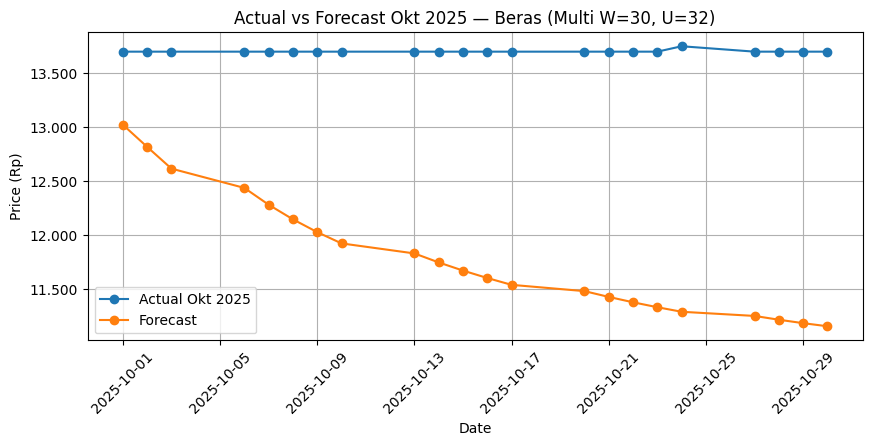

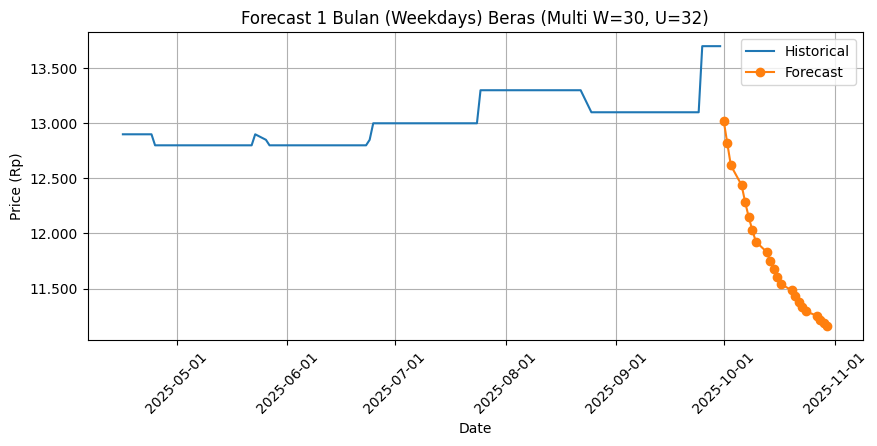

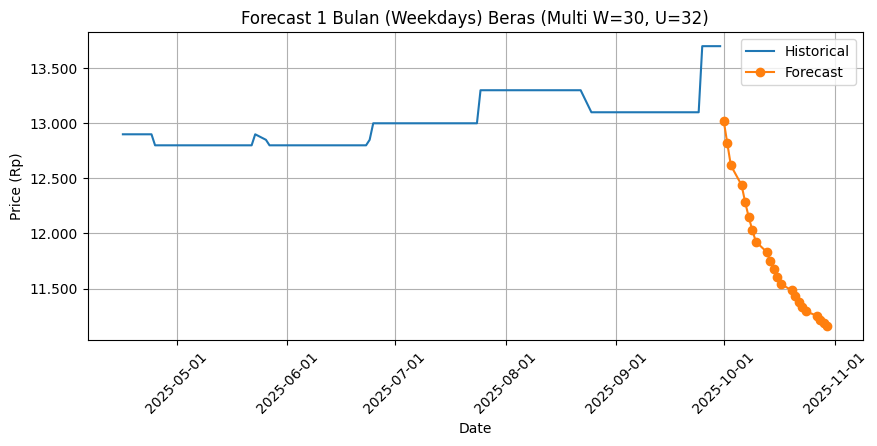


[MULTIVARIATE] Target=Beras | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step - loss: 0.0665 - val_loss: 0.1777
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0100 - val_loss: 0.1196
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0064 - val_loss: 0.1163
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0058 - val_loss: 0.0909
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0040 - val_loss: 0.0781
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0034 - val_loss: 0.0905
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0035 - val_loss: 0.0785
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0035 - val_loss: 0.1042
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0034 - val_loss: 0.0686
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0030 - val_loss: 0.0713
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0029 - val_loss: 0.0709
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 0.0

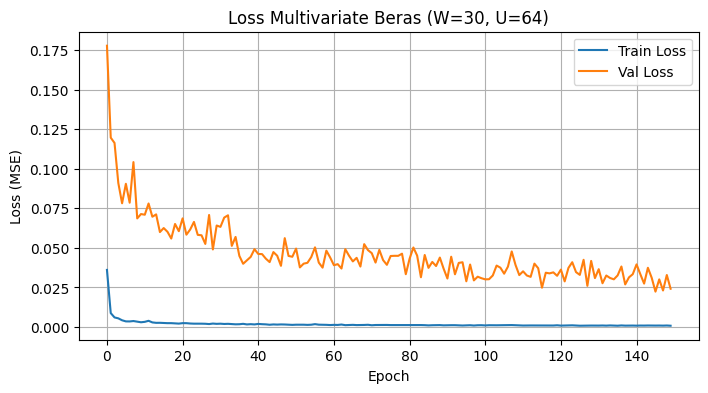

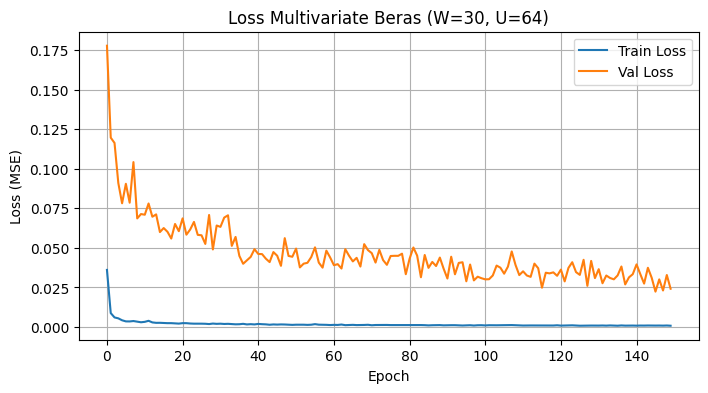

Test MAE  : 279.21
Test RMSE : 302.37
Test MAPE : 2.1493%


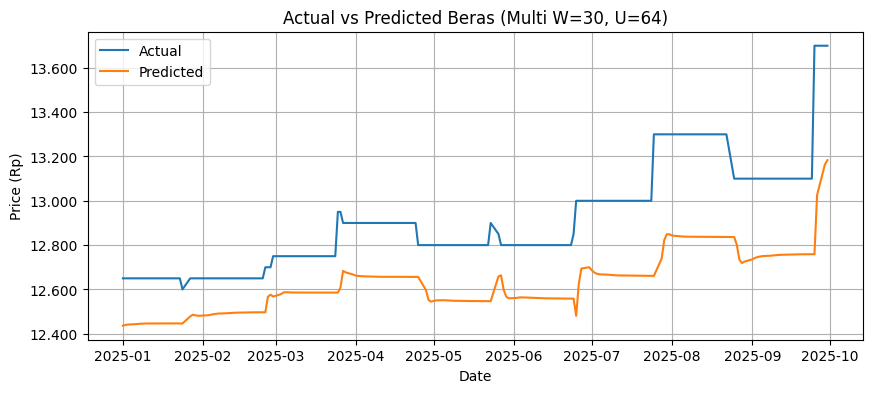

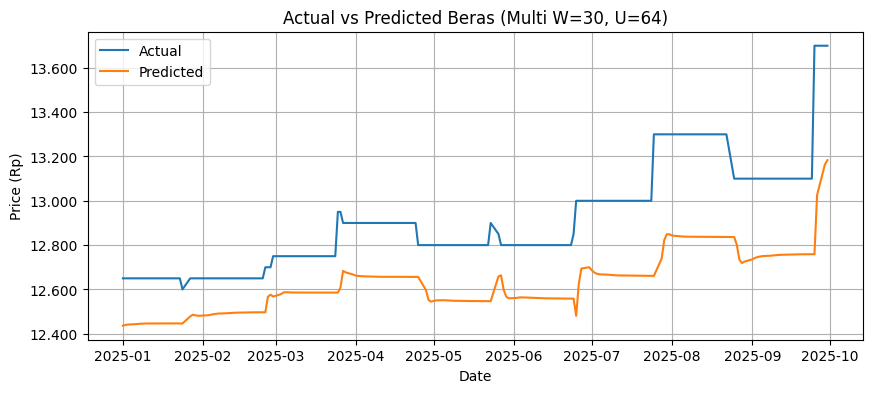


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13700,13183.574219
1,2025-10-02,13700,12914.672852
2,2025-10-03,13700,12661.156250
3,2025-10-06,13700,12470.324219
4,2025-10-07,13700,12333.145508
5,2025-10-08,13700,12235.364258
6,2025-10-09,13700,12164.623047
7,2025-10-10,13700,12111.842773
8,2025-10-13,13700,12070.841797
9,2025-10-14,13700,12037.593750


Forecast MAPE Okt 2025 : 11.3973%
Compare CSV disimpan: compare_Okt2025_multi_W30_U64.csv


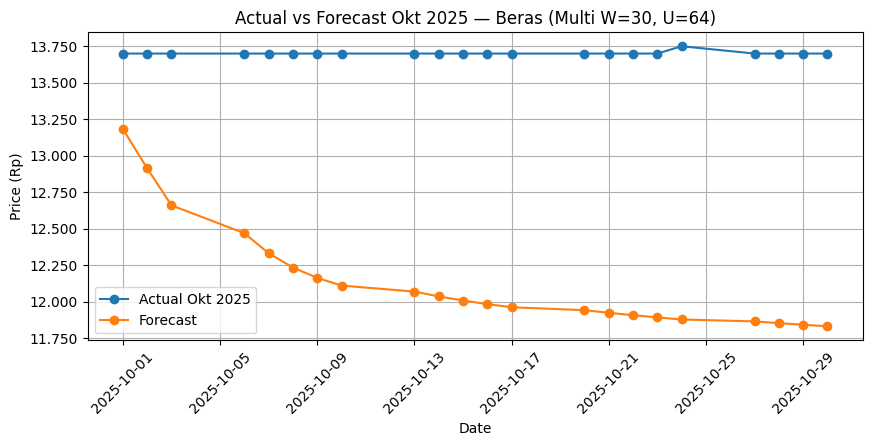

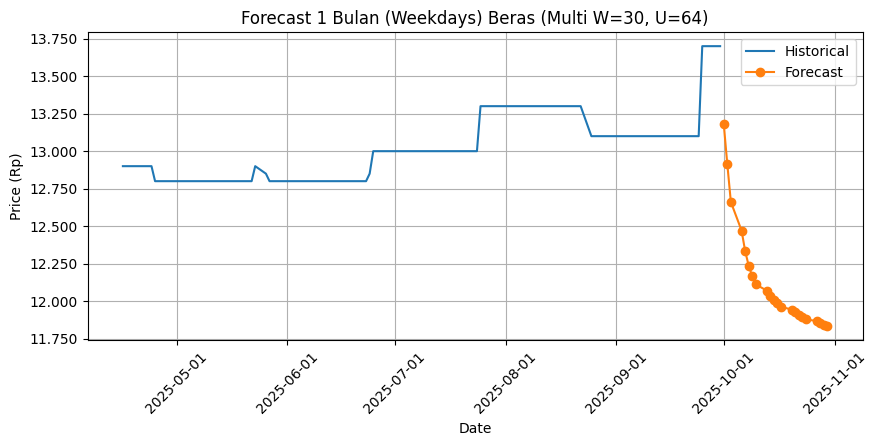

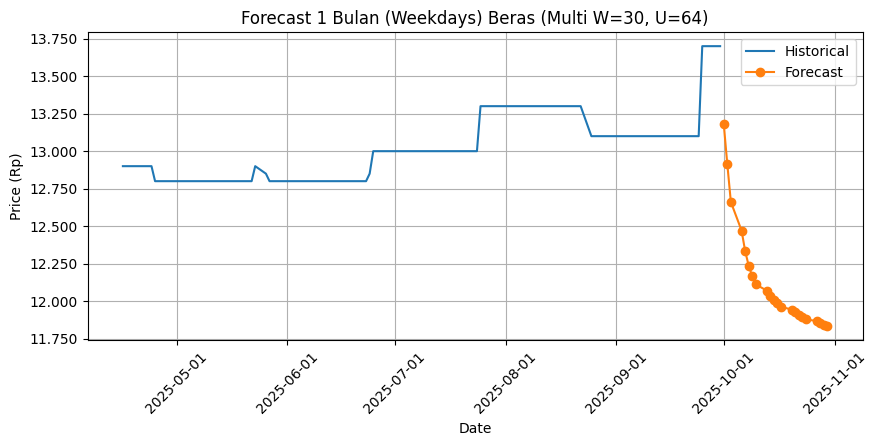


Rekap multivariate Beras disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate\Beras\hasil_multivariate_Beras.csv

==================== MULTIVARIATE: Daging Ayam ====================

[MULTIVARIATE] Target=Daging Ayam | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - loss: 0.1315 - val_loss: 0.0192
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0270 - val_loss: 0.0059
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0194 - val_loss: 0.0037
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0163 - val_loss: 0.0035
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0133 - val_loss: 0.0058
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0092 - val_loss: 0.0049
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0078 - val_loss: 0.0021
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0076 - val_loss: 0.0018
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0071 - val_loss: 0.0026
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0062 - val_loss: 0.0021
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0062 - val_loss: 0.0062
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0060 - val_l

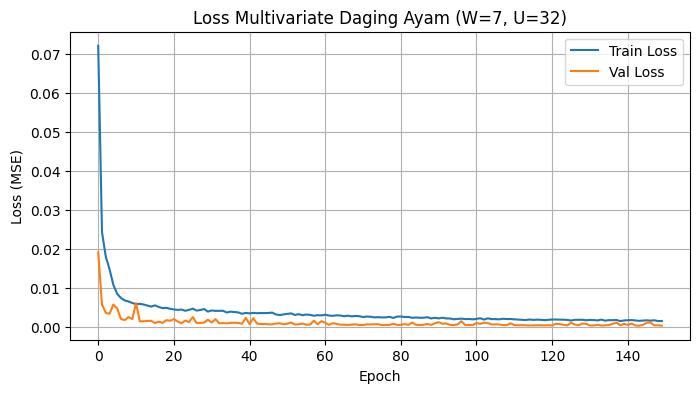

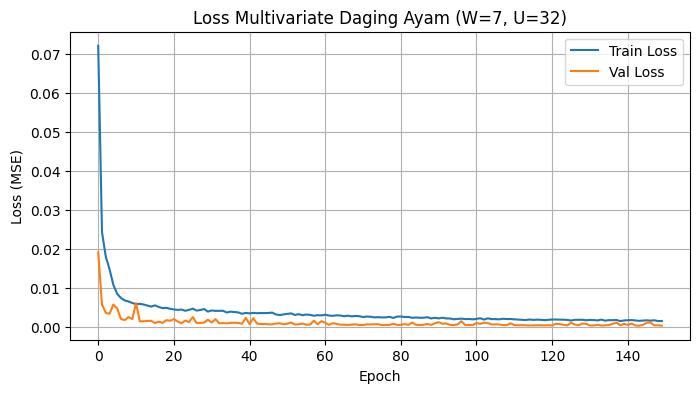

Test MAE  : 240.62
Test RMSE : 447.74
Test MAPE : 0.7673%


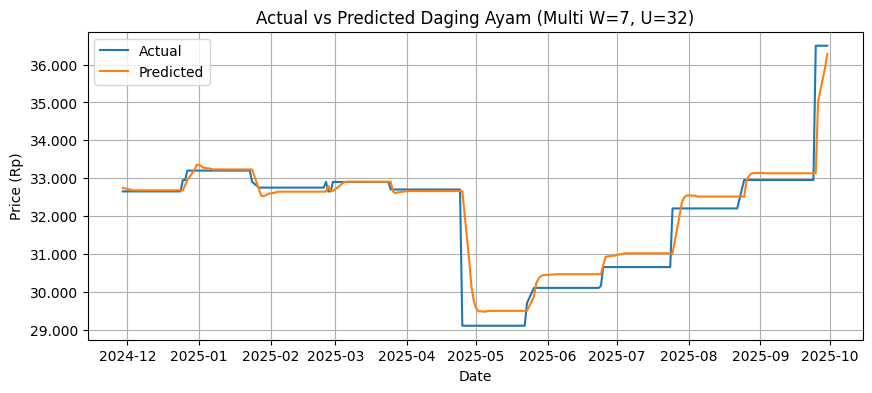

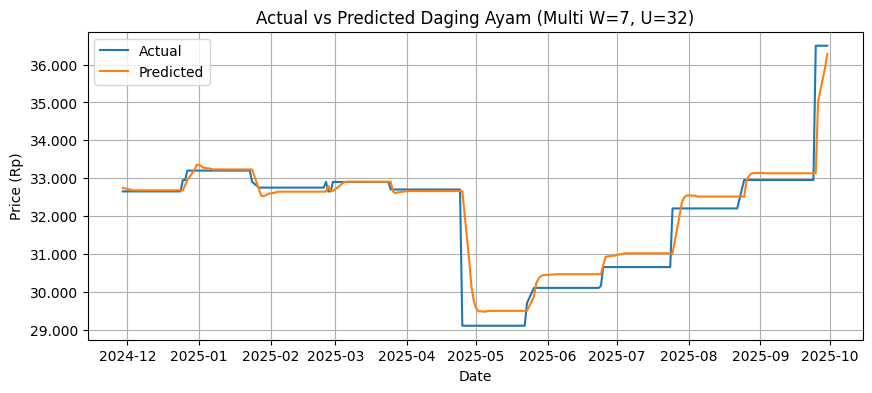


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,36500,36284.566406
1,2025-10-02,36500,36302.515625
2,2025-10-03,36500,36309.402344
3,2025-10-06,36500,36286.398438
4,2025-10-07,36500,36230.757812
5,2025-10-08,36500,36192.214844
6,2025-10-09,36500,36157.847656
7,2025-10-10,36500,36126.554688
8,2025-10-13,36500,36096.023438
9,2025-10-14,36500,36067.082031


Forecast MAPE Okt 2025 : 1.4064%
Compare CSV disimpan: compare_Okt2025_multi_W7_U32.csv


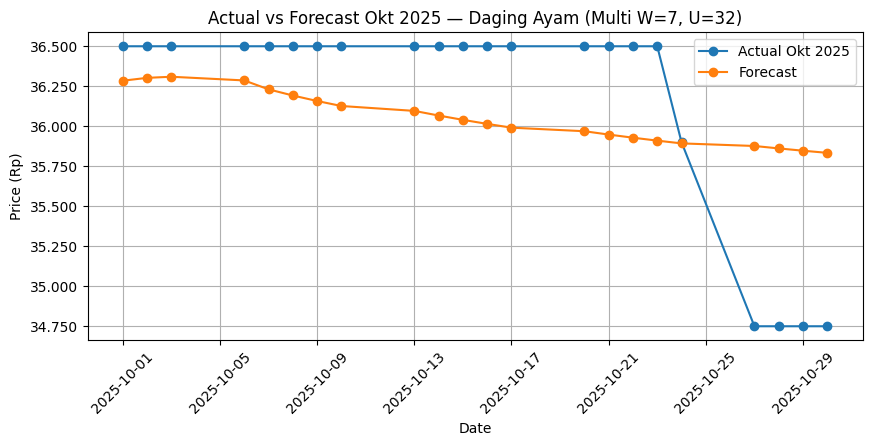

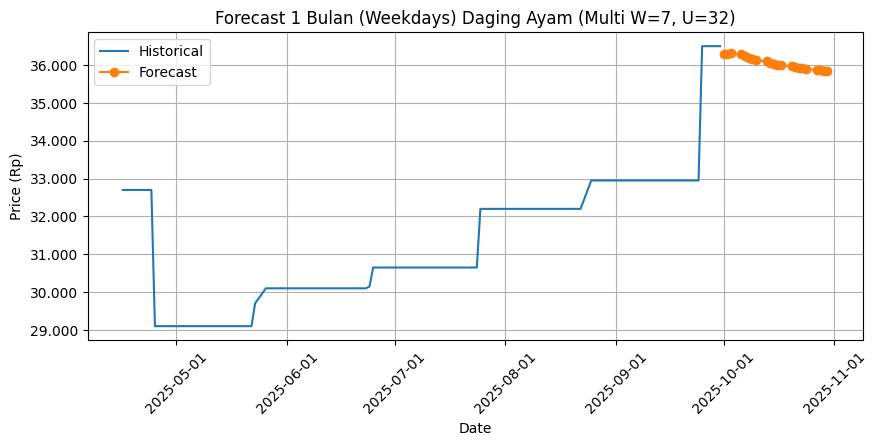

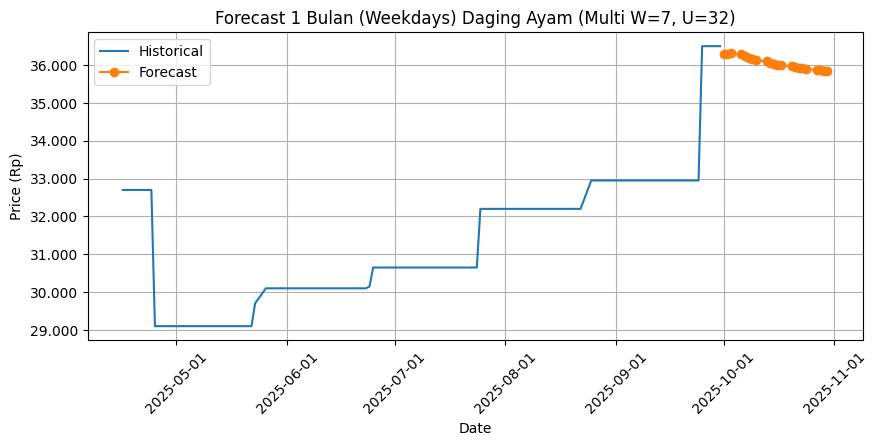


[MULTIVARIATE] Target=Daging Ayam | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.0814 - val_loss: 0.0083
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0168 - val_loss: 0.0058
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0121 - val_loss: 0.0030
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0078 - val_loss: 0.0092
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0057 - val_loss: 0.0018
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0050 - val_loss: 0.0046
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0051 - val_loss: 0.0035
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0054 - val_loss: 0.0012
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0043 - val_loss: 0.0017
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0037 - val_loss: 0.0016
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0043 - val_loss: 0.0012
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0038 - val_

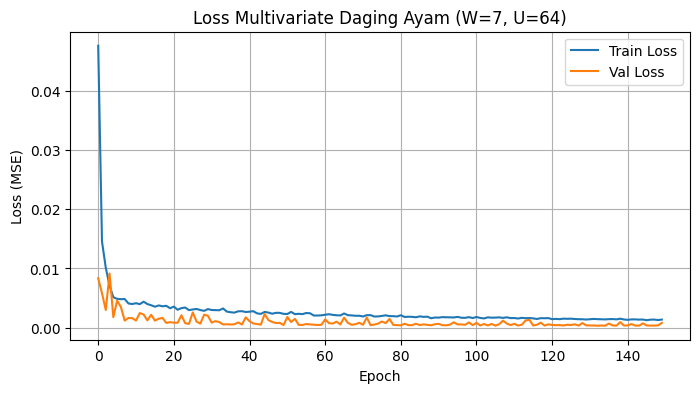

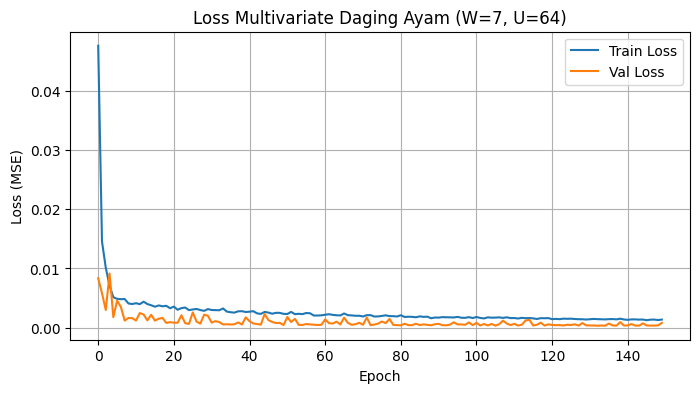

Test MAE  : 259.65
Test RMSE : 440.74
Test MAPE : 0.8056%


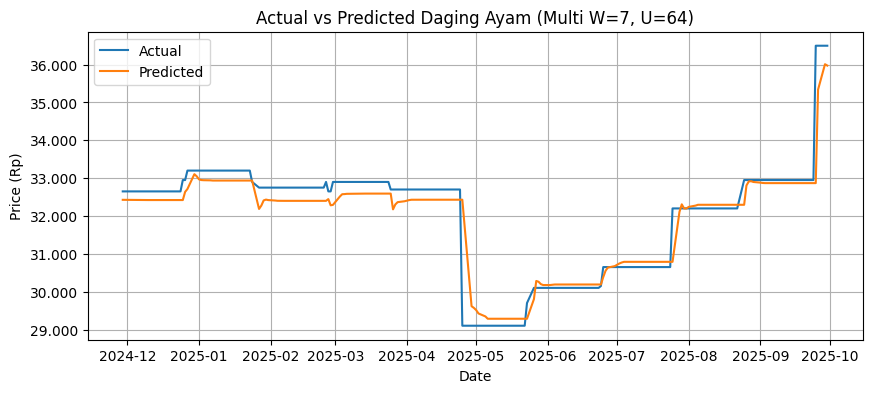

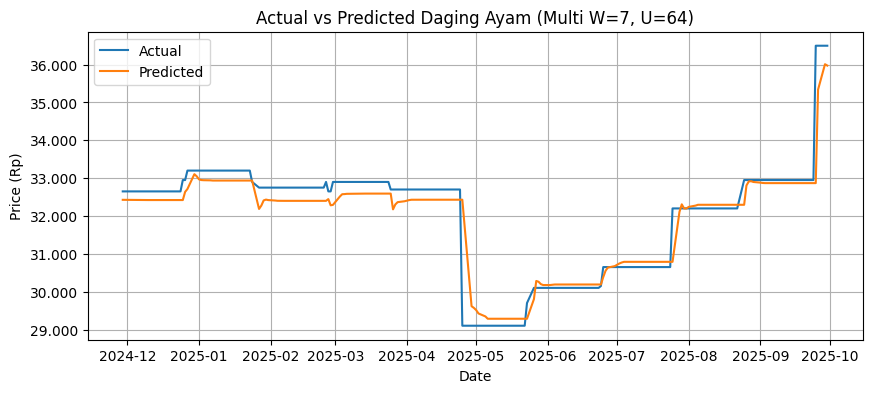


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,36500,35975.570312
1,2025-10-02,36500,35630.394531
2,2025-10-03,36500,35358.421875
3,2025-10-06,36500,35153.570312
4,2025-10-07,36500,34981.390625
5,2025-10-08,36500,34817.503906
6,2025-10-09,36500,34660.328125
7,2025-10-10,36500,34508.164062
8,2025-10-13,36500,34364.839844
9,2025-10-14,36500,34230.632812


Forecast MAPE Okt 2025 : 5.3825%
Compare CSV disimpan: compare_Okt2025_multi_W7_U64.csv


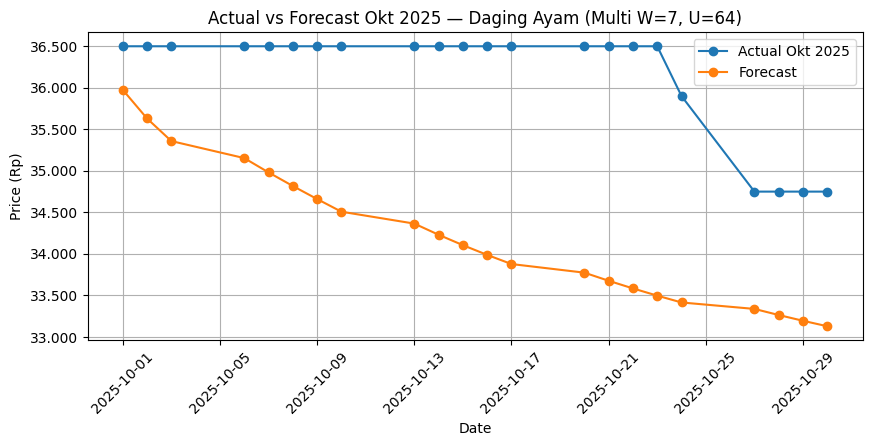

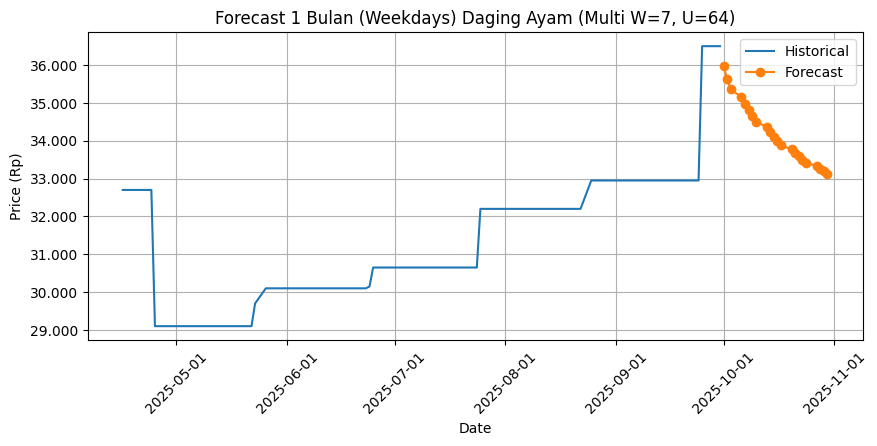

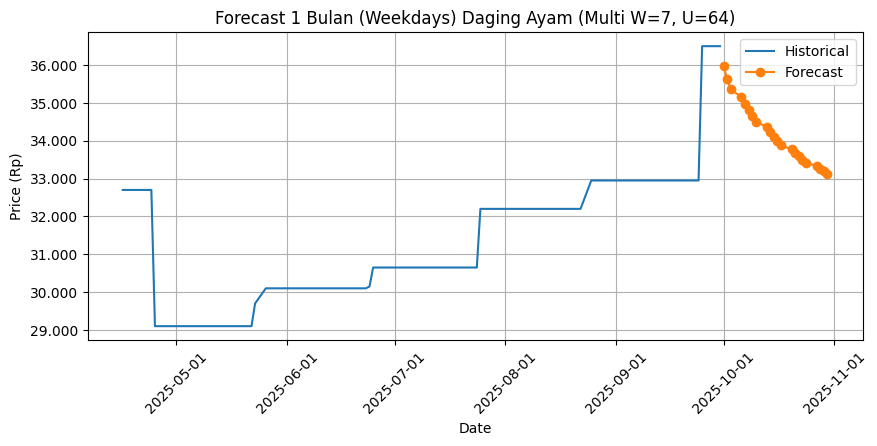


[MULTIVARIATE] Target=Daging Ayam | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 0.2393 - val_loss: 0.0061
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0282 - val_loss: 0.0099
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0207 - val_loss: 0.0073
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0174 - val_loss: 0.0054
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0115 - val_loss: 0.0080
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0112 - val_loss: 0.0131
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0096 - val_loss: 0.0079
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0090 - val_loss: 0.0073
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0068 - val_loss: 0.0102
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0075 - val_loss: 0.0085
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0069 - val_loss: 0.0048
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0

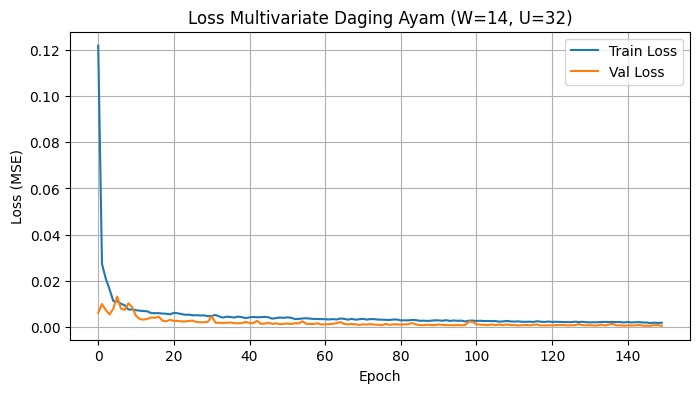

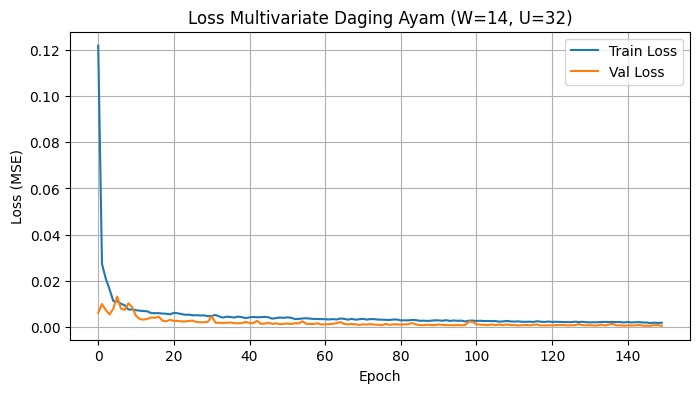

Test MAE  : 321.57
Test RMSE : 544.22
Test MAPE : 1.0369%


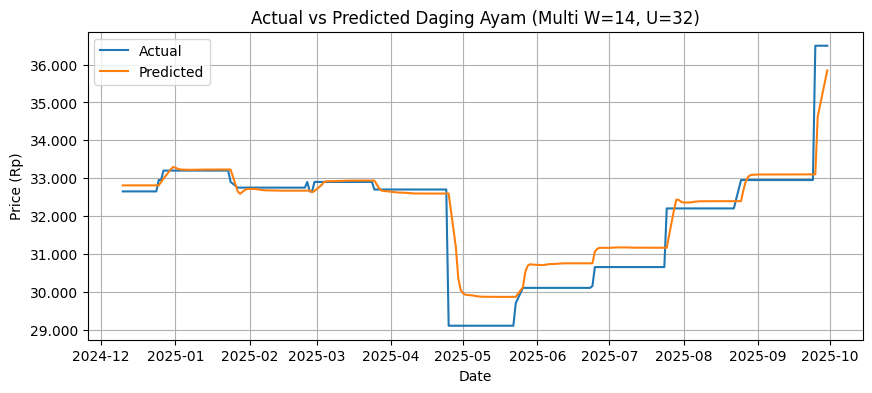

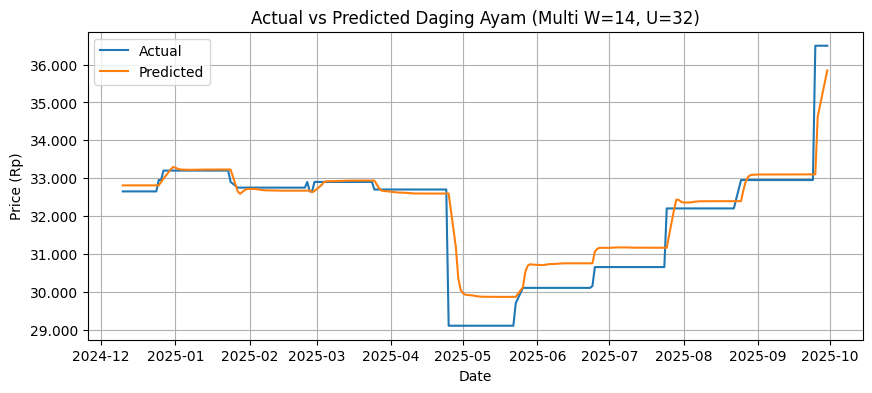


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,36500,35847.691406
1,2025-10-02,36500,35625.710938
2,2025-10-03,36500,35377.898438
3,2025-10-06,36500,35168.480469
4,2025-10-07,36500,34998.003906
5,2025-10-08,36500,34857.480469
6,2025-10-09,36500,34738.441406
7,2025-10-10,36500,34635.003906
8,2025-10-13,36500,34543.468750
9,2025-10-14,36500,34461.554688


Forecast MAPE Okt 2025 : 4.4793%
Compare CSV disimpan: compare_Okt2025_multi_W14_U32.csv


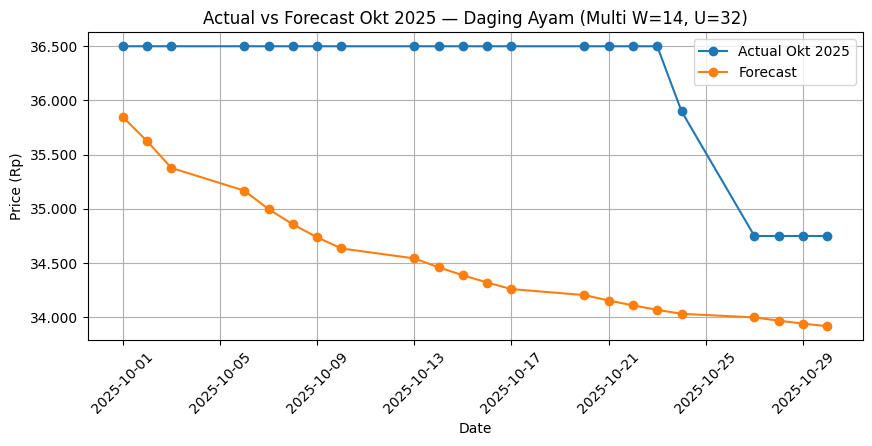

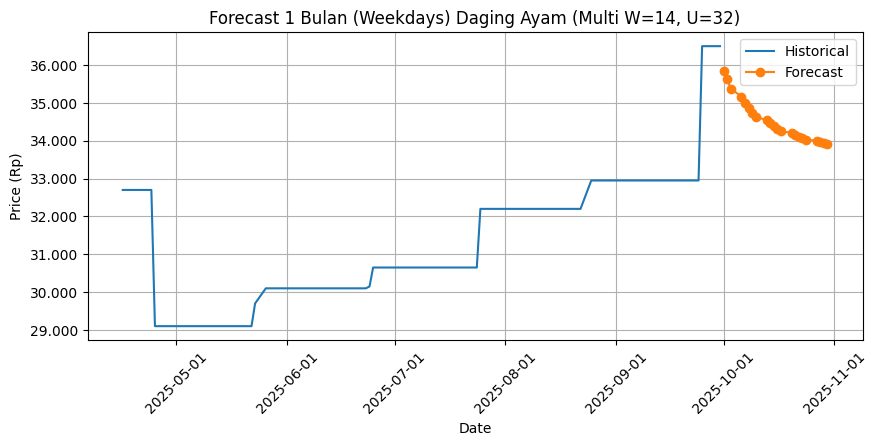

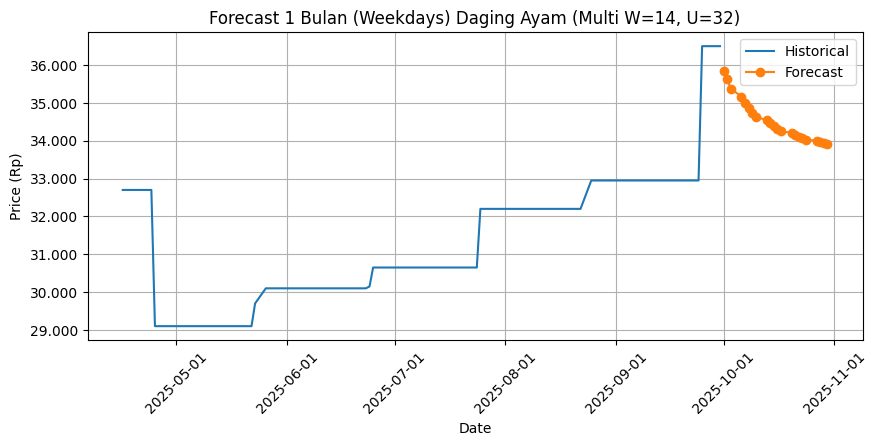


[MULTIVARIATE] Target=Daging Ayam | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.0573 - val_loss: 0.0064
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0132 - val_loss: 0.0022
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0077 - val_loss: 0.0017
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0069 - val_loss: 0.0026
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0063 - val_loss: 0.0016
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0046 - val_loss: 0.0018
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0049 - val_loss: 0.0032
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0049 - val_loss: 0.0013
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0045 - val_loss: 0.0020
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0045 - val_loss: 0.0013
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0037 - val_loss: 0.0014
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.003

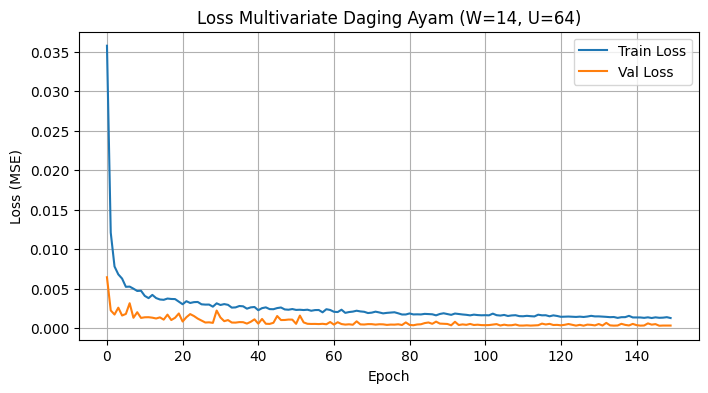

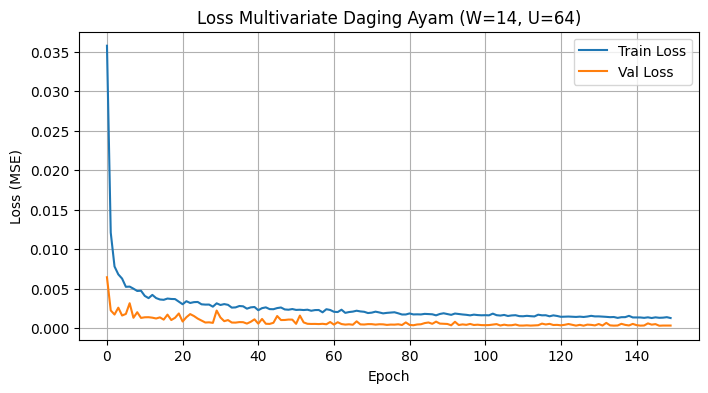

Test MAE  : 315.25
Test RMSE : 481.75
Test MAPE : 1.0060%


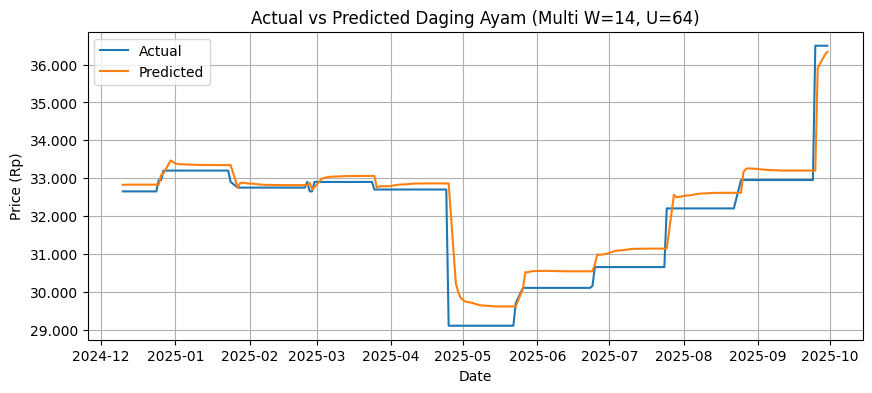

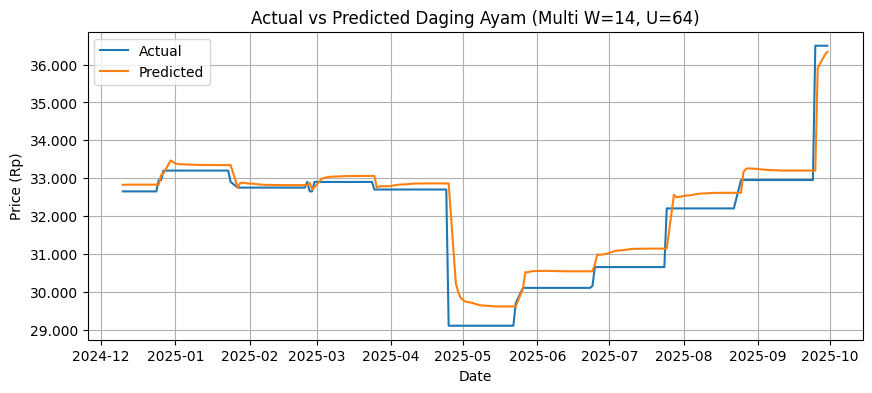


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,36500,36340.800781
1,2025-10-02,36500,36259.257812
2,2025-10-03,36500,36223.812500
3,2025-10-06,36500,36212.832031
4,2025-10-07,36500,36213.121094
5,2025-10-08,36500,36218.156250
6,2025-10-09,36500,36225.289062
7,2025-10-10,36500,36233.457031
8,2025-10-13,36500,36242.136719
9,2025-10-14,36500,36251.000000


Forecast MAPE Okt 2025 : 1.3828%
Compare CSV disimpan: compare_Okt2025_multi_W14_U64.csv


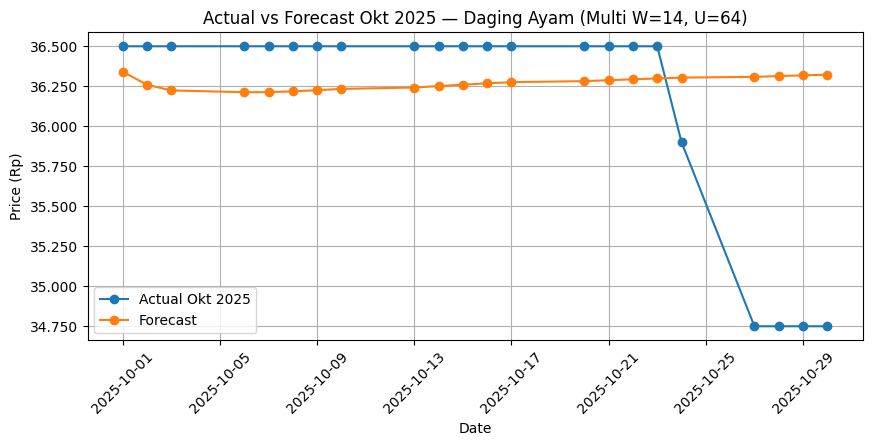

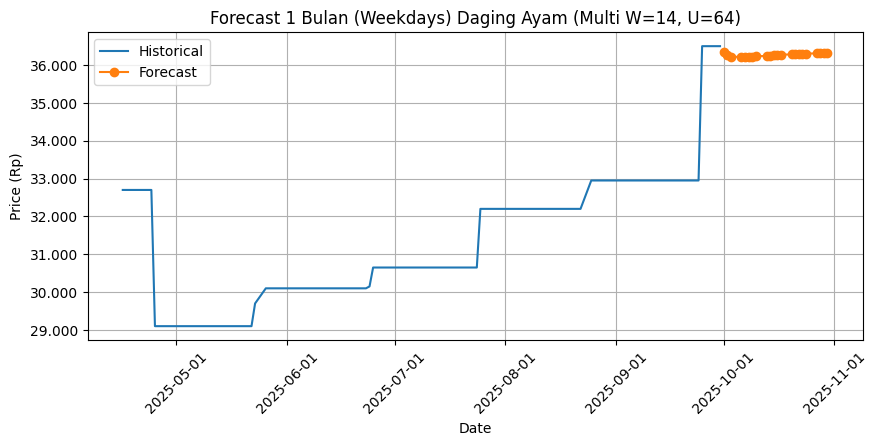

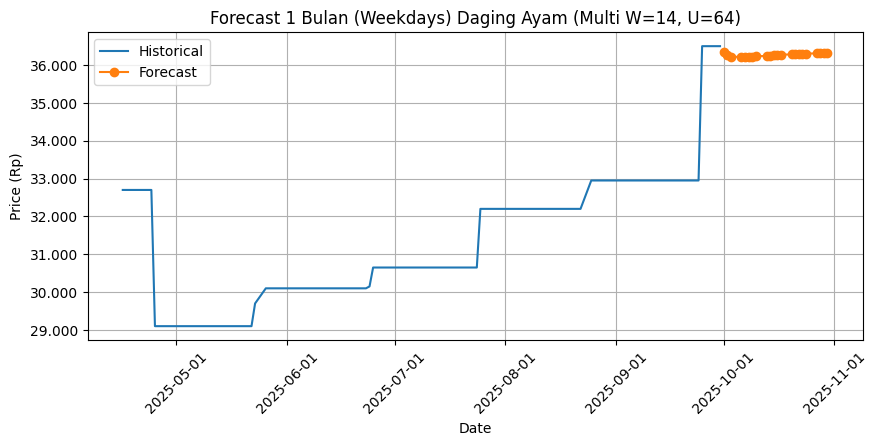


[MULTIVARIATE] Target=Daging Ayam | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - loss: 0.1208 - val_loss: 0.0472
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0254 - val_loss: 0.0066
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0180 - val_loss: 0.0051
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0115 - val_loss: 0.0026
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0087 - val_loss: 0.0039
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0070 - val_loss: 0.0036
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0067 - val_loss: 0.0037
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0067 - val_loss: 0.0029
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0069 - val_loss: 0.0023
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0065 - val_loss: 0.0024
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0053 - val_loss: 0.0019
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0

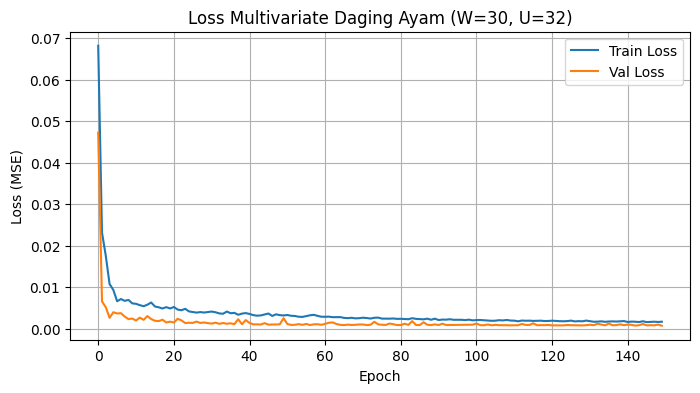

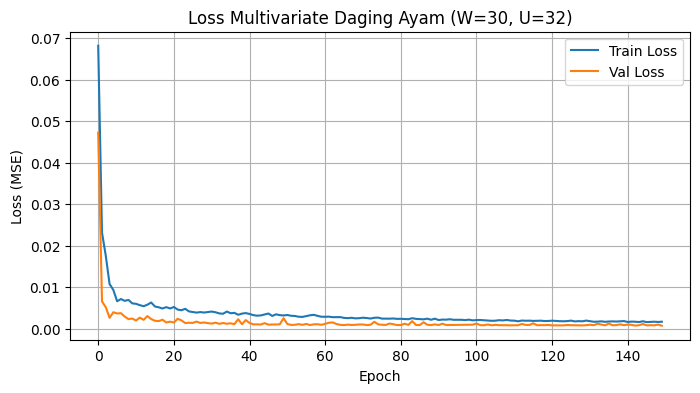

Test MAE  : 573.68
Test RMSE : 788.64
Test MAPE : 1.8548%


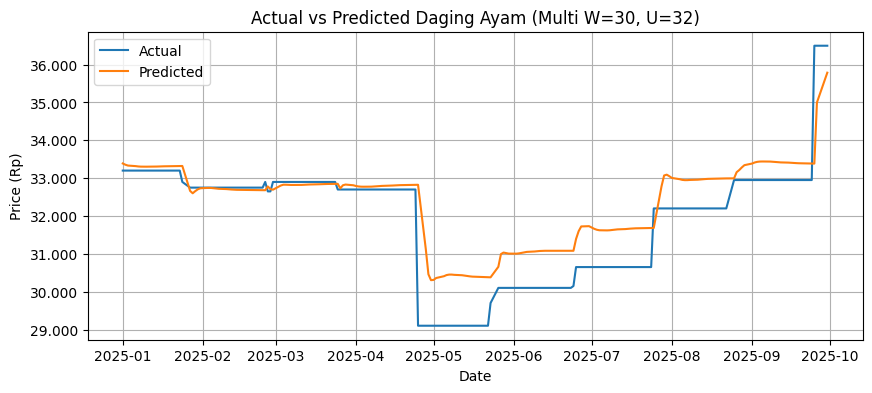

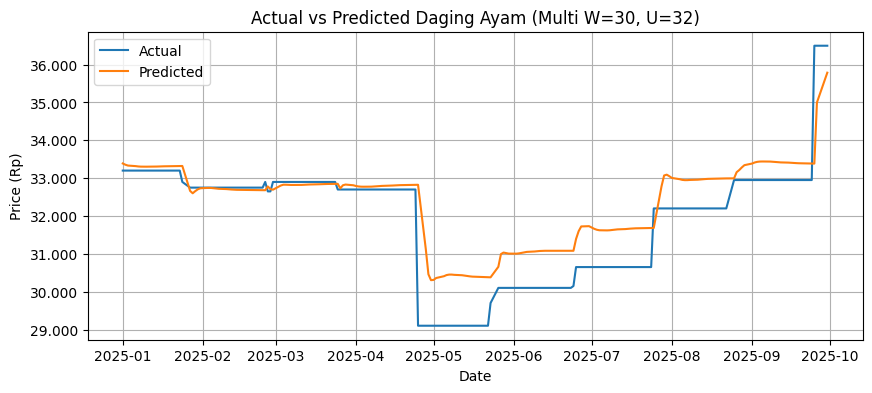


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,36500,35787.250000
1,2025-10-02,36500,35459.898438
2,2025-10-03,36500,35138.796875
3,2025-10-06,36500,34847.585938
4,2025-10-07,36500,34601.710938
5,2025-10-08,36500,34409.656250
6,2025-10-09,36500,34270.585938
7,2025-10-10,36500,34178.476562
8,2025-10-13,36500,34124.457031
9,2025-10-14,36500,34098.855469


Forecast MAPE Okt 2025 : 4.8613%
Compare CSV disimpan: compare_Okt2025_multi_W30_U32.csv


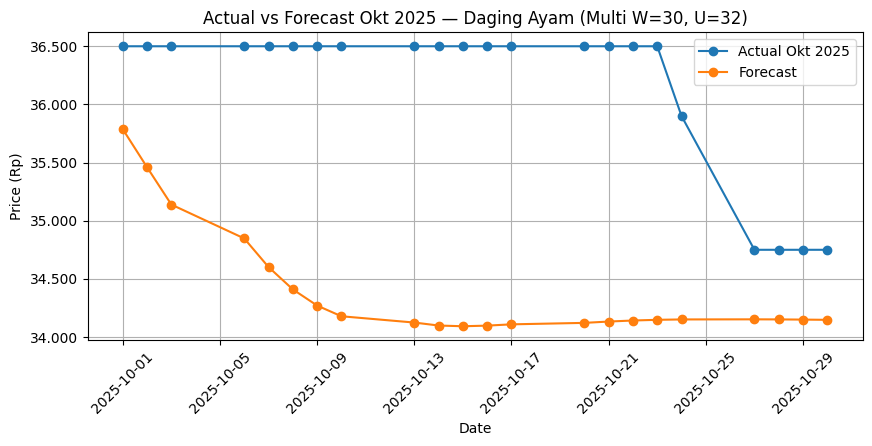

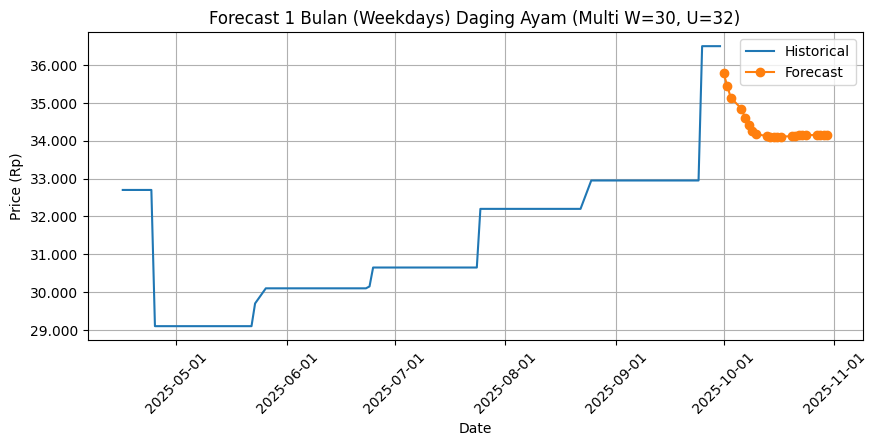

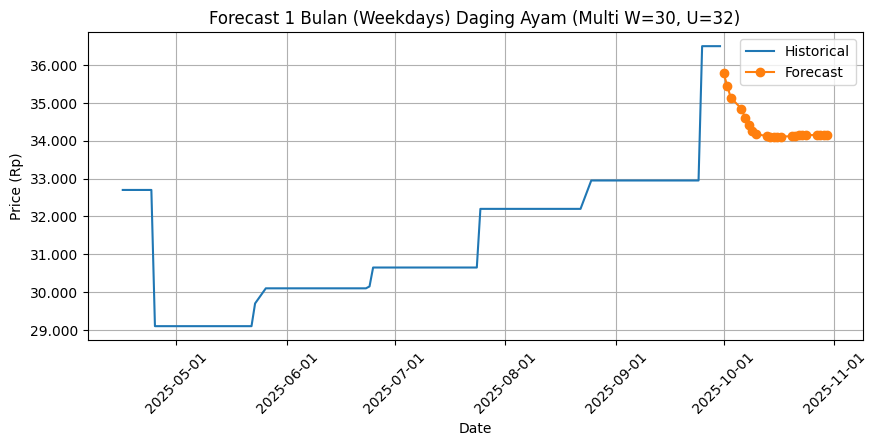


[MULTIVARIATE] Target=Daging Ayam | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 0.1068 - val_loss: 0.0137
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0190 - val_loss: 0.0050
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0108 - val_loss: 0.0042
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0083 - val_loss: 0.0037
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0076 - val_loss: 0.0039
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0060 - val_loss: 0.0043
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0055 - val_loss: 0.0025
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0058 - val_loss: 0.0044
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0052 - val_loss: 0.0054
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0050 - val_loss: 0.0028
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0047 - val_loss: 0.0036
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0

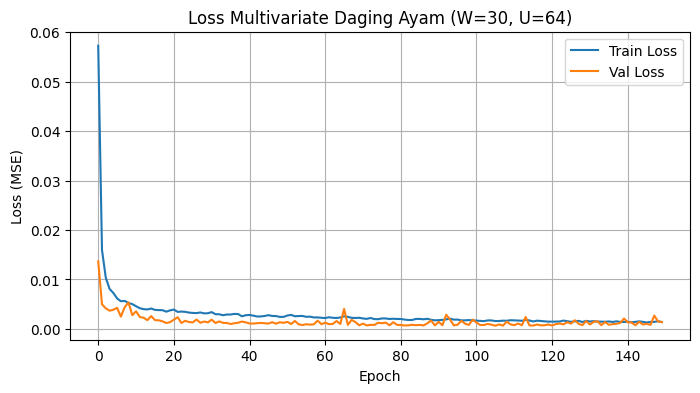

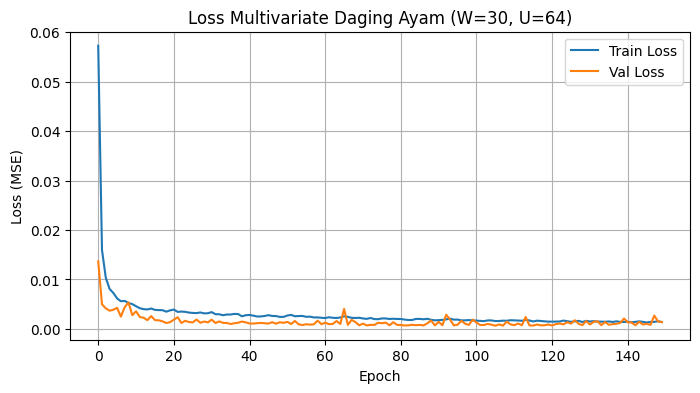

Test MAE  : 721.63
Test RMSE : 836.42
Test MAPE : 2.2914%


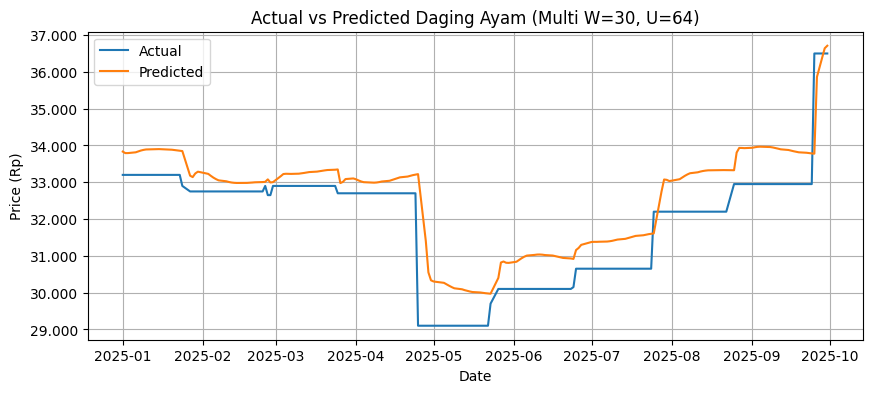

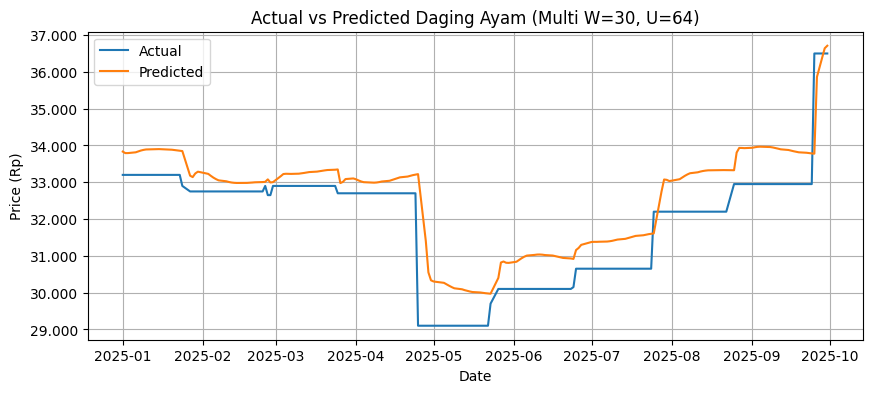


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,36500,36710.988281
1,2025-10-02,36500,36804.671875
2,2025-10-03,36500,36918.433594
3,2025-10-06,36500,37060.531250
4,2025-10-07,36500,37227.378906
5,2025-10-08,36500,37406.960938
6,2025-10-09,36500,37589.804688
7,2025-10-10,36500,37767.976562
8,2025-10-13,36500,37936.308594
9,2025-10-14,36500,38091.980469


Forecast MAPE Okt 2025 : 5.4798%
Compare CSV disimpan: compare_Okt2025_multi_W30_U64.csv


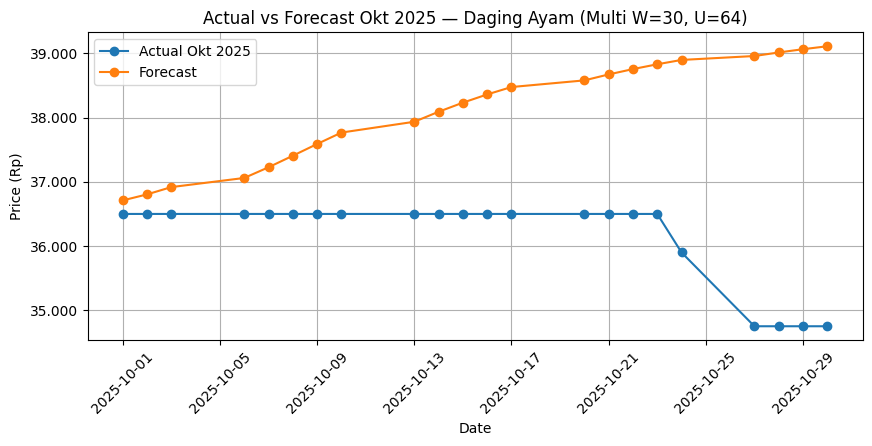

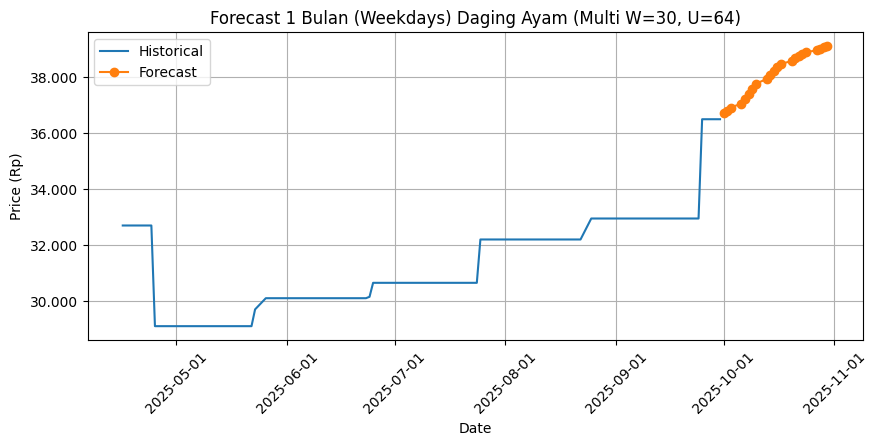

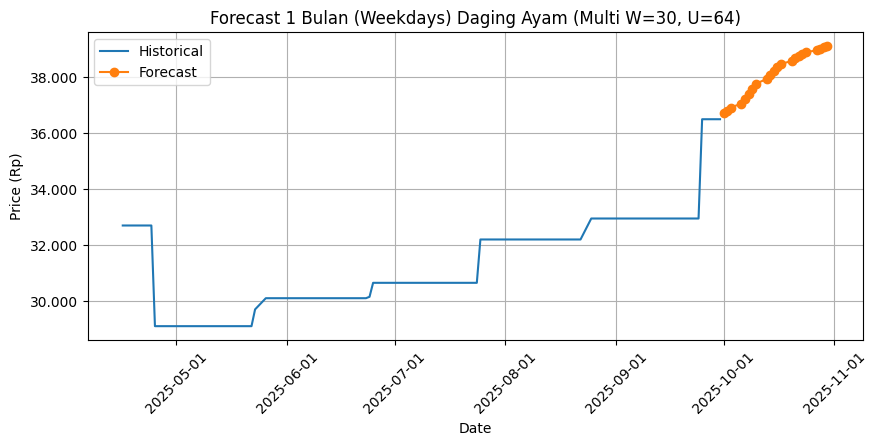


Rekap multivariate Daging Ayam disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate\Daging_Ayam\hasil_multivariate_Daging_Ayam.csv

==================== MULTIVARIATE: Daging Sapi ====================

[MULTIVARIATE] Target=Daging Sapi | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - loss: 0.3873 - val_loss: 0.0173
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0418 - val_loss: 0.0037
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0272 - val_loss: 0.0021
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0177 - val_loss: 0.0015
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0149 - val_loss: 0.0151
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0115 - val_loss: 0.0194
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0105 - val_loss: 0.0159
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0084 - val_loss: 0.0144
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0081 - val_loss: 0.0119
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0070 - val_loss: 0.0111
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0070 - val_loss: 0.0144
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0064 - val_

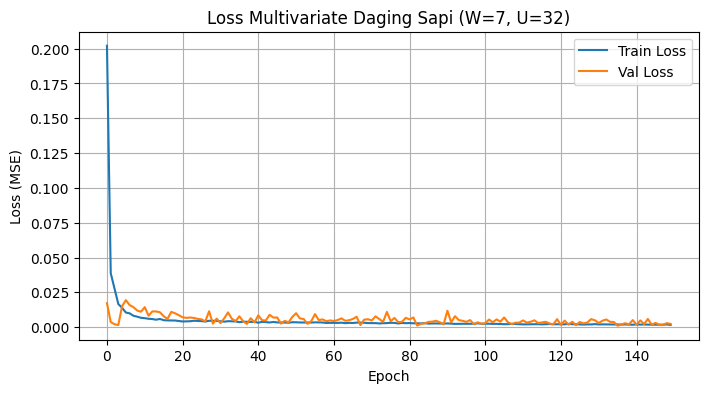

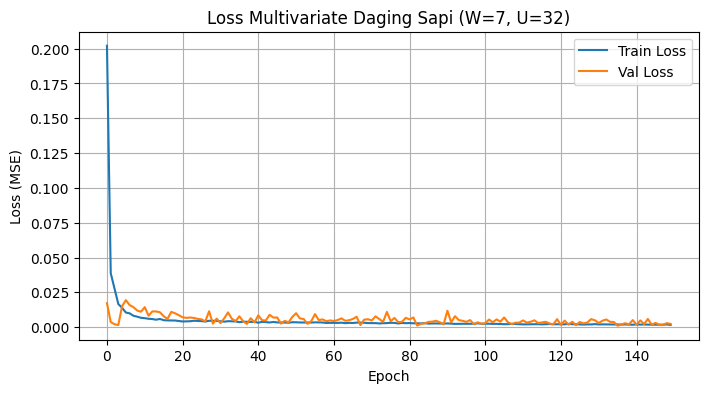

Test MAE  : 1,267.22
Test RMSE : 1,354.72
Test MAPE : 1.0475%


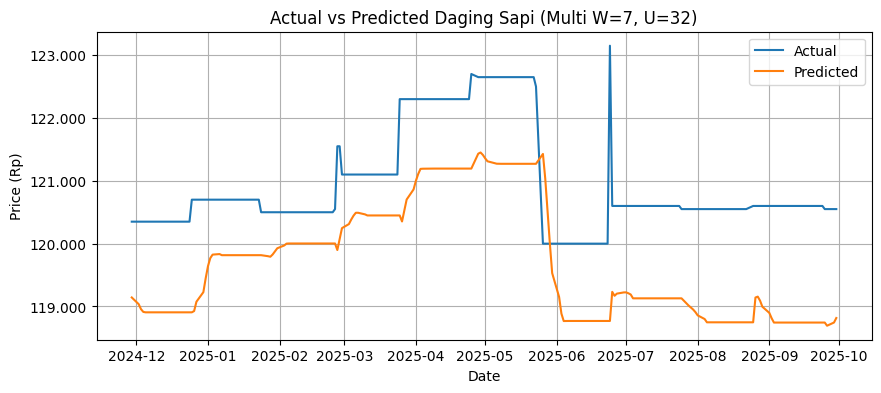

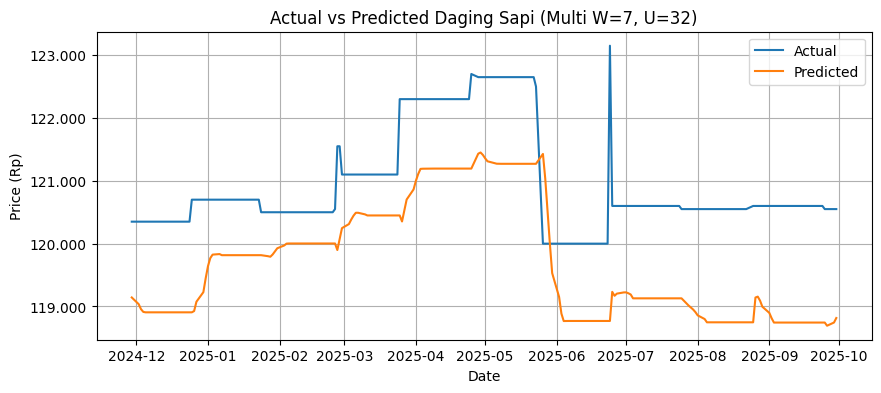


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,120550,118816.601562
1,2025-10-02,120550,118538.664062
2,2025-10-03,120550,118210.515625
3,2025-10-06,120550,117825.375000
4,2025-10-07,120550,117395.406250
5,2025-10-08,120550,117010.773438
6,2025-10-09,120550,116635.578125
7,2025-10-10,120550,116280.796875
8,2025-10-13,120550,115971.929688
9,2025-10-14,120550,115671.773438


Forecast MAPE Okt 2025 : 4.1492%
Compare CSV disimpan: compare_Okt2025_multi_W7_U32.csv


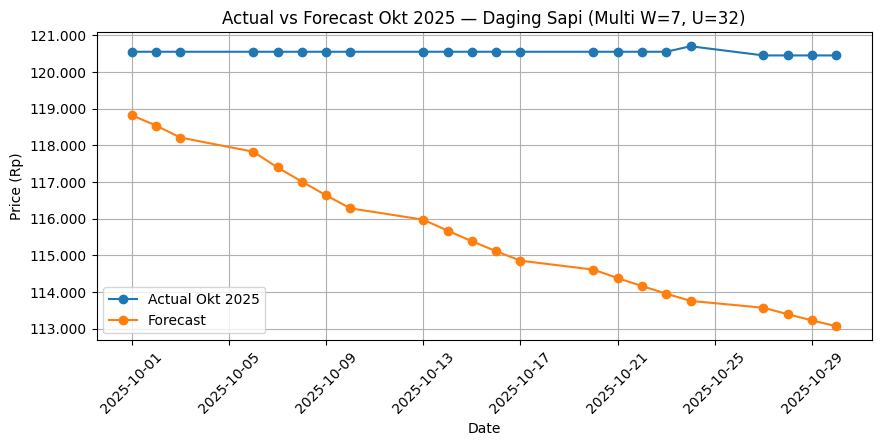

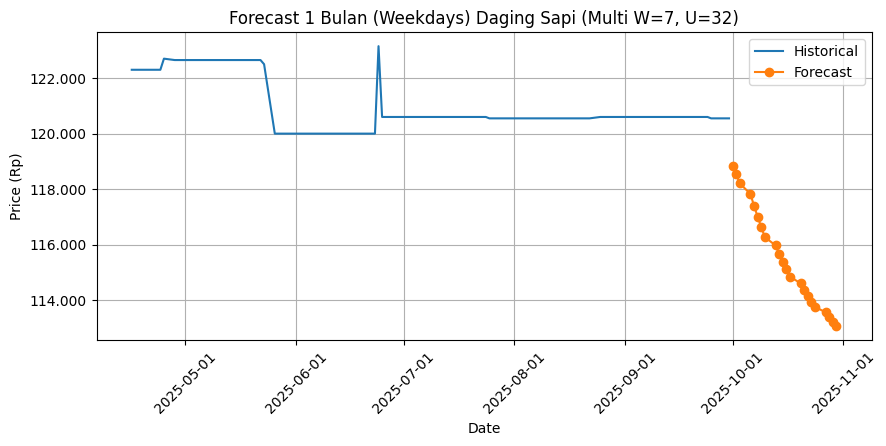

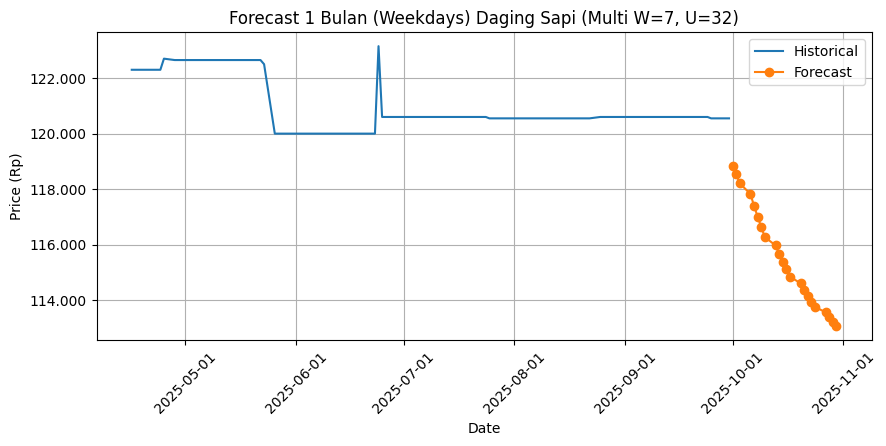


[MULTIVARIATE] Target=Daging Sapi | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.1016 - val_loss: 0.0018
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0195 - val_loss: 5.3954e-04
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0084 - val_loss: 0.0078
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0053 - val_loss: 0.0010
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0048 - val_loss: 0.0035
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0049 - val_loss: 4.4744e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0040 - val_loss: 0.0052
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0043 - val_loss: 6.3803e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0045 - val_loss: 4.8196e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0046 - val_loss: 0.0012
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0035 - val_loss: 0.0021
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss

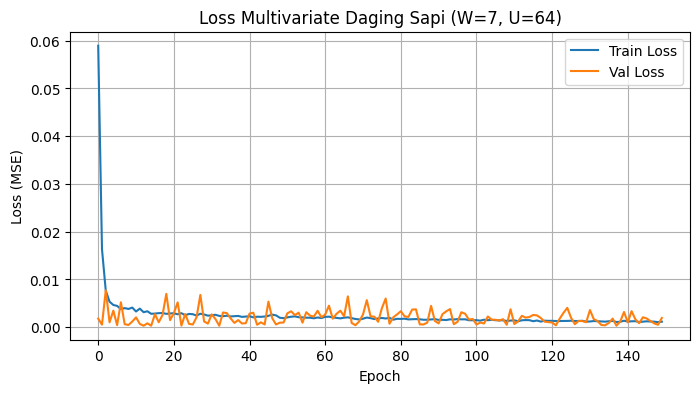

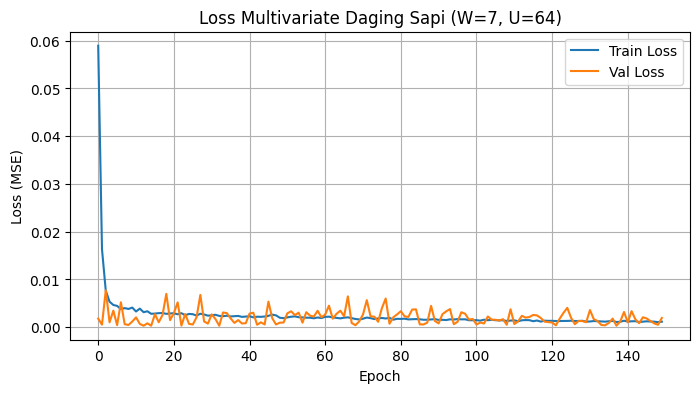

Test MAE  : 841.60
Test RMSE : 894.12
Test MAPE : 0.6950%


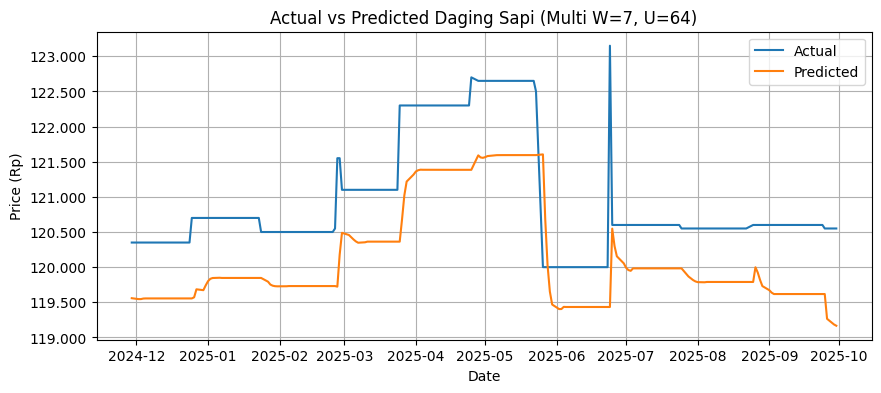

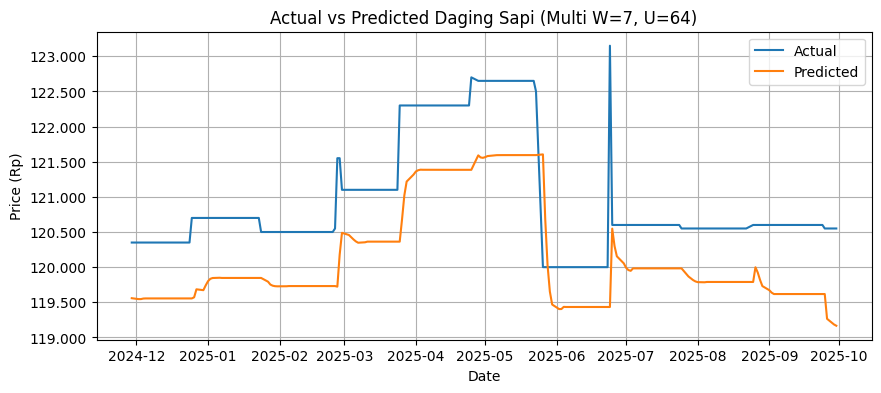


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,120550,119166.632812
1,2025-10-02,120550,118639.507812
2,2025-10-03,120550,118125.929688
3,2025-10-06,120550,117644.320312
4,2025-10-07,120550,117201.523438
5,2025-10-08,120550,116793.773438
6,2025-10-09,120550,116427.765625
7,2025-10-10,120550,116101.593750
8,2025-10-13,120550,115798.539062
9,2025-10-14,120550,115520.679688


Forecast MAPE Okt 2025 : 4.1343%
Compare CSV disimpan: compare_Okt2025_multi_W7_U64.csv


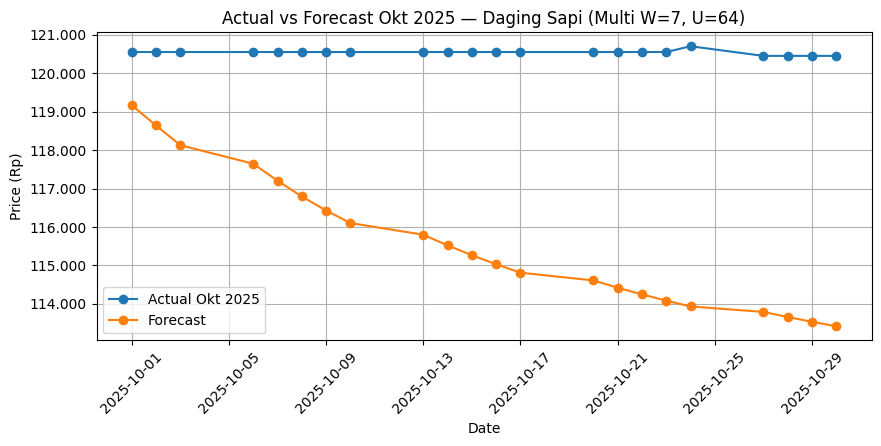

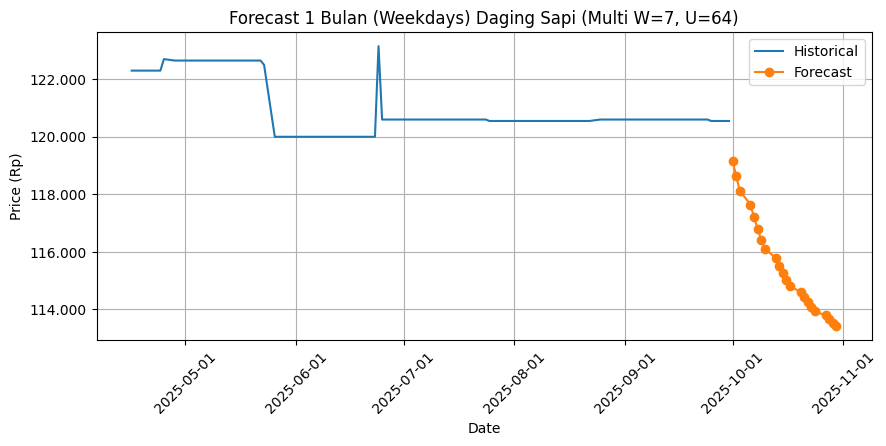

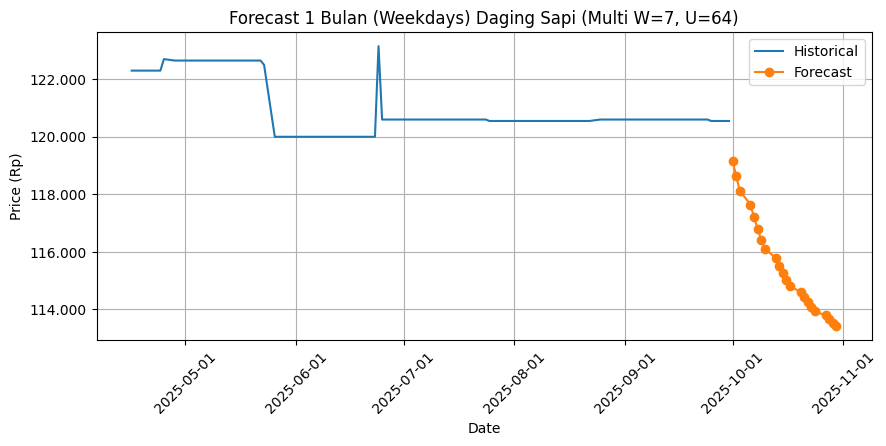


[MULTIVARIATE] Target=Daging Sapi | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.1043 - val_loss: 0.0183
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0259 - val_loss: 0.0030
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0143 - val_loss: 0.0043
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0100 - val_loss: 0.0120
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0085 - val_loss: 0.0076
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0073 - val_loss: 0.0034
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0068 - val_loss: 0.0101
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0061 - val_loss: 0.0089
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0068 - val_loss: 0.0025
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0049 - val_loss: 0.0025
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0052 - val_loss: 0.0038
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0049 - v

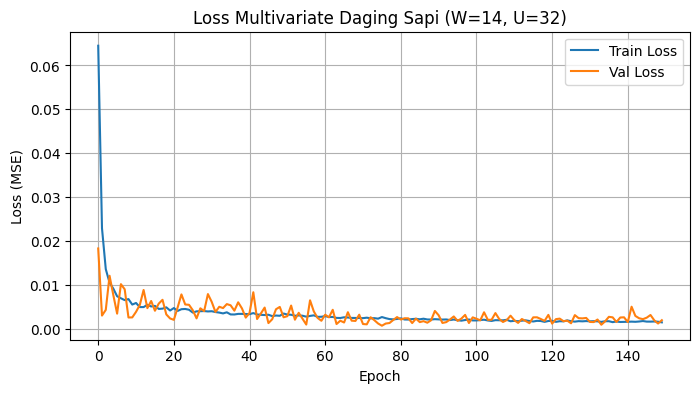

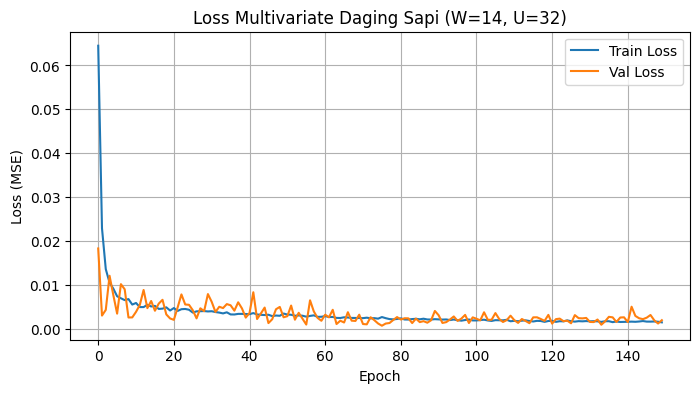

Test MAE  : 1,019.04
Test RMSE : 1,082.59
Test MAPE : 0.8408%


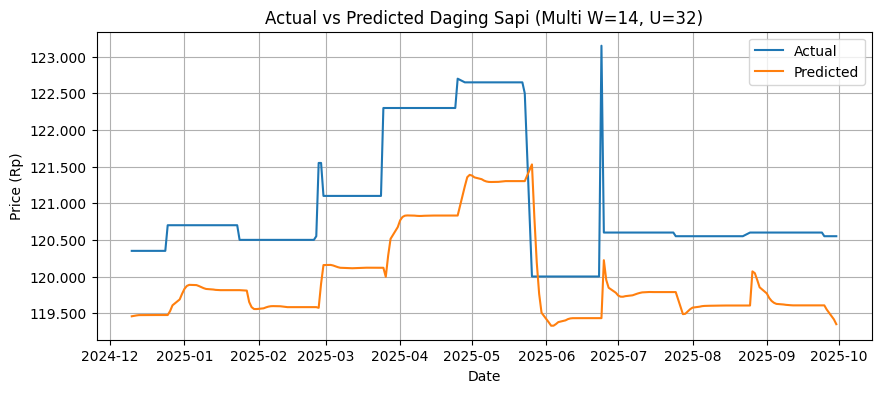

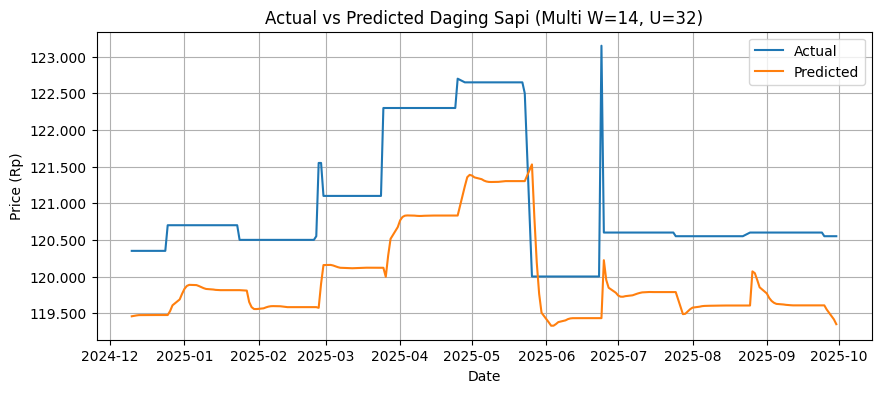


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,120550,119349.570312
1,2025-10-02,120550,118930.203125
2,2025-10-03,120550,118505.867188
3,2025-10-06,120550,118101.007812
4,2025-10-07,120550,117725.062500
5,2025-10-08,120550,117382.195312
6,2025-10-09,120550,117073.109375
7,2025-10-10,120550,116796.312500
8,2025-10-13,120550,116549.242188
9,2025-10-14,120550,116328.898438


Forecast MAPE Okt 2025 : 3.3831%
Compare CSV disimpan: compare_Okt2025_multi_W14_U32.csv


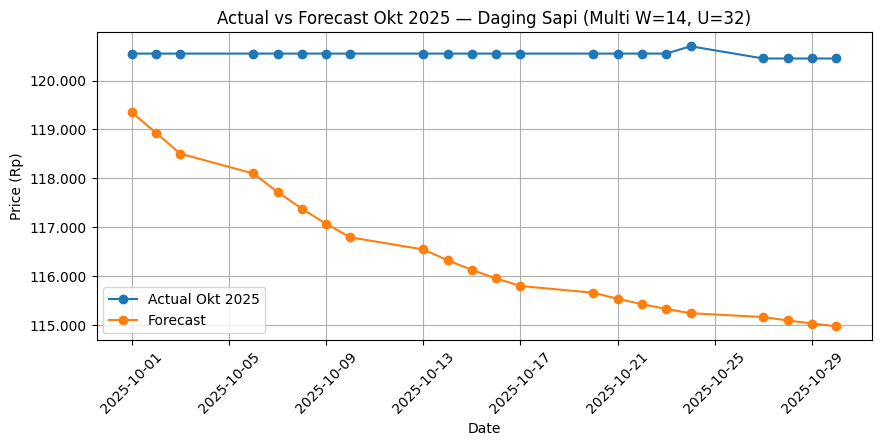

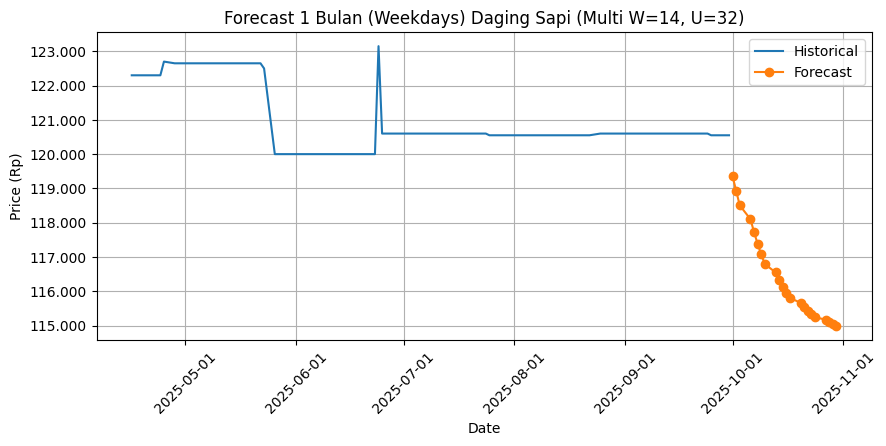

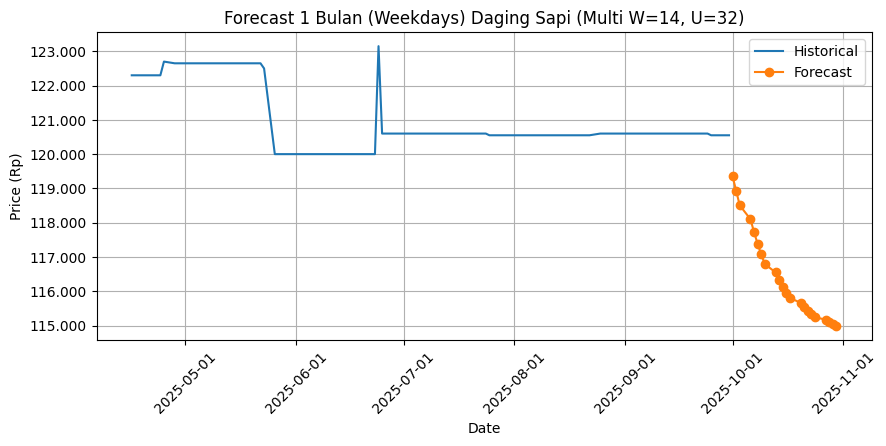


[MULTIVARIATE] Target=Daging Sapi | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 23ms/step - loss: 0.0840 - val_loss: 0.0042
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0144 - val_loss: 0.0026
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0067 - val_loss: 0.0022
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 0.0056 - val_loss: 0.0024
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0047 - val_loss: 0.0026
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0044 - val_loss: 0.0027
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0049 - val_loss: 0.0049
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0039 - val_loss: 0.0022
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0039 - val_loss: 0.0042
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0041 - val_loss: 0.0014
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0034 - val_loss: 0.0049
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0

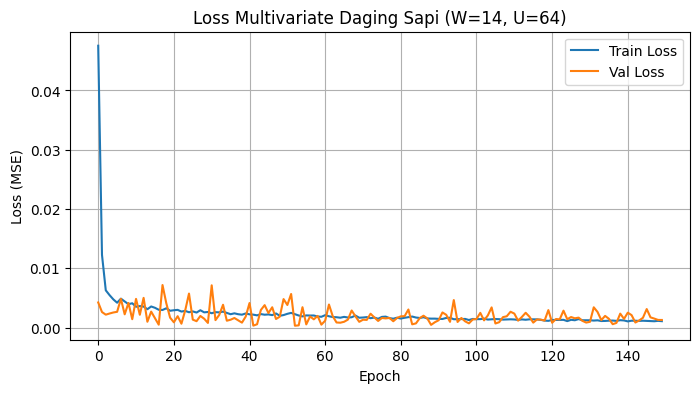

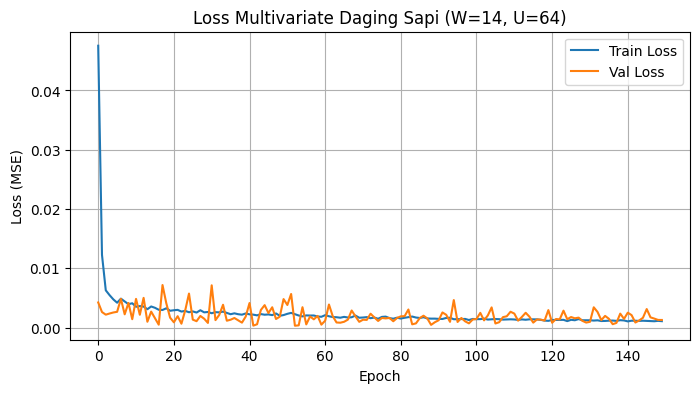

Test MAE  : 785.12
Test RMSE : 844.60
Test MAPE : 0.6483%


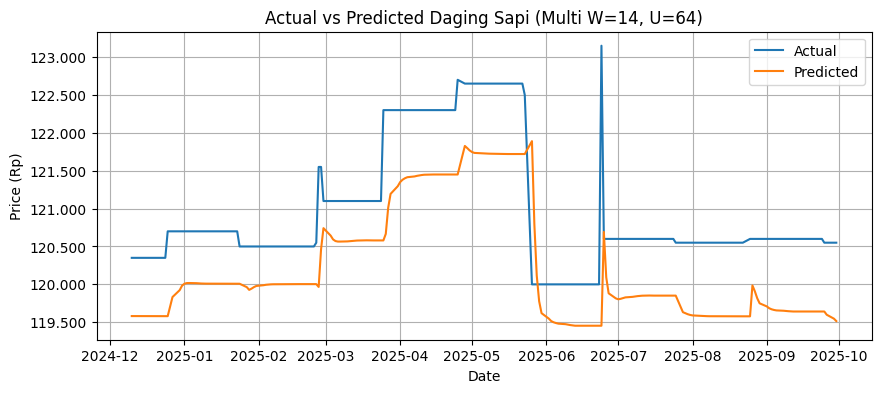

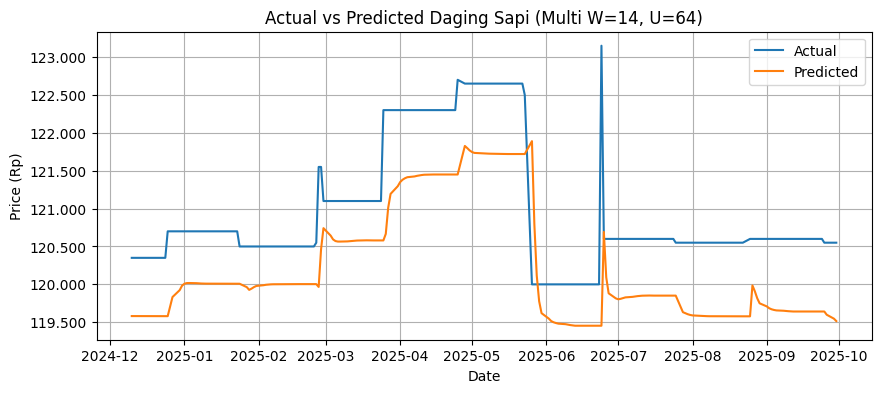


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,120550,119515.367188
1,2025-10-02,120550,119037.875000
2,2025-10-03,120550,118598.367188
3,2025-10-06,120550,118203.992188
4,2025-10-07,120550,117849.398438
5,2025-10-08,120550,117529.382812
6,2025-10-09,120550,117239.226562
7,2025-10-10,120550,116974.898438
8,2025-10-13,120550,116733.046875
9,2025-10-14,120550,116510.914062


Forecast MAPE Okt 2025 : 3.3162%
Compare CSV disimpan: compare_Okt2025_multi_W14_U64.csv


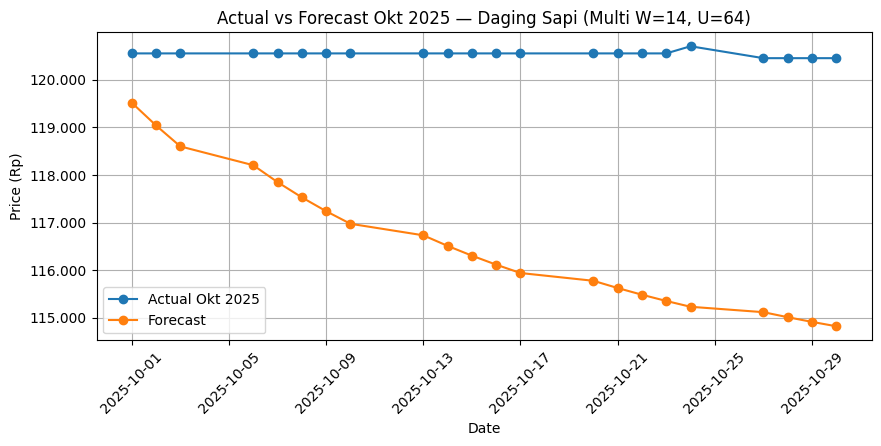

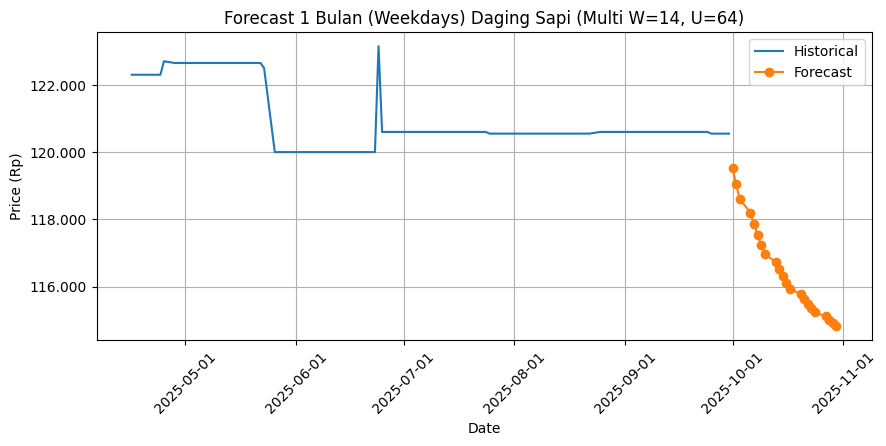

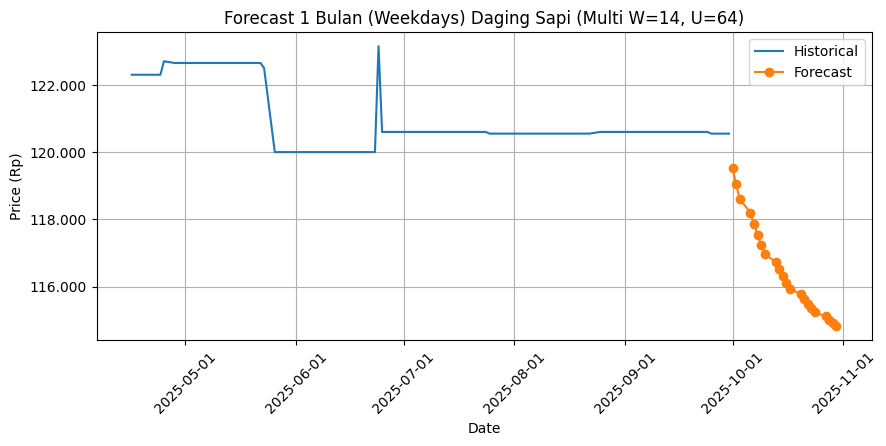


[MULTIVARIATE] Target=Daging Sapi | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - loss: 0.1252 - val_loss: 0.0276
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0237 - val_loss: 0.0114
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0139 - val_loss: 0.0192
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0099 - val_loss: 0.0112
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0086 - val_loss: 0.0125
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0078 - val_loss: 0.0162
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0079 - val_loss: 0.0133
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0068 - val_loss: 0.0100
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0068 - val_loss: 0.0084
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0070 - val_loss: 0.0088
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0059 - val_loss: 0.0142
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.00

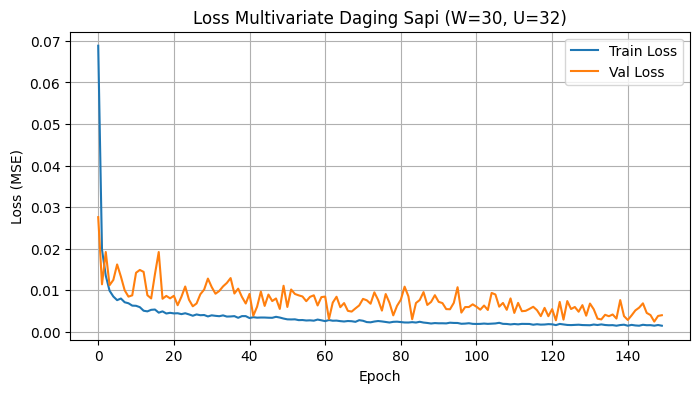

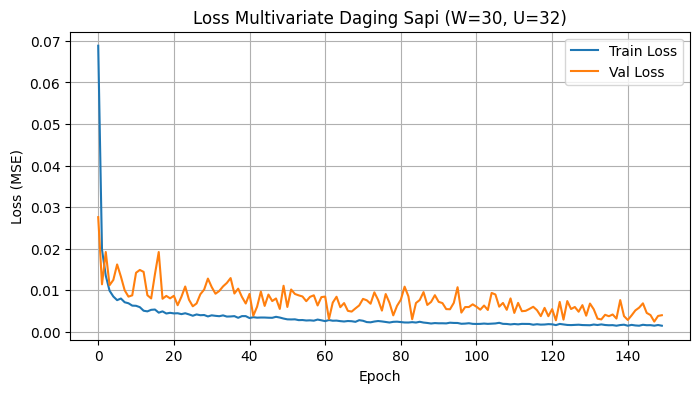

Test MAE  : 1,212.77
Test RMSE : 1,268.61
Test MAPE : 1.0007%


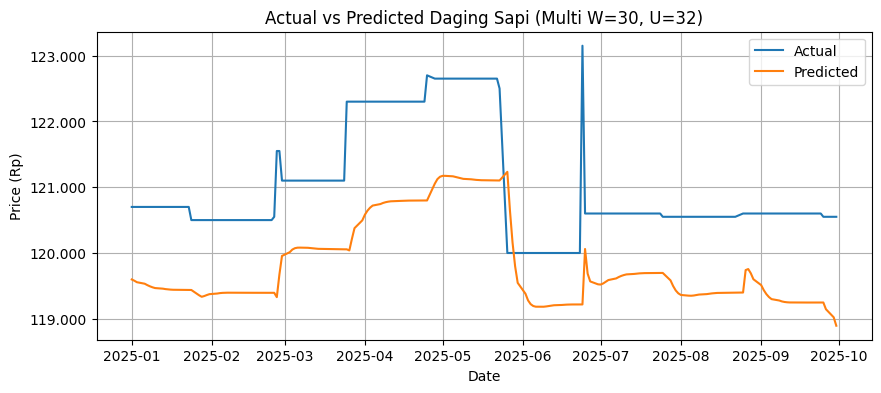

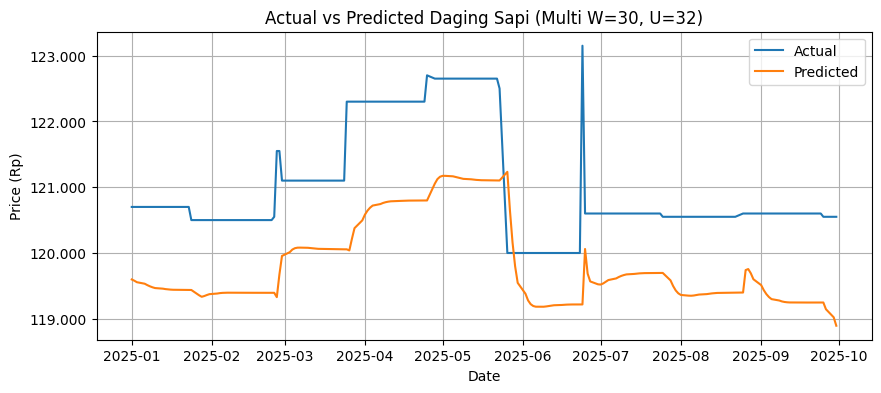


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,120550,118894.632812
1,2025-10-02,120550,118282.976562
2,2025-10-03,120550,117695.375000
3,2025-10-06,120550,117140.296875
4,2025-10-07,120550,116628.367188
5,2025-10-08,120550,116164.640625
6,2025-10-09,120550,115750.296875
7,2025-10-10,120550,115384.335938
8,2025-10-13,120550,115064.250000
9,2025-10-14,120550,114786.703125


Forecast MAPE Okt 2025 : 4.5192%
Compare CSV disimpan: compare_Okt2025_multi_W30_U32.csv


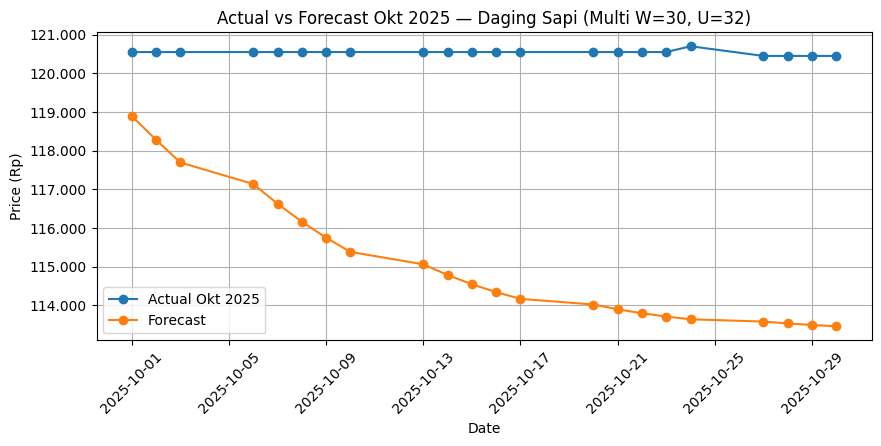

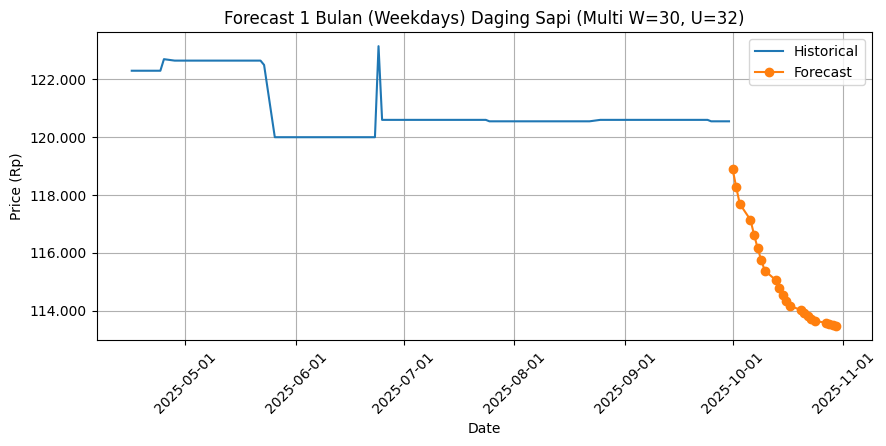

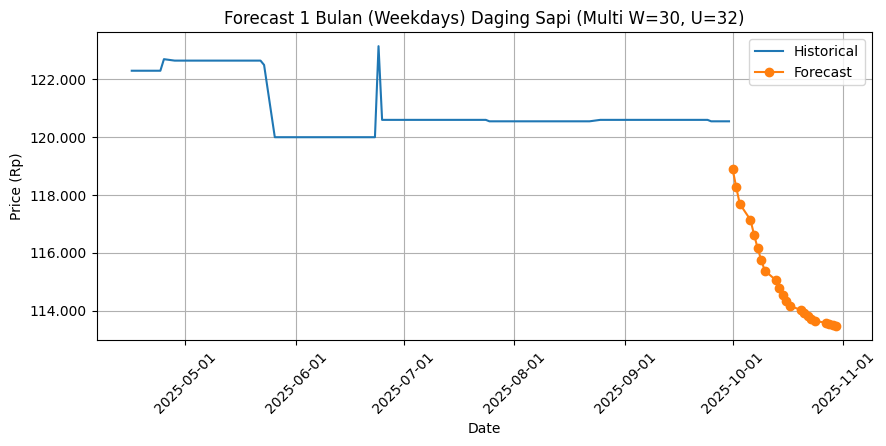


[MULTIVARIATE] Target=Daging Sapi | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 0.0360 - val_loss: 0.0042
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0076 - val_loss: 0.0016
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0062 - val_loss: 0.0023
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 0.0047 - val_loss: 7.0885e-04
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0044 - val_loss: 0.0090
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0042 - val_loss: 0.0023
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0040 - val_loss: 0.0044
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0035 - val_loss: 0.0076
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0031 - val_loss: 0.0010
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0029 - val_loss: 0.0018
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0031 - val_loss: 0.0055
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss:

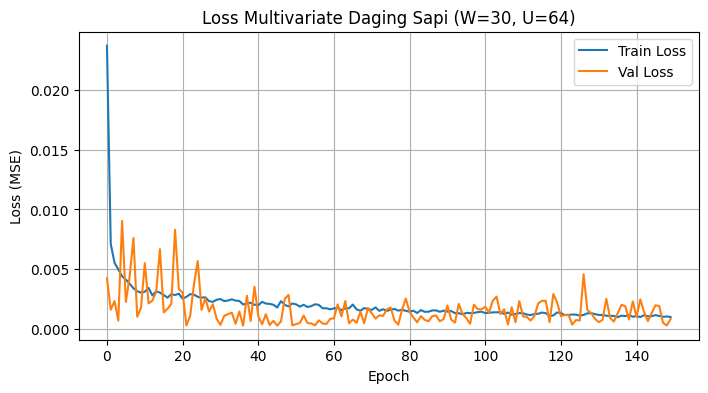

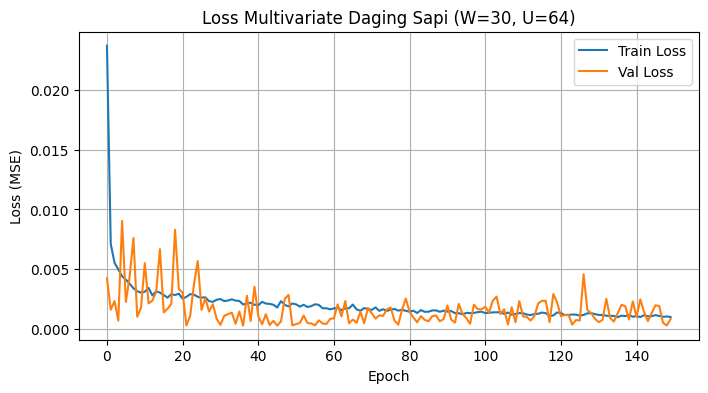

Test MAE  : 571.55
Test RMSE : 650.44
Test MAPE : 0.4716%


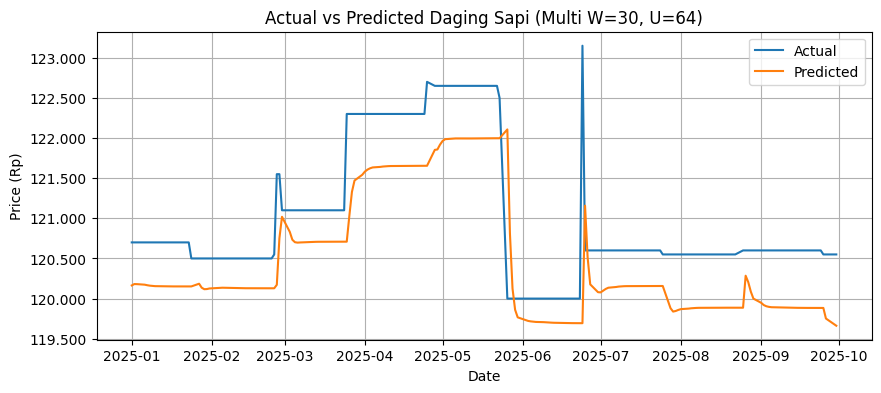

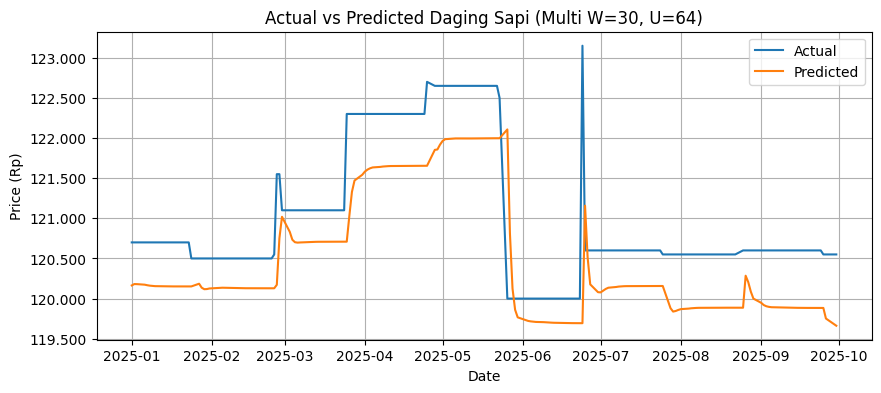


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,120550,119661.984375
1,2025-10-02,120550,119190.250000
2,2025-10-03,120550,118744.148438
3,2025-10-06,120550,118348.554688
4,2025-10-07,120550,117999.921875
5,2025-10-08,120550,117692.734375
6,2025-10-09,120550,117421.359375
7,2025-10-10,120550,117180.843750
8,2025-10-13,120550,116966.945312
9,2025-10-14,120550,116776.101562


Forecast MAPE Okt 2025 : 3.0193%
Compare CSV disimpan: compare_Okt2025_multi_W30_U64.csv


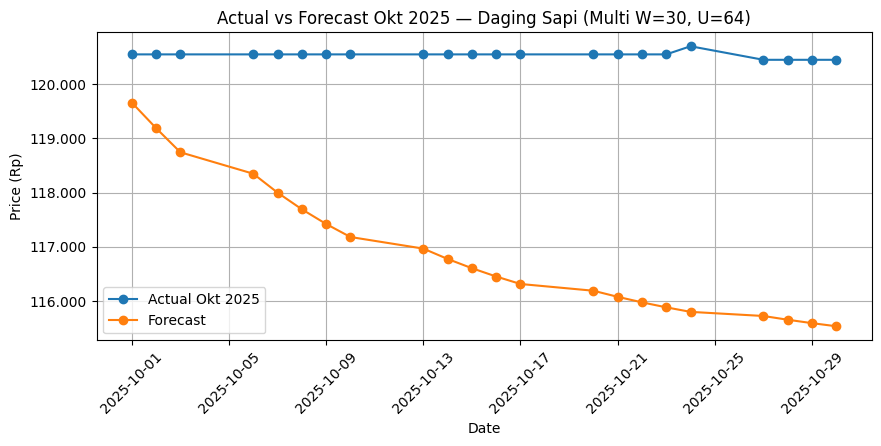

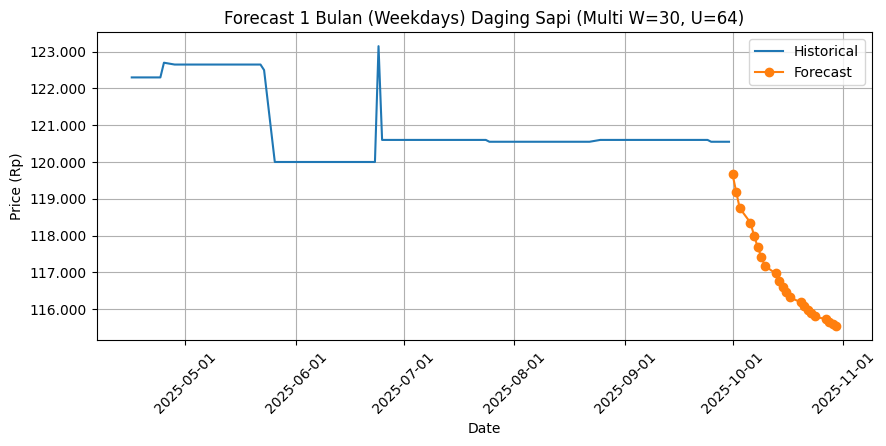

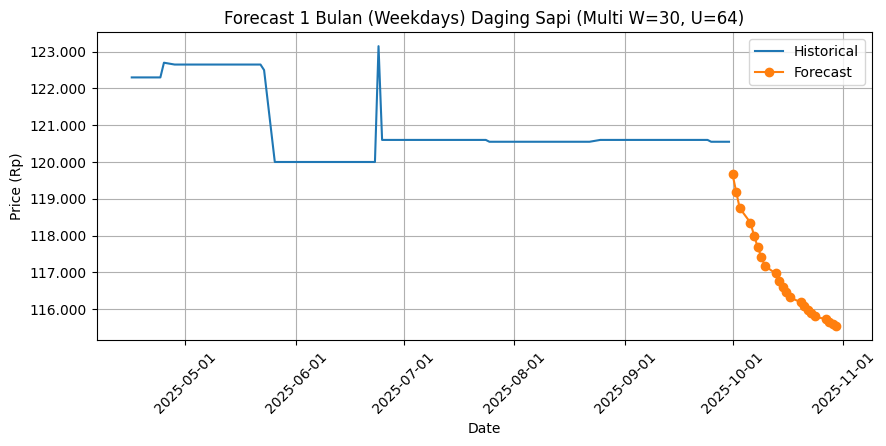


Rekap multivariate Daging Sapi disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate\Daging_Sapi\hasil_multivariate_Daging_Sapi.csv

==================== MULTIVARIATE: Telur Ayam ====================

[MULTIVARIATE] Target=Telur Ayam | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - loss: 0.1454 - val_loss: 0.0130
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0294 - val_loss: 0.0044
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0191 - val_loss: 0.0083
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0153 - val_loss: 0.0032
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0139 - val_loss: 0.0024
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0122 - val_loss: 0.0028
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0112 - val_loss: 0.0028
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0117 - val_loss: 0.0029
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0103 - val_loss: 0.0027
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0099 - val_loss: 0.0024
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0100 - val_loss: 0.0024
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0099 - v

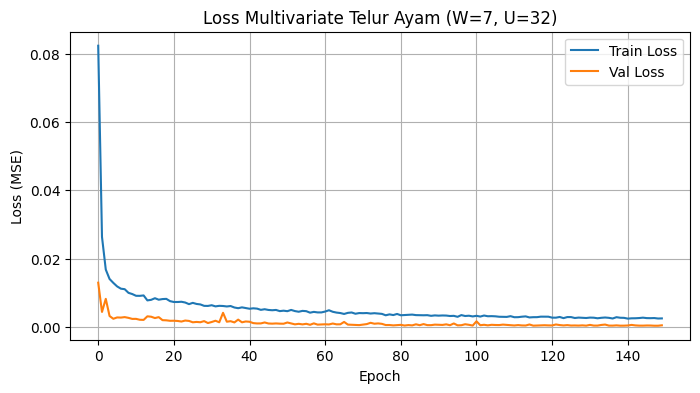

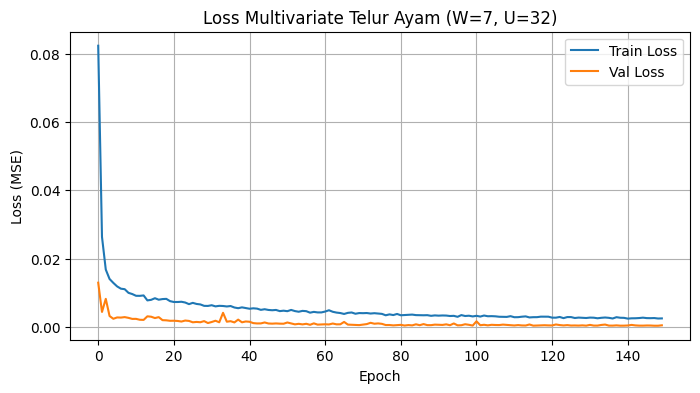

Test MAE  : 280.50
Test RMSE : 404.86
Test MAPE : 1.1863%


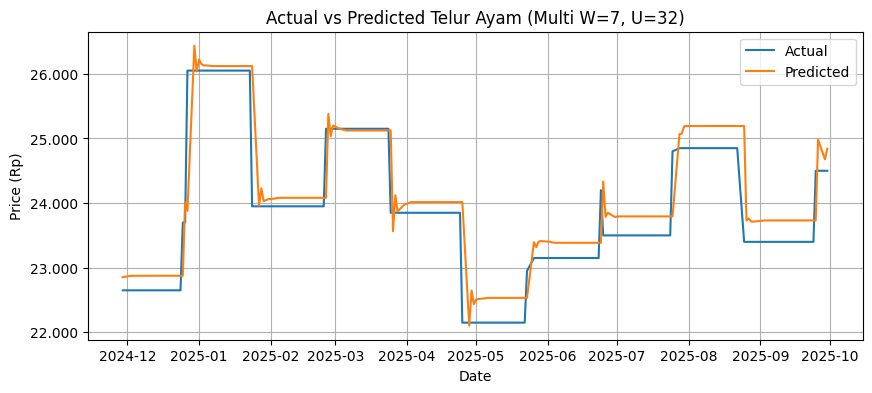

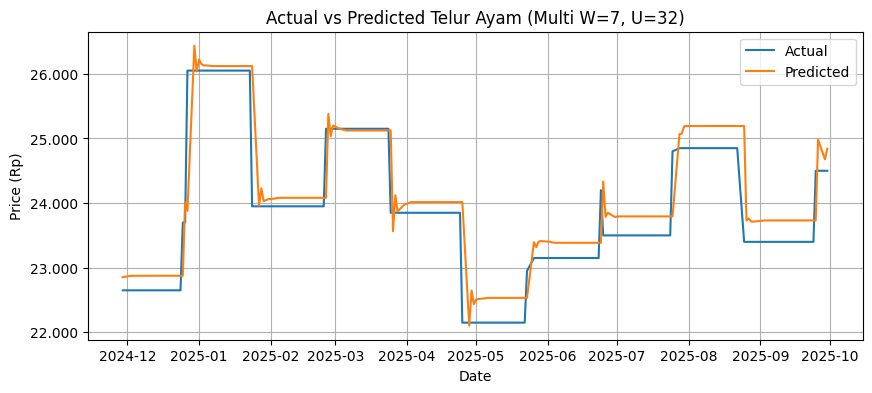


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,24500,24841.863281
1,2025-10-02,24500,25136.333984
2,2025-10-03,24500,25385.960938
3,2025-10-06,24500,25629.560547
4,2025-10-07,24500,25862.990234
5,2025-10-08,24500,26080.185547
6,2025-10-09,24500,26281.220703
7,2025-10-10,24500,26466.443359
8,2025-10-13,24500,26636.423828
9,2025-10-14,24500,26791.910156


Forecast MAPE Okt 2025 : 8.0011%
Compare CSV disimpan: compare_Okt2025_multi_W7_U32.csv


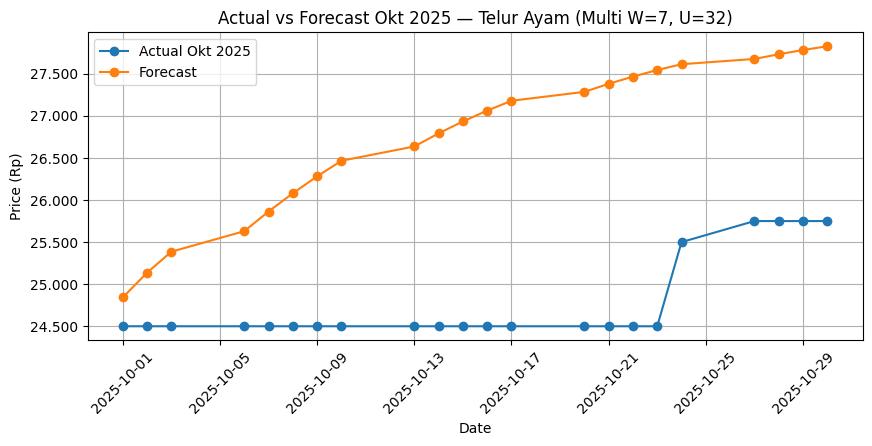

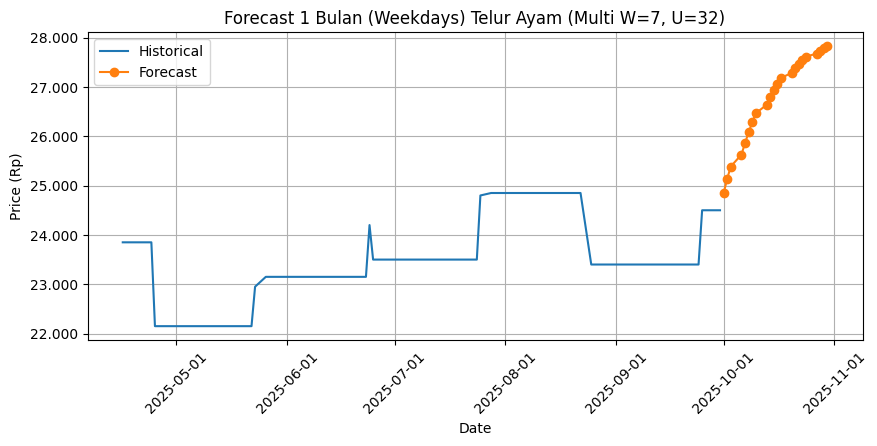

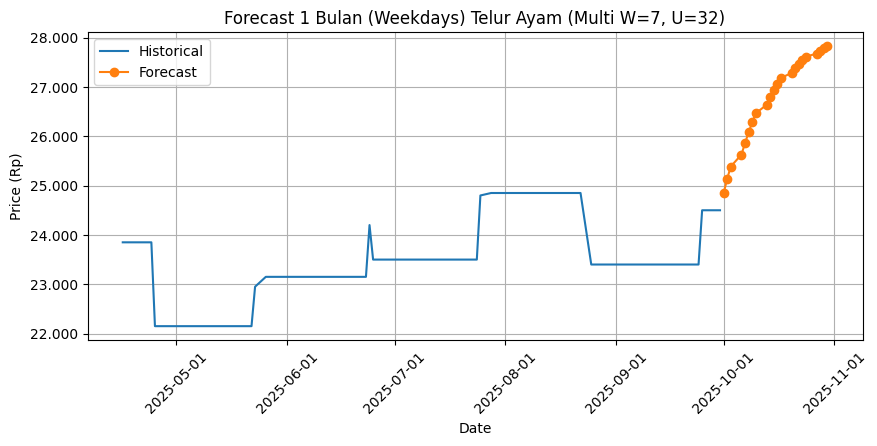


[MULTIVARIATE] Target=Telur Ayam | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 24ms/step - loss: 0.1358 - val_loss: 0.0148
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0270 - val_loss: 0.0162
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0146 - val_loss: 0.0071
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0136 - val_loss: 0.0038
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0126 - val_loss: 0.0049
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0108 - val_loss: 0.0044
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0098 - val_loss: 0.0031
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0100 - val_loss: 0.0012
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0083 - val_loss: 0.0011
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0082 - val_loss: 0.0011
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0074 - val_loss: 0.0020
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0084 

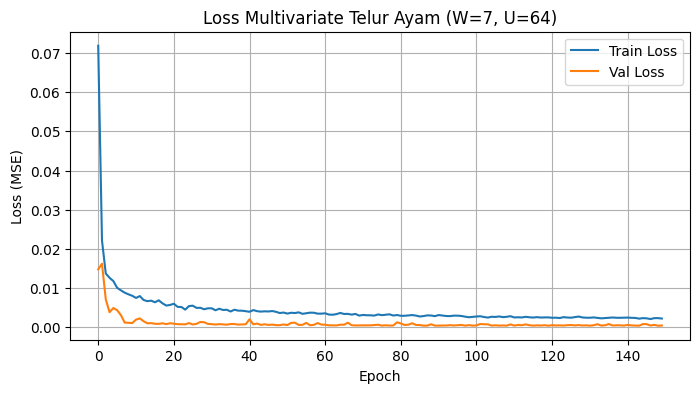

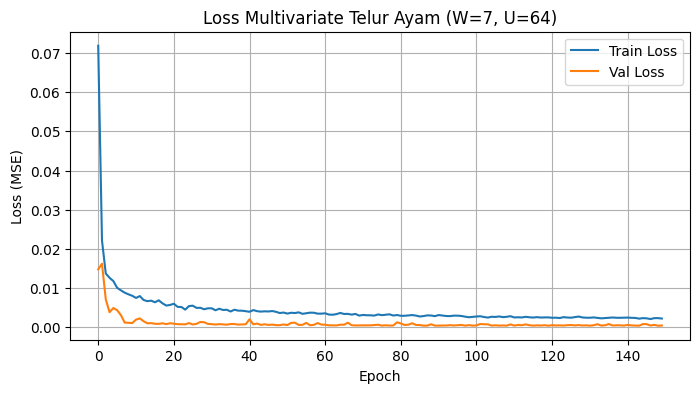

Test MAE  : 269.36
Test RMSE : 402.63
Test MAPE : 1.1421%


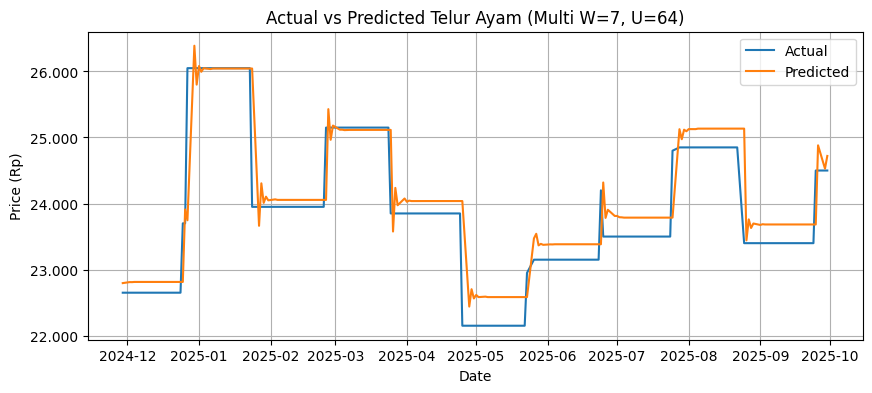

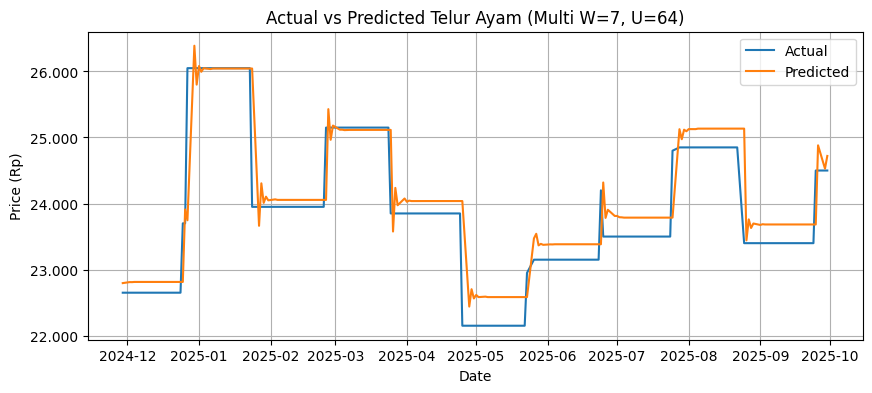


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,24500,24720.642578
1,2025-10-02,24500,24925.742188
2,2025-10-03,24500,25135.447266
3,2025-10-06,24500,25334.914062
4,2025-10-07,24500,25520.439453
5,2025-10-08,24500,25691.201172
6,2025-10-09,24500,25845.912109
7,2025-10-10,24500,25986.652344
8,2025-10-13,24500,26114.783203
9,2025-10-14,24500,26231.246094


Forecast MAPE Okt 2025 : 5.7410%
Compare CSV disimpan: compare_Okt2025_multi_W7_U64.csv


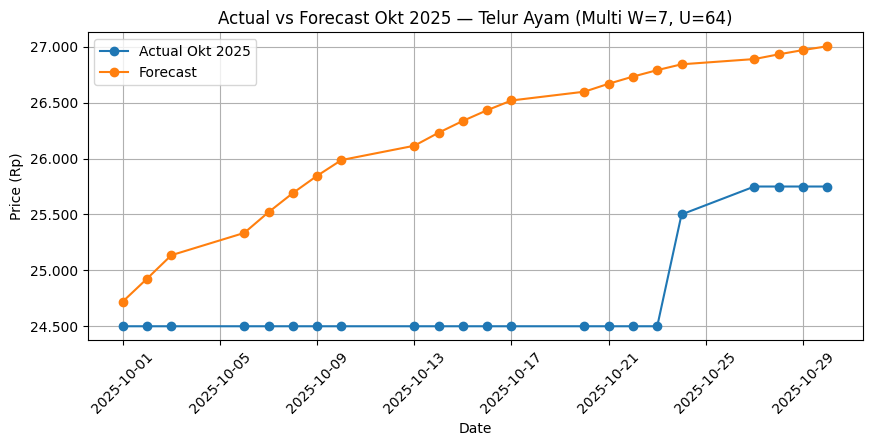

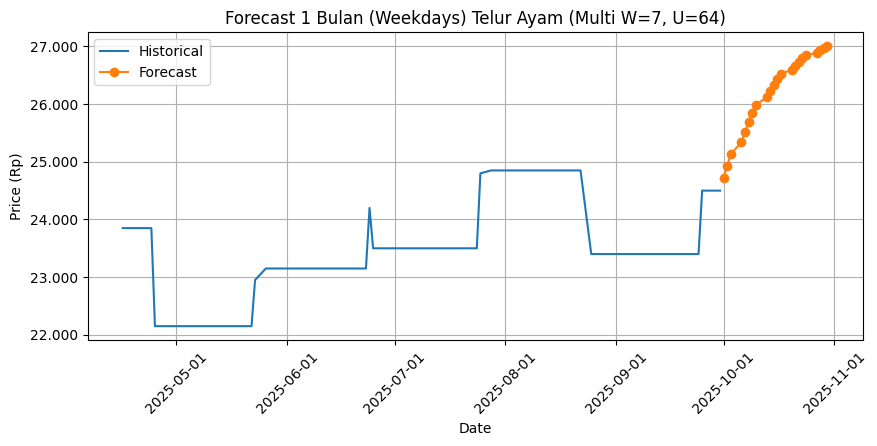

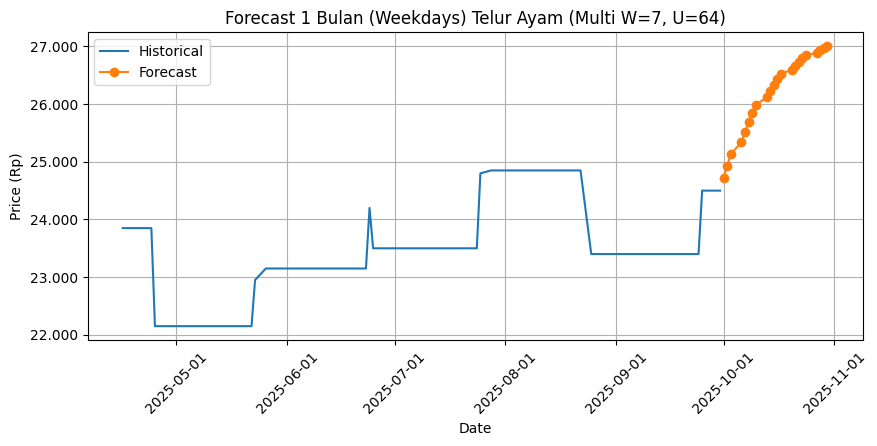


[MULTIVARIATE] Target=Telur Ayam | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 4s 27ms/step - loss: 0.1722 - val_loss: 0.0094
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0379 - val_loss: 0.0097
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0215 - val_loss: 0.0038
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0170 - val_loss: 0.0023
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0152 - val_loss: 0.0019
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0122 - val_loss: 0.0019
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0131 - val_loss: 0.0019
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0107 - val_loss: 0.0022
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0093 - val_loss: 0.0018
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0095 - val_loss: 0.0023
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0095 - val_loss: 0.0019
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0

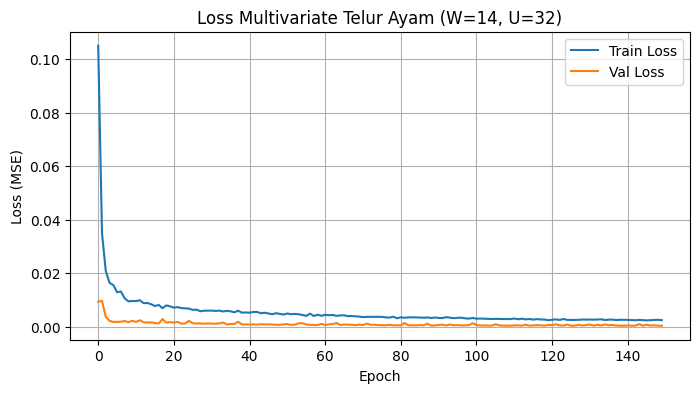

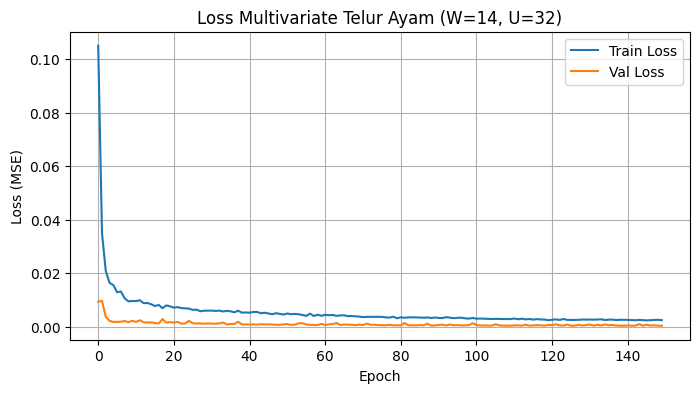

Test MAE  : 279.50
Test RMSE : 415.66
Test MAPE : 1.1843%


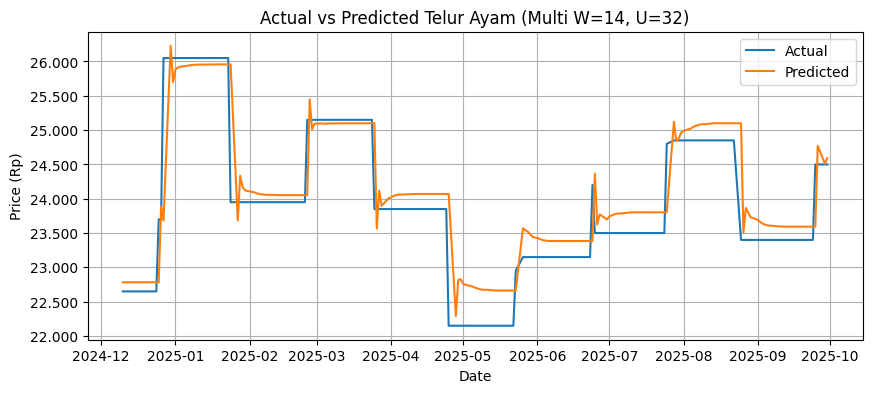

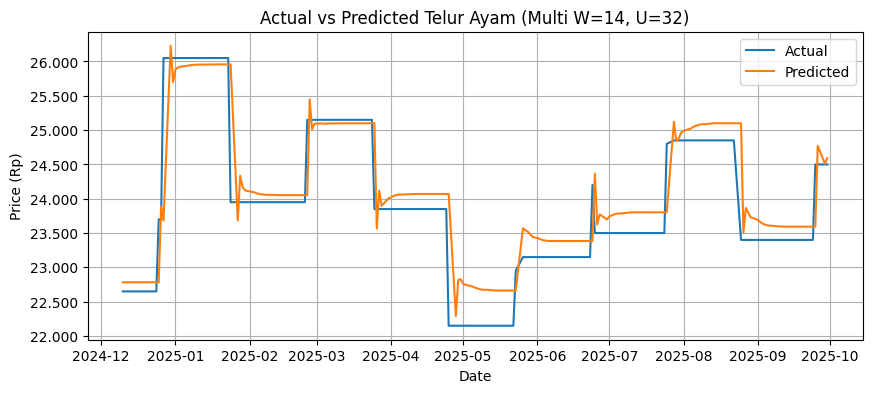


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,24500,24592.341797
1,2025-10-02,24500,24677.867188
2,2025-10-03,24500,24738.205078
3,2025-10-06,24500,24782.140625
4,2025-10-07,24500,24817.638672
5,2025-10-08,24500,24848.673828
6,2025-10-09,24500,24877.447266
7,2025-10-10,24500,24905.017578
8,2025-10-13,24500,24931.748047
9,2025-10-14,24500,24957.707031


Forecast MAPE Okt 2025 : 1.7789%
Compare CSV disimpan: compare_Okt2025_multi_W14_U32.csv


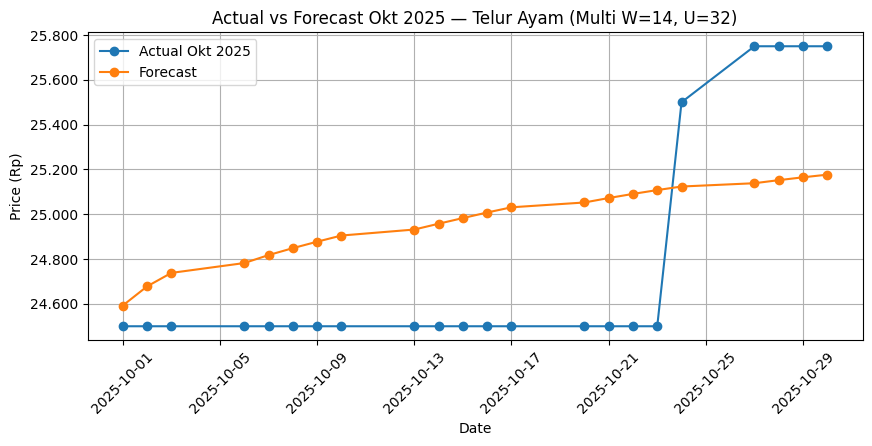

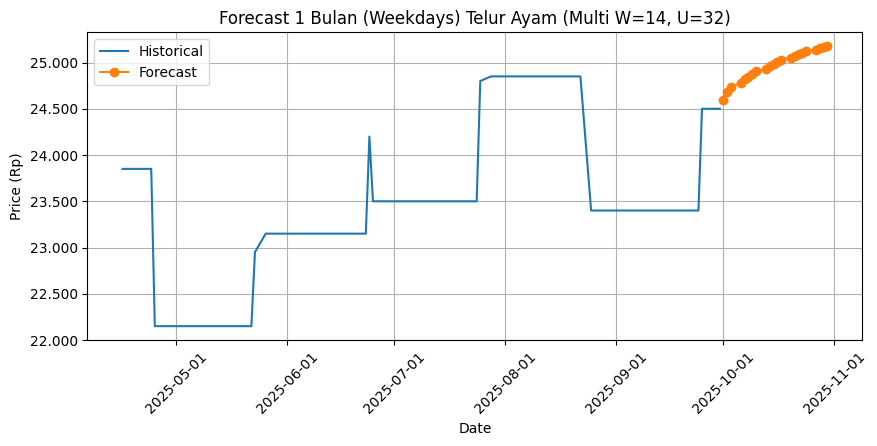

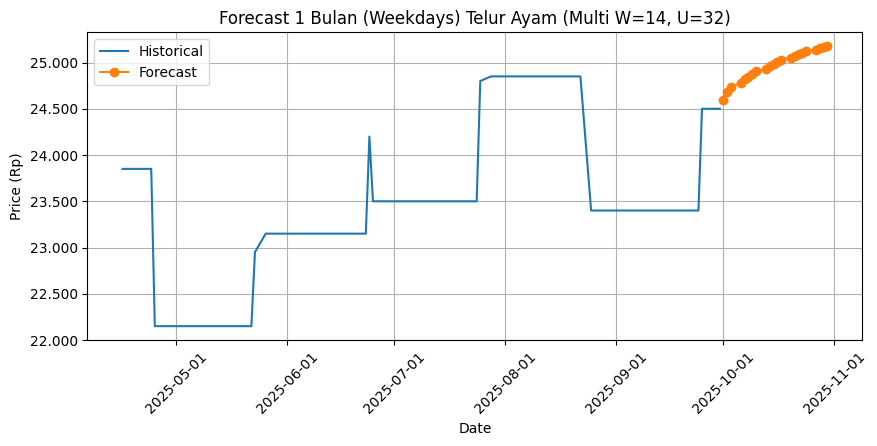


[MULTIVARIATE] Target=Telur Ayam | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.0789 - val_loss: 0.0786
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0187 - val_loss: 0.0280
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0137 - val_loss: 0.0035
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0113 - val_loss: 0.0068
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0095 - val_loss: 0.0023
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0088 - val_loss: 0.0066
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0080 - val_loss: 0.0076
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0081 - val_loss: 0.0013
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0076 - val_loss: 0.0018
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0069 - val_loss: 0.0025
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0066 - val_loss: 0.0018
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0060 - val_

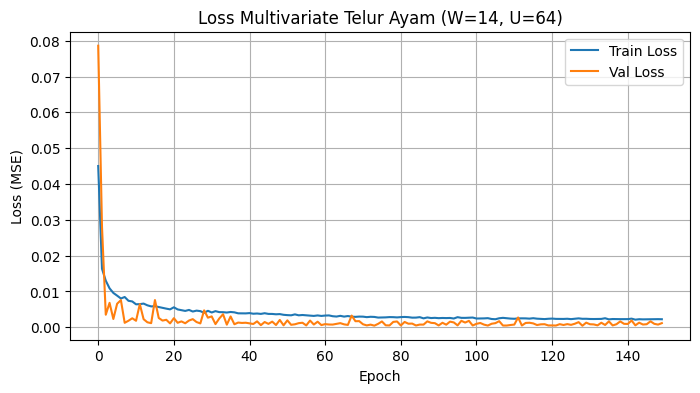

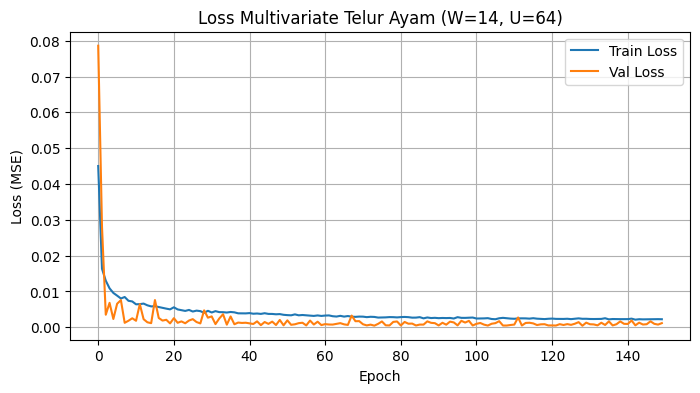

Test MAE  : 547.51
Test RMSE : 626.28
Test MAPE : 2.3083%


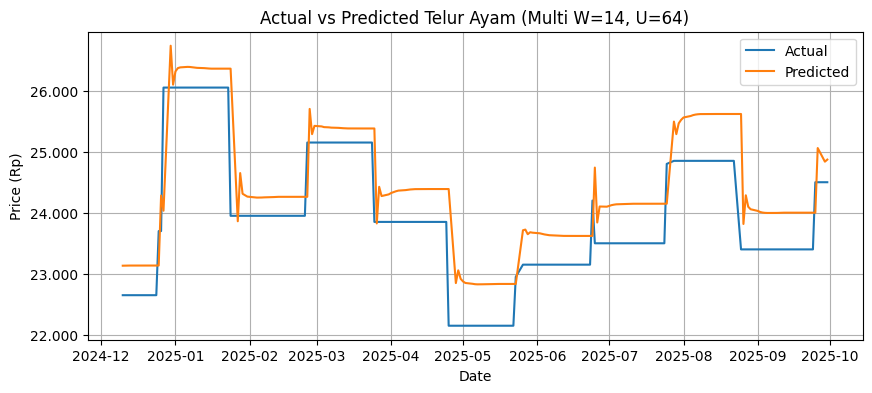

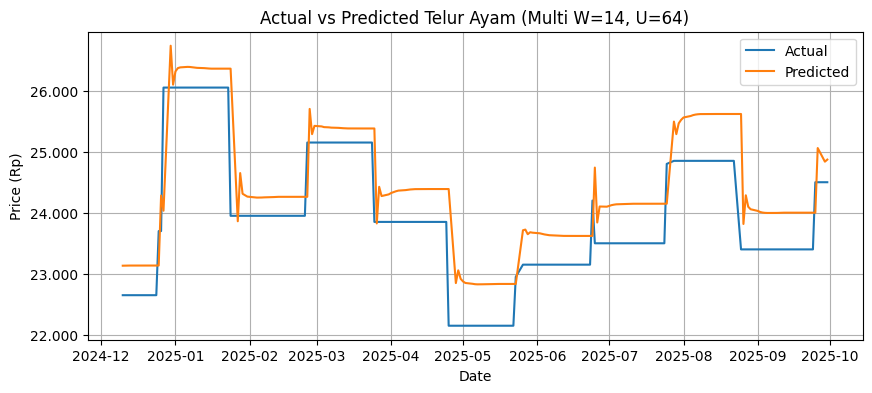


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,24500,24870.552734
1,2025-10-02,24500,25324.923828
2,2025-10-03,24500,25732.263672
3,2025-10-06,24500,26104.082031
4,2025-10-07,24500,26461.810547
5,2025-10-08,24500,26811.808594
6,2025-10-09,24500,27153.595703
7,2025-10-10,24500,27485.404297
8,2025-10-13,24500,27805.595703
9,2025-10-14,24500,28112.798828


Forecast MAPE Okt 2025 : 14.0273%
Compare CSV disimpan: compare_Okt2025_multi_W14_U64.csv


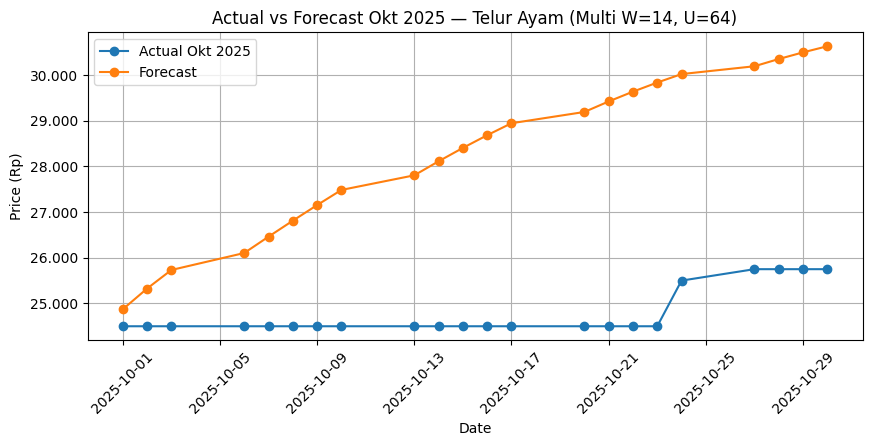

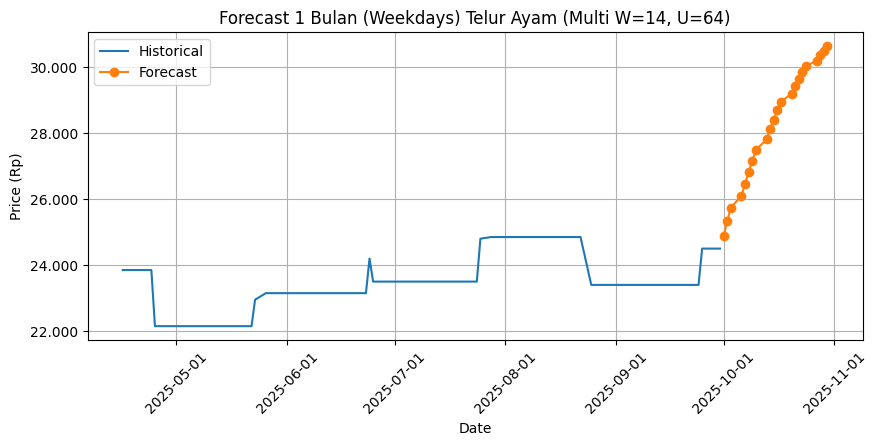

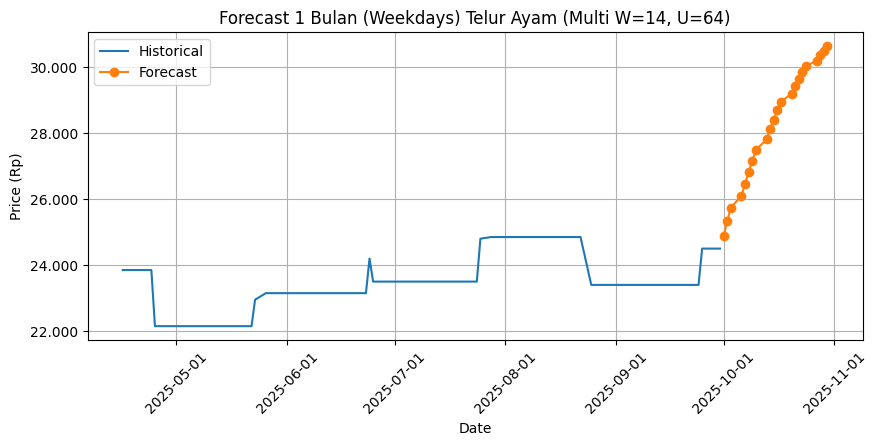


[MULTIVARIATE] Target=Telur Ayam | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - loss: 0.3887 - val_loss: 0.0123
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0544 - val_loss: 0.0279
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0297 - val_loss: 0.0303
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0249 - val_loss: 0.0248
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0208 - val_loss: 0.0197
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0201 - val_loss: 0.0289
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0158 - val_loss: 0.0210
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0177 - val_loss: 0.0183
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0149 - val_loss: 0.0136
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0140 - val_loss: 0.0155
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0118 - val_loss: 0.0083
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0

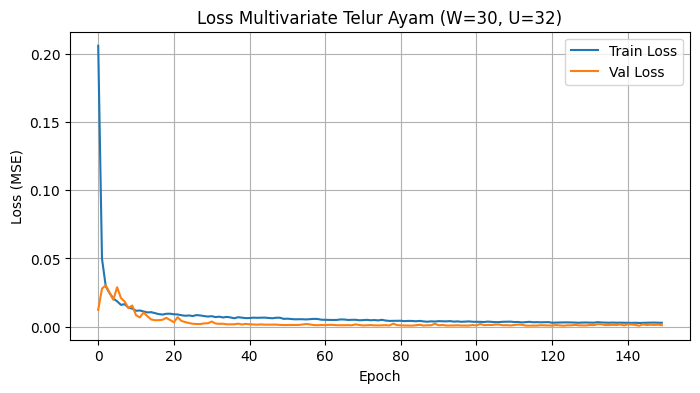

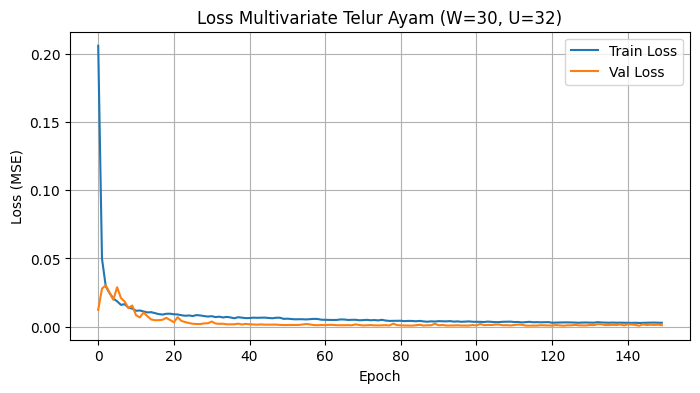

Test MAE  : 561.74
Test RMSE : 650.50
Test MAPE : 2.3825%


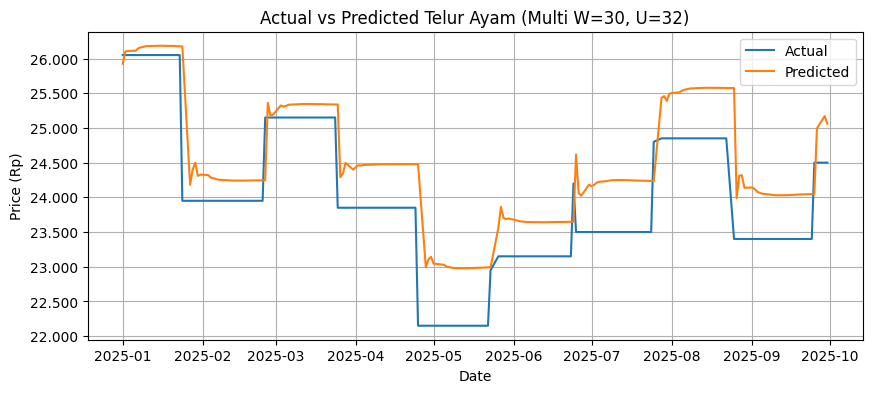

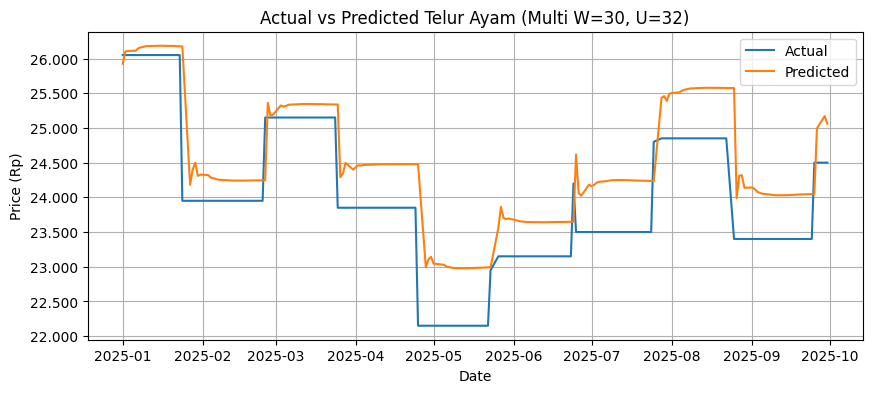


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,24500,25060.906250
1,2025-10-02,24500,25621.361328
2,2025-10-03,24500,26104.107422
3,2025-10-06,24500,26462.478516
4,2025-10-07,24500,26780.156250
5,2025-10-08,24500,27066.250000
6,2025-10-09,24500,27322.468750
7,2025-10-10,24500,27554.306641
8,2025-10-13,24500,27764.978516
9,2025-10-14,24500,27955.988281


Forecast MAPE Okt 2025 : 12.3461%
Compare CSV disimpan: compare_Okt2025_multi_W30_U32.csv


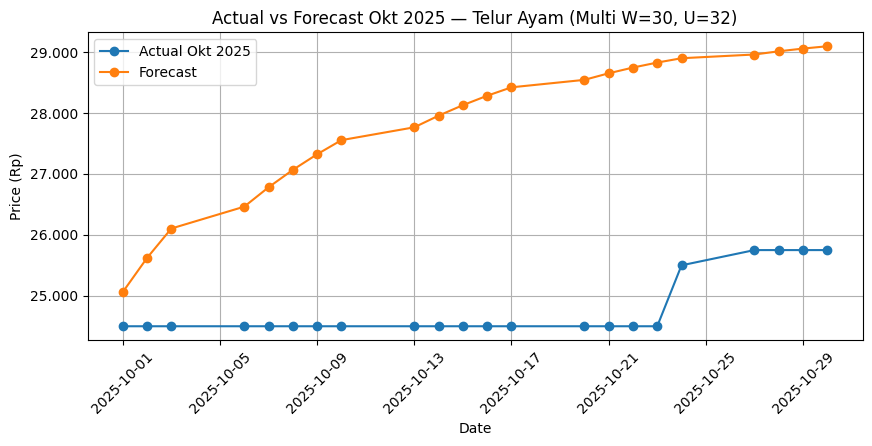

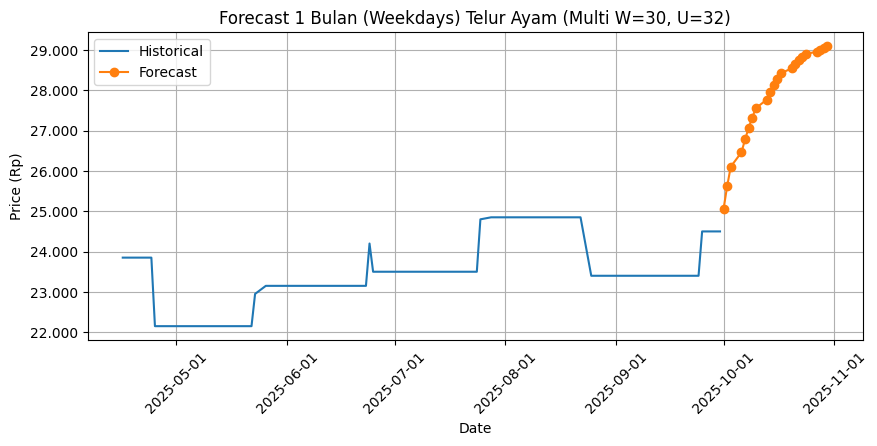

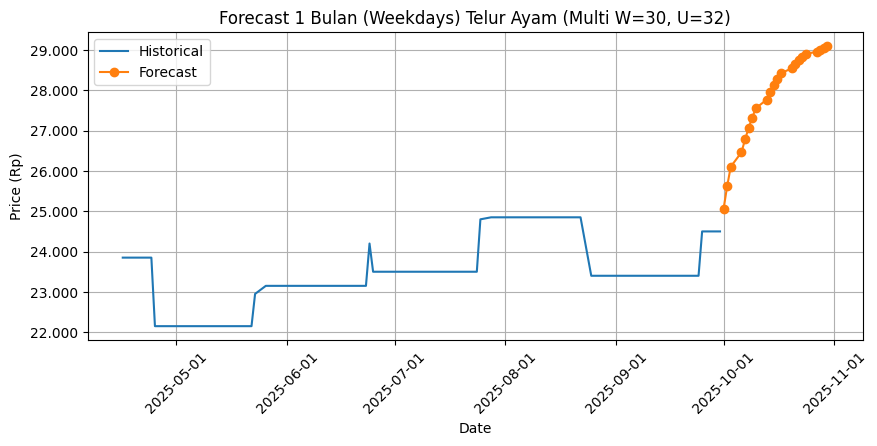


[MULTIVARIATE] Target=Telur Ayam | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - loss: 0.1654 - val_loss: 0.0210
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - loss: 0.0281 - val_loss: 0.0243
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 0.0166 - val_loss: 0.0063
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - loss: 0.0153 - val_loss: 0.0147
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - loss: 0.0127 - val_loss: 0.0050
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - loss: 0.0120 - val_loss: 0.0088
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0114 - val_loss: 0.0062
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0104 - val_loss: 0.0056
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0089 - val_loss: 0.0028
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0085 - val_loss: 0.0055
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0082 - val_loss: 0.0084
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0

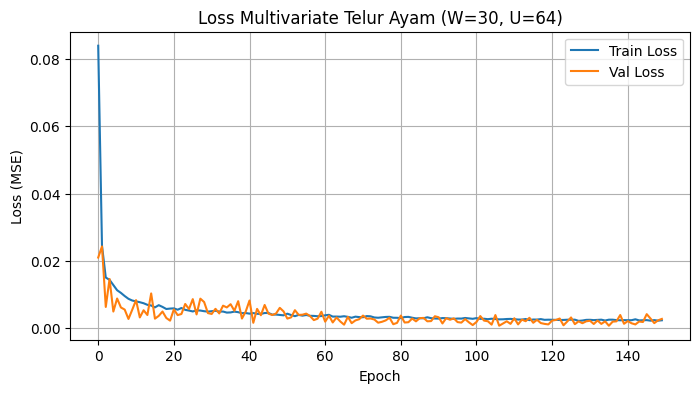

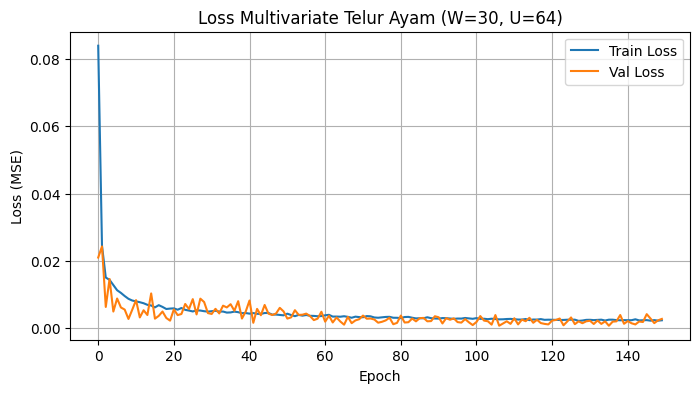

Test MAE  : 708.43
Test RMSE : 765.93
Test MAPE : 2.9807%


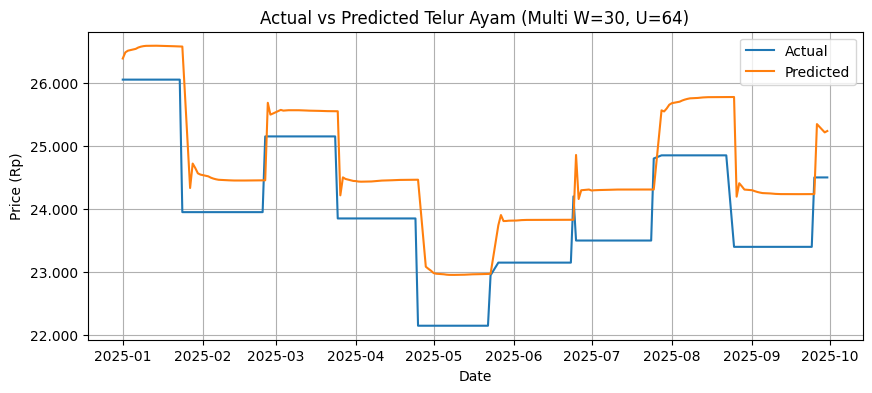

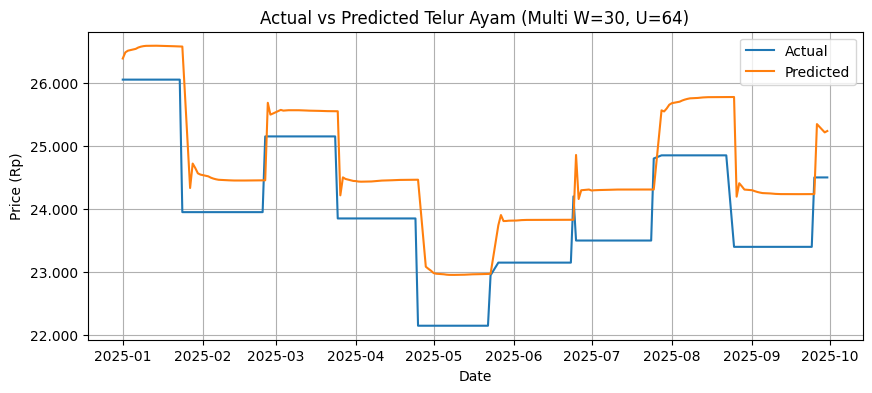


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,24500,25235.783203
1,2025-10-02,24500,26008.621094
2,2025-10-03,24500,26703.105469
3,2025-10-06,24500,27329.816406
4,2025-10-07,24500,27918.173828
5,2025-10-08,24500,28476.509766
6,2025-10-09,24500,29008.806641
7,2025-10-10,24500,29517.152344
8,2025-10-13,24500,30001.843750
9,2025-10-14,24500,30461.925781


Forecast MAPE Okt 2025 : 23.1287%
Compare CSV disimpan: compare_Okt2025_multi_W30_U64.csv


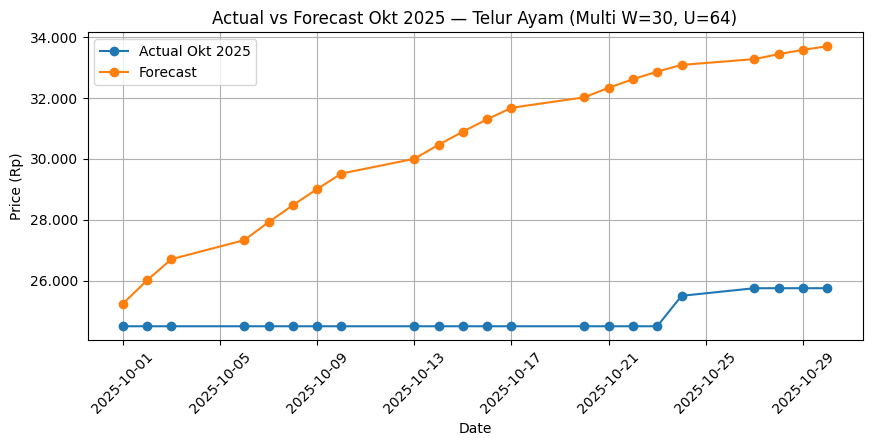

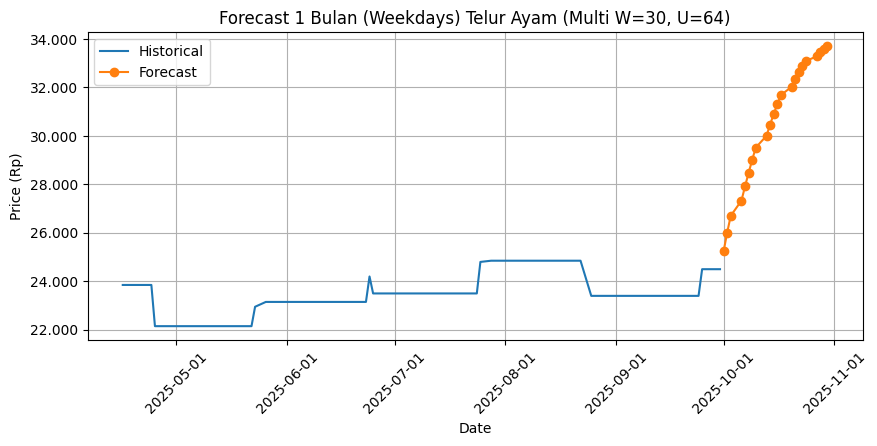

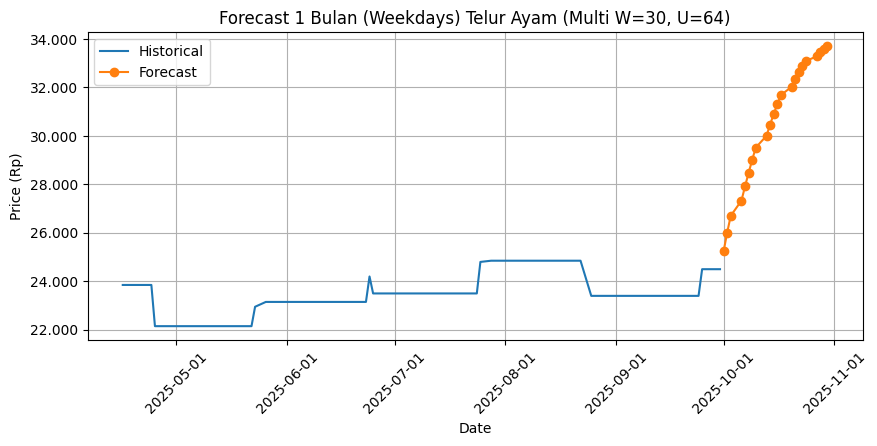


Rekap multivariate Telur Ayam disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate\Telur_Ayam\hasil_multivariate_Telur_Ayam.csv

==================== MULTIVARIATE: Bawang Merah ====================

[MULTIVARIATE] Target=Bawang Merah | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.0774 - val_loss: 0.0368
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0223 - val_loss: 0.0165
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0136 - val_loss: 0.0128
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0117 - val_loss: 0.0091
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0093 - val_loss: 0.0073
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0085 - val_loss: 0.0071
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0074 - val_loss: 0.0069
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0075 - val_loss: 0.0070
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0065 - val_loss: 0.0063
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0060 - val_loss: 0.0061
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0055 - val_loss: 0.0077
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0062 - val_l

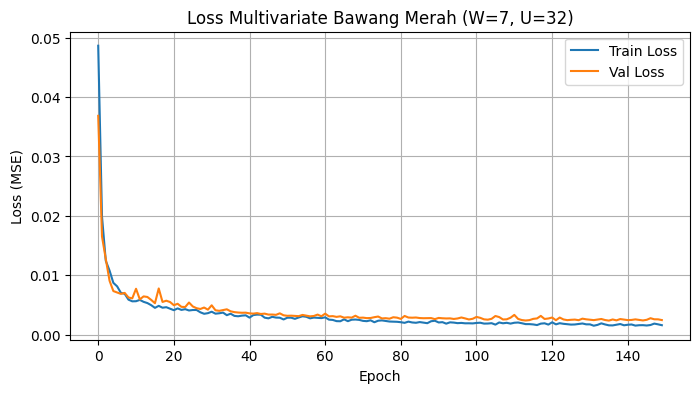

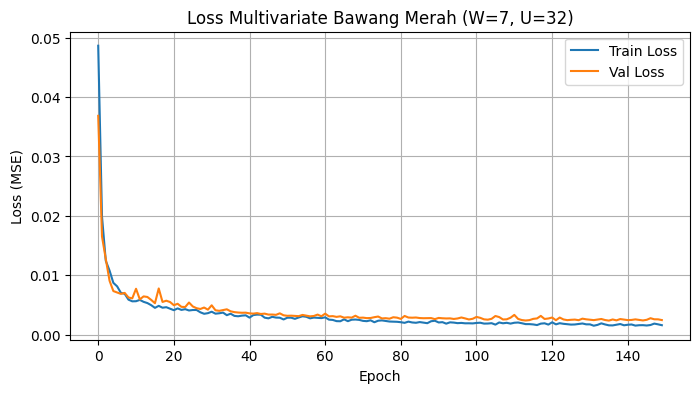

Test MAE  : 663.39
Test RMSE : 1,241.77
Test MAPE : 2.3932%


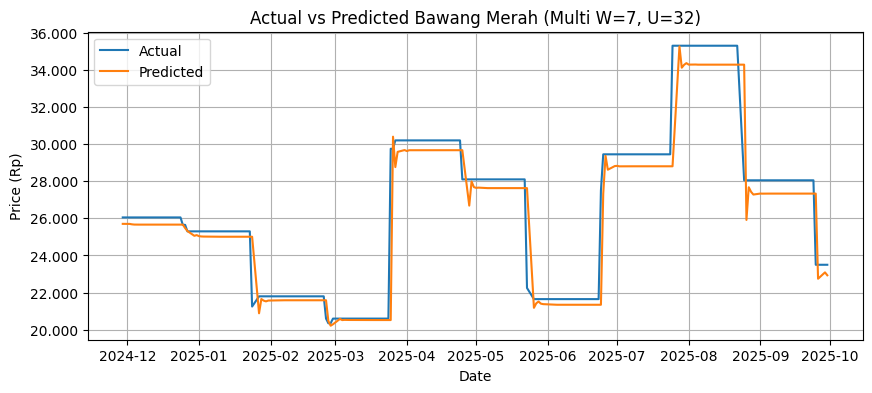

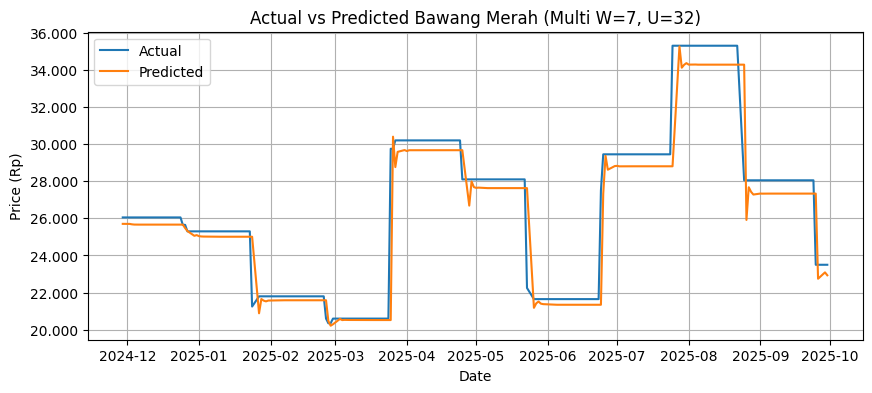


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,23500,22933.958984
1,2025-10-02,23500,22211.521484
2,2025-10-03,23500,21521.060547
3,2025-10-06,23500,20868.289062
4,2025-10-07,23500,20246.728516
5,2025-10-08,23500,19662.000000
6,2025-10-09,23500,19113.291016
7,2025-10-10,23500,18598.683594
8,2025-10-13,23500,18116.207031
9,2025-10-14,23500,17664.103516


Forecast MAPE Okt 2025 : 26.8348%
Compare CSV disimpan: compare_Okt2025_multi_W7_U32.csv


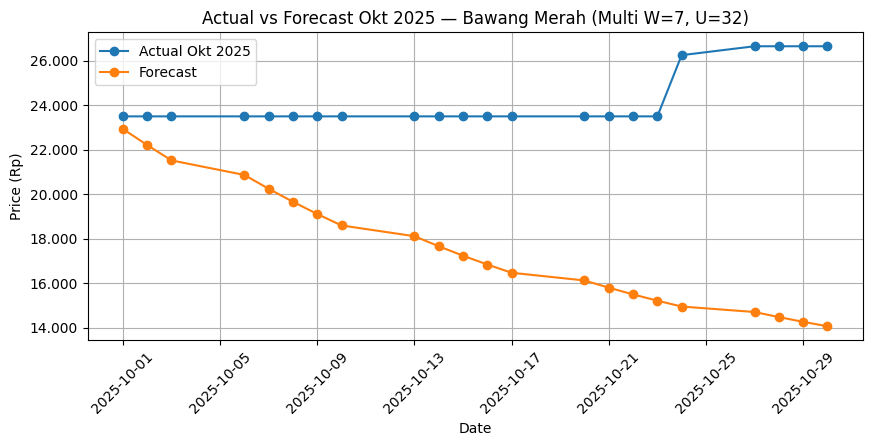

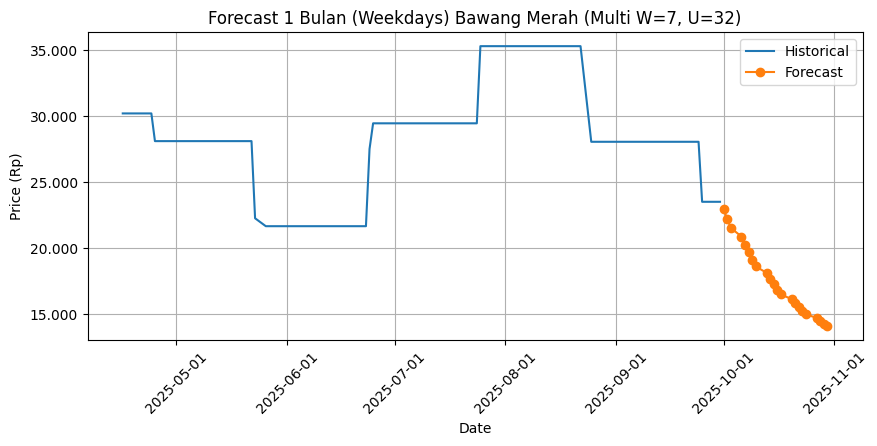

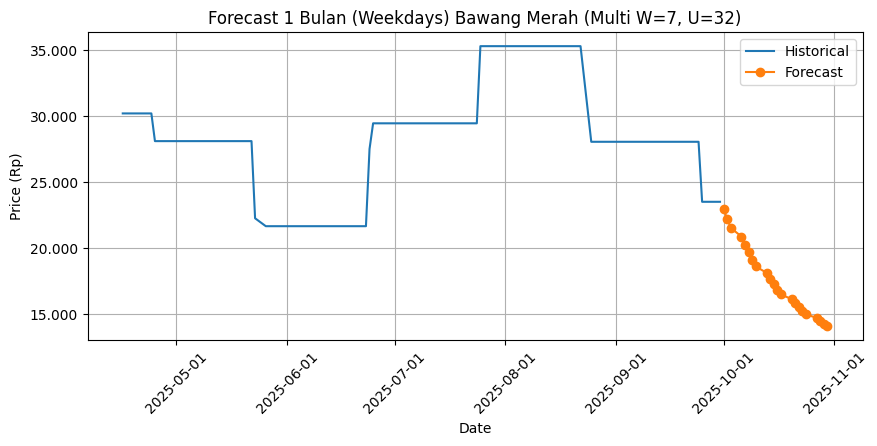


[MULTIVARIATE] Target=Bawang Merah | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 25ms/step - loss: 0.0845 - val_loss: 0.0230
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0157 - val_loss: 0.0160
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0104 - val_loss: 0.0091
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0080 - val_loss: 0.0107
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0080 - val_loss: 0.0098
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0060 - val_loss: 0.0090
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0070 - val_loss: 0.0070
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0060 - val_loss: 0.0065
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0053 - val_loss: 0.0065
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0052 - val_loss: 0.0065
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0049 - val_loss: 0.0087
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0049 - va

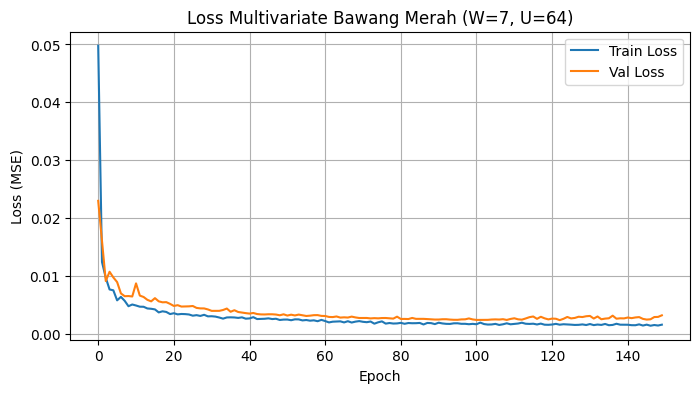

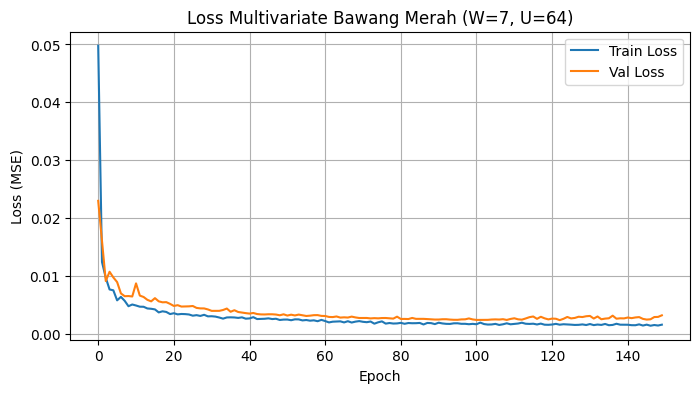

Test MAE  : 1,185.15
Test RMSE : 1,551.94
Test MAPE : 4.3524%


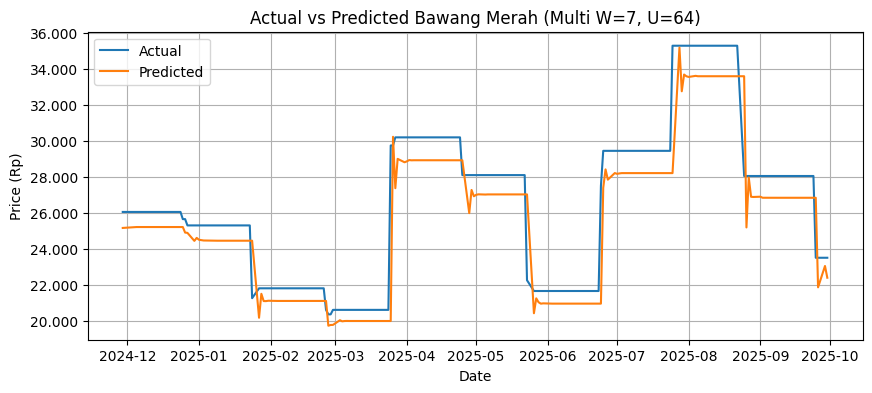

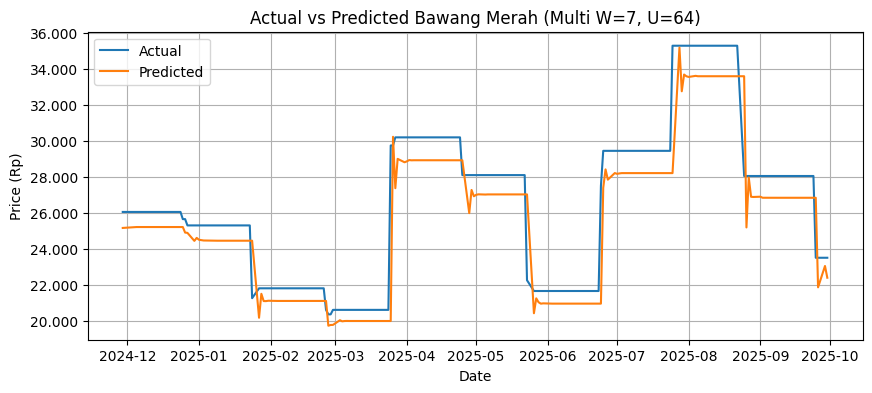


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,23500,22388.984375
1,2025-10-02,23500,21131.035156
2,2025-10-03,23500,20024.197266
3,2025-10-06,23500,19006.527344
4,2025-10-07,23500,18057.369141
5,2025-10-08,23500,17183.523438
6,2025-10-09,23500,16378.498047
7,2025-10-10,23500,15635.729492
8,2025-10-13,23500,14950.842773
9,2025-10-14,23500,14319.907227


Forecast MAPE Okt 2025 : 39.8899%
Compare CSV disimpan: compare_Okt2025_multi_W7_U64.csv


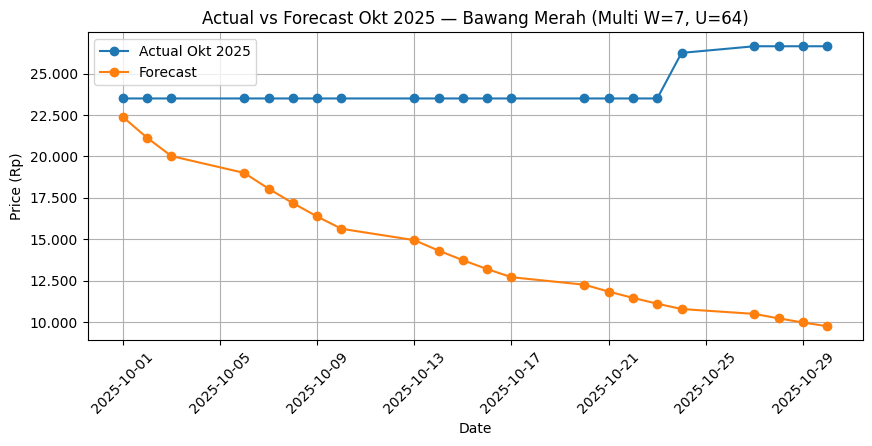

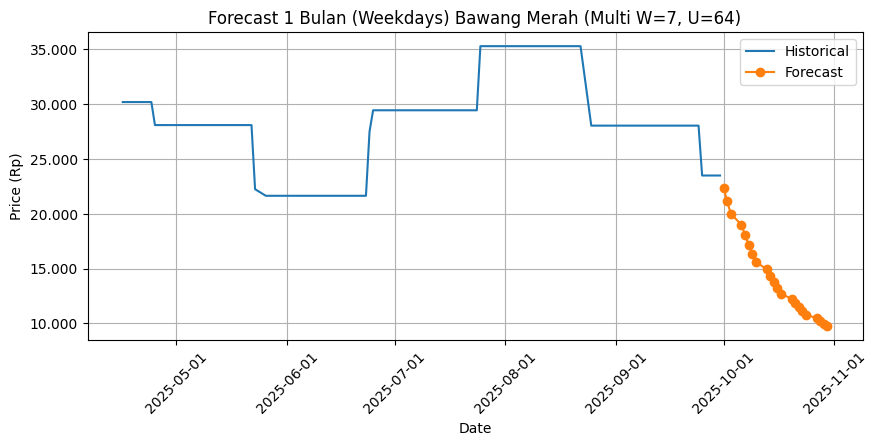

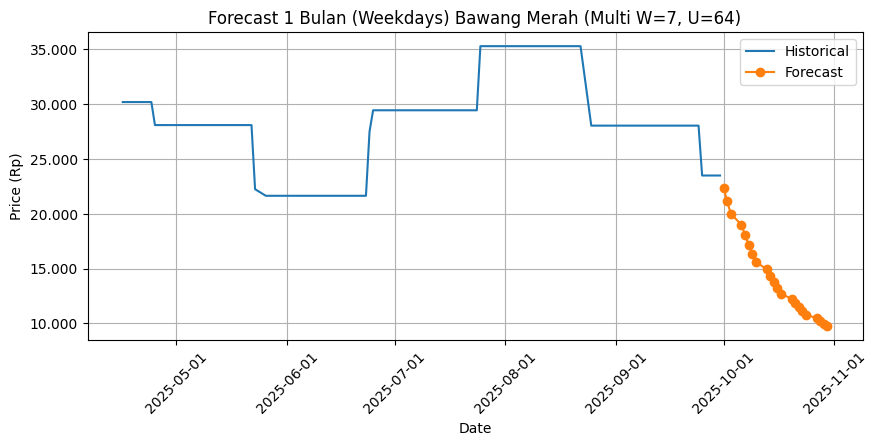


[MULTIVARIATE] Target=Bawang Merah | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - loss: 0.0345 - val_loss: 0.0247
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0166 - val_loss: 0.0109
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0107 - val_loss: 0.0105
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0079 - val_loss: 0.0153
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0074 - val_loss: 0.0108
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0057 - val_loss: 0.0082
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0058 - val_loss: 0.0079
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0055 - val_loss: 0.0090
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0058 - val_loss: 0.0094
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0050 - val_loss: 0.0061
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0047 - val_loss: 0.0064
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0049 - val

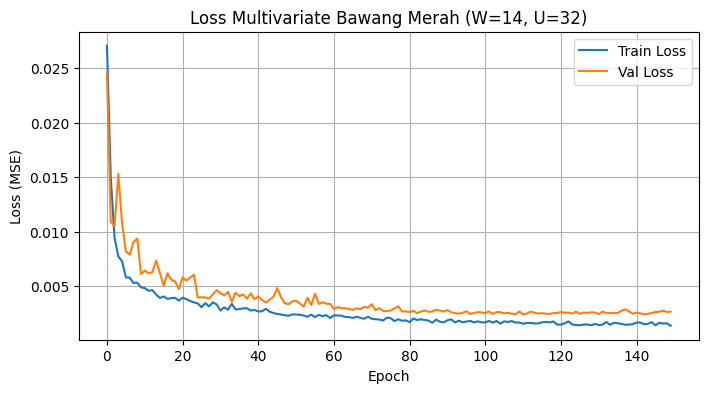

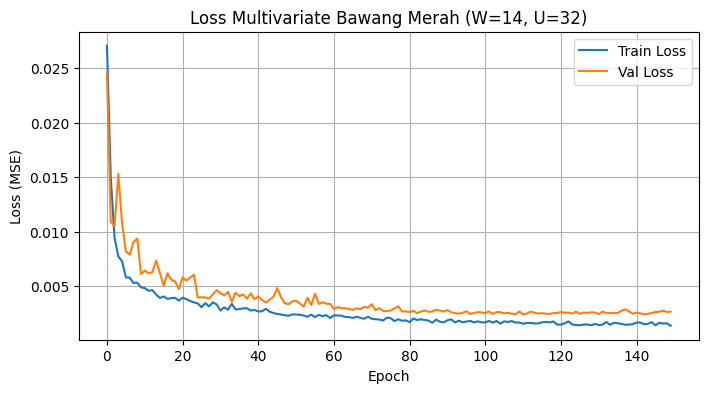

Test MAE  : 668.12
Test RMSE : 1,266.90
Test MAPE : 2.4470%


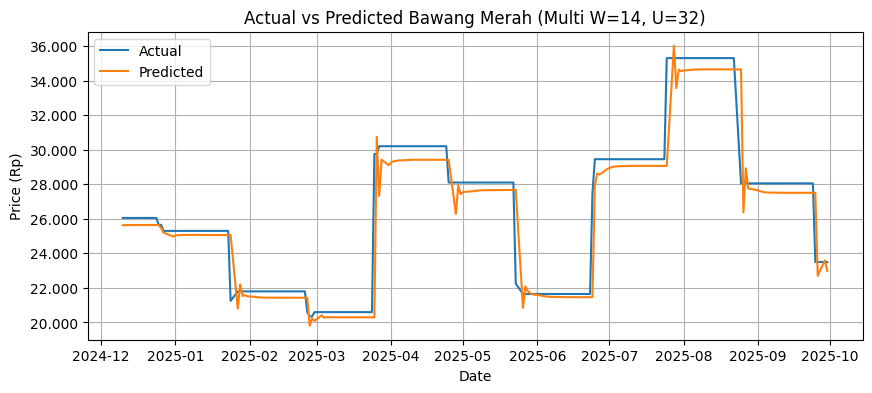

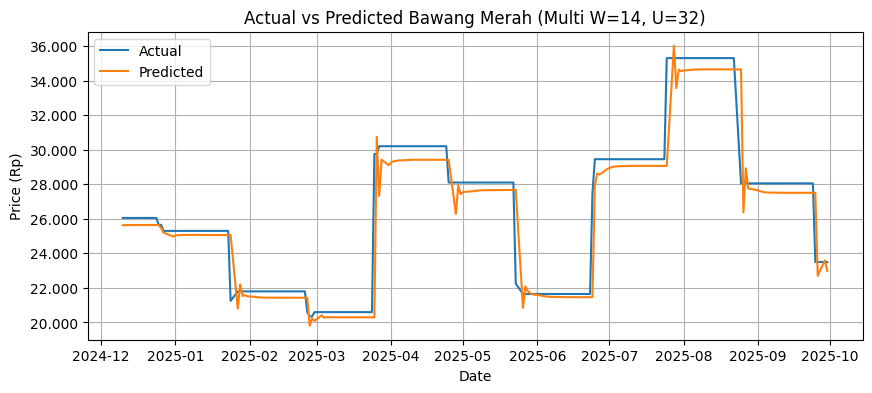


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,23500,22982.146484
1,2025-10-02,23500,22412.085938
2,2025-10-03,23500,21872.068359
3,2025-10-06,23500,21352.134766
4,2025-10-07,23500,20843.712891
5,2025-10-08,23500,20347.513672
6,2025-10-09,23500,19866.541016
7,2025-10-10,23500,19402.679688
8,2025-10-13,23500,18956.800781
9,2025-10-14,23500,18529.138672


Forecast MAPE Okt 2025 : 24.0124%
Compare CSV disimpan: compare_Okt2025_multi_W14_U32.csv


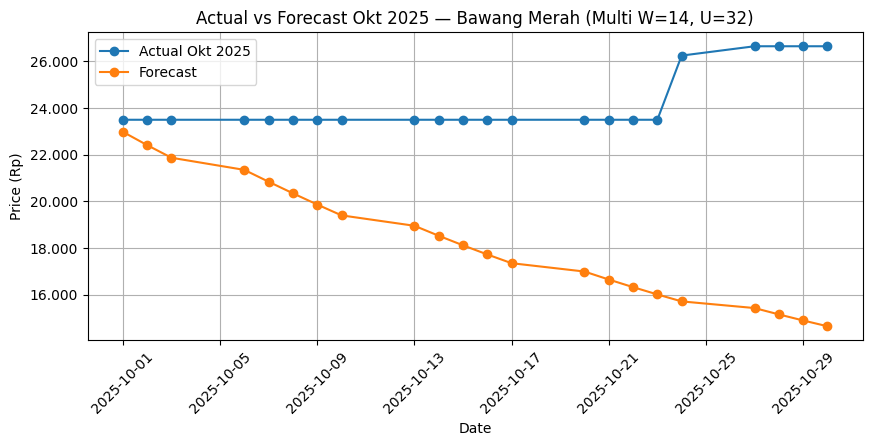

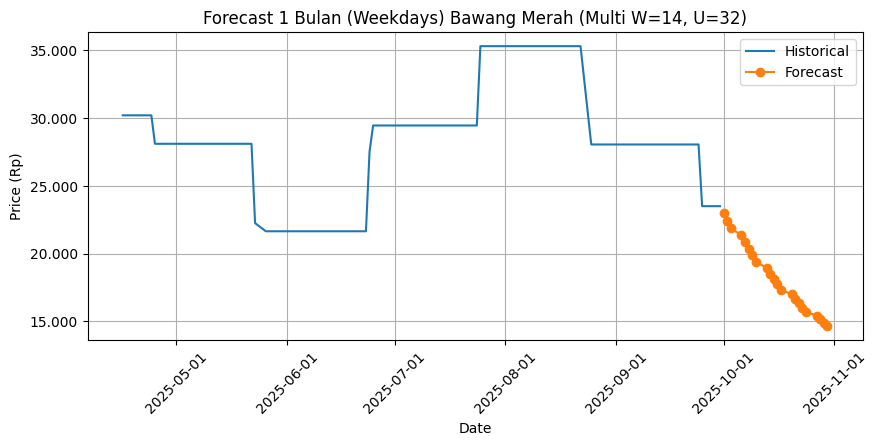

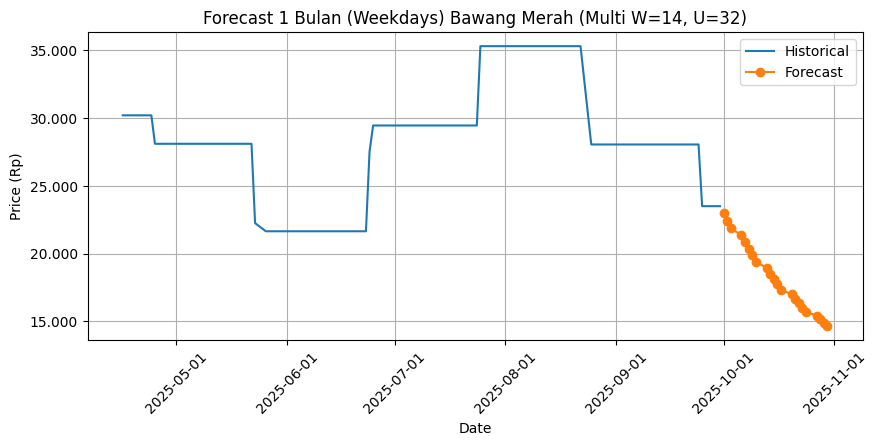


[MULTIVARIATE] Target=Bawang Merah | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - loss: 0.1108 - val_loss: 0.0417
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 0.0193 - val_loss: 0.0222
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0102 - val_loss: 0.0148
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0083 - val_loss: 0.0194
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0079 - val_loss: 0.0131
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0063 - val_loss: 0.0087
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0062 - val_loss: 0.0083
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0055 - val_loss: 0.0078
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0049 - val_loss: 0.0071
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0047 - val_loss: 0.0070
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0046 - val_loss: 0.0074
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0

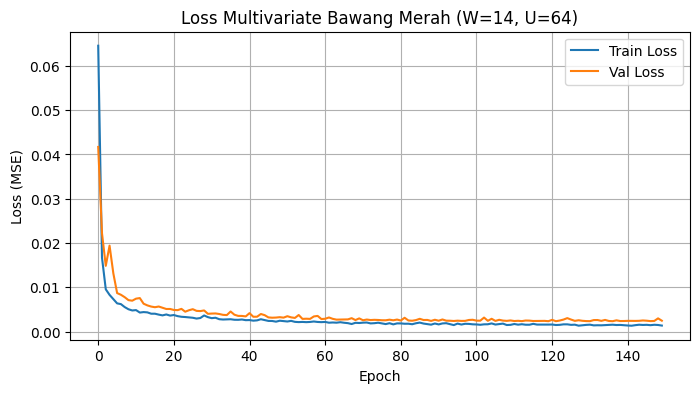

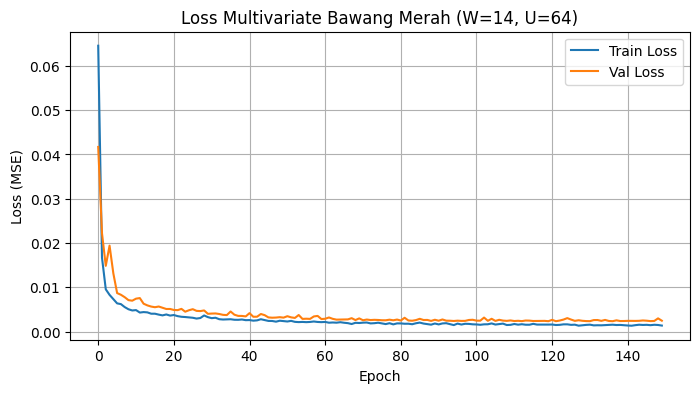

Test MAE  : 451.35
Test RMSE : 1,193.54
Test MAPE : 1.6563%


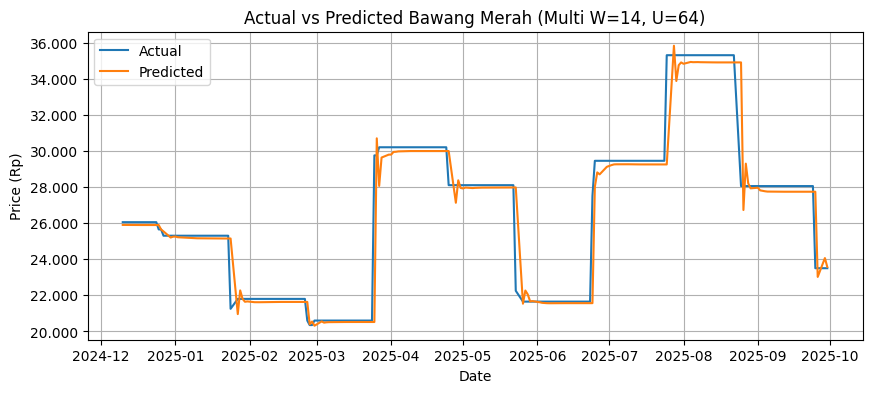

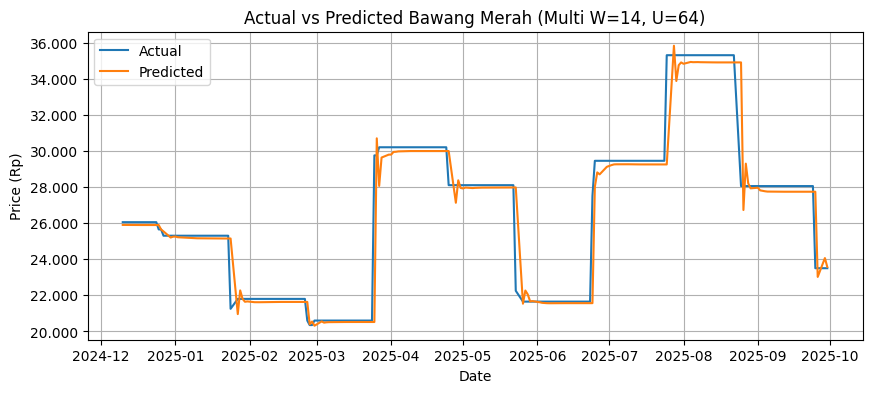


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,23500,23568.070312
1,2025-10-02,23500,23371.140625
2,2025-10-03,23500,23110.945312
3,2025-10-06,23500,22792.847656
4,2025-10-07,23500,22457.847656
5,2025-10-08,23500,22118.052734
6,2025-10-09,23500,21777.218750
7,2025-10-10,23500,21438.240234
8,2025-10-13,23500,21103.199219
9,2025-10-14,23500,20773.482422


Forecast MAPE Okt 2025 : 15.2020%
Compare CSV disimpan: compare_Okt2025_multi_W14_U64.csv


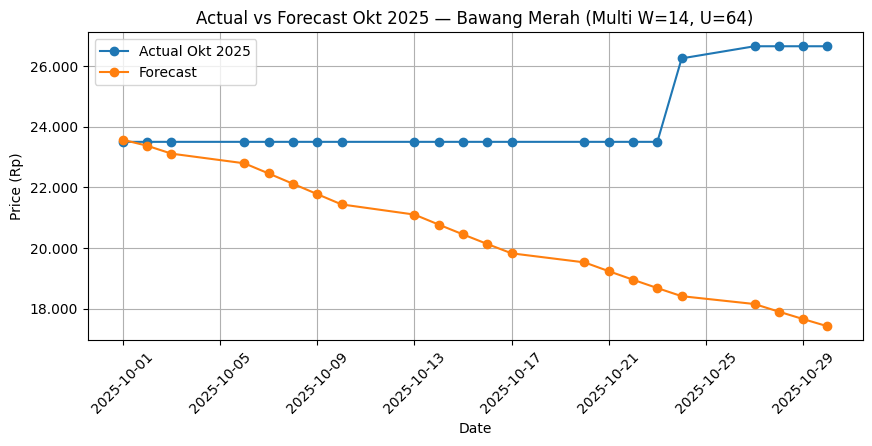

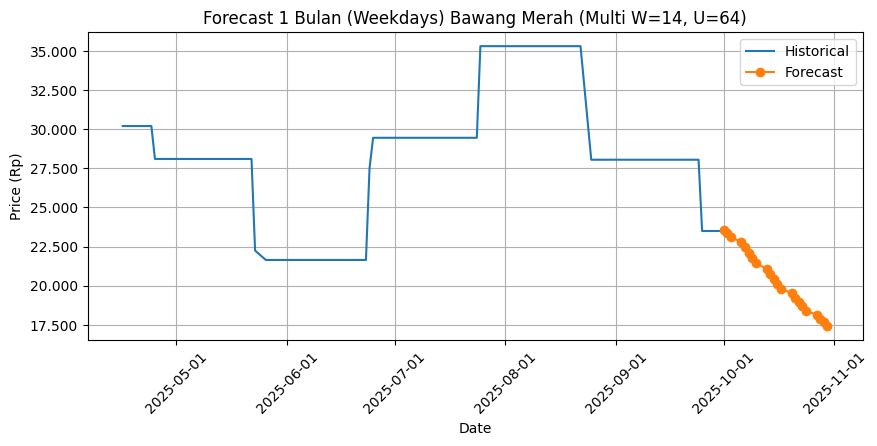

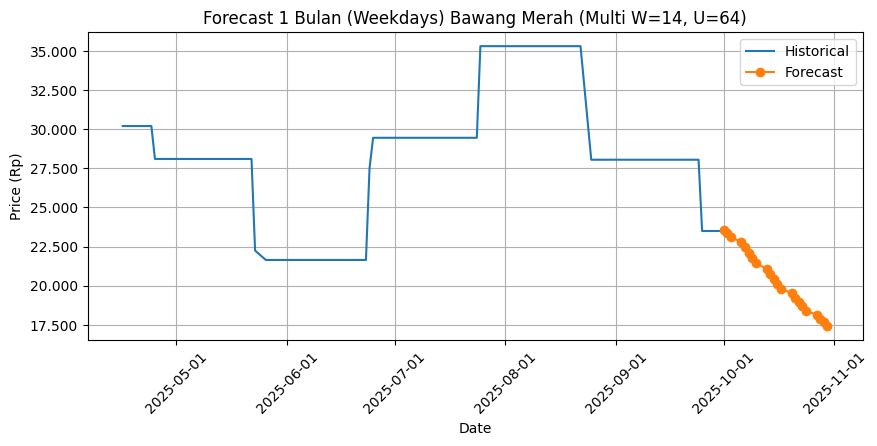


[MULTIVARIATE] Target=Bawang Merah | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 24ms/step - loss: 0.0697 - val_loss: 0.0385
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0173 - val_loss: 0.0405
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0148 - val_loss: 0.0259
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0113 - val_loss: 0.0160
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0085 - val_loss: 0.0147
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0084 - val_loss: 0.0145
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0079 - val_loss: 0.0138
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0080 - val_loss: 0.0164
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0068 - val_loss: 0.0165
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0072 - val_loss: 0.0111
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0059 - val_loss: 0.0105
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0

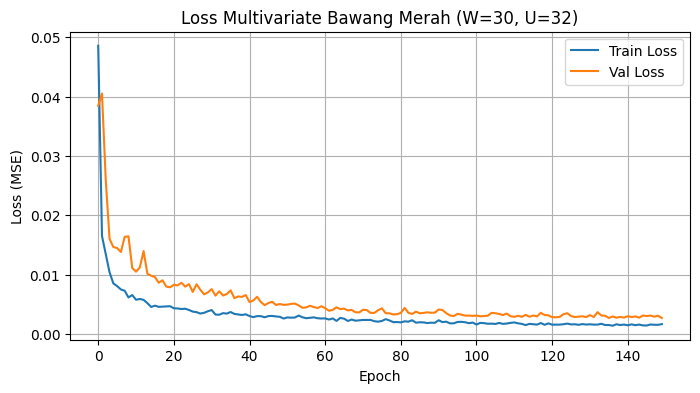

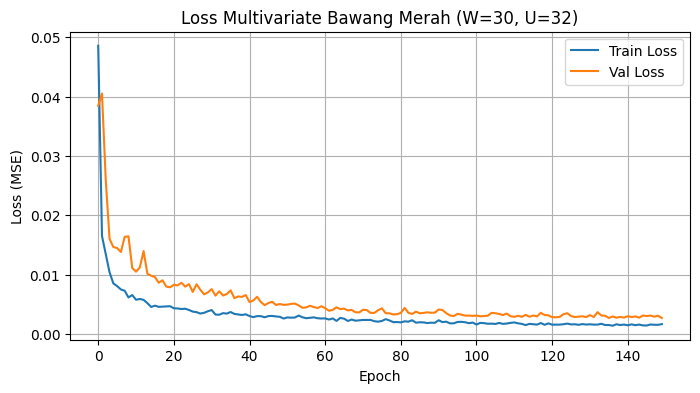

Test MAE  : 957.05
Test RMSE : 1,467.50
Test MAPE : 3.7336%


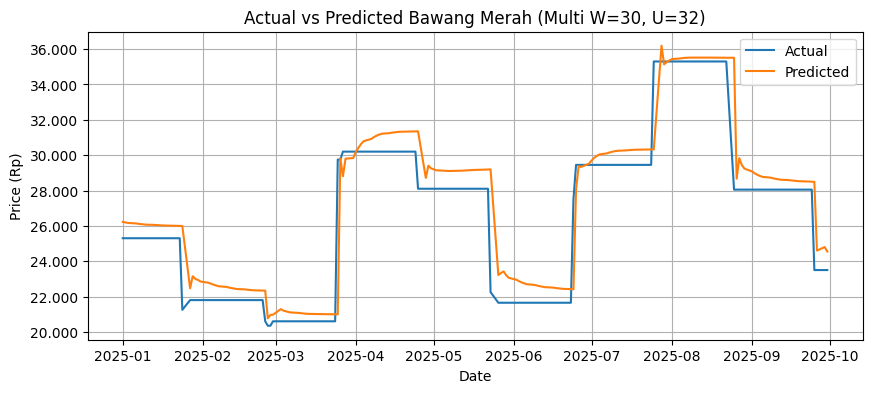

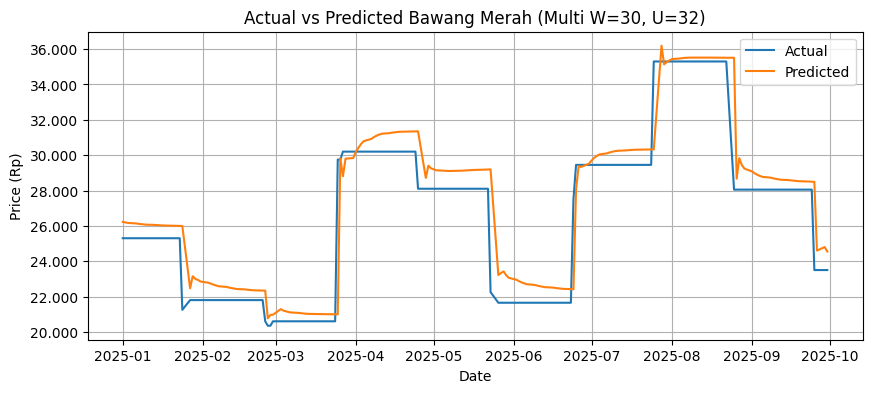


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,23500,24549.083984
1,2025-10-02,23500,25395.414062
2,2025-10-03,23500,25938.771484
3,2025-10-06,23500,26267.587891
4,2025-10-07,23500,26450.345703
5,2025-10-08,23500,26543.150391
6,2025-10-09,23500,26578.181641
7,2025-10-10,23500,26572.691406
8,2025-10-13,23500,26536.707031
9,2025-10-14,23500,26476.769531


Forecast MAPE Okt 2025 : 9.6872%
Compare CSV disimpan: compare_Okt2025_multi_W30_U32.csv


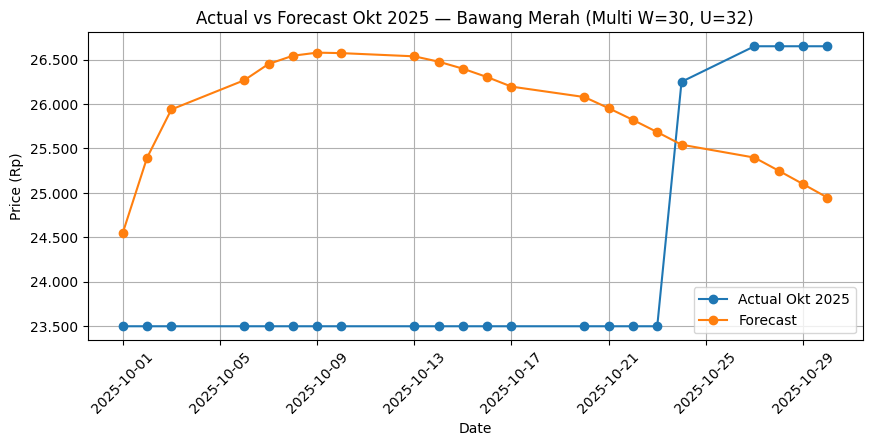

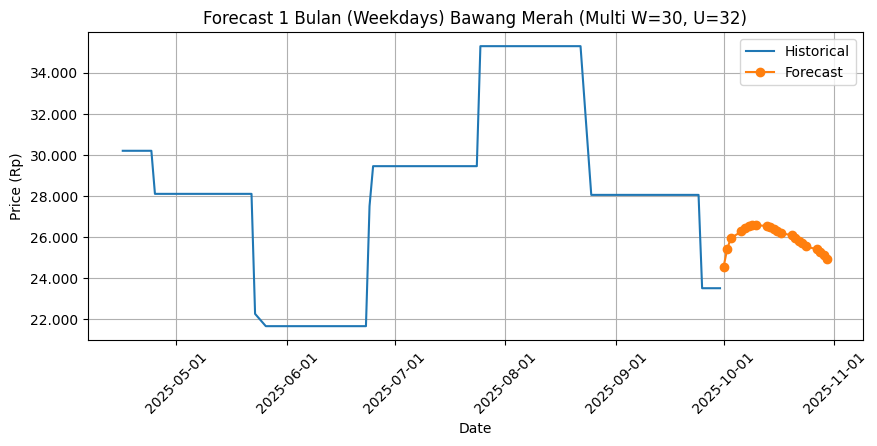

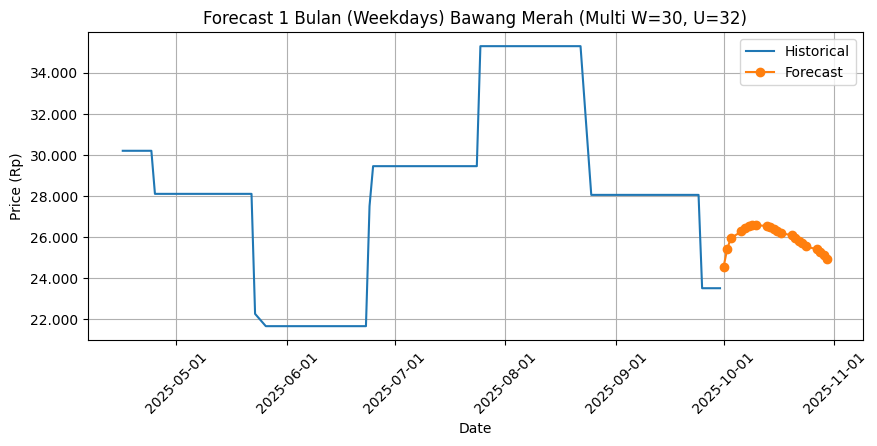


[MULTIVARIATE] Target=Bawang Merah | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - loss: 0.0730 - val_loss: 0.0513
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0139 - val_loss: 0.0329
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0106 - val_loss: 0.0286
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0090 - val_loss: 0.0146
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0077 - val_loss: 0.0186
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0069 - val_loss: 0.0118
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0062 - val_loss: 0.0125
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0059 - val_loss: 0.0108
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0054 - val_loss: 0.0107
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0049 - val_loss: 0.0124
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0053 - val_loss: 0.0110
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0

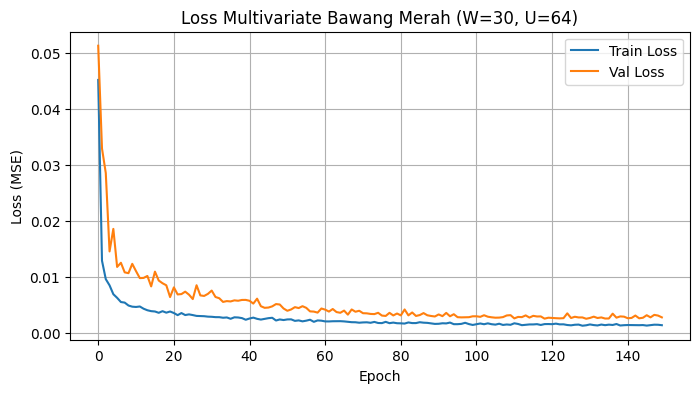

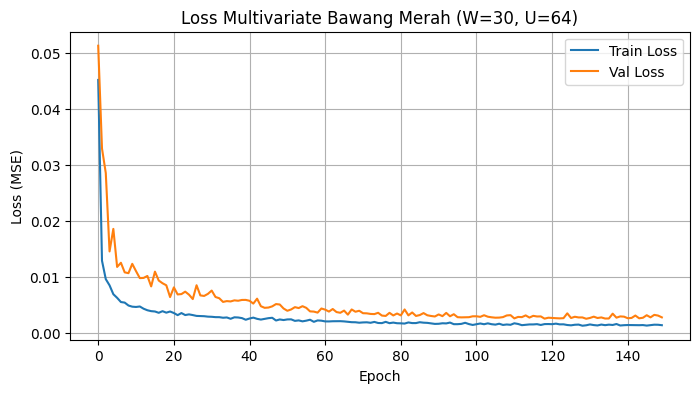

Test MAE  : 660.49
Test RMSE : 1,295.78
Test MAPE : 2.3458%


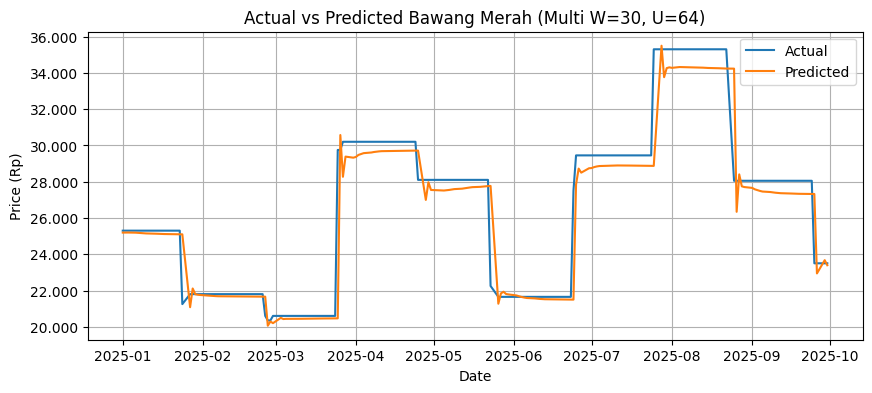

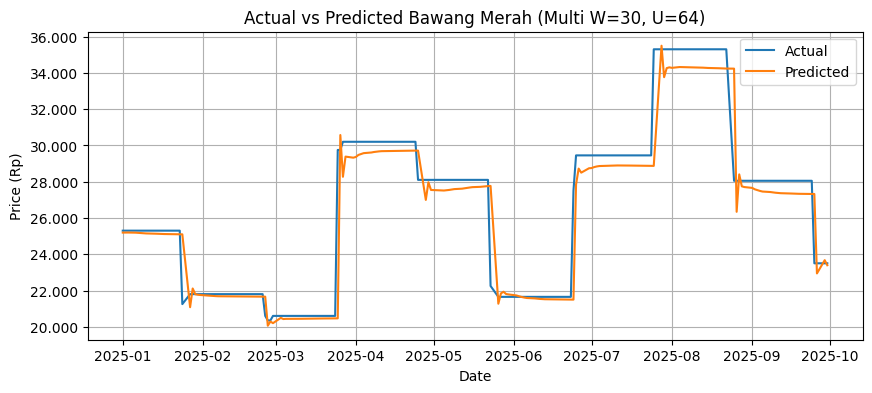


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,23500,23393.892578
1,2025-10-02,23500,23243.917969
2,2025-10-03,23500,23041.177734
3,2025-10-06,23500,22774.294922
4,2025-10-07,23500,22456.949219
5,2025-10-08,23500,22100.791016
6,2025-10-09,23500,21716.197266
7,2025-10-10,23500,21311.910156
8,2025-10-13,23500,20894.894531
9,2025-10-14,23500,20470.542969


Forecast MAPE Okt 2025 : 17.7312%
Compare CSV disimpan: compare_Okt2025_multi_W30_U64.csv


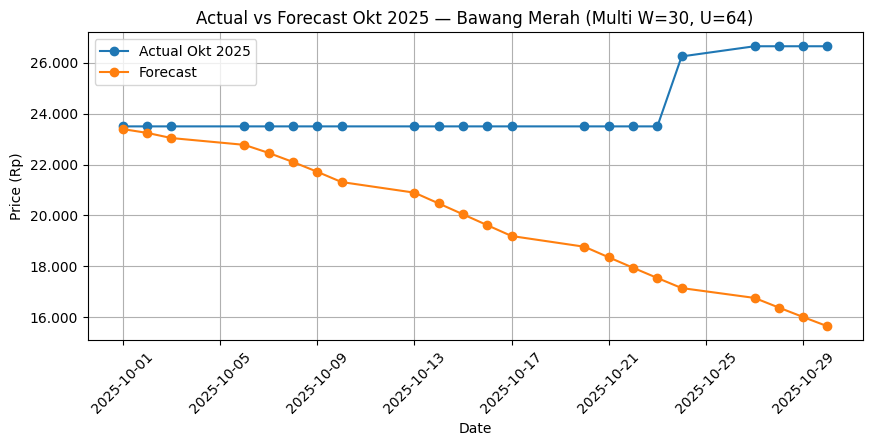

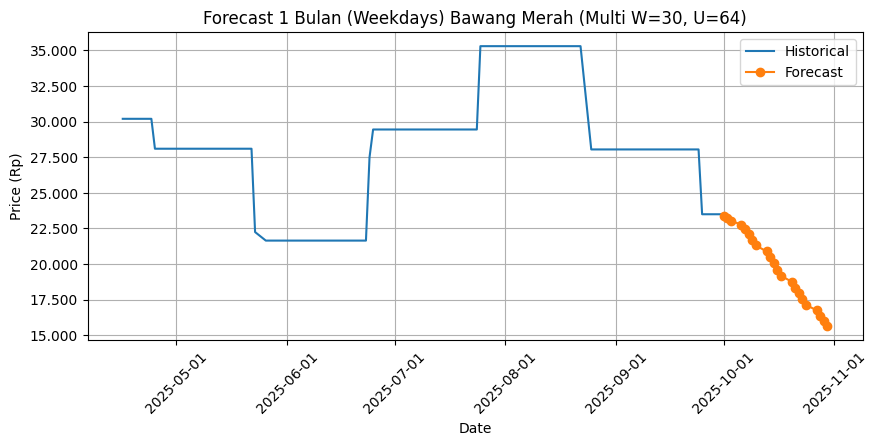

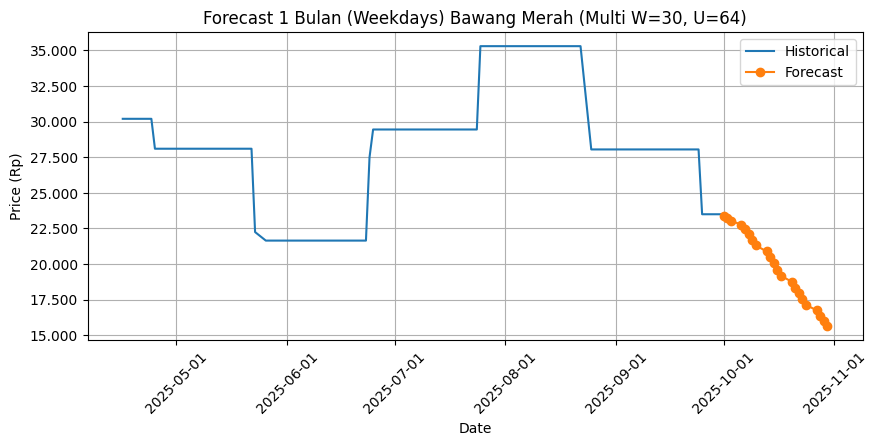


Rekap multivariate Bawang Merah disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate\Bawang_Merah\hasil_multivariate_Bawang_Merah.csv

==================== MULTIVARIATE: Cabai Merah ====================

[MULTIVARIATE] Target=Cabai Merah | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.0906 - val_loss: 0.0350
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0225 - val_loss: 0.0205
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0146 - val_loss: 0.0157
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0132 - val_loss: 0.0137
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0108 - val_loss: 0.0150
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0095 - val_loss: 0.0119
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0092 - val_loss: 0.0121
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0078 - val_loss: 0.0118
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0074 - val_loss: 0.0100
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0066 - val_loss: 0.0100
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0072 - val_loss: 0.0096
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0070 - val_l

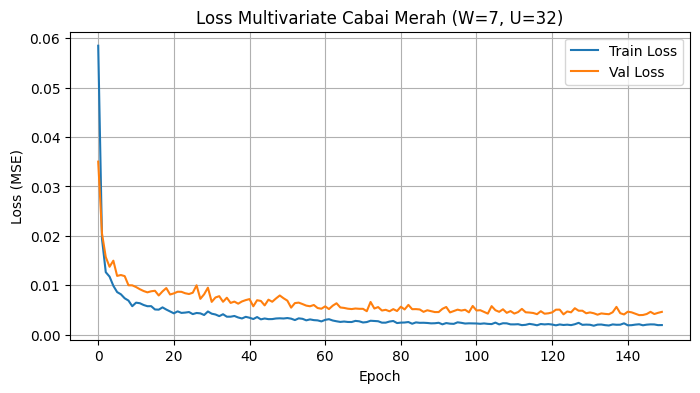

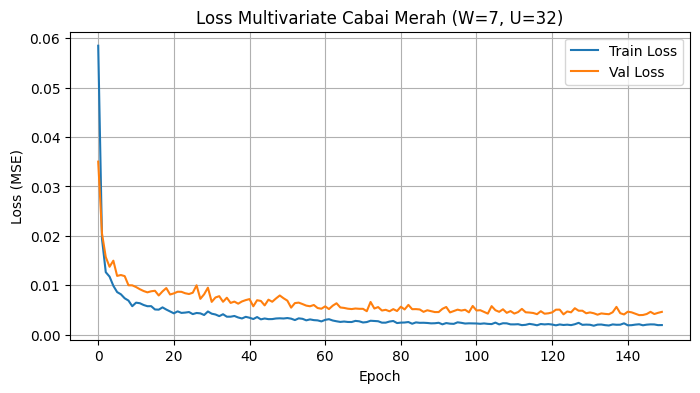

Test MAE  : 1,676.51
Test RMSE : 2,087.70
Test MAPE : 7.4823%


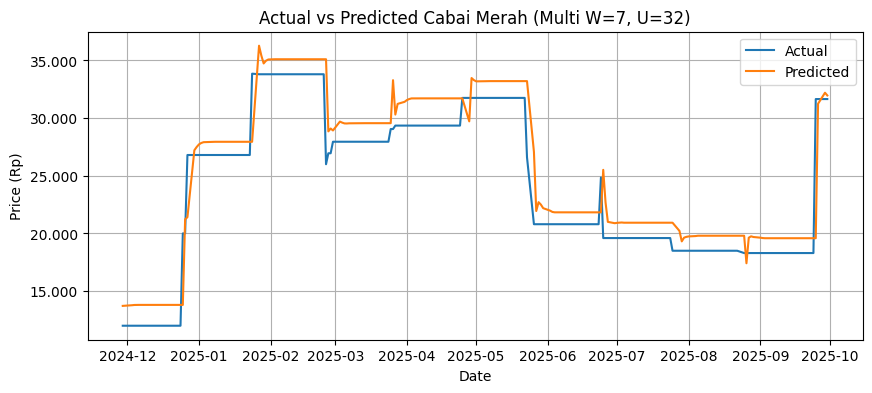

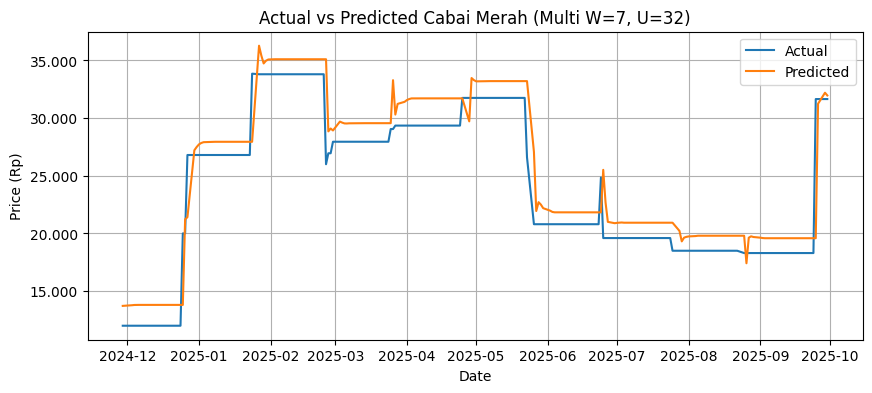


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,31650,31963.730469
1,2025-10-02,31650,32453.355469
2,2025-10-03,31650,33047.679688
3,2025-10-06,31650,33637.750000
4,2025-10-07,31650,34187.917969
5,2025-10-08,31650,34686.304688
6,2025-10-09,31650,35144.039062
7,2025-10-10,31650,35567.644531
8,2025-10-13,31650,35960.675781
9,2025-10-14,31650,36325.039062


Forecast MAPE Okt 2025 : 14.0915%
Compare CSV disimpan: compare_Okt2025_multi_W7_U32.csv


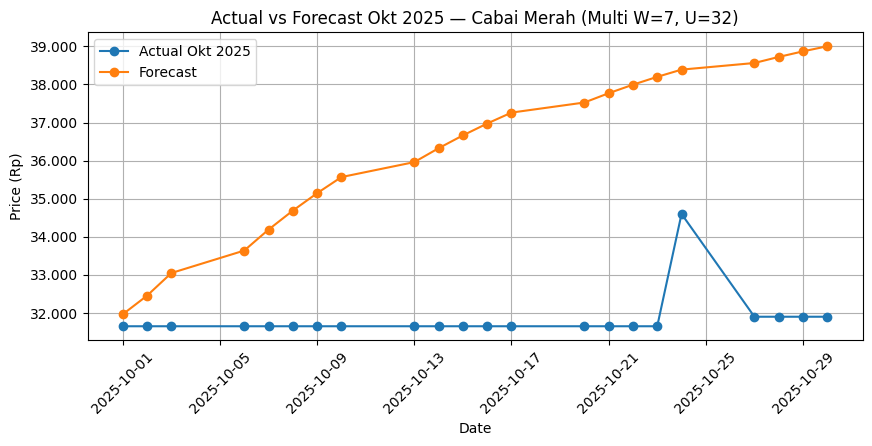

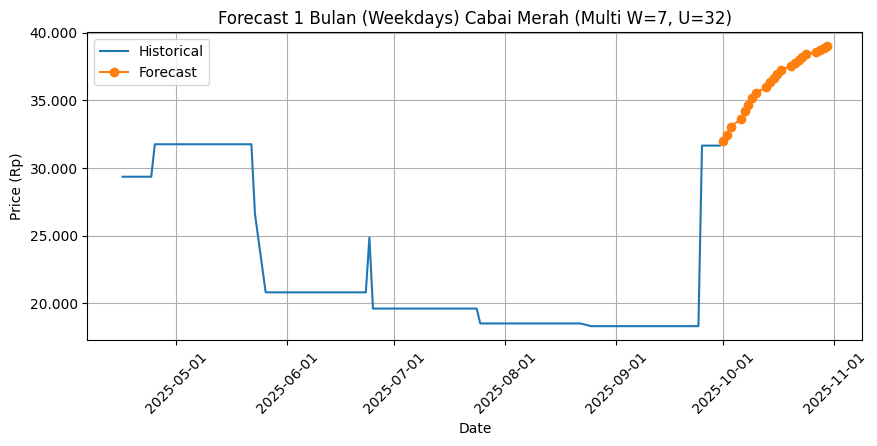

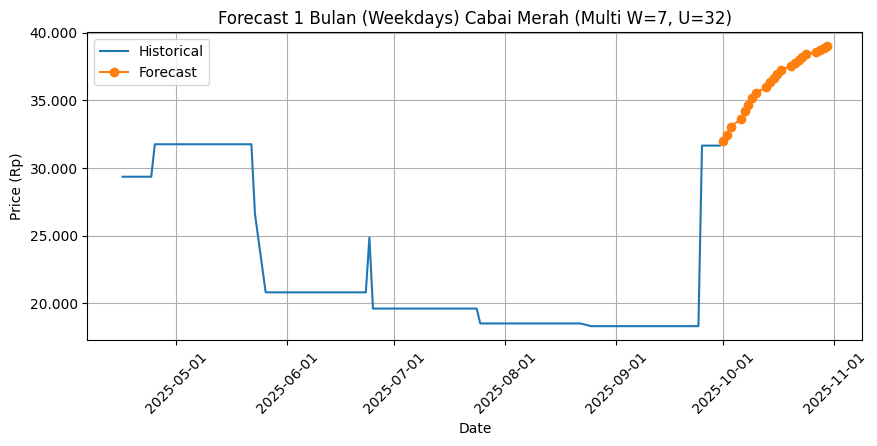


[MULTIVARIATE] Target=Cabai Merah | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - loss: 0.0328 - val_loss: 0.0262
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0112 - val_loss: 0.0150
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0089 - val_loss: 0.0147
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0069 - val_loss: 0.0100
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0062 - val_loss: 0.0110
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0064 - val_loss: 0.0097
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0053 - val_loss: 0.0096
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0051 - val_loss: 0.0092
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0051 - val_loss: 0.0082
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0045 - val_loss: 0.0080
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0046 - val_loss: 0.0093
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0045 - val

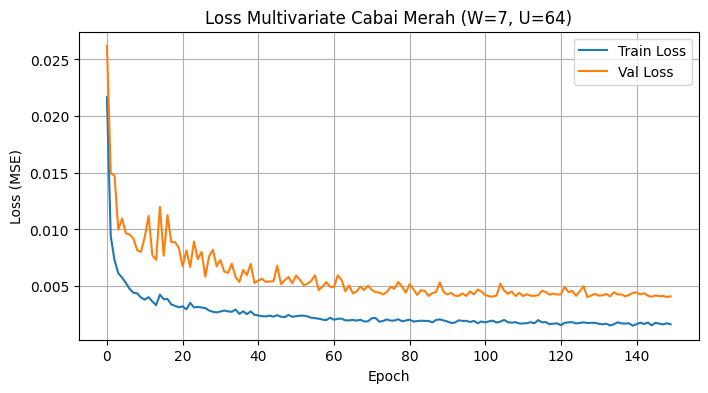

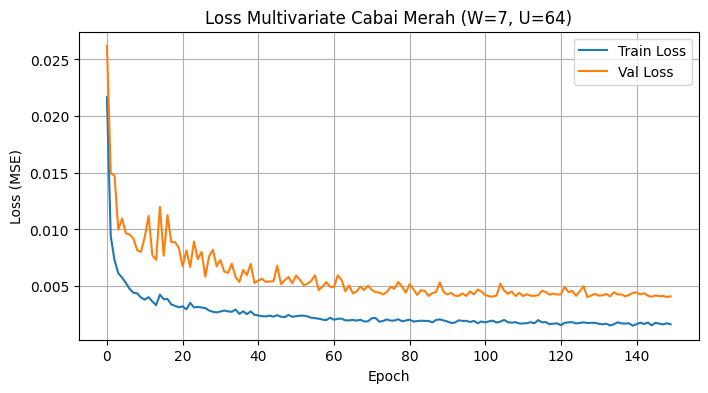

Test MAE  : 1,227.05
Test RMSE : 1,861.61
Test MAPE : 5.2151%


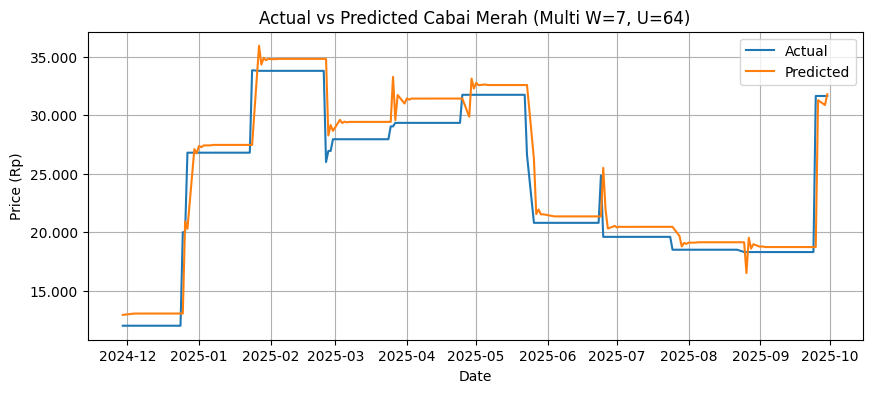

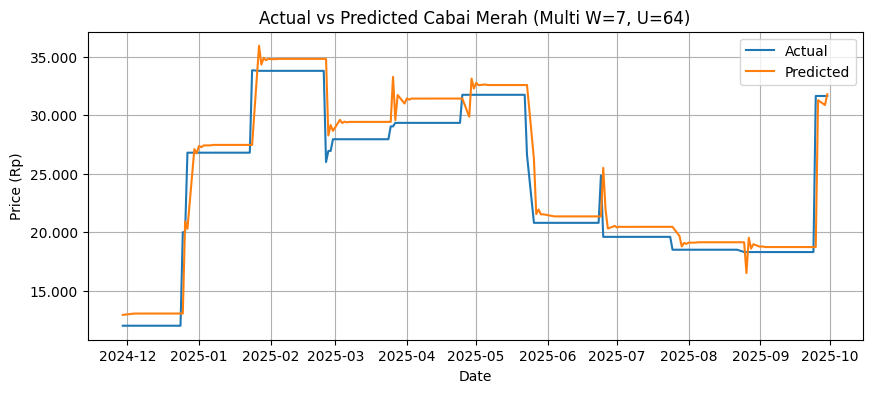


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,31650,31795.605469
1,2025-10-02,31650,31634.212891
2,2025-10-03,31650,31660.777344
3,2025-10-06,31650,31647.775391
4,2025-10-07,31650,31665.394531
5,2025-10-08,31650,31687.314453
6,2025-10-09,31650,31702.753906
7,2025-10-10,31650,31718.171875
8,2025-10-13,31650,31731.910156
9,2025-10-14,31650,31744.732422


Forecast MAPE Okt 2025 : 0.6133%
Compare CSV disimpan: compare_Okt2025_multi_W7_U64.csv


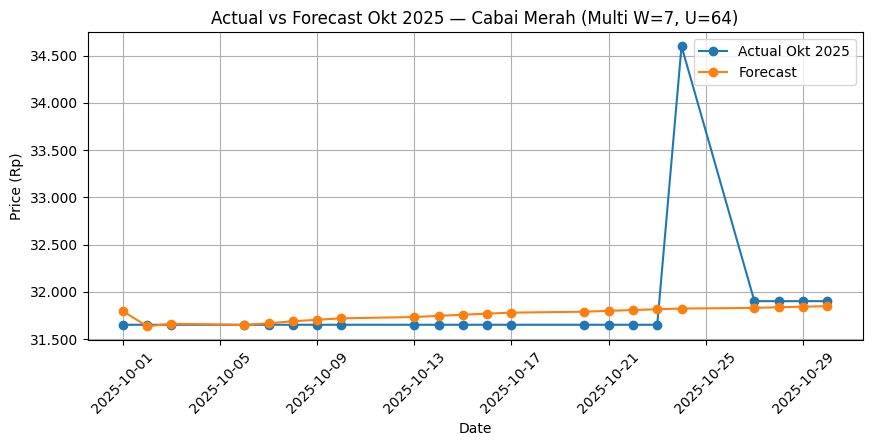

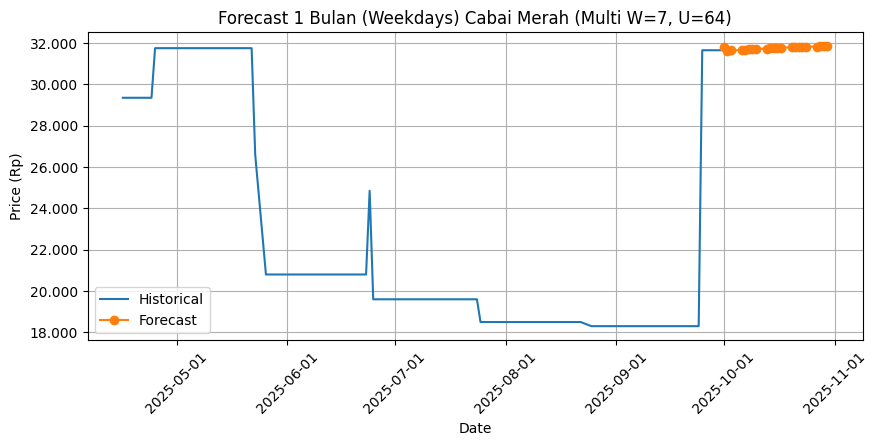

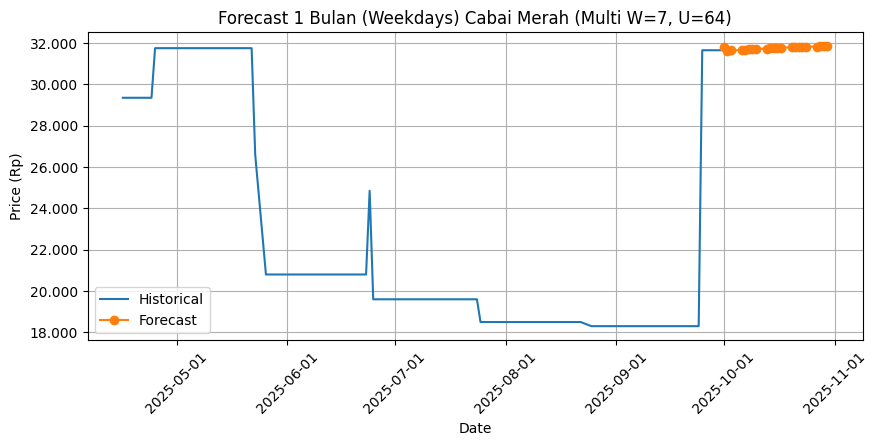


[MULTIVARIATE] Target=Cabai Merah | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 0.0376 - val_loss: 0.0265
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0158 - val_loss: 0.0197
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0114 - val_loss: 0.0177
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0080 - val_loss: 0.0192
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0072 - val_loss: 0.0181
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0065 - val_loss: 0.0155
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0062 - val_loss: 0.0207
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0061 - val_loss: 0.0146
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0056 - val_loss: 0.0171
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0053 - val_loss: 0.0128
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0055 - val_loss: 0.0144
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0053 - 

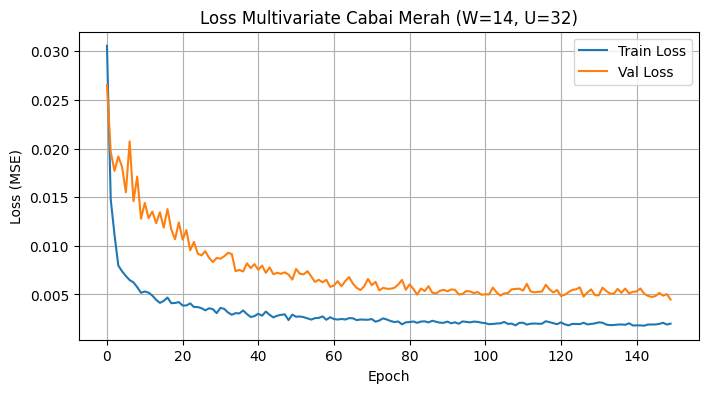

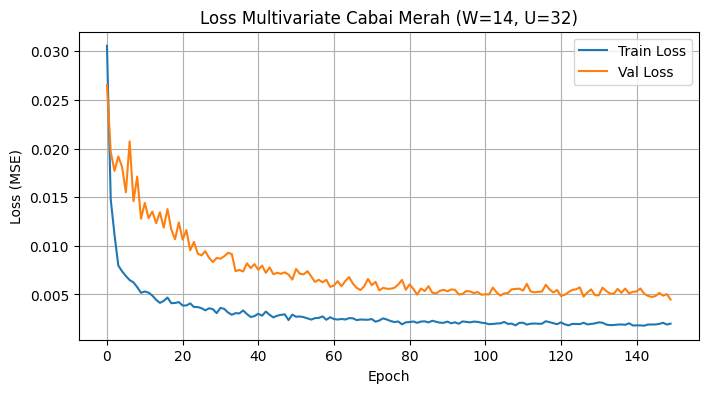

Test MAE  : 971.65
Test RMSE : 1,720.94
Test MAPE : 4.2636%


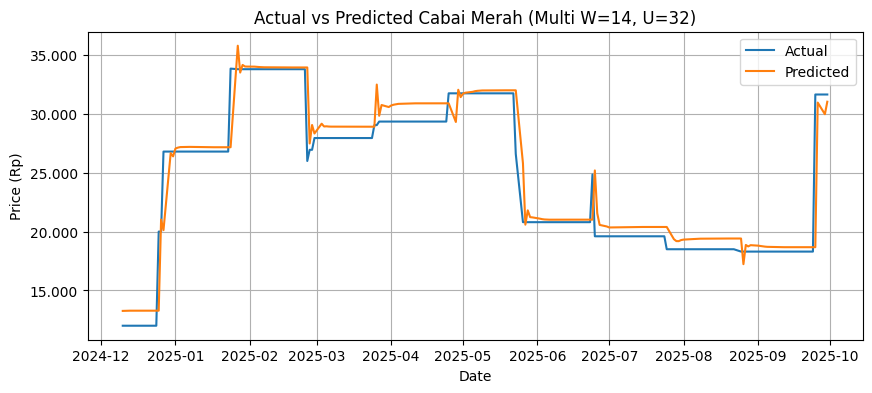

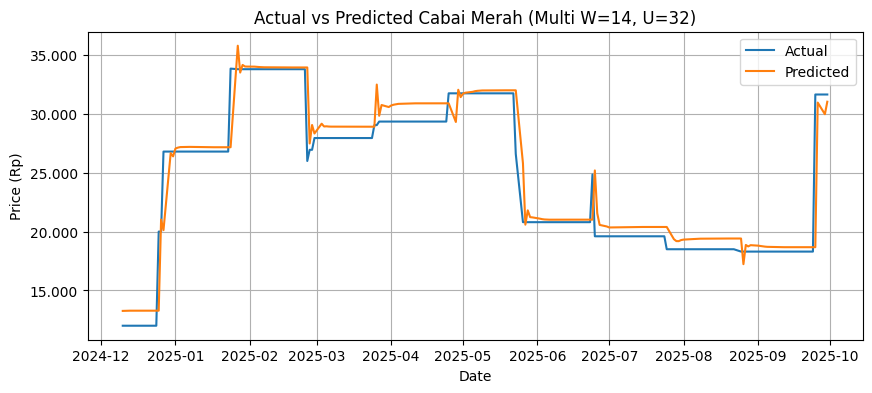


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,31650,31036.824219
1,2025-10-02,31650,30434.921875
2,2025-10-03,31650,29945.185547
3,2025-10-06,31650,29485.634766
4,2025-10-07,31650,29031.703125
5,2025-10-08,31650,28594.511719
6,2025-10-09,31650,28178.857422
7,2025-10-10,31650,27789.464844
8,2025-10-13,31650,27428.767578
9,2025-10-14,31650,27097.353516


Forecast MAPE Okt 2025 : 14.6193%
Compare CSV disimpan: compare_Okt2025_multi_W14_U32.csv


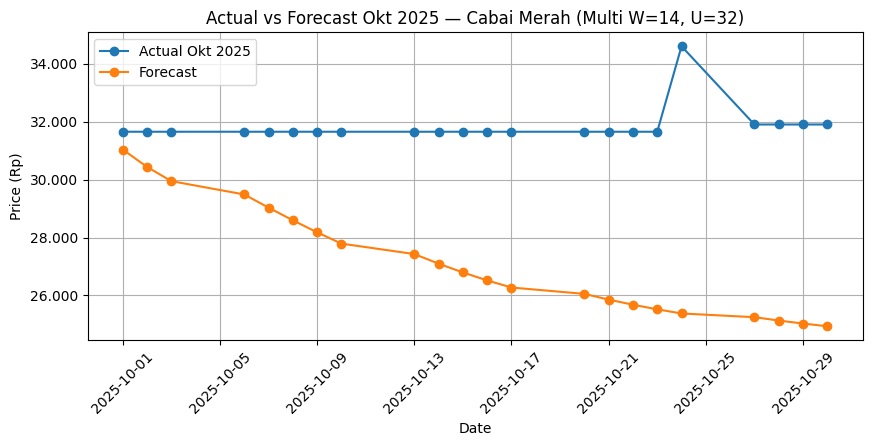

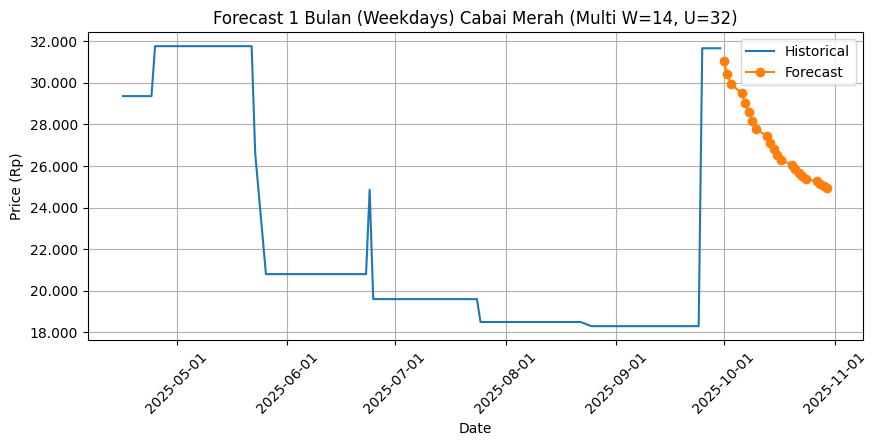

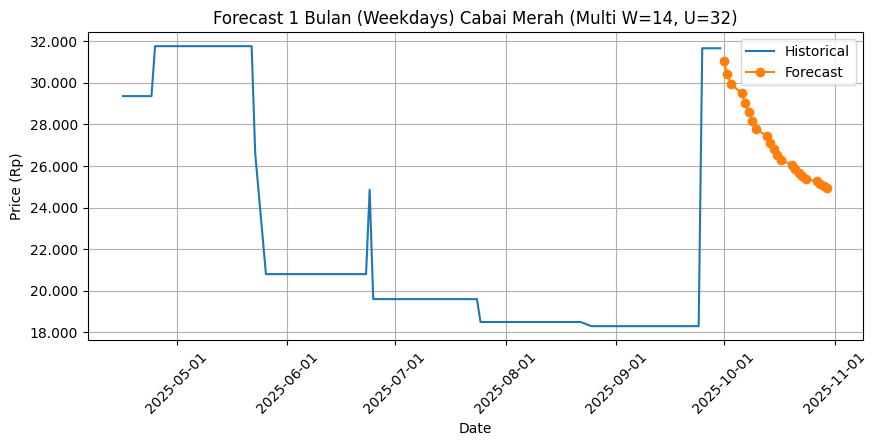


[MULTIVARIATE] Target=Cabai Merah | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.1562 - val_loss: 0.0430
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0188 - val_loss: 0.0260
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0123 - val_loss: 0.0217
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0098 - val_loss: 0.0163
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0078 - val_loss: 0.0144
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0073 - val_loss: 0.0130
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0064 - val_loss: 0.0120
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0067 - val_loss: 0.0141
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0055 - val_loss: 0.0119
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0049 - val_loss: 0.0118
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0051 - val_loss: 0.0135
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0054

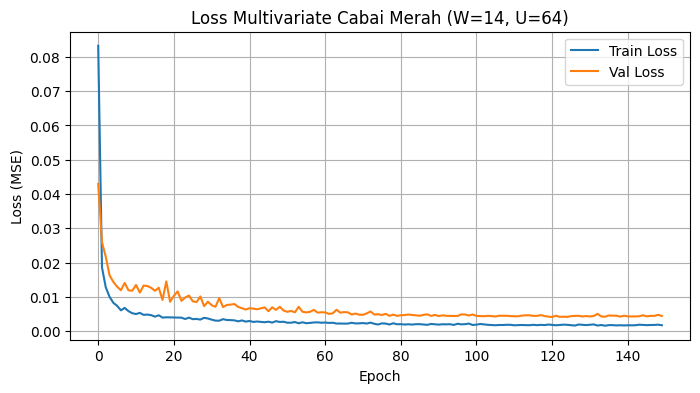

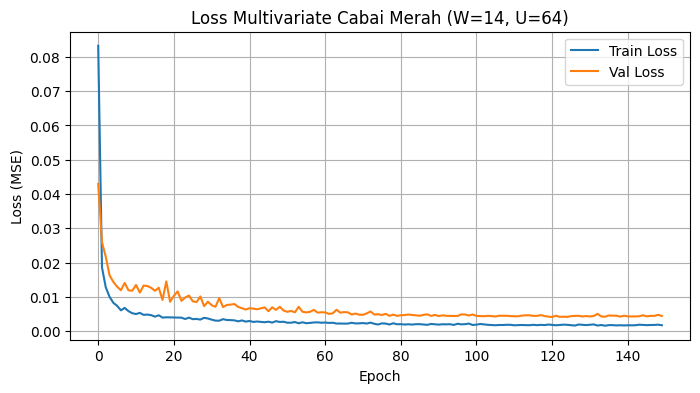

Test MAE  : 1,281.90
Test RMSE : 1,856.45
Test MAPE : 5.6153%


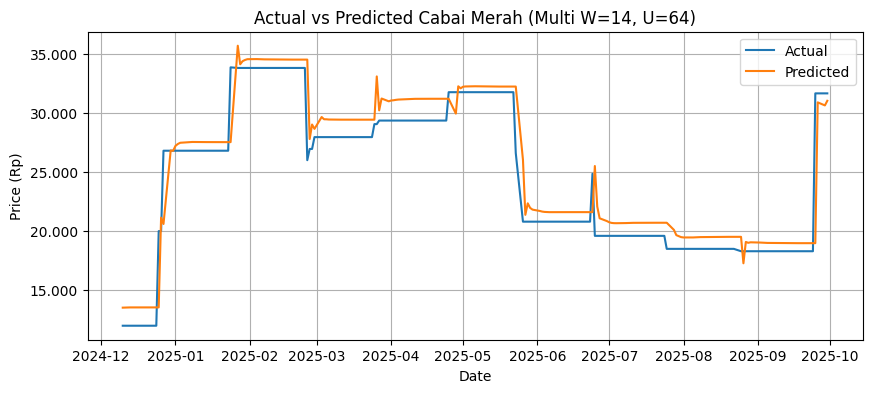

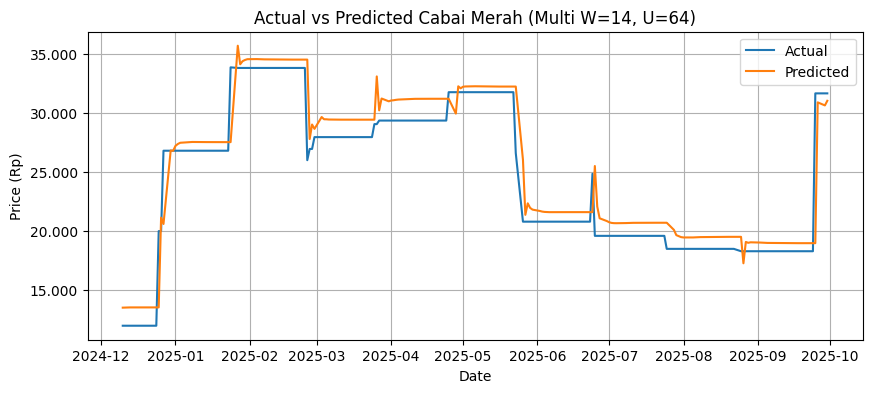


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,31650,31021.230469
1,2025-10-02,31650,30608.896484
2,2025-10-03,31650,30397.224609
3,2025-10-06,31650,30258.447266
4,2025-10-07,31650,30149.837891
5,2025-10-08,31650,30052.625000
6,2025-10-09,31650,29961.851562
7,2025-10-10,31650,29876.283203
8,2025-10-13,31650,29795.650391
9,2025-10-14,31650,29719.931641


Forecast MAPE Okt 2025 : 6.5092%
Compare CSV disimpan: compare_Okt2025_multi_W14_U64.csv


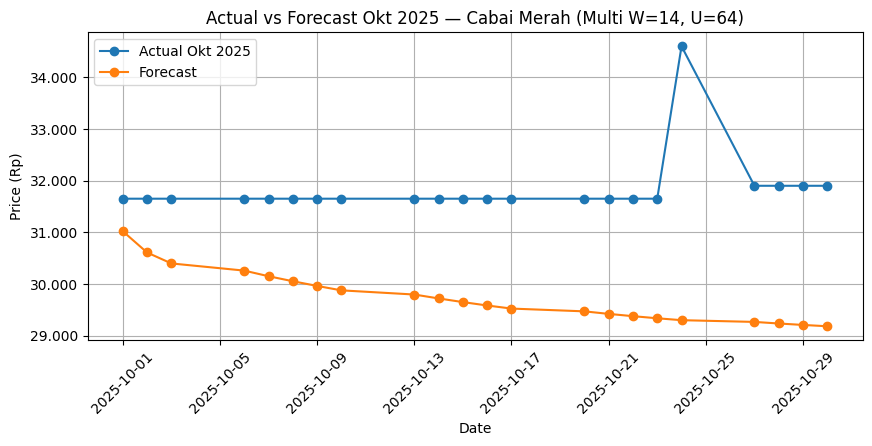

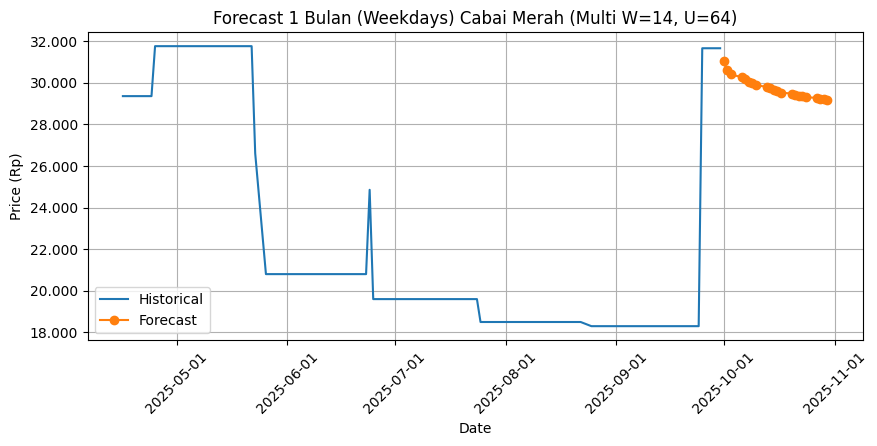

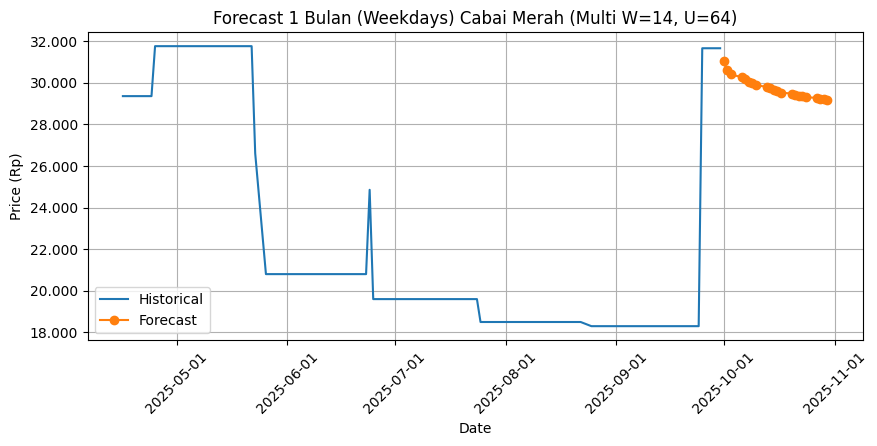


[MULTIVARIATE] Target=Cabai Merah | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - loss: 0.2599 - val_loss: 0.0411
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0348 - val_loss: 0.0299
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0252 - val_loss: 0.0237
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0197 - val_loss: 0.0219
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0170 - val_loss: 0.0160
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0158 - val_loss: 0.0152
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0134 - val_loss: 0.0150
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0108 - val_loss: 0.0146
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 0.0104 - val_loss: 0.0156
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0093 - val_loss: 0.0175
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0089 - val_loss: 0.0147
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0

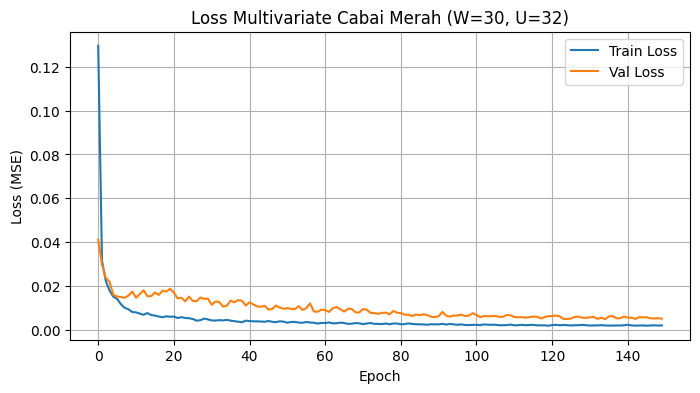

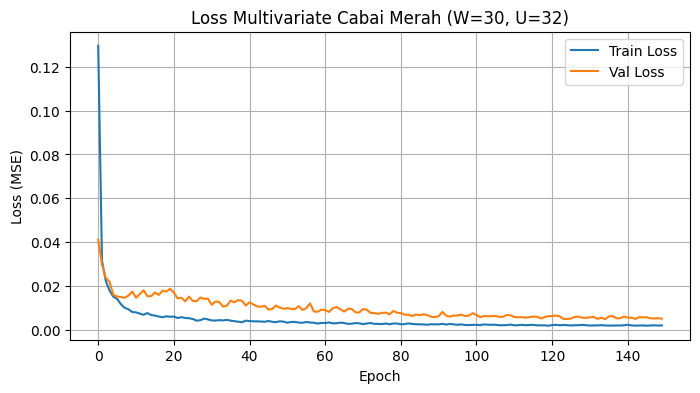

Test MAE  : 1,315.98
Test RMSE : 1,849.92
Test MAPE : 5.5122%


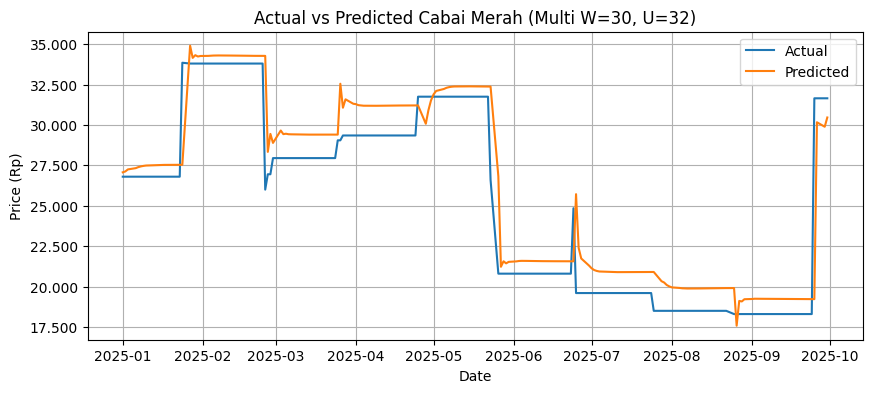

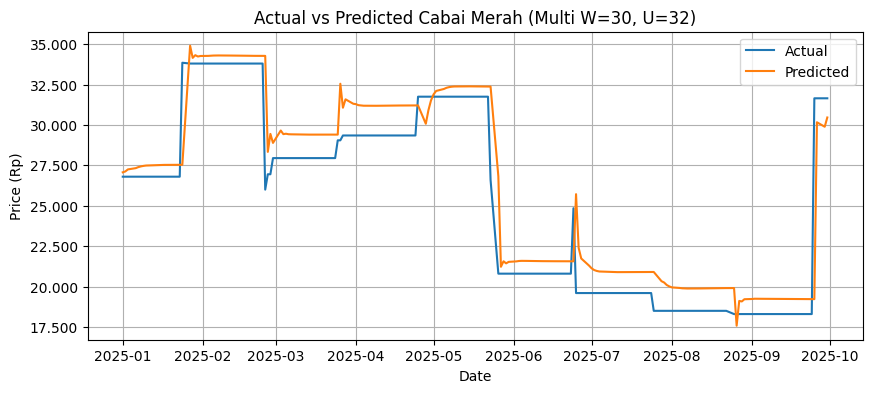


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,31650,30462.548828
1,2025-10-02,31650,29508.894531
2,2025-10-03,31650,28932.378906
3,2025-10-06,31650,28508.378906
4,2025-10-07,31650,28187.406250
5,2025-10-08,31650,27929.667969
6,2025-10-09,31650,27714.003906
7,2025-10-10,31650,27528.199219
8,2025-10-13,31650,27365.164062
9,2025-10-14,31650,27220.591797


Forecast MAPE Okt 2025 : 13.8386%
Compare CSV disimpan: compare_Okt2025_multi_W30_U32.csv


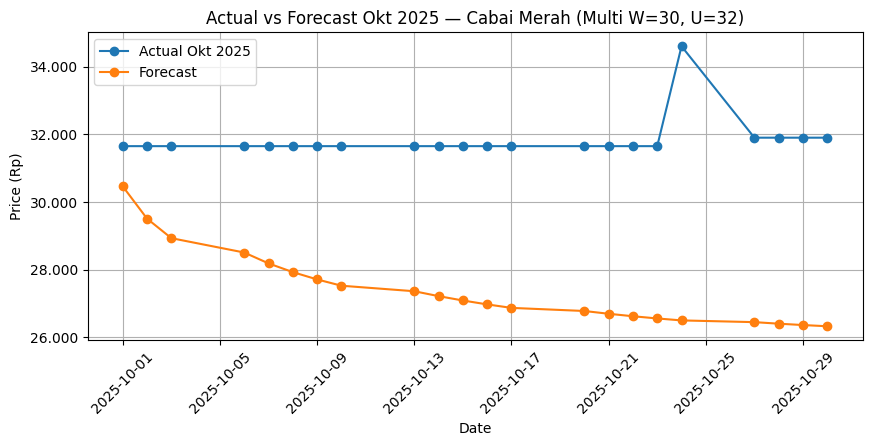

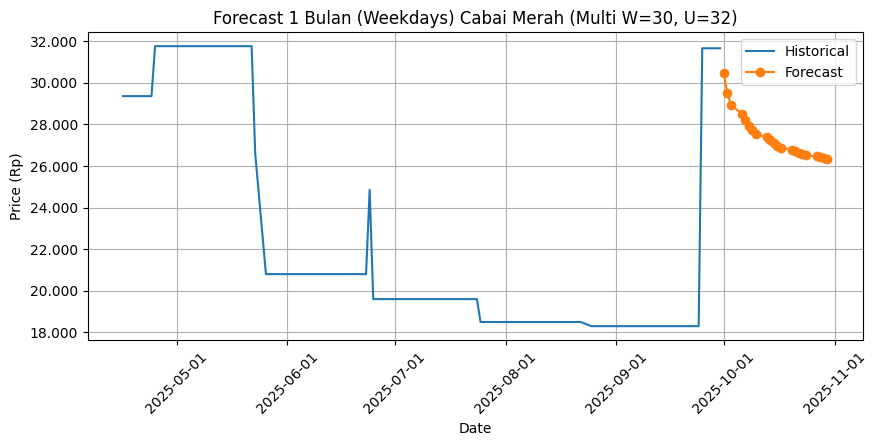

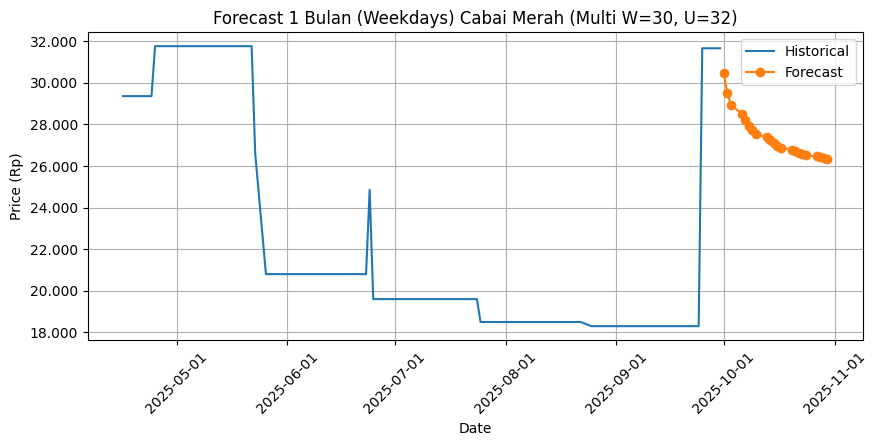


[MULTIVARIATE] Target=Cabai Merah | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - loss: 0.0284 - val_loss: 0.0251
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0123 - val_loss: 0.0195
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0090 - val_loss: 0.0168
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - loss: 0.0080 - val_loss: 0.0198
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0068 - val_loss: 0.0227
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0069 - val_loss: 0.0135
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0057 - val_loss: 0.0216
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0058 - val_loss: 0.0157
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0057 - val_loss: 0.0144
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0055 - val_loss: 0.0109
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0048 - val_loss: 0.0109
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0

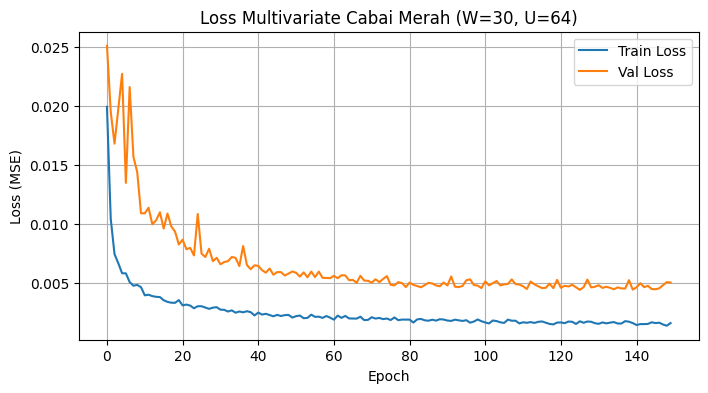

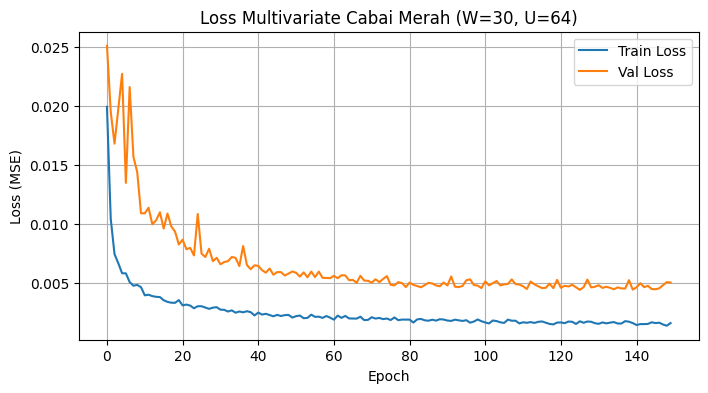

Test MAE  : 1,705.98
Test RMSE : 2,136.09
Test MAPE : 7.0226%


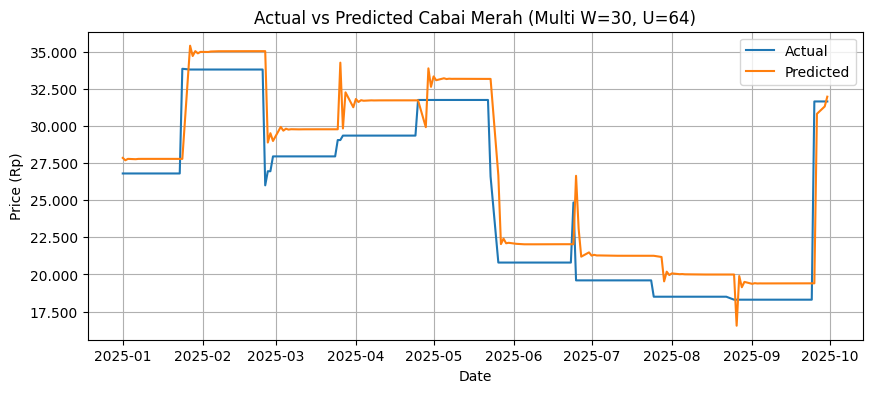

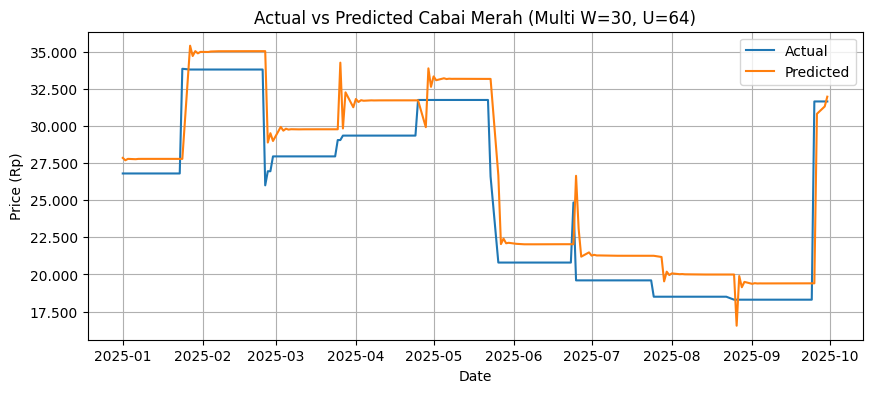


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,31650,31971.609375
1,2025-10-02,31650,32010.029297
2,2025-10-03,31650,32138.980469
3,2025-10-06,31650,32224.052734
4,2025-10-07,31650,32320.240234
5,2025-10-08,31650,32407.603516
6,2025-10-09,31650,32491.632812
7,2025-10-10,31650,32569.400391
8,2025-10-13,31650,32641.666016
9,2025-10-14,31650,32708.314453


Forecast MAPE Okt 2025 : 3.1909%
Compare CSV disimpan: compare_Okt2025_multi_W30_U64.csv


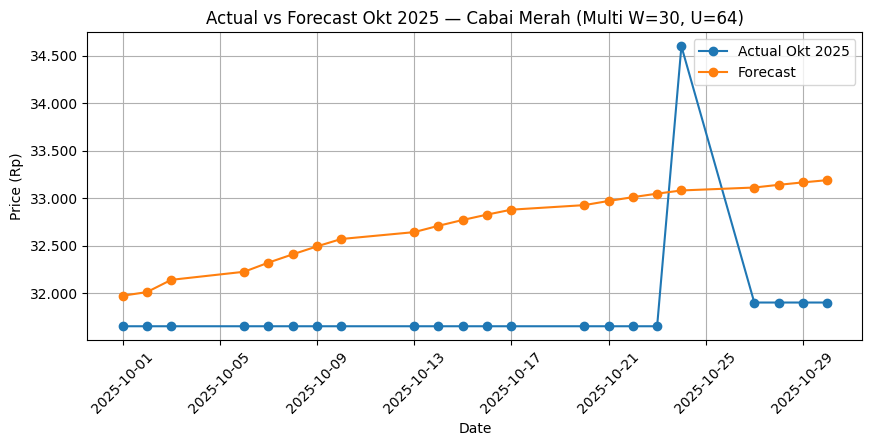

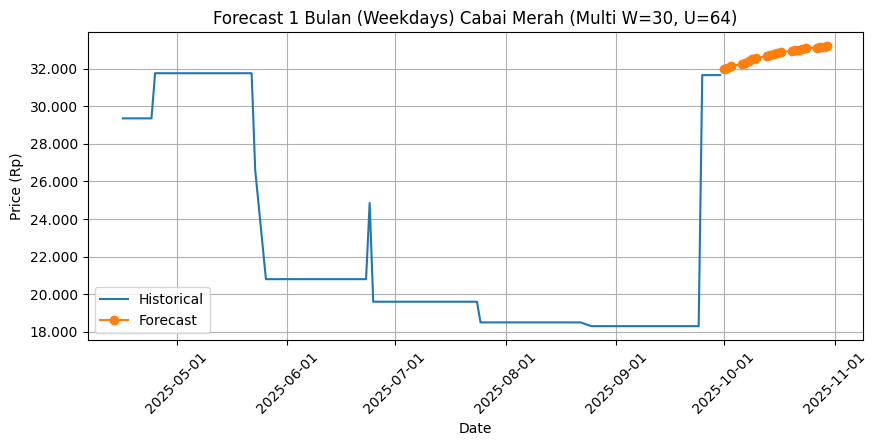

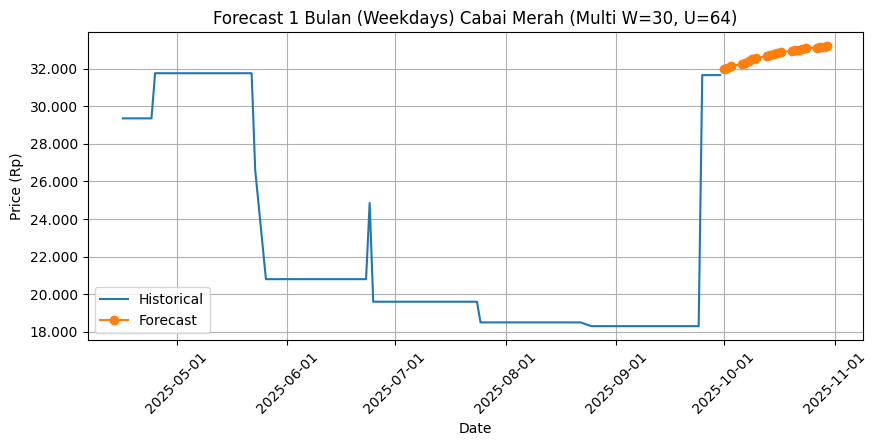


Rekap multivariate Cabai Merah disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate\Cabai_Merah\hasil_multivariate_Cabai_Merah.csv

==================== MULTIVARIATE: Cabai Rawit ====================

[MULTIVARIATE] Target=Cabai Rawit | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 0.0861 - val_loss: 0.0209
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0288 - val_loss: 0.0249
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0192 - val_loss: 0.0147
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0135 - val_loss: 0.0116
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0128 - val_loss: 0.0101
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0125 - val_loss: 0.0090
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0105 - val_loss: 0.0097
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0111 - val_loss: 0.0084
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0098 - val_loss: 0.0085
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0099 - val_loss: 0.0094
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0099 - val_loss: 0.0078
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0092 - val_l

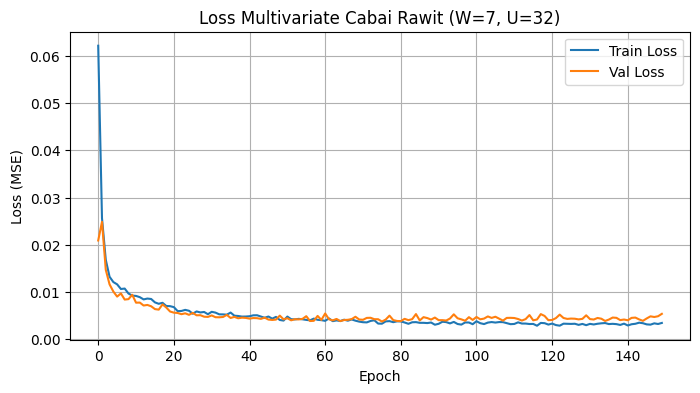

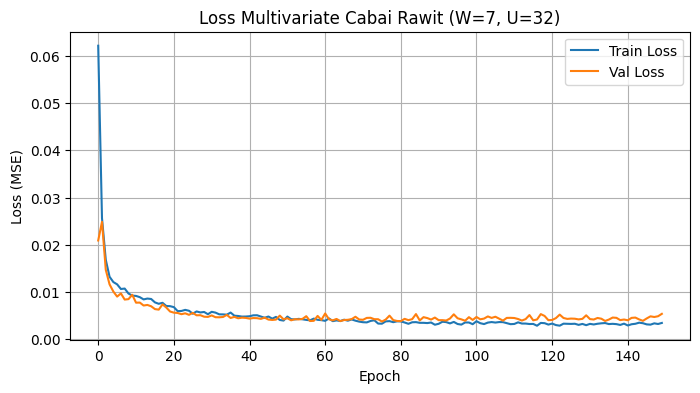

Test MAE  : 1,777.26
Test RMSE : 2,691.51
Test MAPE : 7.3582%


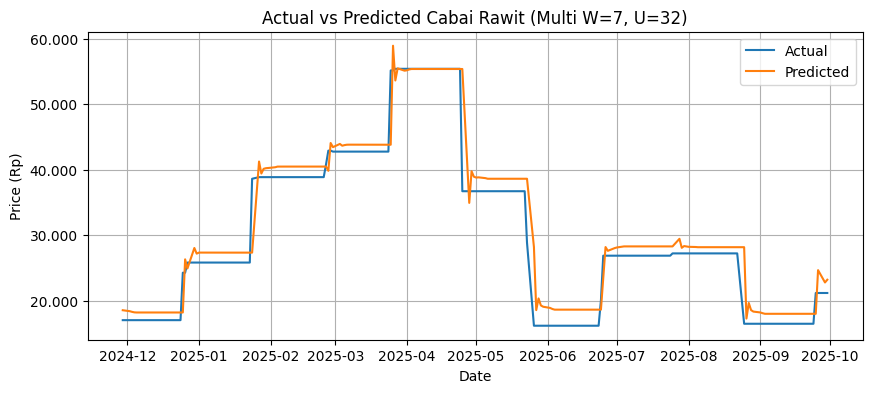

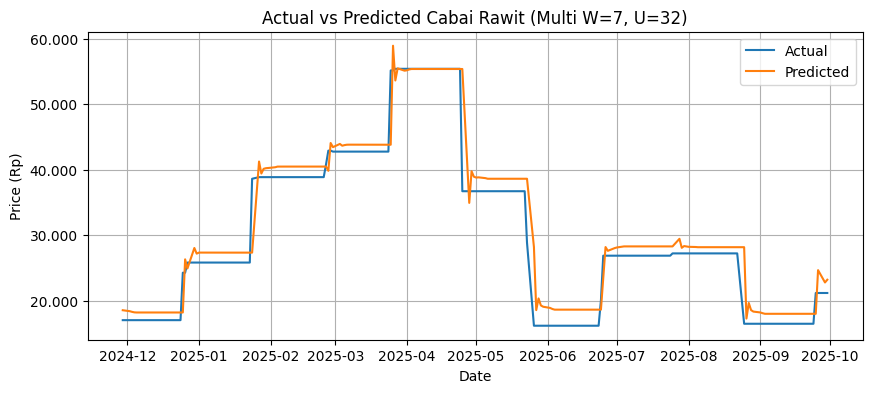


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,21150,23177.263672
1,2025-10-02,21150,25056.619141
2,2025-10-03,21150,26629.197266
3,2025-10-06,21150,28145.429688
4,2025-10-07,21150,29662.148438
5,2025-10-08,21150,31160.626953
6,2025-10-09,21150,32649.062500
7,2025-10-10,21150,34138.730469
8,2025-10-13,21150,35620.402344
9,2025-10-14,21150,37085.320312


Forecast MAPE Okt 2025 : 103.1066%
Compare CSV disimpan: compare_Okt2025_multi_W7_U32.csv


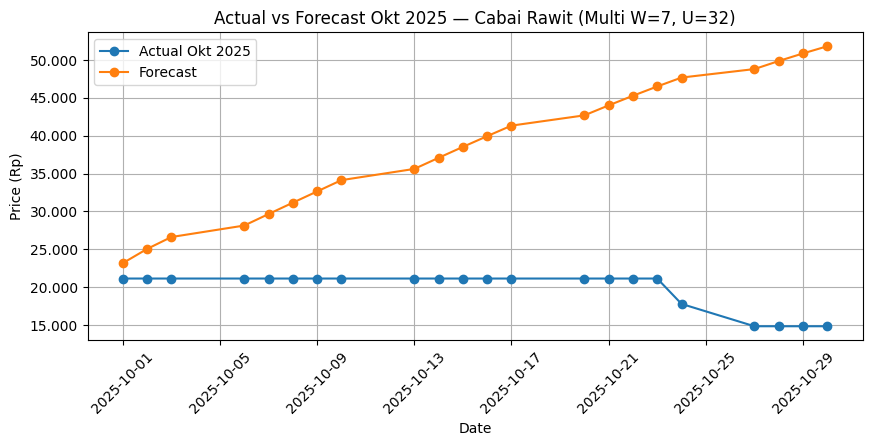

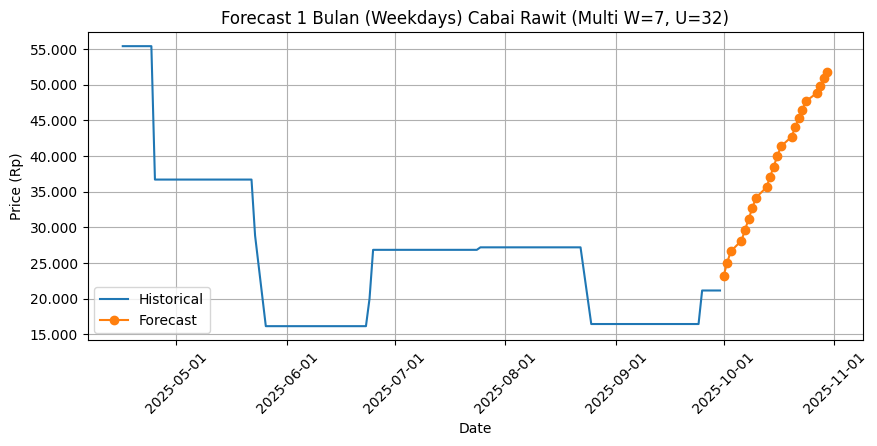

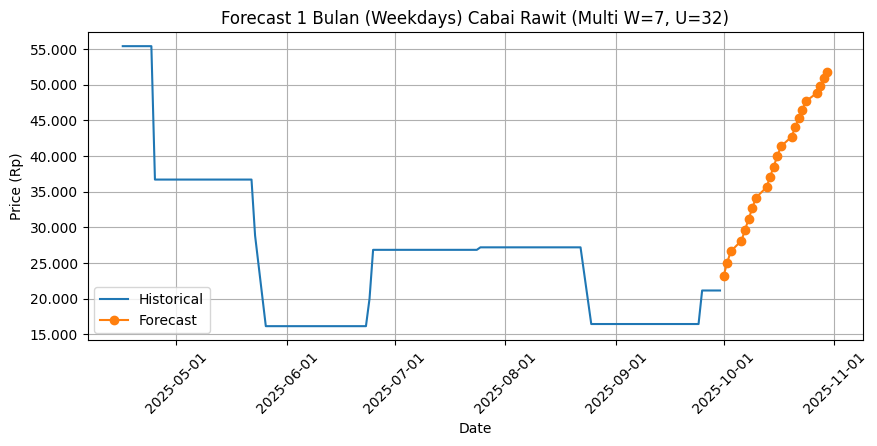


[MULTIVARIATE] Target=Cabai Rawit | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 0.0431 - val_loss: 0.0187
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0153 - val_loss: 0.0161
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0132 - val_loss: 0.0102
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0111 - val_loss: 0.0112
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0096 - val_loss: 0.0074
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0093 - val_loss: 0.0081
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0092 - val_loss: 0.0069
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0086 - val_loss: 0.0066
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0086 - val_loss: 0.0070
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0070 - val_loss: 0.0061
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0076 - val_loss: 0.0059
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0069 - val_l

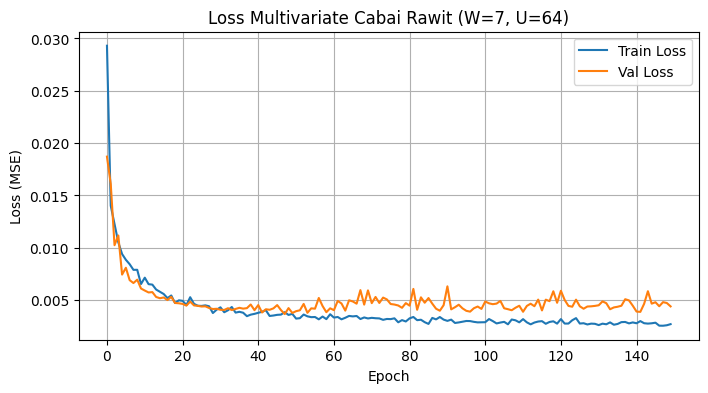

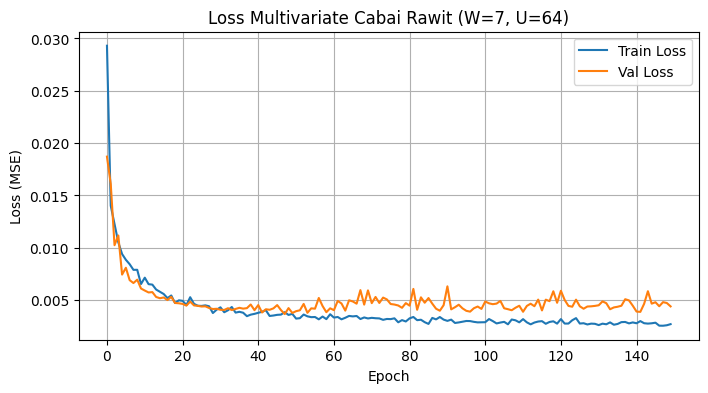

Test MAE  : 1,464.63
Test RMSE : 2,495.52
Test MAPE : 6.0760%


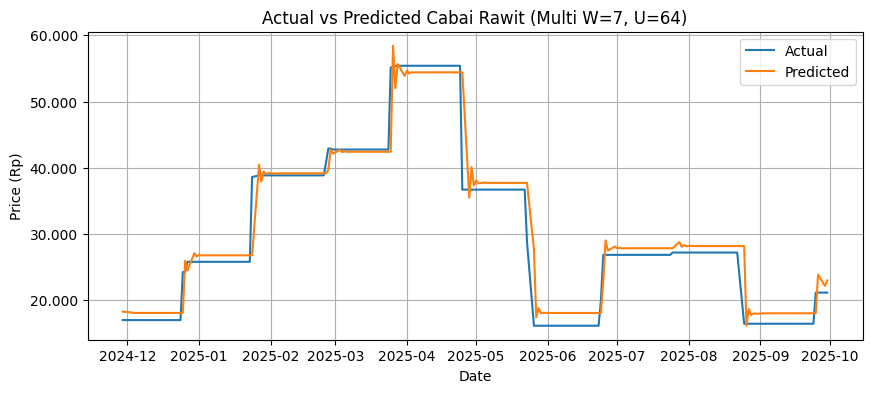

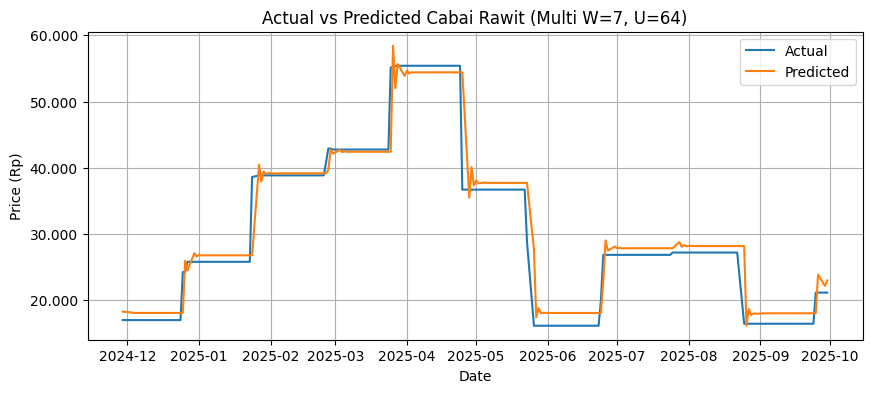


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,21150,22985.083984
1,2025-10-02,21150,24614.884766
2,2025-10-03,21150,26029.720703
3,2025-10-06,21150,27345.242188
4,2025-10-07,21150,28573.626953
5,2025-10-08,21150,29722.443359
6,2025-10-09,21150,30793.003906
7,2025-10-10,21150,31790.785156
8,2025-10-13,21150,32720.480469
9,2025-10-14,21150,33585.757812


Forecast MAPE Okt 2025 : 75.0713%
Compare CSV disimpan: compare_Okt2025_multi_W7_U64.csv


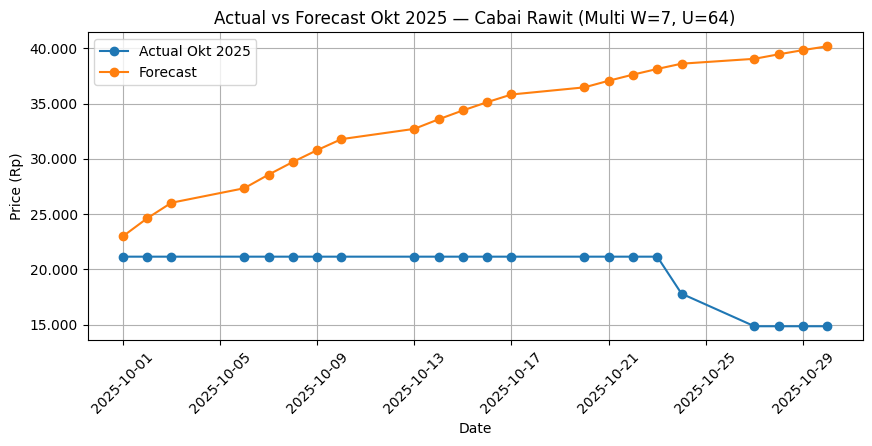

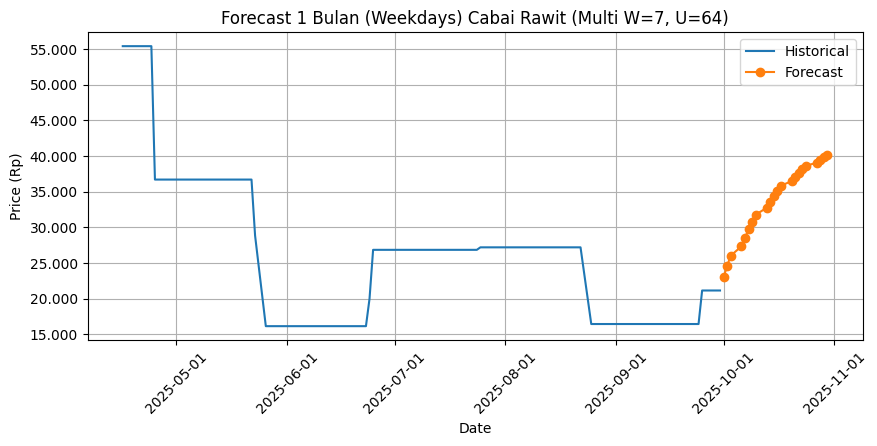

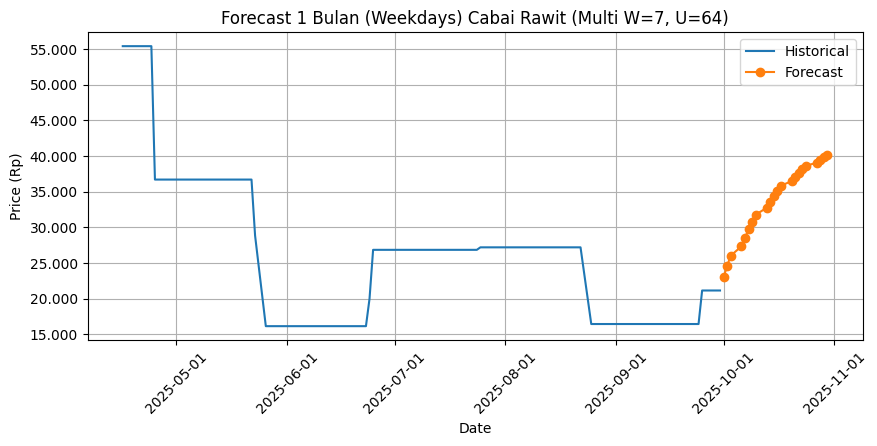


[MULTIVARIATE] Target=Cabai Rawit | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - loss: 0.0957 - val_loss: 0.0174
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0323 - val_loss: 0.0157
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0189 - val_loss: 0.0124
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0157 - val_loss: 0.0100
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0121 - val_loss: 0.0097
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0122 - val_loss: 0.0086
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0104 - val_loss: 0.0094
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0098 - val_loss: 0.0078
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0100 - val_loss: 0.0069
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0095 - val_loss: 0.0061
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0080 - val_loss: 0.0078
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0077 - 

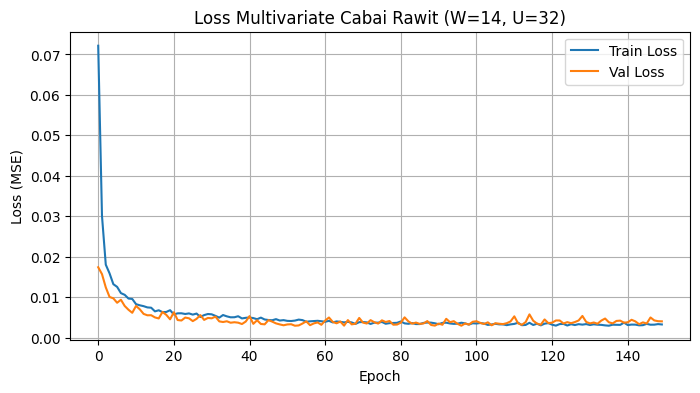

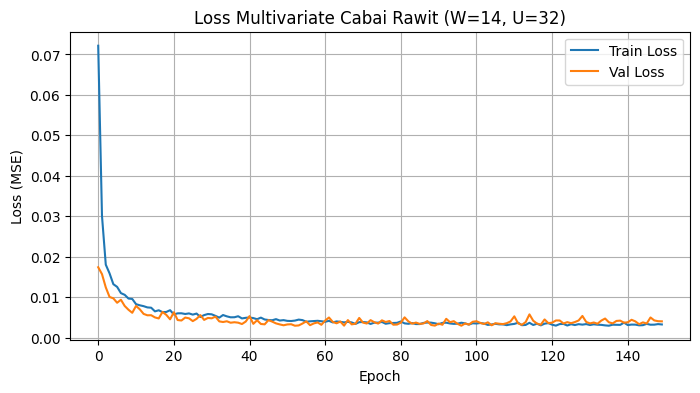

Test MAE  : 1,926.97
Test RMSE : 2,853.15
Test MAPE : 8.3226%


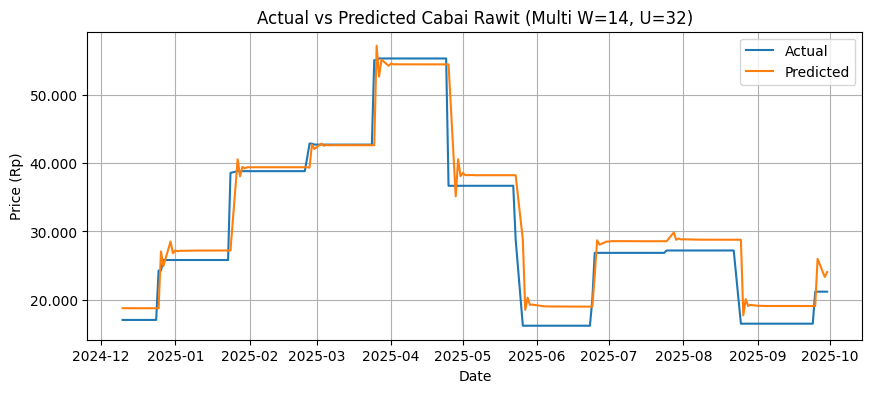

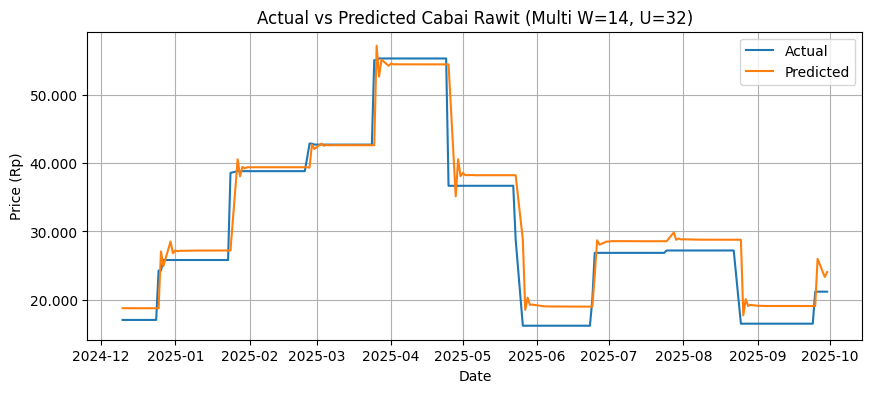


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,21150,24023.697266
1,2025-10-02,21150,26619.974609
2,2025-10-03,21150,28709.421875
3,2025-10-06,21150,30567.966797
4,2025-10-07,21150,32258.390625
5,2025-10-08,21150,33810.292969
6,2025-10-09,21150,35237.808594
7,2025-10-10,21150,36549.738281
8,2025-10-13,21150,37754.101562
9,2025-10-14,21150,38858.675781


Forecast MAPE Okt 2025 : 101.1942%
Compare CSV disimpan: compare_Okt2025_multi_W14_U32.csv


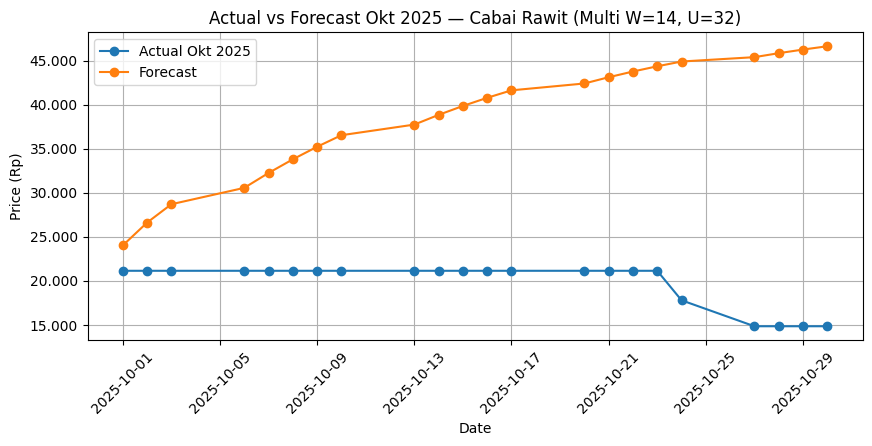

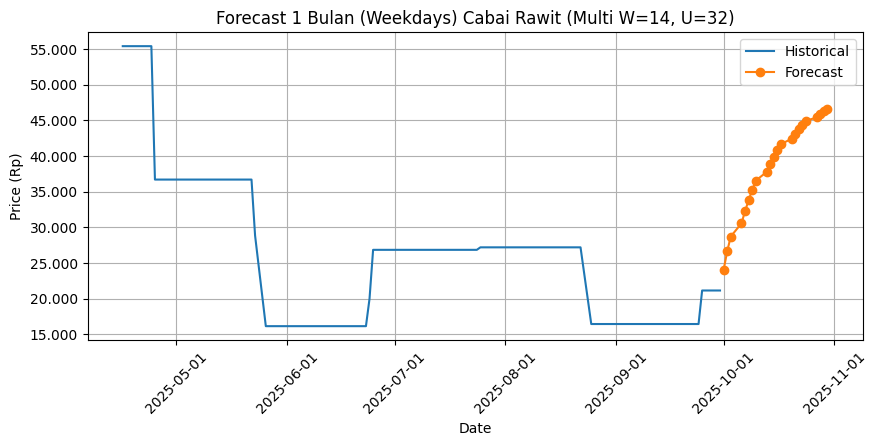

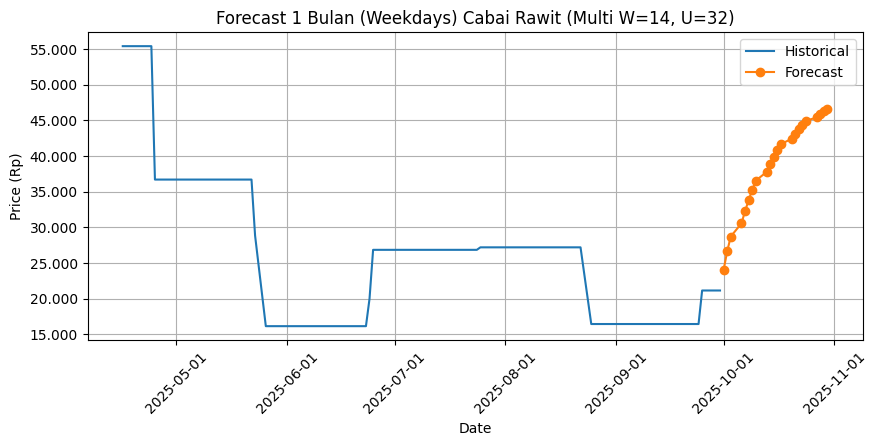


[MULTIVARIATE] Target=Cabai Rawit | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 0.0739 - val_loss: 0.0106
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0180 - val_loss: 0.0126
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0128 - val_loss: 0.0159
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0117 - val_loss: 0.0185
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0112 - val_loss: 0.0115
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0091 - val_loss: 0.0066
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0088 - val_loss: 0.0072
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0076 - val_loss: 0.0096
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0072 - val_loss: 0.0084
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0065 - val_loss: 0.0056
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0063 - val_loss: 0.0060
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.00

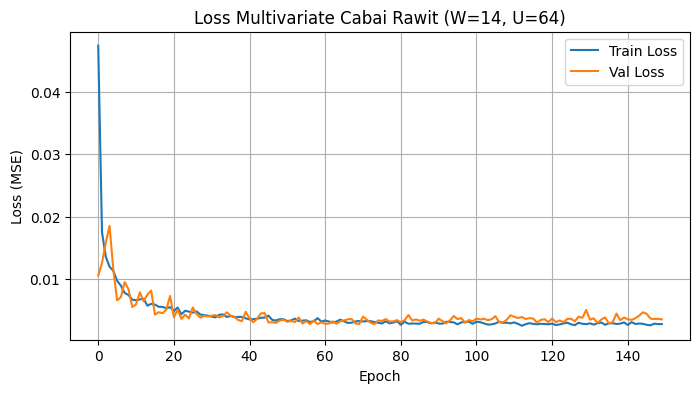

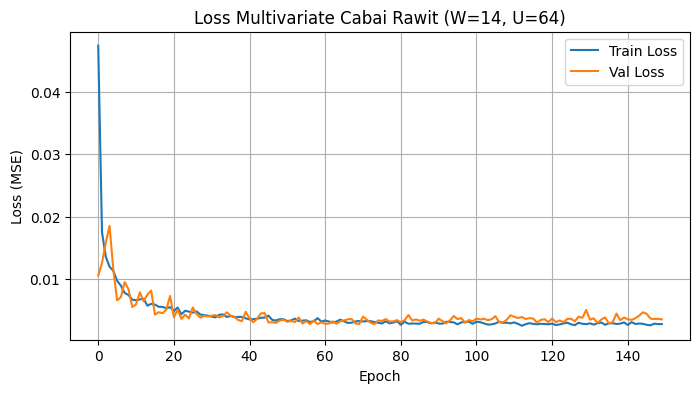

Test MAE  : 1,484.14
Test RMSE : 2,524.57
Test MAPE : 5.9316%


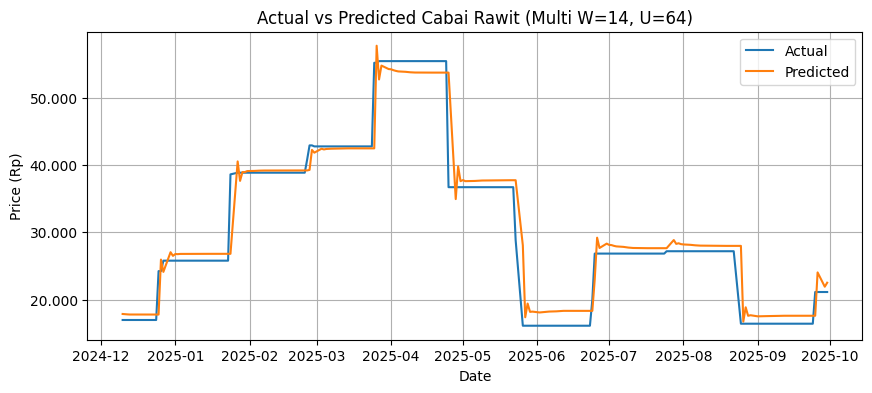

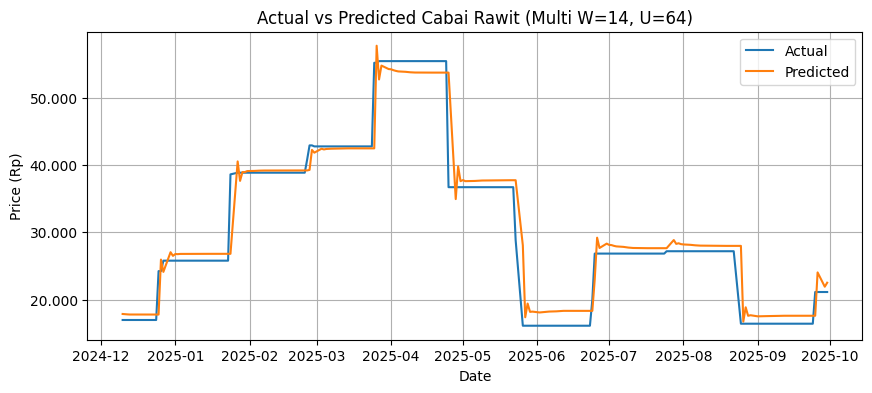


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,21150,22529.189453
1,2025-10-02,21150,23683.103516
2,2025-10-03,21150,24609.689453
3,2025-10-06,21150,25437.902344
4,2025-10-07,21150,26210.156250
5,2025-10-08,21150,26937.601562
6,2025-10-09,21150,27623.101562
7,2025-10-10,21150,28268.396484
8,2025-10-13,21150,28875.148438
9,2025-10-14,21150,29445.001953


Forecast MAPE Okt 2025 : 53.3523%
Compare CSV disimpan: compare_Okt2025_multi_W14_U64.csv


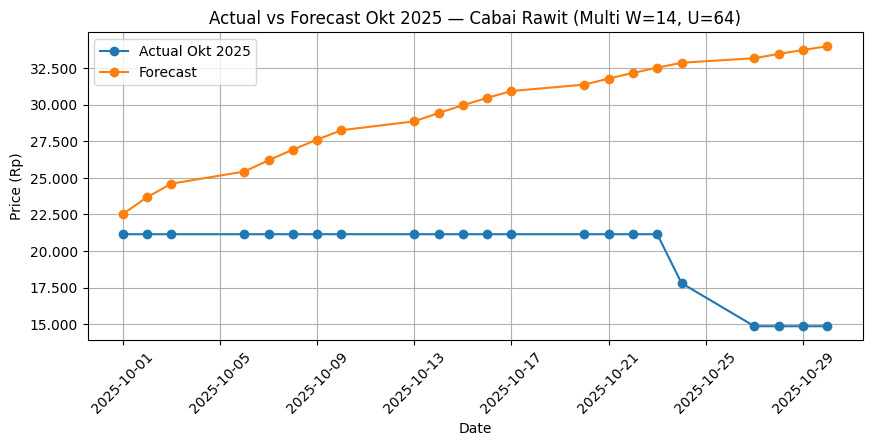

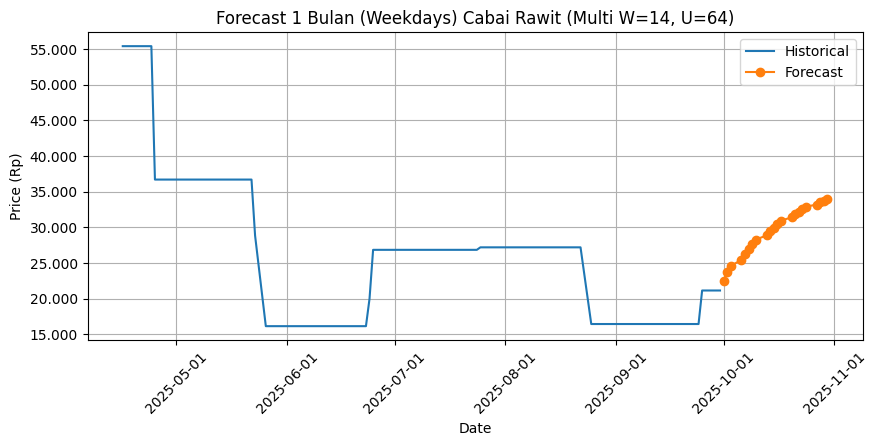

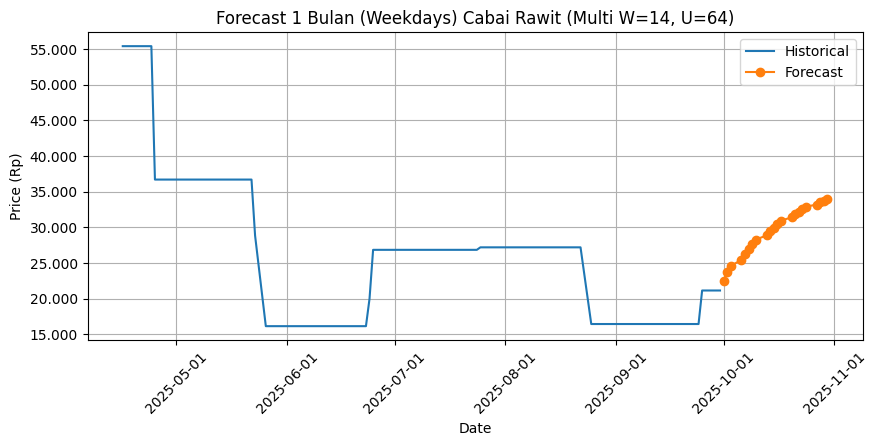


[MULTIVARIATE] Target=Cabai Rawit | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - loss: 0.1096 - val_loss: 0.0207
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0332 - val_loss: 0.0421
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0231 - val_loss: 0.0326
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0202 - val_loss: 0.0257
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0158 - val_loss: 0.0237
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0136 - val_loss: 0.0244
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0121 - val_loss: 0.0184
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0112 - val_loss: 0.0126
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0116 - val_loss: 0.0212
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0108 - val_loss: 0.0115
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0106 - val_loss: 0.0164
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0

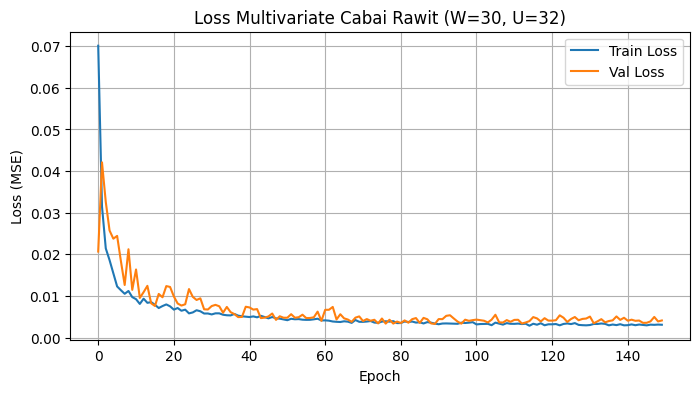

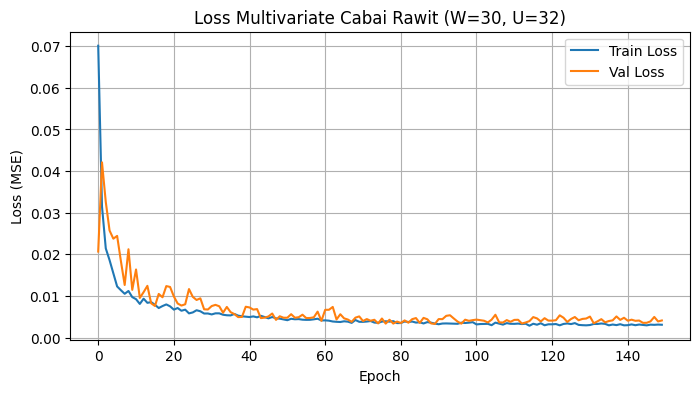

Test MAE  : 1,231.78
Test RMSE : 2,533.39
Test MAPE : 4.9036%


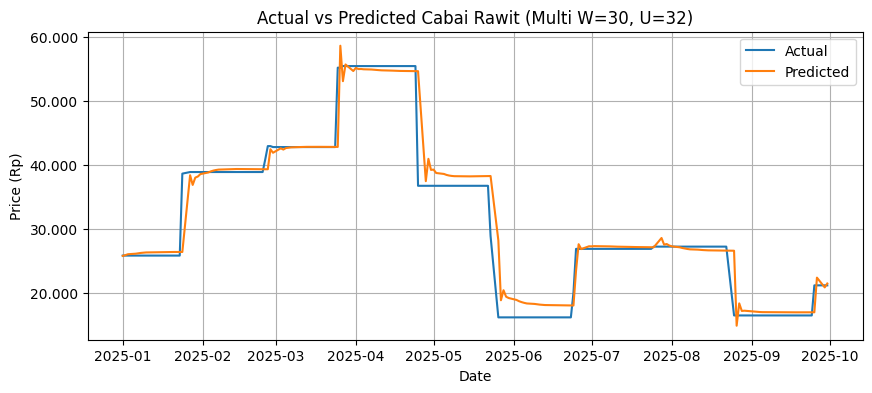

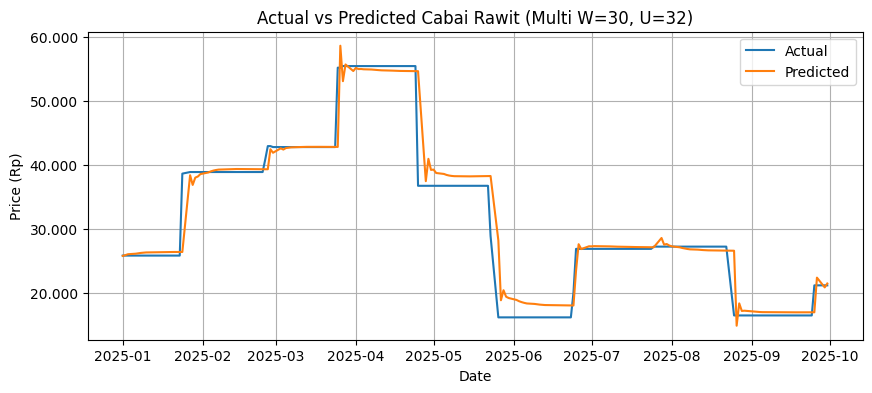


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,21150,21439.855469
1,2025-10-02,21150,21676.892578
2,2025-10-03,21150,21960.851562
3,2025-10-06,21150,22266.083984
4,2025-10-07,21150,22568.720703
5,2025-10-08,21150,22865.269531
6,2025-10-09,21150,23154.244141
7,2025-10-10,21150,23435.255859
8,2025-10-13,21150,23708.658203
9,2025-10-14,21150,23975.048828


Forecast MAPE Okt 2025 : 25.3843%
Compare CSV disimpan: compare_Okt2025_multi_W30_U32.csv


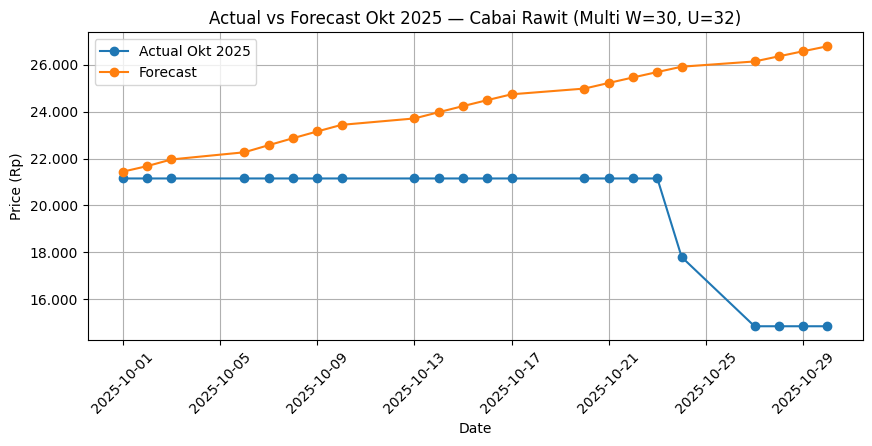

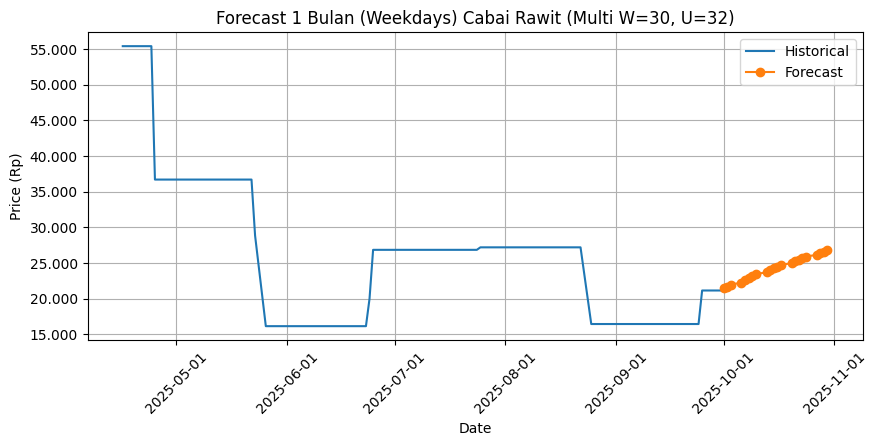

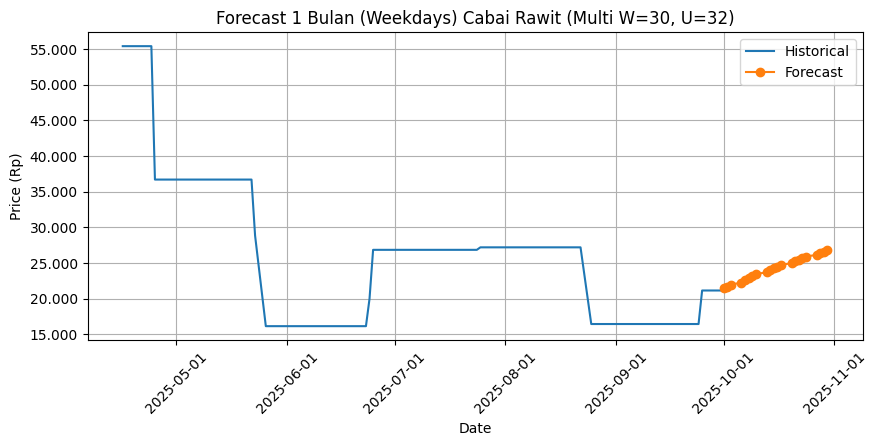


[MULTIVARIATE] Target=Cabai Rawit | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step - loss: 0.0608 - val_loss: 0.0298
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0202 - val_loss: 0.0376
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0139 - val_loss: 0.0277
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0122 - val_loss: 0.0198
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0105 - val_loss: 0.0153
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0104 - val_loss: 0.0131
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0095 - val_loss: 0.0096
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0089 - val_loss: 0.0158
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0080 - val_loss: 0.0125
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0078 - val_loss: 0.0108
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0080 - val_loss: 0.0114
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0

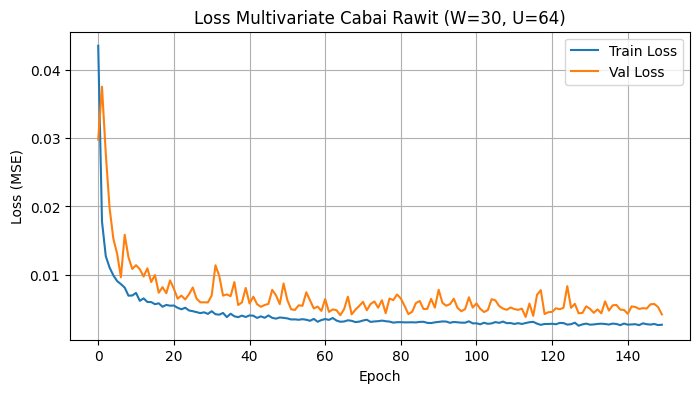

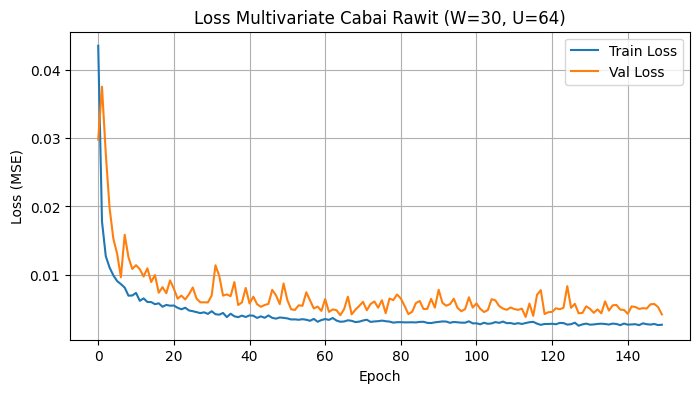

Test MAE  : 1,439.20
Test RMSE : 2,600.90
Test MAPE : 5.8147%


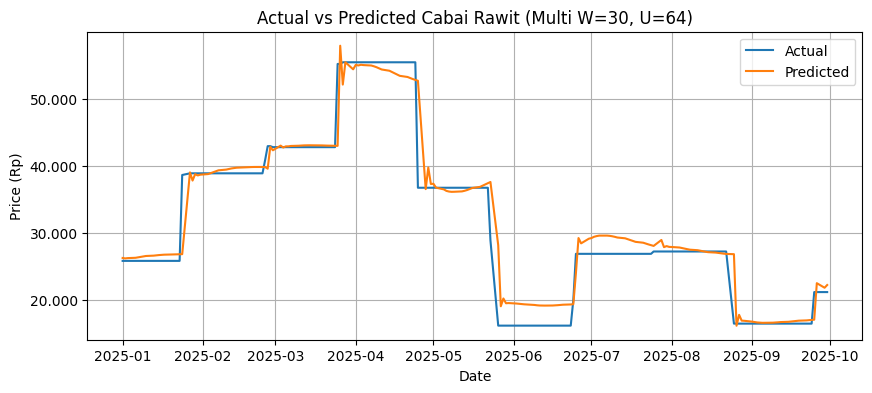

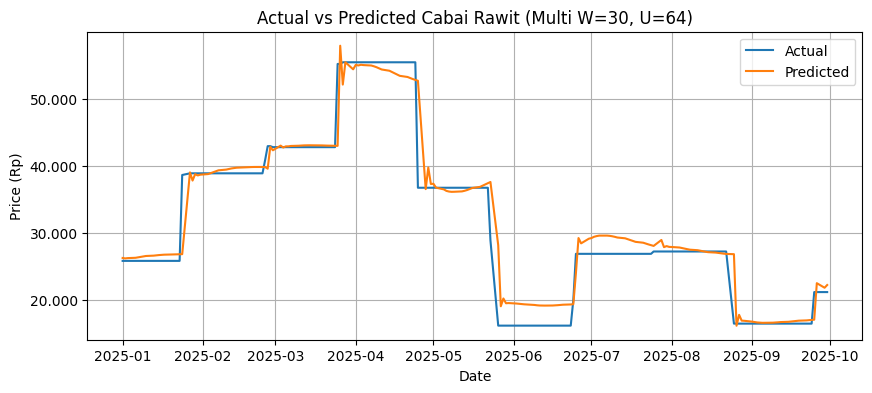


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,21150,22203.984375
1,2025-10-02,21150,22964.498047
2,2025-10-03,21150,23515.789062
3,2025-10-06,21150,23991.886719
4,2025-10-07,21150,24426.277344
5,2025-10-08,21150,24818.339844
6,2025-10-09,21150,25184.628906
7,2025-10-10,21150,25536.251953
8,2025-10-13,21150,25877.751953
9,2025-10-14,21150,26211.056641


Forecast MAPE Okt 2025 : 36.7880%
Compare CSV disimpan: compare_Okt2025_multi_W30_U64.csv


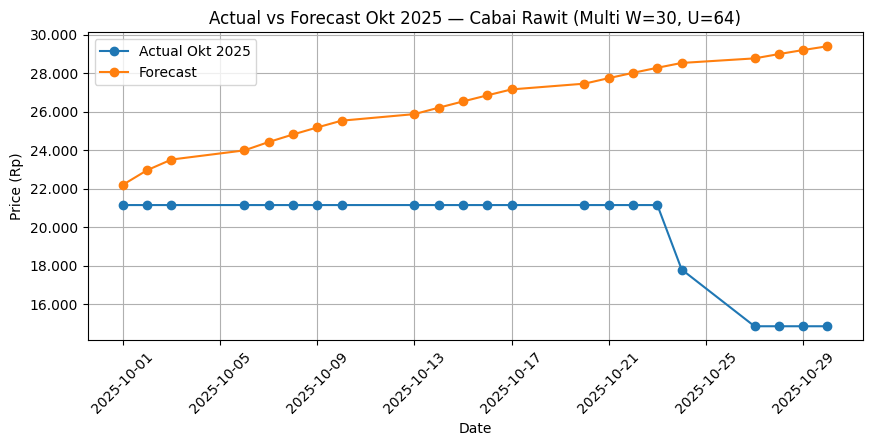

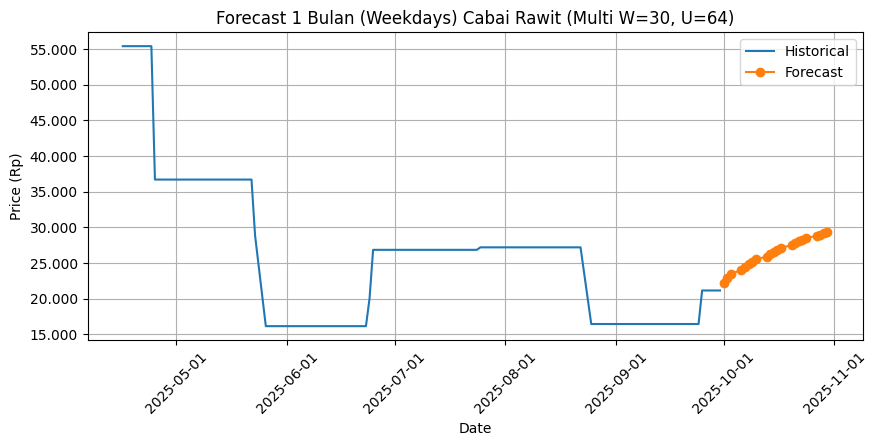

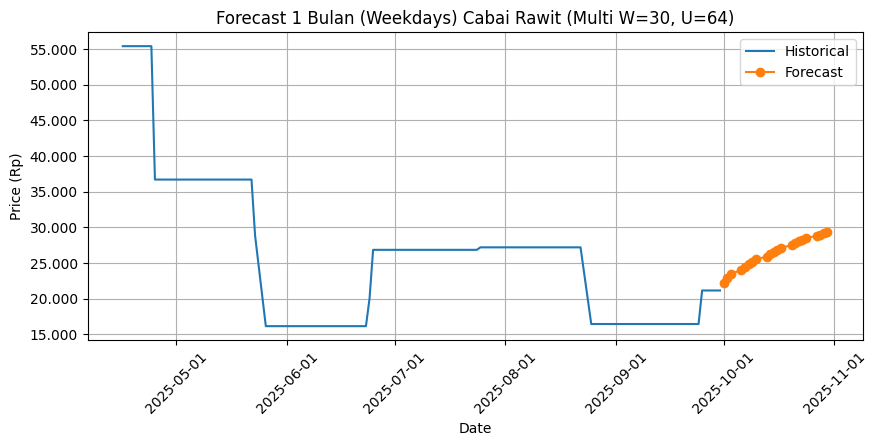


Rekap multivariate Cabai Rawit disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate\Cabai_Rawit\hasil_multivariate_Cabai_Rawit.csv

==================== MULTIVARIATE: Minyak Goreng ====================

[MULTIVARIATE] Target=Minyak Goreng | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - loss: 0.1548 - val_loss: 0.0249
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0278 - val_loss: 0.0285
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0170 - val_loss: 0.0226
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0134 - val_loss: 0.0091
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0118 - val_loss: 0.0059
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0093 - val_loss: 0.0013
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0083 - val_loss: 5.0438e-04
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0072 - val_loss: 9.5984e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0066 - val_loss: 3.5957e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0076 - val_loss: 0.0018
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0063 - val_loss: 9.3523e-04
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss

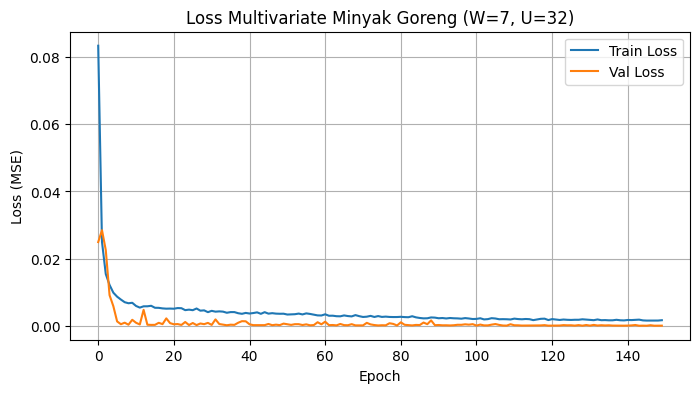

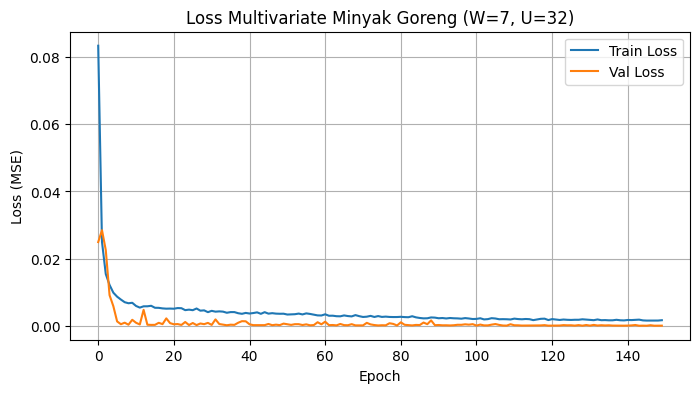

Test MAE  : 50.31
Test RMSE : 80.00
Test MAPE : 0.3719%


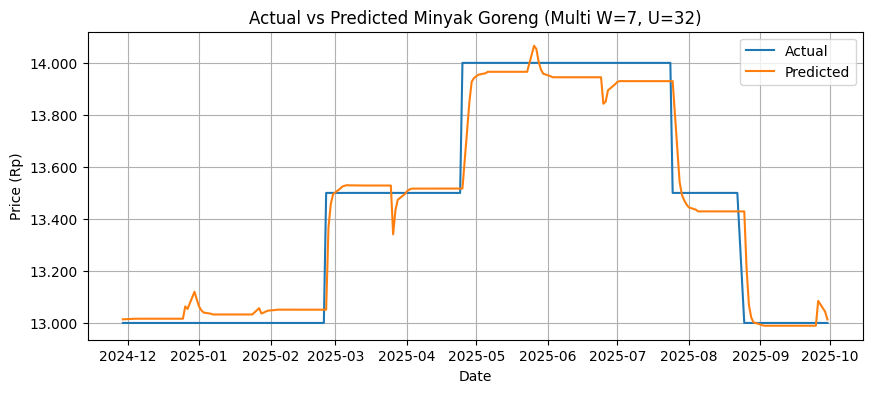

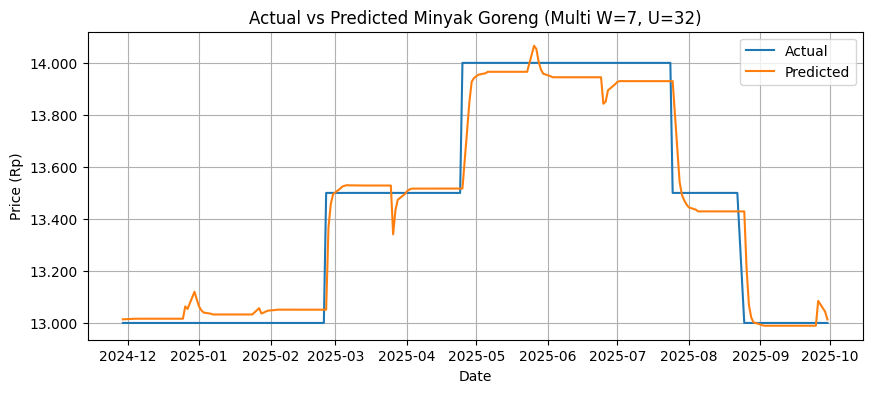


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13000,13013.406250
1,2025-10-02,13000,13009.016602
2,2025-10-03,13000,13004.263672
3,2025-10-06,13000,12999.141602
4,2025-10-07,13000,12993.499023
5,2025-10-08,13000,12988.827148
6,2025-10-09,13000,12984.488281
7,2025-10-10,13000,12980.427734
8,2025-10-13,13000,12976.529297
9,2025-10-14,13000,12972.818359


Forecast MAPE Okt 2025 : 0.2407%
Compare CSV disimpan: compare_Okt2025_multi_W7_U32.csv


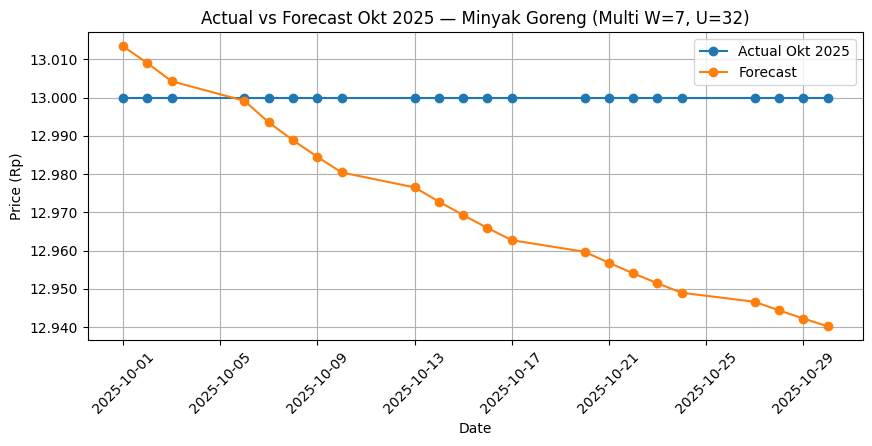

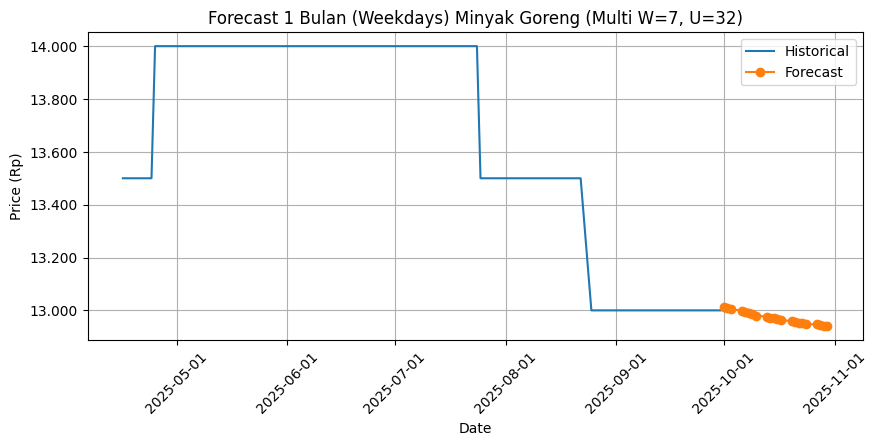

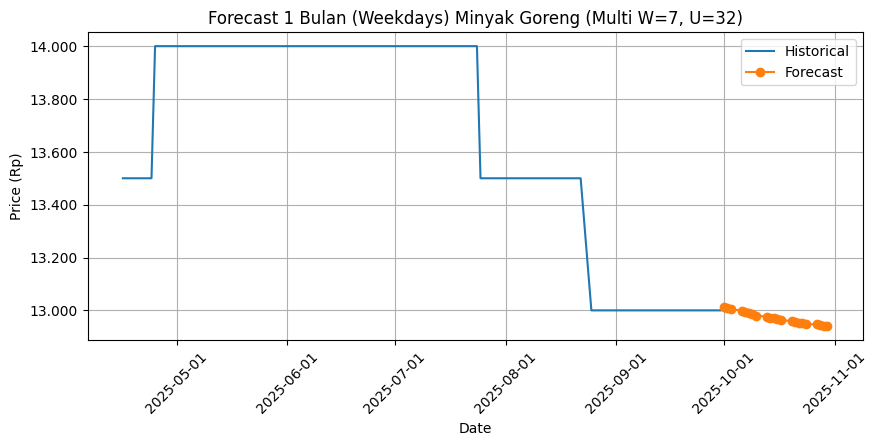


[MULTIVARIATE] Target=Minyak Goreng | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.1120 - val_loss: 0.0032
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0205 - val_loss: 0.0194
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0110 - val_loss: 0.0121
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0105 - val_loss: 0.0012
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0083 - val_loss: 0.0044
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0070 - val_loss: 0.0041
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0062 - val_loss: 0.0097
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0062 - val_loss: 7.5919e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0067 - val_loss: 2.9870e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0055 - val_loss: 0.0013
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0049 - val_loss: 4.8579e-04
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss:

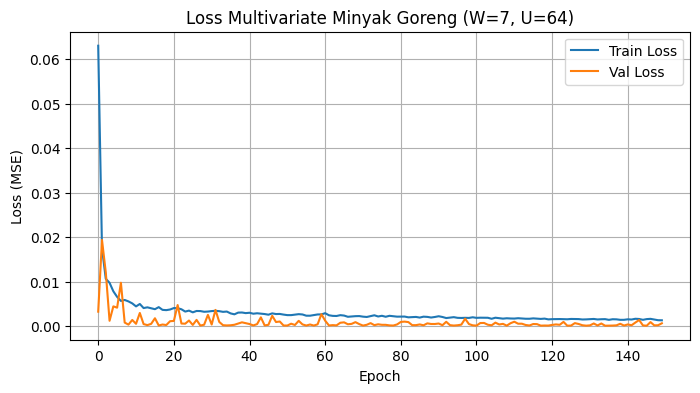

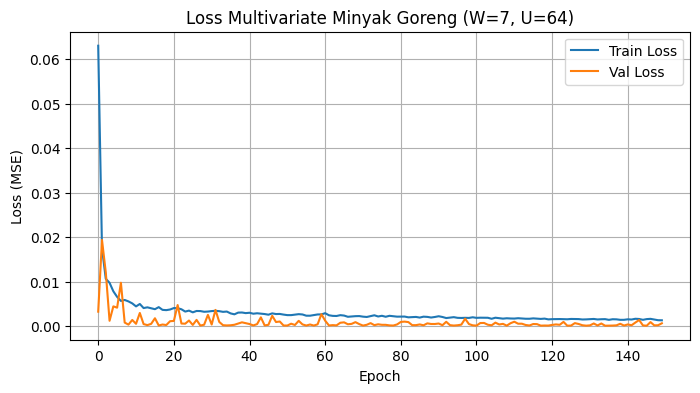

Test MAE  : 116.89
Test RMSE : 133.68
Test MAPE : 0.8756%


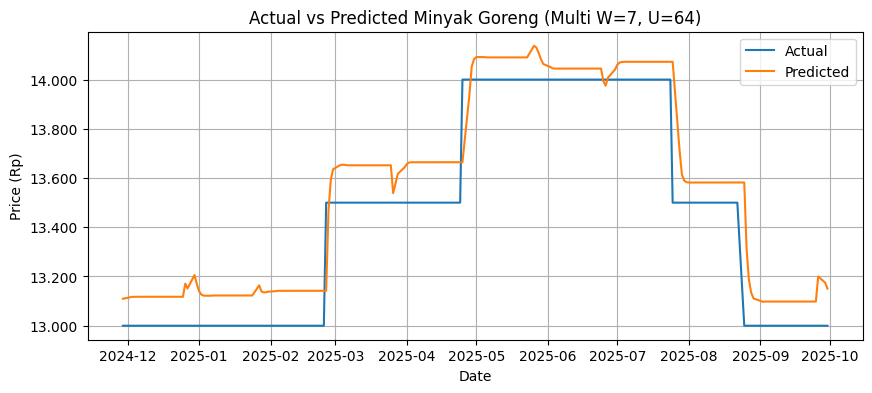

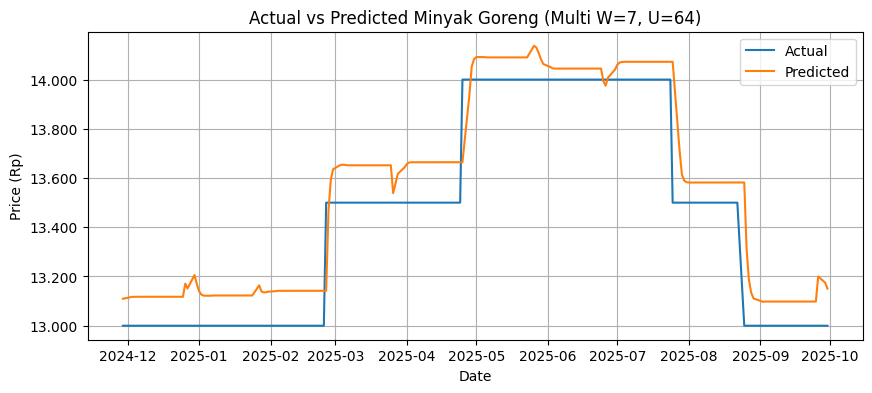


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13000,13150.609375
1,2025-10-02,13000,13228.363281
2,2025-10-03,13000,13304.967773
3,2025-10-06,13000,13378.326172
4,2025-10-07,13000,13448.164062
5,2025-10-08,13000,13515.351562
6,2025-10-09,13000,13579.168945
7,2025-10-10,13000,13639.432617
8,2025-10-13,13000,13696.770508
9,2025-10-14,13000,13751.176758


Forecast MAPE Okt 2025 : 5.9602%
Compare CSV disimpan: compare_Okt2025_multi_W7_U64.csv


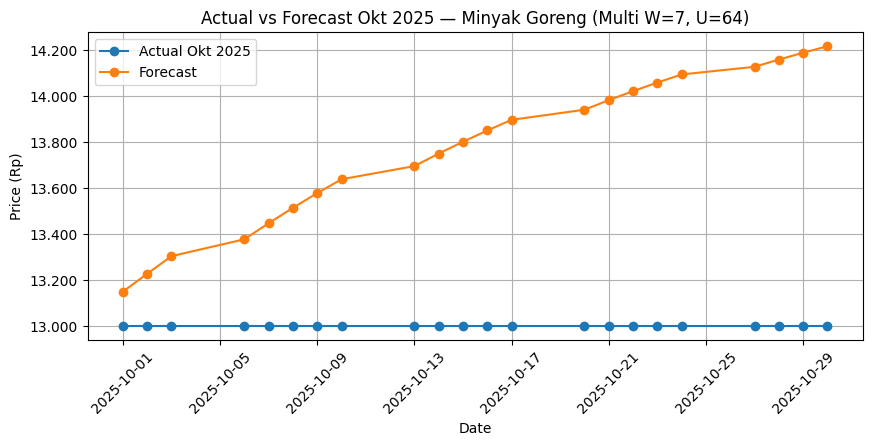

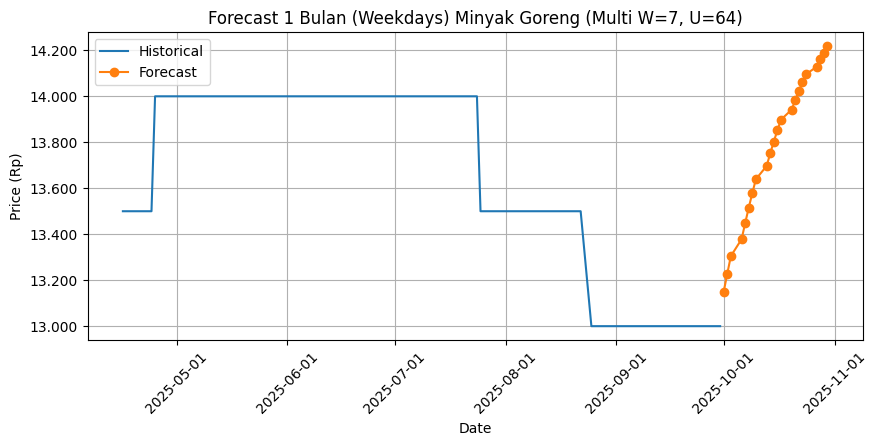

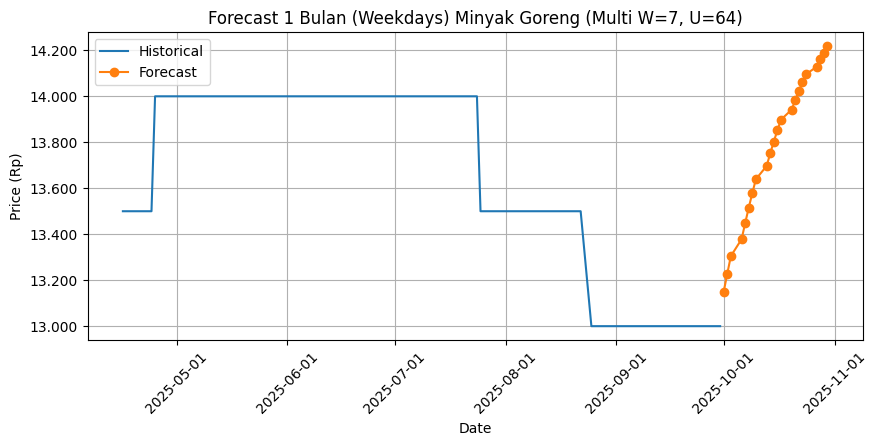


[MULTIVARIATE] Target=Minyak Goreng | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - loss: 0.1484 - val_loss: 0.0566
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0258 - val_loss: 0.0094
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0131 - val_loss: 0.0055
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0109 - val_loss: 0.0020
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0099 - val_loss: 9.2673e-04
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0080 - val_loss: 6.2046e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0080 - val_loss: 4.7555e-04
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0075 - val_loss: 4.7509e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0068 - val_loss: 5.4543e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0064 - val_loss: 0.0019
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0062 - val_loss: 0.0015
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - 

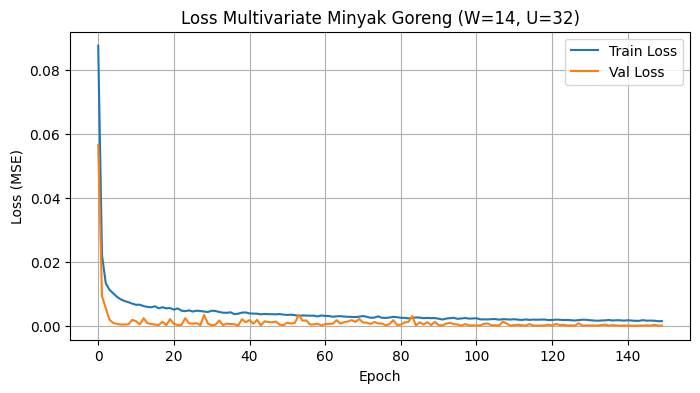

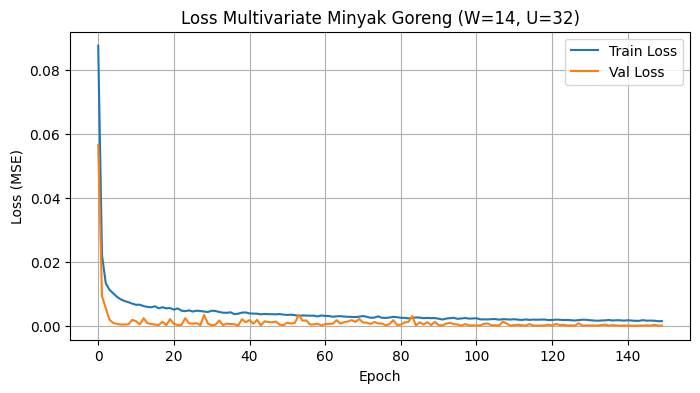

Test MAE  : 81.59
Test RMSE : 120.17
Test MAPE : 0.5940%


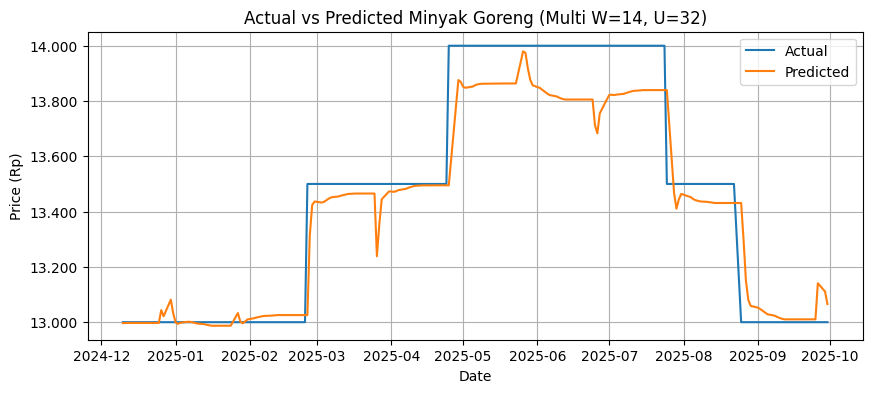

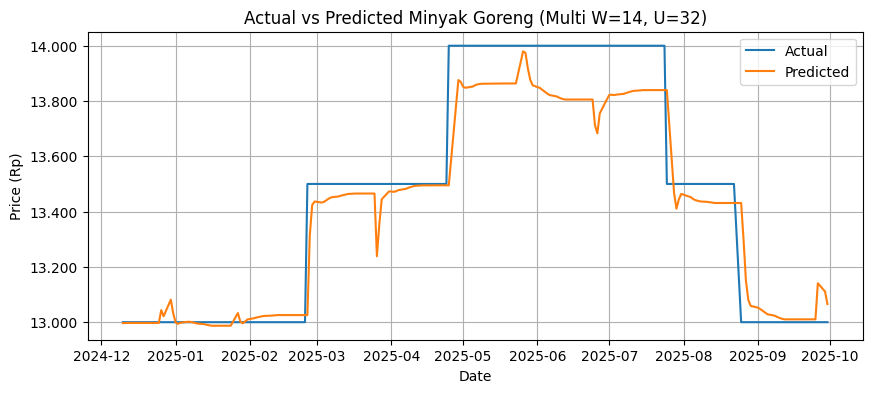


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13000,13065.668945
1,2025-10-02,13000,13085.265625
2,2025-10-03,13000,13112.064453
3,2025-10-06,13000,13137.073242
4,2025-10-07,13000,13158.706055
5,2025-10-08,13000,13176.966797
6,2025-10-09,13000,13192.381836
7,2025-10-10,13000,13205.544922
8,2025-10-13,13000,13216.955078
9,2025-10-14,13000,13226.992188


Forecast MAPE Okt 2025 : 1.6839%
Compare CSV disimpan: compare_Okt2025_multi_W14_U32.csv


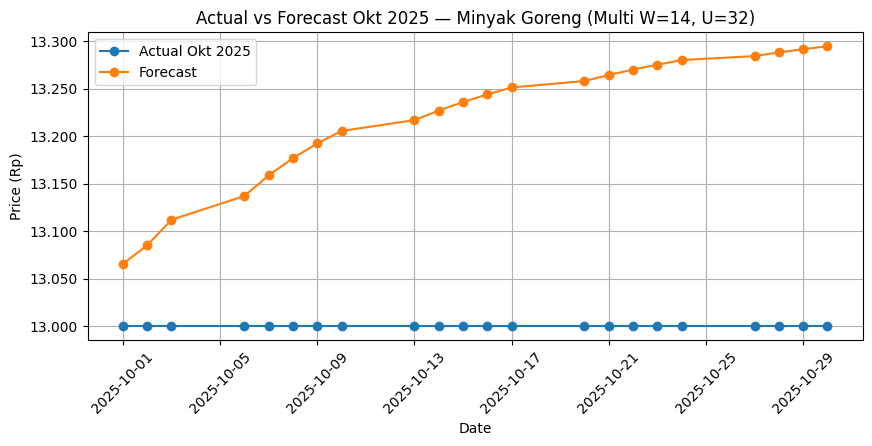

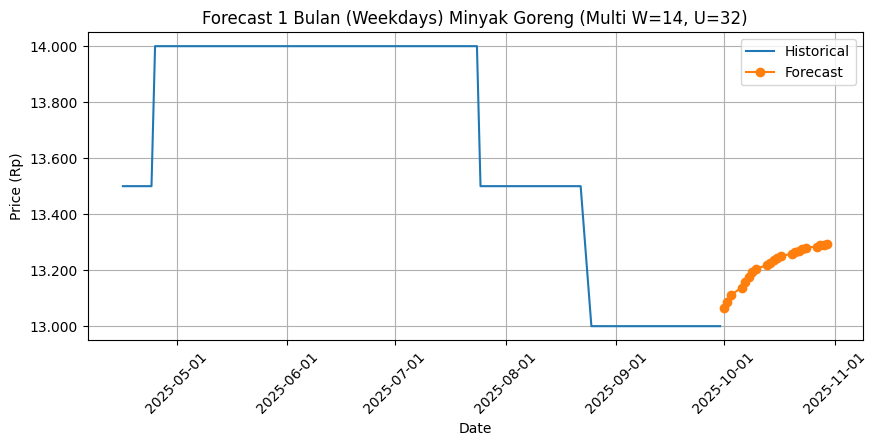

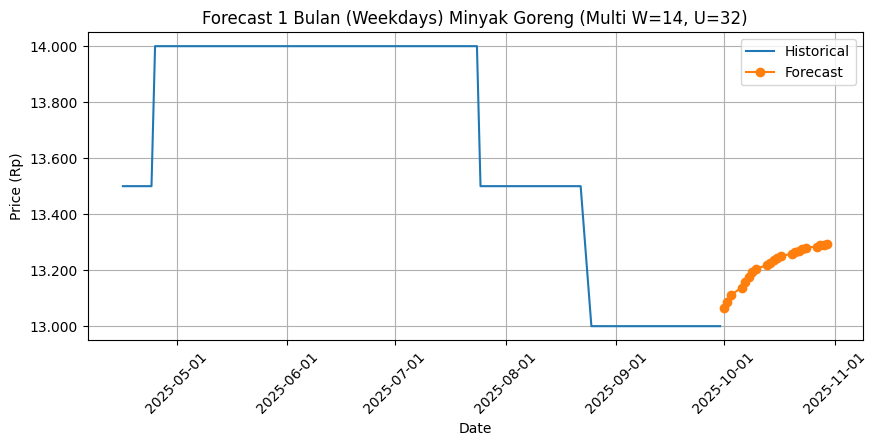


[MULTIVARIATE] Target=Minyak Goreng | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - loss: 0.0863 - val_loss: 0.0193
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0133 - val_loss: 0.0118
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0085 - val_loss: 0.0042
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0068 - val_loss: 0.0035
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0063 - val_loss: 0.0018
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0048 - val_loss: 8.1166e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0048 - val_loss: 4.5424e-04
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0041 - val_loss: 2.7981e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0043 - val_loss: 0.0019
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0041 - val_loss: 0.0014
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0046 - val_loss: 9.1405e-04
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step -

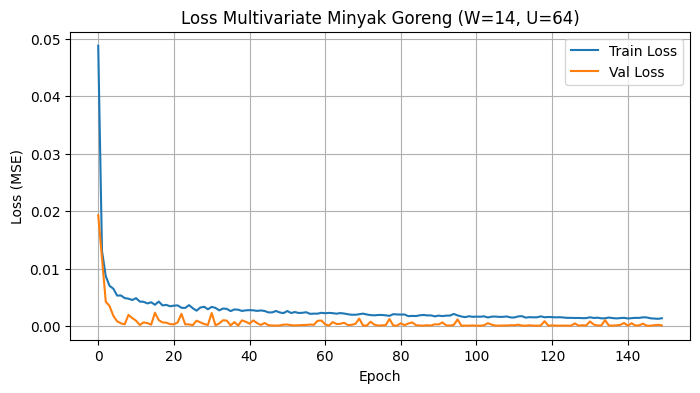

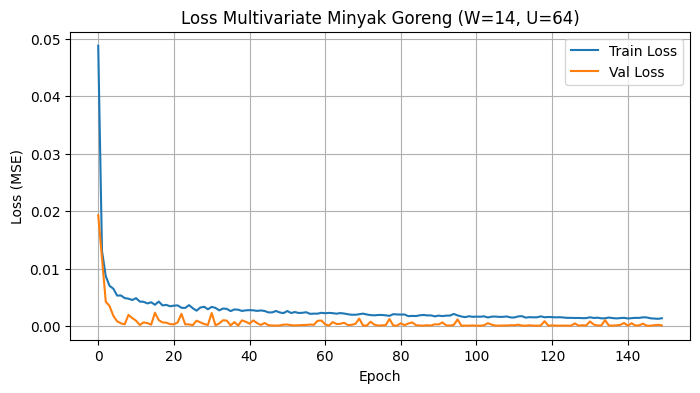

Test MAE  : 43.55
Test RMSE : 78.91
Test MAPE : 0.3234%


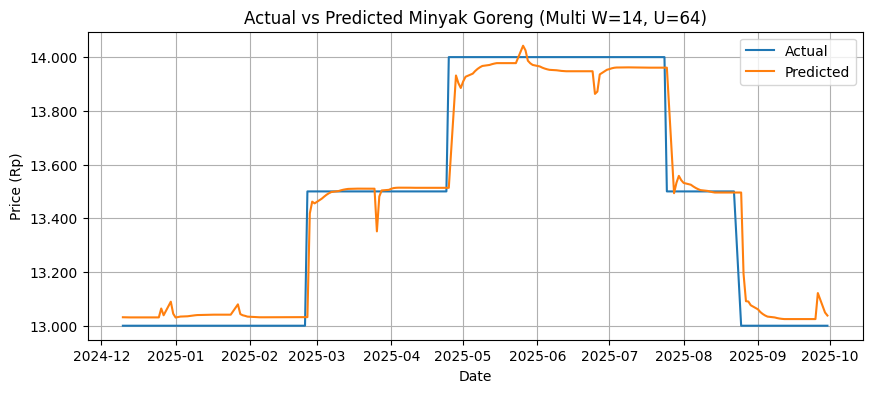

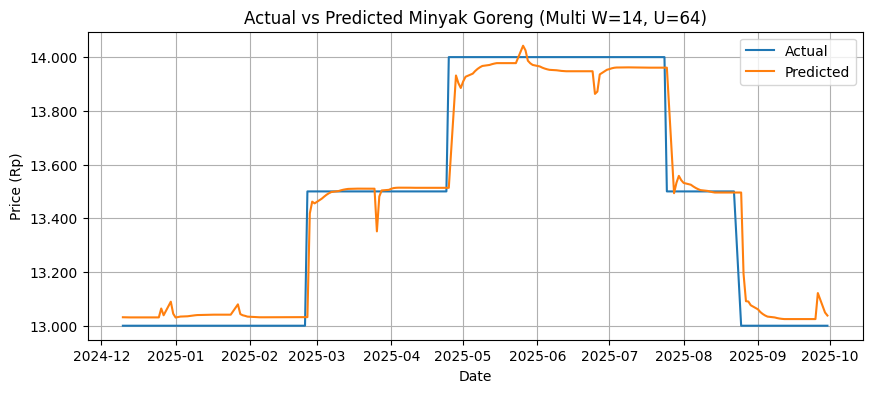


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13000,13037.903320
1,2025-10-02,13000,13065.565430
2,2025-10-03,13000,13084.216797
3,2025-10-06,13000,13095.932617
4,2025-10-07,13000,13104.673828
5,2025-10-08,13000,13112.219727
6,2025-10-09,13000,13119.318359
7,2025-10-10,13000,13126.245117
8,2025-10-13,13000,13133.062500
9,2025-10-14,13000,13139.745117


Forecast MAPE Okt 2025 : 1.0897%
Compare CSV disimpan: compare_Okt2025_multi_W14_U64.csv


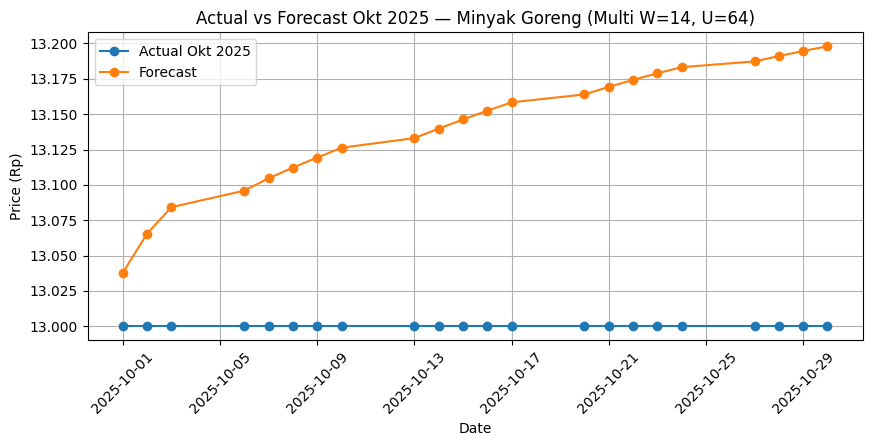

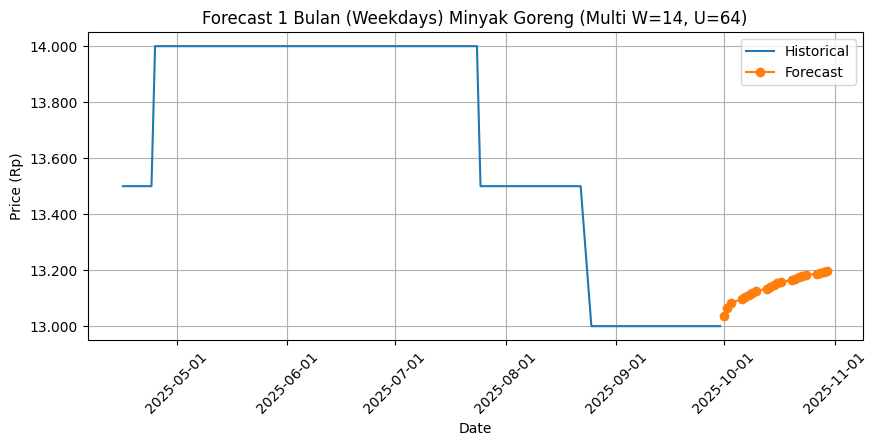

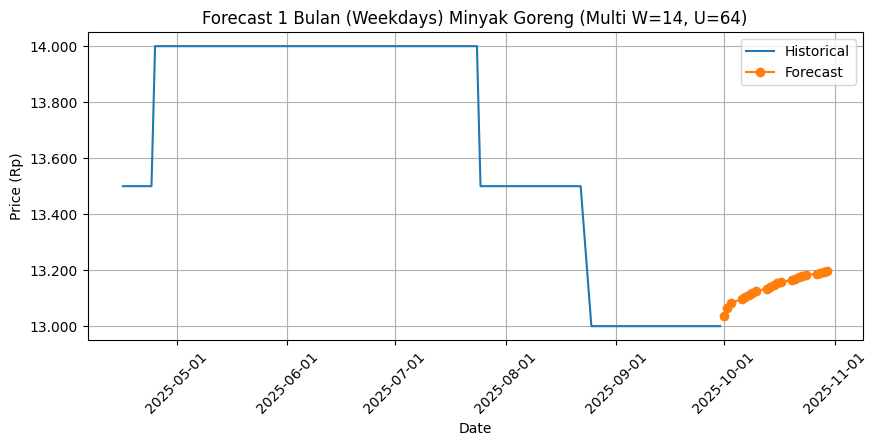


[MULTIVARIATE] Target=Minyak Goreng | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - loss: 0.0821 - val_loss: 0.0442
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0257 - val_loss: 0.0309
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0151 - val_loss: 0.0213
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0135 - val_loss: 0.0143
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0108 - val_loss: 0.0141
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0084 - val_loss: 0.0166
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0080 - val_loss: 0.0039
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0079 - val_loss: 0.0161
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0072 - val_loss: 0.0060
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0070 - val_loss: 0.0024
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0073 - val_loss: 0.0137
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0

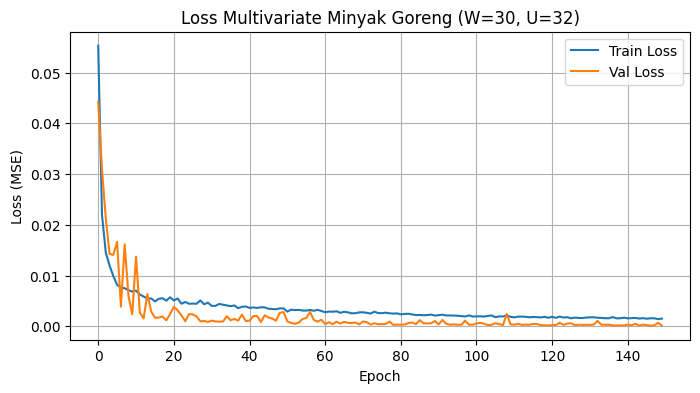

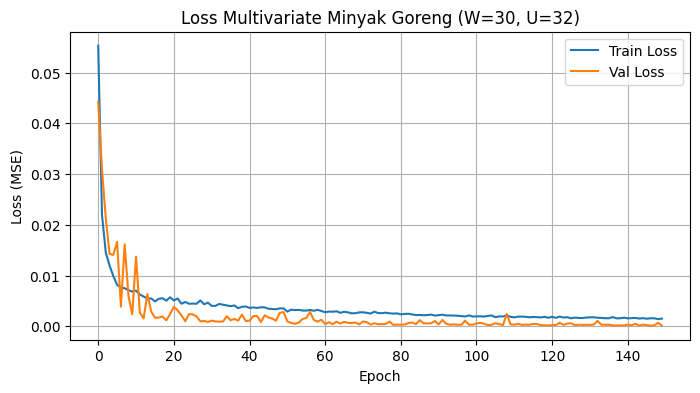

Test MAE  : 58.63
Test RMSE : 94.08
Test MAPE : 0.4280%


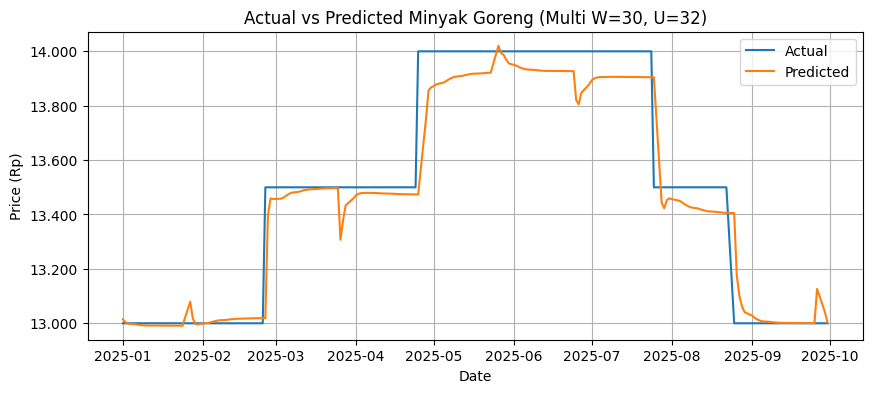

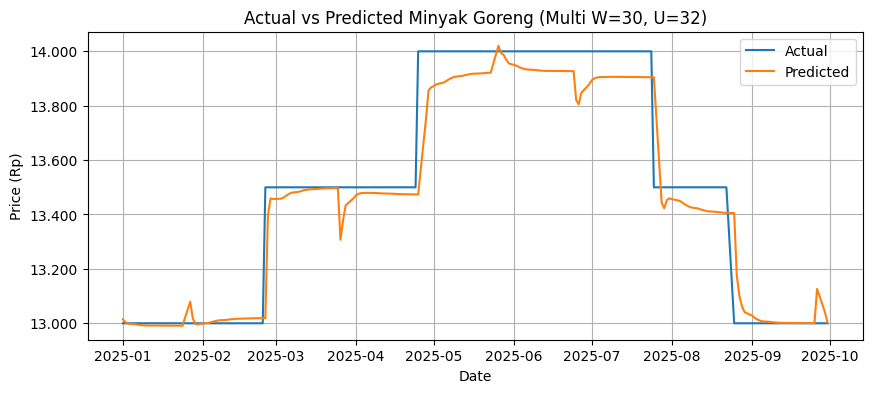


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13000,13003.233398
1,2025-10-02,13000,12992.401367
2,2025-10-03,13000,12980.893555
3,2025-10-06,13000,12970.749023
4,2025-10-07,13000,12962.969727
5,2025-10-08,13000,12957.612305
6,2025-10-09,13000,12954.385742
7,2025-10-10,13000,12952.868164
8,2025-10-13,13000,12952.635742
9,2025-10-14,13000,12953.322266


Forecast MAPE Okt 2025 : 0.2595%
Compare CSV disimpan: compare_Okt2025_multi_W30_U32.csv


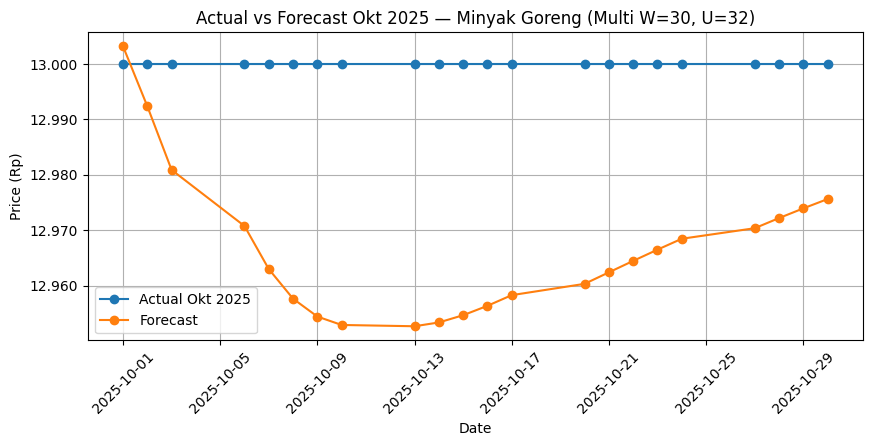

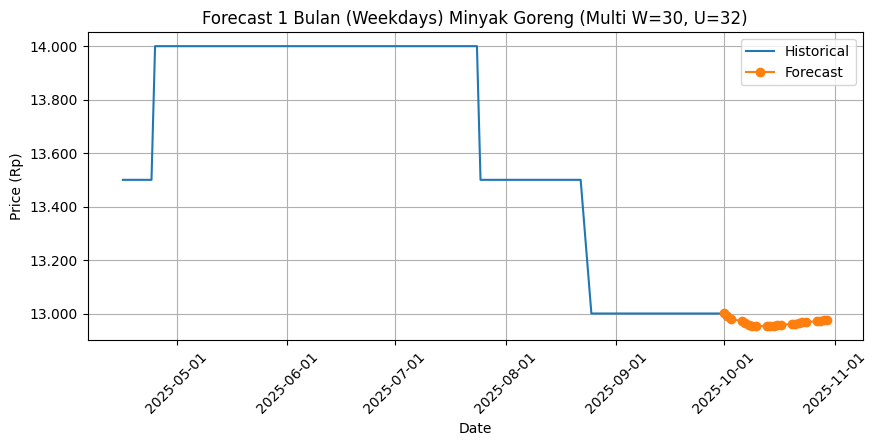

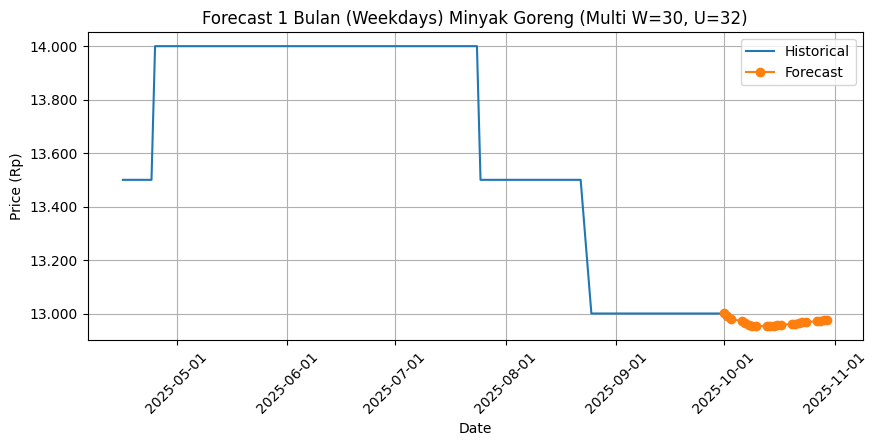


[MULTIVARIATE] Target=Minyak Goreng | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - loss: 0.1210 - val_loss: 0.0158
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0171 - val_loss: 0.0164
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0094 - val_loss: 0.0104
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0074 - val_loss: 0.0017
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0062 - val_loss: 0.0024
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0059 - val_loss: 0.0015
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0062 - val_loss: 4.4080e-04
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0067 - val_loss: 4.6348e-04
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0050 - val_loss: 0.0053
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0052 - val_loss: 0.0033
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0048 - val_loss: 0.0058
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - l

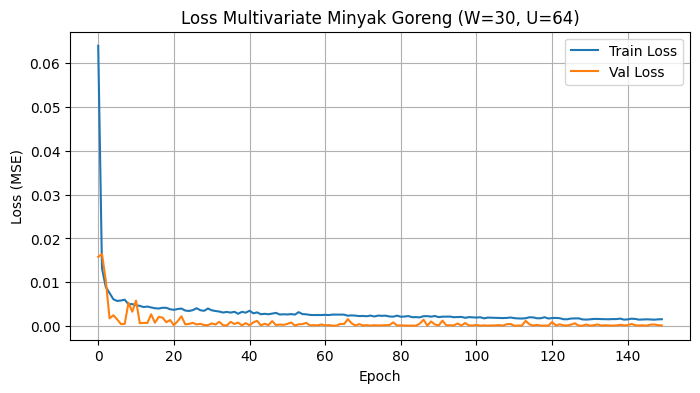

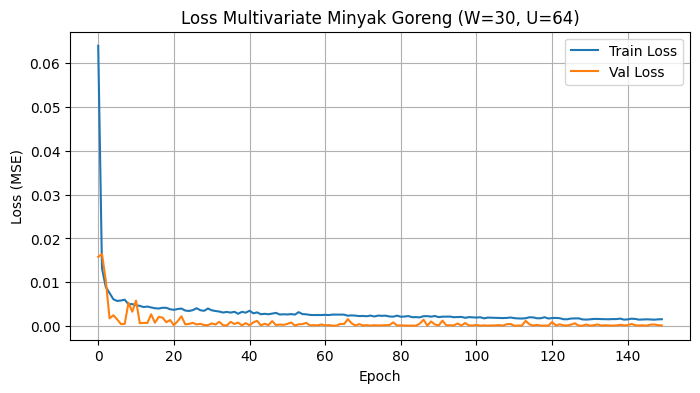

Test MAE  : 56.58
Test RMSE : 88.56
Test MAPE : 0.4203%


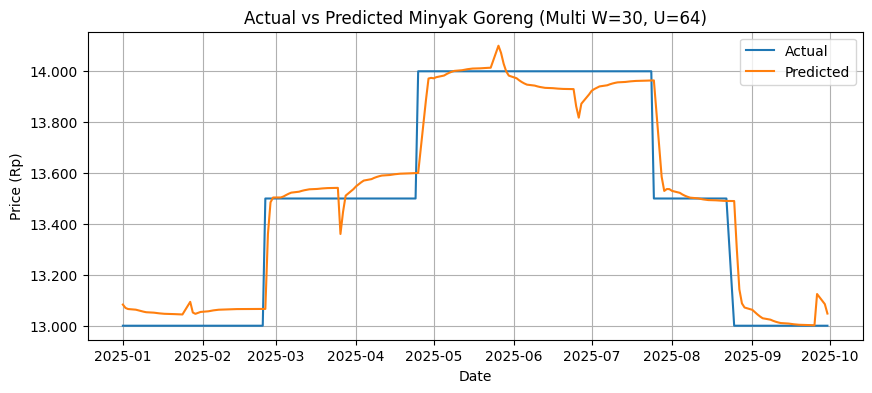

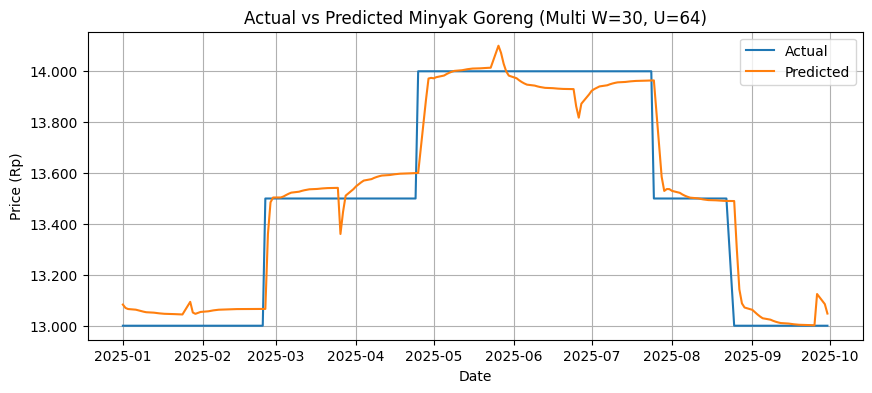


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,13000,13047.751953
1,2025-10-02,13000,13058.257812
2,2025-10-03,13000,13066.988281
3,2025-10-06,13000,13070.155273
4,2025-10-07,13000,13069.138672
5,2025-10-08,13000,13065.422852
6,2025-10-09,13000,13060.111328
7,2025-10-10,13000,13054.000000
8,2025-10-13,13000,13047.602539
9,2025-10-14,13000,13041.218750


Forecast MAPE Okt 2025 : 0.2640%
Compare CSV disimpan: compare_Okt2025_multi_W30_U64.csv


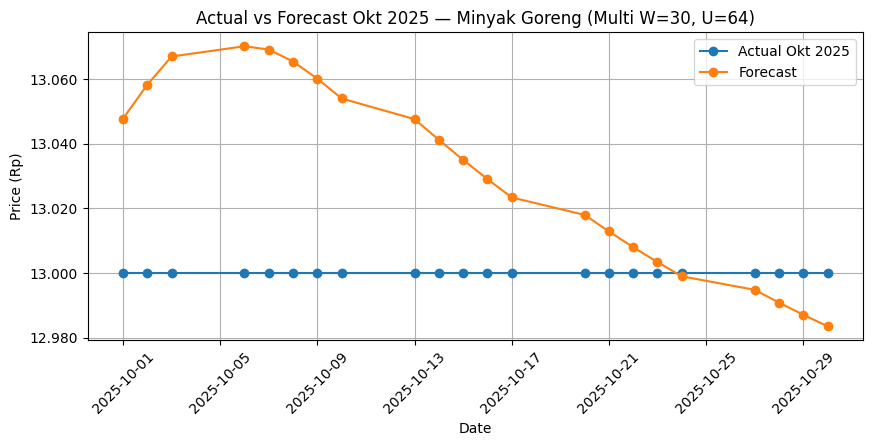

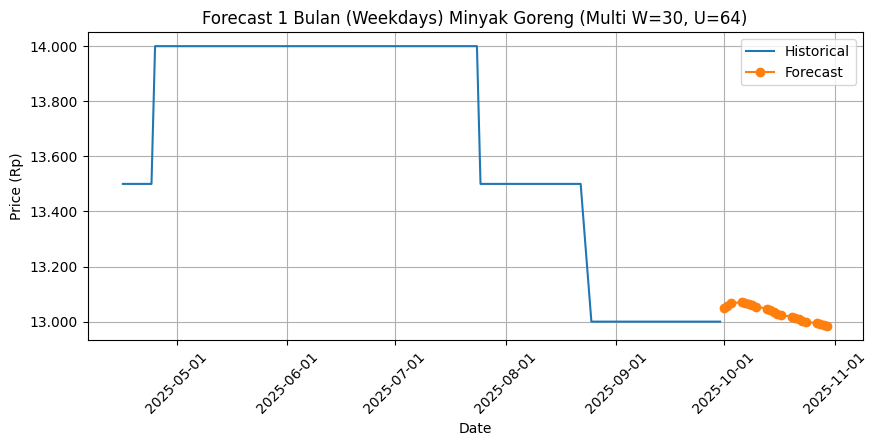

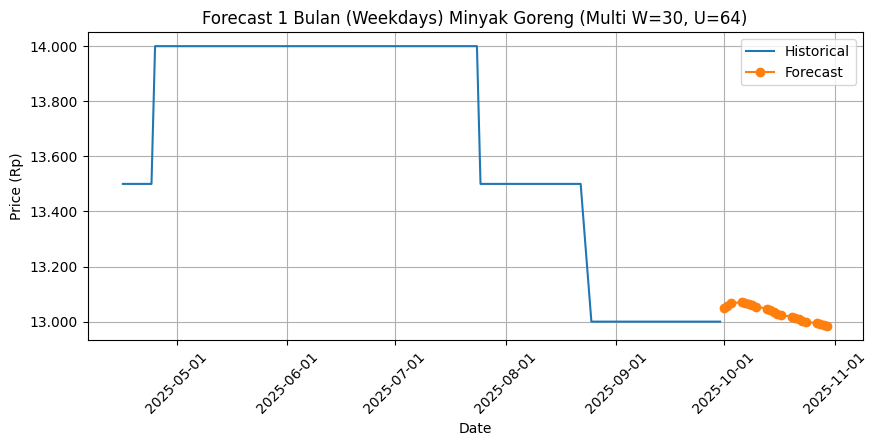


Rekap multivariate Minyak Goreng disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate\Minyak_Goreng\hasil_multivariate_Minyak_Goreng.csv

==================== MULTIVARIATE: Gula Pasir ====================

[MULTIVARIATE] Target=Gula Pasir | W=7 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - loss: 0.1451 - val_loss: 0.2228
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0334 - val_loss: 0.0800
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0207 - val_loss: 0.0092
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0124 - val_loss: 0.0028
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0082 - val_loss: 0.0039
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0067 - val_loss: 0.0084
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0072 - val_loss: 0.0014
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0065 - val_loss: 0.0021
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0059 - val_loss: 0.0010
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0063 - val_loss: 0.0069
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0053 - val_loss: 0.0034
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0051 - val

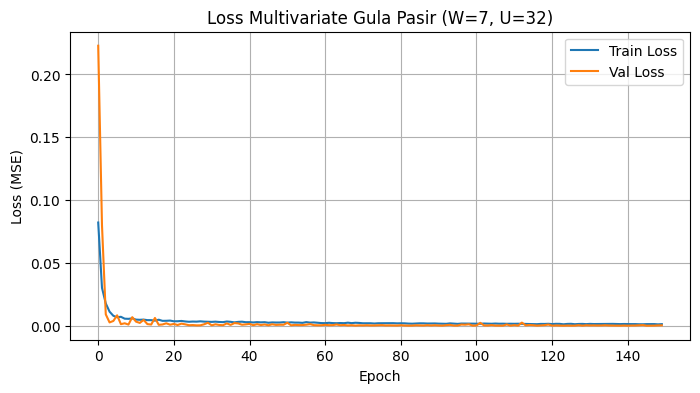

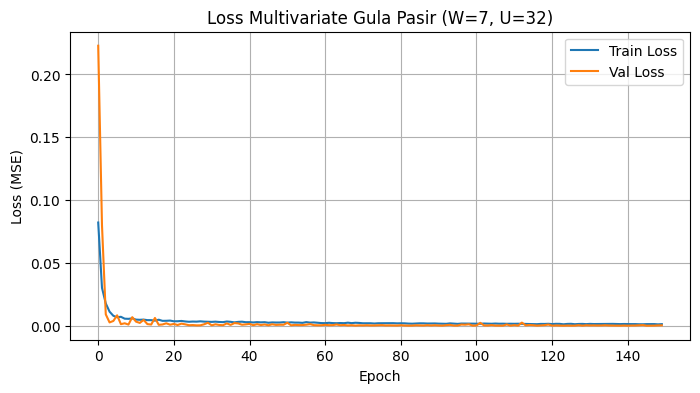

Test MAE  : 83.63
Test RMSE : 96.09
Test MAPE : 0.5677%


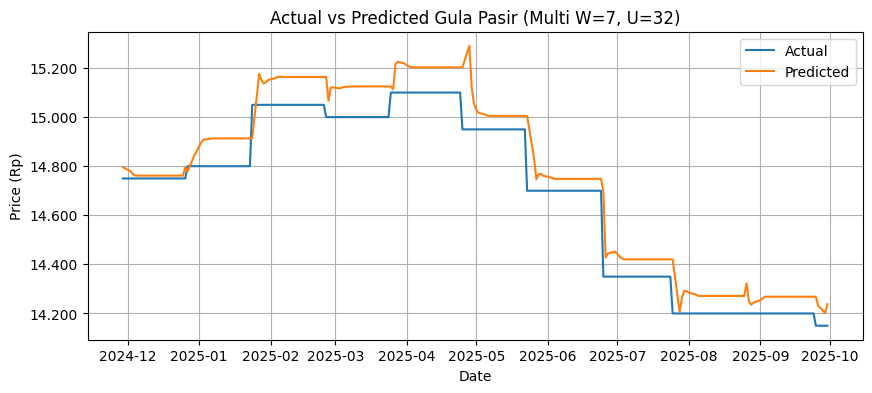

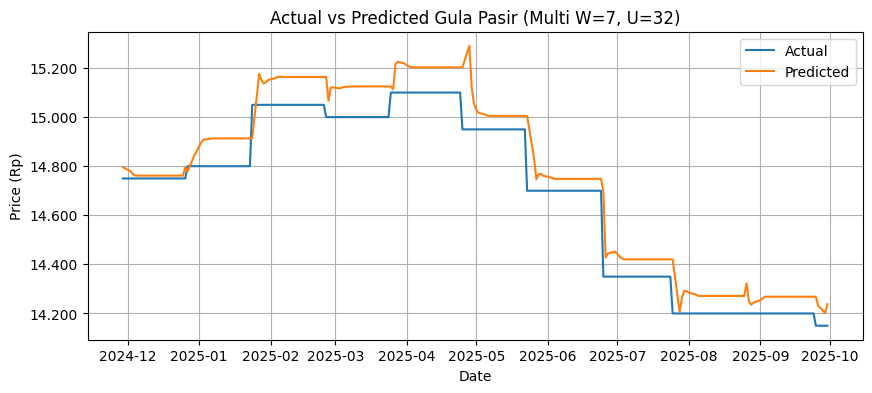


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,14150,14237.553711
1,2025-10-02,14150,14335.936523
2,2025-10-03,14150,14446.713867
3,2025-10-06,14150,14561.202148
4,2025-10-07,14150,14675.758789
5,2025-10-08,14150,14784.616211
6,2025-10-09,14150,14890.072266
7,2025-10-10,14150,14992.195312
8,2025-10-13,14150,15090.909180
9,2025-10-14,14150,15186.133789


Forecast MAPE Okt 2025 : 7.5927%
Compare CSV disimpan: compare_Okt2025_multi_W7_U32.csv


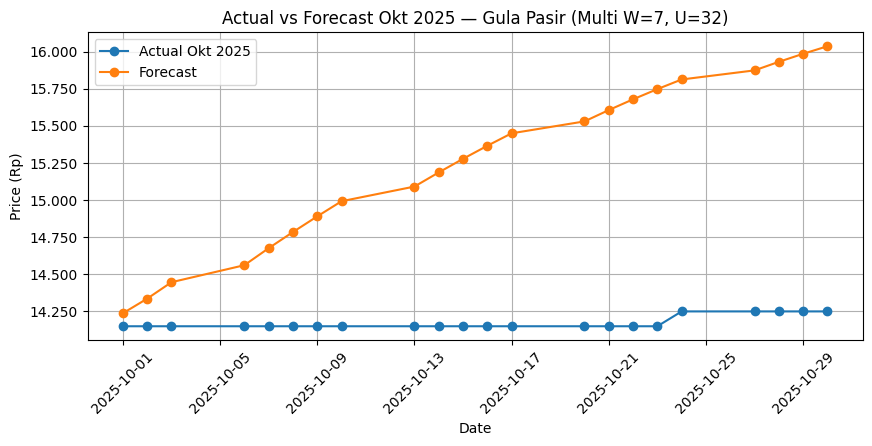

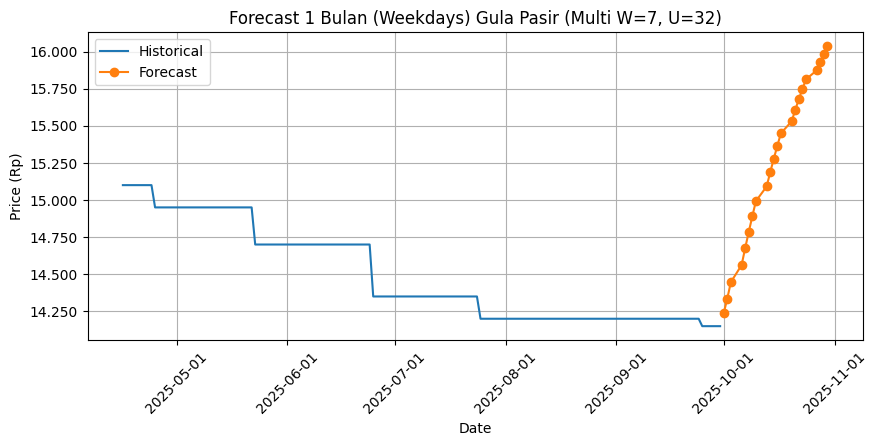

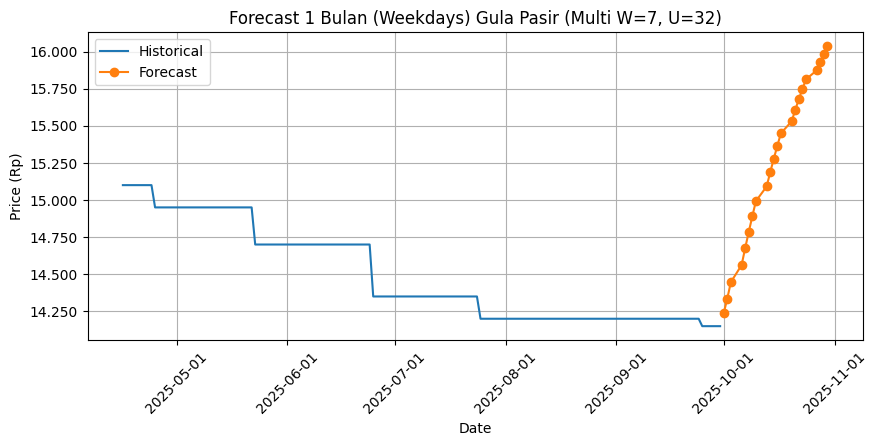


[MULTIVARIATE] Target=Gula Pasir | W=7 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step - loss: 0.0915 - val_loss: 0.0114
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0159 - val_loss: 0.0350
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0071 - val_loss: 0.0023
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0057 - val_loss: 0.0042
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0056 - val_loss: 5.8147e-04
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0048 - val_loss: 0.0015
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0040 - val_loss: 0.0011
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0044 - val_loss: 2.9629e-04
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0041 - val_loss: 2.6492e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0040 - val_loss: 2.3179e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0036 - val_loss: 0.0013
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 

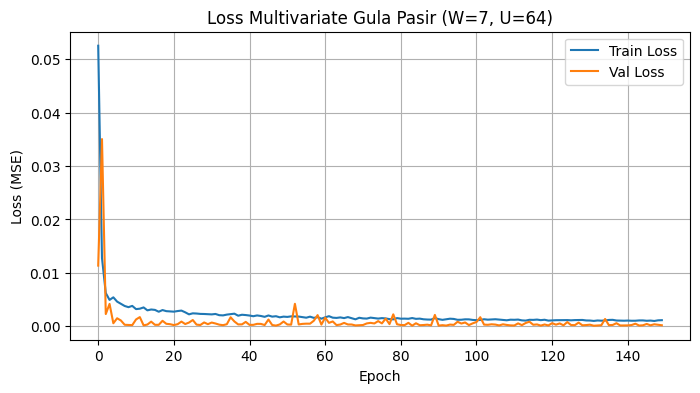

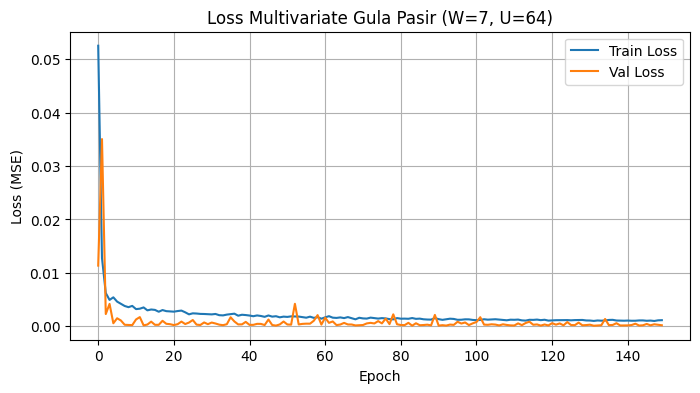

Test MAE  : 37.97
Test RMSE : 56.35
Test MAPE : 0.2584%


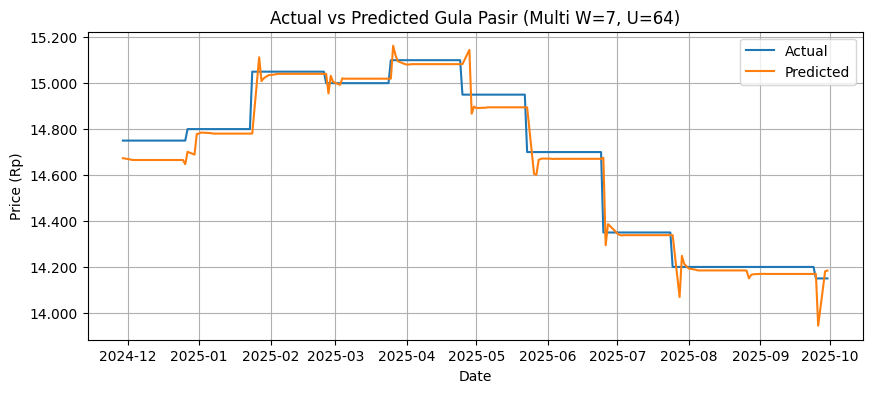

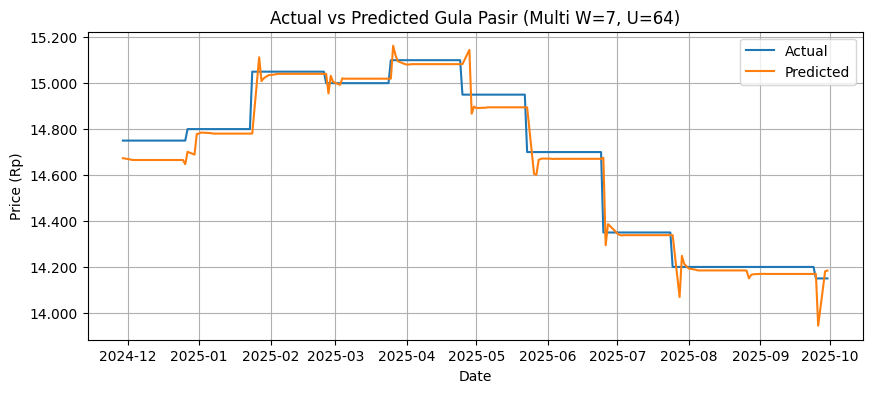


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,14150,14184.370117
1,2025-10-02,14150,14225.614258
2,2025-10-03,14150,14263.289062
3,2025-10-06,14150,14295.169922
4,2025-10-07,14150,14320.842773
5,2025-10-08,14150,14344.808594
6,2025-10-09,14150,14367.698242
7,2025-10-10,14150,14389.521484
8,2025-10-13,14150,14410.184570
9,2025-10-14,14150,14429.639648


Forecast MAPE Okt 2025 : 1.8380%
Compare CSV disimpan: compare_Okt2025_multi_W7_U64.csv


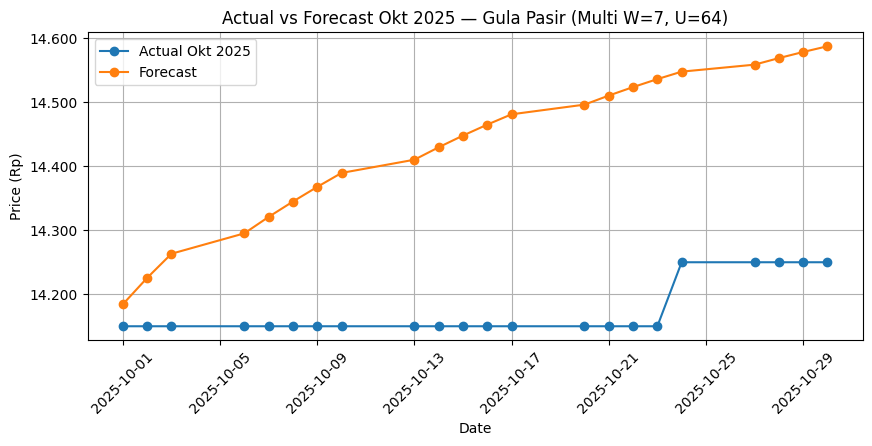

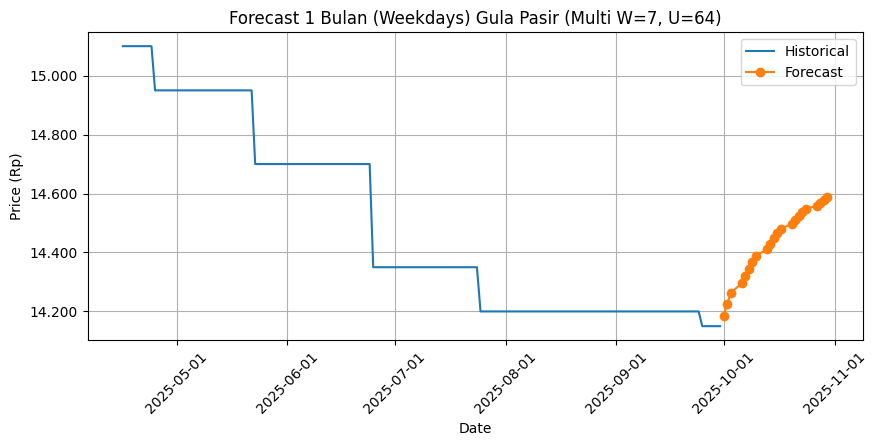

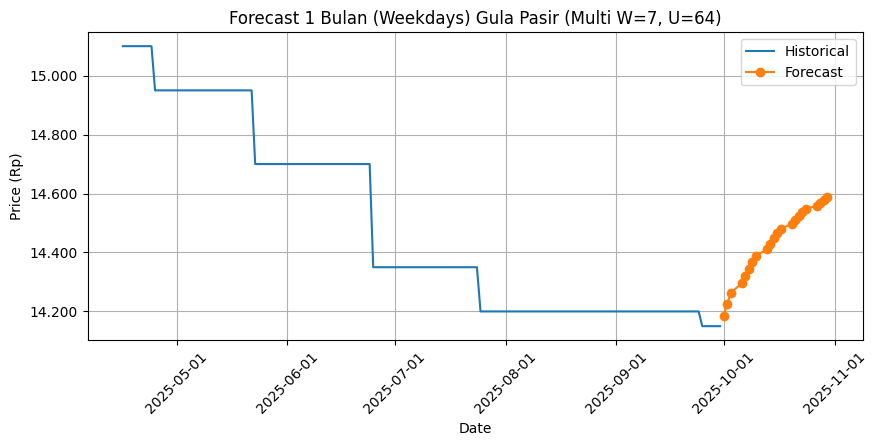


[MULTIVARIATE] Target=Gula Pasir | W=14 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step - loss: 0.0556 - val_loss: 0.1081
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0190 - val_loss: 0.0085
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 0.0087 - val_loss: 0.0108
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0061 - val_loss: 0.0030
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0059 - val_loss: 0.0095
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0050 - val_loss: 0.0033
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0048 - val_loss: 0.0079
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0060 - val_loss: 0.0073
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0045 - val_loss: 0.0053
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0045 - val_loss: 0.0100
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0043 - val_loss: 0.0054
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0

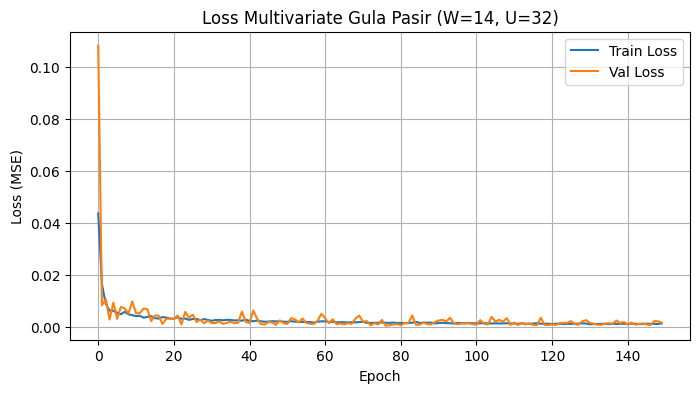

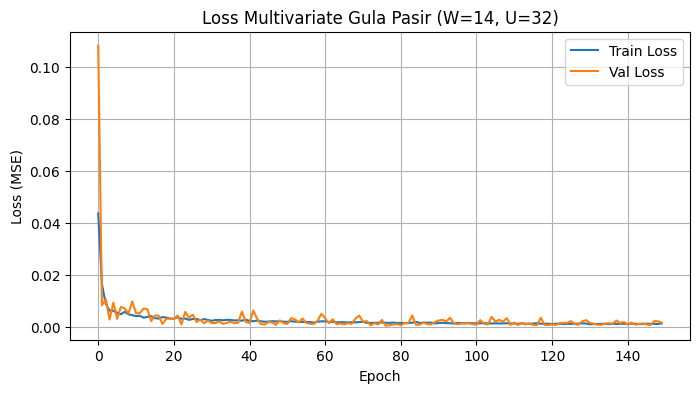

Test MAE  : 172.10
Test RMSE : 179.08
Test MAPE : 1.1713%


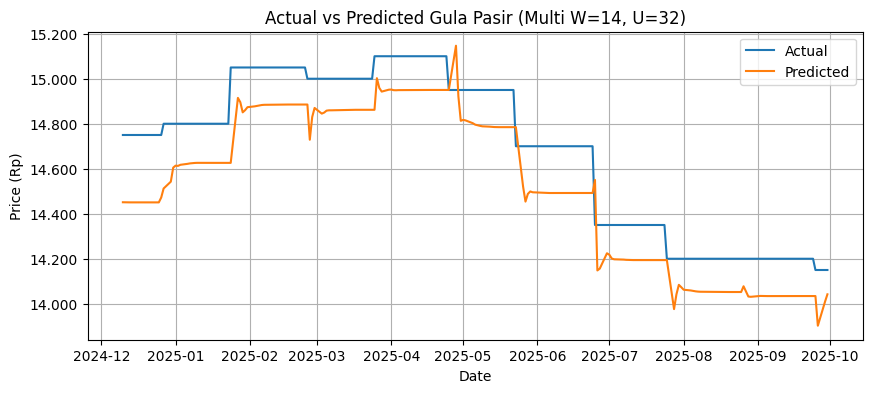

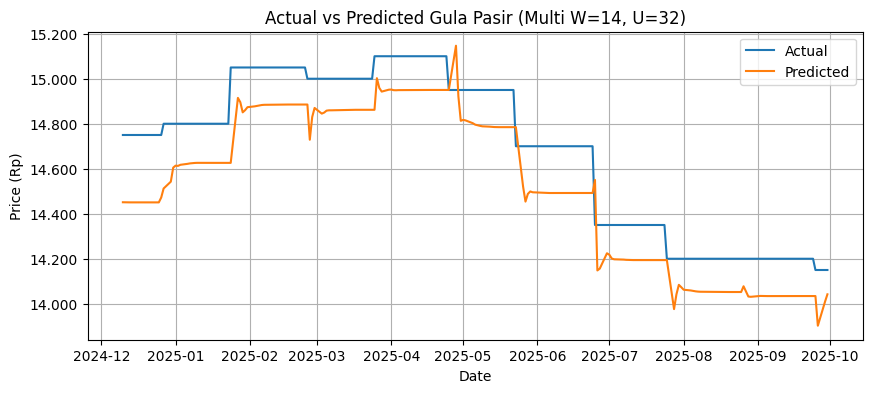


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,14150,14041.936523
1,2025-10-02,14150,13951.352539
2,2025-10-03,14150,13879.117188
3,2025-10-06,14150,13830.773438
4,2025-10-07,14150,13794.266602
5,2025-10-08,14150,13762.229492
6,2025-10-09,14150,13732.209961
7,2025-10-10,14150,13703.774414
8,2025-10-13,14150,13676.914062
9,2025-10-14,14150,13651.566406


Forecast MAPE Okt 2025 : 3.6916%
Compare CSV disimpan: compare_Okt2025_multi_W14_U32.csv


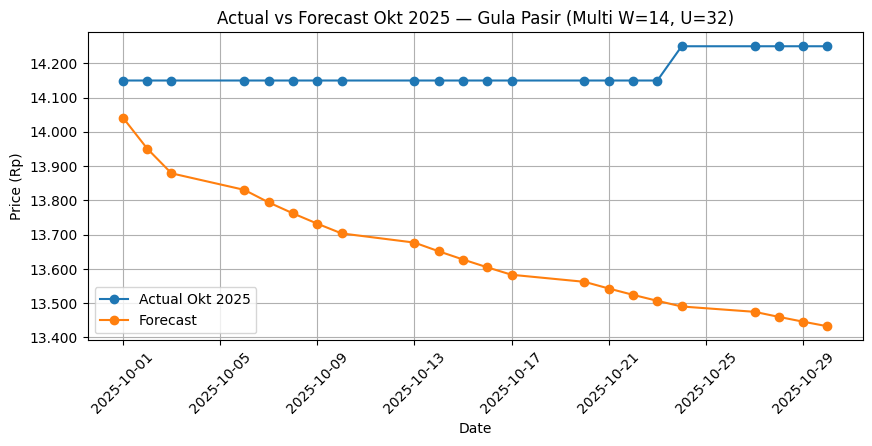

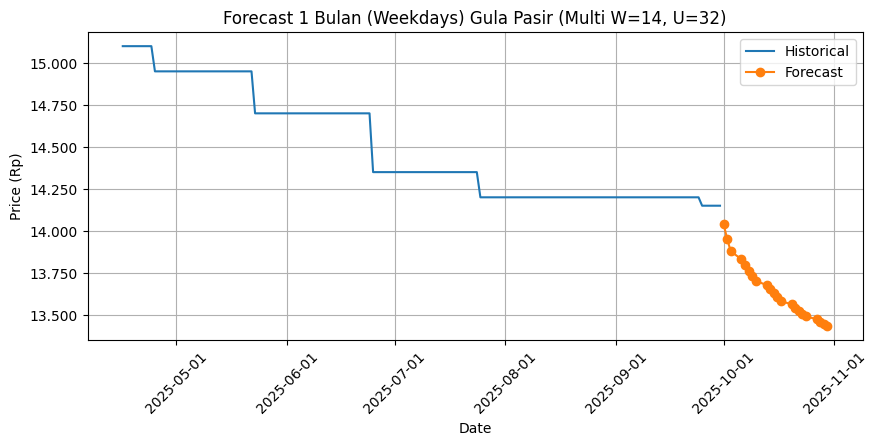

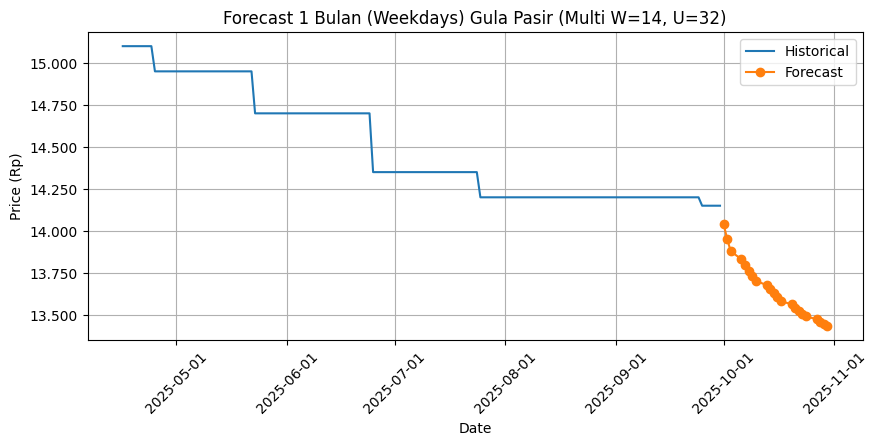


[MULTIVARIATE] Target=Gula Pasir | W=14 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - loss: 0.0520 - val_loss: 0.0039
Epoch 2/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0094 - val_loss: 0.0064
Epoch 3/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.0065 - val_loss: 5.4878e-04
Epoch 4/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0052 - val_loss: 4.1583e-04
Epoch 5/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0051 - val_loss: 3.0166e-04
Epoch 6/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0040 - val_loss: 4.1265e-04
Epoch 7/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0038 - val_loss: 4.6791e-04
Epoch 8/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0033 - val_loss: 0.0017
Epoch 9/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0032 - val_loss: 3.3299e-04
Epoch 10/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0031 - val_loss: 9.9517e-04
Epoch 11/150
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0028 - val_loss: 0.0019
Epoch 12/150
33/33 ━━━━━━━━━━━━━━━━━━━

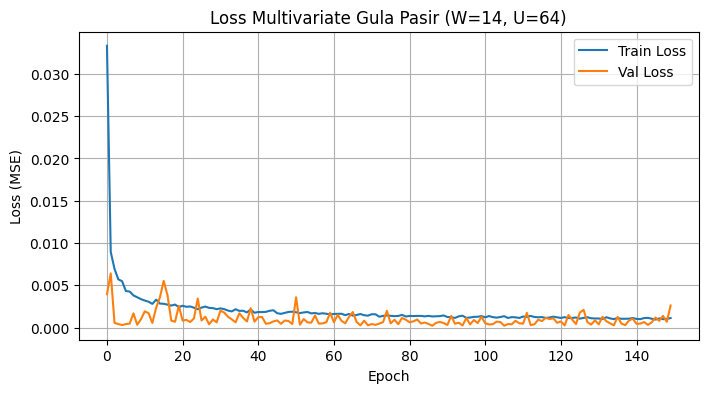

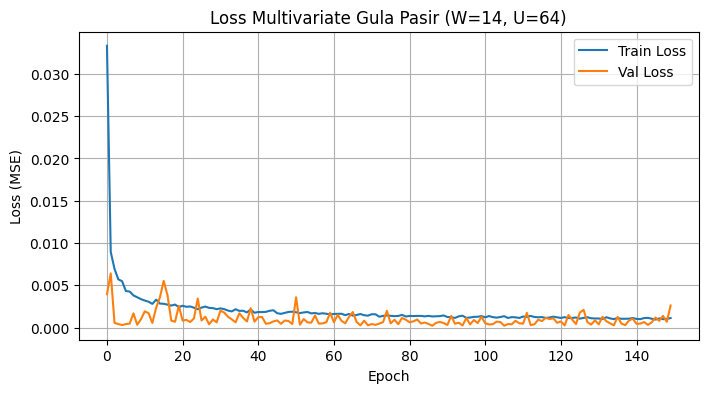

Test MAE  : 291.28
Test RMSE : 294.69
Test MAPE : 1.9825%


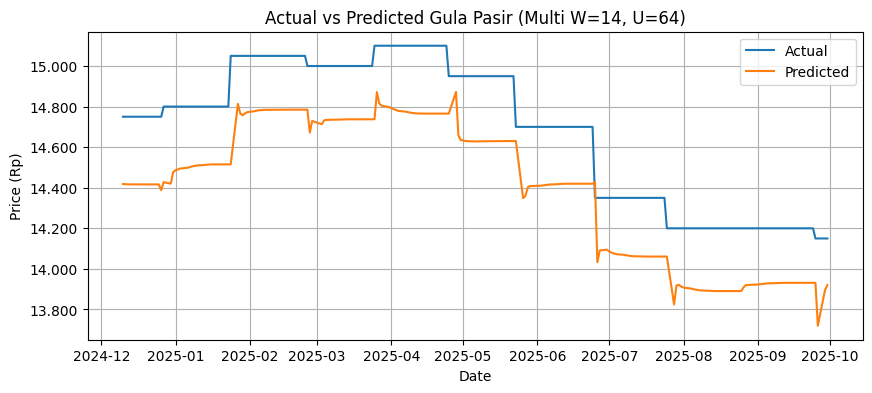

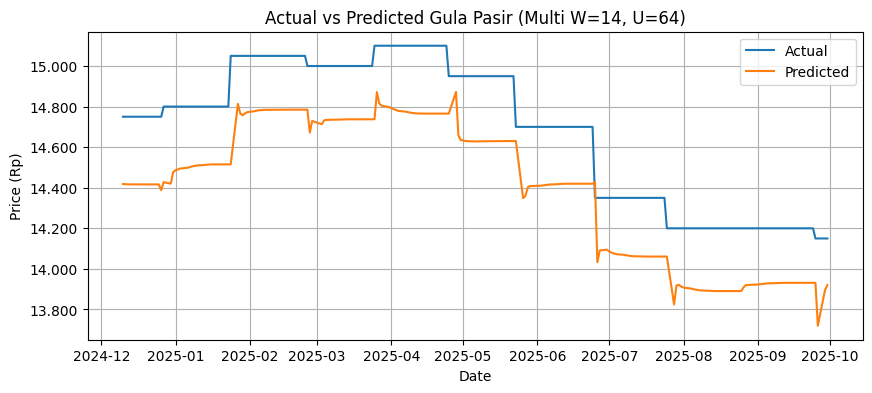


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,14150,13920.202148
1,2025-10-02,14150,13714.396484
2,2025-10-03,14150,13547.543945
3,2025-10-06,14150,13411.695312
4,2025-10-07,14150,13296.401367
5,2025-10-08,14150,13195.525391
6,2025-10-09,14150,13105.385742
7,2025-10-10,14150,13023.646484
8,2025-10-13,14150,12948.709961
9,2025-10-14,14150,12879.396484


Forecast MAPE Okt 2025 : 9.1312%
Compare CSV disimpan: compare_Okt2025_multi_W14_U64.csv


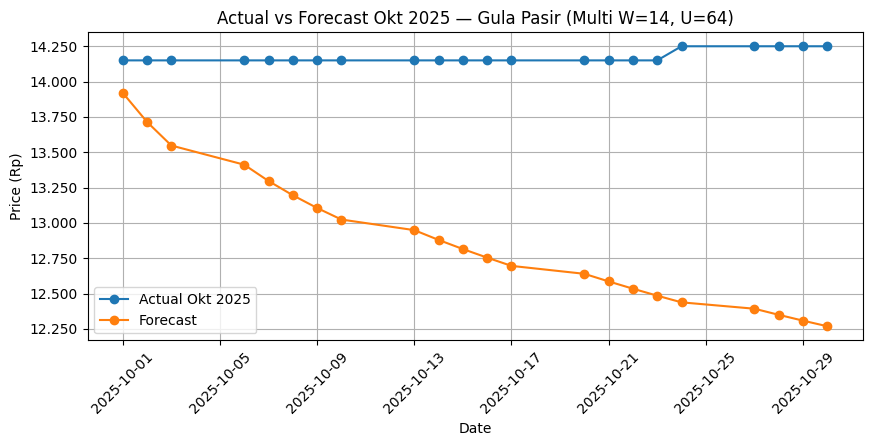

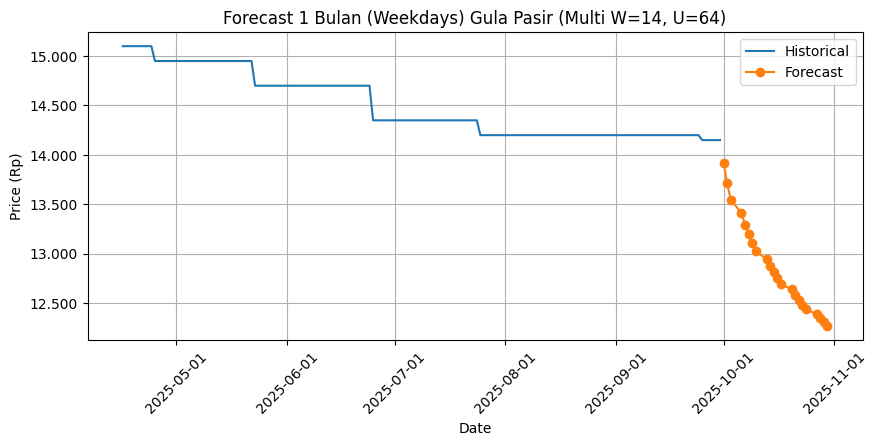

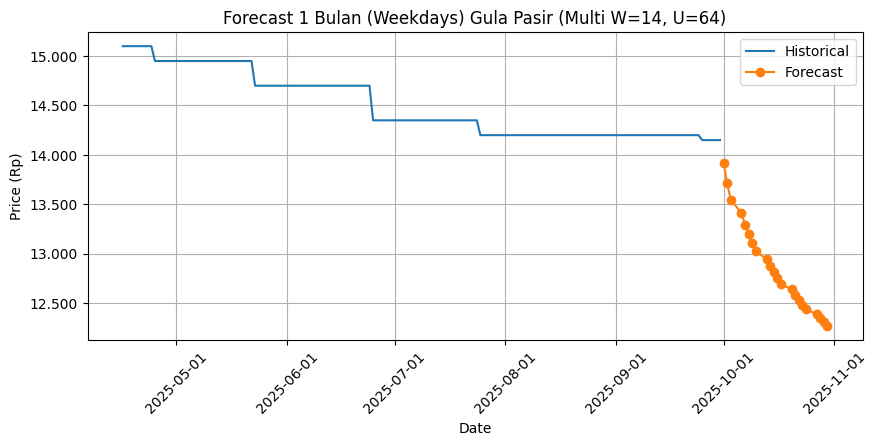


[MULTIVARIATE] Target=Gula Pasir | W=30 | Units=32
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - loss: 0.0630 - val_loss: 0.0322
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0158 - val_loss: 0.0131
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0086 - val_loss: 0.0093
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0081 - val_loss: 0.0109
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0063 - val_loss: 6.0286e-04
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 0.0058 - val_loss: 0.0026
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0049 - val_loss: 0.0035
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0051 - val_loss: 0.0036
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0052 - val_loss: 0.0020
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 0.0042 - val_loss: 5.8497e-04
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0045 - val_loss: 0.0017
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - lo

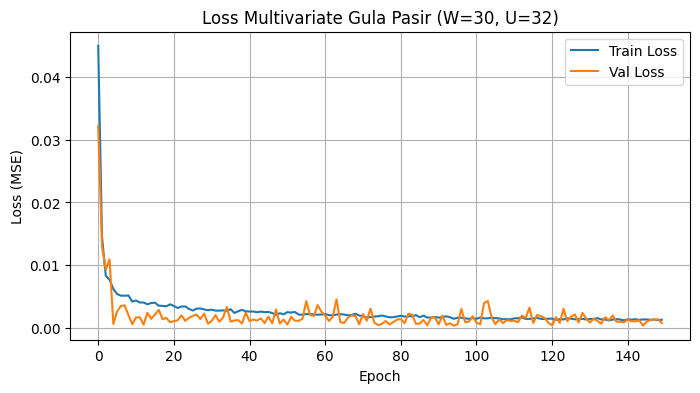

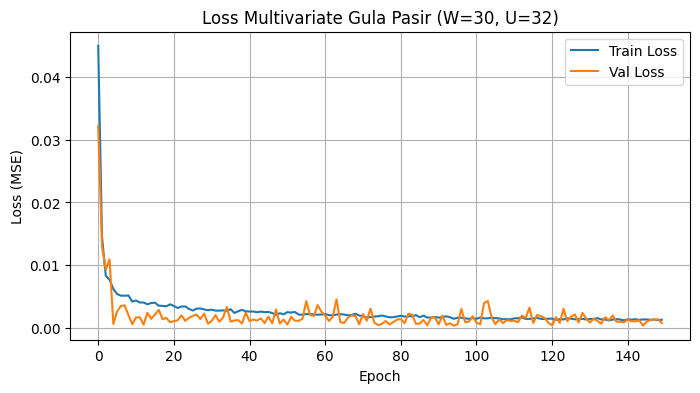

Test MAE  : 122.91
Test RMSE : 129.75
Test MAPE : 0.8390%


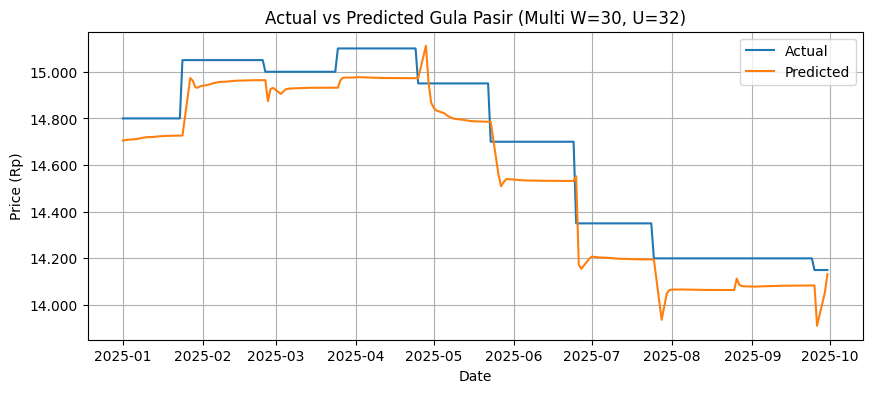

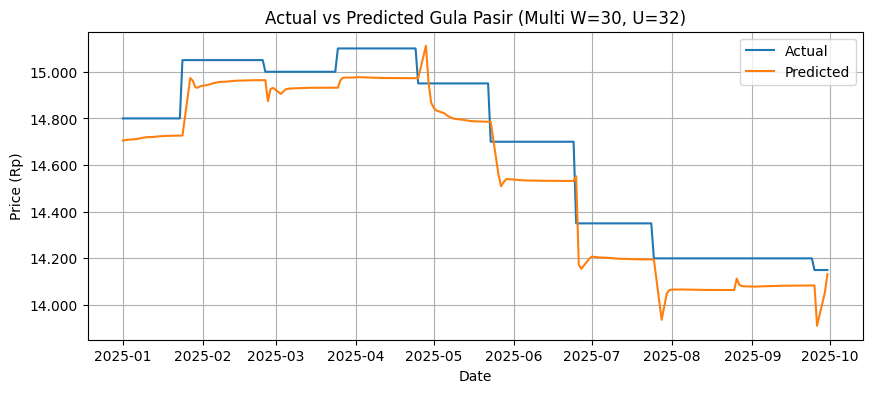


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,14150,14131.901367
1,2025-10-02,14150,14135.713867
2,2025-10-03,14150,14145.511719
3,2025-10-06,14150,14163.034180
4,2025-10-07,14150,14185.464844
5,2025-10-08,14150,14210.505859
6,2025-10-09,14150,14236.363281
7,2025-10-10,14150,14261.815430
8,2025-10-13,14150,14286.133789
9,2025-10-14,14150,14308.937500


Forecast MAPE Okt 2025 : 1.0496%
Compare CSV disimpan: compare_Okt2025_multi_W30_U32.csv


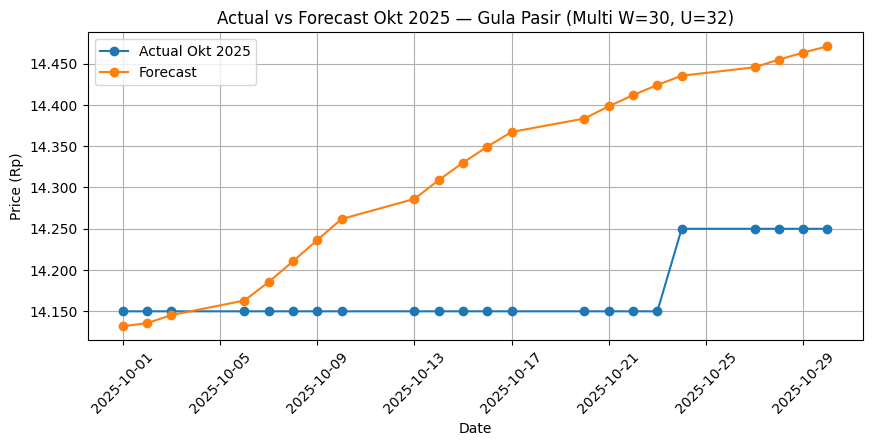

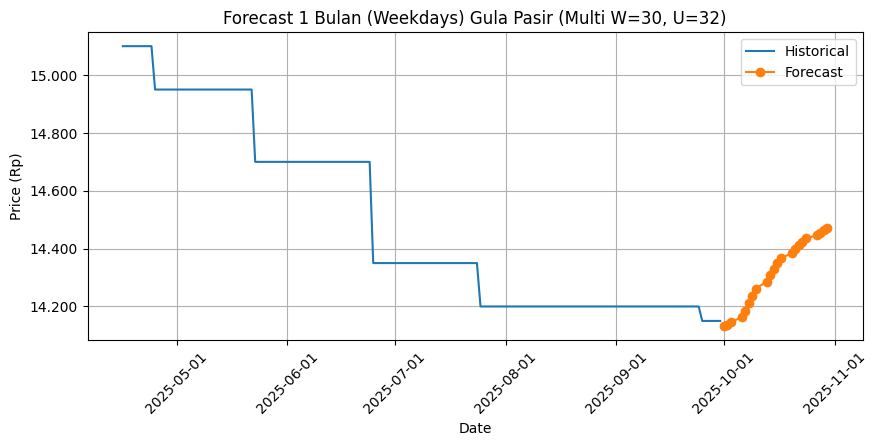

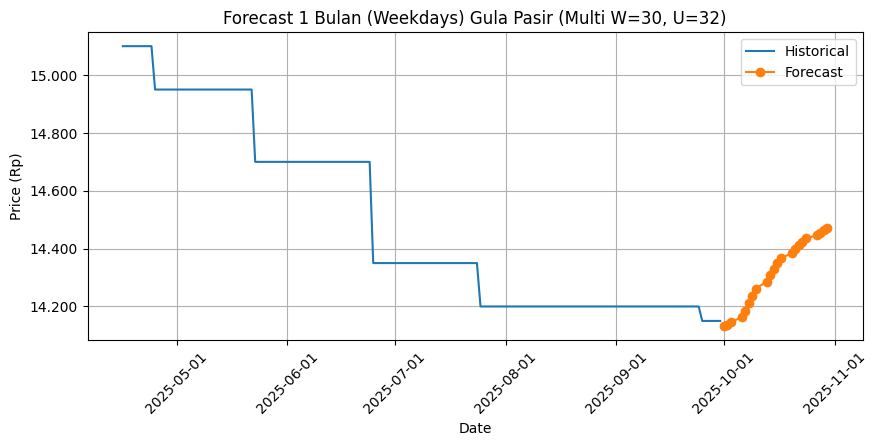


[MULTIVARIATE] Target=Gula Pasir | W=30 | Units=64
Training mulai...
Epoch 1/150


c:\laragon\bin\python\python-3.10\lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


32/32 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 0.0987 - val_loss: 0.0096
Epoch 2/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0135 - val_loss: 0.0017
Epoch 3/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 0.0082 - val_loss: 0.0020
Epoch 4/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0074 - val_loss: 0.0015
Epoch 5/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0057 - val_loss: 0.0016
Epoch 6/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0054 - val_loss: 0.0064
Epoch 7/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0051 - val_loss: 6.1460e-04
Epoch 8/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0053 - val_loss: 0.0016
Epoch 9/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 0.0050 - val_loss: 0.0024
Epoch 10/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 0.0047 - val_loss: 0.0079
Epoch 11/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0044 - val_loss: 0.0046
Epoch 12/150
32/32 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss:

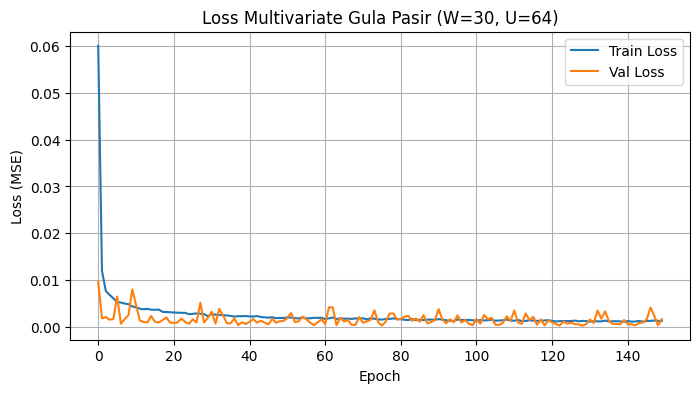

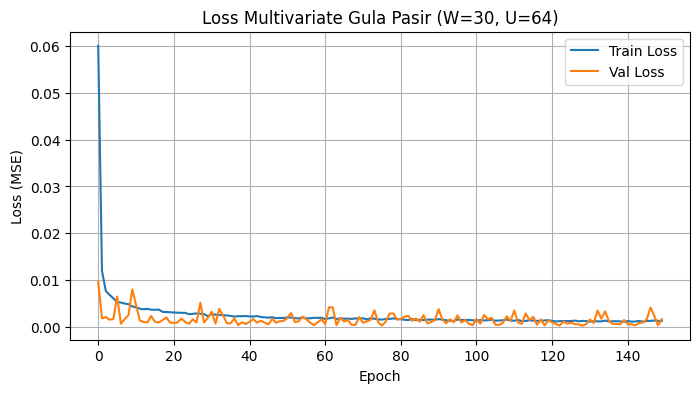

Test MAE  : 193.43
Test RMSE : 196.89
Test MAPE : 1.3165%


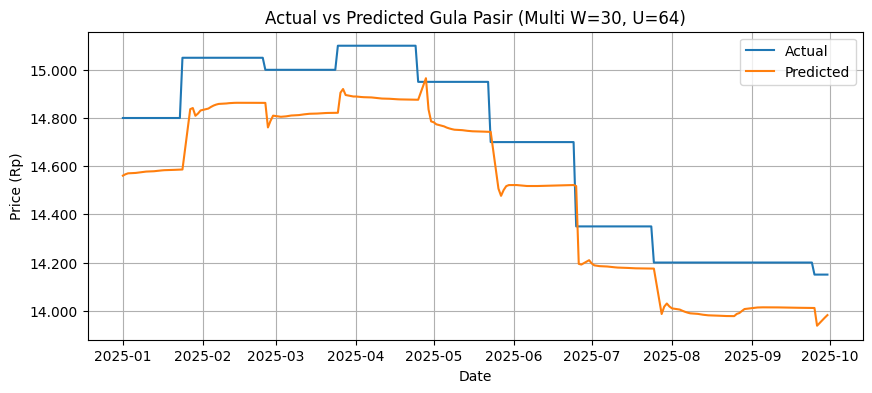

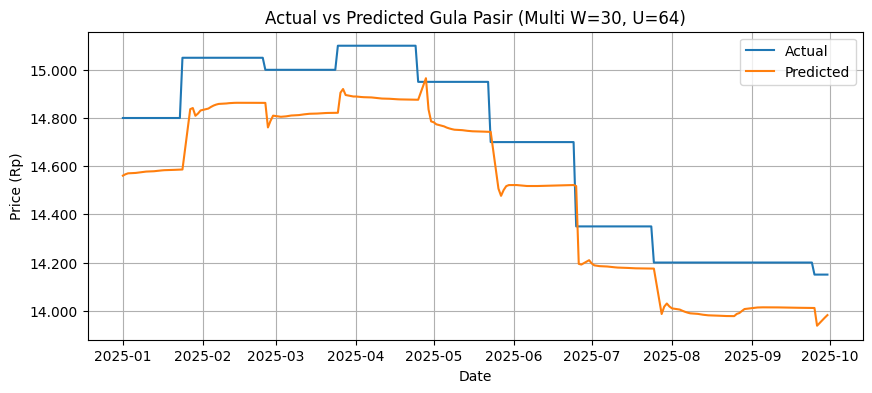


Tabel Actual vs Forecast (Okt 2025):


,date,actual_price,forecast_price
0,2025-10-01,14150,13981.830078
1,2025-10-02,14150,13856.684570
2,2025-10-03,14150,13762.706055
3,2025-10-06,14150,13699.214844
4,2025-10-07,14150,13651.989258
5,2025-10-08,14150,13613.930664
6,2025-10-09,14150,13581.552734
7,2025-10-10,14150,13552.875000
8,2025-10-13,14150,13526.713867
9,2025-10-14,14150,13502.361328


Forecast MAPE Okt 2025 : 4.6790%
Compare CSV disimpan: compare_Okt2025_multi_W30_U64.csv


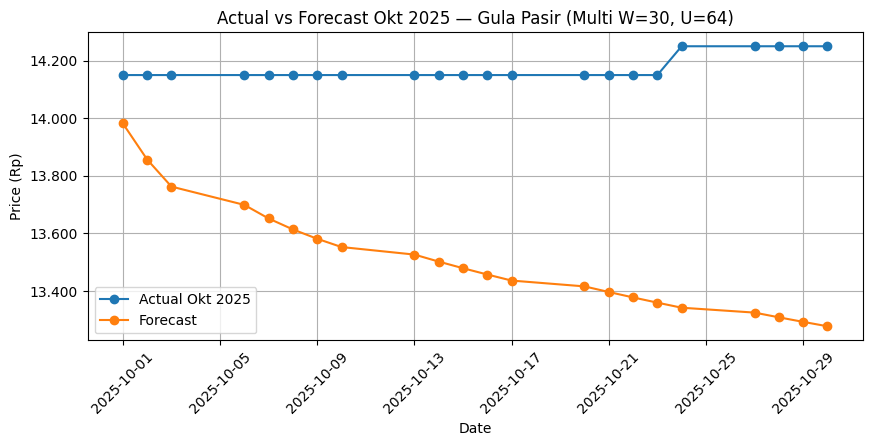

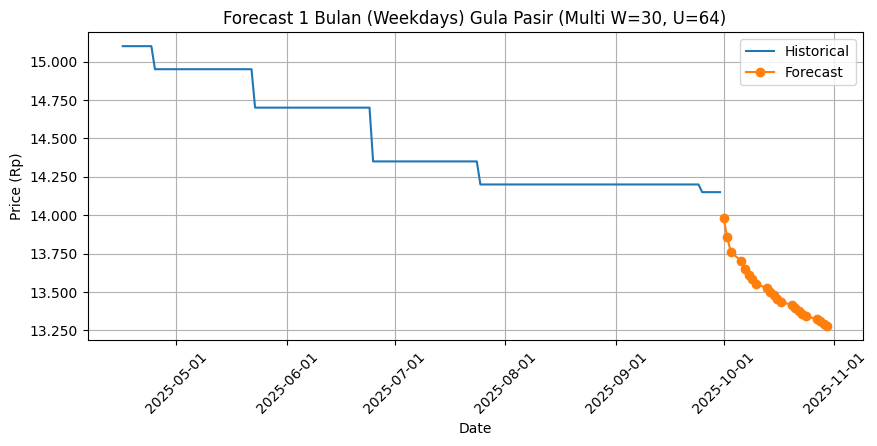

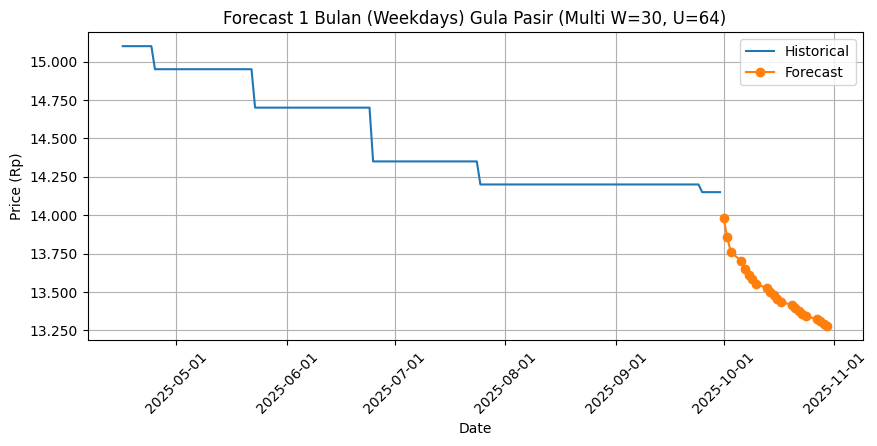


Rekap multivariate Gula Pasir disimpan ke: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate\Gula_Pasir\hasil_multivariate_Gula_Pasir.csv

===== Semua skenario MULTIVARIATE selesai dijalankan =====
Hasil lengkap ada di folder: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate


In [15]:
# ==========================================================
# CELL 18 — LOOP SKENARIO MULTIVARIATE (TRAIN + EVAL + SHOW + SAVE)
# Epoch Terlihat + Forecast Weekdays + Compare Okt 2025 + Forecast MAPE
# ==========================================================

import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.ticker import FuncFormatter
from IPython.display import display

rupiah = FuncFormatter(lambda x, pos: f"{x:,.0f}".replace(",", "."))

# ----------------------------------------------------------
# Folder hasil khusus multivariate
# ----------------------------------------------------------
base_result_folder = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate"
os.makedirs(base_result_folder, exist_ok=True)

print("Mulai percobaan skenario MULTIVARIATE...\n")

# ----------------------------------------------------------
# (A) Load data aktual Oktober 2025 sekali saja (untuk compare)
#     (pakai variabel yang sama seperti univariate)
# ----------------------------------------------------------
path_okt = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\dataset\Harga_Pangan_Oktober_2025.xlsx"
df_okt_raw = pd.read_excel(path_okt)

df_okt_raw.columns = (
    df_okt_raw.columns.astype(str)
    .str.replace(" ", "", regex=False)
    .str.replace("\n", "", regex=False)
)

col_komoditas_okt = df_okt_raw.columns[1]
df_okt_raw = df_okt_raw.rename(columns={col_komoditas_okt: "komoditas"})

date_cols_okt = []
for c in df_okt_raw.columns:
    dt = pd.to_datetime(c, errors="coerce", dayfirst=True)
    if not pd.isna(dt):
        date_cols_okt.append(c)

df_okt_sub = df_okt_raw[["komoditas"] + date_cols_okt].copy()
df_okt_sub = df_okt_sub.dropna(subset=["komoditas"])
df_okt_sub = df_okt_sub[df_okt_sub["komoditas"].isin(komoditas_list)]

df_okt_long = df_okt_sub.melt(
    id_vars="komoditas",
    value_vars=date_cols_okt,
    var_name="date",
    value_name="harga"
)

df_okt_long["date"] = df_okt_long["date"].astype(str).str.replace(" ", "", regex=False)
df_okt_long["date"] = pd.to_datetime(df_okt_long["date"], errors="coerce", dayfirst=True)

df_okt_long["harga"] = (
    df_okt_long["harga"].astype(str)
    .str.replace(".", "", regex=False)
    .str.replace(",", "", regex=False)
)
df_okt_long["harga"] = pd.to_numeric(df_okt_long["harga"], errors="coerce")

actual_okt_dict = {}
for kmd in komoditas_list:
    s = (df_okt_long[df_okt_long["komoditas"] == kmd]
         .set_index("date")["harga"]
         .sort_index())
    actual_okt_dict[kmd] = s

print("Data aktual Oktober 2025 siap dipakai untuk perbandingan.\n")


# ----------------------------------------------------------
# (B) Loop semua skenario multivariate
# ----------------------------------------------------------
HORIZON_BDAYS = 22  # 1 bulan kerja ≈ 22 hari Senin–Jumat

for target in komoditas_list:

    target_folder = os.path.join(base_result_folder, target.replace(" ", "_"))
    os.makedirs(target_folder, exist_ok=True)

    # index target dalam fitur multivariate
    target_index = komoditas_list.index(target)

    print(f"\n==================== MULTIVARIATE: {target} ====================")

    for W in window_list:
        for units in units_list:

            # --------------------------------------------------
            # 1) mengambil window train/valid/test multivariate yang sudah jadi
            # --------------------------------------------------
            Xtr_m = X_train_multi[target][W]
            ytr_m = y_train_multi[target][W]

            Xva_m = X_valid_multi[target][W]
            yva_m = y_valid_multi[target][W]

            Xte_m = X_test_multi[target][W]
            yte_m = y_test_multi[target][W]

            # --------------------------------------------------
            # 2) build model (input multivariate: (W, n_features))
            # --------------------------------------------------
            input_shape = (W, len(komoditas_list))
            model = build_lstm_model(input_shape, units)

            print(f"\n[MULTIVARIATE] Target={target} | W={W} | Units={units}")
            print("Training mulai...")

            # --------------------------------------------------
            # 3) training 
            # --------------------------------------------------
            history = model.fit(
                Xtr_m, ytr_m,
                validation_data=(Xva_m, yva_m),
                epochs=epochs,
                batch_size=batch_size,
                verbose=1
            )

            print("Training selesai.")

            # --------------------------------------------------
            # 4) plot loss (show + save)
            # --------------------------------------------------
            plot_training_loss(history, title=f"Loss Multivariate {target} (W={W}, U={units})")

            plt.figure(figsize=(8,4))
            plt.plot(history.history["loss"], label="Train Loss")
            plt.plot(history.history["val_loss"], label="Val Loss")
            plt.title(f"Loss Multivariate {target} (W={W}, U={units})")
            plt.xlabel("Epoch"); plt.ylabel("Loss (MSE)")
            plt.legend(); plt.grid(True)
            path_loss = os.path.join(target_folder, f"loss_multi_W{W}_U{units}.png")
            plt.savefig(path_loss, dpi=150, bbox_inches="tight")
            plt.show(); plt.close()

            # --------------------------------------------------
            # 5) prediksi test multivariate
            # --------------------------------------------------
            y_pred_scaled = model.predict(Xte_m, verbose=0)

            scaler_y = scaler_y_dict[target]
            y_true_inv = scaler_y.inverse_transform(yte_m).reshape(-1)
            y_pred_inv = scaler_y.inverse_transform(y_pred_scaled).reshape(-1)

            dates_test = df_test["date"].iloc[W:].reset_index(drop=True)

            # --------------------------------------------------
            # 6) evaluasi test (MAE, RMSE, MAPE)
            # --------------------------------------------------
            mae, rmse, mape = hitung_metric(y_true_inv, y_pred_inv)

            print(f"Test MAE  : {mae:,.2f}")
            print(f"Test RMSE : {rmse:,.2f}")
            print(f"Test MAPE : {mape:.4f}%")

            # --------------------------------------------------
            # 7) plot actual vs predicted test (show + save)
            # --------------------------------------------------
            plot_actual_vs_predicted(
                dates_test, y_true_inv, y_pred_inv,
                title=f"Actual vs Predicted {target} (Multi W={W}, U={units})"
            )

            plt.figure(figsize=(10,4))
            plt.plot(dates_test, y_true_inv, label="Actual")
            plt.plot(dates_test, y_pred_inv, label="Predicted")
            plt.title(f"Actual vs Predicted {target} (Multi W={W}, U={units})")
            plt.xlabel("Date"); plt.ylabel("Price (Rp)")
            plt.gca().yaxis.set_major_formatter(rupiah)
            plt.gca().xaxis.set_major_locator(mdates.AutoDateLocator())
            plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))
            plt.legend(); plt.grid(True)
            path_avp = os.path.join(target_folder, f"avp_multi_W{W}_U{units}.png")
            plt.savefig(path_avp, dpi=150, bbox_inches="tight")
            plt.show(); plt.close()

            # --------------------------------------------------
            # 8) Forecasting 1 bulan ke depan (Weekdays only)
            # --------------------------------------------------
            last_window = Xte_m[-1]             # scaled (W, n_features)
            start_date = dates_test.iloc[-1]   # tanggal terakhir test

            dates_fore, y_fore_inv = forecast_30_hari_weekdays(
                model=model,
                last_window=last_window,
                scaler_y=scaler_y,
                horizon_bdays=HORIZON_BDAYS,
                start_date=start_date,
                target_index=target_index        
            )

            # --------------------------------------------------
            # 9) bandingkan dengan aktual Oktober 2025 + hitung MAPE forecast
            # --------------------------------------------------
            actual_series = actual_okt_dict[target]
            overlap_dates = dates_fore.intersection(actual_series.index)

            forecast_mape_okt = np.nan

            if len(overlap_dates) > 0:
                y_actual_overlap = actual_series.loc[overlap_dates].values
                y_fore_overlap = pd.Series(y_fore_inv, index=dates_fore).loc[overlap_dates].values

                df_compare = pd.DataFrame({
                    "date": overlap_dates,
                    "actual_price": y_actual_overlap,
                    "forecast_price": y_fore_overlap
                })

                forecast_mape_okt = hitung_mape(y_actual_overlap, y_fore_overlap)

                print("\nTabel Actual vs Forecast (Okt 2025):")
                display(df_compare)

                print(f"Forecast MAPE Okt 2025 : {forecast_mape_okt:.4f}%")

                nama_csv_cmp = f"compare_Okt2025_multi_W{W}_U{units}.csv"
                path_csv_cmp = os.path.join(target_folder, nama_csv_cmp)
                df_compare.to_csv(path_csv_cmp, index=False)
                print(f"Compare CSV disimpan: {nama_csv_cmp}")

                plt.figure(figsize=(10,4))
                plt.plot(overlap_dates, y_actual_overlap, marker="o", label="Actual Okt 2025")
                plt.plot(overlap_dates, y_fore_overlap, marker="o", label="Forecast")
                plt.title(f"Actual vs Forecast Okt 2025 — {target} (Multi W={W}, U={units})")
                plt.xlabel("Date"); plt.ylabel("Price (Rp)")
                plt.gca().yaxis.set_major_formatter(rupiah)
                plt.gca().xaxis.set_major_locator(mdates.AutoDateLocator())
                plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m-%d"))
                plt.xticks(rotation=45)
                plt.legend(); plt.grid(True)
                path_cmp_plot = os.path.join(
                    target_folder,
                    f"actual_vs_forecast_Okt2025_multi_W{W}_U{units}.png"
                )
                plt.savefig(path_cmp_plot, dpi=150, bbox_inches="tight")
                plt.show(); plt.close()

            else:
                print("Tidak ada tanggal overlap dengan data aktual Okt 2025, jadi skip compare & forecast MAPE.")

            # --------------------------------------------------
            # 10) plot forecasting (historis tail + forecast) show + save
            # --------------------------------------------------
            tail_hist = min(120, len(y_true_inv))
            dates_hist = dates_test.iloc[-tail_hist:]
            y_hist_inv = y_true_inv[-tail_hist:]

            plot_forecasting(
                dates_hist, y_hist_inv,
                dates_fore, y_fore_inv,
                title=f"Forecast 1 Bulan (Weekdays) {target} (Multi W={W}, U={units})"
            )

            plt.figure(figsize=(10,4))
            plt.plot(dates_hist, y_hist_inv, label="Historical")
            plt.plot(dates_fore, y_fore_inv, marker="o", label="Forecast")
            plt.title(f"Forecast 1 Bulan (Weekdays) {target} (Multi W={W}, U={units})")
            plt.xlabel("Date"); plt.ylabel("Price (Rp)")
            plt.gca().yaxis.set_major_formatter(rupiah)
            plt.gca().xaxis.set_major_locator(mdates.AutoDateLocator())
            plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m-%d"))
            plt.xticks(rotation=45)
            plt.legend(); plt.grid(True)
            path_fc = os.path.join(target_folder, f"forecast_multi_W{W}_U{units}.png")
            plt.savefig(path_fc, dpi=150, bbox_inches="tight")
            plt.show(); plt.close()

            # --------------------------------------------------
            # 11) simpan hasil skenario ke hasil_semua
            # --------------------------------------------------
            hasil_semua.append({
                "mode": "multivariate",
                "komoditas": target,
                "window": W,
                "units": units,
                "epochs": epochs,
                "batch_size": batch_size,
                "test_MAE": mae,
                "test_RMSE": rmse,
                "test_MAPE": mape,
                "forecast_MAPE_Okt2025": forecast_mape_okt
            })

    # ------------------------------------------------------
    # setelah selesai 1 komoditas → simpan rekap multivariate komoditas ini
    # ------------------------------------------------------
    df_target_result = pd.DataFrame(
        [h for h in hasil_semua if h["mode"]=="multivariate" and h["komoditas"]==target]
    )

    path_csv_target = os.path.join(
        target_folder,
        f"hasil_multivariate_{target.replace(' ', '_')}.csv"
    )
    df_target_result.to_csv(path_csv_target, index=False)
    print(f"\nRekap multivariate {target} disimpan ke: {path_csv_target}")

print("\n===== Semua skenario MULTIVARIATE selesai dijalankan =====")
print(f"Hasil lengkap ada di folder: {base_result_folder}")


Mengambil seluruh hasil UNIVARIATE...

✓ Beras
✓ Daging Ayam
✓ Daging Sapi
✓ Telur Ayam
✓ Bawang Merah
✓ Cabai Merah
✓ Cabai Rawit
✓ Minyak Goreng
✓ Gula Pasir

=== TABEL HASIL UNIVARIATE SEMUA SKENARIO ===


,mode,komoditas,window,units,epochs,batch_size,test_MAE,test_RMSE,test_MAPE,forecast_MAPE_Okt2025
0,univariate,Beras,7,32,150,32,56.202001,74.270245,0.434243,2.744910
1,univariate,Beras,7,64,150,32,19.631177,60.431223,0.149394,0.671125
2,univariate,Beras,14,32,150,32,150.873718,164.530599,1.165841,8.638374
3,univariate,Beras,14,64,150,32,124.349665,137.457711,0.961507,8.003234
4,univariate,Beras,30,32,150,32,141.515540,155.959875,1.091419,8.047422
5,univariate,Beras,30,64,150,32,73.166431,92.619146,0.563738,5.138932
6,univariate,Daging Ayam,7,32,150,32,302.020571,482.679368,0.938658,5.375006
7,univariate,Daging Ayam,7,64,150,32,144.763600,385.105747,0.452520,2.709875
8,univariate,Daging Ayam,14,32,150,32,162.685593,415.493625,0.504892,3.874193
9,univariate,Daging Ayam,14,64,150,32,142.948506,393.713691,0.442462,3.814493



CSV semua skenario disimpan di: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate\rekap_univariate_semua_skenario.csv

=== TABEL MAPE TERBAIK SKENARIO UNIVARIATE PER KOMODITAS ===


,mode,komoditas,window,units,epochs,batch_size,test_MAE,test_RMSE,test_MAPE,forecast_MAPE_Okt2025
5,univariate,Daging Sapi,30,32,150,32,127.271554,356.810927,0.104813,0.124186
7,univariate,Minyak Goreng,14,64,150,32,19.951445,70.164294,0.146413,0.020200
1,univariate,Beras,7,64,150,32,19.631177,60.431223,0.149394,0.671125
6,univariate,Gula Pasir,7,32,150,32,42.525789,52.513257,0.288885,2.100687
4,univariate,Daging Ayam,30,64,150,32,127.719621,397.108956,0.400816,1.286120
8,univariate,Telur Ayam,14,64,150,32,108.254267,339.435220,0.447780,2.348121
0,univariate,Bawang Merah,14,64,150,32,306.615827,1172.930809,1.150714,2.764065
2,univariate,Cabai Merah,30,32,150,32,353.978395,1430.004316,1.348220,0.922022
3,univariate,Cabai Rawit,30,64,150,32,774.464613,2376.278886,2.562763,14.230699



CSV best per komoditas disimpan di: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate\rekap_univariate_best_per_komoditas.csv

Membuat plot per komoditas...



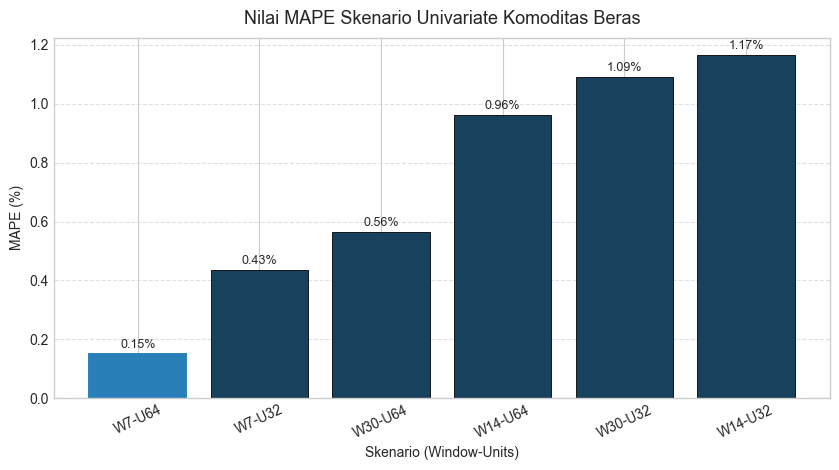

Plot Beras disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate\plot_univariate_Beras.png


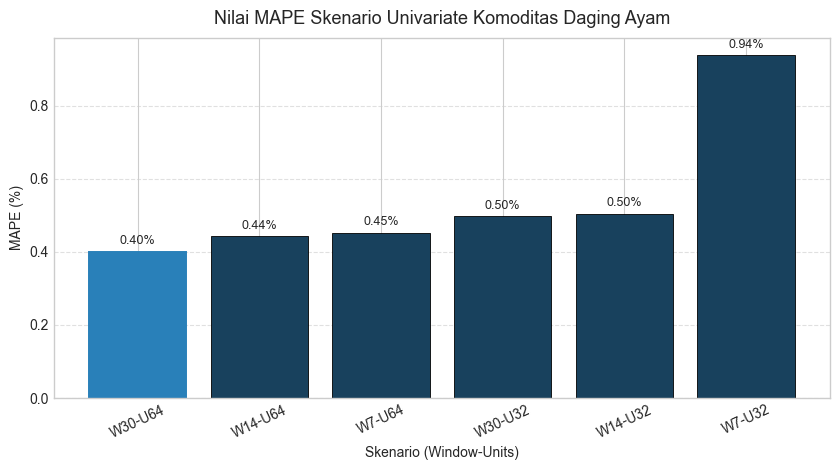

Plot Daging Ayam disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate\plot_univariate_Daging_Ayam.png


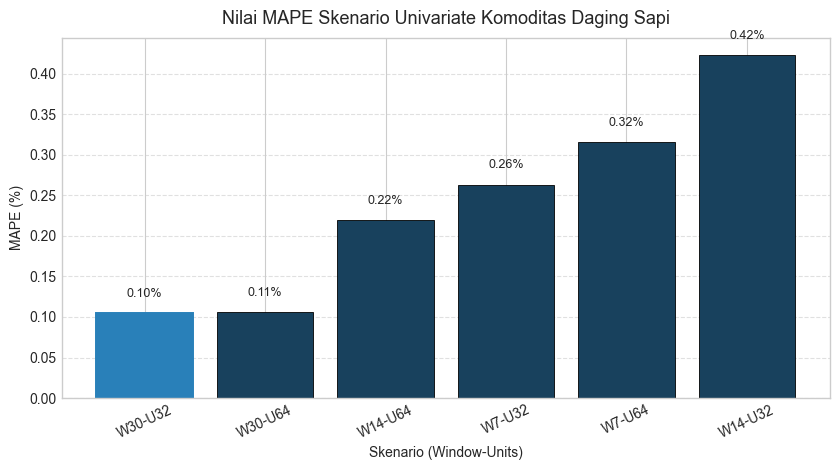

Plot Daging Sapi disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate\plot_univariate_Daging_Sapi.png


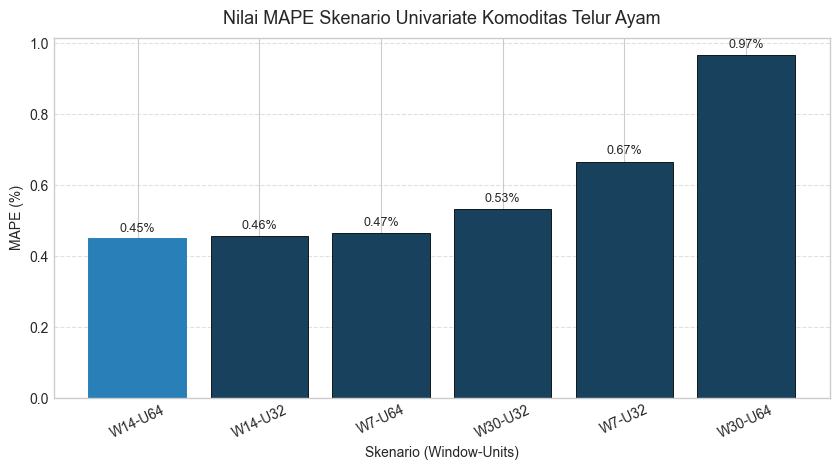

Plot Telur Ayam disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate\plot_univariate_Telur_Ayam.png


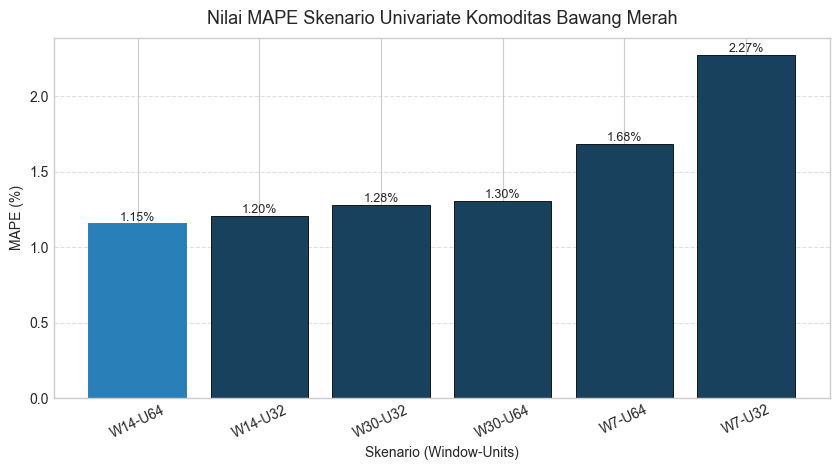

Plot Bawang Merah disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate\plot_univariate_Bawang_Merah.png


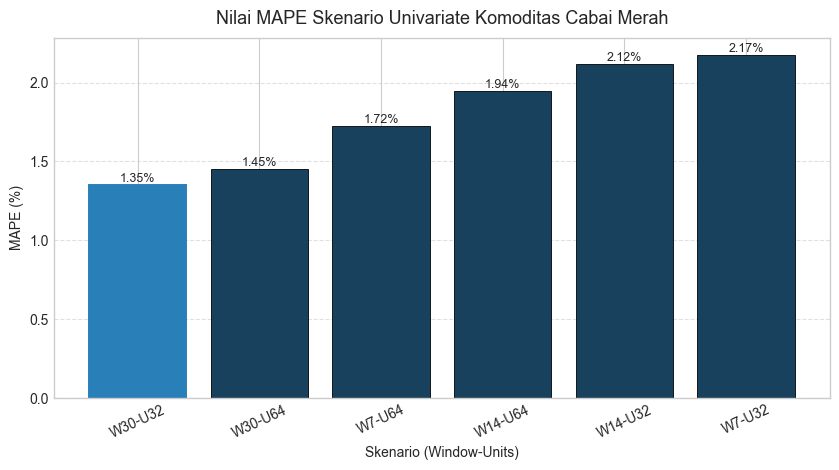

Plot Cabai Merah disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate\plot_univariate_Cabai_Merah.png


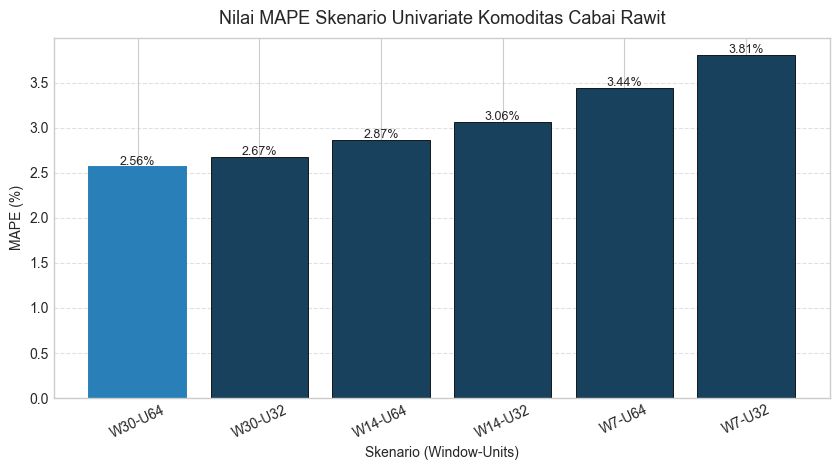

Plot Cabai Rawit disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate\plot_univariate_Cabai_Rawit.png


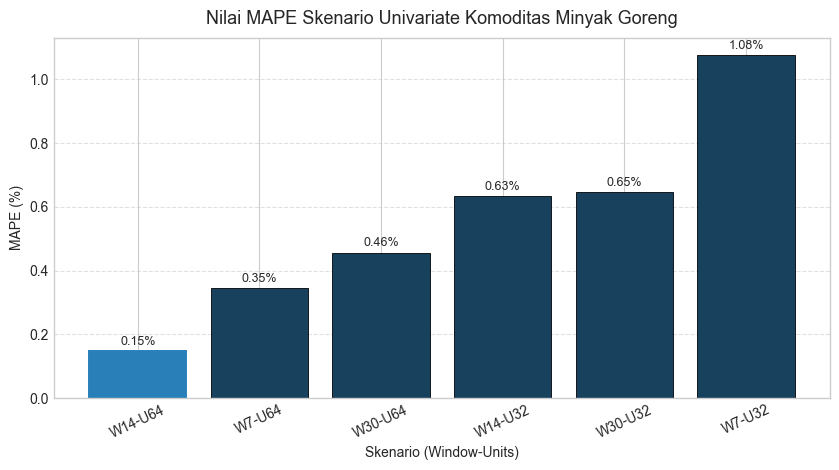

Plot Minyak Goreng disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate\plot_univariate_Minyak_Goreng.png


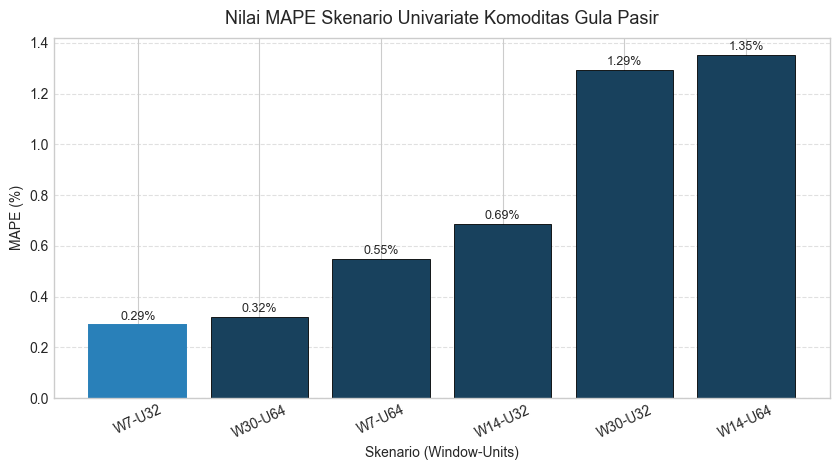

Plot Gula Pasir disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate\plot_univariate_Gula_Pasir.png


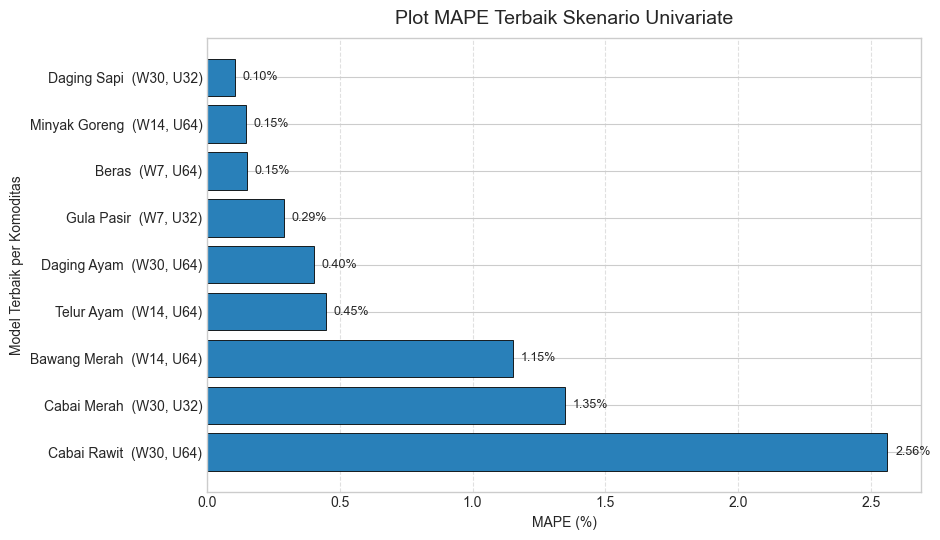


Plot ranking best model disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate\ranking_best_univariate_semua_komoditas.png

Selesai menampilkan rekap UNIVARIATE + menyimpan summary.


In [11]:
# Rekap Hasil UNIVARIATE

import os
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import display

plt.style.use("seaborn-v0_8-whitegrid")

# ----------------------------------------------------------
# Daftar komoditas
# ----------------------------------------------------------
komoditas_list = [
    "Beras",
    "Daging Ayam",
    "Daging Sapi",
    "Telur Ayam",
    "Bawang Merah",
    "Cabai Merah",
    "Cabai Rawit",
    "Minyak Goreng",
    "Gula Pasir"
]

# ----------------------------------------------------------
# Folder hasil univariate (sumber)
# ----------------------------------------------------------
base_uni = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate"

# ----------------------------------------------------------
# Folder summary output (baru)
# ----------------------------------------------------------
summary_folder = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_univariate"
os.makedirs(summary_folder, exist_ok=True)

df_list = []
print("Mengambil seluruh hasil UNIVARIATE...\n")

# ----------------------------------------------------------
# 1) Baca semua CSV hasil per komoditas
# ----------------------------------------------------------
for kom in komoditas_list:
    folder_kom = os.path.join(base_uni, kom.replace(" ", "_"))
    csv_path = os.path.join(folder_kom, f"hasil_univariate_{kom.replace(' ', '_')}.csv")

    if os.path.exists(csv_path):
        df_temp = pd.read_csv(csv_path)
        df_list.append(df_temp)
        print(f"✓ {kom}")
    else:
        print(f"✗ SKIP (tidak ditemukan): {kom}")

if len(df_list) == 0:
    print("\nTidak ada hasil univariate ditemukan.")
    raise SystemExit()

# ----------------------------------------------------------
# 2) Gabungkan semua hasil
# ----------------------------------------------------------
df_uni = pd.concat(df_list, ignore_index=True)

kolom_urut = [
    "mode","komoditas","window","units","epochs","batch_size",
    "test_MAE","test_RMSE","test_MAPE","forecast_MAPE_Okt2025"
]
kolom_urut = [c for c in kolom_urut if c in df_uni.columns]
df_uni = df_uni[kolom_urut]

print("\n=== TABEL HASIL UNIVARIATE SEMUA SKENARIO ===")
display(df_uni)

# ===== simpan CSV semua skenario =====
path_all_csv = os.path.join(summary_folder, "rekap_univariate_semua_skenario.csv")
df_uni.to_csv(path_all_csv, index=False)
print(f"\nCSV semua skenario disimpan di: {path_all_csv}")

# ----------------------------------------------------------
# 3) BEST model UNIVARIATE per komoditas
# ----------------------------------------------------------
best_uni = (
    df_uni.loc[df_uni.groupby("komoditas")["test_MAPE"].idxmin()]
    .reset_index(drop=True)
    .sort_values("test_MAPE")
)

print("\n=== TABEL MAPE TERBAIK SKENARIO UNIVARIATE PER KOMODITAS ===")
display(best_uni)

# ===== simpan CSV best per komoditas =====
path_best_csv = os.path.join(summary_folder, "rekap_univariate_best_per_komoditas.csv")
best_uni.to_csv(path_best_csv, index=False)
print(f"\nCSV best per komoditas disimpan di: {path_best_csv}")

# ==========================================================
# 4) PLOT PER KOMODITAS (SEMUA SKENARIO + HIGHLIGHT BEST)
#    + SIMPAN GAMBAR
# ==========================================================
print("\nMembuat plot per komoditas...\n")

for kom in komoditas_list:
    df_k = df_uni[df_uni["komoditas"] == kom].copy()
    if df_k.empty:
        continue

    df_k["label_skenario"] = df_k.apply(
        lambda r: f"W{int(r['window'])}-U{int(r['units'])}",
        axis=1
    )

    df_k = df_k.sort_values("test_MAPE")
    idx_best = df_k["test_MAPE"].idxmin()

    plt.figure(figsize=(8.5, 4.8))
    bars = plt.bar(
        df_k["label_skenario"],
        df_k["test_MAPE"],
        color="#18415d",
        edgecolor="black",
        linewidth=0.6
    )

    # highlight terbaik
    bars[list(df_k.index).index(idx_best)].set_color("#2980b9")
    bars[list(df_k.index).index(idx_best)].set_linewidth(1.4)

    # anotasi angka
    for i, v in enumerate(df_k["test_MAPE"]):
        plt.text(i, v + 0.02, f"{v:.2f}%", ha="center", fontsize=9)

    plt.title(f"Nilai MAPE Skenario Univariate Komoditas {kom}", fontsize=13, pad=10)
    plt.xlabel("Skenario (Window-Units)")
    plt.ylabel("MAPE (%)")
    plt.xticks(rotation=25)
    plt.grid(axis="y", linestyle="--", alpha=0.6)
    plt.tight_layout()

    # ===== simpan plot per komoditas =====
    plot_path = os.path.join(summary_folder, f"plot_univariate_{kom.replace(' ', '_')}.png")
    plt.savefig(plot_path, dpi=160, bbox_inches="tight")
    plt.show()
    plt.close()

    print(f"Plot {kom} disimpan → {plot_path}")

# ==========================================================
# 5) PLOT RANKING BEST MODEL ANTAR KOMODITAS
#    + SIMPAN GAMBAR
# ==========================================================
best_rank = best_uni.copy()
best_rank["label"] = best_rank.apply(
    lambda r: f"{r['komoditas']}  (W{int(r['window'])}, U{int(r['units'])})",
    axis=1
)

plt.figure(figsize=(9.5, 5.5))
bars = plt.barh(
    best_rank["label"],
    best_rank["test_MAPE"],
    color="#2980b9",
    edgecolor="black",
    linewidth=0.6
)

for p in bars:
    w = p.get_width()
    y = p.get_y() + p.get_height()/2
    plt.text(w + 0.03, y, f"{w:.2f}%", va="center", fontsize=9)

plt.title("Plot MAPE Terbaik Skenario Univariate", fontsize=14, pad=10)
plt.xlabel("MAPE (%)")
plt.ylabel("Model Terbaik per Komoditas")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.gca().invert_yaxis()
plt.tight_layout()

# ===== simpan plot ranking =====
rank_plot_path = os.path.join(summary_folder, "ranking_best_univariate_semua_komoditas.png")
plt.savefig(rank_plot_path, dpi=170, bbox_inches="tight")
plt.show()
plt.close()

print(f"\nPlot ranking best model disimpan → {rank_plot_path}")
print("\nSelesai menampilkan rekap UNIVARIATE + menyimpan summary.")


Mengambil seluruh hasil MULTIVARIATE...

✓ Beras
✓ Daging Ayam
✓ Daging Sapi
✓ Telur Ayam
✓ Bawang Merah
✓ Cabai Merah
✓ Cabai Rawit
✓ Minyak Goreng
✓ Gula Pasir

=== TABEL HASIL MULTIVARIATE (SEMUA SKENARIO) ===


,mode,komoditas,window,units,epochs,batch_size,test_MAE,test_RMSE,test_MAPE,forecast_MAPE_Okt2025
0,multivariate,Beras,7,32,150,32,409.708433,431.447544,3.166791,12.249806
1,multivariate,Beras,7,64,150,32,429.888300,446.518376,3.325811,14.473988
2,multivariate,Beras,14,32,150,32,346.940203,369.259210,2.677390,12.469414
3,multivariate,Beras,14,64,150,32,172.039803,196.516574,1.324870,8.440716
4,multivariate,Beras,30,32,150,32,393.812861,410.102464,3.037514,13.940840
5,multivariate,Beras,30,64,150,32,279.213652,302.368955,2.149266,11.397332
6,multivariate,Daging Ayam,7,32,150,32,240.620717,447.744726,0.767336,1.406450
7,multivariate,Daging Ayam,7,64,150,32,259.652693,440.737607,0.805586,5.382493
8,multivariate,Daging Ayam,14,32,150,32,321.568248,544.217214,1.036919,4.479315
9,multivariate,Daging Ayam,14,64,150,32,315.250722,481.750776,1.005992,1.382767



CSV semua skenario disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate\rekap_multivariate_semua_skenario.csv

=== TABEL MAPE TERBAIK SKENARIO MULTIVARIATE PER KOMODITAS ===


,mode,komoditas,window,units,epochs,batch_size,test_MAE,test_RMSE,test_MAPE,forecast_MAPE_Okt2025
6,multivariate,Gula Pasir,7,64,150,32,37.970752,56.349420,0.258410,1.838006
7,multivariate,Minyak Goreng,14,64,150,32,43.545954,78.913670,0.323357,1.089697
5,multivariate,Daging Sapi,30,64,150,32,571.550200,650.441385,0.471595,3.019322
4,multivariate,Daging Ayam,7,32,150,32,240.620717,447.744726,0.767336,1.406450
8,multivariate,Telur Ayam,7,64,150,32,269.360513,402.628814,1.142145,5.740997
1,multivariate,Beras,14,64,150,32,172.039803,196.516574,1.324870,8.440716
0,multivariate,Bawang Merah,14,64,150,32,451.346092,1193.543377,1.656259,15.201997
2,multivariate,Cabai Merah,14,32,150,32,971.645471,1720.938563,4.263598,14.619273
3,multivariate,Cabai Rawit,30,32,150,32,1231.779983,2533.389884,4.903611,25.384322


CSV best per komoditas disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate\rekap_multivariate_best_per_komoditas.csv

Membuat plot per komoditas...



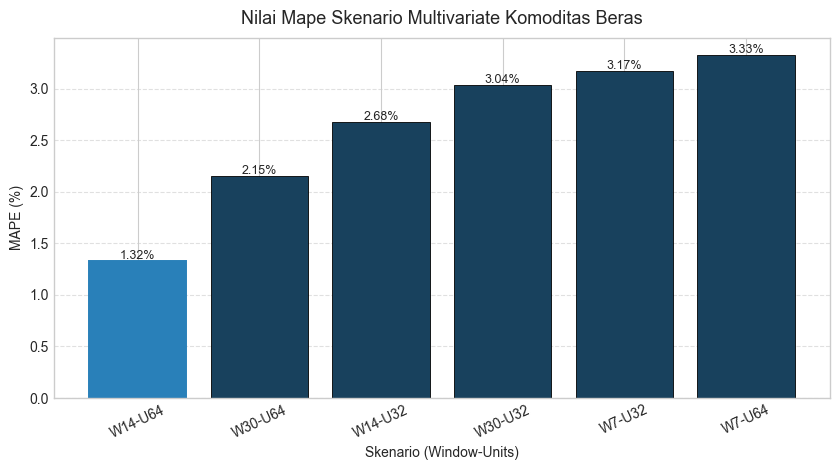

Plot Beras disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate\plot_multivariate_Beras.png


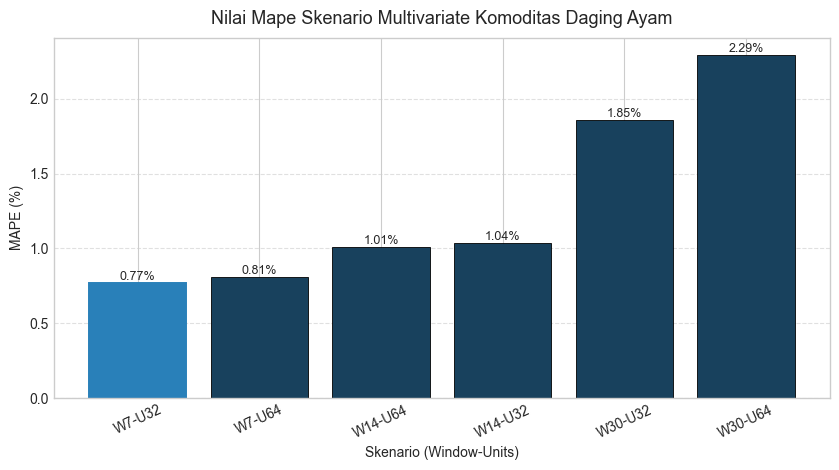

Plot Daging Ayam disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate\plot_multivariate_Daging_Ayam.png


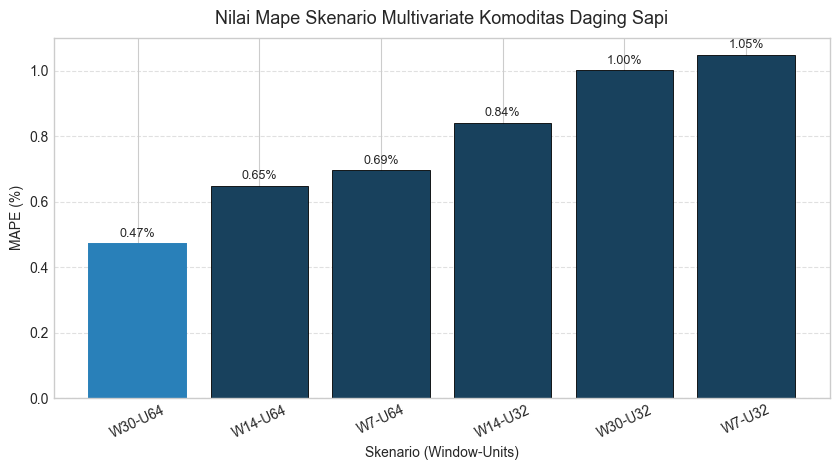

Plot Daging Sapi disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate\plot_multivariate_Daging_Sapi.png


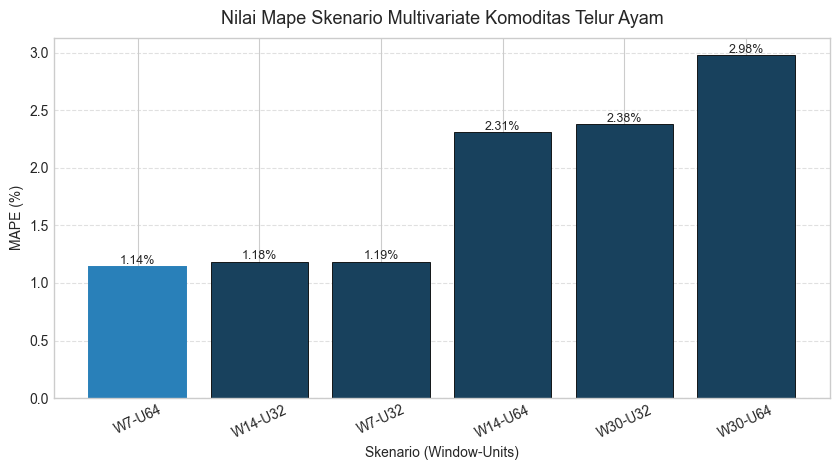

Plot Telur Ayam disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate\plot_multivariate_Telur_Ayam.png


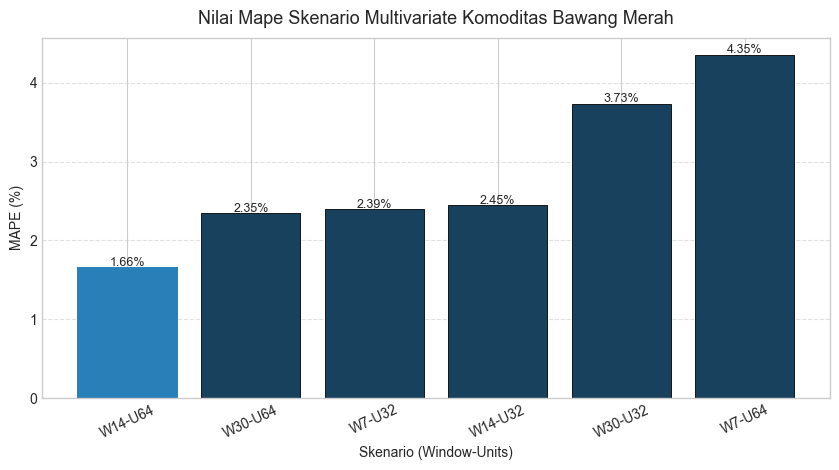

Plot Bawang Merah disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate\plot_multivariate_Bawang_Merah.png


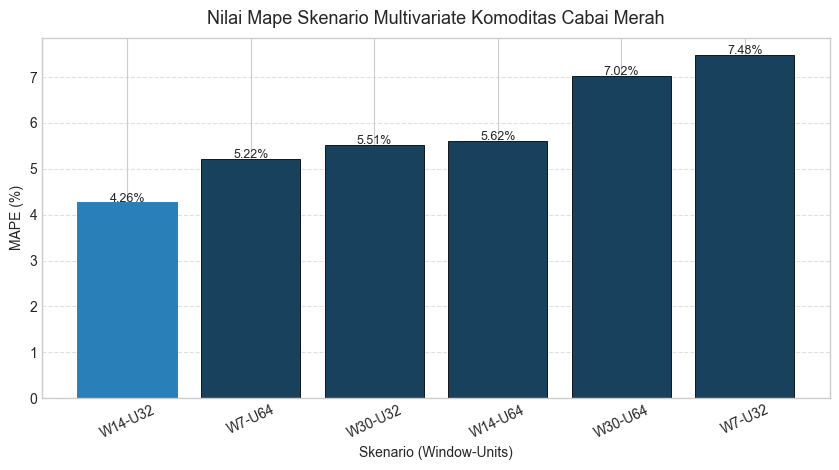

Plot Cabai Merah disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate\plot_multivariate_Cabai_Merah.png


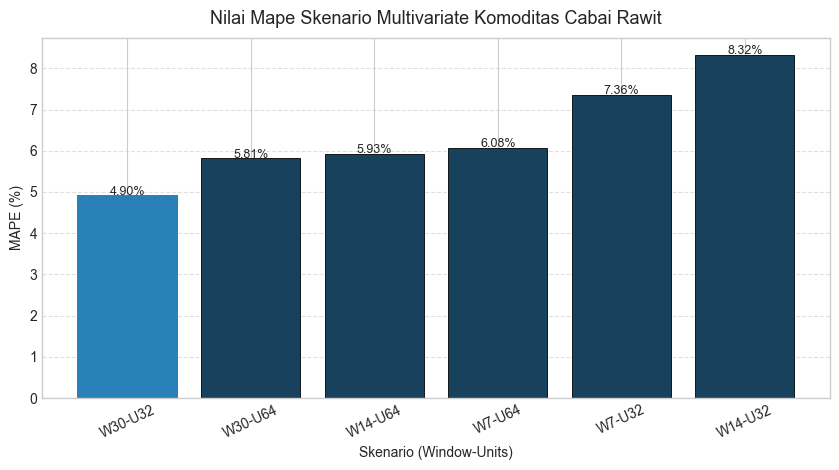

Plot Cabai Rawit disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate\plot_multivariate_Cabai_Rawit.png


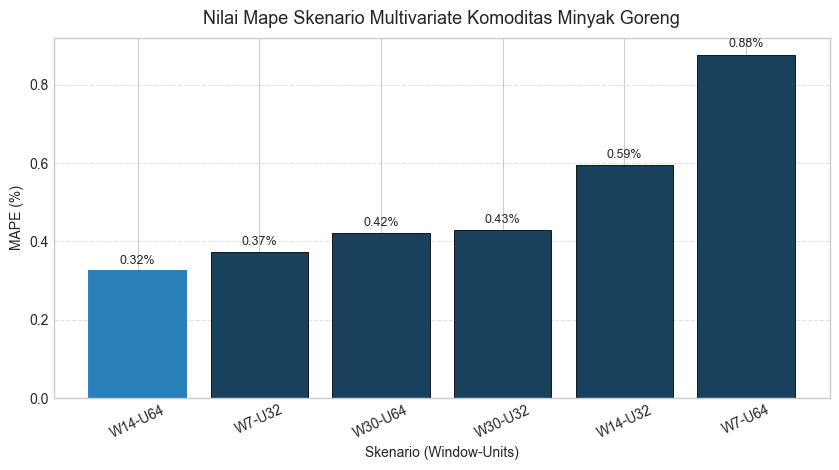

Plot Minyak Goreng disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate\plot_multivariate_Minyak_Goreng.png


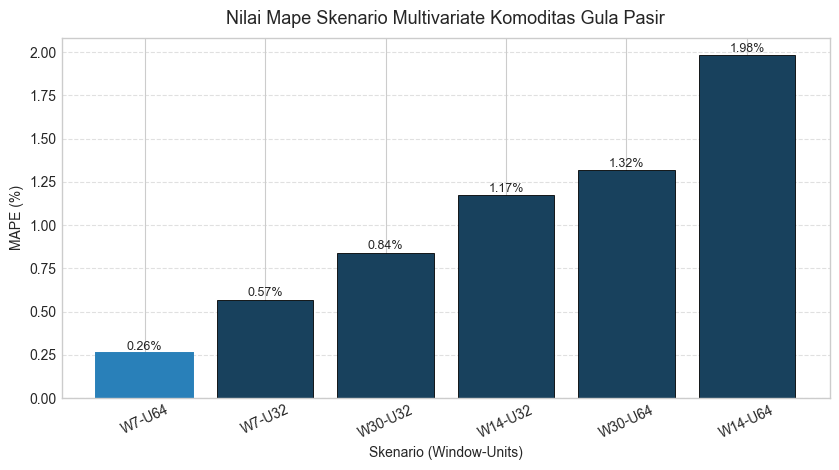

Plot Gula Pasir disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate\plot_multivariate_Gula_Pasir.png


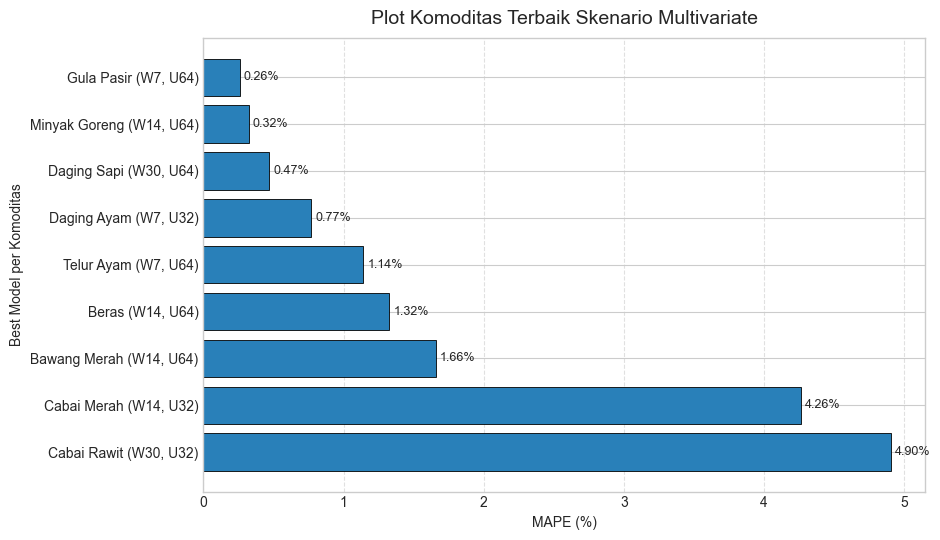


Plot ranking best model disimpan → C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate\ranking_best_multivariate_semua_komoditas.png

Selesai menampilkan dan menyimpan summary MULTIVARIATE.


In [2]:
# Rekap Hasil MULTIVARIATE

import os
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import display

plt.style.use("seaborn-v0_8-whitegrid")

# ----------------------------------------------------------
# Daftar komoditas
# ----------------------------------------------------------
komoditas_list = [
    "Beras", "Daging Ayam", "Daging Sapi", "Telur Ayam",
    "Bawang Merah", "Cabai Merah", "Cabai Rawit",
    "Minyak Goreng", "Gula Pasir"
]

# ----------------------------------------------------------
# Folder sumber multivariate
# ----------------------------------------------------------
base_multi = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate"

# ----------------------------------------------------------
# Folder output summary multivariate (BARU)
# ----------------------------------------------------------
summary_multi = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_multivariate"
os.makedirs(summary_multi, exist_ok=True)

df_list = []
print("Mengambil seluruh hasil MULTIVARIATE...\n")

# ----------------------------------------------------------
# 1) Baca semua CSV hasil per komoditas
# ----------------------------------------------------------
for kom in komoditas_list:
    folder_kom = os.path.join(base_multi, kom.replace(" ", "_"))
    csv_path = os.path.join(folder_kom, f"hasil_multivariate_{kom.replace(' ', '_')}.csv")

    if os.path.exists(csv_path):
        df_temp = pd.read_csv(csv_path)
        df_list.append(df_temp)
        print(f"✓ {kom}")
    else:
        print(f"✗ SKIP (tidak ditemukan): {kom}")

if len(df_list) == 0:
    print("\nTidak ada hasil multivariate ditemukan.")
    raise SystemExit()

# ----------------------------------------------------------
# 2) Gabungkan semua hasil
# ----------------------------------------------------------
df_multi = pd.concat(df_list, ignore_index=True)

kolom_urut = [
    "mode","komoditas","window","units","epochs","batch_size",
    "test_MAE","test_RMSE","test_MAPE","forecast_MAPE_Okt2025"
]
kolom_urut = [c for c in kolom_urut if c in df_multi.columns]
df_multi = df_multi[kolom_urut]

print("\n=== TABEL HASIL MULTIVARIATE (SEMUA SKENARIO) ===")
display(df_multi)

# ===== Simpan CSV semua skenario =====
csv_all = os.path.join(summary_multi, "rekap_multivariate_semua_skenario.csv")
df_multi.to_csv(csv_all, index=False)
print(f"\nCSV semua skenario disimpan → {csv_all}")

# ----------------------------------------------------------
# 3) Best model multivariate per komoditas
# ----------------------------------------------------------
best_multi = (
    df_multi.loc[df_multi.groupby("komoditas")["test_MAPE"].idxmin()]
    .reset_index(drop=True)
    .sort_values("test_MAPE")
)

print("\n=== TABEL MAPE TERBAIK SKENARIO MULTIVARIATE PER KOMODITAS ===")
display(best_multi)

# ===== Simpan CSV best per komoditas =====
csv_best = os.path.join(summary_multi, "rekap_multivariate_best_per_komoditas.csv")
best_multi.to_csv(csv_best, index=False)
print(f"CSV best per komoditas disimpan → {csv_best}")

# ==========================================================
# 4) PLOT PER KOMODITAS (Semua skenario + highlight best)
#    DAN SIMPAN
# ==========================================================

print("\nMembuat plot per komoditas...\n")

for kom in komoditas_list:

    df_k = df_multi[df_multi["komoditas"] == kom].copy()
    if df_k.empty:
        continue

    df_k["label_skenario"] = df_k.apply(lambda r: f"W{int(r['window'])}-U{int(r['units'])}", axis=1)
    df_k = df_k.sort_values("test_MAPE").reset_index(drop=True)
    idx_best = df_k["test_MAPE"].idxmin()

    plt.figure(figsize=(8.5, 4.8))
    bars = plt.bar(
        df_k["label_skenario"],
        df_k["test_MAPE"],
        color="#18415d",
        edgecolor="black",
        linewidth=0.6
    )

    # Highlight best scenario
    bars[idx_best].set_color("#2980b9")
    bars[idx_best].set_linewidth(1.4)

    for i, v in enumerate(df_k["test_MAPE"]):
        plt.text(i, v + 0.02, f"{v:.2f}%", ha="center", fontsize=9)

    plt.title(f"Nilai Mape Skenario Multivariate Komoditas {kom}", fontsize=13, pad=10)
    plt.xlabel("Skenario (Window-Units)")
    plt.ylabel("MAPE (%)")
    plt.xticks(rotation=25)
    plt.grid(axis="y", linestyle="--", alpha=0.6)
    plt.tight_layout()

    # ===== SIMPAN PLOT =====
    plot_path = os.path.join(summary_multi, f"plot_multivariate_{kom.replace(' ', '_')}.png")
    plt.savefig(plot_path, dpi=160, bbox_inches="tight")
    plt.show()
    plt.close()

    print(f"Plot {kom} disimpan → {plot_path}")


# ==========================================================
# 5) PLOT RANKING BEST MODEL (SEMUA KOMODITAS)
#    DAN SIMPAN
# ==========================================================

best_rank = best_multi.copy()
best_rank["label"] = best_rank.apply(
    lambda r: f"{r['komoditas']} (W{int(r['window'])}, U{int(r['units'])})",
    axis=1
)

plt.figure(figsize=(9.5, 5.5))
bars = plt.barh(
    best_rank["label"],
    best_rank["test_MAPE"],
    color="#2980b9",
    edgecolor="black",
    linewidth=0.6
)

# Label angka
for p in bars:
    w = p.get_width()
    y = p.get_y() + p.get_height()/2
    plt.text(w + 0.03, y, f"{w:.2f}%", va="center", fontsize=9)

plt.title("Plot Komoditas Terbaik Skenario Multivariate", fontsize=14, pad=10)
plt.xlabel("MAPE (%)")
plt.ylabel("Best Model per Komoditas")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.gca().invert_yaxis()
plt.tight_layout()

# ==== SIMPAN PLOT ====
rank_plot = os.path.join(summary_multi, "ranking_best_multivariate_semua_komoditas.png")
plt.savefig(rank_plot, dpi=170, bbox_inches="tight")
plt.show()
plt.close()

print(f"\nPlot ranking best model disimpan → {rank_plot}")
print("\nSelesai menampilkan dan menyimpan summary MULTIVARIATE.")


Mengambil hasil UNIVARIATE dan MULTIVARIATE...

✓ Uni  : Beras
✓ Multi: Beras
✓ Uni  : Daging Ayam
✓ Multi: Daging Ayam
✓ Uni  : Daging Sapi
✓ Multi: Daging Sapi
✓ Uni  : Telur Ayam
✓ Multi: Telur Ayam
✓ Uni  : Bawang Merah
✓ Multi: Bawang Merah
✓ Uni  : Cabai Merah
✓ Multi: Cabai Merah
✓ Uni  : Cabai Rawit
✓ Multi: Cabai Rawit
✓ Uni  : Minyak Goreng
✓ Multi: Minyak Goreng
✓ Uni  : Gula Pasir
✓ Multi: Gula Pasir

=== TABEL HASIL SEMUA SKENARIO ===


,mode,komoditas,window,units,epochs,batch_size,test_MAE,test_RMSE,test_MAPE,forecast_MAPE_Okt2025
0,univariate,Beras,7,32,150,32,56.202001,74.270245,0.434243,2.744910
1,univariate,Beras,7,64,150,32,19.631177,60.431223,0.149394,0.671125
2,univariate,Beras,14,32,150,32,150.873718,164.530599,1.165841,8.638374
3,univariate,Beras,14,64,150,32,124.349665,137.457711,0.961507,8.003234
4,univariate,Beras,30,32,150,32,141.515540,155.959875,1.091419,8.047422
...,...,...,...,...,...,...,...,...,...,...
103,multivariate,Gula Pasir,7,64,150,32,37.970752,56.349420,0.258410,1.838006
104,multivariate,Gula Pasir,14,32,150,32,172.102780,179.082717,1.171272,3.691616
105,multivariate,Gula Pasir,14,64,150,32,291.278357,294.689192,1.982496,9.131183
106,multivariate,Gula Pasir,30,32,150,32,122.907913,129.749516,0.839014,1.049617


CSV gabungan disimpan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_all\hasil_semua_skenario_gabungan.csv

=== TABEL BEST FINAL PER KOMODITAS (UNI vs MULTI) ===


,mode,komoditas,window,units,epochs,batch_size,test_MAE,test_RMSE,test_MAPE,forecast_MAPE_Okt2025
5,univariate,Daging Sapi,30,32,150,32,127.271554,356.810927,0.104813,0.124186
7,univariate,Minyak Goreng,14,64,150,32,19.951445,70.164294,0.146413,0.020200
1,univariate,Beras,7,64,150,32,19.631177,60.431223,0.149394,0.671125
6,multivariate,Gula Pasir,7,64,150,32,37.970752,56.349420,0.258410,1.838006
4,univariate,Daging Ayam,30,64,150,32,127.719621,397.108956,0.400816,1.286120
8,univariate,Telur Ayam,14,64,150,32,108.254267,339.435220,0.447780,2.348121
0,univariate,Bawang Merah,14,64,150,32,306.615827,1172.930809,1.150714,2.764065
2,univariate,Cabai Merah,30,32,150,32,353.978395,1430.004316,1.348220,0.922022
3,univariate,Cabai Rawit,30,64,150,32,774.464613,2376.278886,2.562763,14.230699


CSV best final disimpan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_all\best_final_per_komoditas.csv

=== TABEL PERBANDINGAN SKENARIO UNIVARIATE TERBAIK & MULTIVARIATE TERBAIK ===


,komoditas,best_MAPE_univariate,best_window_univariate,best_units_univariate,best_MAPE_multivariate,best_window_multivariate,best_units_multivariate,selisih_multi_minus_uni,persen_perbaikan_multi
0,Beras,0.149394,7,64,1.324870,14,64,1.175476,-786.830489
1,Daging Ayam,0.400816,30,64,0.767336,7,32,0.366520,-91.443418
2,Daging Sapi,0.104813,30,32,0.471595,30,64,0.366782,-349.939419
3,Telur Ayam,0.447780,14,64,1.142145,7,64,0.694365,-155.068516
4,Bawang Merah,1.150714,14,64,1.656259,14,64,0.505545,-43.933156
5,Cabai Merah,1.348220,30,32,4.263598,14,32,2.915377,-216.238968
6,Cabai Rawit,2.562763,30,64,4.903611,30,32,2.340848,-91.340798
7,Minyak Goreng,0.146413,14,64,0.323357,14,64,0.176944,-120.852405
8,Gula Pasir,0.288885,7,32,0.258410,7,64,-0.030475,10.549176


CSV perbandingan disimpan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_all\perbandingan_best_uni_vs_multi.csv

Membuat plot perbandingan UNIVARIATE vs MULTIVARIATE (horizontal)...



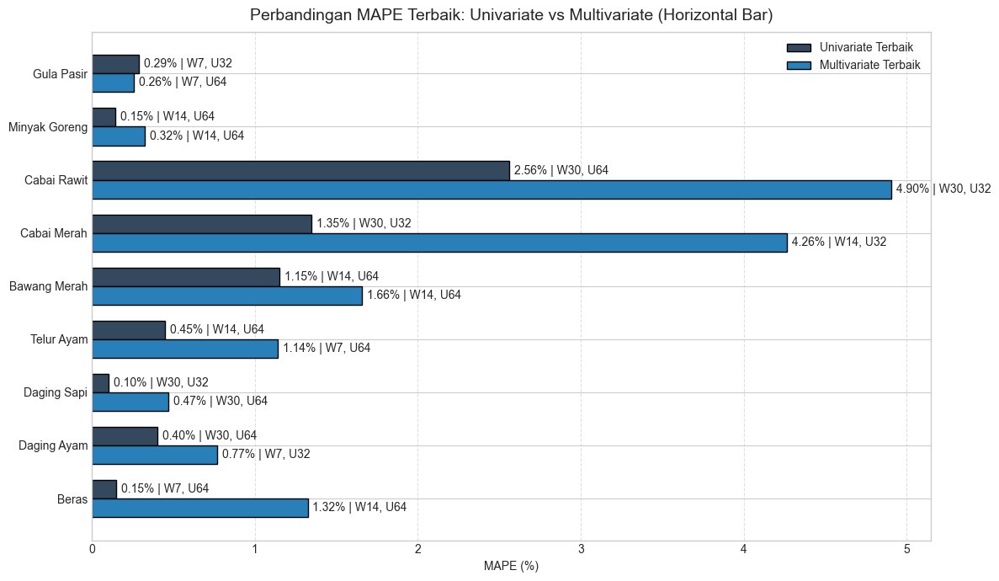

Plot horizontal uni vs multi tersimpan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_all\plot_perbandingan_univariate_vs_multivariate_horizontal.png

Membuat plot per komoditas (uni+multi)...



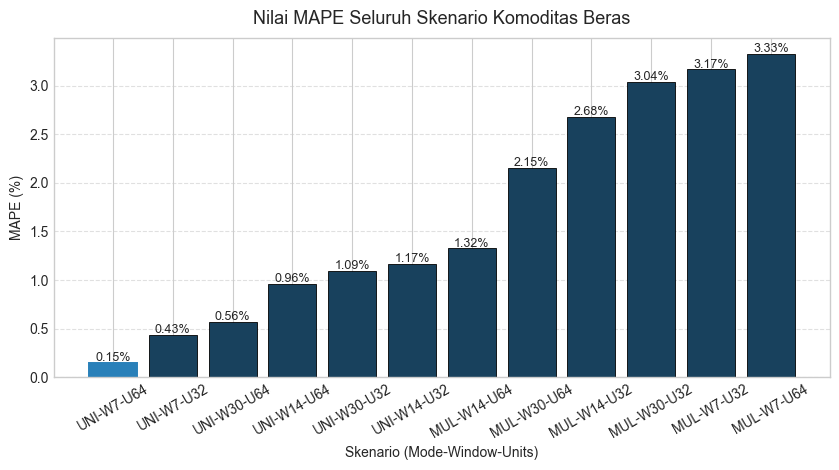

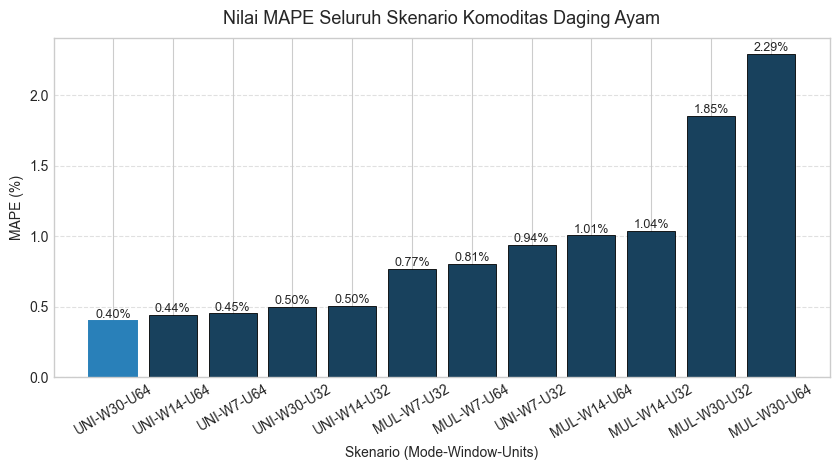

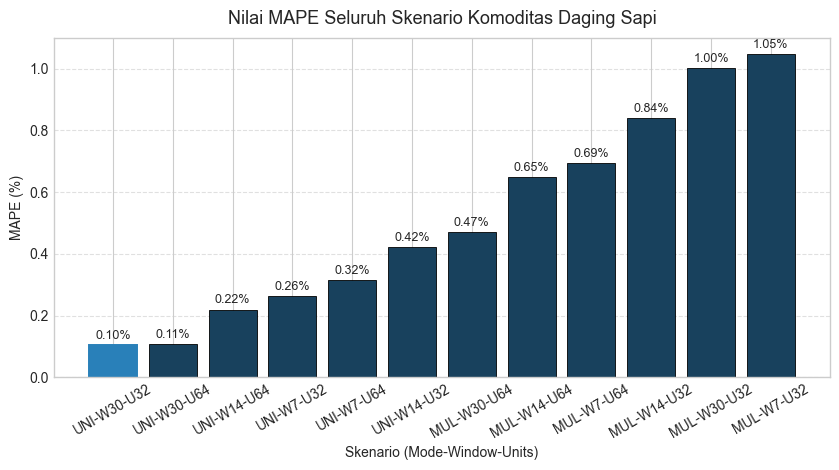

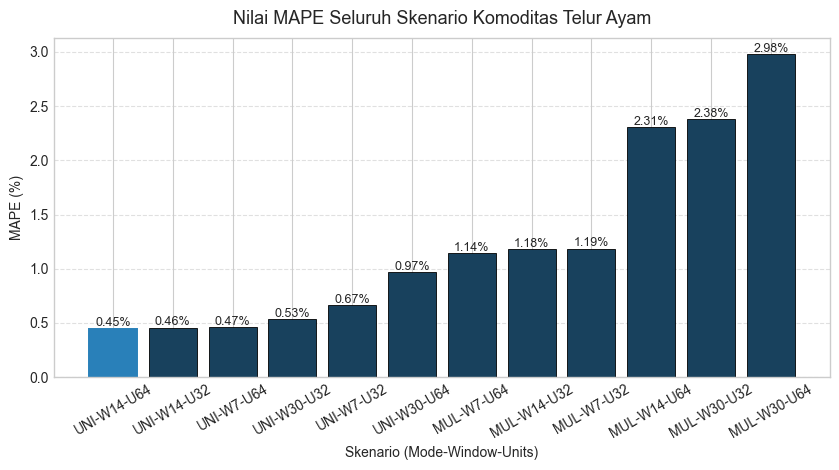

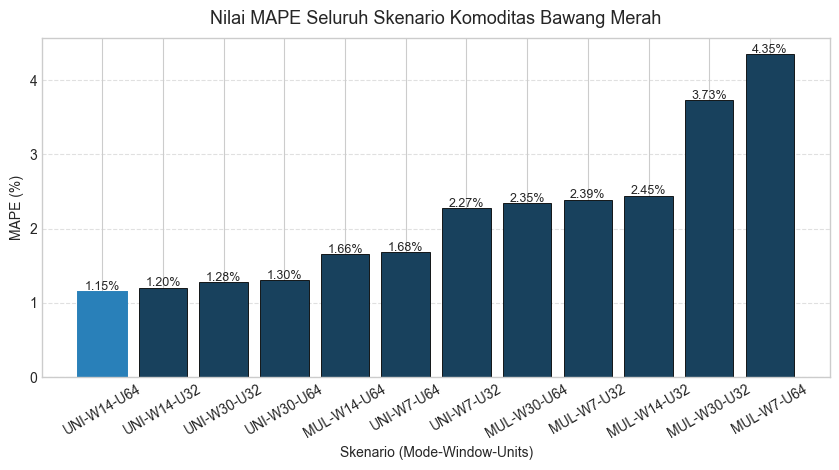

...

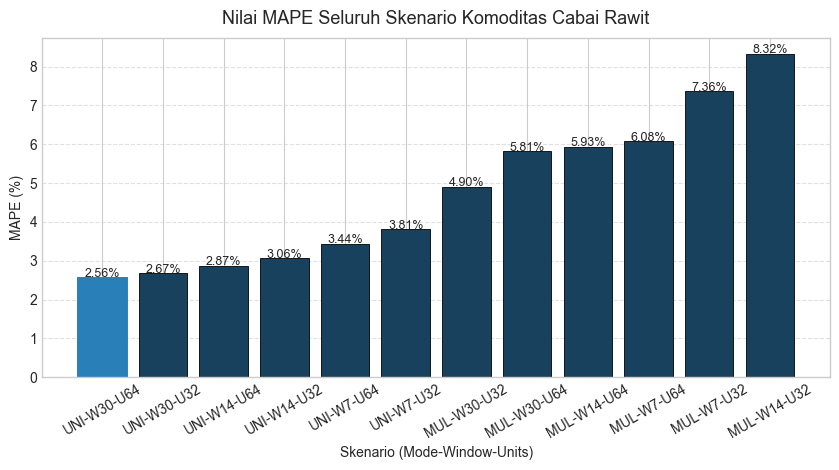

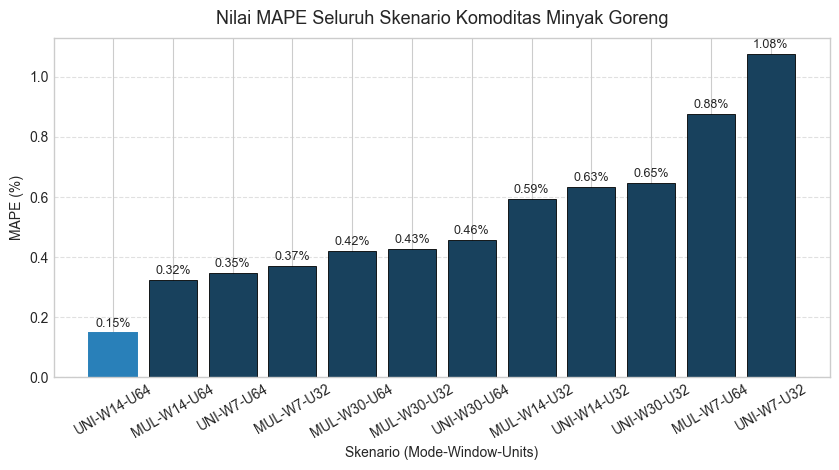

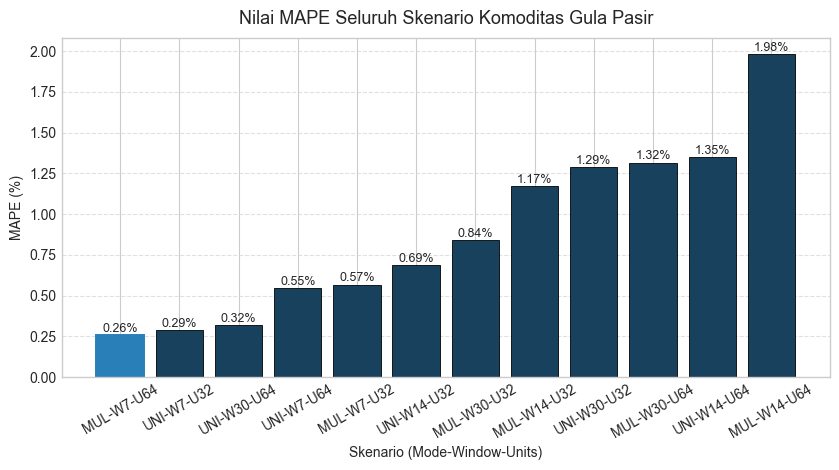

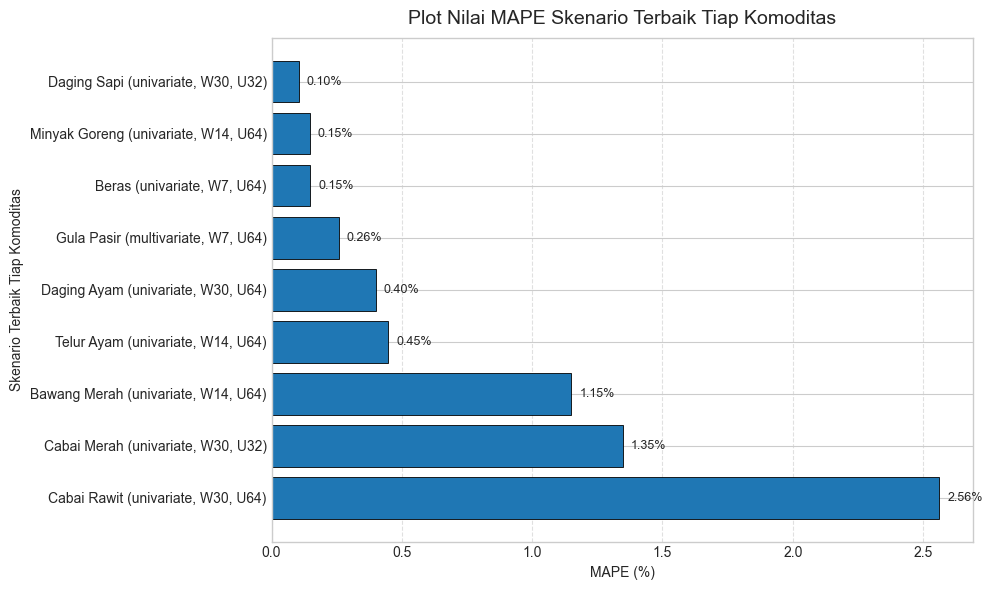

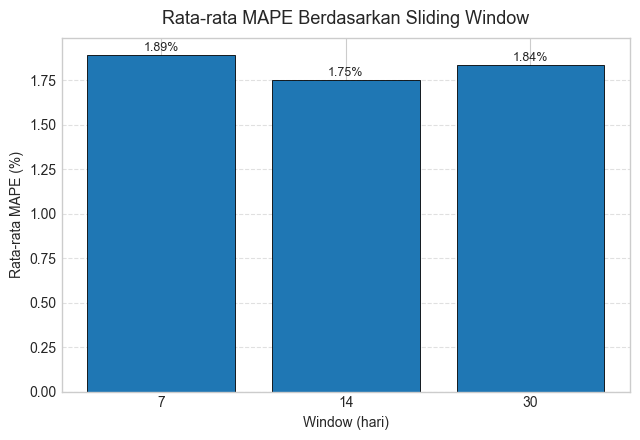

Plot rata-rata MAPE per window tersimpan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_all\avg_mape_per_window.png


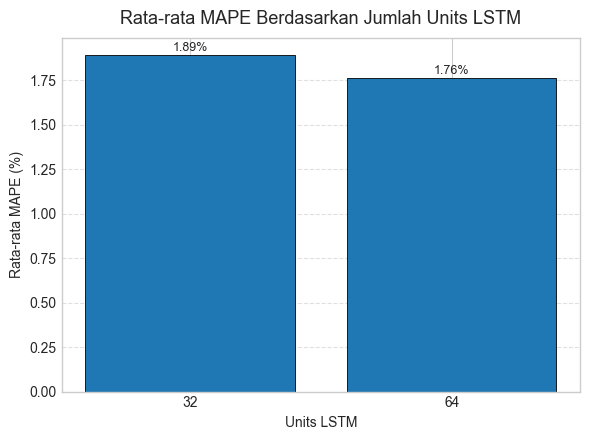

Plot rata-rata MAPE per units tersimpan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_all\avg_mape_per_units.png


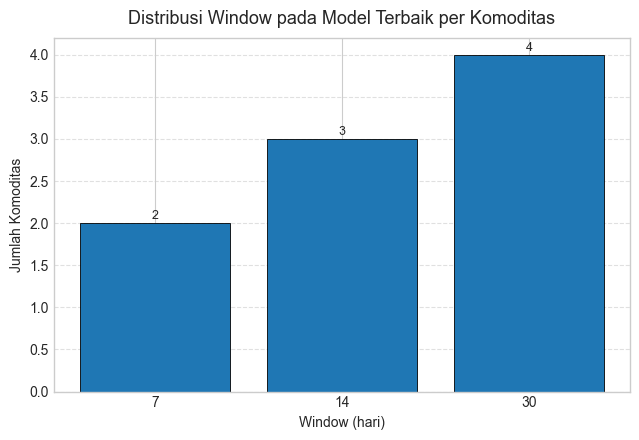

Plot distribusi window model terbaik tersimpan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_all\distribusi_window_model_terbaik.png


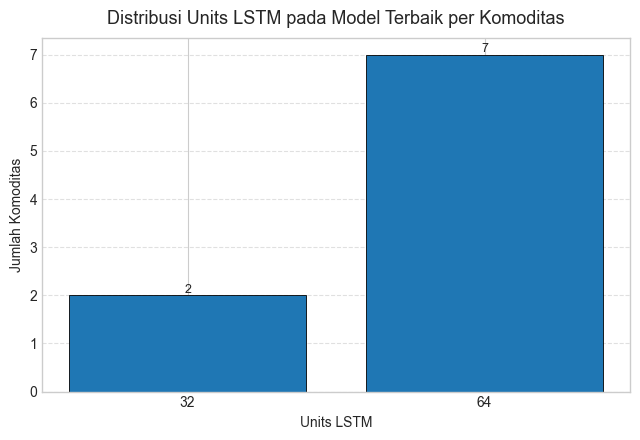

Plot distribusi units model terbaik tersimpan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_all\distribusi_units_model_terbaik.png

=== TABEL RANGKUMAN SKENARIO UNIVARIATE (MAPE) ===


,W7-U32,W7-U64,W14-U32,W14-U64,W30-U32,W30-U64
komoditas,,,,,,
Beras,0.434243,0.149394,1.165841,0.961507,1.091419,0.563738
Daging Ayam,0.938658,0.452520,0.504892,0.442462,0.497975,0.400816
Daging Sapi,0.263025,0.315111,0.422806,0.219172,0.104813,0.106336
Telur Ayam,0.666496,0.465923,0.457125,0.447780,0.532315,0.966509
Bawang Merah,2.272847,1.684488,1.204666,1.150714,1.279315,1.303253
Cabai Merah,2.174706,1.722697,2.116813,1.944887,1.348220,1.449742
Cabai Rawit,3.806653,3.442419,3.062680,2.866758,2.672043,2.562763
Minyak Goreng,1.076007,0.345507,0.632459,0.146413,0.645555,0.455904
Gula Pasir,0.288885,0.547393,0.685715,1.351555,1.290816,0.320442


Tabel rangkuman skenario univariate disimpan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_all\tabel_rangkuman_skenario_univariate.csv

=== TABEL RANGKUMAN SKENARIO MULTIVARIATE (MAPE) ===


,W7-U32,W7-U64,W14-U32,W14-U64,W30-U32,W30-U64
komoditas,,,,,,
Beras,3.166791,3.325811,2.677390,1.324870,3.037514,2.149266
Daging Ayam,0.767336,0.805586,1.036919,1.005992,1.854833,2.291445
Daging Sapi,1.047495,0.694976,0.840803,0.648318,1.000674,0.471595
Telur Ayam,1.186319,1.142145,1.184312,2.308322,2.382494,2.980674
Bawang Merah,2.393161,4.352353,2.446975,1.656259,3.733622,2.345827
Cabai Merah,7.482337,5.215144,4.263598,5.615257,5.512164,7.022623
Cabai Rawit,7.358238,6.075997,8.322640,5.931595,4.903611,5.814701
Minyak Goreng,0.371926,0.875640,0.594012,0.323357,0.427980,0.420349
Gula Pasir,0.567700,0.258410,1.171272,1.982496,0.839014,1.316490


Tabel rangkuman skenario multivariate disimpan: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_all\tabel_rangkuman_skenario_multivariate.csv

Selesai membuat rekap summary_all.
Semua tabel & plot tersimpan di: C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_all


In [5]:
# ==========================================================
# CELL — Rekap SELURUH SKENARIO (UNIVARIATE + MULTIVARIATE)
# Tabel Gabungan + Best Final + Perbandingan + Plot
# Save ke summary_all
# + Plot rata-rata MAPE per window & per units
# ==========================================================

import os
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import display

plt.style.use("seaborn-v0_8-whitegrid")

# ----------------------------------------------------------
# 0) Daftar komoditas
# ----------------------------------------------------------
komoditas_list = [
    "Beras",
    "Daging Ayam",
    "Daging Sapi",
    "Telur Ayam",
    "Bawang Merah",
    "Cabai Merah",
    "Cabai Rawit",
    "Minyak Goreng",
    "Gula Pasir"
]

# ----------------------------------------------------------
# 1) Path sumber hasil
# ----------------------------------------------------------
base_uni   = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\univariate"
base_multi = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\multivariate"

# ----------------------------------------------------------
# 2) Folder output summary_all
# ----------------------------------------------------------
base_out = r"C:\kuliah\SEMESTER 7\Project Skripsi\Prediksi Harga Komoditas Pangan LSTM Project - 150\result\summary_all"
os.makedirs(base_out, exist_ok=True)

print("Mengambil hasil UNIVARIATE dan MULTIVARIATE...\n")

df_uni_list = []
df_multi_list = []

# ----------------------------------------------------------
# 3) Baca semua CSV Univariate & Multivariate per komoditas
# ----------------------------------------------------------
for kom in komoditas_list:
    kom_folder = kom.replace(" ", "_")

    # ----- univariate -----
    path_u = os.path.join(base_uni, kom_folder, f"hasil_univariate_{kom_folder}.csv")
    if os.path.exists(path_u):
        df_u = pd.read_csv(path_u)
        df_uni_list.append(df_u)
        print(f"✓ Uni  : {kom}")
    else:
        print(f"✗ Uni  SKIP: {kom} (file tidak ditemukan)")

    # ----- multivariate -----
    path_m = os.path.join(base_multi, kom_folder, f"hasil_multivariate_{kom_folder}.csv")
    if os.path.exists(path_m):
        df_m = pd.read_csv(path_m)
        df_multi_list.append(df_m)
        print(f"✓ Multi: {kom}")
    else:
        print(f"✗ Multi SKIP: {kom} (file tidak ditemukan)")

# stop kalau data kosong
if (len(df_uni_list) == 0) and (len(df_multi_list) == 0):
    print("\nTidak ada hasil yang ditemukan sama sekali.")
    raise SystemExit()

# gabung
df_uni   = pd.concat(df_uni_list, ignore_index=True) if len(df_uni_list)>0 else pd.DataFrame()
df_multi = pd.concat(df_multi_list, ignore_index=True) if len(df_multi_list)>0 else pd.DataFrame()

df_all = pd.concat([df_uni, df_multi], ignore_index=True)

# rapikan kolom (kalau ada)
kolom_urut = [
    "mode","komoditas","window","units","epochs","batch_size",
    "test_MAE","test_RMSE","test_MAPE","forecast_MAPE_Okt2025"
]
kolom_urut = [c for c in kolom_urut if c in df_all.columns]
df_all = df_all[kolom_urut]

# pastikan tipe numerik benar
for c in ["window","units","test_MAPE","forecast_MAPE_Okt2025"]:
    if c in df_all.columns:
        df_all[c] = pd.to_numeric(df_all[c], errors="coerce")


# ----------------------------------------------------------
# 4) TABEL semua skenario gabungan
# ----------------------------------------------------------
print("\n=== TABEL HASIL SEMUA SKENARIO ===")
display(df_all)

path_all_csv = os.path.join(base_out, "hasil_semua_skenario_gabungan.csv")
df_all.to_csv(path_all_csv, index=False)
print(f"CSV gabungan disimpan: {path_all_csv}")

# ----------------------------------------------------------
# 5) TABEL best final per komoditas (uni vs multi bersaing)
# ----------------------------------------------------------
best_final = (
    df_all.loc[df_all.groupby("komoditas")["test_MAPE"].idxmin()]
    .reset_index(drop=True)
    .sort_values("test_MAPE")
)

print("\n=== TABEL BEST FINAL PER KOMODITAS (UNI vs MULTI) ===")
display(best_final)

path_best_csv = os.path.join(base_out, "best_final_per_komoditas.csv")
best_final.to_csv(path_best_csv, index=False)
print(f"CSV best final disimpan: {path_best_csv}")

# ----------------------------------------------------------
# 6) TABEL perbandingan UNIVARIATE vs MULTIVARIATE
# ----------------------------------------------------------
best_uni = df_uni.loc[df_uni.groupby("komoditas")["test_MAPE"].idxmin()] if not df_uni.empty else pd.DataFrame()
best_multi = df_multi.loc[df_multi.groupby("komoditas")["test_MAPE"].idxmin()] if not df_multi.empty else pd.DataFrame()

df_compare = pd.DataFrame({"komoditas": komoditas_list})

# ----- merge UNIVARIATE (MAPE + window + units) -----
if not best_uni.empty:
    df_compare = df_compare.merge(
        best_uni[["komoditas", "test_MAPE", "window", "units"]].rename(columns={
            "test_MAPE": "best_MAPE_univariate",
            "window": "best_window_univariate",
            "units": "best_units_univariate"
        }),
        on="komoditas",
        how="left"
    )
else:
    df_compare["best_MAPE_univariate"]   = pd.NA
    df_compare["best_window_univariate"] = pd.NA
    df_compare["best_units_univariate"]  = pd.NA

# ----- merge MULTIVARIATE (MAPE + window + units) -----
if not best_multi.empty:
    df_compare = df_compare.merge(
        best_multi[["komoditas", "test_MAPE", "window", "units"]].rename(columns={
            "test_MAPE": "best_MAPE_multivariate",
            "window": "best_window_multivariate",
            "units": "best_units_multivariate"
        }),
        on="komoditas",
        how="left"
    )
else:
    df_compare["best_MAPE_multivariate"]   = pd.NA
    df_compare["best_window_multivariate"] = pd.NA
    df_compare["best_units_multivariate"]  = pd.NA

# selisih dan % perbaikan (negatif = multi lebih baik)
df_compare["selisih_multi_minus_uni"] = df_compare["best_MAPE_multivariate"] - df_compare["best_MAPE_univariate"]
df_compare["persen_perbaikan_multi"] = (
    (df_compare["best_MAPE_univariate"] - df_compare["best_MAPE_multivariate"])
    / df_compare["best_MAPE_univariate"] * 100
)

print("\n=== TABEL PERBANDINGAN SKENARIO UNIVARIATE TERBAIK & MULTIVARIATE TERBAIK ===")
display(df_compare)

path_cmp_csv = os.path.join(base_out, "perbandingan_best_uni_vs_multi.csv")
df_compare.to_csv(path_cmp_csv, index=False)
print(f"CSV perbandingan disimpan: {path_cmp_csv}")

# ==========================================================
# 6B) PLOT Perbandingan Best UNIVARIATE vs Best MULTIVARIATE (Horizontal)
# ==========================================================

print("\nMembuat plot perbandingan UNIVARIATE vs MULTIVARIATE (horizontal)...\n")

df_cmp_plot = df_compare.dropna(
    subset=["best_MAPE_univariate", "best_MAPE_multivariate"]
).reset_index(drop=True)

plt.figure(figsize=(12, 7))

y = range(len(df_cmp_plot))
height = 0.35

# ---- Bar Univariate ----
plt.barh(
    [i + height/2 for i in y],
    df_cmp_plot["best_MAPE_univariate"],
    height=height,
    label="Univariate Terbaik",
    color="#34495e",
    edgecolor="black"
)

# ---- Bar Multivariate ----
plt.barh(
    [i - height/2 for i in y],
    df_cmp_plot["best_MAPE_multivariate"],
    height=height,
    label="Multivariate Terbaik",
    color="#2980b9",
    edgecolor="black"
)

# ==== Label pada sisi kanan bar ====
for i, row in df_cmp_plot.iterrows():

    # Univariate
    v_uni = row["best_MAPE_univariate"]
    if pd.notna(v_uni):
        plt.text(
            v_uni + 0.03,
            i + height/2,
            f"{v_uni:.2f}% | W{int(row['best_window_univariate'])}, U{int(row['best_units_univariate'])}",
            va="center",
            fontsize=10
        )

    # Multivariate
    v_mul = row["best_MAPE_multivariate"]
    if pd.notna(v_mul):
        plt.text(
            v_mul + 0.03,
            i - height/2,
            f"{v_mul:.2f}% | W{int(row['best_window_multivariate'])}, U{int(row['best_units_multivariate'])}",
            va="center",
            fontsize=10
        )

plt.xlabel("MAPE (%)")
plt.yticks(y, df_cmp_plot["komoditas"])
plt.title("Perbandingan MAPE Terbaik: Univariate vs Multivariate (Horizontal Bar)", fontsize=14, pad=10)
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.legend()
plt.tight_layout()

cmp_plot_path = os.path.join(base_out, "plot_perbandingan_univariate_vs_multivariate_horizontal.png")
plt.savefig(cmp_plot_path, dpi=170, bbox_inches="tight")
plt.show()
plt.close()

print(f"Plot horizontal uni vs multi tersimpan: {cmp_plot_path}")

# ==========================================================
# 7) PLOT per komoditas
#    (semua skenario gabungan + highlight best final)
# ==========================================================
print("\nMembuat plot per komoditas (uni+multi)...\n")

for kom in komoditas_list:
    df_k = df_all[df_all["komoditas"] == kom].copy()
    if df_k.empty:
        continue

    # label skenario: Uni W7-U32 / Multi W7-U32
    df_k["label_skenario"] = df_k.apply(
        lambda r: f"{r['mode'][:3].upper()}-W{int(r['window'])}-U{int(r['units'])}",
        axis=1
    )
    df_k = df_k.sort_values("test_MAPE").reset_index(drop=True)

    idx_best = df_k["test_MAPE"].idxmin()

    plt.figure(figsize=(8.5, 4.8))
    bars = plt.bar(
        df_k["label_skenario"],
        df_k["test_MAPE"],
        color="#18415d",
        edgecolor="black",
        linewidth=0.6
    )

    # Highlight best scenario
    bars[idx_best].set_color("#2980b9")
    bars[idx_best].set_linewidth(1.4)

    for i, v in enumerate(df_k["test_MAPE"]):
        plt.text(i, v + 0.02, f"{v:.2f}%", ha="center", fontsize=9)

    plt.title(f"Nilai MAPE Seluruh Skenario Komoditas {kom}", fontsize=13, pad=10)
    plt.xlabel("Skenario (Mode-Window-Units)")
    plt.ylabel("MAPE (%)")
    plt.xticks(rotation=30)
    plt.grid(axis="y", linestyle="--", alpha=0.6)
    plt.tight_layout()

    # save
    path_plot_kom = os.path.join(base_out, f"plot_all_skenario_{kom.replace(' ','_')}.png")
    plt.savefig(path_plot_kom, dpi=150, bbox_inches="tight")
    plt.show(); plt.close()

# ==========================================================
# 8) PLOT ranking best model semua komoditas (best_final)
# ==========================================================
best_rank = best_final.copy()
best_rank["label"] = best_rank.apply(
    lambda r: f"{r['komoditas']} ({r['mode']}, W{int(r['window'])}, U{int(r['units'])})",
    axis=1
)

plt.figure(figsize=(10,6))
bars = plt.barh(
    best_rank["label"],
    best_rank["test_MAPE"],
    edgecolor="black",
    linewidth=0.6
)

# label angka di ujung bar
for p in bars:
    w = p.get_width()
    y = p.get_y() + p.get_height()/2
    plt.text(w + 0.03, y, f"{w:.2f}%", va="center", fontsize=9)

plt.title("Plot Nilai MAPE Skenario Terbaik Tiap Komoditas", fontsize=14, pad=10)
plt.xlabel("MAPE (%)")
plt.ylabel("Skenario Terbaik Tiap Komoditas")
plt.grid(axis="x", linestyle="--", alpha=0.6)
plt.gca().invert_yaxis()
plt.tight_layout()

path_rank = os.path.join(base_out, "ranking_best_model_gabungan.png")
plt.savefig(path_rank, dpi=150, bbox_inches="tight")
plt.show(); plt.close()

# ==========================================================
# 9) PLOT Rata-rata MAPE per WINDOW (7, 14, 30)
# ==========================================================
df_window_mean = (
    df_all.groupby("window", as_index=False)["test_MAPE"]
    .mean()
    .sort_values("window")
)

plt.figure(figsize=(6.5,4.5))
bars = plt.bar(
    df_window_mean["window"].astype(int).astype(str),
    df_window_mean["test_MAPE"],
    edgecolor="black",
    linewidth=0.6
)

for i, v in enumerate(df_window_mean["test_MAPE"]):
    plt.text(i, v + 0.02, f"{v:.2f}%", ha="center", fontsize=9)

plt.title("Rata-rata MAPE Berdasarkan Sliding Window", fontsize=13, pad=10)
plt.xlabel("Window (hari)")
plt.ylabel("Rata-rata MAPE (%)")
plt.grid(axis="y", linestyle="--", alpha=0.6)
plt.tight_layout()

path_window_plot = os.path.join(base_out, "avg_mape_per_window.png")
plt.savefig(path_window_plot, dpi=150, bbox_inches="tight")
plt.show(); plt.close()

print(f"Plot rata-rata MAPE per window tersimpan: {path_window_plot}")

# ==========================================================
# 10) PLOT Rata-rata MAPE per UNITS (32 vs 64)
# ==========================================================
df_units_mean = (
    df_all.groupby("units", as_index=False)["test_MAPE"]
    .mean()
    .sort_values("units")
)

plt.figure(figsize=(6.0,4.5))
bars = plt.bar(
    df_units_mean["units"].astype(int).astype(str),
    df_units_mean["test_MAPE"],
    edgecolor="black",
    linewidth=0.6
)

for i, v in enumerate(df_units_mean["test_MAPE"]):
    plt.text(i, v + 0.02, f"{v:.2f}%", ha="center", fontsize=9)

plt.title("Rata-rata MAPE Berdasarkan Jumlah Units LSTM", fontsize=13, pad=10)
plt.xlabel("Units LSTM")
plt.ylabel("Rata-rata MAPE (%)")
plt.grid(axis="y", linestyle="--", alpha=0.6)
plt.tight_layout()

path_units_plot = os.path.join(base_out, "avg_mape_per_units.png")
plt.savefig(path_units_plot, dpi=150, bbox_inches="tight")
plt.show(); plt.close()

print(f"Plot rata-rata MAPE per units tersimpan: {path_units_plot}")

# ==========================================================
# 11) PLOT Distribusi WINDOW pada Model Terbaik per Komoditas
# ==========================================================
# (berdasarkan best_final: 1 baris = model terbaik tiap komoditas)

df_win_best = (
    best_final.groupby("window")
    .size()
    .reset_index(name="jumlah_komoditas")
    .sort_values("window")
)

plt.figure(figsize=(6.5, 4.5))
bars = plt.bar(
    df_win_best["window"].astype(int).astype(str),
    df_win_best["jumlah_komoditas"],
    edgecolor="black",
    linewidth=0.6
)

for i, v in enumerate(df_win_best["jumlah_komoditas"]):
    plt.text(i, v + 0.05, str(v), ha="center", fontsize=9)

plt.title("Distribusi Window pada Model Terbaik per Komoditas", fontsize=13, pad=10)
plt.xlabel("Window (hari)")
plt.ylabel("Jumlah Komoditas")
plt.grid(axis="y", linestyle="--", alpha=0.6)
plt.tight_layout()

path_best_window_dist = os.path.join(base_out, "distribusi_window_model_terbaik.png")
plt.savefig(path_best_window_dist, dpi=150, bbox_inches="tight")
plt.show(); plt.close()

print(f"Plot distribusi window model terbaik tersimpan: {path_best_window_dist}")

# ==========================================================
# 12) PLOT Distribusi Units LSTM pada Model Terbaik per Komoditas
# ==========================================================

df_units_best = (
    best_final.groupby("units")
    .size()
    .reset_index(name="jumlah_komoditas")
    .sort_values("units")
)

plt.figure(figsize=(6.5, 4.5))
bars = plt.bar(
    df_units_best["units"].astype(int).astype(str),
    df_units_best["jumlah_komoditas"],
    edgecolor="black",
    linewidth=0.6
)

for i, v in enumerate(df_units_best["jumlah_komoditas"]):
    plt.text(i, v + 0.05, str(v), ha="center", fontsize=9)

plt.title("Distribusi Units LSTM pada Model Terbaik per Komoditas", fontsize=13, pad=10)
plt.xlabel("Units LSTM")
plt.ylabel("Jumlah Komoditas")
plt.grid(axis="y", linestyle="--", alpha=0.6)
plt.tight_layout()

path_best_units_dist = os.path.join(base_out, "distribusi_units_model_terbaik.png")
plt.savefig(path_best_units_dist, dpi=150, bbox_inches="tight")
plt.show(); plt.close()

print(f"Plot distribusi units model terbaik tersimpan: {path_best_units_dist}")

# ==========================================================
# 13) TABEL RANGKUMAN SKENARIO UNIVARIATE (MAPE per Window-Units)
# ==========================================================
if not df_uni.empty:
    # Pivot: baris = komoditas, kolom = (window, units), nilai = test_MAPE
    uni_pivot = df_uni.pivot_table(
        index="komoditas",
        columns=["window", "units"],
        values="test_MAPE",
        aggfunc="mean"   # kalau tiap kombinasi unik, mean = nilai itu sendiri
    )

    # Flatten nama kolom: (7,32) -> "W7-U32"
    uni_pivot.columns = [
        f"W{int(w)}-U{int(u)}" for (w, u) in uni_pivot.columns
    ]

    # Urutkan komoditas sesuai komoditas_list (biar rapi)
    uni_pivot = uni_pivot.reindex(komoditas_list)

    print("\n=== TABEL RANGKUMAN SKENARIO UNIVARIATE (MAPE) ===")
    display(uni_pivot)

    # Simpan ke CSV
    path_uni_summary = os.path.join(base_out, "tabel_rangkuman_skenario_univariate.csv")
    uni_pivot.to_csv(path_uni_summary)
    print(f"Tabel rangkuman skenario univariate disimpan: {path_uni_summary}")
else:
    print("\nTidak ada data UNIVARIATE, tabel rangkuman univariate tidak dibuat.")


# ==========================================================
# 14) TABEL RANGKUMAN SKENARIO MULTIVARIATE (MAPE per Window-Units)
# ==========================================================
if not df_multi.empty:
    multi_pivot = df_multi.pivot_table(
        index="komoditas",
        columns=["window", "units"],
        values="test_MAPE",
        aggfunc="mean"
    )

    multi_pivot.columns = [
        f"W{int(w)}-U{int(u)}" for (w, u) in multi_pivot.columns
    ]

    multi_pivot = multi_pivot.reindex(komoditas_list)

    print("\n=== TABEL RANGKUMAN SKENARIO MULTIVARIATE (MAPE) ===")
    display(multi_pivot)

    path_multi_summary = os.path.join(base_out, "tabel_rangkuman_skenario_multivariate.csv")
    multi_pivot.to_csv(path_multi_summary)
    print(f"Tabel rangkuman skenario multivariate disimpan: {path_multi_summary}")
else:
    print("\nTidak ada data MULTIVARIATE, tabel rangkuman multivariate tidak dibuat.")


print("\nSelesai membuat rekap summary_all.")
print("Semua tabel & plot tersimpan di:", base_out)
